In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import seaborn as sns
from random import seed

from scipy.stats import zscore
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import  MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import Imputer
from sklearn.metrics import mean_absolute_error

from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout, LSTM, BatchNormalization
from keras import layers
from keras import optimizers
from keras import callbacks
from keras import models
from keras.utils import to_categorical

Using TensorFlow backend.


In [2]:
#Generate Dataset
#Airfoil Self-Noise
df_airfoil=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Airfoil_self_noise.csv')

#Automobile
df_automobile=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Automobile_data.txt')

#Autompg
df_autompg=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Auto-mpg.csv')

#ChallengerUSA
df_challenger=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Challenger USA Space Shuttle O-Ring.csv')

#Combine Cycle Power
df_combine=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Combine Cycle Power Plant.csv')

#Computer Hardware
df_computer=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Computer Hardware.csv')

#Concrete Compressive Strength
df_concrete_compressive_strength=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Compressive Strength.csv')

#Concrete Slump Test
df_concrete1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')
df_concrete2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')
df_concrete3=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')

#Energy Efficiency
df_energy1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')

#Fertility Diagnosis
df_fertility=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\fertility_Diagnosis.csv')

#Forest Fires
df_forest=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\forestfires.csv')

#Housing
df_housing=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Housing.csv')

#Istanbul Stock Exchange
df_istanbul=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Istanbul Stock Exchange.csv')

#WDBC
df_wdbc=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\wdbc.csv')

In [3]:
#remove Nan columns of df_energy1
df_energy1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy1.drop(df_energy1.columns[11],inplace=True, axis = 1)
df_energy1.drop(df_energy1.columns[10],inplace=True, axis = 1)

#remove Nan columns of df_energy2
df_energy2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy2.drop(df_energy2.columns[11],inplace=True, axis = 1)
df_energy2.drop(df_energy2.columns[10],inplace=True, axis = 1)

#remove question marks
#df_automobile
imp= Imputer(missing_values="NaN", strategy="mean")
df_automobile=df_automobile.replace("?", np.NaN)
df_automobile['num-of-doors'] = df_automobile['num-of-doors'].fillna("four")
for i in df_automobile.columns:
    if df_automobile[i].isnull().sum()>0:
        df_automobile[i]=imp.fit_transform(df_automobile[[i]])
#df_automobile = df_automobile[(df_automobile.astype(str) != '?').all(axis=1)]
#df_automobile.reset_index(drop=True, inplace=True)
df_automobile = df_automobile.drop(['engine-location'], axis=1)
#df_autompg
df_autompg = df_autompg[(df_autompg.astype(str) != '?').all(axis=1)]
df_autompg.reset_index(drop=True, inplace=True)

#convert string to number
le=LabelEncoder()
#df_automobile
string_automobile=df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]
df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]=string_automobile.apply(le.fit_transform)
encoder=df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']].astype(np.int64)
df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]=encoder
a=df_automobile[['normalized-losses','horsepower','price']].astype(np.int64)
b=df_automobile[['bore','stroke','peak-rpm']].astype(float)
df_automobile[['normalized-losses','horsepower','price']]=a
df_automobile[['bore','stroke','peak-rpm']]=b

#df_challenger
#category1=[]
#for i in range(len(df_challenger)):
    #if df_challenger['Leak-Check Pressure'].iloc[i]==50:
        #category1.append(0)
    #if df_challenger['Leak-Check Pressure'].iloc[i]==100:
        #category1.append(1)
    #if df_challenger['Leak-Check Pressure'].iloc[i]==200:
        #category1.append(2)
#df_challenger['category']=category1

#df_computer
string_computer=df_computer[['Vendor','Model']]
df_computer[['Vendor','Model']]=string_computer.apply(le.fit_transform)
df_computer[['Vendor','Model']]=df_computer[['Vendor','Model']].astype(np.int64)

#dropna spesific column & special preprocessing
#df_forest
df_forest=df_forest[(df_forest['area'].astype(int) != 0)] 
df_forest.reset_index(drop=True, inplace=True)
num_features=10
dimension=(num_features+1)*9+10
population_size=(2*dimension+1)*2
df_forest=df_forest[:population_size]

C:\Users\user\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:66: DeprecationWarning: Class Imputer is deprecated; Imputer was deprecated in version 0.20 and will be removed in 0.22. Import impute.SimpleImputer from sklearn instead.
  warnings.warn(msg, category=DeprecationWarning)


In [4]:
def preprocessing_data1(df,num_features):
    dimension=(num_features+1)*9+10
    population_size=(2*dimension+1)*2
    df=df.dropna()
    df=df[:population_size]
    df
    return df

In [5]:
def feature_selection(df):
    cor=df.corr()
    plt.figure(figsize=(100,50))
    sns.set(font_scale=3)
    sns.heatmap(cor, annot=True, cmap=plt.cm.Blues)
    plt.show()
    return cor

In [6]:
def train_test_split1(x, y):
    x_train, x_test, y_train, y_test= train_test_split(x, y, test_size=0.15, random_state=42)
    return x_train, x_test, y_train, y_test

In [7]:
#df_airfoil=preprocessing_data1(df_airfoil,5)
#df_automobile=preprocessing_data1(df_automobile,22)
#df_autompg=preprocessing_data1(df_autompg,7)
#df_challenger=preprocessing_data1(df_challenger,3)
#df_combine=preprocessing_data1(df_combine,4)
#df_computer=preprocessing_data1(df_computer,9)
#df_concrete_compressive_strength=preprocessing_data1(df_concrete_compressive_strength,8)
#df_concrete1=preprocessing_data1(df_concrete1,7)
#df_concrete2=preprocessing_data1(df_concrete2,7)
#df_concrete3=preprocessing_data1(df_concrete3,7)
#df_energy1=preprocessing_data1(df_energy1,8)
#df_energy2=preprocessing_data1(df_energy2,8)

#df_fertility=preprocessing_data1(df_fertility,9)
for i in df_fertility:
    df_fertility.Diagnosis[df_fertility.Diagnosis == 'N'] = 1
    df_fertility.Diagnosis[df_fertility.Diagnosis == 'O'] = 2
df_fertility['Diagnosis']=df_fertility['Diagnosis'].astype(np.int64)

#df_forest=preprocessing_data1(df_forest,10)
#df_housing=preprocessing_data1(df_housing,13)

#df_istanbul=preprocessing_data1(df_istanbul,7)
new_header = df_istanbul.iloc[0]
df_istanbul = df_istanbul[1:]
df_istanbul.columns = new_header
df_istanbul[['ISE1','ISE2','SP','DAX','FTSE','NIKKEI','BOVESPA','EU','EM']]=df_istanbul[['ISE1','ISE2','SP','DAX','FTSE','NIKKEI','BOVESPA','EU','EM']].astype(np.float64)


#df_wdbc=preprocessing_data1(df_wdbc,10)
df_wdbc.drop(df_wdbc.columns[0], axis=1, inplace = True)
df_wdbc.columns=['id','diagnosis','radius_mean','texture_mean','perimeter_mean','area_mean','smoothness_mean','compactness_mean','concavity_mean','concave points_mean','symmetry_mean','fractal_dimension_mean','radius_se','texture_se','perimeter_se','area_se','smoothness_se','compactness_se','concavity_se','concave points_se','symmetry_se','fractal_dimension_se','radius_worst','texture_worst','perimeter_worst','area_worst','smoothness_worst','compactness_worst','concavity_worst','concave points_worst','symmetry_worst','fractal_dimension_worst']
for i in df_wdbc:
    df_wdbc.diagnosis[df_wdbc.diagnosis == 'M'] = 1
    df_wdbc.diagnosis[df_wdbc.diagnosis == 'B'] = 2
df_wdbc['diagnosis']=df_wdbc['diagnosis'].astype(np.object)

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a 

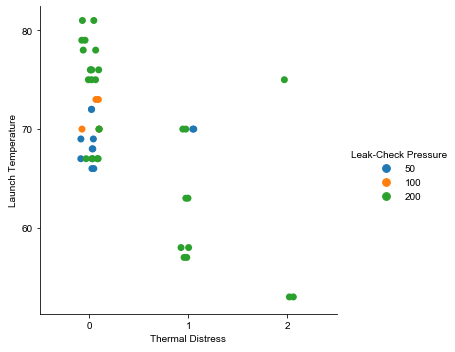

In [8]:
ax = sns.catplot(x='Thermal Distress', y='Launch Temperature', hue='Leak-Check Pressure', data=df_challenger, s=7)
sns.set(font_scale=2)

In [9]:
#Train and Test 17 datasets
#Airfoil
x_airfoil1 = df_airfoil.drop(['Frequency'], axis = 1)
y_airfoil1 = df_airfoil['Frequency']
y_airfoil1 = np.reshape(y_airfoil1.values, (-1,1))
x_airfoil2 = df_airfoil.drop(['Angle of Attack'], axis = 1)
y_airfoil2 = df_airfoil['Angle of Attack']
#x_airfoil2 = df_airfoil.drop(['Free-stream velocity','category'], axis = 1)
#y_airfoil2 = df_airfoil['category']
#y_airfoil2=to_categorical(y_airfoil2)
#Wdbc
#x_wdbc = df_wdbc[['radius_mean','perimeter_mean','area_mean','concavity_mean','concave points_mean','radius_worst','perimeter_worst','area_worst','concave points_worst']]
#y_wdbc = df_wdbc['diagnosis']
#labelencoder_Y = LabelEncoder()
#y_wdbc = labelencoder_Y.fit_transform(y_wdbc)
#Automobile
x_automobile1 = df_automobile.drop(['bore','make','body-style'], axis = 1)
y_automobile1 = df_automobile['bore']
x_automobile2 = df_automobile.drop(['horsepower','make','body-style'], axis = 1)
y_automobile2 = df_automobile['horsepower']
y_automobile2 = np.reshape(y_automobile2.values, (-1,1))
#Autompg
x_autompg1 = df_autompg.drop(['Displacement','Car Name'], axis = 1)
y_autompg1 = df_autompg['Displacement']
y_autompg1 = np.reshape(y_autompg1.values, (-1,1))
x_autompg2 = df_autompg.drop(['Acceleration','Car Name'], axis = 1)
y_autompg2 = df_autompg['Acceleration']
#Challenger
x_challenger1 = df_challenger.drop(['Number of O-rings','Launch Temperature'], axis = 1)
y_challenger1 = df_challenger['Launch Temperature']
x_challenger2 = df_challenger.drop(['Number of O-rings','Leak-Check Pressure'], axis = 1)
y_challenger2 = df_challenger['Leak-Check Pressure']
#y_challenger2=to_categorical(y_challenger2)
#Combine
#x_combine = df_combine.drop(['PE'], axis = 1)
#y_combine = df_combine['PE']
#y_combine = np.reshape(y_combine.values, (-1,1))
#Computer
#x_computer = df_computer.drop(['ERP'], axis = 1)
#y_computer = df_computer['ERP']
#y_computer = np.reshape(y_computer.values, (-1,1))
#Concrete_compressive_strength
#x_concrete_compressive_strength = df_concrete_compressive_strength.drop(['CCS'], axis = 1)
#y_concrete_compressive_strength = df_concrete_compressive_strength['CCS']
#y_concrete_compressive_strength = np.reshape(y_concrete_compressive_strength.values, (-1,1))
#Concrete1
#x_concrete1 = df_concrete1.drop(['No','Compressive Strength (28-day)(Mpa)'], axis = 1)
#y_concrete1 = df_concrete1['Compressive Strength (28-day)(Mpa)']
#Concrete2
#x_concrete2 = df_concrete2.drop(['No','SLUMP(cm)'], axis = 1)
#y_concrete2 = df_concrete2['SLUMP(cm)']
#y_concrete2 = np.reshape(y_concrete2.values, (-1,1))
#Concrete3
#x_concrete3 = df_concrete3.drop(['No','FLOW(cm)'], axis = 1)
#y_concrete3 = df_concrete3['FLOW(cm)']
#y_concrete3 = np.reshape(y_concrete3.values, (-1,1))
#Energy1
#x_energy1 = df_energy1.drop(['Y1'], axis = 1)
#y_energy1 = df_energy1['Y1']
#Energy2
#x_energy2 = df_energy2.drop(['Y2'], axis = 1)
#y_energy2 = df_energy2['Y2']
#Fertility
#x_fertility = df_fertility.drop(['Diagnosis'], axis = 1)
#y_fertility = df_fertility['Diagnosis']
#Forest
#x_forest = df_forest.drop(['month','day','area'], axis = 1)
#y_forest = df_forest['area']
#y_forest = np.reshape(y_forest.values, (-1,1))
#Housing
#x_housing = df_housing.drop(['MEDV'], axis = 1)
#y_housing = df_housing['MEDV']
#Istanbul
#x_istanbul = df_istanbul.drop(['date','ISE1','ISE2'], axis = 1)
#y_istanbul = df_istanbul[['ISE1','ISE2']]
#y_istanbul['mean'] = y_istanbul.mean(axis=1)
#y_istanbul = y_istanbul['mean']

In [10]:
x_train_airfoil1, x_test_airfoil1, y_train_airfoil1, y_test_airfoil1 = train_test_split1(x_airfoil1, y_airfoil1)
x_train_airfoil2, x_test_airfoil2, y_train_airfoil2, y_test_airfoil2 = train_test_split1(x_airfoil2, y_airfoil2)
x_train_automobile1, x_test_automobile1, y_train_automobile1, y_test_automobile1 = train_test_split1(x_automobile1, y_automobile1)
x_train_automobile2, x_test_automobile2, y_train_automobile2, y_test_automobile2 = train_test_split1(x_automobile2, y_automobile2)
x_train_autompg1, x_test_autompg1, y_train_autompg1, y_test_autompg1 = train_test_split1(x_autompg1, y_autompg1)
x_train_autompg2, x_test_autompg2, y_train_autompg2, y_test_autompg2 = train_test_split1(x_autompg2, y_autompg2)
x_train_challenger1, x_test_challenger1, y_train_challenger1, y_test_challenger1 = train_test_split1(x_challenger1, y_challenger1)
x_train_challenger2, x_test_challenger2, y_train_challenger2, y_test_challenger2 = train_test_split1(x_challenger2, y_challenger2)
#x_train_combine, x_test_combine, y_train_combine, y_test_combine = train_test_split1(x_combine, y_combine)
#x_train_computer, x_test_computer, y_train_computer, y_test_computer = train_test_split1(x_computer, y_computer)
#x_train_concrete_compressive_strength, x_test_concrete_compressive_strength, y_train_concrete_compressive_strength, y_test_concrete_compressive_strength = train_test_split1(x_concrete_compressive_strength, y_concrete_compressive_strength)
#x_train_concrete1, x_test_concrete1, y_train_concrete1, y_test_concrete1 = train_test_split1(x_concrete1, y_concrete1)
#x_train_concrete2, x_test_concrete2, y_train_concrete2, y_test_concrete2 = train_test_split1(x_concrete2, y_concrete2)
#x_train_concrete3, x_test_concrete3, y_train_concrete3, y_test_concrete3 = train_test_split1(x_concrete3, y_concrete3)
#x_train_energy1, x_test_energy1, y_train_energy1, y_test_energy1 = train_test_split1(x_energy1, y_energy1)
#x_train_energy2, x_test_energy2, y_train_energy2, y_test_energy2 = train_test_split1(x_energy2, y_energy2)
#x_train_fertility, x_test_fertility, y_train_fertility, y_test_fertility = train_test_split1(x_fertility, y_fertility)
#x_train_forest, x_test_forest, y_train_forest, y_test_forest = train_test_split1(x_forest, y_forest)
#x_train_housing, x_test_housing, y_train_housing, y_test_housing = train_test_split1(x_housing, y_housing)
#x_train_istanbul, x_test_istanbul, y_train_istanbul, y_test_istanbul = train_test_split1(x_istanbul, y_istanbul)
#x_train_wdbc, x_test_wdbc, y_train_wdbc, y_test_wdbc = train_test_split1(x_wdbc, y_wdbc)

In [11]:
def train_val_split(x_train, y_train):
    X_train, X_val, Y_train, Y_val= train_test_split(x_train, y_train, test_size=0.176, random_state=42)
    return X_train, X_val, Y_train, Y_val

In [12]:
def standard_scaler(X_train, X_val, x_test):
    sc=StandardScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=sc.fit(X_train)
    #X_scale_val=sc.fit(X_val)
    #x_scale_test=sc.fit(x_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_train.transform(X_val)
    x_test=X_scale_train.transform(x_test)
    return X_train, X_val, x_test, X_scale_train

In [13]:
def min_max_scaler(X_train, X_val, x_test, Y_train, Y_val, y_test):
    min_max_x=MinMaxScaler()
    min_max_y=MinMaxScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=min_max_x.fit(X_train)
    #X_scale_val=min_max_x.fit(X_val)
    #x_scale_test=min_max_x.fit(x_test)
    Y_scale_train=min_max_y.fit(Y_train)
    #Y_scale_val=min_max_y.fit(Y_val)
    #y_scale_test=min_max_y.fit(y_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_train.transform(X_val)
    x_test=X_scale_train.transform(x_test)
    Y_train=Y_scale_train.transform(Y_train)
    Y_val=Y_scale_train.transform(Y_val)
    y_test=Y_scale_train.transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test, X_scale_train, Y_scale_train

In [14]:
def normalization(X_train, X_val, x_test, Y_train, Y_val, y_test):
    normalizer=Normalizer()
    X_train=normalizer.fit_transform(X_train)
    X_val=normalizer.fit_transform(X_val)
    x_test=normalizer.fit_transform(x_test)
    Y_train=normalizer.fit_transform(Y_train)
    Y_val=normalizer.fit_transform(Y_val)
    y_test=normalizer.fit_transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test

In [15]:
#Optimizer list
adam0 = 'adam'
adam1 = optimizers.Adam(lr=0.001)
adam2 = optimizers.Adam(lr=0.01)
adam3 = optimizers.Adam(lr=0.0001)
adam4 = optimizers.Adam(lr=0.00001)
sgd = optimizers.SGD(lr=0.005, decay=1e-4, momentum=0.9, nesterov=True)
RMSprop= optimizers.RMSprop(lr=0.01,rho=0.9)
adagrad = optimizers.Adagrad(lr=0.01)
adadelta = optimizers.Adadelta(lr=1.0)

In [16]:
def NN_model_structure_classification(X_train, X_val, Y_train, Y_val, adam, size, epochs, x_test, y_test, classes):
    model = Sequential()
    model.add(Dense(units = 5, kernel_initializer='uniform', input_dim = (X_train.shape[1])))
    model.add(Activation('relu'))
    model.add(Dense(units = 10, kernel_initializer='uniform'))
    model.add(Activation('relu'))
    model.add(Dense(units = 20, kernel_initializer='uniform'))
    model.add(Dense(units = classes, activation='softmax'))
    model.compile(optimizer = adam , loss = 'categorical_crossentropy', metrics=['acc'])
    model.summary()
    history=model.fit(X_train,Y_train, batch_size=size,epochs=epochs, validation_data=(X_val, Y_val), shuffle=True)
    evaluate = model.evaluate(x_test, y_test, verbose=2, batch_size=size)
    print(evaluate)
    return model, history, evaluate

In [17]:
def NN_model_structure_regression(X_train, X_val, Y_train, Y_val, adam, size, epochs, x_test, y_test):
    model = Sequential()
    model.add(Dense(units = 5, input_dim = (X_train.shape[1])))
    model.add(Activation('tanh'))
    model.add(Dense(units = 10))
    model.add(Activation('linear'))
    model.add(Dense(units = 1))
    model.compile(optimizer = adam , loss = 'mse')
    model.summary()
    history=model.fit(X_train,Y_train, batch_size=size,epochs=epochs, validation_data=(X_val, Y_val), shuffle=True)
    evaluate = model.evaluate(x_test, y_test, verbose=2, batch_size=size)
    print(evaluate)
    return model, history, evaluate

In [18]:
X_train_airfoil1, X_val_airfoil1, Y_train_airfoil1, Y_val_airfoil1 = train_val_split(x_train_airfoil1, y_train_airfoil1)
X_train_airfoil2, X_val_airfoil2, Y_train_airfoil2, Y_val_airfoil2 = train_val_split(x_train_airfoil2, y_train_airfoil2)
X_train_automobile1, X_val_automobile1, Y_train_automobile1, Y_val_automobile1 = train_val_split(x_train_automobile1, y_train_automobile1)
X_train_automobile2, X_val_automobile2, Y_train_automobile2, Y_val_automobile2 = train_val_split(x_train_automobile2, y_train_automobile2)
X_train_autompg1, X_val_autompg1, Y_train_autompg1, Y_val_autompg1 = train_val_split(x_train_autompg1, y_train_autompg1)
X_train_autompg2, X_val_autompg2, Y_train_autompg2, Y_val_autompg2 = train_val_split(x_train_autompg2, y_train_autompg2)
X_train_challenger1, X_val_challenger1, Y_train_challenger1, Y_val_challenger1 = train_val_split(x_train_challenger1, y_train_challenger1)
X_train_challenger2, X_val_challenger2, Y_train_challenger2, Y_val_challenger2 = train_val_split(x_train_challenger2, y_train_challenger2)
#X_train_combine, X_val_combine, Y_train_combine, Y_val_combine = train_val_split(x_train_combine, y_train_combine)
#X_train_computer, X_val_computer, Y_train_computer, Y_val_computer = train_val_split(x_train_computer, y_train_computer)
#X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength = train_val_split(x_train_concrete_compressive_strength, y_train_concrete_compressive_strength)
#X_train_concrete1, X_val_concrete1, Y_train_concrete1, Y_val_concrete1 = train_val_split(x_train_concrete1, y_train_concrete1)
#X_train_concrete2, X_val_concrete2, Y_train_concrete2, Y_val_concrete2 = train_val_split(x_train_concrete2, y_train_concrete2)
#X_train_concrete3, X_val_concrete3, Y_train_concrete3, Y_val_concrete3 = train_val_split(x_train_concrete3, y_train_concrete3)
#X_train_energy1, X_val_energy1, Y_train_energy1, Y_val_energy1 = train_val_split(x_train_energy1, y_train_energy1)
#X_train_energy2, X_val_energy2, Y_train_energy2, Y_val_energy2 = train_val_split(x_train_energy2, y_train_energy2)
#X_train_fertility, X_val_fertility, Y_train_fertility, Y_val_fertility = train_val_split(x_train_fertility, y_train_fertility)
#X_train_forest, X_val_forest, Y_train_forest, Y_val_forest = train_val_split(x_train_forest, y_train_forest)
#X_train_housing, X_val_housing, Y_train_housing, Y_val_housing = train_val_split(x_train_housing, y_train_housing)
#X_train_istanbul, X_val_istanbul, Y_train_istanbul, Y_val_istanbul = train_val_split(x_train_istanbul, y_train_istanbul)
#X_train_wdbc, X_val_wdbc, Y_train_wdbc, Y_val_wdbc = train_val_split(x_train_wdbc, y_train_wdbc)

In [19]:
X_train_airfoil1, X_val_airfoil1, x_test_airfoil1, Y_train_airfoil1, Y_val_airfoil1, y_test_airfoil1, X_scale_train_airfoil1, Y_scale_train_airfoil1 =min_max_scaler(X_train_airfoil1, X_val_airfoil1, x_test_airfoil1, Y_train_airfoil1, Y_val_airfoil1, y_test_airfoil1)
X_train_airfoil2, X_val_airfoil2, x_test_airfoil2, X_scale_train_airfoil2=standard_scaler(X_train_airfoil2, X_val_airfoil2, x_test_airfoil2)
X_train_automobile1, X_val_automobile1, x_test_automobile1, X_scale_train_automobile1=standard_scaler(X_train_automobile1, X_val_automobile1, x_test_automobile1)
X_train_automobile2, X_val_automobile2, x_test_automobile2, Y_train_automobile2, Y_val_automobile2, y_test_automobile2, X_scale_train_automobile2, Y_scale_train_automobile2=min_max_scaler(X_train_automobile2, X_val_automobile2, x_test_automobile2, Y_train_automobile2, Y_val_automobile2, y_test_automobile2)
X_train_autompg1, X_val_autompg1, x_test_autompg1, Y_train_autompg1, Y_val_autompg1, y_test_autompg1, X_scale_train_autompg1, Y_scale_train_autompg1=min_max_scaler(X_train_autompg1, X_val_autompg1, x_test_autompg1, Y_train_autompg1, Y_val_autompg1, y_test_autompg1)
X_train_autompg2, X_val_autompg2, x_test_autompg2, X_scale_train_autompg2=standard_scaler(X_train_autompg2, X_val_autompg2, x_test_autompg2)
X_train_challenger1, X_val_challenger1, x_test_challenger1, X_scale_train_challenger1=standard_scaler(X_train_challenger1, X_val_challenger1, x_test_challenger1)
X_train_challenger2, X_val_challenger2, x_test_challenger2, X_scale_train_challenger2=standard_scaler(X_train_challenger2, X_val_challenger2, x_test_challenger2)
#X_train_combine, X_val_combine, x_test_combine, Y_train_combine, Y_val_combine, y_test_combine, min_max_combine=min_max_scaler(X_train_combine, X_val_combine, x_test_combine, Y_train_combine, Y_val_combine, y_test_combine)
#X_train_computer, X_val_computer, x_test_computer, Y_train_computer, Y_val_computer, y_test_computer, min_max_computer=min_max_scaler(X_train_computer, X_val_computer, x_test_computer, Y_train_computer, Y_val_computer, y_test_computer)
#X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, x_test_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength, y_test_concrete_compressive_strength, min_max_concrete_compressive_strength=min_max_scaler(X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, x_test_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength, y_test_concrete_compressive_strength)
#X_train_concrete1, X_val_concrete1, x_test_concrete1, X_scale_train_concrete1=standard_scaler(X_train_concrete1, X_val_concrete1, x_test_concrete1)
#X_train_concrete2, X_val_concrete2, x_test_concrete2, Y_train_concrete2, Y_val_concrete2, y_test_concrete2, min_max_concrete2=min_max_scaler(X_train_concrete2, X_val_concrete2, x_test_concrete2, Y_train_concrete2, Y_val_concrete2, y_test_concrete2)
#X_train_concrete3, X_val_concrete3, x_test_concrete3, Y_train_concrete3, Y_val_concrete3, y_test_concrete3, min_max_concrete3=min_max_scaler(X_train_concrete3, X_val_concrete3, x_test_concrete3, Y_train_concrete3, Y_val_concrete3, y_test_concrete3)
#X_train_energy1, X_val_energy1, x_test_energy1, X_scale_train_energy1=standard_scaler(X_train_energy1, X_val_energy1, x_test_energy1)
#X_train_energy2, X_val_energy2, x_test_energy2, X_scale_train_energy2=standard_scaler(X_train_energy2, X_val_energy2, x_test_energy2)
#X_train_fertility, X_val_fertility, x_test_fertility, X_scale_train_fertility=standard_scaler(X_train_fertility, X_val_fertility, x_test_fertility)
#X_train_forest, X_val_forest, x_test_forest, Y_train_forest, Y_val_forest, y_test_forest, min_max_forest=min_max_scaler(X_train_forest, X_val_forest, x_test_forest, Y_train_forest, Y_val_forest, y_test_forest)
#X_train_housing, X_val_housing, x_test_housing, X_scale_train_housing=standard_scaler(X_train_housing, X_val_housing, x_test_housing)
#X_train_istanbul, X_val_istanbul, x_test_istanbul, X_scale_train_istanbul=standard_scaler(X_train_istanbul, X_val_istanbul, x_test_istanbul)

In [20]:
model_airfoil1, history_airfoil1, evaluate_airfoil1=NN_model_structure_regression(X_train_airfoil1, X_val_airfoil1, Y_train_airfoil1, Y_val_airfoil1, adam2, 64, 100, x_test_airfoil1, y_test_airfoil1)
model_airfoil1.get_weights()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 5)                 30        
_________________________________________________________________
activation_1 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_2 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_2 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 11        
Total params: 101
Trainable params: 101
Non-trainable params: 0
_________________________________________________________________

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 1s 650us/step - l

1052/1052 [==============================] - 0s 49us/step - loss: 0.0105 - val_loss: 0.0137
Epoch 68/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.0097 - val_loss: 0.0140
Epoch 69/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 70/100
1052/1052 [==============================] - 0s 44us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 71/100
1052/1052 [==============================] - 0s 47us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 72/100
1052/1052 [==============================] - 0s 45us/step - loss: 0.0094 - val_loss: 0.0144
Epoch 73/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.0103 - val_loss: 0.0133
Epoch 74/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.0098 - val_loss: 0.0147
Epoch 75/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 76/100
1052/1052 [==============================] - 0s 46us/st

[array([[-1.0035052 , -1.4113698 , -0.55868804,  0.40698773, -0.77647907],
        [-1.7610654 , -0.4268587 ,  0.13842016, -0.7266935 , -0.1566352 ],
        [ 0.08843417,  0.40156692, -0.1412032 , -0.04111123,  0.27497837],
        [-0.42869076, -0.34928107, -0.31472677,  0.09764189, -0.06692572],
        [ 0.3581231 , -1.8856891 , -0.01752246,  1.0504256 , -0.41424188]],
       dtype=float32),
 array([-0.40544623,  0.20274472, -0.26238096,  0.06753189, -0.20327654],
       dtype=float32),
 array([[ 0.04838941,  0.43069   , -0.5514856 ,  0.43560502, -0.10396802,
         -0.12851612,  0.16547723, -0.6032626 ,  0.23079139,  0.24103671],
        [ 0.08197858, -0.6174303 , -0.05057687, -0.483737  ,  0.9587323 ,
         -0.61946285, -0.06436878,  0.02187127,  0.10389357,  0.71706307],
        [-0.10303751, -0.44384372,  0.09501348, -0.20352869, -0.44735706,
          0.1042635 , -0.07647055,  0.50779694,  0.554077  , -0.08805805],
        [ 0.44714126,  0.39612415,  0.47793576, -0.117312

In [21]:
model_airfoil2, history_airfoil2, evaluate_airfoil2=NN_model_structure_regression(X_train_airfoil2, X_val_airfoil2, Y_train_airfoil2, Y_val_airfoil2, adam2, 64, 100, x_test_airfoil2, y_test_airfoil2)
model_airfoil2.get_weights()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 5)                 30        
_________________________________________________________________
activation_3 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_5 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_4 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 11        
Total params: 101
Trainable params: 101
Non-trainable params: 0
_________________________________________________________________
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 157us/step - lo

1052/1052 [==============================] - 0s 47us/step - loss: 0.7053 - val_loss: 0.7871
Epoch 70/100
1052/1052 [==============================] - 0s 48us/step - loss: 0.6224 - val_loss: 0.8327
Epoch 71/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.6610 - val_loss: 0.9177
Epoch 72/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.6445 - val_loss: 0.8505
Epoch 73/100
1052/1052 [==============================] - 0s 47us/step - loss: 0.6093 - val_loss: 0.7596
Epoch 74/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.6160 - val_loss: 0.7893
Epoch 75/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.6393 - val_loss: 0.8023
Epoch 76/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.6271 - val_loss: 0.7749
Epoch 77/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.6284 - val_loss: 0.7774
Epoch 78/100
1052/1052 [==============================] - 0s 45us/st

[array([[-5.5694300e-01,  1.2153119e-01,  5.3692859e-02,  2.0133680e-02,
          7.4869916e-02],
        [-5.2931565e-01, -1.2545851e-01, -1.8835349e-01,  2.3250854e+00,
          1.6088457e-01],
        [ 6.5593123e-01,  5.4324329e-02, -3.2080762e-02, -3.4409668e-02,
          4.5997463e-04],
        [-4.8828658e-01,  2.5080278e+00,  6.3660848e-01, -5.2194619e-01,
         -3.0069966e+00],
        [-2.3339003e-02,  1.3754749e-01, -4.3822795e-02,  1.5445965e-02,
          1.7808935e-01]], dtype=float32),
 array([ 0.40033448,  2.4331012 , -0.63240385,  3.5705042 , -2.868475  ],
       dtype=float32),
 array([[-0.4067938 , -0.6527427 , -0.20486465,  0.10453478, -0.37395862,
         -0.16245551,  0.0724302 , -0.23942801, -0.42287344, -0.05380094],
        [ 0.8849574 , -0.31380686, -0.5180076 , -0.9438849 , -0.851312  ,
         -0.7272917 , -0.40631786, -1.0741444 ,  1.0449368 , -1.343265  ],
        [ 0.029312  , -0.51139873, -0.67572707, -0.7698028 , -0.8074811 ,
         -0.6630654

In [22]:
model_automobile1, history_automobile1, evaluate_automobile1=NN_model_structure_regression(X_train_automobile1, X_val_automobile1, Y_train_automobile1, Y_val_automobile1, adam2, 64, 100, x_test_automobile1, y_test_automobile1)
model_automobile1.get_weights()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 5)                 115       
_________________________________________________________________
activation_5 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_8 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_6 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 11        
Total params: 186
Trainable params: 186
Non-trainable params: 0
_________________________________________________________________
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 947us/step - loss: 

143/143 [==============================] - 0s 83us/step - loss: 0.0284 - val_loss: 0.0324
Epoch 71/100
143/143 [==============================] - 0s 78us/step - loss: 0.0282 - val_loss: 0.0310
Epoch 72/100
143/143 [==============================] - 0s 84us/step - loss: 0.0275 - val_loss: 0.0299
Epoch 73/100
143/143 [==============================] - 0s 84us/step - loss: 0.0275 - val_loss: 0.0297
Epoch 74/100
143/143 [==============================] - 0s 84us/step - loss: 0.0278 - val_loss: 0.0307
Epoch 75/100
143/143 [==============================] - 0s 91us/step - loss: 0.0271 - val_loss: 0.0347
Epoch 76/100
143/143 [==============================] - 0s 84us/step - loss: 0.0283 - val_loss: 0.0328
Epoch 77/100
143/143 [==============================] - 0s 77us/step - loss: 0.0269 - val_loss: 0.0309
Epoch 78/100
143/143 [==============================] - ETA: 0s - loss: 0.027 - 0s 84us/step - loss: 0.0279 - val_loss: 0.0298
Epoch 79/100
143/143 [==============================] - 0s 84u

[array([[ 0.4734056 , -0.25421742,  0.3782569 , -0.27464327,  0.09855805],
        [ 0.23863794, -0.04580082,  0.4675846 , -0.07269936,  0.302857  ],
        [-0.19207022,  0.3893991 , -0.8650551 ,  0.49025714,  0.04620211],
        [ 0.878498  , -0.62375563,  0.34466133, -0.28298503, -0.38668424],
        [ 0.72640306, -0.19600485, -0.15795669,  0.22711657, -0.20136516],
        [ 0.80606645, -0.6385886 ,  0.8199926 ,  0.28157276, -0.3617987 ],
        [-0.4528376 , -0.42000443,  0.8685121 ,  0.15387109, -0.03273604],
        [ 0.23485479, -0.459088  ,  0.5302783 ,  0.27768958, -0.5303651 ],
        [ 0.48304448, -0.60581046,  0.78682023,  0.3837838 , -0.08898567],
        [-0.5087067 , -0.39327627,  0.25662032,  0.35847014,  0.09496214],
        [ 0.33695647, -0.09379344,  0.35191947,  0.02950184,  0.32654744],
        [-0.3159926 , -0.20862222, -0.21391365,  0.0474889 , -0.61033547],
        [ 0.39610463,  0.07593819, -0.32031968, -0.5999416 ,  0.0175745 ],
        [ 0.8866959 , -0.

In [23]:
from random import seed
def initial_sol(particles, model, limit):
    np.random.seed(7)
    weights_list=[]
    for j in range(particles):
        print('particle',j)
        #np.random.seed(j+12)
        weight = [np.random.uniform(low = -limit, high = limit, size=(w.shape)) for w in model.get_weights()]
        weights_list.append(weight)
    return weights_list 

In [24]:
def particle_list_generate(particles, model, weights, X_train, Y_train, X_val, Y_val, x_test, y_test, epoch):
    particle_list=[]
    evaluate_list=[]
    train_val_test=[]
    for j in range(particles):
        model.set_weights(weights[j])
        model_training= model.fit(X_train,Y_train, batch_size=32,epochs=epoch, validation_data=(X_val, Y_val))
        model_history= model_training.history
        train_list=list(model_history['loss'])
        train_val_test.append(train_list[epoch-1])
        val_list=list(model_history['val_loss'])
        train_val_test.append(val_list[epoch-1])
        model_evaluation=model.evaluate(x_test, y_test, verbose=0)
        train_val_test.append(model_evaluation)
        weight = model.get_weights()
        particle_list.append(weight)
        evaluate_list.append(train_val_test)
        train_val_test=[]
    return particle_list, evaluate_list

In [25]:
def best_nest(nest_list_result, nest_list):
    #list_score=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\particle_best_list.csv')
    result_best_nest=[]
    compare_val=math.inf
    compare_test=math.inf
    for i in range(len(nest_list_result)):
        if nest_list_result[i][1]<compare_val:
            if nest_list_result[i][2]<compare_test:
                compare_val=nest_list_result[i][1]
                compare_test=nest_list_result[i][2]
                best_nest_train=nest_list_result[i][0]
                best_nest_val=compare_val
                best_nest_test=compare_test
                best_nest=nest_list[i]
    result_best_nest.append(best_nest_train)
    result_best_nest.append(best_nest_val)
    result_best_nest.append(best_nest_test)
    return result_best_nest, best_nest

In [26]:
def update_nest(alpha0, random_nest_i, nest_list, limit):
    random_nest_j=nest_list[np.random.choice(len(nest_list),replace=False)]
    
    alpha=np.kron(alpha0,(np.array(random_nest_j)-np.array(random_nest_i)))
    λ=np.random.uniform(1,3)
    Γλ=math.gamma(λ)
    π=math.pi
    σ_square=((math.gamma(1+λ)*math.sin((π*λ)/2))/(math.gamma((1+λ)/2)*λ*2**((λ-1)/2)))**1/λ
    u=np.random.uniform(0, σ_square)
    v=np.random.uniform(0,1)
    s=u*(abs(v)**(-1/λ))
    Lévy_λ=((λ*Γλ*math.sin((π*λ)/2))/π)*(1/(s**(1+λ)))
    new_nest=np.array(random_nest_i)+np.kron(alpha,Lévy_λ)
    for array in range(len(new_nest)):
            new_nest[array][new_nest[array]<-limit]=-limit
            new_nest[array][new_nest[array]>limit]=limit
    return new_nest

In [27]:
def fitness_of_new_nest(model, new_nest, X_train, Y_train, epoch, X_val, Y_val, x_test, y_test):
    nest_list_result=[]
    
    model.set_weights(new_nest)
    model_training= model.fit(X_train,Y_train, batch_size=32,epochs=epoch, validation_data=(X_val, Y_val))
    model_history= model_training.history
    train_list=list(model_history['loss'])
    nest_list_result.append(train_list[epoch-1])
    val_list=list(model_history['val_loss'])
    nest_list_result.append(val_list[epoch-1])
    model_evaluation=model.evaluate(x_test, y_test, verbose=0)
    nest_list_result.append(model_evaluation)
    nest_list = model.get_weights()
    
    return nest_list, nest_list_result

In [28]:
def fraction_Pa_nest(Pa, alpha0, random_nest_i, nest_list, limit):
    random_nest_j=nest_list[np.random.choice(len(nest_list),replace=False)]
    random_nest_k=nest_list[np.random.choice(len(nest_list),replace=False)]
    r=np.random.normal(0,1)
    H=np.heaviside(Pa,r)
    new_nest_Pa=np.array(random_nest_i)+np.kron(np.kron(alpha0,H),(np.array(random_nest_j)-np.array(random_nest_k)))
    for array in range(len(new_nest_Pa)):
            new_nest_Pa[array][new_nest_Pa[array]<-limit]=-limit
            new_nest_Pa[array][new_nest_Pa[array]>limit]=limit
    return new_nest_Pa

In [29]:
def CS_Algorithm(nest_list, nest_list_result, model, X_train, Y_train, epochs, X_val, Y_val, x_test, y_test, best_nest_result, best_nest, limit):
    #CS Algorithm
    iteration=100
    alpha0=0.01
    Pa=0.5
    new_nests=int(Pa*10)
    value=math.inf
    Fnew_result=[value,value,value]
    
    best_nest_result_list=[]
    
    for i in range(iteration):
        print('Generate new nest')
        random_nest_i=nest_list[np.random.choice(len(nest_list),replace=False)]
        updated_nest=update_nest(alpha0, random_nest_i, nest_list, limit)
        new_nest_i, new_nest_result_i=fitness_of_new_nest(model, updated_nest, X_train, Y_train, epochs, X_val, Y_val, x_test, y_test)
    
        print('Choose randomly nest')
        random_nest_j=nest_list[np.random.choice(len(nest_list),replace=False)]
        model.set_weights(random_nest_j)
        val_j=model.evaluate(X_val,Y_val)
        test_j=model.evaluate(x_test, y_test)
    
        print('Replace current nest')
        if new_nest_result_i[1]<val_j:
            if new_nest_result_i[2]<test_j:
                for j in range(len(nest_list)):
                    if np.array(random_nest_j)==np.array(nest_list[j]):
                        nest_list_result[j]=new_nest_result_i
                        nest_list[j]=new_nest_i
    
        print('sort cuckoo nest')
        ab=np.concatenate((nest_list_result,nest_list), axis=1)
        sort=ab[np.argsort(ab[:,1])]
        nest_list_result=sort[:, [0, 1, 2]]
        nest_list=sort[:,3:]
    
        print('delete cuckoo nest according Pa')
        nest_list_result=np.delete(nest_list_result,[5,6,7,8,9],axis=0) 
        nest_list=np.delete(nest_list,[5,6,7,8,9],axis=0) 
    
        print('generate new nest according Pa')
        new_nests_Pa=[]
        new_nests_result_Pa=[]
        for i in range(new_nests):
            print('new nest for Pa',i)
            updated_nest_Pa=fraction_Pa_nest(Pa, alpha0, random_nest_i, nest_list, limit)
            new_nest_Pa, new_nest_result_Pa=fitness_of_new_nest(model, updated_nest_Pa, X_train, Y_train, epochs, X_val, Y_val, x_test, y_test)
            new_nests_Pa.append(new_nest_Pa)
            new_nests_result_Pa.append(new_nest_result_Pa)
    
        print('add new nests')
        nest_list_result=np.concatenate((nest_list_result,new_nests_result_Pa), axis=0)
        nest_list=np.concatenate((nest_list,new_nests_Pa), axis=0)
    
        print('finding Fnew')
        for i in range(len(nest_list_result)):
            if nest_list_result[i][1]<Fnew_result[1]:
                if nest_list_result[i][2]<Fnew_result[2]:
                    Fnew_result=nest_list_result[i]
                    Fnew_weights=nest_list[i]
            if Fnew_result[1]<best_nest_result[1]:
                if Fnew_result[2]<best_nest_result[2]:
                    best_nest_result=Fnew_result
                    best_nest=Fnew_weights
        
            best_nest_result_list.append(best_nest_result)
        
    return best_nest_result, best_nest, best_nest_result_list

In [30]:
#Airfoil1
weights_airfoil1=initial_sol(10, model_airfoil1, 1)
nest_list_airfoil1, nest_list_result_airfoil1=particle_list_generate(10, model_airfoil1, weights_airfoil1, X_train_airfoil1, Y_train_airfoil1, X_val_airfoil1, Y_val_airfoil1, x_test_airfoil1, y_test_airfoil1, 100)
best_nest_result_airfoil1, best_nest_airfoil1=best_nest(nest_list_result_airfoil1, nest_list_airfoil1)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.2097 - val_loss: 0.0401
Epoch 2/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0173 - val_loss: 0.0166
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0140 - val_loss: 0.0164
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0141 - val_loss: 0.0164
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0140 - val_loss: 0.0186
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0143 - val_loss: 0.0176
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0133 - val_loss: 0.0160
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0132 - val_loss: 0.0171
Epoch 9/100

1052/1052 [==============================] - 0s 91us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0105 - val_loss: 0.0163
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0156
Epoch 81/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0103 - val_loss: 0.0146
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0143
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0106 - val_loss: 0.0143
Epoch 86/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0117 - val_loss: 0.0153
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0114 - val_loss: 0.0155
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0112 - val_loss: 0.0154
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0113 - val_loss: 0.0154
Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0111 - val_loss: 0.0150
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0112 - val_loss: 0.0154
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0118 - val_loss: 0.0154
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0111 - val_loss: 0.0162
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0115 - val_loss: 0.0154
Epoch 63/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0120 - val_loss: 0.0183
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0126 - val_loss: 0.0162
Epoch 33/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0122 - val_loss: 0.0175
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0177
Epoch 35/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0114 - val_loss: 0.0154
Epoch 36/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0115 - val_loss: 0.0157
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0120 - val_loss: 0.0166
Epoch 38/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0121 - val_loss: 0.0159
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0119 - val_loss: 0.0162
Epoch 40/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.0153 - val_loss: 0.0171
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0147 - val_loss: 0.0165
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0143 - val_loss: 0.0162
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0138 - val_loss: 0.0164
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0134 - val_loss: 0.0159
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0129 - val_loss: 0.0156
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0127 - val_loss: 0.0152
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0124 - val_loss: 0.0152
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0121 - val_loss: 0.0151
Epoch 17/100
1052/1052 [==============================] - 0s 86us/ste

1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 95/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 68/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0146
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0145
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0100 - val_loss: 0.0144
Epoch 72/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0113 - val_loss: 0.0150
Epoch 41/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0107 - val_loss: 0.0144
Epoch 42/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0102 - val_loss: 0.0143
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0110 - val_loss: 0.0186
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0116 - val_loss: 0.0138
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0101 - val_loss: 0.0149
Epoch 46/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0104 - val_loss: 0.0150
Epoch 47/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0109 - val_loss: 0.0205
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0122 - val_loss: 0.0153
Epoch 49/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0130 - val_loss: 0.0163
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0128 - val_loss: 0.0166
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0125 - val_loss: 0.0166
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0122 - val_loss: 0.0158
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0124 - val_loss: 0.0163
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0120 - val_loss: 0.0154
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0116 - val_loss: 0.0162
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0130 - val_loss: 0.0164
Epoch 25/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0116 - val_loss: 0.0156
Epoch 26/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 97/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0102 - val_loss: 0.0175
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0099 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0099 - val_loss: 0.0157
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0099 - val_loss: 0.0138
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.3481 - val_loss: 0.0690
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0298 - val_loss: 0.0227
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0192 - val_loss: 0.0192
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0130
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0110 - val_loss: 0.0132
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0131
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0100 - val_loss: 0.0147
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0129
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 81/100
1052/1052 [==============================] - 0s 75us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0117 - val_loss: 0.0144
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0113 - val_loss: 0.0150
Epoch 51/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0115 - val_loss: 0.0142
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0110 - val_loss: 0.0138
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0114 - val_loss: 0.0144
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 55/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0111 - val_loss: 0.0140
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0108 - val_loss: 0.0144
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0114 - val_loss: 0.0146
Epoch 58/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0118 - val_loss: 0.0152
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0116 - val_loss: 0.0155
Epoch 28/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.0116 - val_loss: 0.0150
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0117 - val_loss: 0.0149
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0114 - val_loss: 0.0158
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0116 - val_loss: 0.0153
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0115 - val_loss: 0.0150
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0113 - val_loss: 0.0150
Epoch 34/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0116 - val_loss: 0.0151
Epoch 35/100
1052/1052 [==============================] - 0s 83us/st

In [31]:
current_best_result_airfoil1, current_best_airfoil1, current_best_list_airfoil1=CS_Algorithm(nest_list_airfoil1, nest_list_result_airfoil1, model_airfoil1, X_train_airfoil1, Y_train_airfoil1, 100, X_val_airfoil1, Y_val_airfoil1, x_test_airfoil1, y_test_airfoil1, best_nest_result_airfoil1, best_nest_airfoil1, 1)

Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5801 - val_loss: 0.0602
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0343 - val_loss: 0.0249
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0195 - val_loss: 0.0181
Epoch 4/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0184 - val_loss: 0.0178
Epoch 5/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0172 - val_loss: 0.0164
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0164 - val_loss: 0.0166
Epoch 7/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0162 - val_loss: 0.0154
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0151 - val_loss: 0.0152
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0144 - val_loss: 0.0146

1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0143
Epoch 80/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0098 - val_loss: 0.0130
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 86us/st

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.


1052/1052 [==============================] - 0s 85us/step - loss: 0.0125 - val_loss: 0.0167
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0126 - val_loss: 0.0167
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0117 - val_loss: 0.0156
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0116 - val_loss: 0.0155
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0114 - val_loss: 0.0156
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0117 - val_loss: 0.0152
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0117 - val_loss: 0.0153
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0113 - val_loss: 0.0155
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0112 - val_loss: 0.0153
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - l

1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0145
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 90/100
1052/1052 [==============================] - 0s 105us/s

1052/1052 [==============================] - 0s 95us/step - loss: 0.0092 - val_loss: 0.0144
Epoch 59/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 60/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0091 - val_loss: 0.0143
Epoch 61/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 62/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.0094 - val_loss: 0.0142
Epoch 63/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 65/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0143
Epoch 66/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 67/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 85us/step - loss: 0.0109 - val_loss: 0.0150
Epoch 36/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 38/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0095 - val_loss: 0.0143
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0098 - val_loss: 0.0147
Epoch 40/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 44/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0109 - val_loss: 0.0143
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0108 - val_loss: 0.0141
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0106 - val_loss: 0.0143
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0103 - val_loss: 0.0155
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0103 - val_loss: 0.0145
Epoch 17/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0101 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0099 - val_loss: 0.0141
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0100 - val_loss: 0.0147
Epoch 21/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 99/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0092 - val_loss: 0.0150
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 74/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 76/100
1052/1052 [==============================] - 0s 76us/st

C:\Users\user\Anaconda3\lib\site-packages\numpy\core\numeric.py:538: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


1052/1052 [==============================] - 0s 86us/step - loss: 0.0606 - val_loss: 0.0258
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0149 - val_loss: 0.0173
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0134 - val_loss: 0.0178
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0134 - val_loss: 0.0170
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0132 - val_loss: 0.0169
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0130 - val_loss: 0.0166
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0128 - val_loss: 0.0171
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0125 - val_loss: 0.0167
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0125 - val_loss: 0.0168
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - lo

1052/1052 [==============================] - 0s 95us/step - loss: 0.0108 - val_loss: 0.0160
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0111 - val_loss: 0.0156
Epoch 82/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0106 - val_loss: 0.0155
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0104 - val_loss: 0.0161
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0108 - val_loss: 0.0167
Epoch 85/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0107 - val_loss: 0.0170
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0110 - val_loss: 0.0156
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0105 - val_loss: 0.0151
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0106 - val_loss: 0.0155
Epoch 89/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0144
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0095 - val_loss: 0.0144
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0150
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0098 - val_loss: 0.0155
Epoch 59/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 76us/step - loss: 0.0093 - val_loss: 0.0143
Epoch 60/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0094 - val_loss: 0.0142
Epoch 61/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0139
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0139
Epoch 64/100
1052/1052 [====================

1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0146
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0139
Epoch 35/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0097 - val_loss: 0.0132
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 40/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 41/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0101 - val_loss: 0.0146
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0115 - val_loss: 0.0147
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0102 - val_loss: 0.0149
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0100 - val_loss: 0.0154
Epoch 14/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0098 - val_loss: 0.0143
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0103 - val_loss: 0.0162
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0104 - val_loss: 0.0157
Epoch 17/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0100 - val_loss: 0.0144
Epoch 18/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0147
Epoch 96/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 66/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0156
Epoch 67/100
1052/1052 [==============================] - ETA: 0s - loss: 0.010 - 0s 86us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0142
Epoch 70/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 72/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0147
Epoch 73/100
1052/1052 [====================

1052/1052 [==============================] - 0s 86us/step - loss: 0.0107 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 50/100
1052/1052 [==============================] - 0s 85us/st

Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0113 - val_loss: 0.0149
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0112 - val_loss: 0.0150
Epoch 20/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0112 - val_loss: 0.0153
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0113 - val_loss: 0.0146
Epoch 22/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0110 - val_loss: 0.0146
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0111 - val_loss: 0.0145
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0111 - val_loss: 0.0147
Epoch 25/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0115 - val_loss: 0.0150
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0111 - val_loss: 0.0145
Epoch 27/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.0102 - val_loss: 0.0152
Epoch 96/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.0108 - val_loss: 0.0158
Epoch 97/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0103 - val_loss: 0.0139
Epoch 98/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0102 - val_loss: 0.0137
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0102 - val_loss: 0.0137
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0101 - val_loss: 0.0135
Choose randomly nest
226/226 [==============================] - 0s 45us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0428 - val_loss: 0.0185
Epoch 2/100
1052/1052 [===========

1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0150
Epoch 74/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 79/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0086 - val_loss: 0.0144
Epoch 56/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0097 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0098 - val_loss: 0.0134
Epoch 30/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 31/100
1052/1052 [==============================] - 0s 133us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 33/100
1052/1052 [==============================] - 0s 86us/

1052/1052 [==============================] - 0s 86us/step - loss: 0.0353 - val_loss: 0.0186
Epoch 2/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0127 - val_loss: 0.0147
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0120 - val_loss: 0.0154
Epoch 4/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0111 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0111 - val_loss: 0.0143
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0108 - val_loss: 0.0144
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0102 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - lo

Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 83/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0142
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 42/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0146
Epoch 11/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0154
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0095 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0146
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0098 - val_loss: 0.0145
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0105 - val_loss: 0.0160
Epoch 17/100
1052/1052 [==============================] - 0s 76us/ste

Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0146
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0142
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 70/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 72/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 49/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0101 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0096 - val_loss: 0.0162
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 85us/st

Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0124
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0309 - val_loss: 0.0176
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0117 - val_loss: 0.0164
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0118 - val_loss:

1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0146
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 80us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 58/100
1052/1052 [====================

1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 27/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0145
Epoch 28/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0096 - val_loss: 0.0131
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 30/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 31/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 33/100
1052/1052 [==============================] - 0s 85us/s

1052/1052 [==============================] - 0s 96us/step - loss: 0.0350 - val_loss: 0.0178
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0155
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0117 - val_loss: 0.0153
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0112 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0111 - val_loss: 0.0160
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0111 - val_loss: 0.0174
Epoch 7/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.0107 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0105 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0101 - val_loss: 0.0144
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - lo

1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0147
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================] - 0s 72us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0147
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0089 - val_loss: 0.0142
Epoch 40/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0093 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 89us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.0103 - val_loss: 0.0155
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0099 - val_loss: 0.0143
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0096 - val_loss: 0.0147
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0096 - val_loss: 0.0143
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0098 - val_loss: 0.0153
Epoch 16/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0148
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0150
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 19/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 72us/step - loss: 0.0084 - val_loss: 0.0142
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 76us/st

Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0095 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0127
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0093 - val_loss: 0.0124
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0097 - val_loss: 0.0124
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 26/100
1052/1052 [==============================] - 0s 71us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0125
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0342 - val_loss: 0.0187
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0134 - val_loss: 0.0156
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0116 - val_loss: 0.0153
Epoch

1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 81/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0088 - val_loss: 0.0156
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0142
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 28/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0139 - val_loss: 0.0161
Epoch 4/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.0134 - val_loss: 0.0160
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0125 - val_loss: 0.0155
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0121 - val_loss: 0.0161
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0122 - val_loss: 0.0154
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0125 - val_loss: 0.0151
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0119 - val_loss: 0.0157
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0114 - val_loss: 0.0152
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0107 - val_loss: 0.0147
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - l

1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0143
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0090 - val_loss: 0.0149
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0105 - val_loss: 0.0146
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0097 - val_loss: 0.0150
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0097 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 17/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 100us

1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 70/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 95us/

1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 23/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 28/100
1052/1052 [==============================] - 0s 85us/st

Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0081 - val_loss: 0.0131
Choose randomly nest
226/226 [==============================] - 0s 45us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0332 - val_loss: 0.0202
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0155 - val_loss: 0.0220
Epoch 3/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0122 - val_loss: 0.0169
Epoch 4/100
1052/1052 [=

1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 81/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 51/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0148
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0095 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 76us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 27/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0123 - val_loss: 0.0183
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0119 - val_loss: 0.0149
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0115 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0111 - val_loss: 0.0150
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0105 - val_loss: 0.0150
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0118 - val_loss: 0.0151
Epoch 9/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0105 - val_loss: 0.0147
Epoch 10/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0101 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0102 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step -

Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 67/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0144
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 44/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.0102 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0095 - val_loss: 0.0155
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 16/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 17/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 18/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 19/100
1052/1052 [==============================] - 0s 92us

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 90/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 74/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0125
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0165
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 28/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 71us/step - loss: 0.0084 - val_loss: 0.0125
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0310 - val_loss: 0.0168
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0146 - val_loss: 0.0170
Epoch 3/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0131 - val_loss: 0.0166
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0130 - val_loss: 0.0153
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0115 - val_loss: 0.0165
Epoch 

1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0133
Epoch 75/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 78/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0130 - val_loss: 0.0153
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0126 - val_loss: 0.0155
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0125 - val_loss: 0.0151
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0122 - val_loss: 0.0154
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0126 - val_loss: 0.0150
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0120 - val_loss: 0.0151
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0122 - val_loss: 0.0152
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0121 - val_loss: 0.0157
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0123 - val_loss: 0.0151
Epoch 60/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0154
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0155
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0153
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0153
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0156
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0151
Epoch 32/100
1052/1052 [==============================] - 0s 69us/step - loss: 0.0111 - val_loss: 0.0153
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0150
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0153
Epoch 35/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0123 - val_loss: 0.0160
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0122 - val_loss: 0.0155
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0120 - val_loss: 0.0155
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0155
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0156
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0151
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0152
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0155
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0147
Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - l

1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 90/100
1052/1052 [==============================] - 0s 74us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0146
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0146
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0156
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0144
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 19/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 20/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 21/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 99/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 28/100
1052/1052 [==============================] - 0s 89us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0132
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0283 - val_loss: 0.0199
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0128 - val_loss: 0.0147
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0139
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0139
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0102 - val_loss: 0.0134
Epoch 6

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0143
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0143
Epoch 37/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0125 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0126 - val_loss: 0.0156
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0117 - val_loss: 0.0149
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0116 - val_loss: 0.0151
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0119 - val_loss: 0.0158
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0149
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0108 - val_loss: 0.0143
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0110 - val_loss: 0.0162
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step -

1052/1052 [==============================] - ETA: 0s - loss: 0.007 - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 92/100
1052/1052 [====================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0140
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 76/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 53/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 30/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Choose randomly nest
226/226 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0383 - val_loss: 0.0188
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0142 - val_loss: 0.0188
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0147 - val_loss: 0.0157
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0130 - val_loss: 0.0157
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0133 - val_loss: 0.0166
Epoch 6/100
1052/1052 [=================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 78/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 83/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 60/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.0117 - val_loss: 0.0161
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0118 - val_loss: 0.0148
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0148
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0155
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0140
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0150
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step -

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 74us

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 74us/st

Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0105 - val_loss: 0.0150
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0139
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0151
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0145
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0423 - val_loss: 0.0190
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0149 - val_loss: 0.0165
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0141 - val_loss: 0.0163
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0137 - val_loss: 0.0179
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0131 - val_loss: 0.0205
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0152 - val_loss: 0.0155
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0119 - val_loss: 0.0174
Epoch 8/1

1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0140
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.0113 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0150
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0153
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0157
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step -

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 69/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0147
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 74us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 23/100
1052/1052 [====================

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 92/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0142
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0140
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0136
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0106 - val_loss: 0.0140
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0149
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0132
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0138
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0138
Epoch 77/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0147
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0145
Epoch 45/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0102 - val_loss: 0.0145
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0148
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0144
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0101 - val_loss: 0.0146
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0144
Epoch 52/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0139
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0139
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0139
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 29/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0400 - val_loss: 0.0183
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0153 - val_loss: 0.0168
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0133 - val_loss: 0.0162
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0133 - val_loss: 0.0163
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0124 - val_loss: 0.0161
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0127 - val_loss: 0.0166
Epoch 7/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 38/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0120 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0123 - val_loss: 0.0151
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0117 - val_loss: 0.0171
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0149
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0150
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0143
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0141
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 93/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0187
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0145
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 14/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0103 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0136
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0169
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 22/100
1052/1052 [==============================] - 0s 89us/st

Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0137
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 77/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0148
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0103 - val_loss: 0.0143
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0141
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0139
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0139
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0137
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 31/100
1052/1052 [==============================] - 0s 104us/s

1052/1052 [==============================] - 0s 84us/step - loss: 0.0092 - val_loss: 0.0122
Choose randomly nest
226/226 [==============================] - 0s 69us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0380 - val_loss: 0.0170
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0136 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0144
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0159
Epoch 7/100
1052/1052 [==================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 81/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0141
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 38/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0156
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0142
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step 

Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0138
Epoch 89/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0142
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 70/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0139 - val_loss: 0.0175
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0140 - val_loss: 0.0167
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0138 - val_loss: 0.0167
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0139 - val_loss: 0.0159
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0136 - val_loss: 0.0165
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0135 - val_loss: 0.0159
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0138 - val_loss: 0.0158
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0137 - val_loss: 0.0160
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0136 - val_loss: 0.0159
Epoch 47/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0147
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0151
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0149
Epoch 16/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0110 - val_loss: 0.0150
Epoch 17/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0114 - val_loss: 0.0147
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0157
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0148
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0159
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0147
Epoch 22/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 76/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0146
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0144
Epoch 54/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0140
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 31/100
1052/1052 [==============================] - 0s 74us/st

Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0374 - val_loss: 0.0254
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0167 - val_loss: 0.0160
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0128 - val_loss: 0.0159
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0127 - val_loss: 0.0171
Epoch 5/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0123 - val_loss: 0.0156
Epoch 6/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0109 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.01

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0141
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0119 - val_loss: 0.0158
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0184
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0125 - val_loss: 0.0157
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0167
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0154
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0157
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0150
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0153
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0151
Epoch 63/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0141
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 31/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0144
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 38/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0159
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0150
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0150
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0148
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0144
Epoch 11/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.0104 - val_loss: 0.0144
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0146
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 104us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 93/100
1052/1052 [===================

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0145
Epoch 47/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0148
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0157
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0139
Epoch 18/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0151
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0145
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0161
Epoch 24/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0140
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 31/100
1052/1052 [==============================] - 0s 74us/st

Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0135
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0398 - val_loss: 0.0250
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0157 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0122 - val_loss: 0.0148
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0161
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0115 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0107 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.01

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0143
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0132
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0164
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0157
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0140
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0140
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0091 - val_loss: 0.0141
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 89us/ste

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 63/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 41/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 42/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 24/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0118
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0372 - val_loss: 0.0166
Epo

1052/1052 [==============================] - 0s 81us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0142
Epoch 56/100
1052/1052 [==============================] - 0s 74us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 27/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 74us/st

226/226 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0353 - val_loss: 0.0175
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0145 - val_loss: 0.0170
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0131 - val_loss: 0.0178
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0128 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0128 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0117 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0147
Epoch 8/100
1052/1052 [============================

Epoch 77/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 63/100
1052/1052 [====================

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 69us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0149
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0150
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0162
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0138
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0153
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 17/100
1052/1052 [==============================] - 0s 77us/ste

1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0139
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 64/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 72/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0096 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0129
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0139
Epoch 49/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0139
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 24/100
1052/1052 [==============================] - 0s 84us/st

Epoch 93/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0387 - val_los

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0145
Epoch 52/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0148
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0329 - val_loss: 0.0176
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0139 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0128 - val_loss: 0.0149
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0118 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0121 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0170
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0151
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0168
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0114 - val_loss: 0.0151
Epoch 10/100
1052/1052 [==============================] - 0s 77us/step - los

1052/1052 [==============================] - 0s 77us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 88/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0143
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0142
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0148
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0139
Epoch 16/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0101 - val_loss: 0.0129
Epoch 17/100
1052/1052 [==============================] - 0s 77us/ste

1052/1052 [==============================] - 0s 78us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 95/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 49/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 26/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0367 - val_loss: 0.0166
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0146 - val_loss: 0.0156
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.01

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 81/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 52/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 33/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.0341 - val_loss: 0.0183
Epoch 2/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0150 - val_loss: 0.0176
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0133 - val_loss: 0.0161
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0125 - val_loss: 0.0166
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0156
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0154
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0116 - val_loss: 0.0173
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0150
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - los

Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 42/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - ETA: 0s - loss: 0.010 - 0s 74us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 19/100
1052/1052 [====================

Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0144
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 67/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 49/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0147
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0275 - val_loss: 0.0168
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0136 - val_loss: 0.0156
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0120 - val_loss: 0.0177
Epoch

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0090 - val_loss: 0.0140
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0142
Epoch 58/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0116 - val_loss: 0.0154
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0158
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0154
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0154
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0155
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0158
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0153
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0159
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0152
Epoch 35/100
1052/1052 [==============================] - 0s 66us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0434 - val_loss: 0.0180
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0134 - val_loss: 0.0153
Epoch 3/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0118 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0149
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0149
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0108 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0145
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - los

1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 82/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 88/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0145
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0105 - val_loss: 0.0145
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0158
Epoch 14/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0139
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 89us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0087 - val_loss: 0.0151
Epoch 51/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0151
Epoch 18/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0097 - val_loss: 0.0136
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0139
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0138
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0358 - val_loss: 0.0174
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0174 - val_loss: 0.0255
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0148 - val_loss: 0.0172
Epoch

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 81/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0154
Epoch 58/100
1052/1052 [==============================] - 0s 104us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 35/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.0145 - val_loss: 0.0161
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0140 - val_loss: 0.0168
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0135 - val_loss: 0.0158
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0135 - val_loss: 0.0180
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0130 - val_loss: 0.0160
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0130 - val_loss: 0.0169
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0123 - val_loss: 0.0156
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0120 - val_loss: 0.0159
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0117 - val_loss: 0.0149
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - l

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0119 - val_loss: 0.0167
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0119 - val_loss: 0.0169
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0166
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0167
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0118 - val_loss: 0.0166
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0118 - val_loss: 0.0168
Epoch 64/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0120 - val_loss: 0.0168
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0119 - val_loss: 0.0167
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0117 - val_loss: 0.0171
Epoch 67/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0147
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0146
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0145
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0144
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0144
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0144
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0145
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0147
Epoch 42/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0152
Epoch 11/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0111 - val_loss: 0.0152
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0148
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0149
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0148
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0143
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 19/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 91/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 71/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0143
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.0097 - val_loss: 0.0150
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0136
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0450 - val_loss: 0.0212
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0159 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0128 - val_loss: 0.0159
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0130 - val_loss: 0.0162
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0143

1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 58/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 35/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0138 - val_loss: 0.0171
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0125 - val_loss: 0.0165
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0128 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0119 - val_loss: 0.0155
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0150
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0149
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0149
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0146
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0150
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - l

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 84/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 85/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 86/100
1052/1052 [==============================] - 0s 134us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 88/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0147
Epoch 90/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 44/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0158
Epoch 13/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0103 - val_loss: 0.0141
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0145
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0136
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0133
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0144
Epoch 21/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0144
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 99/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0168
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0131
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0126
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 74us/st

Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0138
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0346 - val_loss: 0.0182
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0146 - val_loss: 0.0158
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0120 - val_loss: 0.0155
Epoch 4/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0116 - val_loss: 0.0153
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0148
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 60/100
1052/1052 [==============================] - 0s 74us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0118 - val_loss: 0.0157
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0119 - val_loss: 0.0168
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0120 - val_loss: 0.0154
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0151
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0153
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0151
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0164
Epoch 11/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0098 - val_loss: 0.0137
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - l

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 104us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0141
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0139
Epoch 17/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 21/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 76/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0103 - val_loss: 0.0139
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0104 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0142
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0135
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0145
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0139
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0135
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 53/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 20/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 23/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.0092 - val_loss: 0.0143
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 104us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0131
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0322 - val_loss: 0.0168
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0129 - val_loss: 0.0164
Epoch 3/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0117 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0120 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0154
Epoch 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 82/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 60/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0139
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0116 - val_loss: 0.0153
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0152
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0103 - val_loss: 0.0137
Epoch 11/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step 

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0148
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 17/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0080 - val_loss: 0.0143
Epoch 98/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 99/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 45/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 53/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0147
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0086 - val_loss: 0.0150
Epoch 26/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0092 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 89us/st

Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0135
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.2766 - val_loss: 0.0629
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0281 - val_loss: 0.0217
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0180 - val_loss: 0.0221
Epoch 4/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0165 - val_loss: 0.0186
Epoch 5/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0146 - val_loss: 0.0183
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0150 - val_loss: 0.0171
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - l

1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0145
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0136
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0140
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0140
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0145
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0159
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0157
Epoch 85/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 53/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 74us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0148
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0123 - val_loss: 0.0172
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0122 - val_loss: 0.0165
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0125 - val_loss: 0.0163
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0119 - val_loss: 0.0159
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0153
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0153
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0162
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0106 - val_loss: 0.0149
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step -

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 46/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 20/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 23/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0127
Choose randomly nest
226/226 [==============================] - 0

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0126
Epoch 30/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0327 - val_loss: 0.0168
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0134 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0116 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0144
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 8/1

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0143
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0152
Epoch 33/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0116 - val_loss: 0.0157
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0151
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0160
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0159
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0148
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0100 - val_loss: 0.0154
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0152
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step -

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0147
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0145
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 46/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0144
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0144
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0148
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 23/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 97/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Ep

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 76/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 24/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0399 - val_loss: 0.0207
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0173 - val_loss: 0.0159
Epoch 3/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0137 - val_loss: 0.0154
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0124 - val_loss: 0.0158
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0117 - val_loss: 0.0173
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0117 - val_loss: 0.0148
Epoch 8/1

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 81us/s

1052/1052 [==============================] - 0s 80us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 31/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 39/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0147
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0148
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0150
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0107 - val_loss: 0.0148
Epoch 11/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0105 - val_loss: 0.0142
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0160
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0150
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 71/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 16/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0095 - val_loss: 0.0144
Epoch 17/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 23/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
new nest for Pa 2
Train on 1052 samples, validate on 225 samples


1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 75/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0143
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.1573 - val_loss: 0.0285
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0181 - val_loss: 0.0179
Epoch 3/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0129 - val_loss: 0.0170
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0124 - val_loss: 0.0159
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0125 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0133 - val_loss: 0.0161
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0118 - val_loss: 0.0154
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0149
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0117 - val_loss: 0.0148
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - los

1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0201
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0118 - val_loss: 0.0146
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0134
Epoch 82/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0102 - val_loss: 0.0181
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0122 - val_loss: 0.0135
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0143
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0133
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 88/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0109 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0103 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0143
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0131
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 17/100
1052/1052 [==============================] - 0s 74us/ste

1052/1052 [==============================] - 0s 74us/step - loss: 0.0077 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0114
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0115
Epoch 89/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 90/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0080 - val_loss: 0.0113
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0079 - val_loss: 0.0115
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0114
Epoch 95/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 49/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 89us/st

Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Choose randomly nest
226/226 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0389 - val_loss: 0.0236
Epoch 2/100
1052/1052 [

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 76/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0081 - val_loss: 0.0116
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 79/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 33/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0440 - val_loss: 0.0209
Epoch 2/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0189 - val_loss: 0.0166
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0137 - val_loss: 0.0153
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0123 - val_loss: 0.0162
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0121 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0155
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - los

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0136
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 82/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0117
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0201 - val_loss: 0.0205
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0201 - val_loss: 0.0205
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0203 - val_loss: 0.0200
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0208 - val_loss: 0.0211
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0199 - val_loss: 0.0202
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0197 - val_loss: 0.0195
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0192 - val_loss: 0.0200
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0196 - val_loss: 0.0192
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0192 - val_loss: 0.0192
Epoch 42/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0124 - val_loss: 0.0160
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0123 - val_loss: 0.0160
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0122 - val_loss: 0.0159
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0122 - val_loss: 0.0159
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0122 - val_loss: 0.0159
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0121 - val_loss: 0.0158
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0121 - val_loss: 0.0158
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0120 - val_loss: 0.0157
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0120 - val_loss: 0.0157
Epoch 17/100
1052/1052 [==============================] - 0s 89us/ste

1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 89/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0141
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0143
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0143
Epoch 95/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 69/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 78us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 19/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 74us/step - loss: 0.0090 - val_loss: 0.0140
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 26/100
1052/1052 [====================

Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0313 - val_loss: 0.0178
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0131 - val_loss: 0.0179
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0132 - val_loss

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0139
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0145
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0138
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0139
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0140
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0133
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0136
Epoch 57/100
1052/1052 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0133
Epoch 58/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0142
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0416 - val_loss: 0.0245
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0179 - val_loss: 0.0192
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0114 - val_loss: 0.0157
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0147
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0143
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0153
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - los

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0142
Epoch 82/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 63/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0157
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0140
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0151
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0141
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0139
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 19/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 69/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0153
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 69us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.0111 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0140
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0139
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0120
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0414 - val_loss: 0.0191
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0149 - val_loss: 0.0165
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0155
Epoch

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 75/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 55/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0090 - val_loss: 0.0120
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0141
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0162
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0154
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0108 - val_loss: 0.0157
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0151
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0160
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0161
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - l

Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0117
Epoch 82/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0079 - val_loss: 0.0118
Epoch 90/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 60/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 40/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0146
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 89us/st

Epoch 88/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0079 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 74/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0159
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0117
Epoch 46/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0179 - val_loss: 0.0183
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0176 - val_loss: 0.0181
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0174 - val_loss: 0.0181
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0171 - val_loss: 0.0180
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0166 - val_loss: 0.0178
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0174 - val_loss: 0.0181
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0176 - val_loss: 0.0180
Epoch 26/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0166 - val_loss: 0.0177
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0161 - val_loss: 0.0176
Epoch 28/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.0108 - val_loss: 0.0146
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0144
Epoch 99/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0111 - val_loss: 0.0152
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0153
Choose randomly nest
226/226 [==============================] - 0s 69us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0429 - val_loss: 0.0220
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0164 - val_loss: 0.0167
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0132 - val_loss: 0.0162
Epoch 4/100
1052/1052 [============

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0145
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 33/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0130 - val_loss: 0.0164
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0131 - val_loss: 0.0153
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0123 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0148
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0153
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0165
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0151
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0140
Epoch 12/100
1052/1052 [==============================] - 0s 84us/step - l

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 38/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0145
Epoch 43/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 89us

1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0151
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0151
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0145
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0151
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0169
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 19/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0116
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 66/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0154
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0142
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 28/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0393 - val_loss: 0.0180
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0140 - val_loss: 0.0160
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0121 - val_loss: 0.0164
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0159
Epoch 5/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0124 - val_loss: 0.0156
Epoch 6

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 83/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0149
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0132
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0134 - val_loss: 0.0202
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0117 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0154
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0150
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0159
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0144
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0144
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0148
Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - l

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 82/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0148
Epoch 90/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 60/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 67/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 44/100
1052/1052 [====================

1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0163
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0145
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0152
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0142
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0141
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0159
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0100 - val_loss: 0.0138
Epoch 20/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 76/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 26/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 28/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0139
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0415 - val_loss: 0.0199
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0165 - val_loss: 0.0159
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0121 - val_loss: 0.0167
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0153
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0122 - val_loss: 0.0149
Epoch 6

1052/1052 [==============================] - 0s 77us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0082 - val_loss: 0.0140
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0148
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0149
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0154
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0145
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0146
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0144
Epoch 12/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0101 - val_loss: 0.0138
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step -

Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0080 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 104us

1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0149
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0144
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 17/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 18/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 21/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 99/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 45/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 53/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0198 - val_loss: 0.0204
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0193 - val_loss: 0.0212
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0190 - val_loss: 0.0228
Epoch 24/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0194 - val_loss: 0.0206
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0188 - val_loss: 0.0229
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0203 - val_loss: 0.0209
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0195 - val_loss: 0.0202
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0198 - val_loss: 0.0208
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0186 - val_loss: 0.0207
Epoch 30/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0134 - val_loss: 0.0194
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0139 - val_loss: 0.0165
Choose randomly nest
226/226 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0552 - val_loss: 0.0223
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0172 - val_loss: 0.0175
Epoch 3/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0154 - val_loss: 0.0172
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0148 - val_loss: 0.0174
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0143 - val_loss: 0.0166
Epoch 6/100
1052/1052 [=================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0140
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0141
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 83/100
1052/1052 [==============================] - 0s 104us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 60/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 30/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 31/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0153
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0157
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0106 - val_loss: 0.0151
Epoch 10/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0102 - val_loss: 0.0153
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0144
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0148
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step -

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0130
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0081 - val_loss: 0.0137
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 69/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0162
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0156
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0143
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0147
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0146
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0101 - val_loss: 0.0150
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0138
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 21/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0138
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0150
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 25/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 74us/st

Epoch 99/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 74us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0124
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0394 - val_loss: 0.0250
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0152 - val_loss: 0.0170
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0127 - val_loss: 0.0157
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0162
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0151
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0121
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0133
Epoch 83/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0120
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0118 - val_loss: 0.0178
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0154
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0155
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0152
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0151
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0116 - val_loss: 0.0151
Epoch 11/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0114 - val_loss: 0.0154
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0155
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0153
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step -

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0137
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0145
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0139
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0156
Epoch 23/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
add new nests
finding Fnew
Generate new nest
Train on 1052 samples,

1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0139
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0140
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0138
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0146
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0138
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0137
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 77/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0103 - val_loss: 0.0143
Epoch 78/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0155
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 30/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0121
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0369 - val_loss: 0.0219
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0144 - val_loss: 0.0153
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0161
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0114 - val_loss: 0.0156
Epoch 5/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0112 - val_loss: 0.0156
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0148
Epoch 8/1

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0141
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0108 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0148
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0148
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0099 - val_loss: 0.0143
Epoch 12/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0101 - val_loss: 0.0140
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0115
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0079 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 38/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 46/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0092 - val_loss: 0.0139
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0079 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0079 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Ep

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 89us/st

Choose randomly nest
226/226 [==============================] - 0s 69us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0426 - val_loss: 0.0198
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0155 - val_loss: 0.0168
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0118 - val_loss: 0.0156
Epoch 4/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0113 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0159
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0144
Epoch 8/100
1052/1052 [======

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 83/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0142
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 39/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0108 - val_loss: 0.0152
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0181
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0150
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0151
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0153
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0147
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 89/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0135
Epoch 90/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 70/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.0201 - val_loss: 0.0223
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0199 - val_loss: 0.0223
Epoch 41/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0199 - val_loss: 0.0221
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0199 - val_loss: 0.0219
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0197 - val_loss: 0.0225
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0197 - val_loss: 0.0215
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0192 - val_loss: 0.0213
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0190 - val_loss: 0.0211
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0188 - val_loss: 0.0210
Epoch 48/100
1052/1052 [==============================] - 0s 94us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0156
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0154
Epoch 16/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0115 - val_loss: 0.0153
Epoch 17/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0114 - val_loss: 0.0153
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0153
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0153
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0152
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0154
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0153
Epoch 23/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Ep

1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 25/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0146
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0151
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0137
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0421 - val_loss: 0.0198
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0158 - val_loss: 0.0160
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0120 - val_loss: 0.0166
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0119 - val_loss: 0.0160
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0113 - val_loss: 0.0171
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0157
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0156
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0151
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0167
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - los

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 88/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 65/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0150
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0113 - val_loss: 0.0145
Epoch 10/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0106 - val_loss: 0.0151
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0147
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0144
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0143
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0141
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0153
Epoch 17/100
1052/1052 [==============================] - 0s 89us/ste

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 91/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 80us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0131
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0144
Epoch 97/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0115
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.3525 - val_loss: 0.1131
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0763 - val_loss: 0.0634
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.04

1052/1052 [==============================] - 0s 89us/step - loss: 0.0142 - val_loss: 0.0174
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0141 - val_loss: 0.0192
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0159 - val_loss: 0.0236
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0151 - val_loss: 0.0206
Epoch 76/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0173 - val_loss: 0.0195
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0158 - val_loss: 0.0176
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0137 - val_loss: 0.0170
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0139 - val_loss: 0.0182
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0152 - val_loss: 0.0171
Epoch 81/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 33/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0365 - val_loss: 0.0191
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0168 - val_loss: 0.0174
Epoch 3/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0124 - val_loss: 0.0154
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0119 - val_loss: 0.0153
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0140
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0147
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - los

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 64/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0108 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0136
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0136
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0134
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0137
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0142
Epoch 19/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 77us/s

1052/1052 [==============================] - 0s 83us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 18/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0097 - val_loss: 0.0140
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0140
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0143
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0380 - val_loss: 0.0169
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0136 - val_loss: 0.0165
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0119 - val_loss: 0.0155
Epoch

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 75/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 76/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0153
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 58/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 35/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0362 - val_loss: 0.0204
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0155 - val_loss: 0.0160
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0119 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0147
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0145
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - los

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 84/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 88/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.0105 - val_loss: 0.0151
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0142
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0149
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0140
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 89us/st

Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 74/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0159
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0136
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0137
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0143
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 26/100
1052/1052 [==============================] - 0s 104us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0081 - val_loss: 0.0137
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0449 - val_loss: 0.0213
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0174 - val_loss: 0.0183
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0122 - val_loss: 0.0155
Epoch

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0142
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 81/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 30/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0120 - val_loss: 0.0153
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0158
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0145
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0156
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0108 - val_loss: 0.0155
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0153
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - l

1052/1052 [==============================] - 0s 81us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 61/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 67/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0153
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0149
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0151
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0151
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0145
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0146
Epoch 19/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0079 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 74/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0162
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 47/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0163
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0119
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0130
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 6.3578 - val_loss: 0.4276
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.1724 - val_loss: 0.0812
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0547 - val_loss: 0.0417
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.035

1052/1052 [==============================] - 0s 74us/step - loss: 0.0136 - val_loss: 0.0161
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0134 - val_loss: 0.0160
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0133 - val_loss: 0.0170
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0137 - val_loss: 0.0164
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0131 - val_loss: 0.0159
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0129 - val_loss: 0.0158
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0130 - val_loss: 0.0162
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0130 - val_loss: 0.0160
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0132 - val_loss: 0.0169
Epoch 82/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0151
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0152
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0150
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0152
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0151
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0150
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0108 - val_loss: 0.0151
Epoch 55/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0109 - val_loss: 0.0149
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 57/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0142
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0145
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0145
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0143
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0154
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0141
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 34/100
1052/1052 [==============================] - 0s 78us/st

1052/1052 [==============================] - 0s 69us/step - loss: 0.0197 - val_loss: 0.0176
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0147 - val_loss: 0.0175
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0130 - val_loss: 0.0160
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0156
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0155
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0154
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0175
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - lo

1052/1052 [==============================] - 0s 104us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 89/100
1052/1052 [==============================] - 0s 89us

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 62/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0153
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0119
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0159
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 17/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 18/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 20/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0148
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 97/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 66/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0143
Epoch 49/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 23/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 25/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0140
Epoch 26/100
1052/1052 [==============================] - 0s 104us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0116
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0118
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0347 - val_loss: 0.0182
Epoch 2/100
1052/1052 [==============================] - ETA: 0s - loss: 0.014 - 0s 74us/step - loss: 0.0136 - val_loss: 0.0156
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0119 

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 74us/step - loss: 0.0083 - val_loss: 0.0148
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 81/100
1052/1052 [====================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0088 - val_loss: 0.0139
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0137 - val_loss: 0.0175
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0133 - val_loss: 0.0158
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0133 - val_loss: 0.0187
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0147 - val_loss: 0.0159
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0134 - val_loss: 0.0159
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0132 - val_loss: 0.0161
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0140 - val_loss: 0.0188
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0143 - val_loss: 0.0153
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0129 - val_loss: 0.0153
Epoch 35/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0475 - val_loss: 0.0185
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0161 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0132 - val_loss: 0.0155
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0123 - val_loss: 0.0156
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0117 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0153
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0152
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0152
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0150
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - los

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 74us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0146
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0153
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0147
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0145
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 86us/st

Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0079 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 74/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 45/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 26/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0367 - val_loss: 0.0184
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0154 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0120 - val_loss: 0.0148
Epoch

1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0149
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 35/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0126 - val_loss: 0.0158
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0154
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0116 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0105 - val_loss: 0.0150
Epoch 9/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0104 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - l

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0148 - val_loss: 0.0178
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0147 - val_loss: 0.0176
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0147 - val_loss: 0.0178
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0146 - val_loss: 0.0177
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0147 - val_loss: 0.0178
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0148 - val_loss: 0.0182
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0146 - val_loss: 0.0178
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0145 - val_loss: 0.0175
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0145 - val_loss: 0.0181
Epoch 67/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0153
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0153
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0113 - val_loss: 0.0152
Epoch 36/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0113 - val_loss: 0.0155
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0153
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0152
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0152
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0153
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0152
Epoch 42/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0155
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0158
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0153
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0111 - val_loss: 0.0153
Epoch 14/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0111 - val_loss: 0.0149
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0108 - val_loss: 0.0148
Epoch 16/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0110 - val_loss: 0.0155
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0148
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 19/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0154
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 72/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 51/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 20/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 74us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 28/100
1052/1052 [====================

Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0155
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.2099 - val_loss: 0.0247
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0185 - val_loss: 0.0164
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0137 - val_loss: 0.0158
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0122 - val_loss: 0.0156
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step -

1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0147
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0145
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0146
Epoch 78/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.0097 - val_loss: 0.0142
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0140
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0157
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0148
Epoch 83/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 70us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 58/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0145 - val_loss: 0.0168
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0116 - val_loss: 0.0159
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0119 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0154
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0153
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0156
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0118 - val_loss: 0.0149
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0150
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0154
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - l

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0133
Epoch 83/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0152
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0154
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0150
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0173
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0145
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0151
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0149
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0146
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0148
Epoch 21/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0127
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0136
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0457 - val_loss: 0.0241
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0168 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0155
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0117 - val_loss: 0.0153
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0154
Epoch

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 60/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0152
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 33/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0178
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0163
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0185
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0118 - val_loss: 0.0156
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0166
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0150
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0150
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0167
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0148
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - l

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 67/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 39/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0156
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0144
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0116
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 98/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 47/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0120
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0404 - val_loss: 0.0271
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0171 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0128 - val_loss: 0.0157
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0114 - val_loss: 0.0160
Epoch 5/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0117 - val_loss: 0.0154
Epoch 6

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 83/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0154
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0154
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0153
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0158
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0113 - val_loss: 0.0155
Epoch 11/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0106 - val_loss: 0.0150
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0151
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0149
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step -

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0143
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0147
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0151
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0147
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0146
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0146
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0146
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0142
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0150
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0138
Epoch 21/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 75/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0152
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 22/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0134
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0144
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0151
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 30/100
1052/1052 [==============================] - 0s 89us/st

Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0142
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.1229 - val_loss: 0.0281
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0246 - val_loss: 0.0226
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0185 - val_loss: 0.0179
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0153 - val_loss: 0.0169
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0138 - val_loss: 0.0161
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0132 - val_loss: 0.0160
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - l

1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0147
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 59/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 60/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 37/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0158
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0109 - val_loss: 0.0159
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0108 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0156
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0146
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0143
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0152
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step -

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 86/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 87/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 67/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 78us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0152
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Choose randomly nest
226/226 [==============================] - 0s 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 71/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 53/100
1052/1052 [====================

1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0119
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0466 - val_loss: 0.0222
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0170 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0124 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0160
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0173
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0117 - val_loss: 0.0148
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0117 - val_loss: 0.0154
Epoch 8/1

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 77/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 86us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0137
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 85/100
1052/1052 [====================

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0118
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0161
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0165
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0153
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0172
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0152
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0148
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step -

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0147
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 62/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 69/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0154
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0145
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0143
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0152
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 19/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0120
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Ep

1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0120
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 78/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0472 - val_loss: 0.0245
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0176 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0131 - val_loss: 0.0161
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0160
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0159
Epoch 6/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0131 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0115 - val_loss: 0.0149
Epoch 8/1

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 33/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 39/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0165
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0155
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0145
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0150
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0146
Epoch 13/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0101 - val_loss: 0.0146
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0118
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 94/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 78us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 38/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0143
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0150
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0149
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0167
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0134
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0150
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 23/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Ep

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 75/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0121
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0145
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.2869 - val_loss: 0.0369
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0302 - val_loss: 0.0262
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0262 - val_loss: 0.0257
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0234 - val_loss: 0.0241
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0239 - val_loss: 0.0239
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0245 - val_loss: 0.0223
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0214 - val_loss: 0.0219
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0200 - val_loss: 0.0209
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0199 - val_loss: 0.0205
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - los

1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0165
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0158
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0120 - val_loss: 0.0149
Epoch 82/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0100 - val_loss: 0.0156
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0153
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0163
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0160
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0152
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0200
Epoch 88/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 63/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.0111 - val_loss: 0.0151
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0153
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0147
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0155
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0148
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0140
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0144
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0139
Epoch 17/100
1052/1052 [==============================] - 0s 89us/ste

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0142
Epoch 88/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 66/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0142
Epoch 48/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.0249 - val_loss: 0.0271
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0243 - val_loss: 0.0267
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0238 - val_loss: 0.0258
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0234 - val_loss: 0.0253
Epoch 20/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0228 - val_loss: 0.0248
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0225 - val_loss: 0.0259
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0222 - val_loss: 0.0238
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0219 - val_loss: 0.0234
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0216 - val_loss: 0.0234
Epoch 25/100
1052/1052 [==============================] - 0s 89us/

Epoch 94/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0129 - val_loss: 0.0159
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0125 - val_loss: 0.0154
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0124 - val_loss: 0.0149
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0126 - val_loss: 0.0154
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0128 - val_loss: 0.0164
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0124 - val_loss: 0.0149
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0145
Choose randomly nest
226/226 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0149
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0153
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0108 - val_loss: 0.0149
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0105 - val_loss: 0.0149
Epoch 73/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0104 - val_loss: 0.0152
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0148
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0153
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0148
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0150
Epoch 78/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 55/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0143
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 30/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0467 - val_loss: 0.0205
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0188 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0134 - val_loss: 0.0154
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0174
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0122 - val_loss: 0.0160
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0118 - val_loss: 0.0151
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0153
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0111 - val_loss: 0.0150
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0132 - val_loss: 0.0154
Epoch 10/100
1052/1052 [==============================] - 0s 104us/step - lo

Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 72us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 58/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 65/100
1052/1052 [==============================] - 0s 85us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0151
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0148
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0167
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0156
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0141
Epoch 13/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0098 - val_loss: 0.0161
Epoch 14/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 17/100
1052/1052 [==============================] - 0s 89us/ste

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0136
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0133
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 72/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 26/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 97/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0128
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0404 - val_loss: 0.0170
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0144 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0155
Epoc

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 81/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0156 - val_loss: 0.0175
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0156 - val_loss: 0.0171
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0153 - val_loss: 0.0171
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0154 - val_loss: 0.0174
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0152 - val_loss: 0.0167
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0147 - val_loss: 0.0166
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0150 - val_loss: 0.0165
Epoch 56/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0147 - val_loss: 0.0165
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0144 - val_loss: 0.0162
Epoch 58/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0159
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0151
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0151
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0150
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0151
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0151
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0149
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0149
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0151
Epoch 33/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0558 - val_loss: 0.0196
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0157 - val_loss: 0.0166
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0127 - val_loss: 0.0160
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0120 - val_loss: 0.0154
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0150
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0151
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0149
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0148
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - los

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 82/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0091 - val_loss: 0.0143
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0155
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 79us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0149
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0145
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0157
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0169
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0155
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0138
Epoch 18/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0139
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0144
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0130
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0117
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0391 - val_loss: 0.0240
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0186 - val_loss: 0.0159
Epoc

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0149
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 80/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0147
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 34/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0708 - val_loss: 0.0339
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0311 - val_loss: 0.0286
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0260 - val_loss: 0.0259
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0235 - val_loss: 0.0240
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0216 - val_loss: 0.0222
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0199 - val_loss: 0.0211
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0186 - val_loss: 0.0200
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0174 - val_loss: 0.0187
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0163 - val_loss: 0.0180
Epoch 11/100
1052/1052 [==============================] - 0s 78us/step - lo

1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0151
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0148
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0149
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0146
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0149
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0144
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0148
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0145
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0154
Epoch 89/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 58/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0089 - val_loss: 0.0146
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0130
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 64/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0150
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0157
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0148
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0174
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0154
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0151
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0140
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0098 - val_loss: 0.0157
Epoch 17/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0101 - val_loss: 0.0145
Epoch 18/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0142
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0120
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 73/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0157 - val_loss: 0.0186
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0155 - val_loss: 0.0192
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0152 - val_loss: 0.0185
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0155 - val_loss: 0.0195
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0152 - val_loss: 0.0181
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0152 - val_loss: 0.0180
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0149 - val_loss: 0.0180
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0150 - val_loss: 0.0178
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0147 - val_loss: 0.0177
Epoch 27/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0148
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0113 - val_loss: 0.0148
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0147
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0145
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0148
Choose randomly nest
226/226 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0467 - val_loss: 0.0175
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0164 - val_loss: 0.0167
Epoch 3/100
1052/1052 [==============

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 99us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 49/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 27/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0160 - val_loss: 0.0182
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0164
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0117 - val_loss: 0.0153
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0161
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0163
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0108 - val_loss: 0.0161
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0149
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0171
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0150
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - lo

Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0116
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 85/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0118
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0118
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 84us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0141
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0149
Epoch 11/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0150
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0148
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0147
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 18/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 48/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0144
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0405 - val_loss: 0.0195
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0159 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0118 - val_loss: 0.0164
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0115 - val_loss: 0.0152
Epoch

1052/1052 [==============================] - 0s 107us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 76/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 104us

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 59/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0149
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 33/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0181 - val_loss: 0.0187
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0134 - val_loss: 0.0171
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0126 - val_loss: 0.0161
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0162
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0160
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0117 - val_loss: 0.0184
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0151
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0164
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - lo

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 82/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 66/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0161
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0104 - val_loss: 0.0153
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0147
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0147
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0149
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0147
Epoch 17/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0100 - val_loss: 0.0148
Epoch 18/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0102 - val_loss: 0.0148
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0144
Epoch 20/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0148
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.0095 - val_loss: 0.0143
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0152
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0139
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0154
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0146
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0143
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0156
Epoch 75/100
1052/1052 [==============================] - 0s 104us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 44/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0119
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0151
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0133
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 27/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0417 - val_loss: 0.0205
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0163 - val_loss: 0.0164
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0125 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0150
Epoch 

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 82/100
1052/1052 [==============================] - 0s 78us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0120
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0143
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 59/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0142
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0154
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0158
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0156
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0174
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0152
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0147
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 88/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 91/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0144
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 13/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 14/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0142
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0144
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 20/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0119
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0079 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Choose randomly nest
226/226 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0397 - val_loss: 0.0190
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0171 - val_loss: 0.0162
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0126 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0150
Epoch 5/100
1052/1052 [================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 30/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 34/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 74us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0107 - val_loss: 0.0143
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0145
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0148
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0119
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 68/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0153
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0142
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0141
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0145
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0140
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0163
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0139
Epoch 18/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0101 - val_loss: 0.0139
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0144
Epoch 20/100
1052/1052 [==============================] - 0s 89us/st

Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 67/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 75/100
1052/1052 [==============================] - 0s 89us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0147
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 52/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0148
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0150
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0449 - val_loss: 0.0227
Epoch 2/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0160 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0127 - val_loss: 0.0162
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0165
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0123 - val_loss: 0.0159
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0122 - val_loss: 0.0149
Epoch 7/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0121 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0113 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0143
Epoch 7/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0111 - val_loss: 0.0154
Epoch 8/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0114 - val_loss: 0.0153
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0145
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0146
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0150
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0146
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 83/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 74us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0079 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 91/100
1052/1052 [====================

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 68/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0152
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0150
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0140
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0103 - val_loss: 0.0146
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0143
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0145
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 22/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0116
Epoch 71/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0150
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================] - 0s 84us/st

Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0138
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0121
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0369 - val_loss: 0.0189
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0156 - val_loss: 0.0160
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0118 - val_loss: 0.0175
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0149
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0145
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0110 - val_loss: 0.

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 77/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0120
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 61/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0120 - val_loss: 0.0167
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0117 - val_loss: 0.0166
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0119 - val_loss: 0.0171
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0168
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0116 - val_loss: 0.0158
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0154
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0164
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0163
Epoch 14/100
1052/1052 [==============================] - ETA: 0s - loss: 0.011 - 0s 80us/step - loss: 0.0113 - val_loss: 0.0157
Epoch 15/100
1052/1052 [=======================

Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 22/100
1052/1052 [==============================] - 0s 89us/st

Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 77/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 54/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0166 - val_loss: 0.0181
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0163 - val_loss: 0.0180
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0160 - val_loss: 0.0178
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0156 - val_loss: 0.0177
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0152 - val_loss: 0.0176
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0150 - val_loss: 0.0178
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0151 - val_loss: 0.0174
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0146 - val_loss: 0.0170
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0144 - val_loss: 0.0168
Epoch 31/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0126
Choose randomly nest
226/226 [==============================] - 0s 69us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0558 - val_loss: 0.0190
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0151 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0135 - val_loss: 0.0161
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0127 - val_loss: 0.0157
Epoch 5/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0120 - val_loss: 0.0155
Epoch 6/100
1052/1052 [================

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0144
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0117
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0156
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0166
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0111 - val_loss: 0.0157
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0108 - val_loss: 0.0167
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0153
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0149
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0102 - val_loss: 0.0156
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step -

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0118
Epoch 69/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 46/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0094 - val_loss: 0.0142
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 21/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 94/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 74/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 76/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 78us/

1052/1052 [==============================] - 0s 79us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0398 - val_loss: 0.0196
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0163 - val_loss: 0.0187
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0121 - val_loss: 0.0155
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0154
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0108 - val_loss: 0.0175
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0144
Epoch 8/1

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 78/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 79/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0155
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.0113 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0156
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0109 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0106 - val_loss: 0.0162
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0149
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0143
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step -

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 84/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 63/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 44/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0140
Epoch 46/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0144
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0153
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0134
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0143
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 78us/st

Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
add new nests
finding Fnew
Generate new nest
Train on 

1052/1052 [==============================] - 0s 82us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0121
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 78/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0131
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0447 - val_loss: 0.0254
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0190 - val_loss: 0.0170
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0141 - val_loss: 0.0170
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0114 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0115 - val_loss: 0.0155
Epoch 7/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0106 - val_loss: 0.0152
Epoch 8/1

1052/1052 [==============================] - 0s 104us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 89us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 36/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0105 - val_loss: 0.0145
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0147
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0139
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0100 - val_loss: 0.0136
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 94/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0095 - val_loss: 0.0143
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0151
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.0094 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0130
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0087 - val_loss: 0.0121
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Ep

1052/1052 [==============================] - 0s 82us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 78/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 47/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - ETA: 0s - loss: 0.007 - 0s 74us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 55/100
1052/1052 [===================

In [32]:
print(current_best_result_airfoil1)
print(current_best_airfoil1)

[0.007974979660682693 0.01159361701426355 0.0063839693696946895]
[array([[ 1.8661339 , -0.7630839 ,  1.1934011 ,  1.0385273 ,  2.1474493 ],
       [ 0.6482071 ,  0.40153384, -1.6481498 ,  4.198284  ,  0.6359544 ],
       [-0.414814  , -0.0663602 , -0.31597555, -0.319211  , -0.6547958 ],
       [ 0.18646424,  0.9377602 , -4.065462  ,  3.5236719 , -0.17062178],
       [ 2.513564  ,  0.46684304, -1.9129013 ,  0.11233533, -0.1343584 ]],
      dtype=float32)
 array([-0.5375322 , -0.40338612,  0.09269242,  0.7011587 ,  1.0883507 ],
      dtype=float32)
 array([[-0.58450526, -0.13924922, -0.13799115,  0.06779147, -0.2616936 ,
         0.03749383, -1.3677782 , -0.02440717,  0.07745869, -0.11371106],
       [ 0.31587732,  0.07751261,  0.03163775, -0.01378677,  0.13390814,
         0.02873933, -0.18936169,  0.00261149, -0.04570425,  0.03438327],
       [-0.6924776 , -0.16336846, -0.21836026,  0.25353235, -0.11278271,
         0.18856946, -0.4512584 , -0.03644991,  0.08972633, -0.21392314],
     

In [33]:
model_airfoil1.set_weights(current_best_airfoil1)
validating=model_airfoil1.evaluate(X_val_airfoil1, Y_val_airfoil1, verbose=0)
testing=model_airfoil1.evaluate(x_test_airfoil1, y_test_airfoil1, verbose=0)
print(validating)
print(testing)

0.01159361701426355
0.0063839693696946895


In [34]:
#Airfoil1_train
prediction_train = model_airfoil1.predict(X_train_airfoil1)
prediction_train_inverse = Y_scale_train_airfoil1.inverse_transform(prediction_train.reshape(-1,1))
Y_train_airfoil1_inverse=Y_scale_train_airfoil1.inverse_transform(Y_train_airfoil1)
Y_train_list=list(Y_train_airfoil1_inverse)
X_train_airfoil1_inverse=X_scale_train_airfoil1.inverse_transform(X_train_airfoil1)
for i in range(len(Y_train_list)):
    print("predict", prediction_train_inverse[i][0], "actual", Y_train_list[i])

predict 3117.897 actual [4000.]
predict 1834.28 actual [1000.]
predict 487.01843 actual [200.]
predict 1978.9747 actual [2500.]
predict 4981.305 actual [4000.]
predict 1478.8102 actual [2000.]
predict 413.96933 actual [500.]
predict 1345.5112 actual [2000.]
predict 1143.0386 actual [800.]
predict 2949.591 actual [2000.]
predict 2274.5276 actual [3150.]
predict 1134.1338 actual [800.]
predict 1700.4686 actual [3150.]
predict 2460.834 actual [2000.]
predict 440.64713 actual [800.]
predict 5196.755 actual [6300.]
predict 1960.816 actual [2000.]
predict 14288.201 actual [20000.]
predict 2366.5244 actual [3150.]
predict 1052.9109 actual [800.]
predict 1052.5671 actual [500.]
predict 7482.268 actual [16000.]
predict 1876.0673 actual [1250.]
predict 362.72095 actual [315.]
predict 1644.5571 actual [500.]
predict 1672.4948 actual [3150.]
predict 6861.49 actual [16000.]
predict 1229.2433 actual [1000.]
predict 4132.364 actual [5000.]
predict 260.0678 actual [500.]
predict 411.1558 actual [250.]

predict 7818.427 actual [8000.]
predict 1563.8705 actual [2000.]
predict 1876.4491 actual [2000.]
predict 1150.0083 actual [2000.]
predict 4323.2075 actual [5000.]
predict 1116.8175 actual [2000.]
predict 1665.326 actual [400.]
predict 967.17316 actual [400.]
predict 645.15436 actual [1000.]
predict 6381.568 actual [8000.]
predict 1699.22 actual [200.]
predict 787.95636 actual [200.]
predict 5951.015 actual [8000.]
predict 6694.5835 actual [8000.]
predict 5538.983 actual [6300.]
predict 4715.4263 actual [4000.]
predict 615.44415 actual [1250.]
predict 326.4047 actual [800.]
predict 1155.5758 actual [630.]
predict -19.575716 actual [400.]
predict 5289.485 actual [5000.]
predict 1781.8433 actual [400.]
predict 7083.2217 actual [630.]
predict 2021.1467 actual [2500.]
predict 1558.4943 actual [2000.]
predict 1367.7799 actual [800.]
predict 3900.8225 actual [315.]
predict 839.5039 actual [1250.]
predict 2865.425 actual [3150.]
predict 6394.6313 actual [2000.]
predict 512.6801 actual [200.]


predict 461.47656 actual [315.]
predict 11765.317 actual [10000.]
predict 6171.0786 actual [5000.]
predict 1633.2003 actual [1000.]
predict 12776.265 actual [12500.]
predict 1312.9556 actual [1250.]
predict 5898.6855 actual [10000.]
predict 554.3419 actual [1000.]
predict 2977.033 actual [4000.]
predict 9682.71 actual [12500.]
predict 1839.4501 actual [3150.]
predict 1182.3636 actual [400.]
predict 2339.8516 actual [500.]
predict 2156.4272 actual [3150.]
predict 500.9645 actual [200.]
predict 473.4553 actual [1000.]
predict 1718.0614 actual [2000.]
predict 4486.476 actual [6300.]
predict 5493.719 actual [6300.]
predict 716.77075 actual [800.]
predict 3493.3352 actual [500.]
predict 1818.8817 actual [400.]
predict 413.7504 actual [400.]
predict 4402.232 actual [1250.]
predict 2650.5781 actual [250.]
predict 9380.031 actual [10000.]
predict 3485.0098 actual [4000.]
predict 985.6015 actual [1250.]
predict 6088.398 actual [5000.]
predict 4064.119 actual [4000.]
predict 753.1578 actual [630

predict 5630.1616 actual [800.]
predict 7438.6367 actual [8000.]
predict 457.48816 actual [315.]
predict 10228.573 actual [10000.]
predict 279.39136 actual [400.]
predict 5958.017 actual [1600.]
predict 1473.6901 actual [1250.]
predict 1544.0359 actual [800.]
predict 1071.4781 actual [1250.]
predict 7382.3833 actual [8000.]
predict 745.5557 actual [500.]
predict 1611.3406 actual [3150.]
predict 1370.9723 actual [800.]
predict 1791.7386 actual [1250.]
predict 6652.2046 actual [1600.]
predict 1129.6904 actual [2000.]
predict 2987.422 actual [630.]
predict 18.375074 actual [315.]
predict 380.42294 actual [800.]
predict 183.03267 actual [250.]
predict 3328.8682 actual [5000.]
predict 5865.0483 actual [8000.]
predict 5252.6787 actual [2500.]
predict 2808.8467 actual [5000.]
predict 1540.3795 actual [5000.]
predict 438.105 actual [200.]
predict 9505.247 actual [2000.]
predict 259.37503 actual [200.]
predict 1710.7456 actual [500.]
predict 2395.548 actual [2500.]
predict 2030.974 actual [2500

In [35]:
mae=mean_absolute_error(Y_train_airfoil1, prediction_train)
print(mae)

0.05526563612256392


In [36]:
df_prediction=pd.DataFrame(prediction_train, columns=['Frequency(prediction)'])
df_prediction.to_csv('prediction_train_result_airfoil1_CS.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_train_inverse, columns=['Frequency(prediction)'])
df_prediction_inverse.to_csv('prediction_train_result_inverse_airfoil1_CS.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_airfoil1_inverse, columns=['Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness','Scaled sound pressure level'])
df_X_train.to_csv('X_train_airfoil1_CS.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_airfoil1, columns=['Frequency'])
df_Y_train.to_csv('Y_train_airfoil1_CS.csv', sep = ',')
df_Y_train_inverse=pd.DataFrame(Y_train_airfoil1_inverse, columns=['Frequency'])
df_Y_train_inverse.to_csv('Y_train_airfoil1_inverse_CS.csv', sep = ',')

In [37]:
#Airfoil1_validation
prediction_val = model_airfoil1.predict(X_val_airfoil1)
prediction_val_inverse = Y_scale_train_airfoil1.inverse_transform(prediction_val.reshape(-1,1))
Y_val_airfoil1_inverse=Y_scale_train_airfoil1.inverse_transform(Y_val_airfoil1)
Y_val_list=list(Y_val_airfoil1_inverse)
X_val_airfoil1_inverse=X_scale_train_airfoil1.inverse_transform(X_val_airfoil1)
for i in range(len(Y_val_list)):
    print("predict", prediction_val_inverse[i][0], "actual", Y_val_list[i])

predict 650.6817 actual [315.]
predict 1138.299 actual [1600.]
predict 1044.7656 actual [1600.]
predict 1215.1447 actual [630.]
predict 2768.7703 actual [5000.]
predict 2831.1719 actual [4000.]
predict 595.68805 actual [800.]
predict 5233.0146 actual [5000.]
predict 4407.8877 actual [5000.]
predict 2635.6729 actual [400.]
predict 10015.762 actual [10000.]
predict 1670.543 actual [1600.]
predict 5100.9595 actual [8000.]
predict 519.551 actual [630.]
predict 1969.8081 actual [315.]
predict 1326.5651 actual [1000.]
predict 3618.0872 actual [5000.]
predict 2822.308 actual [3150.]
predict 1408.4788 actual [630.]
predict 863.75464 actual [1000.]
predict 12514.38 actual [12500.]
predict 1855.822 actual [315.]
predict 9131.845 actual [16000.]
predict 2830.4417 actual [4000.]
predict 2254.0525 actual [2500.]
predict 797.0844 actual [630.]
predict 2122.9048 actual [2000.]
predict 5551.6875 actual [6300.]
predict 1076.1655 actual [1000.]
predict 2481.3188 actual [3150.]
predict 1639.1475 actual [

In [38]:
mae=mean_absolute_error(Y_val_airfoil1, prediction_val)
print(mae)

0.06481622840137995


In [39]:
df_prediction=pd.DataFrame(prediction_val, columns=['Frequency(prediction)'])
df_prediction.to_csv('prediction_val_result_airfoil1_CS.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_val_inverse, columns=['Frequency(prediction)'])
df_prediction_inverse.to_csv('prediction_val_result_inverse_airfoil1_CS.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_airfoil1_inverse, columns=['Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness','Scaled sound pressure level'])
df_X_val.to_csv('X_val_airfoil1_CS.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_airfoil1, columns=['Frequency'])
df_Y_val.to_csv('Y_val_airfoil1_CS.csv', sep = ',')
df_Y_val_inverse=pd.DataFrame(Y_val_airfoil1_inverse, columns=['Frequency'])
df_Y_val_inverse.to_csv('Y_val_airfoil1_inverse_CS.csv', sep = ',')

In [40]:
#Airfoil1_test
prediction_test = model_airfoil1.predict(x_test_airfoil1)
prediction_test_inverse = Y_scale_train_airfoil1.inverse_transform(prediction_test.reshape(-1,1))
y_test_airfoil1_inverse=Y_scale_train_airfoil1.inverse_transform(y_test_airfoil1)
y_test_list=list(y_test_airfoil1_inverse)
x_test_airfoil1_inverse=X_scale_train_airfoil1.inverse_transform(x_test_airfoil1)
for i in range(len(y_test_list)):
    print("predict", prediction_test_inverse[i][0], "actual", y_test_list[i])

predict 1134.8918 actual [400.]
predict 1167.0178 actual [1250.]
predict 1855.6069 actual [2500.]
predict 3957.883 actual [4000.]
predict 3302.197 actual [5000.]
predict 6121.2544 actual [800.]
predict 1224.5471 actual [1000.]
predict 65.946625 actual [500.]
predict 1201.5651 actual [400.]
predict 1712.147 actual [1250.]
predict 4755.4355 actual [1000.]
predict 7008.513 actual [8000.]
predict 1730.7135 actual [1600.]
predict 3063.267 actual [1600.]
predict 1583.1215 actual [1600.]
predict 5082.8467 actual [6300.]
predict 1178.4791 actual [1000.]
predict 825.3914 actual [315.]
predict 1304.2466 actual [1000.]
predict 3664.9907 actual [400.]
predict 2979.7444 actual [4000.]
predict 7322.622 actual [10000.]
predict 4491.976 actual [5000.]
predict 2183.5837 actual [500.]
predict 1338.0089 actual [315.]
predict 3817.639 actual [6300.]
predict 3465.8518 actual [1000.]
predict 671.94305 actual [800.]
predict 4728.585 actual [5000.]
predict 321.90823 actual [200.]
predict 1217.8756 actual [100

In [41]:
mae=mean_absolute_error(y_test_airfoil1, prediction_test)
print(mae)

0.05556705849128807


In [43]:
model_airfoil1.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_airfoil_weights_second_step1.h5')
model_airfoil1.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_airfoil_model_second_step1.h5')
np.savetxt("airfoil_global_best_list_CS_second_step1.csv", current_best_list_airfoil1, delimiter=",") #done
df_prediction=pd.DataFrame(prediction_test, columns=['Frequency(prediction)'])
df_prediction.to_csv('prediction_test_result_airfoil1_CS.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_test_inverse, columns=['Frequency(prediction)'])
df_prediction_inverse.to_csv('prediction_test_result_inverse_airfoil1_CS.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_airfoil1_inverse, columns=['Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness','Scaled sound pressure level'])
df_x_test.to_csv('x_test_airfoil1_CS.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_airfoil1, columns=['Frequency'])
df_y_test.to_csv('y_test_airfoil1_CS.csv', sep = ',')
df_y_test_inverse=pd.DataFrame(y_test_airfoil1_inverse, columns=['Frequency'])
df_y_test_inverse.to_csv('y_test_airfoil1_inverse_CS.csv', sep = ',')

In [44]:
#Airfoil2
weights_airfoil2=initial_sol(10, model_airfoil2, 2)
nest_list_airfoil2, nest_list_result_airfoil2=particle_list_generate(10, model_airfoil2, weights_airfoil2, X_train_airfoil2, Y_train_airfoil2, X_val_airfoil2, Y_val_airfoil2, x_test_airfoil2, y_test_airfoil2, 100)
best_nest_result_airfoil2, best_nest_airfoil2=best_nest(nest_list_result_airfoil2, nest_list_airfoil2)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 95us/step - loss: 31.7471 - val_loss: 14.2205
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 9.4009 - val_loss: 9.7919
Epoch 3/100
1052/1052 [==============================] - 0s 96us/step - loss: 7.6329 - val_loss: 8.1061
Epoch 4/100
1052/1052 [==============================] - 0s 98us/step - loss: 6.2560 - val_loss: 6.3384
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 5.1575 - val_loss: 5.2049
Epoch 6/100
1052/1052 [==============================] - 0s 97us/step - loss: 4.3460 - val_loss: 4.5543
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 3.7567 - val_loss: 3.9029
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 2.8443 - val_loss: 2.8058
Epoch 9/1

1052/1052 [==============================] - 0s 88us/step - loss: 0.6487 - val_loss: 0.8773
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6172 - val_loss: 0.7856
Epoch 79/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6334 - val_loss: 0.7162
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6652 - val_loss: 0.8466
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6804 - val_loss: 0.8037
Epoch 82/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6519 - val_loss: 0.7097
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5978 - val_loss: 0.7034
Epoch 84/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6646 - val_loss: 0.7189
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7003 - val_loss: 0.7826
Epoch 86/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.8696 - val_loss: 1.0630
Epoch 55/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.8821 - val_loss: 0.9473
Epoch 56/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.8751 - val_loss: 1.0859
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8906 - val_loss: 1.0025
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8206 - val_loss: 0.9534
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9167 - val_loss: 0.9711
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7992 - val_loss: 0.9708
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8010 - val_loss: 0.8891
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7816 - val_loss: 1.1110
Epoch 63/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 93us/step - loss: 1.7709 - val_loss: 2.3238
Epoch 32/100
1052/1052 [==============================] - 0s 97us/step - loss: 1.7162 - val_loss: 2.1631
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.6670 - val_loss: 2.0908
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.5650 - val_loss: 1.9198
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.4830 - val_loss: 2.0667
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.4581 - val_loss: 1.6875
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.2685 - val_loss: 1.6655
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.2361 - val_loss: 1.5708
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2407 - val_loss: 1.5411
Epoch 40/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 106us/step - loss: 1.7127 - val_loss: 2.1035
Epoch 9/100
1052/1052 [==============================] - 0s 99us/step - loss: 1.3798 - val_loss: 1.6775
Epoch 10/100
1052/1052 [==============================] - 0s 97us/step - loss: 1.4207 - val_loss: 1.6134
Epoch 11/100
1052/1052 [==============================] - 0s 110us/step - loss: 1.1903 - val_loss: 1.6924
Epoch 12/100
1052/1052 [==============================] - 0s 109us/step - loss: 1.1513 - val_loss: 1.4049
Epoch 13/100
1052/1052 [==============================] - 0s 110us/step - loss: 1.0755 - val_loss: 1.3659
Epoch 14/100
1052/1052 [==============================] - 0s 127us/step - loss: 1.0409 - val_loss: 1.4671
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0554 - val_loss: 1.3268
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0896 - val_loss: 1.4540
Epoch 17/100
1052/1052 [==============================] - 0s 86u

1052/1052 [==============================] - 0s 91us/step - loss: 0.6194 - val_loss: 0.7303
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6163 - val_loss: 0.7190
Epoch 88/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5894 - val_loss: 0.7648
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6699 - val_loss: 0.7063
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6262 - val_loss: 0.8101
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7264 - val_loss: 0.7936
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6499 - val_loss: 0.7645
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6447 - val_loss: 0.8746
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6236 - val_loss: 0.7894
Epoch 95/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.9277 - val_loss: 1.1594
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9223 - val_loss: 1.0863
Epoch 65/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9612 - val_loss: 1.1068
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9629 - val_loss: 1.0920
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8924 - val_loss: 1.0875
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9200 - val_loss: 1.0523
Epoch 69/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.9556 - val_loss: 1.1143
Epoch 70/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.9272 - val_loss: 1.2802
Epoch 71/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.8910 - val_loss: 1.0903
Epoch 72/100
1052/1052 [==============================] - 0s 101us

1052/1052 [==============================] - 0s 95us/step - loss: 1.0571 - val_loss: 1.6048
Epoch 41/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0636 - val_loss: 1.2367
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9817 - val_loss: 1.2410
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0471 - val_loss: 1.2702
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9965 - val_loss: 1.1981
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9485 - val_loss: 1.2332
Epoch 46/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0122 - val_loss: 1.2763
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0365 - val_loss: 1.2066
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9300 - val_loss: 1.2122
Epoch 49/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 88us/step - loss: 1.8909 - val_loss: 2.2887
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.7112 - val_loss: 2.1216
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.6113 - val_loss: 2.0925
Epoch 20/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.5636 - val_loss: 1.8535
Epoch 21/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.4214 - val_loss: 1.7492
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.3702 - val_loss: 1.8619
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.3125 - val_loss: 1.5897
Epoch 24/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.2529 - val_loss: 1.5714
Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.2361 - val_loss: 1.4534
Epoch 26/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.6826 - val_loss: 0.8477
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6926 - val_loss: 0.8802
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6565 - val_loss: 0.8424
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7077 - val_loss: 0.8010
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6886 - val_loss: 0.9610
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6733 - val_loss: 0.7401
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 30.7266 - val_loss: 9.5200
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 6.1916 - val_loss: 6.2348
Epoch 3/100
1052/1052 [==============================] - 0s 99us/step - loss: 4.6883 - val_loss: 4.8464
Epoch 4/100
1052/1052 

1052/1052 [==============================] - 0s 90us/step - loss: 0.9300 - val_loss: 1.1278
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8337 - val_loss: 1.2364
Epoch 74/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9158 - val_loss: 1.0161
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9822 - val_loss: 1.2319
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8451 - val_loss: 1.0308
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8294 - val_loss: 1.0330
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7694 - val_loss: 1.0527
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8009 - val_loss: 1.0136
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7738 - val_loss: 1.0591
Epoch 81/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.9644 - val_loss: 1.0760
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9483 - val_loss: 1.2521
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9396 - val_loss: 1.0595
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8988 - val_loss: 1.1097
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9268 - val_loss: 1.0537
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9327 - val_loss: 1.1891
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9179 - val_loss: 1.0876
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9440 - val_loss: 0.9799
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9223 - val_loss: 1.0867
Epoch 58/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 87us/step - loss: 1.3010 - val_loss: 1.6928
Epoch 27/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.3005 - val_loss: 1.5589
Epoch 28/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.2721 - val_loss: 1.6136
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.2906 - val_loss: 1.4142
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1789 - val_loss: 1.4404
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1994 - val_loss: 1.4145
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1495 - val_loss: 1.4834
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1444 - val_loss: 1.3907
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1511 - val_loss: 1.3298
Epoch 35/100
1052/1052 [==============================] - 0s 90us/st

In [45]:
current_best_result_airfoil2, current_best_airfoil2, current_best_list_airfoil2=CS_Algorithm(nest_list_airfoil2, nest_list_result_airfoil2, model_airfoil2, X_train_airfoil2, Y_train_airfoil2, 100, X_val_airfoil2, Y_val_airfoil2, x_test_airfoil2, y_test_airfoil2, best_nest_result_airfoil2, best_nest_airfoil2, 2)

Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 97us/step - loss: 151.7871 - val_loss: 22.3704
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 13.5307 - val_loss: 13.0466
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 9.9912 - val_loss: 11.0020
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 8.5049 - val_loss: 9.2173
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 7.4522 - val_loss: 7.9688
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 6.7289 - val_loss: 7.1773
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 6.2383 - val_loss: 6.8695
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 5.9196 - val_loss: 6.5766
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 5.6776 - val_loss: 

1052/1052 [==============================] - 0s 98us/step - loss: 1.0987 - val_loss: 1.2798
Epoch 79/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0254 - val_loss: 1.1943
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0542 - val_loss: 1.2456
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0496 - val_loss: 1.2780
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9893 - val_loss: 1.2507
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0325 - val_loss: 1.2154
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0479 - val_loss: 1.2228
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0581 - val_loss: 1.3232
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0154 - val_loss: 1.2145
Epoch 87/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.7025 - val_loss: 0.8082
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6574 - val_loss: 0.7987
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6409 - val_loss: 0.8512
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6950 - val_loss: 0.8898
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6795 - val_loss: 0.8115
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6610 - val_loss: 0.8212
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6781 - val_loss: 0.8620
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6575 - val_loss: 0.8048
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6581 - val_loss: 0.8469
Epoch 62/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - ETA: 0s - loss: 0.779 - 0s 74us/step - loss: 0.7975 - val_loss: 1.0151
Epoch 31/100
1052/1052 [==============================] - ETA: 0s - loss: 0.844 - 0s 74us/step - loss: 0.8089 - val_loss: 1.0254
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7772 - val_loss: 0.9996
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7942 - val_loss: 1.0223
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8344 - val_loss: 1.1161
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8171 - val_loss: 1.0382
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7683 - val_loss: 1.0530
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7346 - val_loss: 0.9777
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7573 - val_loss: 1.0061
Epoch 39/100
1052/10

1052/1052 [==============================] - 0s 89us/step - loss: 1.1480 - val_loss: 1.3843
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.0807 - val_loss: 1.4554
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0357 - val_loss: 1.3649
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0091 - val_loss: 1.2620
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0154 - val_loss: 1.2489
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0059 - val_loss: 1.2548
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9609 - val_loss: 1.1644
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9982 - val_loss: 1.4899
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0427 - val_loss: 1.2781
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step

Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5812 - val_loss: 0.6451
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5407 - val_loss: 0.6158
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5785 - val_loss: 0.8744
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6002 - val_loss: 0.7065
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5978 - val_loss: 0.6867
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6003 - val_loss: 0.7108
Epoch 91/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5612 - val_loss: 0.7166
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5683 - val_loss: 0.6676
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5464 - val_loss: 0.6893
Epoch 94/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.6206 - val_loss: 0.7322
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6510 - val_loss: 0.7944
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6275 - val_loss: 0.9222
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6443 - val_loss: 0.7347
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6154 - val_loss: 0.8134
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6425 - val_loss: 0.8350
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6511 - val_loss: 0.6798
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5874 - val_loss: 0.6717
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5886 - val_loss: 0.7963
Epoch 71/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.9361 - val_loss: 1.2168
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9421 - val_loss: 1.0876
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8868 - val_loss: 1.0850
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8593 - val_loss: 1.1587
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9103 - val_loss: 1.3167
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9103 - val_loss: 1.1296
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9003 - val_loss: 1.0828
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8844 - val_loss: 1.0285
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8765 - val_loss: 1.1399
Epoch 48/100
1052/1052 [==============================] - 0s 74us/st

C:\Users\user\Anaconda3\lib\site-packages\numpy\core\numeric.py:538: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


1052/1052 [==============================] - 0s 89us/step - loss: 4.9196 - val_loss: 4.5402
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 4.1797 - val_loss: 4.7576
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 3.6032 - val_loss: 3.9158
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 3.2969 - val_loss: 3.5186
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 3.2253 - val_loss: 3.9454
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 3.1477 - val_loss: 3.2269
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 3.0360 - val_loss: 3.6050
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 2.9421 - val_loss: 3.2185
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 2.8645 - val_loss: 3.0445
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - l

1052/1052 [==============================] - 0s 104us/step - loss: 0.6156 - val_loss: 0.6893
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6225 - val_loss: 0.7356
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6086 - val_loss: 0.6557
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6443 - val_loss: 0.8012
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6782 - val_loss: 0.7999
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6778 - val_loss: 0.7747
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6594 - val_loss: 0.7474
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6706 - val_loss: 0.7566
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6615 - val_loss: 0.6296
Epoch 90/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 76us/step - loss: 0.6988 - val_loss: 0.7412
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6637 - val_loss: 0.7620
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6399 - val_loss: 0.7083
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6111 - val_loss: 0.7436
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6418 - val_loss: 0.7833
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6752 - val_loss: 0.8561
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6601 - val_loss: 0.8328
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6358 - val_loss: 0.7449
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6636 - val_loss: 0.8421
Epoch 65/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.7118 - val_loss: 0.8827
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7186 - val_loss: 0.9309
Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7338 - val_loss: 0.9848
Epoch 36/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7535 - val_loss: 0.9965
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7189 - val_loss: 0.8318
Epoch 38/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7259 - val_loss: 0.8112
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7233 - val_loss: 0.8830
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7108 - val_loss: 0.8276
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6794 - val_loss: 0.8752
Epoch 42/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.9376 - val_loss: 1.1624
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9613 - val_loss: 1.1638
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9257 - val_loss: 1.0939
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9004 - val_loss: 1.1142
Epoch 14/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.9042 - val_loss: 1.0780
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9015 - val_loss: 1.1698
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8845 - val_loss: 1.0310
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8210 - val_loss: 1.0514
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8733 - val_loss: 1.0097
Epoch 19/100
1052/1052 [==============================] - 0s 89us/st

Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5887 - val_loss: 0.6304
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5283 - val_loss: 0.6106
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5390 - val_loss: 0.6284
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5559 - val_loss: 0.6598
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5109 - val_loss: 0.6527
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5773 - val_loss: 0.6869
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5742 - val_loss: 0.6014
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5514 - val_loss: 0.6441
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5665 - val_loss: 0.6211
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 74us/step - loss: 0.6415 - val_loss: 0.7055
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6161 - val_loss: 0.7169
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5890 - val_loss: 0.8264
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6726 - val_loss: 0.6844
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6170 - val_loss: 0.7147
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6066 - val_loss: 0.8271
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6294 - val_loss: 0.6366
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5745 - val_loss: 0.6989
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5942 - val_loss: 0.6926
Epoch 74/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.6850 - val_loss: 0.8709
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6233 - val_loss: 0.8611
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6466 - val_loss: 0.8668
Epoch 45/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6821 - val_loss: 0.7678
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6977 - val_loss: 0.8411
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6738 - val_loss: 0.8196
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6445 - val_loss: 0.7257
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6351 - val_loss: 0.7953
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7014 - val_loss: 0.9039
Epoch 51/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 5.7240 - val_loss: 6.9205
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 5.6524 - val_loss: 5.9106
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 5.4778 - val_loss: 5.5666
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 5.4149 - val_loss: 5.6689
Epoch 23/100
1052/1052 [==============================] - 0s 82us/step - loss: 5.0421 - val_loss: 5.1911
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 4.5497 - val_loss: 4.3815
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 3.5764 - val_loss: 3.8026
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 3.0437 - val_loss: 3.3118
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 2.8377 - val_loss: 3.2106
Epoch 28/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.7242 - val_loss: 0.8606
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7231 - val_loss: 0.7931
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6895 - val_loss: 0.7909
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6622 - val_loss: 0.7459
Choose randomly nest
226/226 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 12.3878 - val_loss: 2.2242
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.9146 - val_loss: 1.7251
Epoch 3/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.1658 - val_loss: 1.4398
Epoch 4/100
1052/1052 [==============

1052/1052 [==============================] - 0s 86us/step - loss: 0.6134 - val_loss: 0.7537
Epoch 73/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6254 - val_loss: 0.8078
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6360 - val_loss: 0.7520
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6158 - val_loss: 0.7353
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6336 - val_loss: 0.7435
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6336 - val_loss: 0.7997
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6568 - val_loss: 0.8001
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6169 - val_loss: 0.6939
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6375 - val_loss: 0.7228
Epoch 81/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.7178 - val_loss: 0.8339
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6441 - val_loss: 0.8486
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6471 - val_loss: 0.7330
Epoch 52/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6350 - val_loss: 0.8162
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6577 - val_loss: 0.8404
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6680 - val_loss: 0.8318
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6745 - val_loss: 0.8258
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6370 - val_loss: 0.7305
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6140 - val_loss: 0.7086
Epoch 58/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.7307 - val_loss: 0.9159
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7120 - val_loss: 0.9117
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7375 - val_loss: 0.9100
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7313 - val_loss: 0.9857
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7175 - val_loss: 0.8716
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7283 - val_loss: 0.8634
Epoch 32/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7278 - val_loss: 0.9269
Epoch 33/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7401 - val_loss: 0.9946
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7056 - val_loss: 0.8565
Epoch 35/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 1.1451 - val_loss: 1.3596
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.0466 - val_loss: 1.3159
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.0114 - val_loss: 1.3208
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9844 - val_loss: 1.2367
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9413 - val_loss: 1.3001
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9777 - val_loss: 1.2259
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9102 - val_loss: 1.1406
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9151 - val_loss: 1.1701
Epoch 11/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8812 - val_loss: 1.1344
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - l

1052/1052 [==============================] - 0s 77us/step - loss: 0.6230 - val_loss: 0.7140
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6127 - val_loss: 0.7494
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5885 - val_loss: 0.6741
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6282 - val_loss: 0.6278
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6456 - val_loss: 0.7209
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5970 - val_loss: 0.7125
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6007 - val_loss: 0.7107
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5797 - val_loss: 0.6633
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5803 - val_loss: 0.7461
Epoch 90/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6775 - val_loss: 0.7528
Epoch 59/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6269 - val_loss: 0.7259
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6153 - val_loss: 0.7666
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6085 - val_loss: 0.6641
Epoch 62/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6206 - val_loss: 0.7001
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6284 - val_loss: 0.7150
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6568 - val_loss: 0.7730
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6088 - val_loss: 0.7762
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6309 - val_loss: 0.7423
Epoch 67/100
1052/1052 [==============================] - 0s 89us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.7602 - val_loss: 0.9858
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6902 - val_loss: 0.8917
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7056 - val_loss: 0.8357
Epoch 38/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6596 - val_loss: 0.9619
Epoch 39/100
1052/1052 [==============================] - 0s 68us/step - loss: 0.6571 - val_loss: 0.8985
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6867 - val_loss: 0.9396
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7180 - val_loss: 0.8406
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6614 - val_loss: 0.8761
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6436 - val_loss: 0.8456
Epoch 44/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.8965 - val_loss: 1.1645
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9022 - val_loss: 1.1976
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8787 - val_loss: 1.0427
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8469 - val_loss: 1.0805
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8378 - val_loss: 1.0485
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8473 - val_loss: 0.9955
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8219 - val_loss: 1.1022
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8507 - val_loss: 0.9822
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8202 - val_loss: 0.9777
Epoch 19/100
1052/1052 [==============================] - 0s 75us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.5466 - val_loss: 0.6172
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5265 - val_loss: 0.7127
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5431 - val_loss: 0.6434
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5416 - val_loss: 0.6579
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5447 - val_loss: 0.6653
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5597 - val_loss: 0.6484
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5324 - val_loss: 0.8558
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6132 - val_loss: 0.6743
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5968 - val_loss: 0.6162
Epoch 97/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.6140 - val_loss: 0.7151
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5997 - val_loss: 0.7685
Epoch 67/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6330 - val_loss: 0.7489
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6011 - val_loss: 0.7523
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5887 - val_loss: 0.7335
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6311 - val_loss: 0.6944
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5976 - val_loss: 0.7632
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6199 - val_loss: 0.8449
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5923 - val_loss: 0.7477
Epoch 74/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.6787 - val_loss: 0.8570
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7189 - val_loss: 0.8890
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6363 - val_loss: 0.8219
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6872 - val_loss: 0.8437
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6613 - val_loss: 0.9177
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6399 - val_loss: 0.7808
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6369 - val_loss: 0.8101
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6537 - val_loss: 0.9776
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6639 - val_loss: 0.8273
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.8588 - val_loss: 0.9924
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8000 - val_loss: 1.0405
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7906 - val_loss: 1.0391
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8174 - val_loss: 1.1569
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7770 - val_loss: 1.0062
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7642 - val_loss: 1.1646
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7928 - val_loss: 1.0602
Epoch 26/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8334 - val_loss: 0.9735
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7635 - val_loss: 1.2225
Epoch 28/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5738 - val_loss: 0.7146
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5457 - val_loss: 0.7113
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5758 - val_loss: 0.7219
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6036 - val_loss: 0.7055
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 8.4535 - val_loss: 2.7848
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.4751 - val_loss: 1.5925
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1276 - val_loss: 1.3544
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0545 - val_loss: 1.2859
Epoch 5/100
1052/1052 [==============================] - 0s 104us/step - loss: 1.0528 - val_loss: 1.4429
Epoch 

1052/1052 [==============================] - 0s 94us/step - loss: 0.5727 - val_loss: 0.7651
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5955 - val_loss: 0.7609
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5757 - val_loss: 0.7229
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5854 - val_loss: 0.6683
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5871 - val_loss: 0.7494
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6138 - val_loss: 0.7223
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6398 - val_loss: 0.6517
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5941 - val_loss: 0.7216
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5851 - val_loss: 0.7704
Epoch 83/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6038 - val_loss: 0.7471
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5855 - val_loss: 0.7089
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5783 - val_loss: 0.8394
Epoch 54/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5537 - val_loss: 0.6733
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5872 - val_loss: 0.7421
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5485 - val_loss: 0.6592
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5492 - val_loss: 0.7418
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5949 - val_loss: 0.7464
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5647 - val_loss: 0.6762
Epoch 60/100
1052/1052 [==============================] - 0s 74us/st

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.


Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.0848 - val_loss: 1.2911
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0199 - val_loss: 1.3019
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.0144 - val_loss: 1.2355
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9480 - val_loss: 1.2142
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9438 - val_loss: 1.1952
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9135 - val_loss: 1.1347
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9551 - val_loss: 1.1720
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9132 - val_loss: 1.1030
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9079 - val_loss: 1.1372
Epoch 12/100
1052/1052 [==============================] - 0s 8

1052/1052 [==============================] - 0s 89us/step - loss: 0.5485 - val_loss: 0.6972
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5269 - val_loss: 0.5745
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5101 - val_loss: 0.7346
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5957 - val_loss: 0.6321
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5420 - val_loss: 0.6304
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4881 - val_loss: 0.6674
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4927 - val_loss: 0.6250
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5021 - val_loss: 0.6100
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5068 - val_loss: 0.6439
Epoch 90/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5675 - val_loss: 0.7282
Epoch 59/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5554 - val_loss: 0.7007
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5837 - val_loss: 0.6614
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5584 - val_loss: 0.7008
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6260 - val_loss: 0.7363
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5669 - val_loss: 0.6739
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5378 - val_loss: 0.7141
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5632 - val_loss: 0.6740
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5320 - val_loss: 0.7565
Epoch 67/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.7019 - val_loss: 0.8195
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6390 - val_loss: 0.8273
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6184 - val_loss: 0.8716
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6890 - val_loss: 0.8086
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7132 - val_loss: 0.8037
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6990 - val_loss: 0.9220
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6099 - val_loss: 0.8024
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6303 - val_loss: 0.8211
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5916 - val_loss: 0.7798
Epoch 44/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.9591 - val_loss: 1.2074
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9489 - val_loss: 1.2922
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9275 - val_loss: 1.2633
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9238 - val_loss: 1.2156
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9747 - val_loss: 1.1780
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9147 - val_loss: 1.1801
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9149 - val_loss: 1.1769
Epoch 19/100
1052/1052 [==============================] - 0s 65us/step - loss: 0.8533 - val_loss: 1.1190
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8836 - val_loss: 1.2349
Epoch 21/100
1052/1052 [==============================] - ETA: 0s - 

1052/1052 [==============================] - 0s 89us/step - loss: 0.6274 - val_loss: 0.7934
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6652 - val_loss: 0.7730
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6278 - val_loss: 0.7117
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6272 - val_loss: 0.7680
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6479 - val_loss: 0.7764
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5700 - val_loss: 0.7367
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5635 - val_loss: 0.6719
Epoch 96/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5671 - val_loss: 0.8268
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6606 - val_loss: 0.7367
Epoch 98/100
1052/1052 [==============================] - 0s 72us/s

1052/1052 [==============================] - 0s 99us/step - loss: 0.5224 - val_loss: 0.6818
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5172 - val_loss: 0.6975
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5816 - val_loss: 0.7242
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5521 - val_loss: 0.7730
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5427 - val_loss: 0.6512
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5186 - val_loss: 0.8470
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5464 - val_loss: 0.6760
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5405 - val_loss: 0.6960
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5400 - val_loss: 0.6457
Epoch 75/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.6515 - val_loss: 0.8196
Epoch 44/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6434 - val_loss: 0.8844
Epoch 45/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6553 - val_loss: 0.8948
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6604 - val_loss: 0.8738
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6413 - val_loss: 0.8358
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6864 - val_loss: 0.7478
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6304 - val_loss: 0.8570
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6366 - val_loss: 0.8438
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6225 - val_loss: 0.8263
Epoch 52/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.8267 - val_loss: 1.0635
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8340 - val_loss: 1.0841
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7897 - val_loss: 1.0117
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7921 - val_loss: 1.0250
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7898 - val_loss: 1.0172
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7887 - val_loss: 0.9343
Epoch 24/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.7796 - val_loss: 1.0070
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7815 - val_loss: 1.0003
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7262 - val_loss: 0.9201
Epoch 27/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5149 - val_loss: 0.6482
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5228 - val_loss: 0.6781
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5273 - val_loss: 0.5964
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4939 - val_loss: 0.6116
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4904 - val_loss: 0.6039
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 11.5363 - val_loss: 3.3696
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.7706 - val_loss: 1.8444
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.3034 - val_loss: 1.6619
Epoch 4/100
1052/1052 [==============================] - 0s 77us/step - loss: 1.1551 - val_loss: 1.6302
Epoch

1052/1052 [==============================] - 0s 74us/step - loss: 0.6250 - val_loss: 0.8500
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6255 - val_loss: 0.7888
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6405 - val_loss: 0.9887
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7400 - val_loss: 0.7469
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6799 - val_loss: 0.8670
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6392 - val_loss: 0.7873
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6242 - val_loss: 0.8322
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5908 - val_loss: 0.8766
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6343 - val_loss: 0.8111
Epoch 82/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6373 - val_loss: 0.7797
Epoch 51/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6267 - val_loss: 0.7520
Epoch 52/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6094 - val_loss: 0.7513
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5794 - val_loss: 0.7321
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5812 - val_loss: 0.7319
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5675 - val_loss: 0.7774
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5683 - val_loss: 0.7785
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6400 - val_loss: 0.7151
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5825 - val_loss: 0.6880
Epoch 59/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.8452 - val_loss: 1.0899
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8174 - val_loss: 1.1012
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8090 - val_loss: 1.0975
Epoch 30/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.8041 - val_loss: 1.1126
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8403 - val_loss: 1.1994
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8141 - val_loss: 1.1616
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8036 - val_loss: 1.0523
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8250 - val_loss: 1.1526
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8202 - val_loss: 1.1106
Epoch 36/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 1.0492 - val_loss: 1.4193
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.0190 - val_loss: 1.3087
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.0283 - val_loss: 1.3511
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0004 - val_loss: 1.2286
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9874 - val_loss: 1.1875
Epoch 9/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9715 - val_loss: 1.2283
Epoch 10/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.9349 - val_loss: 1.2030
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9101 - val_loss: 1.1374
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8821 - val_loss: 1.2446
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - 

1052/1052 [==============================] - 0s 89us/step - loss: 0.5405 - val_loss: 0.7185
Epoch 83/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5126 - val_loss: 0.6820
Epoch 84/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5254 - val_loss: 0.6713
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5123 - val_loss: 0.6005
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4942 - val_loss: 0.6174
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5134 - val_loss: 0.6376
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5086 - val_loss: 0.6045
Epoch 89/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5336 - val_loss: 0.7373
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5386 - val_loss: 0.6077
Epoch 91/100
1052/1052 [==============================] - 0s 89us/

1052/1052 [==============================] - 0s 74us/step - loss: 0.6883 - val_loss: 0.8392
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6278 - val_loss: 0.7707
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6147 - val_loss: 0.7645
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6274 - val_loss: 0.7303
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5992 - val_loss: 0.7363
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6326 - val_loss: 0.8994
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6250 - val_loss: 0.7653
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6218 - val_loss: 0.8612
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5989 - val_loss: 0.7826
Epoch 68/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6373 - val_loss: 0.8158
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6217 - val_loss: 0.7882
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6872 - val_loss: 0.8705
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6299 - val_loss: 0.7889
Epoch 38/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6417 - val_loss: 0.8593
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6226 - val_loss: 0.8131
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6319 - val_loss: 0.7109
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6158 - val_loss: 0.7823
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6173 - val_loss: 0.7365
Epoch 43/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.8646 - val_loss: 1.0885
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8390 - val_loss: 1.0952
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8505 - val_loss: 1.1834
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8166 - val_loss: 1.0401
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8097 - val_loss: 1.0341
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8199 - val_loss: 1.0639
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7873 - val_loss: 1.0055
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8262 - val_loss: 1.0087
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7755 - val_loss: 0.9999
Epoch 20/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5241 - val_loss: 0.5908
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5547 - val_loss: 0.6173
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4802 - val_loss: 0.5685
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4854 - val_loss: 0.7204
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5136 - val_loss: 0.6224
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5219 - val_loss: 0.5925
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4842 - val_loss: 0.5887
Epoch 96/100
1052/1052 [==============================] - ETA: 0s - loss: 0.482 - 0s 83us/step - loss: 0.4831 - val_loss: 0.5553
Epoch 97/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4884 - val_loss: 0.7214
Epoch 98/100
1052/1052 [====================

1052/1052 [==============================] - 0s 74us/step - loss: 0.6364 - val_loss: 0.7683
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5795 - val_loss: 0.7955
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6131 - val_loss: 0.7630
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6319 - val_loss: 0.7891
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6203 - val_loss: 0.7780
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6044 - val_loss: 0.8039
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6198 - val_loss: 0.7493
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6214 - val_loss: 0.8049
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6056 - val_loss: 0.7720
Epoch 75/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.5951 - val_loss: 0.7915
Epoch 44/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6329 - val_loss: 0.7658
Epoch 45/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6106 - val_loss: 0.7437
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6329 - val_loss: 0.8239
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6139 - val_loss: 0.7213
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6220 - val_loss: 0.7691
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5733 - val_loss: 0.6893
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6185 - val_loss: 0.7417
Epoch 51/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5846 - val_loss: 0.8452
Epoch 52/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.7539 - val_loss: 0.8984
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7451 - val_loss: 0.9148
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7547 - val_loss: 0.9410
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7402 - val_loss: 0.9342
Epoch 24/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6844 - val_loss: 0.9326
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7063 - val_loss: 0.8998
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6809 - val_loss: 1.0239
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7014 - val_loss: 0.8516
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7093 - val_loss: 0.9547
Epoch 29/100
1052/1052 [==============================] - 0s 104us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.5051 - val_loss: 0.6146
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5178 - val_loss: 0.7176
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5004 - val_loss: 0.5609
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 9.8656 - val_loss: 3.1243
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.3901 - val_loss: 1.5493
Epoch 3/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.1111 - val_loss: 1.3816
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0177 - val_loss: 1.3223
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.0044 - val_loss: 1.3265
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9772 

1052/1052 [==============================] - 0s 74us/step - loss: 0.5831 - val_loss: 0.8111
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6350 - val_loss: 0.8328
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6254 - val_loss: 0.7749
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5562 - val_loss: 0.7756
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5874 - val_loss: 0.8072
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5643 - val_loss: 0.8079
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5977 - val_loss: 0.8001
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5875 - val_loss: 0.7592
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5556 - val_loss: 0.7383
Epoch 84/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5739 - val_loss: 0.8382
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6413 - val_loss: 0.8603
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6349 - val_loss: 0.7638
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6024 - val_loss: 0.7624
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5788 - val_loss: 0.7649
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5844 - val_loss: 0.7384
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5957 - val_loss: 0.8158
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5974 - val_loss: 0.7490
Epoch 58/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5553 - val_loss: 0.7120
Epoch 59/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.7062 - val_loss: 0.8601
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7027 - val_loss: 0.9021
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6653 - val_loss: 0.8331
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6845 - val_loss: 0.9387
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7101 - val_loss: 0.9237
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6595 - val_loss: 0.8349
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6683 - val_loss: 0.8798
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6601 - val_loss: 0.8553
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6285 - val_loss: 0.8430
Epoch 36/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 1.0584 - val_loss: 1.3707
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0197 - val_loss: 1.3222
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0029 - val_loss: 1.3293
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9968 - val_loss: 1.3030
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0313 - val_loss: 1.2698
Epoch 9/100
1052/1052 [==============================] - 0s 80us/step - loss: 1.0017 - val_loss: 1.2471
Epoch 10/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9284 - val_loss: 1.2082
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9374 - val_loss: 1.2347
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9525 - val_loss: 1.2013
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - 

Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5967 - val_loss: 0.7221
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5633 - val_loss: 0.7243
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5896 - val_loss: 0.7436
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5869 - val_loss: 0.8021
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6017 - val_loss: 0.7006
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5686 - val_loss: 0.7965
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5608 - val_loss: 0.6910
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6010 - val_loss: 0.7432
Epoch 90/100
1052/1052 [==============================] - ETA: 0s - loss: 0.610 - 0s 91us/step - loss: 0.5922 - val_loss: 0.8168
Epoch 91/100
1052/1052 [=======

1052/1052 [==============================] - 0s 74us/step - loss: 0.6482 - val_loss: 0.6941
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5582 - val_loss: 0.7066
Epoch 61/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5510 - val_loss: 0.7894
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5989 - val_loss: 0.7329
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5591 - val_loss: 0.7087
Epoch 64/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5461 - val_loss: 0.6635
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5369 - val_loss: 0.6800
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5856 - val_loss: 0.6378
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5427 - val_loss: 0.7295
Epoch 68/100
1052/1052 [==============================] - 0s 104us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.6140 - val_loss: 0.8629
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6181 - val_loss: 0.7696
Epoch 38/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6248 - val_loss: 0.8204
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5968 - val_loss: 0.8330
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6771 - val_loss: 0.9119
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6545 - val_loss: 0.7439
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5929 - val_loss: 0.7891
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6199 - val_loss: 0.7767
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6091 - val_loss: 0.7461
Epoch 45/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.8885 - val_loss: 1.1794
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9183 - val_loss: 1.1386
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9542 - val_loss: 1.1607
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9093 - val_loss: 1.1257
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8698 - val_loss: 1.1317
Epoch 18/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.9115 - val_loss: 1.1135
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8336 - val_loss: 1.2022
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8827 - val_loss: 1.0731
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8352 - val_loss: 1.0747
Epoch 22/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.5980 - val_loss: 0.7149
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5858 - val_loss: 0.6958
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5572 - val_loss: 0.7051
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5616 - val_loss: 0.6760
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5357 - val_loss: 0.6939
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5458 - val_loss: 0.7709
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5789 - val_loss: 0.7824
Epoch 98/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6016 - val_loss: 0.6840
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5443 - val_loss: 0.6385
Epoch 100/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.5963 - val_loss: 0.9266
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6415 - val_loss: 0.7657
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6275 - val_loss: 0.7111
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5661 - val_loss: 0.9380
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6190 - val_loss: 0.7965
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5940 - val_loss: 0.7221
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6132 - val_loss: 0.7794
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6134 - val_loss: 0.7074
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5886 - val_loss: 0.7362
Epoch 75/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.7192 - val_loss: 0.8784
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7479 - val_loss: 0.9836
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7433 - val_loss: 0.8924
Epoch 46/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.7128 - val_loss: 0.9679
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7010 - val_loss: 1.0235
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7339 - val_loss: 0.9153
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6582 - val_loss: 0.8606
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6581 - val_loss: 0.8707
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6690 - val_loss: 0.9298
Epoch 52/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.8682 - val_loss: 0.9665
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7887 - val_loss: 0.9957
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7588 - val_loss: 0.9433
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7614 - val_loss: 0.9961
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7721 - val_loss: 0.9636
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7897 - val_loss: 0.9684
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7975 - val_loss: 0.9547
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7141 - val_loss: 0.8800
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6983 - val_loss: 0.8868
Epoch 29/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5131 - val_loss: 0.5599
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4809 - val_loss: 0.5523
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5122 - val_loss: 0.6101
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 8.4266 - val_loss: 2.3205
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.4739 - val_loss: 1.5876
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1331 - val_loss: 1.3576
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.0807 - val_loss: 1.4130
Epoch 5/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0887 - val_loss: 1.3293
Epoch 6/100
1052/1052 [==============================] - 0s 77us/step - loss: 1.0405 - val_loss: 1.3089
Epoch 7/

1052/1052 [==============================] - 0s 89us/step - loss: 0.5980 - val_loss: 0.6994
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5726 - val_loss: 0.7508
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5676 - val_loss: 0.7630
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5744 - val_loss: 0.7155
Epoch 79/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5870 - val_loss: 0.7237
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6229 - val_loss: 0.7100
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5690 - val_loss: 0.6791
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5520 - val_loss: 0.7405
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5995 - val_loss: 0.7784
Epoch 84/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.6758 - val_loss: 0.8862
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6830 - val_loss: 0.9230
Epoch 54/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6780 - val_loss: 0.8918
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6931 - val_loss: 0.8843
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6660 - val_loss: 0.8397
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6961 - val_loss: 0.8076
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6955 - val_loss: 0.8862
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6974 - val_loss: 0.7767
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6482 - val_loss: 0.8314
Epoch 61/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 89us/step - loss: 6.0621 - val_loss: 7.6414
Epoch 30/100
1052/1052 [==============================] - 0s 74us/step - loss: 5.9576 - val_loss: 7.4653
Epoch 31/100
1052/1052 [==============================] - 0s 94us/step - loss: 5.9142 - val_loss: 7.3558
Epoch 32/100
1052/1052 [==============================] - 0s 78us/step - loss: 5.8197 - val_loss: 7.3791
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 5.7788 - val_loss: 7.3529
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 5.7223 - val_loss: 7.0066
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 5.7099 - val_loss: 6.9933
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 5.6663 - val_loss: 6.9484
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 5.6150 - val_loss: 6.8975
Epoch 38/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 1.0264 - val_loss: 1.2176
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9792 - val_loss: 1.2245
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9154 - val_loss: 1.1554
Epoch 7/100
1052/1052 [==============================] - ETA: 0s - loss: 0.903 - 0s 74us/step - loss: 0.8821 - val_loss: 1.1602
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8555 - val_loss: 1.0776
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8545 - val_loss: 1.1022
Epoch 10/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.8689 - val_loss: 1.1001
Epoch 11/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8479 - val_loss: 1.1411
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8277 - val_loss: 1.0869
Epoch 13/100
1052/1052 [========================

Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5530 - val_loss: 0.6019
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4881 - val_loss: 0.6060
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4971 - val_loss: 0.6748
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5249 - val_loss: 0.6146
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5016 - val_loss: 0.6068
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5090 - val_loss: 0.6227
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4832 - val_loss: 0.6510
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5119 - val_loss: 0.6725
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4882 - val_loss: 0.6590
Epoch 91/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.5421 - val_loss: 0.6919
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5503 - val_loss: 0.6847
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5370 - val_loss: 0.6542
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5292 - val_loss: 0.6981
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5512 - val_loss: 0.6629
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5549 - val_loss: 0.7211
Epoch 65/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5241 - val_loss: 0.6912
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5236 - val_loss: 0.6723
Epoch 67/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5119 - val_loss: 0.6567
Epoch 68/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.7708 - val_loss: 1.1934
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7578 - val_loss: 1.0072
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7672 - val_loss: 0.9468
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7402 - val_loss: 1.1351
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8172 - val_loss: 1.0479
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7359 - val_loss: 1.0544
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7379 - val_loss: 0.9062
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7038 - val_loss: 0.9783
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6972 - val_loss: 0.9466
Epoch 45/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.8725 - val_loss: 1.1530
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8830 - val_loss: 1.0832
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8371 - val_loss: 1.0874
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7996 - val_loss: 1.0119
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8356 - val_loss: 1.2108
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8038 - val_loss: 1.0991
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8752 - val_loss: 0.9457
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7791 - val_loss: 0.9643
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7915 - val_loss: 0.9283
Epoch 22/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4837 - val_loss: 0.6044
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5259 - val_loss: 0.5867
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5151 - val_loss: 0.6829
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5347 - val_loss: 0.6567
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5198 - val_loss: 0.5847
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5089 - val_loss: 0.5874
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4805 - val_loss: 0.6687
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5177 - val_loss: 0.5625
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4791 - val_loss: 0.6183
Epoch 100/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.5084 - val_loss: 0.6347
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5317 - val_loss: 0.6479
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5422 - val_loss: 0.6246
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5518 - val_loss: 0.6966
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5047 - val_loss: 0.6330
Epoch 73/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5693 - val_loss: 0.8992
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5755 - val_loss: 0.5892
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5158 - val_loss: 0.7176
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5640 - val_loss: 0.5830
Epoch 77/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6171 - val_loss: 0.7364
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5596 - val_loss: 0.8891
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6195 - val_loss: 0.7817
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5684 - val_loss: 0.7909
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6170 - val_loss: 0.7457
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5795 - val_loss: 0.7987
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5768 - val_loss: 0.7458
Epoch 52/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5612 - val_loss: 0.6957
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5832 - val_loss: 0.6985
Epoch 54/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.8308 - val_loss: 1.0263
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7845 - val_loss: 1.1495
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7732 - val_loss: 0.9718
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7573 - val_loss: 1.0089
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7294 - val_loss: 1.0675
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7440 - val_loss: 0.9056
Epoch 26/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.7442 - val_loss: 1.1875
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7109 - val_loss: 0.8957
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7107 - val_loss: 0.8485
Epoch 29/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.5124 - val_loss: 0.6298
Epoch 99/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4690 - val_loss: 0.6113
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4766 - val_loss: 0.5686
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 7.8788 - val_loss: 2.3277
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2278 - val_loss: 1.3671
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0295 - val_loss: 1.2826
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9838 - val_loss: 1.1567
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9392 - val_loss: 1.2005
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9341 - val_loss: 1.1430
Epoch 7/

1052/1052 [==============================] - 0s 89us/step - loss: 0.5373 - val_loss: 0.6654
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5217 - val_loss: 0.6196
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4920 - val_loss: 0.6082
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5005 - val_loss: 0.5973
Epoch 79/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5116 - val_loss: 0.5701
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5490 - val_loss: 0.7022
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5020 - val_loss: 0.5698
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5332 - val_loss: 0.6179
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4851 - val_loss: 0.5908
Epoch 84/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5655 - val_loss: 0.7572
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6202 - val_loss: 1.0043
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6003 - val_loss: 0.7339
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5635 - val_loss: 0.7091
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5643 - val_loss: 0.7047
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5883 - val_loss: 0.6711
Epoch 58/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5406 - val_loss: 0.7486
Epoch 59/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5426 - val_loss: 0.7132
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6146 - val_loss: 0.6591
Epoch 61/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.6450 - val_loss: 0.8874
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6778 - val_loss: 0.7856
Epoch 31/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7091 - val_loss: 0.8865
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6320 - val_loss: 0.8012
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6414 - val_loss: 0.9874
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6585 - val_loss: 0.7812
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6390 - val_loss: 0.9083
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6329 - val_loss: 0.9224
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6376 - val_loss: 0.8234
Epoch 38/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 83us/step - loss: 1.0918 - val_loss: 1.2237
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9921 - val_loss: 1.2726
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9660 - val_loss: 1.2895
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9269 - val_loss: 1.1215
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8998 - val_loss: 1.1245
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9038 - val_loss: 1.1002
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8894 - val_loss: 1.1329
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8436 - val_loss: 1.3152
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8685 - val_loss: 1.1246
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step 

1052/1052 [==============================] - 0s 89us/step - loss: 0.5861 - val_loss: 0.6343
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5069 - val_loss: 0.5815
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4921 - val_loss: 0.5954
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4853 - val_loss: 0.5657
Epoch 88/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4852 - val_loss: 0.6895
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5244 - val_loss: 0.6652
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5003 - val_loss: 0.5682
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5005 - val_loss: 0.6030
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4994 - val_loss: 0.5710
Epoch 93/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.6174 - val_loss: 0.7372
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6472 - val_loss: 0.8375
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6196 - val_loss: 0.8982
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6655 - val_loss: 0.7794
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6685 - val_loss: 0.7584
Epoch 66/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5961 - val_loss: 0.7487
Epoch 67/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6041 - val_loss: 0.7659
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5893 - val_loss: 0.8697
Epoch 69/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6142 - val_loss: 0.7203
Epoch 70/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.7115 - val_loss: 0.9063
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6828 - val_loss: 0.8472
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6574 - val_loss: 0.8052
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6223 - val_loss: 0.8087
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6728 - val_loss: 0.7847
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6297 - val_loss: 0.8125
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6052 - val_loss: 0.7434
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6048 - val_loss: 0.7765
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6389 - val_loss: 0.7937
Epoch 45/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.8606 - val_loss: 1.2259
Epoch 14/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.8399 - val_loss: 1.0885
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8311 - val_loss: 1.0732
Epoch 16/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8237 - val_loss: 1.0312
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7916 - val_loss: 0.9866
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7946 - val_loss: 0.9915
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7634 - val_loss: 0.9695
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7976 - val_loss: 1.0713
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7433 - val_loss: 0.9358
Epoch 22/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5138 - val_loss: 0.6546
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4936 - val_loss: 0.5788
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4754 - val_loss: 0.6155
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4986 - val_loss: 0.6241
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5526 - val_loss: 0.7583
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5319 - val_loss: 0.7066
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5308 - val_loss: 0.5860
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4873 - val_loss: 0.6754
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5015 - val_loss: 0.5989
Epoch 100/100
1052/1052 [==============================] - 0s 74us/s

1052/1052 [==============================] - 0s 74us/step - loss: 0.6175 - val_loss: 0.8102
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5978 - val_loss: 0.8276
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6013 - val_loss: 0.8204
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6291 - val_loss: 0.8366
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6329 - val_loss: 0.8575
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6655 - val_loss: 0.8595
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6013 - val_loss: 0.8356
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6316 - val_loss: 0.7643
Epoch 76/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6290 - val_loss: 0.7828
Epoch 77/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6057 - val_loss: 0.7633
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6166 - val_loss: 0.7806
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5872 - val_loss: 0.8263
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6005 - val_loss: 0.8956
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6290 - val_loss: 0.7616
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6160 - val_loss: 0.7956
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5952 - val_loss: 0.7933
Epoch 52/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5735 - val_loss: 0.7138
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5780 - val_loss: 0.7429
Epoch 54/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.8158 - val_loss: 1.0742
Epoch 23/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7746 - val_loss: 0.9525
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7664 - val_loss: 0.9604
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7476 - val_loss: 0.9428
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6980 - val_loss: 0.8712
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7102 - val_loss: 0.9391
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7117 - val_loss: 0.8668
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6789 - val_loss: 0.9581
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7521 - val_loss: 1.0396
Epoch 31/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.4909 - val_loss: 0.6078
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 7.4562 - val_loss: 2.7873
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2866 - val_loss: 1.4366
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0675 - val_loss: 1.3357
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9957 - val_loss: 1.2471
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9474 - val_loss: 1.2973
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9512 - val_loss: 1.2406
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9345 - val_loss: 1.1040
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8973 - v

1052/1052 [==============================] - 0s 89us/step - loss: 0.5436 - val_loss: 0.7307
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5414 - val_loss: 0.5714
Epoch 79/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5209 - val_loss: 0.6918
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5385 - val_loss: 0.5892
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4913 - val_loss: 0.6585
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5100 - val_loss: 0.6254
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5102 - val_loss: 0.6930
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5707 - val_loss: 0.6102
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5426 - val_loss: 0.6362
Epoch 86/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5774 - val_loss: 0.7765
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5685 - val_loss: 0.6863
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5466 - val_loss: 0.7741
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5628 - val_loss: 0.7313
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5872 - val_loss: 0.7362
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5545 - val_loss: 0.6573
Epoch 58/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5248 - val_loss: 0.6986
Epoch 59/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5519 - val_loss: 0.7304
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5606 - val_loss: 0.7003
Epoch 61/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.7825 - val_loss: 1.0165
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7993 - val_loss: 1.0129
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7339 - val_loss: 1.0850
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7406 - val_loss: 0.9557
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7566 - val_loss: 1.1297
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7405 - val_loss: 0.9445
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7399 - val_loss: 0.9585
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7708 - val_loss: 0.9913
Epoch 37/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7253 - val_loss: 0.9942
Epoch 38/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.9580 - val_loss: 1.2260
Epoch 7/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9135 - val_loss: 1.1798
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9323 - val_loss: 1.2957
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9171 - val_loss: 1.2220
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8673 - val_loss: 1.0866
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8652 - val_loss: 1.0985
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8299 - val_loss: 1.0469
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8254 - val_loss: 1.1126
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8236 - val_loss: 0.9924
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step 

1052/1052 [==============================] - 0s 74us/step - loss: 0.4926 - val_loss: 0.7391
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5563 - val_loss: 0.6010
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5104 - val_loss: 0.6527
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5077 - val_loss: 0.6275
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4979 - val_loss: 0.6830
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5645 - val_loss: 0.5669
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5431 - val_loss: 0.5823
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4772 - val_loss: 0.5798
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4924 - val_loss: 0.7208
Epoch 93/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.5634 - val_loss: 0.7823
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5878 - val_loss: 0.8269
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5394 - val_loss: 0.7415
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5404 - val_loss: 0.6954
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5214 - val_loss: 0.6669
Epoch 66/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5364 - val_loss: 0.6296
Epoch 67/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5681 - val_loss: 0.6355
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4949 - val_loss: 0.6475
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5124 - val_loss: 0.6123
Epoch 70/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.6581 - val_loss: 0.7984
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6593 - val_loss: 0.8042
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6177 - val_loss: 0.9210
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6553 - val_loss: 0.7822
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6159 - val_loss: 0.7971
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6148 - val_loss: 0.8138
Epoch 44/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6002 - val_loss: 0.7241
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5848 - val_loss: 0.7477
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5663 - val_loss: 0.7824
Epoch 47/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.8498 - val_loss: 1.2837
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8487 - val_loss: 1.2448
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8443 - val_loss: 1.1435
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8422 - val_loss: 1.1539
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9236 - val_loss: 1.1074
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8238 - val_loss: 1.0764
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8291 - val_loss: 1.0570
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8016 - val_loss: 1.1413
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8852 - val_loss: 1.0997
Epoch 24/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.5664 - val_loss: 0.7388
Epoch 94/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5578 - val_loss: 0.6865
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5466 - val_loss: 0.6956
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5395 - val_loss: 0.6560
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5967 - val_loss: 0.7570
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5418 - val_loss: 0.6448
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5516 - val_loss: 0.7394
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5285 - val_loss: 0.6450
Choose randomly nest
226/226 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest accordin

1052/1052 [==============================] - 0s 89us/step - loss: 0.5315 - val_loss: 0.6330
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5169 - val_loss: 0.6056
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5375 - val_loss: 0.6423
Epoch 71/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5541 - val_loss: 0.6692
Epoch 72/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5185 - val_loss: 0.6257
Epoch 73/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5100 - val_loss: 0.7046
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5749 - val_loss: 0.8161
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5970 - val_loss: 0.6070
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5181 - val_loss: 0.6301
Epoch 77/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.5968 - val_loss: 0.8043
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6140 - val_loss: 0.7709
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5719 - val_loss: 0.7390
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5989 - val_loss: 0.6789
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5596 - val_loss: 0.7912
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5773 - val_loss: 0.7357
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5588 - val_loss: 0.6812
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5526 - val_loss: 0.7112
Epoch 53/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5903 - val_loss: 0.6832
Epoch 54/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.8077 - val_loss: 1.1254
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8021 - val_loss: 1.0358
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7683 - val_loss: 0.9879
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7791 - val_loss: 1.0374
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7871 - val_loss: 1.0564
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7828 - val_loss: 1.0265
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7752 - val_loss: 1.0132
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7775 - val_loss: 0.9726
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7643 - val_loss: 1.1902
Epoch 31/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.5226 - val_loss: 0.7034
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 8.8231 - val_loss: 2.5652
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.3156 - val_loss: 1.3862
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.0760 - val_loss: 1.4248
Epoch 4/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.0448 - val_loss: 1.4647
Epoch 5/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.0138 - val_loss: 1.3774
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9807 - val_loss: 1.3863
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9964 - val_loss: 1.3368
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9729 - val_loss: 1.2652
Epoch 9/100

1052/1052 [==============================] - 0s 89us/step - loss: 0.6371 - val_loss: 0.8672
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5817 - val_loss: 0.9996
Epoch 79/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5795 - val_loss: 0.7477
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5719 - val_loss: 0.7502
Epoch 81/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5645 - val_loss: 0.7661
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5552 - val_loss: 0.6849
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5553 - val_loss: 0.8068
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5702 - val_loss: 0.6795
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5478 - val_loss: 0.6649
Epoch 86/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5815 - val_loss: 0.8114
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5886 - val_loss: 0.8704
Epoch 56/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6007 - val_loss: 0.7225
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5754 - val_loss: 0.7801
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5655 - val_loss: 0.6656
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5542 - val_loss: 0.7223
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5741 - val_loss: 0.7308
Epoch 61/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5767 - val_loss: 0.7879
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5911 - val_loss: 0.8019
Epoch 63/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.6886 - val_loss: 0.8654
Epoch 32/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6877 - val_loss: 0.8435
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6983 - val_loss: 0.8838
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6989 - val_loss: 0.8826
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6870 - val_loss: 0.8988
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7061 - val_loss: 0.9549
Epoch 37/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7054 - val_loss: 0.8689
Epoch 38/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6647 - val_loss: 0.8209
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6621 - val_loss: 1.0546
Epoch 40/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.9925 - val_loss: 1.2458
Epoch 7/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9265 - val_loss: 1.2147
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9551 - val_loss: 1.1703
Epoch 9/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9328 - val_loss: 1.1780
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8805 - val_loss: 1.2135
Epoch 11/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8874 - val_loss: 1.1324
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8522 - val_loss: 1.0965
Epoch 13/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8739 - val_loss: 1.1392
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8742 - val_loss: 1.1393
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step 

1052/1052 [==============================] - 0s 89us/step - loss: 0.5154 - val_loss: 0.6301
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5169 - val_loss: 0.6143
Epoch 86/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4932 - val_loss: 0.6064
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4657 - val_loss: 0.7008
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5204 - val_loss: 0.6131
Epoch 89/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4896 - val_loss: 0.6362
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4770 - val_loss: 0.5817
Epoch 91/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5037 - val_loss: 0.5887
Epoch 92/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4902 - val_loss: 0.5805
Epoch 93/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.6104 - val_loss: 0.7234
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5400 - val_loss: 0.6477
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5531 - val_loss: 0.6905
Epoch 64/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5404 - val_loss: 0.6965
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5319 - val_loss: 0.6852
Epoch 66/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5250 - val_loss: 0.6339
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5275 - val_loss: 0.6840
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4921 - val_loss: 0.6567
Epoch 69/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4972 - val_loss: 0.6650
Epoch 70/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.6385 - val_loss: 0.8070
Epoch 39/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5869 - val_loss: 0.7455
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6069 - val_loss: 0.9218
Epoch 41/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5970 - val_loss: 0.8001
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5948 - val_loss: 0.7612
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5959 - val_loss: 0.7801
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6117 - val_loss: 0.7949
Epoch 45/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5993 - val_loss: 0.7520
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6010 - val_loss: 0.7134
Epoch 47/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.8371 - val_loss: 1.0565
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8749 - val_loss: 1.1833
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8279 - val_loss: 1.1259
Epoch 18/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7871 - val_loss: 0.9835
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8044 - val_loss: 0.9910
Epoch 20/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8087 - val_loss: 1.0866
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8039 - val_loss: 1.0030
Epoch 22/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7763 - val_loss: 1.1444
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7527 - val_loss: 0.9479
Epoch 24/100
1052/1052 [==============================] - 0s 75us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.4957 - val_loss: 0.5776
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4958 - val_loss: 0.6102
Epoch 95/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4674 - val_loss: 0.6045
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4898 - val_loss: 0.5725
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4627 - val_loss: 0.5368
Epoch 98/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4853 - val_loss: 0.5831
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4778 - val_loss: 0.5418
Epoch 100/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4619 - val_loss: 0.6065
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 11.4589 - val_loss: 2.6196
Ep

1052/1052 [==============================] - 0s 74us/step - loss: 0.7302 - val_loss: 1.0004
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7669 - val_loss: 0.8367
Epoch 72/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7406 - val_loss: 0.8709
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6919 - val_loss: 0.8605
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7172 - val_loss: 0.8725
Epoch 75/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6922 - val_loss: 0.8545
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6835 - val_loss: 0.8018
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7727 - val_loss: 1.0252
Epoch 78/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7397 - val_loss: 0.8483
Epoch 79/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 6.7750 - val_loss: 8.0830
Epoch 48/100
1052/1052 [==============================] - 0s 74us/step - loss: 6.8587 - val_loss: 7.6112
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 6.7013 - val_loss: 7.6282
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 6.6882 - val_loss: 7.5004
Epoch 51/100
1052/1052 [==============================] - 0s 77us/step - loss: 6.8058 - val_loss: 7.5009
Epoch 52/100
1052/1052 [==============================] - 0s 74us/step - loss: 6.6515 - val_loss: 7.5869
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 6.6766 - val_loss: 7.6929
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 6.6746 - val_loss: 7.5724
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 6.6957 - val_loss: 7.6500
Epoch 56/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.7428 - val_loss: 0.9350
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7122 - val_loss: 0.8960
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6992 - val_loss: 0.9410
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7177 - val_loss: 0.8920
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7071 - val_loss: 0.8839
Epoch 27/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6954 - val_loss: 0.9348
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7156 - val_loss: 1.0032
Epoch 29/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7246 - val_loss: 0.8832
Epoch 30/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6740 - val_loss: 0.8828
Epoch 31/100
1052/1052 [==============================] - 0s 78us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4493 - val_loss: 0.5668
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 74us/step - loss: 9.7920 - val_loss: 2.5103
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.4057 - val_loss: 1.4117
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.1089 - val_loss: 1.3454
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0219 - val_loss: 1.2190
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9599 - val_loss: 1.2801
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9665 - val_loss: 1.2162
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9015 - val_loss: 1.1196
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9454 - val_loss: 1.0709
Epoch 9/100

1052/1052 [==============================] - 0s 89us/step - loss: 0.5399 - val_loss: 0.6643
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4787 - val_loss: 0.6016
Epoch 79/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5689 - val_loss: 0.7492
Epoch 80/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5261 - val_loss: 0.5918
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4663 - val_loss: 0.7739
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5264 - val_loss: 0.6079
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4618 - val_loss: 0.7124
Epoch 84/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4704 - val_loss: 0.6628
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5455 - val_loss: 0.5915
Epoch 86/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5629 - val_loss: 0.7915
Epoch 55/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6209 - val_loss: 0.6847
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5441 - val_loss: 0.6516
Epoch 57/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5335 - val_loss: 0.6994
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5284 - val_loss: 0.6301
Epoch 59/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5242 - val_loss: 0.6552
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5861 - val_loss: 0.6585
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5956 - val_loss: 0.6763
Epoch 62/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6021 - val_loss: 0.8166
Epoch 63/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.8206 - val_loss: 1.0121
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8228 - val_loss: 1.1515
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8045 - val_loss: 0.9986
Epoch 34/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.7847 - val_loss: 0.9904
Epoch 35/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.8075 - val_loss: 1.0671
Epoch 36/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.8239 - val_loss: 1.1611
Epoch 37/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.8378 - val_loss: 1.0915
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8367 - val_loss: 0.9680
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7931 - val_loss: 1.0879
Epoch 40/100
1052/1052 [==============================] - 0s 89us

1052/1052 [==============================] - ETA: 0s - loss: 0.846 - 0s 89us/step - loss: 0.9101 - val_loss: 1.2667
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8943 - val_loss: 1.0980
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8670 - val_loss: 1.1145
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8507 - val_loss: 1.0687
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8612 - val_loss: 1.0867
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8049 - val_loss: 1.1013
Epoch 14/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8188 - val_loss: 1.0513
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8296 - val_loss: 1.0611
Epoch 16/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8263 - val_loss: 1.1710
Epoch 17/100
1052/1052 [=====================

Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4621 - val_loss: 0.7315
Epoch 87/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5335 - val_loss: 0.6139
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4978 - val_loss: 0.5511
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4523 - val_loss: 0.6053
Epoch 90/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4657 - val_loss: 0.6415
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4882 - val_loss: 0.5307
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5156 - val_loss: 0.5748
Epoch 93/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4529 - val_loss: 0.6484
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4617 - val_loss: 0.5851
Epoch 95/100
1052/1052 [==============================]

Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5331 - val_loss: 0.6733
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5243 - val_loss: 0.6744
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5167 - val_loss: 0.6813
Epoch 66/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5234 - val_loss: 0.6513
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5399 - val_loss: 0.6713
Epoch 68/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5186 - val_loss: 0.6211
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5225 - val_loss: 0.6739
Epoch 70/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5023 - val_loss: 0.6426
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5359 - val_loss: 0.7210
Epoch 72/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 74us/step - loss: 0.6378 - val_loss: 0.8744
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6217 - val_loss: 0.7682
Epoch 40/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6284 - val_loss: 0.8026
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6097 - val_loss: 0.7479
Epoch 42/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6564 - val_loss: 0.7935
Epoch 43/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6377 - val_loss: 0.8391
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6178 - val_loss: 0.7882
Epoch 45/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5858 - val_loss: 0.7146
Epoch 46/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5781 - val_loss: 0.7437
Epoch 47/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 74us/step - loss: 0.8886 - val_loss: 1.1802
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8662 - val_loss: 1.1054
Epoch 17/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9027 - val_loss: 1.0907
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9464 - val_loss: 1.1711
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8695 - val_loss: 1.1007
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8728 - val_loss: 1.1150
Epoch 21/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.8817 - val_loss: 1.0755
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8153 - val_loss: 1.0550
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8283 - val_loss: 1.1633
Epoch 24/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.5396 - val_loss: 0.6003
Epoch 94/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4917 - val_loss: 0.5901
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4849 - val_loss: 0.5743
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4932 - val_loss: 0.5662
Epoch 97/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4859 - val_loss: 0.5879
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4932 - val_loss: 0.5870
Epoch 99/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5220 - val_loss: 0.7231
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5162 - val_loss: 0.6790
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 10.1478 - val_loss: 2.1520
Ep

1052/1052 [==============================] - 0s 74us/step - loss: 0.5112 - val_loss: 0.6149
Epoch 71/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4982 - val_loss: 0.7062
Epoch 72/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4975 - val_loss: 0.6224
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5003 - val_loss: 0.5890
Epoch 74/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5233 - val_loss: 0.6495
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4915 - val_loss: 0.6681
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4785 - val_loss: 0.6105
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4722 - val_loss: 0.5746
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4655 - val_loss: 0.6323
Epoch 79/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 107us/step - loss: 0.6218 - val_loss: 0.7649
Epoch 48/100
1052/1052 [==============================] - 0s 148us/step - loss: 0.5949 - val_loss: 0.7817
Epoch 49/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.5999 - val_loss: 0.7767
Epoch 50/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5694 - val_loss: 0.7183
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6068 - val_loss: 0.8067
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6024 - val_loss: 0.7917
Epoch 53/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5660 - val_loss: 0.6834
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5982 - val_loss: 0.6780
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5843 - val_loss: 0.7132
Epoch 56/100
1052/1052 [==============================] - 0s 155u

1052/1052 [==============================] - 0s 89us/step - loss: 0.7306 - val_loss: 0.9460
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6682 - val_loss: 0.9034
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7416 - val_loss: 0.9698
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7498 - val_loss: 0.9177
Epoch 28/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6642 - val_loss: 0.8448
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6836 - val_loss: 0.8325
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6649 - val_loss: 1.0663
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6969 - val_loss: 0.8077
Epoch 32/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6353 - val_loss: 0.8896
Epoch 33/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 89us/step - loss: 148.8273 - val_loss: 14.5422
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 7.4354 - val_loss: 8.7145
Epoch 3/100
1052/1052 [==============================] - 0s 74us/step - loss: 6.1044 - val_loss: 7.1762
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 5.6664 - val_loss: 6.3108
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 5.2440 - val_loss: 6.2153
Epoch 6/100
1052/1052 [==============================] - 0s 74us/step - loss: 4.9083 - val_loss: 5.9527
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 4.6651 - val_loss: 5.3705
Epoch 8/100
1052/1052 [==============================] - 0s 74us/step - loss: 4.4155 - val_loss: 5.2754
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 4.1371 - val_loss: 5.0936
Epoch 10/100
1052/1052 [==============================] - 0s 74us/step - 

1052/1052 [==============================] - 0s 89us/step - loss: 0.9553 - val_loss: 1.1441
Epoch 80/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.0247 - val_loss: 1.2083
Epoch 81/100
1052/1052 [==============================] - 0s 77us/step - loss: 1.0012 - val_loss: 1.1085
Epoch 82/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9618 - val_loss: 1.2028
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9879 - val_loss: 1.1476
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9419 - val_loss: 1.0875
Epoch 85/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9676 - val_loss: 1.0931
Epoch 86/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.9632 - val_loss: 1.1641
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9734 - val_loss: 1.2573
Epoch 88/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5884 - val_loss: 0.7996
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5730 - val_loss: 0.7707
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6512 - val_loss: 0.7064
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5967 - val_loss: 0.7864
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5579 - val_loss: 0.7513
Epoch 59/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5871 - val_loss: 0.9080
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6241 - val_loss: 0.7655
Epoch 61/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6234 - val_loss: 0.7281
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5603 - val_loss: 0.6834
Epoch 63/100
1052/1052 [==============================] - 0s 78us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7268 - val_loss: 0.9802
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7304 - val_loss: 0.8886
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6880 - val_loss: 0.8330
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6496 - val_loss: 0.8548
Epoch 35/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7018 - val_loss: 0.8633
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6429 - val_loss: 0.8985
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6804 - val_loss: 0.7963
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6463 - val_loss: 0.9748
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6644 - val_loss: 0.8270
Epoch 40/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.9268 - val_loss: 1.2420
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9106 - val_loss: 1.1547
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8989 - val_loss: 1.2075
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9438 - val_loss: 1.1352
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8628 - val_loss: 1.1341
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8896 - val_loss: 1.1706
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8491 - val_loss: 1.1019
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8528 - val_loss: 1.0561
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8127 - val_loss: 1.0835
Epoch 17/100
1052/1052 [==============================] - 0s 85us/ste

1052/1052 [==============================] - 0s 86us/step - loss: 0.5097 - val_loss: 0.6171
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5197 - val_loss: 0.7083
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5035 - val_loss: 0.5513
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5189 - val_loss: 0.5627
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5509 - val_loss: 0.6035
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5357 - val_loss: 0.5895
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5067 - val_loss: 0.5950
Epoch 93/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4826 - val_loss: 0.6088
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4744 - val_loss: 0.7093
Epoch 95/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.6857 - val_loss: 0.8964
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6847 - val_loss: 0.8467
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6378 - val_loss: 0.8227
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6225 - val_loss: 0.7719
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6337 - val_loss: 0.7698
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6298 - val_loss: 0.8862
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6040 - val_loss: 0.7922
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6692 - val_loss: 0.7602
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7430 - val_loss: 0.9060
Epoch 72/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7343 - val_loss: 0.9213
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6913 - val_loss: 0.9547
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7052 - val_loss: 0.8980
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7057 - val_loss: 0.8979
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7163 - val_loss: 0.9461
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7174 - val_loss: 0.9822
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6914 - val_loss: 1.0219
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7308 - val_loss: 0.9859
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7175 - val_loss: 0.8556
Epoch 49/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 7.0157 - val_loss: 7.5981
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 6.9422 - val_loss: 7.8356
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 7.0325 - val_loss: 7.9739
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 6.9447 - val_loss: 7.7065
Epoch 21/100
1052/1052 [==============================] - 0s 95us/step - loss: 6.9225 - val_loss: 7.5897
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 6.8909 - val_loss: 7.6381
Epoch 23/100
1052/1052 [==============================] - ETA: 0s - loss: 7.1566 - 0s 86us/step - loss: 6.8783 - val_loss: 7.7426
Epoch 24/100
1052/1052 [==============================] - 0s 95us/step - loss: 6.9054 - val_loss: 7.8218
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 6.8796 - val_loss: 7.8297
Epoch 26/100
1052/1052 [===================

Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0971 - val_loss: 1.2261
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0666 - val_loss: 1.2414
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1280 - val_loss: 1.2042
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.1316 - val_loss: 1.3621
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0963 - val_loss: 1.2929
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0735 - val_loss: 1.2034
Choose randomly nest
226/226 [==============================] - 0s 11us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 11.2698 - val_loss: 3.2836
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 85us/step - loss: 0.5941 - val_loss: 0.7222
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5234 - val_loss: 0.6417
Epoch 72/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5443 - val_loss: 0.6821
Epoch 73/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5387 - val_loss: 0.7446
Epoch 74/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5384 - val_loss: 0.6936
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5369 - val_loss: 0.6196
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5394 - val_loss: 0.6742
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5665 - val_loss: 0.7703
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5843 - val_loss: 0.7030
Epoch 79/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.6114 - val_loss: 0.7274
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5783 - val_loss: 0.8405
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5948 - val_loss: 0.7553
Epoch 50/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5612 - val_loss: 0.7103
Epoch 51/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6175 - val_loss: 0.8244
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5779 - val_loss: 0.7328
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6043 - val_loss: 0.7437
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5829 - val_loss: 0.7153
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6524 - val_loss: 0.6931
Epoch 56/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7943 - val_loss: 1.1318
Epoch 25/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.7537 - val_loss: 0.9429
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7527 - val_loss: 0.9538
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7069 - val_loss: 0.9245
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7009 - val_loss: 0.8924
Epoch 29/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7010 - val_loss: 0.8873
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7452 - val_loss: 0.9020
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6460 - val_loss: 0.8427
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6799 - val_loss: 0.8865
Epoch 33/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 9.9154 - val_loss: 2.7630
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.4177 - val_loss: 1.5326
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1574 - val_loss: 1.4614
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0962 - val_loss: 1.4996
Epoch 5/100
1052/1052 [==============================] - 0s 78us/step - loss: 1.0358 - val_loss: 1.4194
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0365 - val_loss: 1.3117
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9736 - val_loss: 1.3133
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9652 - val_loss: 1.2565
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9635 - val_loss: 1.3130
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - los

1052/1052 [==============================] - 0s 93us/step - loss: 0.6025 - val_loss: 0.7875
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6265 - val_loss: 0.7618
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5604 - val_loss: 0.7962
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6152 - val_loss: 0.7424
Epoch 83/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5648 - val_loss: 0.7356
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5936 - val_loss: 0.9354
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6063 - val_loss: 0.8394
Epoch 86/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6333 - val_loss: 0.6888
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5730 - val_loss: 0.6729
Epoch 88/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.5887 - val_loss: 0.6989
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6698 - val_loss: 0.7355
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5998 - val_loss: 0.7384
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5949 - val_loss: 0.8087
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6253 - val_loss: 0.6765
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5569 - val_loss: 0.6399
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5446 - val_loss: 0.7134
Epoch 63/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5305 - val_loss: 0.8467
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5780 - val_loss: 0.6715
Epoch 65/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 6.8461 - val_loss: 7.6786
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 6.6630 - val_loss: 8.0158
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 6.4871 - val_loss: 8.4637
Epoch 36/100
1052/1052 [==============================] - 0s 76us/step - loss: 6.4820 - val_loss: 8.0906
Epoch 37/100
1052/1052 [==============================] - 0s 95us/step - loss: 6.5077 - val_loss: 7.8452
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 6.1401 - val_loss: 7.3578
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 5.9856 - val_loss: 7.0079
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 5.8925 - val_loss: 7.2391
Epoch 41/100
1052/1052 [==============================] - 0s 80us/step - loss: 5.7692 - val_loss: 6.8942
Epoch 42/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.8773 - val_loss: 1.0945
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8257 - val_loss: 1.1174
Epoch 10/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8148 - val_loss: 1.0807
Epoch 11/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.8433 - val_loss: 1.0379
Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8779 - val_loss: 1.0419
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7858 - val_loss: 1.0036
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7911 - val_loss: 1.0072
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7587 - val_loss: 0.9934
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8963 - val_loss: 1.1721
Epoch 17/100
1052/1052 [==============================] - 0s 94us/ste

1052/1052 [==============================] - 0s 86us/step - loss: 0.4952 - val_loss: 0.5759
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5412 - val_loss: 0.5834
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4641 - val_loss: 0.5477
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4983 - val_loss: 0.5819
Epoch 90/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5039 - val_loss: 0.7511
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5448 - val_loss: 0.5625
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5002 - val_loss: 0.6596
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5356 - val_loss: 0.5913
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4735 - val_loss: 0.5680
Epoch 95/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.5473 - val_loss: 0.7653
Epoch 64/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5586 - val_loss: 0.6961
Epoch 65/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5522 - val_loss: 0.7061
Epoch 66/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5530 - val_loss: 0.6443
Epoch 67/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5230 - val_loss: 0.6716
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5461 - val_loss: 0.7958
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5284 - val_loss: 0.7240
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5278 - val_loss: 0.8619
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6056 - val_loss: 0.6836
Epoch 72/100
1052/1052 [==============================] - 0s 79us

1052/1052 [==============================] - 0s 85us/step - loss: 0.6788 - val_loss: 0.8280
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5892 - val_loss: 0.7808
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5909 - val_loss: 0.8303
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5738 - val_loss: 0.8095
Epoch 44/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5655 - val_loss: 0.7366
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6207 - val_loss: 0.7118
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6441 - val_loss: 0.7453
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6236 - val_loss: 0.7785
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5699 - val_loss: 0.7204
Epoch 49/100
1052/1052 [==============================] - 0s 75us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.8454 - val_loss: 1.1812
Epoch 18/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8722 - val_loss: 1.1251
Epoch 19/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8012 - val_loss: 1.0563
Epoch 20/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7979 - val_loss: 1.1031
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8340 - val_loss: 1.0335
Epoch 22/100
1052/1052 [==============================] - 0s 70us/step - loss: 0.8180 - val_loss: 1.0354
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7664 - val_loss: 1.2623
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8145 - val_loss: 0.9968
Epoch 25/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7802 - val_loss: 1.0886
Epoch 26/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5157 - val_loss: 0.7123
Epoch 96/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5316 - val_loss: 0.6753
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5366 - val_loss: 0.7143
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5216 - val_loss: 0.6825
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5228 - val_loss: 0.7178
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5673 - val_loss: 0.6796
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 8.2781 - val_loss: 2.5148
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.3887 - val_loss: 1.3324
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0501 - val_loss: 1.2492
Epoch

1052/1052 [==============================] - 0s 76us/step - loss: 0.5228 - val_loss: 0.6421
Epoch 73/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5292 - val_loss: 0.6680
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5382 - val_loss: 0.6508
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5314 - val_loss: 0.6064
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5730 - val_loss: 0.6275
Epoch 77/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5945 - val_loss: 0.6521
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5080 - val_loss: 0.7770
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5363 - val_loss: 0.7510
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5424 - val_loss: 0.5655
Epoch 81/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.7269 - val_loss: 0.9550
Epoch 50/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.7026 - val_loss: 0.8231
Epoch 51/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6658 - val_loss: 0.8362
Epoch 52/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6316 - val_loss: 0.8339
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6571 - val_loss: 0.7751
Epoch 54/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6059 - val_loss: 0.7199
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6061 - val_loss: 0.8778
Epoch 56/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6192 - val_loss: 0.8072
Epoch 57/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6401 - val_loss: 0.7610
Epoch 58/100
1052/1052 [==============================] - 0s 95us/s

Epoch 24/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8171 - val_loss: 1.0710
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8131 - val_loss: 1.0567
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8196 - val_loss: 1.0376
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8110 - val_loss: 1.0665
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8391 - val_loss: 1.1077
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8039 - val_loss: 1.0089
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8289 - val_loss: 1.0020
Epoch 31/100
1052/1052 [==============================] - 0s 118us/step - loss: 0.7885 - val_loss: 1.0535
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7696 - val_loss: 1.0048
Epoch 33/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 97us/step - loss: 9.6053 - val_loss: 2.3978
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.3069 - val_loss: 1.3589
Epoch 3/100
1052/1052 [==============================] - 0s 130us/step - loss: 1.0173 - val_loss: 1.3242
Epoch 4/100
1052/1052 [==============================] - 0s 111us/step - loss: 1.0233 - val_loss: 1.3010
Epoch 5/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.9655 - val_loss: 1.2745
Epoch 6/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.9569 - val_loss: 1.2397
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9264 - val_loss: 1.2379
Epoch 8/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.8915 - val_loss: 1.1875
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9513 - val_loss: 1.3233
Epoch 10/100
1052/1052 [==============================] - 0s 83us/step -

1052/1052 [==============================] - 0s 76us/step - loss: 0.4683 - val_loss: 0.6268
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5386 - val_loss: 0.6089
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4979 - val_loss: 0.5918
Epoch 82/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4892 - val_loss: 0.7242
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5358 - val_loss: 0.5670
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4802 - val_loss: 0.6378
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4683 - val_loss: 0.5536
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4800 - val_loss: 0.7333
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5025 - val_loss: 0.5969
Epoch 88/100
1052/1052 [==============================] - 0s 78us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7193 - val_loss: 0.9652
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7461 - val_loss: 0.9161
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6902 - val_loss: 1.0422
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7200 - val_loss: 0.9276
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7296 - val_loss: 0.9419
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6671 - val_loss: 0.8708
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6951 - val_loss: 0.9867
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6894 - val_loss: 0.9573
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6848 - val_loss: 0.9946
Epoch 65/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8232 - val_loss: 1.1258
Epoch 34/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7929 - val_loss: 1.0258
Epoch 35/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.7889 - val_loss: 0.9983
Epoch 36/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7637 - val_loss: 0.9783
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7753 - val_loss: 1.0083
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7854 - val_loss: 0.9833
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7391 - val_loss: 1.0096
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7665 - val_loss: 1.0219
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7571 - val_loss: 1.0549
Epoch 42/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.9794 - val_loss: 1.2492
Epoch 11/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9523 - val_loss: 1.2517
Epoch 12/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.9521 - val_loss: 1.1811
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8955 - val_loss: 1.1393
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9091 - val_loss: 1.1549
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8966 - val_loss: 1.2161
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8787 - val_loss: 1.1369
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8909 - val_loss: 1.2114
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9031 - val_loss: 1.1770
Epoch 19/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6243 - val_loss: 0.8307
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6099 - val_loss: 0.8308
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6422 - val_loss: 0.8096
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6040 - val_loss: 0.7800
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6067 - val_loss: 0.8080
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6319 - val_loss: 0.7306
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6177 - val_loss: 0.7752
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5788 - val_loss: 0.7633
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6028 - val_loss: 0.7535
Epoch 97/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5599 - val_loss: 0.6948
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5425 - val_loss: 0.6345
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5193 - val_loss: 0.6757
Epoch 68/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5306 - val_loss: 0.6364
Epoch 69/100
1052/1052 [==============================] - 0s 70us/step - loss: 0.4967 - val_loss: 0.7059
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5052 - val_loss: 0.6611
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5327 - val_loss: 0.6026
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5130 - val_loss: 0.6061
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4972 - val_loss: 0.6535
Epoch 74/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8456 - val_loss: 0.9793
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7869 - val_loss: 0.9575
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7761 - val_loss: 0.9715
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7940 - val_loss: 0.9889
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7640 - val_loss: 1.0037
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8439 - val_loss: 1.1216
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7676 - val_loss: 0.9000
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7703 - val_loss: 1.0610
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7610 - val_loss: 0.9698
Epoch 49/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.8328 - val_loss: 1.0568
Epoch 18/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.8351 - val_loss: 0.9759
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8591 - val_loss: 0.9738
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8050 - val_loss: 1.0716
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8262 - val_loss: 1.0134
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7789 - val_loss: 0.9772
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8039 - val_loss: 0.9195
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7852 - val_loss: 0.9224
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7479 - val_loss: 0.8972
Epoch 26/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4959 - val_loss: 0.5520
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4924 - val_loss: 0.5292
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4774 - val_loss: 0.5736
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4676 - val_loss: 0.6057
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4667 - val_loss: 0.5555
Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4755 - val_loss: 0.5534
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 10.8201 - val_loss: 2.5326
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.4068 - val_loss: 1.3482
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0823 - val_loss: 1.3649
Epoc

1052/1052 [==============================] - 0s 89us/step - loss: 0.5254 - val_loss: 0.5926
Epoch 73/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4733 - val_loss: 0.6390
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5232 - val_loss: 0.5968
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5083 - val_loss: 0.6252
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4935 - val_loss: 0.6058
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5507 - val_loss: 0.6127
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4917 - val_loss: 0.6589
Epoch 79/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5028 - val_loss: 0.5763
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4835 - val_loss: 0.6411
Epoch 81/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5830 - val_loss: 0.7447
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5614 - val_loss: 0.7829
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5820 - val_loss: 0.6700
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5412 - val_loss: 0.7457
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5821 - val_loss: 0.7243
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5560 - val_loss: 0.6968
Epoch 55/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5539 - val_loss: 0.6774
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5396 - val_loss: 0.6217
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5408 - val_loss: 0.6997
Epoch 58/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 79us/step - loss: 0.6953 - val_loss: 0.9534
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7193 - val_loss: 1.0235
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7584 - val_loss: 1.0378
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7001 - val_loss: 0.8442
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6767 - val_loss: 0.8670
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6758 - val_loss: 0.8212
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6647 - val_loss: 0.9451
Epoch 33/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6683 - val_loss: 0.8209
Epoch 34/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6539 - val_loss: 0.9169
Epoch 35/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 1.1189 - val_loss: 1.3133
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0235 - val_loss: 1.4034
Epoch 5/100
1052/1052 [==============================] - 0s 99us/step - loss: 1.0107 - val_loss: 1.3323
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0042 - val_loss: 1.3933
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0188 - val_loss: 1.2425
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9572 - val_loss: 1.2624
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9264 - val_loss: 1.3100
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9354 - val_loss: 1.1999
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9030 - val_loss: 1.1787
Epoch 12/100
1052/1052 [==============================] - 0s 80us/step - l

1052/1052 [==============================] - 0s 76us/step - loss: 0.6805 - val_loss: 0.7996
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6939 - val_loss: 0.8166
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6341 - val_loss: 0.8381
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6640 - val_loss: 0.8017
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6268 - val_loss: 0.8240
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5996 - val_loss: 0.7376
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6520 - val_loss: 0.7961
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5777 - val_loss: 0.7820
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5741 - val_loss: 0.7413
Epoch 90/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.5446 - val_loss: 0.7046
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5523 - val_loss: 0.7406
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5146 - val_loss: 0.6624
Epoch 59/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5333 - val_loss: 0.8137
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5527 - val_loss: 0.6809
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5507 - val_loss: 0.7130
Epoch 62/100
1052/1052 [==============================] - ETA: 0s - loss: 0.583 - 0s 76us/step - loss: 0.5465 - val_loss: 0.6642
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5194 - val_loss: 0.7122
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5173 - val_loss: 0.6434
Epoch 65/100
1052/1052 [====================

1052/1052 [==============================] - 0s 89us/step - loss: 0.8159 - val_loss: 1.0566
Epoch 34/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8241 - val_loss: 1.2881
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8268 - val_loss: 1.0897
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7694 - val_loss: 1.0434
Epoch 37/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.7751 - val_loss: 0.9692
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7647 - val_loss: 0.9819
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8064 - val_loss: 1.0673
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7771 - val_loss: 1.0041
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8078 - val_loss: 1.0443
Epoch 42/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.8768 - val_loss: 1.1635
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8648 - val_loss: 1.1288
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8672 - val_loss: 1.0769
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8420 - val_loss: 1.0575
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8530 - val_loss: 1.1398
Epoch 15/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8234 - val_loss: 1.0112
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8828 - val_loss: 1.0326
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7773 - val_loss: 0.9829
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7621 - val_loss: 0.9840
Epoch 19/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.5132 - val_loss: 0.5910
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4789 - val_loss: 0.5633
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4526 - val_loss: 0.6755
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4929 - val_loss: 0.6087
Epoch 92/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5142 - val_loss: 0.5522
Epoch 93/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4893 - val_loss: 0.6288
Epoch 94/100
1052/1052 [==============================] - 0s 115us/step - loss: 0.5041 - val_loss: 0.6275
Epoch 95/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4753 - val_loss: 0.5271
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4323 - val_loss: 0.5417
Epoch 97/100
1052/1052 [==============================] - 0s 80us

1052/1052 [==============================] - 0s 85us/step - loss: 0.7021 - val_loss: 0.8872
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7370 - val_loss: 0.9151
Epoch 67/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7115 - val_loss: 0.9010
Epoch 68/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7029 - val_loss: 0.8845
Epoch 69/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7252 - val_loss: 0.8887
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7139 - val_loss: 0.8618
Epoch 71/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.6945 - val_loss: 0.8827
Epoch 72/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.6883 - val_loss: 0.8468
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7299 - val_loss: 0.9448
Epoch 74/100
1052/1052 [==============================] - 0s 83us/

1052/1052 [==============================] - 0s 76us/step - loss: 0.6141 - val_loss: 0.7618
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6268 - val_loss: 0.7498
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5914 - val_loss: 0.7606
Epoch 45/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5566 - val_loss: 0.9056
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6359 - val_loss: 0.8230
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5981 - val_loss: 0.8356
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5629 - val_loss: 0.6814
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5819 - val_loss: 0.6841
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5915 - val_loss: 0.7733
Epoch 51/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 4.8996 - val_loss: 6.1379
Epoch 20/100
1052/1052 [==============================] - 0s 100us/step - loss: 4.7704 - val_loss: 5.7772
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 4.6298 - val_loss: 5.2258
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 4.3782 - val_loss: 5.0092
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 4.1232 - val_loss: 4.5571
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 3.9777 - val_loss: 4.0276
Epoch 25/100
1052/1052 [==============================] - 0s 84us/step - loss: 3.6489 - val_loss: 3.8283
Epoch 26/100
1052/1052 [==============================] - 0s 95us/step - loss: 3.4313 - val_loss: 3.9464
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 3.3891 - val_loss: 3.6556
Epoch 28/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 85us/step - loss: 1.1580 - val_loss: 1.3902
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1521 - val_loss: 1.4457
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1036 - val_loss: 1.3757
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1691 - val_loss: 1.4414
Choose randomly nest
226/226 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 10.2157 - val_loss: 2.8744
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.7112 - val_loss: 1.4899
Epoch 3/100
1052/1052 [==============================] - 0s 79us/step - loss: 1.1487 - val_loss: 1.3380
Epoch 4/100
1052/1052 [==============

1052/1052 [==============================] - 0s 85us/step - loss: 0.4938 - val_loss: 0.6038
Epoch 73/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4806 - val_loss: 0.6443
Epoch 74/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4916 - val_loss: 0.6505
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4958 - val_loss: 0.7172
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5899 - val_loss: 0.8996
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5647 - val_loss: 0.6687
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5004 - val_loss: 0.6867
Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5007 - val_loss: 0.6253
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5165 - val_loss: 0.6002
Epoch 81/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5696 - val_loss: 0.6861
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5433 - val_loss: 0.6513
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5841 - val_loss: 0.7555
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5604 - val_loss: 0.7148
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5289 - val_loss: 0.6928
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5523 - val_loss: 0.6757
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6255 - val_loss: 0.7862
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5741 - val_loss: 0.6793
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5596 - val_loss: 0.7590
Epoch 58/100
1052/1052 [==============================] - 0s 75us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.7150 - val_loss: 0.8405
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6709 - val_loss: 0.8116
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6613 - val_loss: 0.8823
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6845 - val_loss: 0.8257
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6470 - val_loss: 0.8720
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6384 - val_loss: 0.7935
Epoch 32/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6496 - val_loss: 0.7915
Epoch 33/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6298 - val_loss: 0.8027
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6266 - val_loss: 0.7712
Epoch 35/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 1.1122 - val_loss: 1.3636
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0559 - val_loss: 1.3836
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9809 - val_loss: 1.4671
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0207 - val_loss: 1.3390
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0463 - val_loss: 1.3598
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9695 - val_loss: 1.4068
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9905 - val_loss: 1.1891
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9445 - val_loss: 1.3251
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9953 - val_loss: 1.2611
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - l

1052/1052 [==============================] - 0s 86us/step - loss: 0.6902 - val_loss: 0.8940
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6873 - val_loss: 0.8206
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6934 - val_loss: 0.7798
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6229 - val_loss: 0.7948
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6543 - val_loss: 0.8649
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6505 - val_loss: 0.8627
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6282 - val_loss: 0.8598
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6896 - val_loss: 0.7813
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6873 - val_loss: 0.8026
Epoch 90/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.7234 - val_loss: 0.9473
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7139 - val_loss: 0.9430
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6986 - val_loss: 0.8446
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7272 - val_loss: 0.9069
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7243 - val_loss: 0.8963
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7246 - val_loss: 0.9730
Epoch 64/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7101 - val_loss: 0.8960
Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7222 - val_loss: 0.8502
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7186 - val_loss: 0.8583
Epoch 67/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6410 - val_loss: 0.8054
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7049 - val_loss: 0.8023
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6357 - val_loss: 0.7886
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6140 - val_loss: 0.9138
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6657 - val_loss: 0.8313
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6520 - val_loss: 0.7519
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6058 - val_loss: 0.7752
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6182 - val_loss: 0.7943
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5747 - val_loss: 0.7956
Epoch 44/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.9916 - val_loss: 1.0717
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8965 - val_loss: 1.1067
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8736 - val_loss: 1.0276
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8744 - val_loss: 1.0657
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9400 - val_loss: 1.0052
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8725 - val_loss: 1.1377
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8461 - val_loss: 0.9832
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8803 - val_loss: 0.9575
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8235 - val_loss: 0.9703
Epoch 19/100
1052/1052 [==============================] - 0s 85us/st

Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4692 - val_loss: 0.5685
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4859 - val_loss: 0.6623
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4653 - val_loss: 0.6081
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4593 - val_loss: 0.5678
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4734 - val_loss: 0.5933
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5330 - val_loss: 0.7638
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4946 - val_loss: 0.5580
Epoch 95/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4394 - val_loss: 0.5484
Epoch 96/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4602 - val_loss: 0.6353
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.7111 - val_loss: 1.0568
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7011 - val_loss: 0.8355
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6647 - val_loss: 1.0077
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6759 - val_loss: 0.8643
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6965 - val_loss: 0.8557
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6638 - val_loss: 0.9001
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7185 - val_loss: 0.9864
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6925 - val_loss: 0.8375
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6488 - val_loss: 0.7943
Epoch 74/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7955 - val_loss: 1.0685
Epoch 43/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8425 - val_loss: 0.9612
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7676 - val_loss: 0.9555
Epoch 45/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7412 - val_loss: 0.9848
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7214 - val_loss: 0.9297
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7503 - val_loss: 0.9753
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7305 - val_loss: 1.0132
Epoch 49/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7415 - val_loss: 0.9912
Epoch 50/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7955 - val_loss: 1.1040
Epoch 51/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.8090 - val_loss: 0.9132
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7859 - val_loss: 0.9505
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7907 - val_loss: 0.9629
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8534 - val_loss: 1.0885
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7973 - val_loss: 0.9214
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7949 - val_loss: 0.8873
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7556 - val_loss: 0.9426
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7082 - val_loss: 0.9081
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6865 - val_loss: 0.8731
Epoch 28/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4755 - val_loss: 0.5766
Epoch 98/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4705 - val_loss: 0.6339
Epoch 99/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4903 - val_loss: 0.5921
Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4482 - val_loss: 0.5240
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 95us/step - loss: 9.7222 - val_loss: 2.6610
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.3824 - val_loss: 1.3117
Epoch 3/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0443 - val_loss: 1.3543
Epoch 4/100
1052/1052 [==============================] - 0s 105us/step - loss: 1.0043 - val_loss: 1.3107
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.0008 - val_loss: 1.3491
Epoch 

1052/1052 [==============================] - 0s 93us/step - loss: 0.7270 - val_loss: 1.1292
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7388 - val_loss: 0.8740
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7306 - val_loss: 0.9607
Epoch 77/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7098 - val_loss: 0.8719
Epoch 78/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7045 - val_loss: 0.8737
Epoch 79/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6724 - val_loss: 0.8373
Epoch 80/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6756 - val_loss: 0.8498
Epoch 81/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6773 - val_loss: 0.8673
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6346 - val_loss: 0.8168
Epoch 83/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5670 - val_loss: 0.6878
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5492 - val_loss: 0.6805
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5582 - val_loss: 0.6843
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5657 - val_loss: 0.7091
Epoch 55/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5918 - val_loss: 0.7878
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5286 - val_loss: 0.6977
Epoch 57/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5384 - val_loss: 0.7414
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5912 - val_loss: 0.6562
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6189 - val_loss: 0.8038
Epoch 60/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.7065 - val_loss: 1.0185
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7403 - val_loss: 0.9523
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7113 - val_loss: 0.9170
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7203 - val_loss: 0.9376
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7186 - val_loss: 0.7951
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6504 - val_loss: 0.9542
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6572 - val_loss: 0.8142
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6553 - val_loss: 0.8805
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6385 - val_loss: 0.8739
Epoch 35/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 1.0776 - val_loss: 1.3103
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9936 - val_loss: 1.4240
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9926 - val_loss: 1.2542
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9247 - val_loss: 1.1397
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8977 - val_loss: 1.1413
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8596 - val_loss: 1.1144
Epoch 9/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.8586 - val_loss: 1.0550
Epoch 10/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8236 - val_loss: 1.1087
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8103 - val_loss: 1.0770
Epoch 12/100
1052/1052 [==============================] - 0s 84us/step - 

1052/1052 [==============================] - 0s 76us/step - loss: 0.4709 - val_loss: 0.5458
Epoch 82/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5090 - val_loss: 0.6082
Epoch 83/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.4771 - val_loss: 0.5920
Epoch 84/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.4741 - val_loss: 0.5588
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4637 - val_loss: 0.5679
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4578 - val_loss: 0.6145
Epoch 87/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5509 - val_loss: 0.5593
Epoch 88/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4606 - val_loss: 0.5472
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4282 - val_loss: 0.5565
Epoch 90/100
1052/1052 [==============================] - 0s 92us/

1052/1052 [==============================] - 0s 85us/step - loss: 0.7078 - val_loss: 0.8692
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6930 - val_loss: 0.8855
Epoch 60/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.7206 - val_loss: 0.8925
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6849 - val_loss: 0.9939
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6745 - val_loss: 1.0002
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7037 - val_loss: 0.9960
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7275 - val_loss: 0.8075
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7087 - val_loss: 0.9297
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7138 - val_loss: 0.8896
Epoch 67/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6708 - val_loss: 0.9535
Epoch 36/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6648 - val_loss: 0.9053
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6416 - val_loss: 0.8455
Epoch 38/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6800 - val_loss: 0.7888
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6160 - val_loss: 0.8344
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6236 - val_loss: 0.8894
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6940 - val_loss: 0.9190
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6456 - val_loss: 0.8062
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6551 - val_loss: 0.7514
Epoch 44/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.9017 - val_loss: 1.0369
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8376 - val_loss: 1.0443
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7890 - val_loss: 0.9923
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7754 - val_loss: 1.0719
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8322 - val_loss: 0.9985
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7662 - val_loss: 0.9685
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7602 - val_loss: 0.9631
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7513 - val_loss: 0.9756
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7409 - val_loss: 0.9084
Epoch 21/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4705 - val_loss: 0.5886
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4997 - val_loss: 0.6245
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4676 - val_loss: 0.5356
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4565 - val_loss: 0.5923
Epoch 94/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4464 - val_loss: 0.5000
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4382 - val_loss: 0.5334
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4650 - val_loss: 0.5950
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4539 - val_loss: 0.5203
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4835 - val_loss: 0.5701
Epoch 99/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4956 - val_loss: 0.6472
Epoch 68/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5161 - val_loss: 0.5929
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5027 - val_loss: 0.6772
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5166 - val_loss: 0.6579
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4939 - val_loss: 0.6133
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5359 - val_loss: 0.5874
Epoch 73/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5779 - val_loss: 0.6659
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5320 - val_loss: 0.6084
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5252 - val_loss: 0.5974
Epoch 76/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6280 - val_loss: 0.9076
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5827 - val_loss: 0.7561
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6030 - val_loss: 0.7937
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5952 - val_loss: 0.6883
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5782 - val_loss: 0.7704
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5595 - val_loss: 0.6903
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5729 - val_loss: 0.7796
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6123 - val_loss: 0.7464
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5519 - val_loss: 0.6709
Epoch 51/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7266 - val_loss: 0.9584
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7601 - val_loss: 0.9699
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7224 - val_loss: 0.9274
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7213 - val_loss: 1.0870
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7131 - val_loss: 0.9028
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7006 - val_loss: 0.8804
Epoch 25/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.6984 - val_loss: 0.9173
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6584 - val_loss: 0.8270
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6592 - val_loss: 0.8142
Epoch 28/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4714 - val_loss: 0.5840
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4387 - val_loss: 0.5204
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4657 - val_loss: 0.5436
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4465 - val_loss: 0.5442
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 11.3801 - val_loss: 3.0519
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.4700 - val_loss: 1.3685
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0637 - val_loss: 1.3210
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0982 - val_loss: 1.3238
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9967 - val_loss: 1.3700
Epoch 

1052/1052 [==============================] - 0s 74us/step - loss: 0.6646 - val_loss: 0.8424
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7031 - val_loss: 1.0807
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7202 - val_loss: 0.8063
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6367 - val_loss: 0.8490
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6801 - val_loss: 0.8248
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7021 - val_loss: 0.8706
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6566 - val_loss: 1.0065
Epoch 81/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.6659 - val_loss: 0.7847
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6610 - val_loss: 0.7941
Epoch 83/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5701 - val_loss: 0.7340
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5594 - val_loss: 0.7307
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5849 - val_loss: 0.7409
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6181 - val_loss: 0.7396
Epoch 55/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5718 - val_loss: 0.6830
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5646 - val_loss: 0.7238
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5898 - val_loss: 0.7003
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5836 - val_loss: 0.7629
Epoch 59/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5723 - val_loss: 0.7567
Epoch 60/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.8103 - val_loss: 1.0732
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7982 - val_loss: 1.0269
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8180 - val_loss: 1.0306
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7867 - val_loss: 1.0150
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8126 - val_loss: 1.0690
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8866 - val_loss: 1.0462
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8021 - val_loss: 1.0806
Epoch 35/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8009 - val_loss: 0.9632
Epoch 36/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7961 - val_loss: 1.0454
Epoch 37/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 77us/step - loss: 1.9391 - val_loss: 2.0524
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.6642 - val_loss: 1.8412
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.4583 - val_loss: 1.7442
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.3164 - val_loss: 1.6432
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.2882 - val_loss: 1.6000
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2402 - val_loss: 1.6113
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.2331 - val_loss: 1.4350
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1657 - val_loss: 1.4852
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1494 - val_loss: 1.4304
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step -

1052/1052 [==============================] - 0s 86us/step - loss: 0.9278 - val_loss: 1.2890
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0331 - val_loss: 1.0864
Epoch 85/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9116 - val_loss: 1.0235
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8831 - val_loss: 0.9982
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8884 - val_loss: 0.9769
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8384 - val_loss: 1.1122
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8627 - val_loss: 1.0933
Epoch 90/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8621 - val_loss: 1.0105
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8176 - val_loss: 1.0338
Epoch 92/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.5674 - val_loss: 0.8427
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5479 - val_loss: 0.6795
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5813 - val_loss: 0.7153
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5440 - val_loss: 0.7528
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5455 - val_loss: 0.7105
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5810 - val_loss: 0.7216
Epoch 64/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5402 - val_loss: 0.6334
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6025 - val_loss: 0.6604
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5613 - val_loss: 0.6385
Epoch 67/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.7532 - val_loss: 1.0893
Epoch 36/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7774 - val_loss: 1.0332
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7666 - val_loss: 0.9625
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7380 - val_loss: 0.9590
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7442 - val_loss: 0.9908
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7477 - val_loss: 1.0248
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7429 - val_loss: 1.0432
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7558 - val_loss: 0.9066
Epoch 43/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7371 - val_loss: 0.9911
Epoch 44/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.8048 - val_loss: 1.0855
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7838 - val_loss: 1.0019
Epoch 14/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7960 - val_loss: 1.0485
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8119 - val_loss: 1.1082
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7931 - val_loss: 0.9684
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7840 - val_loss: 1.0268
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7542 - val_loss: 1.0461
Epoch 19/100
1052/1052 [==============================] - 0s 66us/step - loss: 0.7380 - val_loss: 0.9279
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7318 - val_loss: 0.9473
Epoch 21/100
1052/1052 [==============================] - 0s 89us/st

Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4380 - val_loss: 0.5884
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4465 - val_loss: 0.5502
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4641 - val_loss: 0.5973
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4899 - val_loss: 0.5426
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4763 - val_loss: 0.5565
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4338 - val_loss: 0.5579
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5064 - val_loss: 0.5504
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5258 - val_loss: 0.5242
Epoch 98/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4670 - val_loss: 0.6400
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.5115 - val_loss: 0.6572
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5267 - val_loss: 0.6542
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5257 - val_loss: 0.6068
Epoch 70/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4835 - val_loss: 0.7305
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5060 - val_loss: 0.5847
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4876 - val_loss: 0.7611
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5103 - val_loss: 0.6704
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5380 - val_loss: 0.6651
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4760 - val_loss: 0.5798
Epoch 76/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7463 - val_loss: 0.9143
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7005 - val_loss: 0.8965
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7203 - val_loss: 0.8848
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7539 - val_loss: 0.8822
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7208 - val_loss: 0.8836
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7333 - val_loss: 0.9459
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7787 - val_loss: 0.9090
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7396 - val_loss: 0.9000
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7158 - val_loss: 0.8584
Epoch 53/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8716 - val_loss: 1.1321
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8386 - val_loss: 1.1036
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8249 - val_loss: 1.1042
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8650 - val_loss: 1.0825
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8171 - val_loss: 1.0733
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8231 - val_loss: 1.1513
Epoch 27/100
1052/1052 [==============================] - 0s 72us/step - loss: 0.7886 - val_loss: 1.0027
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8066 - val_loss: 1.0376
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7763 - val_loss: 1.0542
Epoch 30/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5926 - val_loss: 0.7085
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6054 - val_loss: 0.7845
Choose randomly nest
226/226 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 11.3140 - val_loss: 2.0160
Epoch 2/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.3884 - val_loss: 1.4205
Epoch 3/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.0876 - val_loss: 1.2586
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0540 - val_loss: 1.3088
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0548 - val_loss: 1.2337
Epoch 6/100
1052/1052 [================

1052/1052 [==============================] - 0s 76us/step - loss: 0.6915 - val_loss: 0.8303
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6251 - val_loss: 0.8275
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6382 - val_loss: 0.7883
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6470 - val_loss: 0.9644
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7079 - val_loss: 0.8163
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6390 - val_loss: 0.7697
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6108 - val_loss: 0.8574
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5867 - val_loss: 0.7851
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6300 - val_loss: 0.8922
Epoch 83/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7155 - val_loss: 0.9704
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6848 - val_loss: 0.9185
Epoch 53/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6861 - val_loss: 0.8873
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6943 - val_loss: 0.8935
Epoch 55/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7174 - val_loss: 0.8703
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7084 - val_loss: 0.9159
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6764 - val_loss: 0.9191
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7086 - val_loss: 1.0401
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6931 - val_loss: 0.8355
Epoch 60/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7993 - val_loss: 1.0462
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7791 - val_loss: 1.0742
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8321 - val_loss: 1.0745
Epoch 31/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7674 - val_loss: 1.0306
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7844 - val_loss: 1.0903
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7349 - val_loss: 1.0005
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7584 - val_loss: 0.9686
Epoch 35/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7668 - val_loss: 0.9868
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7624 - val_loss: 0.9747
Epoch 37/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 1.0345 - val_loss: 1.2391
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0244 - val_loss: 1.3082
Epoch 7/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.9883 - val_loss: 1.3006
Epoch 8/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9824 - val_loss: 1.2522
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0503 - val_loss: 1.3080
Epoch 10/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9282 - val_loss: 1.2239
Epoch 11/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.9311 - val_loss: 1.1918
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9232 - val_loss: 1.1526
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9035 - val_loss: 1.1835
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step -

1052/1052 [==============================] - 0s 85us/step - loss: 0.6480 - val_loss: 0.8388
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6151 - val_loss: 0.8621
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6352 - val_loss: 0.7246
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6321 - val_loss: 0.7628
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6288 - val_loss: 0.7566
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6265 - val_loss: 0.7496
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6411 - val_loss: 0.7351
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6036 - val_loss: 0.8435
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6527 - val_loss: 0.7660
Epoch 92/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6526 - val_loss: 0.8916
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6886 - val_loss: 0.8261
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6681 - val_loss: 0.8288
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7128 - val_loss: 0.8908
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6875 - val_loss: 0.8380
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7119 - val_loss: 0.8515
Epoch 66/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6586 - val_loss: 0.9646
Epoch 67/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6337 - val_loss: 0.8882
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7054 - val_loss: 0.9216
Epoch 69/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 1.0198 - val_loss: 1.3353
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0005 - val_loss: 1.3229
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0321 - val_loss: 1.3623
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9944 - val_loss: 1.1988
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9887 - val_loss: 1.2235
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9536 - val_loss: 1.2570
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9368 - val_loss: 1.1276
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9170 - val_loss: 1.1550
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9419 - val_loss: 1.1442
Epoch 46/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8553 - val_loss: 1.2000
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8612 - val_loss: 1.0765
Epoch 14/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9192 - val_loss: 1.1295
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8581 - val_loss: 1.0375
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8485 - val_loss: 1.1639
Epoch 17/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8525 - val_loss: 1.0955
Epoch 18/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8388 - val_loss: 1.2300
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8614 - val_loss: 1.0668
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8875 - val_loss: 1.1570
Epoch 21/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5446 - val_loss: 0.6900
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6075 - val_loss: 0.7285
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5735 - val_loss: 0.7050
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5555 - val_loss: 0.6752
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5626 - val_loss: 0.6757
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5535 - val_loss: 0.8066
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5995 - val_loss: 0.6889
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5521 - val_loss: 0.7443
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5338 - val_loss: 0.6721
Epoch 99/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6833 - val_loss: 0.8728
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6563 - val_loss: 0.8097
Epoch 69/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6530 - val_loss: 0.7764
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6305 - val_loss: 0.7454
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6150 - val_loss: 0.8324
Epoch 72/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6526 - val_loss: 0.7507
Epoch 73/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6094 - val_loss: 0.8770
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6023 - val_loss: 0.7600
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6314 - val_loss: 0.8005
Epoch 76/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.8586 - val_loss: 1.0779
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8468 - val_loss: 1.0172
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8658 - val_loss: 1.1597
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8079 - val_loss: 1.0565
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7909 - val_loss: 1.1492
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8137 - val_loss: 1.1934
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8618 - val_loss: 1.0855
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8159 - val_loss: 1.1758
Epoch 52/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.8649 - val_loss: 1.0907
Epoch 53/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8655 - val_loss: 1.0897
Epoch 22/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.8832 - val_loss: 1.0603
Epoch 23/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8711 - val_loss: 1.1408
Epoch 24/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7991 - val_loss: 1.0446
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7959 - val_loss: 1.1152
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7971 - val_loss: 1.0495
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7965 - val_loss: 1.0324
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7856 - val_loss: 1.0295
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7790 - val_loss: 1.0779
Epoch 30/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.5299 - val_loss: 0.7102
Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5500 - val_loss: 0.7046
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 12.3392 - val_loss: 2.1512
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.5922 - val_loss: 1.4420
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0598 - val_loss: 1.4755
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0525 - val_loss: 1.3913
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0531 - val_loss: 1.3186
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0207 - val_loss: 1.3175
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9929 - val_loss: 1.2887
Epoch 8/

1052/1052 [==============================] - 0s 85us/step - loss: 0.7513 - val_loss: 0.8999
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7470 - val_loss: 0.8885
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8019 - val_loss: 0.9834
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7722 - val_loss: 0.8455
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7904 - val_loss: 0.9754
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7822 - val_loss: 0.9433
Epoch 82/100
1052/1052 [==============================] - ETA: 0s - loss: 0.749 - 0s 91us/step - loss: 0.7726 - val_loss: 1.1050
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7399 - val_loss: 0.8782
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7172 - val_loss: 0.8295
Epoch 85/100
1052/1052 [====================

1052/1052 [==============================] - 0s 76us/step - loss: 0.6025 - val_loss: 0.8326
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5913 - val_loss: 0.8625
Epoch 55/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5971 - val_loss: 0.9227
Epoch 56/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6356 - val_loss: 1.0017
Epoch 57/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6524 - val_loss: 0.9301
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6994 - val_loss: 0.8202
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6187 - val_loss: 0.8641
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6538 - val_loss: 0.8758
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6068 - val_loss: 0.8365
Epoch 62/100
1052/1052 [==============================] - 0s 76us/st

Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7390 - val_loss: 1.0319
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7444 - val_loss: 1.0674
Epoch 30/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8065 - val_loss: 1.0808
Epoch 31/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7765 - val_loss: 1.0700
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7268 - val_loss: 1.1026
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7125 - val_loss: 1.0459
Epoch 34/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6961 - val_loss: 1.0012
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7310 - val_loss: 0.9251
Epoch 36/100
1052/1052 [==============================] - 0s 72us/step - loss: 0.7023 - val_loss: 0.9728
Epoch 37/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 1.0254 - val_loss: 1.2754
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9700 - val_loss: 1.3728
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9211 - val_loss: 1.1843
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9234 - val_loss: 1.2086
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8956 - val_loss: 1.2676
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9193 - val_loss: 1.1889
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8848 - val_loss: 1.2041
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8982 - val_loss: 1.1720
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8857 - val_loss: 1.1431
Epoch 14/100
1052/1052 [==============================] - 0s 67us/step -

1052/1052 [==============================] - 0s 76us/step - loss: 0.5573 - val_loss: 0.7893
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6242 - val_loss: 0.7718
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5674 - val_loss: 0.6892
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5711 - val_loss: 0.6422
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5200 - val_loss: 0.7471
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5203 - val_loss: 0.6908
Epoch 89/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5462 - val_loss: 0.6796
Epoch 90/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5563 - val_loss: 0.7215
Epoch 91/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5563 - val_loss: 0.7019
Epoch 92/100
1052/1052 [==============================] - 0s 73us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.5845 - val_loss: 0.8397
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6161 - val_loss: 0.7901
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6008 - val_loss: 0.7526
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5841 - val_loss: 0.8216
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5709 - val_loss: 0.7727
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5780 - val_loss: 0.7159
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5796 - val_loss: 0.7763
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5858 - val_loss: 0.8439
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5993 - val_loss: 0.9653
Epoch 69/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6808 - val_loss: 0.9139
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7291 - val_loss: 0.9722
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6900 - val_loss: 0.9917
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6730 - val_loss: 0.9259
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6657 - val_loss: 0.8688
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6895 - val_loss: 1.0976
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7537 - val_loss: 0.9692
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7052 - val_loss: 0.8379
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6169 - val_loss: 0.9278
Epoch 46/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.8189 - val_loss: 1.0736
Epoch 15/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.7979 - val_loss: 1.1232
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8450 - val_loss: 1.1927
Epoch 17/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8281 - val_loss: 1.1141
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8309 - val_loss: 1.1502
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8167 - val_loss: 1.1572
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8001 - val_loss: 1.0459
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7946 - val_loss: 0.9963
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7679 - val_loss: 1.0196
Epoch 23/100
1052/1052 [==============================] - 0s 86us/st

Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4801 - val_loss: 0.7118
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5170 - val_loss: 0.6578
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5472 - val_loss: 0.6547
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5007 - val_loss: 0.7153
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4942 - val_loss: 0.6151
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4983 - val_loss: 0.7802
Epoch 98/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4975 - val_loss: 0.6103
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4959 - val_loss: 0.6032
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5288 - val_loss: 0.8058
add new nests
finding Fnew
Generate new nest
Train on 

1052/1052 [==============================] - 0s 85us/step - loss: 0.5776 - val_loss: 0.7382
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5761 - val_loss: 0.6547
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5115 - val_loss: 0.6477
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5479 - val_loss: 0.9274
Epoch 73/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5557 - val_loss: 0.6788
Epoch 74/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4958 - val_loss: 0.6547
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5019 - val_loss: 0.6462
Epoch 76/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4920 - val_loss: 0.6064
Epoch 77/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4901 - val_loss: 0.6061
Epoch 78/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.7756 - val_loss: 1.0743
Epoch 45/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7804 - val_loss: 1.0319
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7838 - val_loss: 1.0221
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7512 - val_loss: 0.9620
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7459 - val_loss: 1.0379
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7599 - val_loss: 0.9148
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7462 - val_loss: 0.9135
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7319 - val_loss: 0.9533
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7127 - val_loss: 0.9044
Epoch 53/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7189 - val_loss: 1.0144
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7126 - val_loss: 0.8884
Epoch 23/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6975 - val_loss: 0.8962
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7492 - val_loss: 0.9277
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7146 - val_loss: 0.8871
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7302 - val_loss: 0.9576
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6886 - val_loss: 0.8673
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6684 - val_loss: 0.8440
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6760 - val_loss: 0.8236
Epoch 30/100
1052/1052 [==============================] - 0s 86us/st

Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4675 - val_loss: 0.6643
Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4767 - val_loss: 0.5759
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 10.7346 - val_loss: 2.7696
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.3643 - val_loss: 1.5967
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1580 - val_loss: 1.3750
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0203 - val_loss: 1.3412
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9554 - val_loss: 1.2846
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9013 - val_loss: 1.1370
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9446 - val_loss: 1.

1052/1052 [==============================] - 0s 80us/step - loss: 0.5034 - val_loss: 0.6953
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5105 - val_loss: 0.6375
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4881 - val_loss: 0.5585
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4618 - val_loss: 0.5535
Epoch 80/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.4834 - val_loss: 0.5574
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4783 - val_loss: 0.6004
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5038 - val_loss: 0.6328
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4898 - val_loss: 0.5912
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4782 - val_loss: 0.5847
Epoch 85/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.6408 - val_loss: 0.8249
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6902 - val_loss: 1.0872
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6669 - val_loss: 0.8260
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6575 - val_loss: 1.0404
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6635 - val_loss: 0.8734
Epoch 58/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6827 - val_loss: 0.8981
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6271 - val_loss: 0.8368
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6613 - val_loss: 0.8030
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6329 - val_loss: 0.8683
Epoch 62/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.7287 - val_loss: 0.9170
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7373 - val_loss: 0.9599
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7215 - val_loss: 0.9403
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8117 - val_loss: 0.9963
Epoch 34/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7673 - val_loss: 0.9036
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7323 - val_loss: 0.9081
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7162 - val_loss: 1.0638
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7105 - val_loss: 0.9064
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7288 - val_loss: 0.9931
Epoch 39/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.9552 - val_loss: 1.3409
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9132 - val_loss: 1.1689
Epoch 9/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9284 - val_loss: 1.2348
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8940 - val_loss: 1.2060
Epoch 11/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8857 - val_loss: 1.1180
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8870 - val_loss: 1.1536
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8703 - val_loss: 1.1781
Epoch 14/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9613 - val_loss: 1.1477
Epoch 15/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.8879 - val_loss: 1.1316
Epoch 16/100
1052/1052 [==============================] - 0s 83us/ste

1052/1052 [==============================] - 0s 86us/step - loss: 0.6076 - val_loss: 0.8085
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6255 - val_loss: 0.9742
Epoch 87/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5966 - val_loss: 0.7358
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6247 - val_loss: 0.7995
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6495 - val_loss: 0.7518
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6397 - val_loss: 0.7664
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6040 - val_loss: 0.7220
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5809 - val_loss: 0.7802
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5992 - val_loss: 0.9659
Epoch 94/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7870 - val_loss: 0.9723
Epoch 61/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6901 - val_loss: 0.8527
Epoch 62/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.6840 - val_loss: 0.8962
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6712 - val_loss: 0.8079
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6648 - val_loss: 0.8754
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6858 - val_loss: 0.8280
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6980 - val_loss: 0.8748
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6399 - val_loss: 0.7852
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6568 - val_loss: 0.8057
Epoch 69/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.7479 - val_loss: 1.0857
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7573 - val_loss: 0.9959
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7631 - val_loss: 0.8867
Epoch 40/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6764 - val_loss: 0.9200
Epoch 41/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7620 - val_loss: 0.8964
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7405 - val_loss: 1.0747
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7010 - val_loss: 0.8504
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7168 - val_loss: 0.8200
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6673 - val_loss: 0.8145
Epoch 46/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8391 - val_loss: 1.1210
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8398 - val_loss: 1.1352
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9128 - val_loss: 1.1939
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9036 - val_loss: 1.0656
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8047 - val_loss: 1.1212
Epoch 19/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7995 - val_loss: 1.0859
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8148 - val_loss: 1.0523
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8108 - val_loss: 1.0487
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7942 - val_loss: 0.9925
Epoch 23/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4615 - val_loss: 0.6236
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4817 - val_loss: 0.5732
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4831 - val_loss: 0.6094
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4789 - val_loss: 0.5714
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4775 - val_loss: 0.5561
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4965 - val_loss: 0.5798
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4708 - val_loss: 0.5415
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4482 - val_loss: 0.5696
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4756 - val_loss: 0.5373
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Ep

1052/1052 [==============================] - 0s 85us/step - loss: 0.6589 - val_loss: 0.8404
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6655 - val_loss: 0.9569
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6498 - val_loss: 0.8644
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6486 - val_loss: 0.9288
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7338 - val_loss: 0.9137
Epoch 74/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6694 - val_loss: 0.8572
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6357 - val_loss: 0.8653
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6680 - val_loss: 0.8434
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6962 - val_loss: 0.8001
Epoch 78/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7494 - val_loss: 1.0467
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7256 - val_loss: 1.0389
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7377 - val_loss: 0.8857
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7159 - val_loss: 0.9875
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7289 - val_loss: 0.9386
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6992 - val_loss: 0.8477
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6908 - val_loss: 0.8960
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7207 - val_loss: 0.9468
Epoch 54/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6724 - val_loss: 0.8599
Epoch 55/100
1052/1052 [==============================] - 0s 95us/st

Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9879 - val_loss: 1.3371
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0068 - val_loss: 1.2050
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9528 - val_loss: 1.2340
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9669 - val_loss: 1.2428
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0088 - val_loss: 1.2264
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9239 - val_loss: 1.1814
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9057 - val_loss: 1.1798
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9138 - val_loss: 1.1479
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9187 - val_loss: 1.1837
Epoch 32/100
1052/1052 [==============================]

226/226 [==============================] - 0s 44us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 11.3859 - val_loss: 3.0107
Epoch 2/100
1052/1052 [==============================] - 0s 74us/step - loss: 1.5660 - val_loss: 1.5954
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1159 - val_loss: 1.3868
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0104 - val_loss: 1.3715
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9843 - val_loss: 1.3712
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9722 - val_loss: 1.3980
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9700 - val_loss: 1.3358
Epoch 8/100
1052/1052 [==========================

1052/1052 [==============================] - 0s 76us/step - loss: 0.4687 - val_loss: 0.6329
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4875 - val_loss: 0.5727
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4714 - val_loss: 0.5425
Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4738 - val_loss: 0.6558
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4934 - val_loss: 0.5872
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4552 - val_loss: 0.7240
Epoch 82/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4734 - val_loss: 0.5529
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4975 - val_loss: 0.7005
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4968 - val_loss: 0.5366
Epoch 85/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5279 - val_loss: 0.6601
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5543 - val_loss: 0.7831
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5632 - val_loss: 0.6824
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5351 - val_loss: 0.6724
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5439 - val_loss: 0.6388
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6076 - val_loss: 0.7095
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5943 - val_loss: 0.6537
Epoch 60/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5852 - val_loss: 0.6427
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5122 - val_loss: 0.6369
Epoch 62/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6492 - val_loss: 0.8667
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6856 - val_loss: 0.8770
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6692 - val_loss: 0.8944
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6494 - val_loss: 0.8047
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6737 - val_loss: 0.8946
Epoch 35/100
1052/1052 [==============================] - ETA: 0s - loss: 0.656 - 0s 71us/step - loss: 0.6686 - val_loss: 0.8888
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6768 - val_loss: 0.8043
Epoch 37/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6129 - val_loss: 0.7955
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6149 - val_loss: 0.7974
Epoch 39/100
1052/1052 [====================

1052/1052 [==============================] - 0s 86us/step - loss: 0.9382 - val_loss: 1.1674
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8920 - val_loss: 1.1888
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8731 - val_loss: 1.1926
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8448 - val_loss: 1.0305
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8769 - val_loss: 1.1525
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8665 - val_loss: 1.0156
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8528 - val_loss: 1.1320
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7977 - val_loss: 1.0026
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8210 - val_loss: 0.9859
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step

Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4532 - val_loss: 0.5417
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4799 - val_loss: 0.5901
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4672 - val_loss: 0.5234
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5081 - val_loss: 0.5733
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5075 - val_loss: 0.6476
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4447 - val_loss: 0.5767
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4430 - val_loss: 0.5100
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4589 - val_loss: 0.6012
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4946 - val_loss: 0.5695
Epoch 94/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.4976 - val_loss: 0.6204
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4846 - val_loss: 0.6239
Epoch 64/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.5806 - val_loss: 0.6705
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5067 - val_loss: 0.6520
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5037 - val_loss: 0.6759
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5411 - val_loss: 0.7154
Epoch 68/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4934 - val_loss: 0.6679
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4984 - val_loss: 0.6244
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4634 - val_loss: 0.6034
Epoch 71/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.6254 - val_loss: 0.8214
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5833 - val_loss: 0.7330
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6273 - val_loss: 0.7516
Epoch 42/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5747 - val_loss: 0.7336
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5910 - val_loss: 0.7162
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5902 - val_loss: 0.6660
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5471 - val_loss: 0.7405
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5910 - val_loss: 0.7020
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5613 - val_loss: 0.6456
Epoch 48/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8649 - val_loss: 1.1765
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9087 - val_loss: 1.1404
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8924 - val_loss: 1.0938
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8592 - val_loss: 1.0869
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8593 - val_loss: 1.0493
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8637 - val_loss: 1.0725
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8675 - val_loss: 1.1123
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8292 - val_loss: 1.1193
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8035 - val_loss: 0.9618
Epoch 23/100
1052/1052 [==============================] - 0s 76us/st

Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5231 - val_loss: 0.5966
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4698 - val_loss: 0.5436
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4524 - val_loss: 0.5837
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4576 - val_loss: 0.6176
Epoch 96/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4597 - val_loss: 0.5473
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4303 - val_loss: 0.5191
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4492 - val_loss: 0.5392
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4607 - val_loss: 0.7500
Epoch 100/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4696 - val_loss: 0.5890
new nest for Pa 1
Train on 1052 samples, validate on 2

1052/1052 [==============================] - 0s 86us/step - loss: 0.4725 - val_loss: 0.5823
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5027 - val_loss: 0.6781
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4994 - val_loss: 0.6394
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5253 - val_loss: 0.6723
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4837 - val_loss: 0.6056
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4853 - val_loss: 0.6115
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5231 - val_loss: 0.6277
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4964 - val_loss: 0.5930
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4803 - val_loss: 0.6443
Epoch 78/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5897 - val_loss: 0.7648
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5620 - val_loss: 0.7071
Epoch 48/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5446 - val_loss: 0.7082
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6186 - val_loss: 0.7716
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5832 - val_loss: 0.7602
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5834 - val_loss: 0.6665
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5445 - val_loss: 0.6777
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5523 - val_loss: 0.6953
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5190 - val_loss: 0.8293
Epoch 55/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8286 - val_loss: 1.1418
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8570 - val_loss: 1.3347
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8999 - val_loss: 1.1001
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8313 - val_loss: 1.0695
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7986 - val_loss: 1.0877
Epoch 28/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8799 - val_loss: 1.0765
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8685 - val_loss: 1.0716
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8582 - val_loss: 0.9986
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7737 - val_loss: 0.9890
Epoch 32/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 11.9144 - val_loss: 3.1487
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.6699 - val_loss: 1.5886
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.1036 - val_loss: 1.3859
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0501 - val_loss: 1.3741
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0315 - val_loss: 1.3047
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0374 - val_loss: 1.3038
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0533 - val_loss: 1.2509
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0224 - val_loss: 1.2735
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9591 - val_loss: 1.2361
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - lo

1052/1052 [==============================] - 0s 86us/step - loss: 0.6898 - val_loss: 0.7942
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6341 - val_loss: 0.7955
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6657 - val_loss: 0.7993
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6104 - val_loss: 0.7709
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6454 - val_loss: 0.7702
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6305 - val_loss: 0.7568
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6166 - val_loss: 0.7201
Epoch 86/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6194 - val_loss: 0.7944
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6074 - val_loss: 0.7719
Epoch 88/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 1.2773 - val_loss: 1.6720
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.1661 - val_loss: 1.5140
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1708 - val_loss: 1.4128
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1335 - val_loss: 1.6816
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.3189 - val_loss: 1.6237
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2019 - val_loss: 1.6573
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.1864 - val_loss: 1.6436
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2013 - val_loss: 1.4605
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2109 - val_loss: 1.5133
Epoch 65/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.8347 - val_loss: 1.0141
Epoch 32/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.7854 - val_loss: 1.0376
Epoch 33/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7988 - val_loss: 1.0608
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7644 - val_loss: 1.0359
Epoch 35/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7831 - val_loss: 1.0759
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8041 - val_loss: 1.0922
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8215 - val_loss: 0.9969
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7430 - val_loss: 0.9630
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7864 - val_loss: 1.0006
Epoch 40/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.9417 - val_loss: 1.0985
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8599 - val_loss: 1.0543
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8850 - val_loss: 1.0704
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8281 - val_loss: 1.1062
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8259 - val_loss: 1.0342
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8135 - val_loss: 1.0609
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8193 - val_loss: 1.0722
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8499 - val_loss: 1.0600
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7793 - val_loss: 1.0141
Epoch 17/100
1052/1052 [==============================] - 0s 86us/ste

1052/1052 [==============================] - 0s 76us/step - loss: 0.4485 - val_loss: 0.5770
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4950 - val_loss: 0.7106
Epoch 88/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5213 - val_loss: 0.5500
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4862 - val_loss: 0.8370
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5042 - val_loss: 0.5476
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4444 - val_loss: 0.5594
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4545 - val_loss: 0.5268
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4933 - val_loss: 0.5156
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4518 - val_loss: 0.5734
Epoch 95/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5352 - val_loss: 0.6722
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5275 - val_loss: 0.6601
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5031 - val_loss: 0.7140
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5100 - val_loss: 0.6251
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5030 - val_loss: 0.5886
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5360 - val_loss: 0.6991
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5439 - val_loss: 0.6175
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5058 - val_loss: 0.6567
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4964 - val_loss: 0.5985
Epoch 72/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6247 - val_loss: 0.7336
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5793 - val_loss: 0.8424
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6010 - val_loss: 0.7526
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6555 - val_loss: 0.7549
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6046 - val_loss: 0.7847
Epoch 45/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5932 - val_loss: 0.7769
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6043 - val_loss: 0.7566
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5679 - val_loss: 0.7217
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5641 - val_loss: 0.6817
Epoch 49/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8261 - val_loss: 1.0564
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8267 - val_loss: 1.2145
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8276 - val_loss: 1.0546
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7823 - val_loss: 1.0846
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7483 - val_loss: 0.9509
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7502 - val_loss: 1.0913
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7645 - val_loss: 1.0551
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7273 - val_loss: 0.9456
Epoch 25/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7170 - val_loss: 0.9721
Epoch 26/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4440 - val_loss: 0.5738
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4377 - val_loss: 0.5340
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4306 - val_loss: 0.5898
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4665 - val_loss: 0.6522
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4714 - val_loss: 0.5266
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4548 - val_loss: 0.5028
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 13.3456 - val_loss: 3.0099
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.5424 - val_loss: 1.3031
Epoch 3/100
1052/1052 [==============================] - 0s 77us/step - loss: 1.0

1052/1052 [==============================] - 0s 87us/step - loss: 0.5352 - val_loss: 0.7234
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5269 - val_loss: 0.6437
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5586 - val_loss: 0.7875
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5284 - val_loss: 0.5642
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4766 - val_loss: 0.5631
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5068 - val_loss: 0.5854
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4792 - val_loss: 0.5884
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5204 - val_loss: 0.7400
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4844 - val_loss: 0.5945
Epoch 81/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.5621 - val_loss: 0.7757
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5727 - val_loss: 0.6843
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6056 - val_loss: 0.7102
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5767 - val_loss: 0.7622
Epoch 51/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5958 - val_loss: 0.6777
Epoch 52/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5554 - val_loss: 0.7441
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5812 - val_loss: 0.6997
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5337 - val_loss: 0.6440
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5335 - val_loss: 0.6903
Epoch 56/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6822 - val_loss: 0.9223
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6827 - val_loss: 0.8929
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6915 - val_loss: 0.8936
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6899 - val_loss: 0.7909
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6456 - val_loss: 0.8629
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6370 - val_loss: 0.9784
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6535 - val_loss: 0.8169
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6550 - val_loss: 0.7682
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6578 - val_loss: 0.8743
Epoch 33/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 12.7264 - val_loss: 3.4331
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.7475 - val_loss: 1.4711
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0632 - val_loss: 1.4517
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0450 - val_loss: 1.2841
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0307 - val_loss: 1.2050
Epoch 6/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9363 - val_loss: 1.2539
Epoch 7/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9557 - val_loss: 1.2148
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9164 - val_loss: 1.2081
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8632 - val_loss: 1.1264
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - lo

Epoch 79/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5029 - val_loss: 0.6583
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4854 - val_loss: 0.5754
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5141 - val_loss: 0.5879
Epoch 82/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4731 - val_loss: 0.5924
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5066 - val_loss: 0.6811
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4864 - val_loss: 0.5881
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5014 - val_loss: 0.5982
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4977 - val_loss: 0.5664
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4804 - val_loss: 0.6113
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.6360 - val_loss: 0.8820
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6439 - val_loss: 0.8247
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6559 - val_loss: 0.8969
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6935 - val_loss: 0.8609
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6594 - val_loss: 0.8932
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6698 - val_loss: 0.8065
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6360 - val_loss: 0.8768
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6736 - val_loss: 0.7761
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6663 - val_loss: 0.8648
Epoch 65/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6683 - val_loss: 0.8134
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6865 - val_loss: 0.8274
Epoch 35/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6350 - val_loss: 0.8323
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6459 - val_loss: 0.9196
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6429 - val_loss: 0.7890
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5946 - val_loss: 0.7799
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6397 - val_loss: 0.8474
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6704 - val_loss: 0.7722
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6119 - val_loss: 0.7715
Epoch 42/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 1.0247 - val_loss: 1.2759
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9822 - val_loss: 1.3027
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9633 - val_loss: 1.3703
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9647 - val_loss: 1.2001
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9778 - val_loss: 1.3522
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9992 - val_loss: 1.2168
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9095 - val_loss: 1.1304
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8985 - val_loss: 1.1474
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8797 - val_loss: 1.1321
Epoch 19/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.5158 - val_loss: 0.6933
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5657 - val_loss: 0.6433
Epoch 90/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5024 - val_loss: 0.6260
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5374 - val_loss: 0.6128
Epoch 92/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4718 - val_loss: 0.5744
Epoch 93/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4937 - val_loss: 0.6865
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4976 - val_loss: 0.6805
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5237 - val_loss: 0.6387
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4993 - val_loss: 0.5386
Epoch 97/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7074 - val_loss: 0.8653
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6980 - val_loss: 0.8773
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6699 - val_loss: 0.8410
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6786 - val_loss: 1.0599
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6906 - val_loss: 0.8463
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6411 - val_loss: 0.8361
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6827 - val_loss: 0.8109
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7305 - val_loss: 1.1804
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7148 - val_loss: 0.8415
Epoch 72/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6675 - val_loss: 0.7919
Epoch 41/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6369 - val_loss: 0.8360
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6518 - val_loss: 0.7907
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6172 - val_loss: 0.7979
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6159 - val_loss: 0.8677
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6590 - val_loss: 0.8886
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6482 - val_loss: 0.7399
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6602 - val_loss: 0.8249
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5994 - val_loss: 0.7486
Epoch 49/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 79us/step - loss: 0.8612 - val_loss: 1.0729
Epoch 18/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8391 - val_loss: 1.1507
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8534 - val_loss: 1.1122
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8536 - val_loss: 1.1271
Epoch 21/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8459 - val_loss: 1.0754
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8251 - val_loss: 1.1469
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8249 - val_loss: 1.0891
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8014 - val_loss: 1.0989
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8203 - val_loss: 1.0772
Epoch 26/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5902 - val_loss: 0.7769
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6178 - val_loss: 0.7950
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6241 - val_loss: 0.7587
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6004 - val_loss: 0.8138
Epoch 99/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.6215 - val_loss: 0.7144
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6258 - val_loss: 0.7018
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 83us/step - loss: 10.6978 - val_loss: 3.2086
Epoch 2/100
1052/1052 [==============================] - 0s 78us/step - loss: 1.4499 - val_loss: 1.3995
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0862 - val_loss: 1.5036
Epoc

1052/1052 [==============================] - 0s 76us/step - loss: 0.5065 - val_loss: 0.6643
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5333 - val_loss: 0.6244
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4863 - val_loss: 0.6133
Epoch 75/100
1052/1052 [==============================] - ETA: 0s - loss: 0.499 - 0s 76us/step - loss: 0.5047 - val_loss: 0.6560
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5159 - val_loss: 0.7437
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4948 - val_loss: 0.6169
Epoch 78/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4895 - val_loss: 0.5707
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4954 - val_loss: 0.5397
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5133 - val_loss: 0.6568
Epoch 81/100
1052/1052 [====================

1052/1052 [==============================] - 0s 86us/step - loss: 0.7684 - val_loss: 0.8888
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7197 - val_loss: 0.9690
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7094 - val_loss: 0.8762
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7143 - val_loss: 0.8823
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7251 - val_loss: 0.9330
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6972 - val_loss: 0.8736
Epoch 55/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6902 - val_loss: 0.9855
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7136 - val_loss: 0.9204
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7221 - val_loss: 0.8388
Epoch 58/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.7162 - val_loss: 1.0132
Epoch 27/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7000 - val_loss: 0.8619
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7706 - val_loss: 0.8130
Epoch 29/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6691 - val_loss: 0.8735
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6473 - val_loss: 0.8837
Epoch 31/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6547 - val_loss: 0.8317
Epoch 32/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6524 - val_loss: 0.9801
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6677 - val_loss: 0.8082
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6337 - val_loss: 0.7539
Epoch 35/100
1052/1052 [==============================] - 0s 84us/

1052/1052 [==============================] - 0s 76us/step - loss: 10.7079 - val_loss: 3.2627
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.6184 - val_loss: 1.4818
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1561 - val_loss: 1.5066
Epoch 4/100
1052/1052 [==============================] - 0s 79us/step - loss: 1.0756 - val_loss: 1.3330
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0394 - val_loss: 1.2916
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0119 - val_loss: 1.2801
Epoch 7/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.9906 - val_loss: 1.2683
Epoch 8/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9730 - val_loss: 1.2167
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9806 - val_loss: 1.1587
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - lo

Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4738 - val_loss: 0.5751
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4802 - val_loss: 0.5983
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5289 - val_loss: 0.6409
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4960 - val_loss: 0.6189
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4761 - val_loss: 0.5770
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4997 - val_loss: 0.5369
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4829 - val_loss: 0.6136
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4661 - val_loss: 0.5826
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5331 - val_loss: 0.5587
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.5520 - val_loss: 0.6482
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5602 - val_loss: 0.7367
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5431 - val_loss: 0.6731
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5297 - val_loss: 0.6678
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5326 - val_loss: 0.7594
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5780 - val_loss: 0.6759
Epoch 62/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5825 - val_loss: 0.6764
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5363 - val_loss: 0.6675
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5221 - val_loss: 0.6589
Epoch 65/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8499 - val_loss: 1.0083
Epoch 34/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7819 - val_loss: 1.0373
Epoch 35/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8066 - val_loss: 1.0505
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8266 - val_loss: 1.1343
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8035 - val_loss: 1.1534
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8413 - val_loss: 1.0287
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7864 - val_loss: 0.9795
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8301 - val_loss: 1.0311
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7929 - val_loss: 1.0060
Epoch 42/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.9420 - val_loss: 1.1456
Epoch 11/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9916 - val_loss: 1.2921
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9386 - val_loss: 1.1592
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9321 - val_loss: 1.1554
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8904 - val_loss: 1.1314
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8852 - val_loss: 1.1038
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9128 - val_loss: 1.1621
Epoch 17/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8732 - val_loss: 1.1607
Epoch 18/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.8681 - val_loss: 1.1205
Epoch 19/100
1052/1052 [==============================] - 0s 78us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6662 - val_loss: 0.8295
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7271 - val_loss: 0.7565
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6593 - val_loss: 0.9010
Epoch 91/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6561 - val_loss: 0.8382
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6569 - val_loss: 0.8024
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6672 - val_loss: 0.7512
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7473 - val_loss: 0.7930
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6513 - val_loss: 0.7878
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6667 - val_loss: 0.7838
Epoch 97/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.6220 - val_loss: 0.7576
Epoch 66/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6232 - val_loss: 0.7058
Epoch 67/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6539 - val_loss: 0.7064
Epoch 68/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5852 - val_loss: 0.7187
Epoch 69/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6368 - val_loss: 0.8193
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6001 - val_loss: 0.6669
Epoch 71/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6208 - val_loss: 0.6870
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6104 - val_loss: 0.7234
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5818 - val_loss: 0.6420
Epoch 74/100
1052/1052 [==============================] - 0s 95us/s

1052/1052 [==============================] - 0s 81us/step - loss: 0.7329 - val_loss: 0.8766
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6414 - val_loss: 0.7960
Epoch 44/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5872 - val_loss: 0.7504
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5911 - val_loss: 0.8162
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6205 - val_loss: 0.7531
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5784 - val_loss: 0.6916
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6032 - val_loss: 0.7650
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5639 - val_loss: 0.6855
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5618 - val_loss: 0.6861
Epoch 51/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.7749 - val_loss: 1.0239
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7595 - val_loss: 1.0456
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7719 - val_loss: 0.9859
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7242 - val_loss: 0.9113
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7257 - val_loss: 0.9539
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7244 - val_loss: 0.8881
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7320 - val_loss: 0.9076
Epoch 24/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7164 - val_loss: 0.9766
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7041 - val_loss: 1.0657
Epoch 26/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4518 - val_loss: 0.5753
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4430 - val_loss: 0.5558
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4450 - val_loss: 0.5974
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4731 - val_loss: 0.5291
Epoch 99/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4976 - val_loss: 0.5645
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4853 - val_loss: 0.5751
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 13.1757 - val_loss: 3.0245
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.5834 - val_loss: 1.3134
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0827 - val_loss: 1.2502
Epoc

1052/1052 [==============================] - 0s 85us/step - loss: 0.6965 - val_loss: 0.8876
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6871 - val_loss: 0.8429
Epoch 74/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6585 - val_loss: 0.7823
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6274 - val_loss: 0.8291
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6968 - val_loss: 0.9539
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6479 - val_loss: 0.8190
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6360 - val_loss: 0.7864
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6492 - val_loss: 0.8467
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6980 - val_loss: 0.8076
Epoch 81/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5535 - val_loss: 0.6661
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5458 - val_loss: 0.7423
Epoch 51/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5443 - val_loss: 0.9624
Epoch 52/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5776 - val_loss: 0.6965
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5619 - val_loss: 0.6544
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5408 - val_loss: 0.6564
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5162 - val_loss: 0.6554
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5654 - val_loss: 0.7730
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5602 - val_loss: 0.6829
Epoch 58/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8101 - val_loss: 1.0580
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8238 - val_loss: 1.1797
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8409 - val_loss: 1.0418
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8054 - val_loss: 1.0598
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8059 - val_loss: 1.0137
Epoch 31/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7989 - val_loss: 0.9982
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7685 - val_loss: 1.0005
Epoch 33/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7783 - val_loss: 1.0218
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8711 - val_loss: 0.9410
Epoch 35/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.9953 - val_loss: 1.2300
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9531 - val_loss: 1.1809
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9445 - val_loss: 1.2260
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9368 - val_loss: 1.1115
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9133 - val_loss: 1.0732
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8643 - val_loss: 1.2267
Epoch 9/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8879 - val_loss: 1.2282
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8304 - val_loss: 1.0747
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8400 - val_loss: 1.0831
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - l

1052/1052 [==============================] - 0s 76us/step - loss: 0.4949 - val_loss: 0.6077
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4729 - val_loss: 0.7067
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5089 - val_loss: 0.5512
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4850 - val_loss: 0.5562
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4617 - val_loss: 0.5944
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4672 - val_loss: 0.6406
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4743 - val_loss: 0.6061
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4579 - val_loss: 0.5385
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4686 - val_loss: 0.6433
Epoch 90/100
1052/1052 [==============================] - 0s 76us/st

Epoch 58/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.9378 - val_loss: 1.1062
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9650 - val_loss: 1.1912
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9280 - val_loss: 1.1304
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9141 - val_loss: 1.0912
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8974 - val_loss: 1.1016
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9022 - val_loss: 1.0870
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8867 - val_loss: 1.0824
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9249 - val_loss: 1.1060
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9374 - val_loss: 1.1069
Epoch 67/100
1052/1052 [==============================]

Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6894 - val_loss: 0.8479
Epoch 34/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6855 - val_loss: 0.8552
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6699 - val_loss: 0.8313
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7132 - val_loss: 0.8399
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6837 - val_loss: 0.9720
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6852 - val_loss: 0.8394
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6522 - val_loss: 0.8308
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6679 - val_loss: 0.8602
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6303 - val_loss: 0.8268
Epoch 42/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.8831 - val_loss: 1.1122
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8491 - val_loss: 1.2666
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8651 - val_loss: 1.0591
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8977 - val_loss: 1.1151
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7971 - val_loss: 1.0119
Epoch 15/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.8285 - val_loss: 1.0770
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8104 - val_loss: 1.0919
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8035 - val_loss: 0.9939
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7970 - val_loss: 0.9773
Epoch 19/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4569 - val_loss: 0.5607
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4691 - val_loss: 0.5735
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4520 - val_loss: 0.5401
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4607 - val_loss: 0.6555
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5092 - val_loss: 0.6443
Epoch 92/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5173 - val_loss: 0.7141
Epoch 93/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4549 - val_loss: 0.5926
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4699 - val_loss: 0.5574
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4466 - val_loss: 0.5671
Epoch 96/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.5251 - val_loss: 0.6538
Epoch 65/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5345 - val_loss: 0.7634
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5726 - val_loss: 0.6248
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5225 - val_loss: 0.6394
Epoch 68/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5582 - val_loss: 0.6781
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5038 - val_loss: 0.6203
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5258 - val_loss: 0.6481
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5128 - val_loss: 0.6022
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5506 - val_loss: 0.8344
Epoch 73/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.7386 - val_loss: 0.9619
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7175 - val_loss: 0.9783
Epoch 43/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.7465 - val_loss: 1.0261
Epoch 44/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7629 - val_loss: 0.8883
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7719 - val_loss: 1.0061
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7687 - val_loss: 0.9711
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7146 - val_loss: 0.9798
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7555 - val_loss: 1.1112
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7526 - val_loss: 0.9395
Epoch 50/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 76us/step - loss: 0.8133 - val_loss: 1.0327
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7844 - val_loss: 0.9945
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7702 - val_loss: 0.9885
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7271 - val_loss: 0.9706
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7582 - val_loss: 1.0130
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7249 - val_loss: 1.0170
Epoch 24/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7467 - val_loss: 0.9065
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7549 - val_loss: 0.8486
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7236 - val_loss: 0.8714
Epoch 27/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4841 - val_loss: 0.6816
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4867 - val_loss: 0.5766
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4931 - val_loss: 0.5609
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4457 - val_loss: 0.5303
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4601 - val_loss: 0.6278
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 9.9118 - val_loss: 3.1155
Epoch 2/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.5333 - val_loss: 1.4112
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0626 - val_loss: 1.4490
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.011

1052/1052 [==============================] - 0s 85us/step - loss: 0.5442 - val_loss: 0.6218
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5347 - val_loss: 0.6456
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5208 - val_loss: 0.6560
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5741 - val_loss: 0.6972
Epoch 77/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5075 - val_loss: 0.6316
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5057 - val_loss: 0.6840
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5406 - val_loss: 0.5935
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4978 - val_loss: 0.6424
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4921 - val_loss: 0.5984
Epoch 82/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7105 - val_loss: 1.0139
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7364 - val_loss: 1.0464
Epoch 50/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8081 - val_loss: 0.9147
Epoch 51/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7455 - val_loss: 0.9749
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7094 - val_loss: 0.9222
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7669 - val_loss: 0.9196
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7564 - val_loss: 0.8826
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6792 - val_loss: 0.8666
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7028 - val_loss: 0.8206
Epoch 57/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.8321 - val_loss: 1.0508
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7994 - val_loss: 1.0790
Epoch 27/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8219 - val_loss: 1.0947
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8609 - val_loss: 1.0976
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8465 - val_loss: 1.0901
Epoch 30/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8522 - val_loss: 1.1205
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7753 - val_loss: 1.0214
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7915 - val_loss: 0.9690
Epoch 33/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7596 - val_loss: 1.0317
Epoch 34/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 86us/step - loss: 1.4503 - val_loss: 1.4659
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0745 - val_loss: 1.3849
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0281 - val_loss: 1.3001
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0042 - val_loss: 1.3432
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9647 - val_loss: 1.2228
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9393 - val_loss: 1.2674
Epoch 8/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.9645 - val_loss: 1.2483
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8990 - val_loss: 1.2465
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9303 - val_loss: 1.2048
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - lo

1052/1052 [==============================] - 0s 95us/step - loss: 0.6715 - val_loss: 0.8510
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6954 - val_loss: 0.9113
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6964 - val_loss: 0.8259
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6403 - val_loss: 0.8059
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6724 - val_loss: 0.8459
Epoch 85/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6614 - val_loss: 0.8351
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6551 - val_loss: 0.8664
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6827 - val_loss: 0.8422
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6881 - val_loss: 0.9275
Epoch 89/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5581 - val_loss: 0.7247
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5587 - val_loss: 0.8268
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5643 - val_loss: 0.7005
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5725 - val_loss: 0.6616
Epoch 61/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5900 - val_loss: 0.7578
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6330 - val_loss: 0.7212
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5791 - val_loss: 0.7637
Epoch 64/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5662 - val_loss: 0.6557
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5629 - val_loss: 0.7336
Epoch 66/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7686 - val_loss: 0.9864
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7722 - val_loss: 1.0019
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8048 - val_loss: 1.0320
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8374 - val_loss: 1.3451
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8175 - val_loss: 1.0014
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7731 - val_loss: 0.9888
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7814 - val_loss: 1.1342
Epoch 41/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.8391 - val_loss: 0.9885
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7523 - val_loss: 1.0097
Epoch 43/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 5.4284 - val_loss: 7.3645
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 5.3039 - val_loss: 7.1301
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 5.2141 - val_loss: 6.9283
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 5.0564 - val_loss: 6.6330
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 4.9706 - val_loss: 6.4295
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 4.8206 - val_loss: 6.2028
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 4.6633 - val_loss: 6.1284
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 4.5399 - val_loss: 5.6455
Epoch 19/100
1052/1052 [==============================] - 0s 74us/step - loss: 4.3453 - val_loss: 5.5689
Epoch 20/100
1052/1052 [==============================] - 0s 86us/st

Epoch 89/100
1052/1052 [==============================] - 0s 77us/step - loss: 1.0645 - val_loss: 1.2098
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0504 - val_loss: 1.2484
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0496 - val_loss: 1.2599
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0992 - val_loss: 1.1787
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0795 - val_loss: 1.1653
Epoch 94/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.0884 - val_loss: 1.1781
Epoch 95/100
1052/1052 [==============================] - 0s 78us/step - loss: 1.0617 - val_loss: 1.3333
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0525 - val_loss: 1.2265
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0879 - val_loss: 1.5335
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.5714 - val_loss: 0.6478
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5307 - val_loss: 0.6875
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5278 - val_loss: 0.6570
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4960 - val_loss: 0.6152
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5310 - val_loss: 0.6935
Epoch 69/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5565 - val_loss: 0.7826
Epoch 70/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5068 - val_loss: 0.6200
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5038 - val_loss: 0.6846
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5223 - val_loss: 0.6425
Epoch 73/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.7746 - val_loss: 0.9783
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7556 - val_loss: 0.9585
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7576 - val_loss: 1.0022
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7569 - val_loss: 1.0174
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7716 - val_loss: 0.9617
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8562 - val_loss: 1.0426
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7787 - val_loss: 1.0072
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7342 - val_loss: 0.9724
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7531 - val_loss: 0.9991
Epoch 50/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8963 - val_loss: 1.2271
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9344 - val_loss: 1.1770
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8819 - val_loss: 1.1425
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8672 - val_loss: 1.2429
Epoch 22/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8524 - val_loss: 1.1408
Epoch 23/100
1052/1052 [==============================] - ETA: 0s - loss: 0.992 - 0s 100us/step - loss: 0.8493 - val_loss: 1.1329
Epoch 24/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8349 - val_loss: 1.1356
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8562 - val_loss: 1.1427
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8545 - val_loss: 1.0602
Epoch 27/100
1052/1052 [===================

Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6227 - val_loss: 0.8019
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6268 - val_loss: 0.7493
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6324 - val_loss: 0.8095
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6081 - val_loss: 0.8112
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5860 - val_loss: 0.7457
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 95us/step - loss: 11.2459 - val_loss: 3.0333
Epoch 2/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.6520 - val_loss: 1.4591
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1297 - val_loss: 1.3483
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0549 - val_loss:

1052/1052 [==============================] - 0s 76us/step - loss: 0.6527 - val_loss: 0.8244
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6573 - val_loss: 0.9088
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6880 - val_loss: 0.8332
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6613 - val_loss: 0.8470
Epoch 77/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7080 - val_loss: 0.7945
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7380 - val_loss: 0.8263
Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6893 - val_loss: 0.8007
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6264 - val_loss: 0.7907
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6283 - val_loss: 0.8318
Epoch 82/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8228 - val_loss: 0.9626
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7240 - val_loss: 0.9675
Epoch 52/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7450 - val_loss: 0.9598
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7241 - val_loss: 0.9682
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7437 - val_loss: 0.9880
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8092 - val_loss: 0.9600
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7564 - val_loss: 1.0601
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7867 - val_loss: 0.9996
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7582 - val_loss: 0.9763
Epoch 59/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 86us/step - loss: 1.2208 - val_loss: 1.5430
Epoch 28/100
1052/1052 [==============================] - 0s 77us/step - loss: 1.1533 - val_loss: 1.4569
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1870 - val_loss: 1.4488
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2002 - val_loss: 1.4880
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.1168 - val_loss: 1.5982
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1711 - val_loss: 1.4683
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1145 - val_loss: 1.3693
Epoch 34/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0850 - val_loss: 1.4823
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1899 - val_loss: 1.5498
Epoch 36/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 1.5335 - val_loss: 1.4347
Epoch 3/100
1052/1052 [==============================] - 0s 75us/step - loss: 1.1137 - val_loss: 1.5081
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0977 - val_loss: 1.3951
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0509 - val_loss: 1.3477
Epoch 6/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.0425 - val_loss: 1.4234
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0349 - val_loss: 1.3707
Epoch 8/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.9763 - val_loss: 1.5359
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9836 - val_loss: 1.2678
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9200 - val_loss: 1.2983
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - lo

1052/1052 [==============================] - 0s 86us/step - loss: 0.6696 - val_loss: 0.7914
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6613 - val_loss: 0.8347
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6087 - val_loss: 0.7745
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6367 - val_loss: 0.7488
Epoch 84/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6181 - val_loss: 0.7949
Epoch 85/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6108 - val_loss: 0.7838
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6439 - val_loss: 0.7545
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6909 - val_loss: 0.7547
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6519 - val_loss: 0.7518
Epoch 89/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7476 - val_loss: 0.9824
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7220 - val_loss: 0.9381
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7074 - val_loss: 0.9150
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7014 - val_loss: 0.8773
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6849 - val_loss: 0.8442
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7005 - val_loss: 0.8107
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6730 - val_loss: 0.9667
Epoch 64/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6830 - val_loss: 0.8409
Epoch 65/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6537 - val_loss: 0.9804
Epoch 66/100
1052/1052 [==============================] - 0s 100us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.7483 - val_loss: 1.0859
Epoch 35/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8427 - val_loss: 1.0024
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7754 - val_loss: 0.9854
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7656 - val_loss: 1.0243
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7670 - val_loss: 0.9785
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7742 - val_loss: 1.0773
Epoch 40/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7580 - val_loss: 1.0677
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7778 - val_loss: 1.0174
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7211 - val_loss: 0.9487
Epoch 43/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.9079 - val_loss: 1.2027
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8756 - val_loss: 1.1786
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8780 - val_loss: 1.1986
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8861 - val_loss: 1.1200
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8659 - val_loss: 1.1538
Epoch 16/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.8724 - val_loss: 1.2121
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9296 - val_loss: 1.2651
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8587 - val_loss: 1.0666
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8734 - val_loss: 1.2222
Epoch 20/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4911 - val_loss: 0.6712
Epoch 90/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4660 - val_loss: 0.5950
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4496 - val_loss: 0.5964
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4776 - val_loss: 0.5453
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4683 - val_loss: 0.5533
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4559 - val_loss: 0.5670
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4610 - val_loss: 0.7085
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4980 - val_loss: 0.5973
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4758 - val_loss: 0.5812
Epoch 98/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.6991 - val_loss: 0.8890
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6724 - val_loss: 0.9819
Epoch 68/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6610 - val_loss: 0.9213
Epoch 69/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6477 - val_loss: 0.8568
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6722 - val_loss: 0.8605
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6588 - val_loss: 0.9042
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6353 - val_loss: 0.8187
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6471 - val_loss: 0.8710
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6268 - val_loss: 0.8797
Epoch 75/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6432 - val_loss: 0.8631
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6398 - val_loss: 0.7944
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6596 - val_loss: 0.8845
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6267 - val_loss: 0.7585
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6073 - val_loss: 0.8047
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6394 - val_loss: 0.7366
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5921 - val_loss: 0.7210
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6111 - val_loss: 0.7967
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6187 - val_loss: 0.7851
Epoch 52/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.9159 - val_loss: 1.2464
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8382 - val_loss: 1.0672
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8471 - val_loss: 1.2669
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8191 - val_loss: 1.0632
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8236 - val_loss: 1.1443
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8523 - val_loss: 1.0516
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7899 - val_loss: 1.0172
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7733 - val_loss: 0.9778
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7453 - val_loss: 0.9923
Epoch 27/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.4556 - val_loss: 0.5302
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5061 - val_loss: 0.5376
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4861 - val_loss: 0.5476
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4645 - val_loss: 0.5857
Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4649 - val_loss: 0.5851
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 9.5703 - val_loss: 2.1517
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.4887 - val_loss: 1.6767
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0183 - val_loss: 1.3809
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9938 - val_loss: 1.2754
Epoch 

1052/1052 [==============================] - 0s 87us/step - loss: 0.7046 - val_loss: 0.8220
Epoch 74/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6349 - val_loss: 0.7854
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6618 - val_loss: 0.8253
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6374 - val_loss: 0.7975
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5846 - val_loss: 0.7821
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6191 - val_loss: 0.8184
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6639 - val_loss: 0.9383
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6673 - val_loss: 0.7689
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6460 - val_loss: 0.8424
Epoch 82/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7954 - val_loss: 0.9256
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7890 - val_loss: 0.9104
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7848 - val_loss: 0.9448
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7364 - val_loss: 0.9185
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7221 - val_loss: 0.9050
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7549 - val_loss: 0.8774
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8220 - val_loss: 0.9427
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8379 - val_loss: 1.0891
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7499 - val_loss: 1.1013
Epoch 59/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.7821 - val_loss: 1.0703
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7960 - val_loss: 1.1072
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7988 - val_loss: 1.0033
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7562 - val_loss: 1.0084
Epoch 31/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8086 - val_loss: 1.0305
Epoch 32/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8513 - val_loss: 1.0575
Epoch 33/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7601 - val_loss: 0.9275
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7525 - val_loss: 0.9902
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7475 - val_loss: 0.9495
Epoch 36/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 86us/step - loss: 1.0261 - val_loss: 1.3190
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9549 - val_loss: 1.2157
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9530 - val_loss: 1.2289
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9558 - val_loss: 1.2374
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9146 - val_loss: 1.1454
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9331 - val_loss: 1.1785
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9304 - val_loss: 1.1644
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9295 - val_loss: 1.2506
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8973 - val_loss: 1.1477
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - 

1052/1052 [==============================] - 0s 86us/step - loss: 0.6236 - val_loss: 0.8287
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6249 - val_loss: 0.8516
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6473 - val_loss: 0.8615
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6117 - val_loss: 0.8320
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6330 - val_loss: 0.7994
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6113 - val_loss: 0.7954
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6540 - val_loss: 1.0814
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7083 - val_loss: 0.7653
Epoch 90/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.6750 - val_loss: 0.7843
Epoch 91/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.5130 - val_loss: 0.7211
Epoch 60/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6235 - val_loss: 0.6889
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5437 - val_loss: 0.6227
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5251 - val_loss: 0.5894
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5474 - val_loss: 0.6382
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5611 - val_loss: 0.7732
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5659 - val_loss: 0.6604
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5670 - val_loss: 0.6222
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5200 - val_loss: 0.5951
Epoch 68/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.7957 - val_loss: 0.9828
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7917 - val_loss: 1.0481
Epoch 36/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7379 - val_loss: 1.0053
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7547 - val_loss: 1.0930
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7547 - val_loss: 0.9603
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7392 - val_loss: 0.9498
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7880 - val_loss: 0.9426
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7850 - val_loss: 1.1081
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8007 - val_loss: 0.9651
Epoch 43/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8311 - val_loss: 1.0548
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8018 - val_loss: 1.0462
Epoch 13/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7721 - val_loss: 0.9861
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7756 - val_loss: 1.0613
Epoch 15/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7879 - val_loss: 1.0523
Epoch 16/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.7499 - val_loss: 0.9480
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7995 - val_loss: 0.9463
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7887 - val_loss: 1.1141
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7510 - val_loss: 0.8909
Epoch 20/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4829 - val_loss: 0.6308
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4520 - val_loss: 0.5274
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4656 - val_loss: 0.5392
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4524 - val_loss: 0.5243
Epoch 93/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4241 - val_loss: 0.5882
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4771 - val_loss: 0.5403
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4219 - val_loss: 0.5266
Epoch 96/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4749 - val_loss: 0.5550
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4512 - val_loss: 0.6142
Epoch 98/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6045 - val_loss: 0.6500
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5309 - val_loss: 0.6336
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5684 - val_loss: 0.7367
Epoch 69/100
1052/1052 [==============================] - ETA: 0s - loss: 0.525 - 0s 76us/step - loss: 0.5413 - val_loss: 0.6399
Epoch 70/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5456 - val_loss: 0.6696
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5867 - val_loss: 0.6835
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5000 - val_loss: 0.6482
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5058 - val_loss: 0.6486
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4908 - val_loss: 0.6181
Epoch 75/100
1052/1052 [====================

1052/1052 [==============================] - ETA: 0s - loss: 0.590 - 0s 85us/step - loss: 0.6039 - val_loss: 0.8105
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6020 - val_loss: 0.8298
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6004 - val_loss: 0.7526
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5776 - val_loss: 0.7826
Epoch 47/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6109 - val_loss: 0.7163
Epoch 48/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5757 - val_loss: 0.8551
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5961 - val_loss: 0.7125
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5551 - val_loss: 0.7015
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5543 - val_loss: 0.6877
Epoch 52/100
1052/1052 [====================

1052/1052 [==============================] - 0s 85us/step - loss: 0.9206 - val_loss: 1.1415
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8554 - val_loss: 1.1913
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8350 - val_loss: 1.0700
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8156 - val_loss: 1.1592
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8175 - val_loss: 1.0900
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8048 - val_loss: 1.0402
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8228 - val_loss: 1.0991
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8255 - val_loss: 1.1480
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8104 - val_loss: 1.0273
Epoch 29/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6029 - val_loss: 0.7452
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6195 - val_loss: 0.7240
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5768 - val_loss: 0.7797
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 69.4702 - val_loss: 16.6707
Epoch 2/100
1052/1052 [==============================] - 0s 81us/step - loss: 11.7311 - val_loss: 10.4610
Epoch 3/100
1052/1052 [==============================] - 0s 80us/step - loss: 8.5447 - val_loss: 9.3962
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 8.0576 - val_loss: 8.7570
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 7.6139 - val_loss: 8.2762
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 7.2

1052/1052 [==============================] - 0s 95us/step - loss: 1.0942 - val_loss: 1.3147
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0432 - val_loss: 1.1954
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0152 - val_loss: 1.2359
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0505 - val_loss: 1.1122
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9481 - val_loss: 1.1352
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9848 - val_loss: 1.1641
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9258 - val_loss: 1.2049
Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9187 - val_loss: 1.0538
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9422 - val_loss: 1.0876
Epoch 84/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.6216 - val_loss: 0.7406
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5996 - val_loss: 0.7268
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6086 - val_loss: 0.7862
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6067 - val_loss: 0.8215
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5673 - val_loss: 0.7134
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5510 - val_loss: 0.8215
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5646 - val_loss: 0.8137
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5439 - val_loss: 0.7108
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5661 - val_loss: 0.7902
Epoch 59/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6922 - val_loss: 0.8384
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7041 - val_loss: 0.8718
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6894 - val_loss: 0.8142
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6454 - val_loss: 0.9785
Epoch 31/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.7090 - val_loss: 0.9525
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7060 - val_loss: 0.9915
Epoch 33/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6551 - val_loss: 0.8867
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6640 - val_loss: 0.9092
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6525 - val_loss: 0.8490
Epoch 36/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 1.0837 - val_loss: 1.2963
Epoch 5/100
1052/1052 [==============================] - ETA: 0s - loss: 1.064 - 0s 76us/step - loss: 1.0324 - val_loss: 1.2583
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9830 - val_loss: 1.2348
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9487 - val_loss: 1.2227
Epoch 8/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.9407 - val_loss: 1.2018
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9138 - val_loss: 1.2164
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9665 - val_loss: 1.2544
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9070 - val_loss: 1.1749
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8751 - val_loss: 1.0643
Epoch 13/100
1052/1052 [=========================

Epoch 82/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5488 - val_loss: 0.6146
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4832 - val_loss: 0.6491
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5324 - val_loss: 0.6965
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4935 - val_loss: 0.6577
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4839 - val_loss: 0.6317
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4962 - val_loss: 0.6288
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4764 - val_loss: 0.6629
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5028 - val_loss: 0.5822
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4753 - val_loss: 0.6201
Epoch 91/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.5538 - val_loss: 0.6917
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5337 - val_loss: 0.6614
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5517 - val_loss: 0.6203
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5322 - val_loss: 0.7042
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5466 - val_loss: 0.6625
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5436 - val_loss: 0.6370
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5626 - val_loss: 0.6776
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5107 - val_loss: 0.6090
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5259 - val_loss: 0.6449
Epoch 68/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.8329 - val_loss: 1.0116
Epoch 37/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7614 - val_loss: 0.9589
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8362 - val_loss: 0.9841
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7882 - val_loss: 1.0834
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7946 - val_loss: 1.0756
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7985 - val_loss: 0.9917
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7779 - val_loss: 0.9818
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7513 - val_loss: 1.0376
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7928 - val_loss: 1.0687
Epoch 45/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8257 - val_loss: 1.0059
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7966 - val_loss: 1.0012
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8055 - val_loss: 1.1320
Epoch 16/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8318 - val_loss: 1.0247
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7815 - val_loss: 0.9844
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7508 - val_loss: 0.9847
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7669 - val_loss: 1.0296
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7393 - val_loss: 0.9501
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7545 - val_loss: 0.9513
Epoch 22/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5011 - val_loss: 0.5849
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4753 - val_loss: 0.5850
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4446 - val_loss: 0.5200
Epoch 94/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4849 - val_loss: 0.6377
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4563 - val_loss: 0.5603
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4388 - val_loss: 0.5084
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4467 - val_loss: 0.6399
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4576 - val_loss: 0.6169
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4316 - val_loss: 0.5151
Epoch 100/100
1052/1052 [==============================] - 0s 85us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.5090 - val_loss: 0.6580
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5144 - val_loss: 0.6495
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4797 - val_loss: 0.7070
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5208 - val_loss: 0.7278
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5034 - val_loss: 0.6016
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4825 - val_loss: 0.6947
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5178 - val_loss: 0.7022
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5334 - val_loss: 0.6739
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5147 - val_loss: 0.5695
Epoch 75/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.5880 - val_loss: 0.6971
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5876 - val_loss: 0.7095
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5797 - val_loss: 0.7724
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5866 - val_loss: 0.6982
Epoch 47/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5720 - val_loss: 0.7729
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5672 - val_loss: 0.7496
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5568 - val_loss: 0.7600
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5836 - val_loss: 0.7073
Epoch 51/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5345 - val_loss: 0.7401
Epoch 52/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.7346 - val_loss: 0.9251
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7103 - val_loss: 0.8693
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7074 - val_loss: 0.8954
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6923 - val_loss: 0.9109
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7020 - val_loss: 0.9860
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6978 - val_loss: 0.8234
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6866 - val_loss: 0.9251
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6913 - val_loss: 0.9495
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6702 - val_loss: 0.8176
Epoch 29/100
1052/1052 [==============================] - 0s 81us/st

Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4465 - val_loss: 0.5112
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4625 - val_loss: 0.5118
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4412 - val_loss: 0.5447
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 12.5450 - val_loss: 2.5602
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.5741 - val_loss: 1.2287
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0367 - val_loss: 1.3181
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9491 - val_loss: 1.2187
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9407 - val_loss: 1.1899
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9226 - val_loss: 1

1052/1052 [==============================] - 0s 76us/step - loss: 0.5073 - val_loss: 0.6540
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4867 - val_loss: 0.5845
Epoch 77/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4615 - val_loss: 0.6253
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4723 - val_loss: 0.5874
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5057 - val_loss: 0.6232
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5181 - val_loss: 0.5754
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4732 - val_loss: 0.6155
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4731 - val_loss: 0.5783
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4387 - val_loss: 0.6098
Epoch 84/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5731 - val_loss: 0.7766
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5885 - val_loss: 0.7168
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6069 - val_loss: 0.7476
Epoch 55/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5683 - val_loss: 0.7105
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5738 - val_loss: 0.7254
Epoch 57/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5575 - val_loss: 0.6901
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5640 - val_loss: 0.6422
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5553 - val_loss: 0.7135
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5436 - val_loss: 0.6409
Epoch 61/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7469 - val_loss: 0.9333
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7007 - val_loss: 0.9141
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7251 - val_loss: 1.1190
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7277 - val_loss: 0.9500
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6917 - val_loss: 0.8718
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6726 - val_loss: 0.8438
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6720 - val_loss: 0.8411
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6974 - val_loss: 0.8647
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7081 - val_loss: 1.0232
Epoch 38/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 1.0268 - val_loss: 1.3261
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0127 - val_loss: 1.2404
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9467 - val_loss: 1.2703
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0033 - val_loss: 1.4698
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9793 - val_loss: 1.2360
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.9333 - val_loss: 1.2174
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9046 - val_loss: 1.3041
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9265 - val_loss: 1.1873
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9180 - val_loss: 1.2097
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - 

Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6075 - val_loss: 0.8192
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6038 - val_loss: 0.7623
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5787 - val_loss: 0.8075
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5777 - val_loss: 0.7931
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6497 - val_loss: 0.8786
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6601 - val_loss: 0.8364
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6246 - val_loss: 0.7384
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5717 - val_loss: 0.7625
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6027 - val_loss: 0.8134
Epoch 91/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.7279 - val_loss: 0.9043
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6785 - val_loss: 0.9531
Epoch 61/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.7172 - val_loss: 0.8594
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6680 - val_loss: 0.8935
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7134 - val_loss: 0.8552
Epoch 64/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6801 - val_loss: 0.8578
Epoch 65/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7125 - val_loss: 0.8410
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7504 - val_loss: 1.0490
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7107 - val_loss: 0.9266
Epoch 68/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 75us/step - loss: 0.7740 - val_loss: 1.0740
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7520 - val_loss: 0.9069
Epoch 38/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7445 - val_loss: 0.9289
Epoch 39/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.8010 - val_loss: 1.0189
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7214 - val_loss: 0.9154
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6963 - val_loss: 0.9461
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7119 - val_loss: 0.9056
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7393 - val_loss: 0.8985
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7267 - val_loss: 0.8314
Epoch 45/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.9128 - val_loss: 1.1363
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8954 - val_loss: 1.1289
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8783 - val_loss: 1.1420
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8730 - val_loss: 1.1674
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8518 - val_loss: 1.1291
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8391 - val_loss: 1.1933
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8721 - val_loss: 1.1056
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8374 - val_loss: 1.0882
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8691 - val_loss: 1.0849
Epoch 22/100
1052/1052 [==============================] - 0s 86us/st

Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5073 - val_loss: 0.7681
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5563 - val_loss: 0.6262
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4978 - val_loss: 0.6029
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5269 - val_loss: 0.6372
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5827 - val_loss: 0.7801
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5114 - val_loss: 0.6499
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4912 - val_loss: 0.5929
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4971 - val_loss: 0.6081
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4721 - val_loss: 0.5546
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 76us/step - loss: 0.5506 - val_loss: 0.7006
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5035 - val_loss: 0.6548
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5609 - val_loss: 0.7517
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5364 - val_loss: 0.6367
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4882 - val_loss: 0.6369
Epoch 73/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5281 - val_loss: 0.6205
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6239 - val_loss: 0.8260
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5874 - val_loss: 0.5974
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4923 - val_loss: 0.6088
Epoch 77/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 75us/step - loss: 0.5491 - val_loss: 0.7854
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5769 - val_loss: 0.6909
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5793 - val_loss: 0.8120
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5472 - val_loss: 0.7029
Epoch 49/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5581 - val_loss: 0.6633
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5588 - val_loss: 0.6983
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5377 - val_loss: 0.6644
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5351 - val_loss: 0.7063
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5549 - val_loss: 0.6920
Epoch 54/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8240 - val_loss: 1.1120
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8187 - val_loss: 1.0961
Epoch 22/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8287 - val_loss: 1.1342
Epoch 23/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.8379 - val_loss: 1.0461
Epoch 24/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7826 - val_loss: 1.1002
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8401 - val_loss: 1.1371
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8171 - val_loss: 1.0751
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8378 - val_loss: 1.0407
Epoch 28/100
1052/1052 [==============================] - ETA: 0s - loss: 0.757 - 0s 76us/step - loss: 0.7832 - val_loss: 1.1105
Epoch 29/100
1052/1052 [====================

Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5836 - val_loss: 0.7517
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5676 - val_loss: 0.7289
Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5951 - val_loss: 0.6913
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 11.3300 - val_loss: 2.2985
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.2423 - val_loss: 1.4201
Epoch 3/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0451 - val_loss: 1.3840
Epoch 4/100
1052/1052 [==============================] - 0s 77us/step - loss: 1.0152 - val_loss: 1.3205
Epoch 5/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0727 - val_loss: 1.2430
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0155 - val_loss: 1

1052/1052 [==============================] - 0s 90us/step - loss: 0.5478 - val_loss: 0.7049
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5462 - val_loss: 0.7391
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5724 - val_loss: 0.6942
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5991 - val_loss: 0.8319
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5463 - val_loss: 0.6384
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5172 - val_loss: 0.6044
Epoch 81/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5667 - val_loss: 0.6593
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5275 - val_loss: 0.6103
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5482 - val_loss: 0.6458
Epoch 84/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6364 - val_loss: 0.8037
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5721 - val_loss: 0.7300
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5952 - val_loss: 0.8163
Epoch 55/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6929 - val_loss: 0.8975
Epoch 56/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5841 - val_loss: 0.7770
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6010 - val_loss: 0.8304
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5968 - val_loss: 0.7548
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5938 - val_loss: 0.8099
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5936 - val_loss: 0.7066
Epoch 61/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7899 - val_loss: 1.1136
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7695 - val_loss: 1.0762
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7984 - val_loss: 0.9876
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7529 - val_loss: 0.9296
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7397 - val_loss: 0.9510
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7611 - val_loss: 0.9522
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7354 - val_loss: 1.2550
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7958 - val_loss: 0.9511
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7346 - val_loss: 0.9594
Epoch 38/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.9821 - val_loss: 1.2001
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9438 - val_loss: 1.2776
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9569 - val_loss: 1.1703
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9314 - val_loss: 1.1908
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9315 - val_loss: 1.1530
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9133 - val_loss: 1.1693
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8879 - val_loss: 1.1722
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8715 - val_loss: 1.1425
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8529 - val_loss: 1.1257
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step 

Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5012 - val_loss: 0.5761
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5189 - val_loss: 0.5688
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5520 - val_loss: 0.6782
Epoch 87/100
1052/1052 [==============================] - ETA: 0s - loss: 0.577 - 0s 86us/step - loss: 0.5564 - val_loss: 0.7138
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5108 - val_loss: 0.6614
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5114 - val_loss: 0.6863
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5235 - val_loss: 0.5938
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4774 - val_loss: 0.5742
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4487 - val_loss: 0.5575
Epoch 93/100
1052/1052 [=======

Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7386 - val_loss: 0.8455
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6471 - val_loss: 0.9823
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6957 - val_loss: 0.8582
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6770 - val_loss: 0.8422
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6766 - val_loss: 0.8759
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6556 - val_loss: 0.7795
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6677 - val_loss: 0.8591
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6559 - val_loss: 0.7845
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6157 - val_loss: 0.7955
Epoch 70/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.6459 - val_loss: 0.8020
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6073 - val_loss: 0.7416
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5949 - val_loss: 0.7910
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5909 - val_loss: 0.7027
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5832 - val_loss: 0.6716
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5798 - val_loss: 0.7376
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5701 - val_loss: 0.7143
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5879 - val_loss: 0.6788
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5484 - val_loss: 0.6581
Epoch 45/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.8198 - val_loss: 1.0428
Epoch 14/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7761 - val_loss: 0.9990
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7852 - val_loss: 1.0134
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7987 - val_loss: 0.9840
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7374 - val_loss: 0.9443
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7315 - val_loss: 0.9091
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7212 - val_loss: 0.9365
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6974 - val_loss: 0.8675
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6948 - val_loss: 0.8649
Epoch 22/100
1052/1052 [==============================] - 0s 82us/st

Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4851 - val_loss: 0.4892
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4244 - val_loss: 0.6187
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4316 - val_loss: 0.5326
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4883 - val_loss: 0.4888
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4303 - val_loss: 0.4625
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4326 - val_loss: 0.5522
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4815 - val_loss: 0.4664
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4807 - val_loss: 0.4580
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4751 - val_loss: 0.5054
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 85us/step - loss: 0.6561 - val_loss: 0.7701
Epoch 69/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6652 - val_loss: 0.7794
Epoch 70/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7184 - val_loss: 1.0511
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8497 - val_loss: 0.8264
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8269 - val_loss: 0.7927
Epoch 73/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6592 - val_loss: 0.7528
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6446 - val_loss: 0.8097
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6435 - val_loss: 0.9111
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6654 - val_loss: 0.7616
Epoch 77/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5562 - val_loss: 0.6563
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5447 - val_loss: 0.6980
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5352 - val_loss: 0.7032
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5503 - val_loss: 0.7090
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5147 - val_loss: 0.6190
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5231 - val_loss: 0.6981
Epoch 51/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5219 - val_loss: 0.5922
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5063 - val_loss: 0.6310
Epoch 53/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5304 - val_loss: 0.7135
Epoch 54/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8627 - val_loss: 1.0305
Epoch 23/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.7974 - val_loss: 1.0250
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8078 - val_loss: 1.0248
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7767 - val_loss: 0.9550
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7567 - val_loss: 1.0451
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8192 - val_loss: 0.8968
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7410 - val_loss: 0.8620
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7136 - val_loss: 0.9034
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6965 - val_loss: 0.8839
Epoch 31/100
1052/1052 [==============================] - 0s 86us/st

Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4534 - val_loss: 0.5387
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 83us/step - loss: 418.0028 - val_loss: 52.9275
Epoch 2/100
1052/1052 [==============================] - 0s 78us/step - loss: 17.1631 - val_loss: 11.9030
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 10.1917 - val_loss: 11.4004
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 9.6337 - val_loss: 10.8693
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 9.2943 - val_loss: 10.2917
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 9.0180 - val_loss: 10.4944
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 8.8747 - val_loss: 9.8862
Epoch 8/100
1052/1052 [==============================] - 0s 76us

1052/1052 [==============================] - 0s 85us/step - loss: 5.7027 - val_loss: 7.0977
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 5.6520 - val_loss: 7.4334
Epoch 79/100
1052/1052 [==============================] - 0s 73us/step - loss: 5.6818 - val_loss: 7.3293
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 5.6283 - val_loss: 7.0338
Epoch 81/100
1052/1052 [==============================] - 0s 84us/step - loss: 5.4913 - val_loss: 7.2263
Epoch 82/100
1052/1052 [==============================] - 0s 77us/step - loss: 5.4868 - val_loss: 7.0594
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 5.4046 - val_loss: 6.9830
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 5.4561 - val_loss: 7.1374
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 5.3099 - val_loss: 7.0168
Epoch 86/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6569 - val_loss: 0.8289
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6679 - val_loss: 0.7385
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6760 - val_loss: 0.8218
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6547 - val_loss: 0.8181
Epoch 56/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6590 - val_loss: 0.9351
Epoch 57/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6958 - val_loss: 0.7706
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6932 - val_loss: 0.8739
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6225 - val_loss: 0.7681
Epoch 60/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.6867 - val_loss: 0.8658
Epoch 61/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.7386 - val_loss: 0.9679
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7422 - val_loss: 0.9598
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7292 - val_loss: 0.9458
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7771 - val_loss: 0.8906
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7167 - val_loss: 0.9177
Epoch 34/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7410 - val_loss: 0.8429
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7327 - val_loss: 0.9279
Epoch 36/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7240 - val_loss: 0.8598
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7496 - val_loss: 0.8776
Epoch 38/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 72us/step - loss: 0.9321 - val_loss: 1.2509
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9040 - val_loss: 1.4548
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9167 - val_loss: 1.2227
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8544 - val_loss: 1.1728
Epoch 10/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8637 - val_loss: 1.0752
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8506 - val_loss: 1.0808
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8001 - val_loss: 1.0768
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8084 - val_loss: 1.0272
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7835 - val_loss: 1.0320
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step 

1052/1052 [==============================] - 0s 88us/step - loss: 0.5365 - val_loss: 0.5913
Epoch 85/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5223 - val_loss: 0.5400
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4971 - val_loss: 0.5683
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5217 - val_loss: 0.5746
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4970 - val_loss: 0.6085
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4862 - val_loss: 0.5715
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4966 - val_loss: 0.5439
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4949 - val_loss: 0.5943
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5363 - val_loss: 0.6249
Epoch 93/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5633 - val_loss: 0.6609
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5425 - val_loss: 0.6216
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5376 - val_loss: 0.6359
Epoch 64/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.5632 - val_loss: 0.6688
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5332 - val_loss: 0.6084
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5009 - val_loss: 0.6508
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5667 - val_loss: 0.6255
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5421 - val_loss: 0.7125
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5755 - val_loss: 0.6202
Epoch 70/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.6277 - val_loss: 0.7545
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6165 - val_loss: 0.7752
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6097 - val_loss: 0.7980
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5880 - val_loss: 0.7093
Epoch 42/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5799 - val_loss: 0.8016
Epoch 43/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.5821 - val_loss: 0.7309
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5914 - val_loss: 0.7816
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5871 - val_loss: 0.7057
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5947 - val_loss: 0.7806
Epoch 47/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8659 - val_loss: 1.0313
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8408 - val_loss: 0.9885
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8474 - val_loss: 0.9442
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8599 - val_loss: 0.9553
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8144 - val_loss: 0.9481
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7967 - val_loss: 0.9509
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7724 - val_loss: 0.9269
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7648 - val_loss: 0.9466
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7813 - val_loss: 0.8944
Epoch 24/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.4730 - val_loss: 0.4595
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4787 - val_loss: 0.4702
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4175 - val_loss: 0.4222
Epoch 96/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4343 - val_loss: 0.4436
Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4291 - val_loss: 0.4793
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4286 - val_loss: 0.4094
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4231 - val_loss: 0.4732
Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4438 - val_loss: 0.5099
Choose randomly nest
226/226 [==============================] - 0s 44us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest accordi

1052/1052 [==============================] - 0s 76us/step - loss: 0.4972 - val_loss: 0.6270
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5108 - val_loss: 0.6000
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4991 - val_loss: 0.5635
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4850 - val_loss: 0.5908
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5229 - val_loss: 0.6643
Epoch 73/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5546 - val_loss: 0.6809
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5640 - val_loss: 0.6465
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4833 - val_loss: 0.5752
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4862 - val_loss: 0.5728
Epoch 77/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5837 - val_loss: 0.7134
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5949 - val_loss: 0.7652
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5654 - val_loss: 0.6874
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5669 - val_loss: 0.7574
Epoch 49/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5654 - val_loss: 0.7434
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5912 - val_loss: 0.8253
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5566 - val_loss: 0.7225
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5530 - val_loss: 0.8038
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6191 - val_loss: 0.7290
Epoch 54/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6990 - val_loss: 0.8616
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6856 - val_loss: 0.8861
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6988 - val_loss: 0.9989
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7062 - val_loss: 0.8950
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6963 - val_loss: 0.8354
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6859 - val_loss: 0.9578
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7198 - val_loss: 1.1170
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6941 - val_loss: 0.8603
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6430 - val_loss: 0.9556
Epoch 31/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4351 - val_loss: 0.5395
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 13.1760 - val_loss: 3.0621
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.6294 - val_loss: 1.4170
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1112 - val_loss: 1.3621
Epoch 4/100
1052/1052 [==============================] - 0s 81us/step - loss: 1.0472 - val_loss: 1.3514
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0063 - val_loss: 1.3127
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9960 - val_loss: 1.2427
Epoch 7/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.9469 - val_loss: 1.2518
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9532 - val_loss: 1.2132
Epoch 9/10

1052/1052 [==============================] - 0s 86us/step - loss: 0.6647 - val_loss: 0.8058
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6597 - val_loss: 0.7959
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7049 - val_loss: 0.8024
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6404 - val_loss: 0.7555
Epoch 81/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6298 - val_loss: 0.7860
Epoch 82/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6296 - val_loss: 0.9680
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6472 - val_loss: 0.9468
Epoch 84/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6615 - val_loss: 0.8058
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6166 - val_loss: 0.7718
Epoch 86/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5761 - val_loss: 0.6860
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5408 - val_loss: 0.7072
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5255 - val_loss: 0.7690
Epoch 57/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5552 - val_loss: 0.6524
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5598 - val_loss: 0.6519
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5351 - val_loss: 0.6817
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5475 - val_loss: 0.6638
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5432 - val_loss: 0.6192
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4996 - val_loss: 0.6625
Epoch 63/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.5825 - val_loss: 0.6054
Epoch 32/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5183 - val_loss: 0.5709
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5104 - val_loss: 0.5687
Epoch 34/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5320 - val_loss: 0.5542
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5058 - val_loss: 0.4957
Epoch 36/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4855 - val_loss: 0.6488
Epoch 37/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.5116 - val_loss: 0.4895
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4927 - val_loss: 0.5714
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4742 - val_loss: 0.5097
Epoch 40/100
1052/1052 [==============================] - 0s 85us

Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9939 - val_loss: 1.2263
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9065 - val_loss: 1.1580
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8744 - val_loss: 1.0028
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8215 - val_loss: 0.9268
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7845 - val_loss: 0.9050
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7442 - val_loss: 0.8899
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7467 - val_loss: 0.7886
Epoch 13/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.7090 - val_loss: 0.7566
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7144 - val_loss: 0.7270
Epoch 15/100
1052/1052 [==============================] - 

1052/1052 [==============================] - 0s 87us/step - loss: 0.4132 - val_loss: 0.4805
Epoch 85/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4294 - val_loss: 0.4621
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4635 - val_loss: 0.4930
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4165 - val_loss: 0.4767
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4212 - val_loss: 0.5322
Epoch 89/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4631 - val_loss: 0.4561
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4309 - val_loss: 0.4299
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4270 - val_loss: 0.4733
Epoch 92/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4296 - val_loss: 0.4621
Epoch 93/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4148 - val_loss: 0.4685
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4477 - val_loss: 0.5341
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4360 - val_loss: 0.5083
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4229 - val_loss: 0.4638
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4319 - val_loss: 0.4597
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4566 - val_loss: 0.4614
Epoch 67/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4421 - val_loss: 0.4438
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4369 - val_loss: 0.4679
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4214 - val_loss: 0.5601
Epoch 70/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4879 - val_loss: 0.5136
Epoch 39/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4885 - val_loss: 0.5228
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5361 - val_loss: 0.4626
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4660 - val_loss: 0.4628
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4540 - val_loss: 0.4958
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5353 - val_loss: 0.5624
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4811 - val_loss: 0.5222
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4479 - val_loss: 0.4669
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4676 - val_loss: 0.4724
Epoch 47/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7049 - val_loss: 0.6900
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6467 - val_loss: 0.7946
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6536 - val_loss: 0.7179
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6333 - val_loss: 0.6517
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5974 - val_loss: 0.6164
Epoch 20/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.6082 - val_loss: 0.6920
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5946 - val_loss: 0.6537
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5996 - val_loss: 0.6250
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5360 - val_loss: 0.6065
Epoch 24/100
1052/1052 [==============================] - 0s 88us/st

Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3953 - val_loss: 0.5037
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4321 - val_loss: 0.4044
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3854 - val_loss: 0.3860
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3921 - val_loss: 0.4147
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4019 - val_loss: 0.4209
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4135 - val_loss: 0.4562
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3873 - val_loss: 0.4493
Epoch 100/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4451 - val_loss: 0.4080
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 83us/step - loss: 7.4764 - val_los

1052/1052 [==============================] - 0s 86us/step - loss: 0.4505 - val_loss: 0.5169
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4413 - val_loss: 0.5163
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4271 - val_loss: 0.4546
Epoch 73/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4277 - val_loss: 0.4456
Epoch 74/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4315 - val_loss: 0.4633
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4277 - val_loss: 0.7362
Epoch 76/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4960 - val_loss: 0.5681
Epoch 77/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4391 - val_loss: 0.4401
Epoch 78/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.4105 - val_loss: 0.5121
Epoch 79/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 85us/step - loss: 1.0737 - val_loss: 1.5177
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0890 - val_loss: 1.4853
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0673 - val_loss: 1.4142
Epoch 50/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0623 - val_loss: 1.3187
Epoch 51/100
1052/1052 [==============================] - 0s 78us/step - loss: 1.0102 - val_loss: 1.2688
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0194 - val_loss: 1.2874
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0367 - val_loss: 1.3563
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0157 - val_loss: 1.3609
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0089 - val_loss: 1.4317
Epoch 56/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7838 - val_loss: 0.9460
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8536 - val_loss: 1.0972
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7727 - val_loss: 1.0118
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7273 - val_loss: 0.8926
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7373 - val_loss: 1.0330
Epoch 27/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7551 - val_loss: 0.9313
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7350 - val_loss: 0.8704
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7256 - val_loss: 0.9211
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7199 - val_loss: 0.8809
Epoch 31/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4493 - val_loss: 0.5687
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 11.2014 - val_loss: 2.8492
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.4433 - val_loss: 1.5041
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0479 - val_loss: 1.3155
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9609 - val_loss: 1.1938
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9364 - val_loss: 1.2410
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9144 - val_loss: 1.1438
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9006 - val_loss: 1.1325
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8749 - val_loss: 1.1114
Epoch 9/10

1052/1052 [==============================] - 0s 76us/step - loss: 0.4539 - val_loss: 0.5512
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4727 - val_loss: 0.6336
Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5288 - val_loss: 0.5688
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4935 - val_loss: 0.5903
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4626 - val_loss: 0.7924
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5168 - val_loss: 0.6210
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4618 - val_loss: 0.5944
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4439 - val_loss: 0.5397
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4369 - val_loss: 0.5597
Epoch 86/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7171 - val_loss: 0.8722
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6962 - val_loss: 0.8959
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7227 - val_loss: 0.8784
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7330 - val_loss: 0.9283
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7873 - val_loss: 0.9314
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7383 - val_loss: 0.8818
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7010 - val_loss: 0.9154
Epoch 61/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6449 - val_loss: 0.8572
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7097 - val_loss: 0.8553
Epoch 63/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7905 - val_loss: 1.0434
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7839 - val_loss: 1.0461
Epoch 33/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8136 - val_loss: 1.0542
Epoch 34/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7700 - val_loss: 1.0295
Epoch 35/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7554 - val_loss: 1.0581
Epoch 36/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7673 - val_loss: 1.0988
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7575 - val_loss: 1.0357
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8116 - val_loss: 0.9970
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8503 - val_loss: 1.1417
Epoch 40/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.9145 - val_loss: 1.1741
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9145 - val_loss: 1.1364
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8984 - val_loss: 1.0896
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8478 - val_loss: 1.0472
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8150 - val_loss: 1.0983
Epoch 13/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.8089 - val_loss: 1.1018
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8324 - val_loss: 1.0881
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8249 - val_loss: 1.0405
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8434 - val_loss: 1.0408
Epoch 17/100
1052/1052 [==============================] - 0s 86us/ste

Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4676 - val_loss: 0.5424
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5041 - val_loss: 0.6824
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4523 - val_loss: 0.5180
Epoch 89/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4426 - val_loss: 0.5046
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4413 - val_loss: 0.5692
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4727 - val_loss: 0.6707
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4843 - val_loss: 0.5082
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4568 - val_loss: 0.5381
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5205 - val_loss: 0.5398
Epoch 95/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.4622 - val_loss: 0.4863
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4235 - val_loss: 0.4808
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4364 - val_loss: 0.4597
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4333 - val_loss: 0.4795
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4435 - val_loss: 0.5049
Epoch 68/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4280 - val_loss: 0.6118
Epoch 69/100
1052/1052 [==============================] - ETA: 0s - loss: 0.444 - 0s 85us/step - loss: 0.4424 - val_loss: 0.4599
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4494 - val_loss: 0.4524
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4398 - val_loss: 0.4917
Epoch 72/100
1052/1052 [====================

1052/1052 [==============================] - 0s 76us/step - loss: 0.4689 - val_loss: 0.4858
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4489 - val_loss: 0.4972
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4656 - val_loss: 0.5149
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4593 - val_loss: 0.5620
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4759 - val_loss: 0.5172
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4542 - val_loss: 0.4666
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4535 - val_loss: 0.4935
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4499 - val_loss: 0.4711
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4564 - val_loss: 0.5650
Epoch 47/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.6192 - val_loss: 0.6608
Epoch 16/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.6225 - val_loss: 0.7154
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5897 - val_loss: 0.6060
Epoch 18/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5608 - val_loss: 0.6074
Epoch 19/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6053 - val_loss: 0.7298
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6086 - val_loss: 0.6392
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5865 - val_loss: 0.6405
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5781 - val_loss: 0.5674
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5285 - val_loss: 0.5703
Epoch 24/100
1052/1052 [==============================] - 0s 86us/st

Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4505 - val_loss: 0.4583
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5301 - val_loss: 0.4602
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4441 - val_loss: 0.4578
Epoch 96/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4135 - val_loss: 0.4781
Epoch 97/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4236 - val_loss: 0.4956
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4468 - val_loss: 0.4640
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4273 - val_loss: 0.4717
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4589 - val_loss: 0.5643
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 6.1296 - val_los

1052/1052 [==============================] - 0s 83us/step - loss: 0.4593 - val_loss: 0.5263
Epoch 71/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4297 - val_loss: 0.4822
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4192 - val_loss: 0.4963
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4269 - val_loss: 0.4313
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4285 - val_loss: 0.4924
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4337 - val_loss: 0.5111
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4323 - val_loss: 0.4364
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4347 - val_loss: 0.4517
Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4038 - val_loss: 0.5647
Epoch 79/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4451 - val_loss: 0.4589
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4420 - val_loss: 0.6812
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4662 - val_loss: 0.4981
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4759 - val_loss: 0.5341
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4371 - val_loss: 0.4629
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4372 - val_loss: 0.4752
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4451 - val_loss: 0.6346
Epoch 54/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4893 - val_loss: 0.5119
Epoch 55/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4165 - val_loss: 0.4466
Epoch 56/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.5282 - val_loss: 0.5403
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5175 - val_loss: 0.6240
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5505 - val_loss: 0.6468
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5284 - val_loss: 0.4975
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4990 - val_loss: 0.5003
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5245 - val_loss: 0.4968
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5708 - val_loss: 0.5784
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4917 - val_loss: 0.7514
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5419 - val_loss: 0.6208
Epoch 33/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 4.9688 - val_loss: 2.8719
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2427 - val_loss: 1.0862
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9145 - val_loss: 0.9722
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8269 - val_loss: 0.9113
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7684 - val_loss: 0.8365
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7525 - val_loss: 0.8001
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7293 - val_loss: 0.7751
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7217 - val_loss: 0.7097
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7075 - val_loss: 0.7509
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - los

Epoch 79/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4335 - val_loss: 0.4530
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4857 - val_loss: 0.6244
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4324 - val_loss: 0.4611
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4441 - val_loss: 0.5401
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4762 - val_loss: 0.4683
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4865 - val_loss: 0.5922
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4412 - val_loss: 0.4502
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4395 - val_loss: 0.4887
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3948 - val_loss: 0.4332
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.4905 - val_loss: 0.4472
Epoch 55/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4271 - val_loss: 0.5230
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4289 - val_loss: 0.4687
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4574 - val_loss: 0.5303
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4578 - val_loss: 0.5569
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4406 - val_loss: 0.5287
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4239 - val_loss: 0.4853
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4420 - val_loss: 0.4946
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4219 - val_loss: 0.4727
Epoch 63/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5251 - val_loss: 0.5344
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4862 - val_loss: 0.5938
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4855 - val_loss: 0.4826
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4634 - val_loss: 0.4951
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4675 - val_loss: 0.4582
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4869 - val_loss: 0.4641
Epoch 37/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4633 - val_loss: 0.4846
Epoch 38/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4427 - val_loss: 0.5149
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4647 - val_loss: 0.4702
Epoch 40/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7232 - val_loss: 0.7387
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7075 - val_loss: 0.7329
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7086 - val_loss: 0.8616
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6437 - val_loss: 0.6604
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6127 - val_loss: 0.6123
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6279 - val_loss: 0.6981
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6468 - val_loss: 0.6891
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6068 - val_loss: 0.6847
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6219 - val_loss: 0.6235
Epoch 17/100
1052/1052 [==============================] - 0s 85us/ste

1052/1052 [==============================] - 0s 86us/step - loss: 0.4564 - val_loss: 0.4702
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4665 - val_loss: 0.4633
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4413 - val_loss: 0.6832
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5269 - val_loss: 0.6163
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4496 - val_loss: 0.4826
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4097 - val_loss: 0.4443
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4165 - val_loss: 0.4813
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4291 - val_loss: 0.4471
Epoch 94/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4123 - val_loss: 0.4395
Epoch 95/100
1052/1052 [==============================] - 0s 80us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4523 - val_loss: 0.4479
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4408 - val_loss: 0.6027
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4697 - val_loss: 0.5178
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4523 - val_loss: 0.4407
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4220 - val_loss: 0.4605
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4295 - val_loss: 0.4690
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4279 - val_loss: 0.4412
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4335 - val_loss: 0.4980
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4550 - val_loss: 0.4785
Epoch 72/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4728 - val_loss: 0.5200
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4726 - val_loss: 0.5247
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4633 - val_loss: 0.4842
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4590 - val_loss: 0.4609
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4458 - val_loss: 0.4734
Epoch 45/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4954 - val_loss: 0.5012
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5074 - val_loss: 0.4983
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4821 - val_loss: 0.4774
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5021 - val_loss: 0.4877
Epoch 49/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 6.8162 - val_loss: 7.7814
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 7.0151 - val_loss: 7.9273
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 6.9896 - val_loss: 7.5637
Epoch 20/100
1052/1052 [==============================] - 0s 73us/step - loss: 6.7853 - val_loss: 7.7581
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 6.8278 - val_loss: 7.5269
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 6.6995 - val_loss: 7.3526
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 6.8495 - val_loss: 7.4312
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 6.7502 - val_loss: 8.1040
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 6.6954 - val_loss: 7.1544
Epoch 26/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 1.1896 - val_loss: 1.5300
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.2357 - val_loss: 1.6218
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.1165 - val_loss: 1.5497
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1029 - val_loss: 1.4547
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1406 - val_loss: 1.6750
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2074 - val_loss: 1.4241
Choose randomly nest
226/226 [==============================] - 0s 44us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 6.2242 - val_loss: 1.9396
Epoch 2/100
1052/1052 [============

1052/1052 [==============================] - 0s 76us/step - loss: 0.7762 - val_loss: 0.8742
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7022 - val_loss: 0.8767
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6941 - val_loss: 0.9277
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6973 - val_loss: 0.8547
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6830 - val_loss: 1.0965
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7207 - val_loss: 0.8805
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7508 - val_loss: 0.9393
Epoch 77/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.7492 - val_loss: 0.8758
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7228 - val_loss: 0.9771
Epoch 79/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5181 - val_loss: 0.4600
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4648 - val_loss: 0.6079
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4995 - val_loss: 0.6018
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4858 - val_loss: 0.5157
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5177 - val_loss: 0.4568
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4327 - val_loss: 0.5022
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4497 - val_loss: 0.4949
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4542 - val_loss: 0.6124
Epoch 55/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4568 - val_loss: 0.4810
Epoch 56/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6158 - val_loss: 0.7226
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6546 - val_loss: 0.7180
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6108 - val_loss: 0.6460
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5666 - val_loss: 0.6706
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5516 - val_loss: 0.6308
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5693 - val_loss: 0.6316
Epoch 30/100
1052/1052 [==============================] - ETA: 0s - loss: 0.537 - 0s 76us/step - loss: 0.5353 - val_loss: 0.6171
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5228 - val_loss: 0.5646
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5134 - val_loss: 0.5756
Epoch 33/100
1052/1052 [====================

1052/1052 [==============================] - 0s 85us/step - loss: 4.6733 - val_loss: 1.9852
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.2659 - val_loss: 1.5795
Epoch 3/100
1052/1052 [==============================] - 0s 78us/step - loss: 1.1719 - val_loss: 1.7142
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1118 - val_loss: 1.4506
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9900 - val_loss: 1.2946
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9464 - val_loss: 1.2883
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0213 - val_loss: 1.1735
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9457 - val_loss: 1.1961
Epoch 9/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9528 - val_loss: 1.2792
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - los

1052/1052 [==============================] - 0s 85us/step - loss: 0.4163 - val_loss: 0.4724
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4303 - val_loss: 0.4349
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4102 - val_loss: 0.5470
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4719 - val_loss: 0.4160
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4056 - val_loss: 0.4591
Epoch 84/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4356 - val_loss: 0.4874
Epoch 85/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4592 - val_loss: 0.4833
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4330 - val_loss: 0.4493
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4296 - val_loss: 0.5483
Epoch 88/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4427 - val_loss: 0.5110
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4734 - val_loss: 0.4584
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4355 - val_loss: 0.4719
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4682 - val_loss: 0.4554
Epoch 60/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4970 - val_loss: 0.4467
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4284 - val_loss: 0.4899
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4291 - val_loss: 0.4365
Epoch 63/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4213 - val_loss: 0.4815
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4499 - val_loss: 0.5037
Epoch 65/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.5160 - val_loss: 0.5218
Epoch 34/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4767 - val_loss: 0.5177
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4686 - val_loss: 0.4753
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5142 - val_loss: 0.5360
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4409 - val_loss: 0.4689
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4909 - val_loss: 0.4787
Epoch 39/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4715 - val_loss: 0.4781
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4745 - val_loss: 0.5256
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4867 - val_loss: 0.4633
Epoch 42/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8134 - val_loss: 0.9665
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7778 - val_loss: 0.7594
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7516 - val_loss: 0.8625
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7683 - val_loss: 0.8496
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7112 - val_loss: 0.7227
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6713 - val_loss: 0.6837
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6763 - val_loss: 0.7773
Epoch 15/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6931 - val_loss: 0.6457
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6331 - val_loss: 0.6746
Epoch 17/100
1052/1052 [==============================] - 0s 86us/ste

1052/1052 [==============================] - 0s 76us/step - loss: 0.4493 - val_loss: 0.4398
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4670 - val_loss: 0.4235
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4408 - val_loss: 0.4881
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4529 - val_loss: 0.4504
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4430 - val_loss: 0.4419
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4111 - val_loss: 0.4594
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4256 - val_loss: 0.4541
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4472 - val_loss: 0.5259
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4348 - val_loss: 0.4622
Epoch 94/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4708 - val_loss: 0.4879
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4408 - val_loss: 0.4826
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4337 - val_loss: 0.4482
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4510 - val_loss: 0.5285
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4386 - val_loss: 0.4600
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4424 - val_loss: 0.4865
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4482 - val_loss: 0.4449
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4538 - val_loss: 0.4713
Epoch 70/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4711 - val_loss: 0.5338
Epoch 71/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4642 - val_loss: 0.5120
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4782 - val_loss: 0.5447
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4398 - val_loss: 0.5850
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5152 - val_loss: 0.5335
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4745 - val_loss: 0.4946
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4494 - val_loss: 0.5502
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5105 - val_loss: 0.5341
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4559 - val_loss: 0.5071
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4548 - val_loss: 0.4616
Epoch 48/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6073 - val_loss: 0.5800
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5631 - val_loss: 0.5705
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5576 - val_loss: 0.5413
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5407 - val_loss: 0.5453
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5227 - val_loss: 0.5799
Epoch 21/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5543 - val_loss: 0.5473
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5344 - val_loss: 0.5816
Epoch 23/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5186 - val_loss: 0.5085
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5405 - val_loss: 0.5589
Epoch 25/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4190 - val_loss: 0.4448
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4374 - val_loss: 0.5094
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4314 - val_loss: 0.4573
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4331 - val_loss: 0.5581
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4150 - val_loss: 0.4704
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4465 - val_loss: 0.6150
Epoch 100/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4402 - val_loss: 0.4651
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 4.5769 - val_loss: 2.2548
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.2442 - val_loss: 1.3203
Epoc

1052/1052 [==============================] - 0s 86us/step - loss: 0.4559 - val_loss: 0.4721
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4563 - val_loss: 0.5106
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4421 - val_loss: 0.4879
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4156 - val_loss: 0.4717
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4475 - val_loss: 0.4901
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4235 - val_loss: 0.4524
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4336 - val_loss: 0.4645
Epoch 78/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4240 - val_loss: 0.5187
Epoch 79/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.3976 - val_loss: 0.4171
Epoch 80/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 2.1856 - val_loss: 2.4640
Epoch 49/100
1052/1052 [==============================] - ETA: 0s - loss: 2.030 - 0s 76us/step - loss: 2.1548 - val_loss: 2.3407
Epoch 50/100
1052/1052 [==============================] - 0s 78us/step - loss: 2.1466 - val_loss: 2.4469
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 2.0715 - val_loss: 2.4004
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 2.1244 - val_loss: 2.3028
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 2.0612 - val_loss: 2.3050
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 2.0645 - val_loss: 2.5133
Epoch 55/100
1052/1052 [==============================] - 0s 76us/step - loss: 2.0439 - val_loss: 2.2768
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 2.0521 - val_loss: 2.5215
Epoch 57/100
1052/1052 [====================

1052/1052 [==============================] - 0s 85us/step - loss: 0.5666 - val_loss: 0.6141
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5381 - val_loss: 0.6230
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5620 - val_loss: 0.5341
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5196 - val_loss: 0.5598
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5123 - val_loss: 0.5399
Epoch 28/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4997 - val_loss: 0.5201
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4934 - val_loss: 0.5353
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5413 - val_loss: 0.5204
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5394 - val_loss: 0.5250
Epoch 32/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 4.4728 - val_loss: 1.9954
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.1535 - val_loss: 1.1277
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9262 - val_loss: 0.8930
Epoch 4/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7724 - val_loss: 0.8638
Epoch 5/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7478 - val_loss: 0.8269
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7129 - val_loss: 0.7570
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7451 - val_loss: 0.7503
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7232 - val_loss: 0.7883
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7016 - val_loss: 0.7581
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - los

1052/1052 [==============================] - 0s 80us/step - loss: 0.4205 - val_loss: 0.4723
Epoch 80/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4175 - val_loss: 0.4508
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4271 - val_loss: 0.4875
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4265 - val_loss: 0.5157
Epoch 83/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4336 - val_loss: 0.5445
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4252 - val_loss: 0.4345
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4311 - val_loss: 0.4981
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4392 - val_loss: 0.4607
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4138 - val_loss: 0.4625
Epoch 88/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4208 - val_loss: 0.4619
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4455 - val_loss: 0.4746
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4267 - val_loss: 0.5329
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4286 - val_loss: 0.4532
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4366 - val_loss: 0.5354
Epoch 61/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4437 - val_loss: 0.5685
Epoch 62/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4375 - val_loss: 0.4522
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4483 - val_loss: 0.4648
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4186 - val_loss: 0.4431
Epoch 65/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4749 - val_loss: 0.4757
Epoch 34/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5268 - val_loss: 0.7190
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5822 - val_loss: 0.5682
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5148 - val_loss: 0.4952
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4657 - val_loss: 0.4907
Epoch 38/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4657 - val_loss: 0.4623
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4940 - val_loss: 0.4680
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4748 - val_loss: 0.5052
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4545 - val_loss: 0.4602
Epoch 42/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7010 - val_loss: 0.8000
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6829 - val_loss: 0.7109
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7043 - val_loss: 0.6793
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6253 - val_loss: 0.6266
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5916 - val_loss: 0.7031
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6074 - val_loss: 0.6115
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5911 - val_loss: 0.5864
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5719 - val_loss: 0.5605
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5488 - val_loss: 0.5505
Epoch 19/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4327 - val_loss: 0.4862
Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4285 - val_loss: 0.5155
Epoch 90/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4271 - val_loss: 0.4778
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4490 - val_loss: 0.4824
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4723 - val_loss: 0.5116
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4358 - val_loss: 0.5457
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4441 - val_loss: 0.4492
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4074 - val_loss: 0.4276
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4279 - val_loss: 0.4778
Epoch 97/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.5767 - val_loss: 0.6979
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6217 - val_loss: 0.6746
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5758 - val_loss: 0.6503
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6551 - val_loss: 0.7093
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6058 - val_loss: 0.7037
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6056 - val_loss: 0.6425
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5586 - val_loss: 0.8528
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6605 - val_loss: 0.8470
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6150 - val_loss: 0.8296
Epoch 74/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4839 - val_loss: 0.4987
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4687 - val_loss: 0.4749
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4473 - val_loss: 0.4784
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4741 - val_loss: 0.4791
Epoch 44/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4659 - val_loss: 0.5510
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5015 - val_loss: 0.6092
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5057 - val_loss: 0.4952
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4678 - val_loss: 0.5392
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4605 - val_loss: 0.4946
Epoch 49/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.5639 - val_loss: 0.6703
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6217 - val_loss: 0.6784
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5828 - val_loss: 0.6604
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5643 - val_loss: 0.6485
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5763 - val_loss: 0.5803
Epoch 22/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5138 - val_loss: 0.5573
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5049 - val_loss: 0.5543
Epoch 24/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5422 - val_loss: 0.8693
Epoch 25/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5327 - val_loss: 0.6255
Epoch 26/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4070 - val_loss: 0.4664
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4561 - val_loss: 0.4638
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4364 - val_loss: 0.4557
Epoch 98/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4410 - val_loss: 0.4552
Epoch 99/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4508 - val_loss: 0.5557
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4620 - val_loss: 0.5279
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 82us/step - loss: 5.0303 - val_loss: 2.5527
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.4662 - val_loss: 1.9877
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1766 - val_loss: 1.5880
Epoch

1052/1052 [==============================] - 0s 76us/step - loss: 0.4163 - val_loss: 0.4692
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4476 - val_loss: 0.4739
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4201 - val_loss: 0.5300
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4576 - val_loss: 0.5682
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4638 - val_loss: 0.4810
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4231 - val_loss: 0.4674
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4404 - val_loss: 0.4691
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4502 - val_loss: 0.6102
Epoch 80/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4623 - val_loss: 0.4989
Epoch 81/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.4423 - val_loss: 0.5089
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4651 - val_loss: 0.5032
Epoch 51/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4833 - val_loss: 0.4606
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4900 - val_loss: 0.5208
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4738 - val_loss: 0.4568
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4857 - val_loss: 0.5816
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4593 - val_loss: 0.5167
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4918 - val_loss: 0.4589
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4810 - val_loss: 0.4508
Epoch 58/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.5136 - val_loss: 0.6942
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5486 - val_loss: 0.5167
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5082 - val_loss: 0.5253
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5189 - val_loss: 0.5847
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5416 - val_loss: 0.5103
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5064 - val_loss: 0.5170
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4687 - val_loss: 0.5178
Epoch 33/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4858 - val_loss: 0.5147
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4693 - val_loss: 0.5218
Epoch 35/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8175 - val_loss: 0.9207
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8164 - val_loss: 0.9112
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8265 - val_loss: 0.9601
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7595 - val_loss: 0.7875
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7083 - val_loss: 0.7150
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7236 - val_loss: 0.7887
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6887 - val_loss: 0.6942
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6657 - val_loss: 0.7691
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6515 - val_loss: 0.7303
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - l

1052/1052 [==============================] - 0s 86us/step - loss: 0.4752 - val_loss: 0.4475
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4250 - val_loss: 0.4866
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4104 - val_loss: 0.4102
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4244 - val_loss: 0.4611
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4319 - val_loss: 0.4506
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4465 - val_loss: 0.4627
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4269 - val_loss: 0.4521
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4307 - val_loss: 0.4503
Epoch 89/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4092 - val_loss: 0.5828
Epoch 90/100
1052/1052 [==============================] - 0s 80us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5258 - val_loss: 0.5199
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4655 - val_loss: 0.5098
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4645 - val_loss: 0.4668
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4338 - val_loss: 0.4421
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4245 - val_loss: 0.4425
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4239 - val_loss: 0.4413
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4374 - val_loss: 0.4665
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4434 - val_loss: 0.5194
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4431 - val_loss: 0.4637
Epoch 65/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5380 - val_loss: 0.5598
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5087 - val_loss: 0.4947
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4786 - val_loss: 0.4687
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4783 - val_loss: 0.5762
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4723 - val_loss: 0.4994
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4759 - val_loss: 0.4751
Epoch 39/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4839 - val_loss: 0.4975
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4730 - val_loss: 0.4665
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4927 - val_loss: 0.4684
Epoch 42/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7510 - val_loss: 0.7676
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6661 - val_loss: 0.6836
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6429 - val_loss: 0.7298
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6369 - val_loss: 0.6338
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6284 - val_loss: 0.7902
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6261 - val_loss: 0.6524
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6252 - val_loss: 0.7056
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6339 - val_loss: 0.6963
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5882 - val_loss: 0.6006
Epoch 19/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4011 - val_loss: 0.4293
Epoch 89/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4225 - val_loss: 0.4192
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4258 - val_loss: 0.4744
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4354 - val_loss: 0.4911
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4684 - val_loss: 0.4266
Epoch 93/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4545 - val_loss: 0.5647
Epoch 94/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4366 - val_loss: 0.4307
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4286 - val_loss: 0.4433
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4210 - val_loss: 0.4197
Epoch 97/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 76us/step - loss: 0.4176 - val_loss: 0.4587
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4727 - val_loss: 0.4786
Epoch 67/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4947 - val_loss: 0.5749
Epoch 68/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4411 - val_loss: 0.5079
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5700 - val_loss: 0.5238
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4546 - val_loss: 0.5057
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4319 - val_loss: 0.4273
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4498 - val_loss: 0.4456
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4312 - val_loss: 0.4555
Epoch 74/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5214 - val_loss: 0.5695
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5054 - val_loss: 0.4646
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4796 - val_loss: 0.4942
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4351 - val_loss: 0.4453
Epoch 46/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4653 - val_loss: 0.4951
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4541 - val_loss: 0.5852
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4504 - val_loss: 0.5167
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4498 - val_loss: 0.4585
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4479 - val_loss: 0.4527
Epoch 51/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5738 - val_loss: 0.5954
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5793 - val_loss: 0.6471
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5505 - val_loss: 0.5857
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5514 - val_loss: 0.5402
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5575 - val_loss: 0.6511
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5819 - val_loss: 0.5883
Epoch 25/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5340 - val_loss: 0.6128
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5472 - val_loss: 0.5381
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5250 - val_loss: 0.5315
Epoch 28/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4285 - val_loss: 0.4160
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4128 - val_loss: 0.4280
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4291 - val_loss: 0.4156
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4000 - val_loss: 0.4110
Choose randomly nest
226/226 [==============================] - 0s 44us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 4.6884 - val_loss: 1.6293
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1314 - val_loss: 1.2224
Epoch 3/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.0803 - val_loss: 1.2228
Epoch 4/100
1052/1052 [==============

1052/1052 [==============================] - 0s 77us/step - loss: 0.4232 - val_loss: 0.4885
Epoch 73/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.3970 - val_loss: 0.4997
Epoch 74/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4167 - val_loss: 0.4889
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4390 - val_loss: 0.4578
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4201 - val_loss: 0.5645
Epoch 77/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4815 - val_loss: 0.4977
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4364 - val_loss: 0.4195
Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4281 - val_loss: 0.4387
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4812 - val_loss: 0.4493
Epoch 81/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4511 - val_loss: 0.5004
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5084 - val_loss: 0.5186
Epoch 51/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4847 - val_loss: 0.5068
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4525 - val_loss: 0.4741
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4599 - val_loss: 0.5081
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4372 - val_loss: 0.5521
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4517 - val_loss: 0.4960
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4391 - val_loss: 0.4413
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4230 - val_loss: 0.4951
Epoch 58/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5320 - val_loss: 0.5330
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5191 - val_loss: 0.5144
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5173 - val_loss: 0.6845
Epoch 29/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5399 - val_loss: 0.5080
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5002 - val_loss: 0.4965
Epoch 31/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4732 - val_loss: 0.5065
Epoch 32/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4885 - val_loss: 0.6245
Epoch 33/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5062 - val_loss: 0.5040
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4714 - val_loss: 0.5137
Epoch 35/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 1.0987 - val_loss: 1.4021
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0069 - val_loss: 1.2314
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.0116 - val_loss: 1.3017
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9699 - val_loss: 1.1060
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8772 - val_loss: 1.1448
Epoch 8/100
1052/1052 [==============================] - 0s 70us/step - loss: 0.8322 - val_loss: 0.8637
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8239 - val_loss: 0.9093
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7346 - val_loss: 0.8004
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6965 - val_loss: 0.7206
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - l

Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4352 - val_loss: 0.4291
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4046 - val_loss: 0.4612
Epoch 83/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4405 - val_loss: 0.4860
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4615 - val_loss: 0.4482
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4594 - val_loss: 0.5247
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4445 - val_loss: 0.4099
Epoch 87/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4123 - val_loss: 0.5195
Epoch 88/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4143 - val_loss: 0.4235
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4951 - val_loss: 0.6197
Epoch 90/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.4653 - val_loss: 0.4315
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4374 - val_loss: 0.4696
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4630 - val_loss: 0.4395
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4807 - val_loss: 0.5378
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4469 - val_loss: 0.5366
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4984 - val_loss: 0.4870
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4656 - val_loss: 0.4953
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5035 - val_loss: 0.5435
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4642 - val_loss: 0.4624
Epoch 67/100
1052/1052 [==============================] - 0s 75us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8097 - val_loss: 0.8851
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8343 - val_loss: 0.9348
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7764 - val_loss: 0.8741
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8030 - val_loss: 0.8784
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7433 - val_loss: 0.8683
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7583 - val_loss: 0.8692
Epoch 41/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.7204 - val_loss: 0.8041
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7376 - val_loss: 0.8586
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7105 - val_loss: 0.8628
Epoch 44/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.9445 - val_loss: 1.0987
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8737 - val_loss: 1.1906
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9042 - val_loss: 0.9088
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7535 - val_loss: 0.8811
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7146 - val_loss: 0.8151
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6865 - val_loss: 0.7632
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7034 - val_loss: 0.7316
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7279 - val_loss: 0.7452
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6418 - val_loss: 0.7128
Epoch 19/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4074 - val_loss: 0.4325
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4265 - val_loss: 0.4917
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4515 - val_loss: 0.4267
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4334 - val_loss: 0.4403
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4607 - val_loss: 0.4939
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4372 - val_loss: 0.4391
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4124 - val_loss: 0.4441
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4164 - val_loss: 0.4588
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3991 - val_loss: 0.4343
Epoch 97/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4375 - val_loss: 0.4452
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4456 - val_loss: 0.4957
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4476 - val_loss: 0.4501
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4359 - val_loss: 0.5199
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4374 - val_loss: 0.4450
Epoch 70/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4536 - val_loss: 0.5115
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4467 - val_loss: 0.4879
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4376 - val_loss: 0.6075
Epoch 73/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4129 - val_loss: 0.4439
Epoch 74/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.4746 - val_loss: 0.5723
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5105 - val_loss: 0.4893
Epoch 44/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4636 - val_loss: 0.4910
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4561 - val_loss: 0.4823
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5202 - val_loss: 0.4647
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4618 - val_loss: 0.5535
Epoch 48/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4744 - val_loss: 0.4868
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4523 - val_loss: 0.5058
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4576 - val_loss: 0.4639
Epoch 51/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.5720 - val_loss: 0.7333
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5634 - val_loss: 0.6354
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5461 - val_loss: 0.5500
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5533 - val_loss: 0.5330
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5315 - val_loss: 0.5979
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5460 - val_loss: 0.5717
Epoch 25/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4978 - val_loss: 0.5647
Epoch 26/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5473 - val_loss: 0.6144
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5268 - val_loss: 0.5054
Epoch 28/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.4086 - val_loss: 0.4431
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4331 - val_loss: 0.4646
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4232 - val_loss: 0.4248
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4754 - val_loss: 0.4786
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 4.2067 - val_loss: 2.1198
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.3064 - val_loss: 1.5067
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.1145 - val_loss: 1.3127
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0743 - val_loss: 1.2554
Epoch 5/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.9454 - val_loss: 1.1679
Epoch 6

1052/1052 [==============================] - 0s 76us/step - loss: 0.4563 - val_loss: 0.4814
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4199 - val_loss: 0.4529
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4241 - val_loss: 0.4578
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4138 - val_loss: 0.4813
Epoch 78/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4325 - val_loss: 0.4947
Epoch 79/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4195 - val_loss: 0.4847
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4250 - val_loss: 0.4840
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4226 - val_loss: 0.4529
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4272 - val_loss: 0.4407
Epoch 83/100
1052/1052 [==============================] - 0s 76us/st

Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8125 - val_loss: 1.1774
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8010 - val_loss: 0.9858
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7907 - val_loss: 0.9796
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8191 - val_loss: 1.0298
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8143 - val_loss: 0.9826
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7537 - val_loss: 0.9390
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7728 - val_loss: 0.9771
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7584 - val_loss: 0.9036
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7184 - val_loss: 0.9397
Epoch 60/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 82us/step - loss: 0.5251 - val_loss: 0.5247
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5538 - val_loss: 0.5687
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5432 - val_loss: 0.6776
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5207 - val_loss: 0.5667
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5198 - val_loss: 0.5637
Epoch 31/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5270 - val_loss: 0.5168
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5212 - val_loss: 0.5518
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4849 - val_loss: 0.5276
Epoch 34/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4817 - val_loss: 0.4886
Epoch 35/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 1.0884 - val_loss: 1.2533
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9751 - val_loss: 1.1268
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9491 - val_loss: 1.1123
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8698 - val_loss: 1.0612
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8289 - val_loss: 0.9795
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7910 - val_loss: 0.8754
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8064 - val_loss: 0.7833
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7296 - val_loss: 0.8473
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6845 - val_loss: 0.8905
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - l

1052/1052 [==============================] - 0s 95us/step - loss: 0.4224 - val_loss: 0.4511
Epoch 82/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4137 - val_loss: 0.4203
Epoch 83/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5294 - val_loss: 0.6662
Epoch 84/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4325 - val_loss: 0.4222
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4288 - val_loss: 0.5094
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4479 - val_loss: 0.4696
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4120 - val_loss: 0.4221
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4091 - val_loss: 0.4534
Epoch 89/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4209 - val_loss: 0.4523
Epoch 90/100
1052/1052 [==============================] - 0s 78us/

1052/1052 [==============================] - 0s 85us/step - loss: 0.4412 - val_loss: 0.5615
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4352 - val_loss: 0.5117
Epoch 60/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4387 - val_loss: 0.5249
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4312 - val_loss: 0.4354
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4469 - val_loss: 0.4433
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4206 - val_loss: 0.4954
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4595 - val_loss: 0.5020
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5007 - val_loss: 0.5982
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4644 - val_loss: 0.4387
Epoch 67/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4787 - val_loss: 0.4641
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4600 - val_loss: 0.4976
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4734 - val_loss: 0.5108
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4816 - val_loss: 0.4921
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4565 - val_loss: 0.5193
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4853 - val_loss: 0.5406
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4730 - val_loss: 0.4664
Epoch 42/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4844 - val_loss: 0.4750
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4616 - val_loss: 0.5178
Epoch 44/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.9077 - val_loss: 1.1551
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9025 - val_loss: 1.2378
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9578 - val_loss: 1.2925
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9318 - val_loss: 0.9318
Epoch 16/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.7614 - val_loss: 0.8462
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7105 - val_loss: 0.8488
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7386 - val_loss: 0.7728
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6891 - val_loss: 0.7155
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6766 - val_loss: 0.6850
Epoch 21/100
1052/1052 [==============================] - 0s 86us/st

Epoch 90/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4358 - val_loss: 0.4549
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4655 - val_loss: 0.4140
Epoch 92/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4138 - val_loss: 0.4215
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4245 - val_loss: 0.4576
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4026 - val_loss: 0.5342
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4479 - val_loss: 0.4966
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4073 - val_loss: 0.4790
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4546 - val_loss: 0.4625
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4160 - val_loss: 0.4540
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.4134 - val_loss: 0.5696
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4251 - val_loss: 0.4592
Epoch 69/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4317 - val_loss: 0.4938
Epoch 70/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4192 - val_loss: 0.4745
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4444 - val_loss: 0.4479
Epoch 72/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3956 - val_loss: 0.4846
Epoch 73/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4207 - val_loss: 0.4738
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4148 - val_loss: 0.4245
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4075 - val_loss: 0.3997
Epoch 76/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4525 - val_loss: 0.4702
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4521 - val_loss: 0.4838
Epoch 44/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4595 - val_loss: 0.4694
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4489 - val_loss: 0.4519
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4511 - val_loss: 0.5444
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4495 - val_loss: 0.4902
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5017 - val_loss: 0.5859
Epoch 49/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4532 - val_loss: 0.4892
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4552 - val_loss: 0.6102
Epoch 51/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.6068 - val_loss: 0.9516
Epoch 20/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.7112 - val_loss: 0.5988
Epoch 21/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5643 - val_loss: 0.5835
Epoch 22/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5586 - val_loss: 0.5979
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5676 - val_loss: 0.6098
Epoch 24/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5260 - val_loss: 0.5499
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5695 - val_loss: 0.5762
Epoch 26/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5085 - val_loss: 0.5097
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5325 - val_loss: 0.5470
Epoch 28/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.4324 - val_loss: 0.4042
Epoch 98/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.3945 - val_loss: 0.4072
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.3994 - val_loss: 0.4375
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3878 - val_loss: 0.4190
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 5.9632 - val_loss: 2.7098
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.5311 - val_loss: 1.3180
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0025 - val_loss: 1.0735
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9140 - val_loss: 1.0702
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7947 - val_loss: 0.8996
Epoch 6

1052/1052 [==============================] - 0s 86us/step - loss: 0.4404 - val_loss: 0.5695
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4444 - val_loss: 0.5000
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4174 - val_loss: 0.4621
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4148 - val_loss: 0.4370
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4334 - val_loss: 0.5080
Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4588 - val_loss: 0.4687
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4336 - val_loss: 0.4273
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4381 - val_loss: 0.5129
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4205 - val_loss: 0.4158
Epoch 83/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4511 - val_loss: 0.4715
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4498 - val_loss: 0.5426
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4625 - val_loss: 0.5508
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4621 - val_loss: 0.5686
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4749 - val_loss: 0.4618
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4528 - val_loss: 0.4833
Epoch 57/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4725 - val_loss: 0.4550
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4736 - val_loss: 0.5943
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4431 - val_loss: 0.4537
Epoch 60/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5361 - val_loss: 0.4918
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5360 - val_loss: 0.5012
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4756 - val_loss: 0.5041
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5035 - val_loss: 0.5090
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4856 - val_loss: 0.4793
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4811 - val_loss: 0.5512
Epoch 34/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5140 - val_loss: 0.4686
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4657 - val_loss: 0.5024
Epoch 36/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4757 - val_loss: 0.5238
Epoch 37/100
1052/1052 [==============================] - 0s 77us/s

1052/1052 [==============================] - 0s 86us/step - loss: 10.8845 - val_loss: 13.1955
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 10.5410 - val_loss: 12.6120
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 10.1629 - val_loss: 12.4963
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 10.0019 - val_loss: 12.0352
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 9.7237 - val_loss: 11.7023
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 9.5386 - val_loss: 11.2925
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 9.3484 - val_loss: 11.1331
Epoch 12/100
1052/1052 [==============================] - 0s 80us/step - loss: 9.1426 - val_loss: 10.8517
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 9.0576 - val_loss: 10.6296
Epoch 14/100
1052/1052 [==============================] - 0

1052/1052 [==============================] - 0s 86us/step - loss: 3.6595 - val_loss: 4.0125
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 3.5052 - val_loss: 3.8423
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 3.3304 - val_loss: 3.4803
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 3.0695 - val_loss: 3.4483
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 2.9284 - val_loss: 3.2375
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 2.7529 - val_loss: 2.9683
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 2.6422 - val_loss: 3.0236
Epoch 90/100
1052/1052 [==============================] - 0s 76us/step - loss: 2.6132 - val_loss: 3.0751
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 2.5289 - val_loss: 3.1989
Epoch 92/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4844 - val_loss: 0.7095
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4589 - val_loss: 0.4563
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4212 - val_loss: 0.4788
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4210 - val_loss: 0.4293
Epoch 62/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4142 - val_loss: 0.4446
Epoch 63/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4477 - val_loss: 0.4425
Epoch 64/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4175 - val_loss: 0.4426
Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4096 - val_loss: 0.4586
Epoch 66/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4090 - val_loss: 0.4206
Epoch 67/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 75us/step - loss: 0.4806 - val_loss: 0.5067
Epoch 36/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4955 - val_loss: 0.4988
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4779 - val_loss: 0.5071
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4877 - val_loss: 0.4807
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4572 - val_loss: 0.4760
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4975 - val_loss: 0.5984
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5223 - val_loss: 0.4617
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4773 - val_loss: 0.5700
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4575 - val_loss: 0.4682
Epoch 44/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.6926 - val_loss: 0.7210
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6561 - val_loss: 0.7661
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6555 - val_loss: 0.6430
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6420 - val_loss: 0.6198
Epoch 16/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6286 - val_loss: 0.7787
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6497 - val_loss: 0.6136
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5929 - val_loss: 0.6451
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5761 - val_loss: 0.6385
Epoch 20/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5646 - val_loss: 0.6120
Epoch 21/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.4069 - val_loss: 0.4883
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4109 - val_loss: 0.4905
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4366 - val_loss: 0.4624
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4664 - val_loss: 0.4248
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4576 - val_loss: 0.4353
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4190 - val_loss: 0.5230
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4327 - val_loss: 0.4611
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3895 - val_loss: 0.4493
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4701 - val_loss: 0.4932
Epoch 99/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4478 - val_loss: 0.5061
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4399 - val_loss: 0.4483
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4283 - val_loss: 0.4296
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4540 - val_loss: 0.5061
Epoch 71/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4245 - val_loss: 0.4420
Epoch 72/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4309 - val_loss: 0.4438
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4208 - val_loss: 0.5288
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4333 - val_loss: 0.4452
Epoch 75/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4338 - val_loss: 0.4719
Epoch 76/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4831 - val_loss: 0.5608
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4619 - val_loss: 0.5039
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4528 - val_loss: 0.5389
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4571 - val_loss: 0.4601
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4574 - val_loss: 0.5772
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4762 - val_loss: 0.4560
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4747 - val_loss: 0.5581
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4767 - val_loss: 0.5605
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4651 - val_loss: 0.4894
Epoch 53/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.8473 - val_loss: 1.0774
Epoch 22/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8257 - val_loss: 0.9800
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8085 - val_loss: 1.0076
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7957 - val_loss: 0.9792
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7118 - val_loss: 0.8906
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7073 - val_loss: 0.8617
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6143 - val_loss: 0.7333
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6070 - val_loss: 0.6990
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6300 - val_loss: 0.6591
Epoch 30/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4717 - val_loss: 0.4586
Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4468 - val_loss: 0.4266
Epoch 100/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.3932 - val_loss: 0.4386
Choose randomly nest
226/226 [==============================] - 0s 45us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 95us/step - loss: 5.0591 - val_loss: 2.3406
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1106 - val_loss: 1.2861
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9659 - val_loss: 1.0603
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8292 - val_loss: 0.8567
Epoch 5/100
1052/1052 [==============

1052/1052 [==============================] - 0s 76us/step - loss: 0.4134 - val_loss: 0.4524
Epoch 74/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4160 - val_loss: 0.4530
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4181 - val_loss: 0.4661
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4572 - val_loss: 0.4483
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4343 - val_loss: 0.5568
Epoch 78/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4521 - val_loss: 0.4798
Epoch 79/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4201 - val_loss: 0.4280
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4099 - val_loss: 0.4211
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4116 - val_loss: 0.4574
Epoch 82/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 79us/step - loss: 0.4433 - val_loss: 0.5467
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4923 - val_loss: 0.4526
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4444 - val_loss: 0.4519
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4828 - val_loss: 0.4821
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4673 - val_loss: 0.4816
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4737 - val_loss: 0.7535
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4910 - val_loss: 0.5974
Epoch 57/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4261 - val_loss: 0.4808
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4358 - val_loss: 0.4684
Epoch 59/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4977 - val_loss: 0.5357
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5114 - val_loss: 0.5373
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5181 - val_loss: 0.5489
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4882 - val_loss: 0.4970
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5021 - val_loss: 0.5189
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4703 - val_loss: 0.4806
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4709 - val_loss: 0.4929
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4664 - val_loss: 0.5253
Epoch 35/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4566 - val_loss: 0.5147
Epoch 36/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 88us/step - loss: 1.0005 - val_loss: 1.0255
Epoch 5/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.8911 - val_loss: 1.0451
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7702 - val_loss: 0.8568
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7913 - val_loss: 0.8868
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7561 - val_loss: 0.7031
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7093 - val_loss: 0.7555
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6674 - val_loss: 0.7089
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7056 - val_loss: 0.6769
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7053 - val_loss: 0.7141
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - 

Epoch 82/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4631 - val_loss: 0.4621
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4275 - val_loss: 0.6002
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4601 - val_loss: 0.4620
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4448 - val_loss: 0.4340
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4086 - val_loss: 0.5226
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4656 - val_loss: 0.5751
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4660 - val_loss: 0.4178
Epoch 89/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4115 - val_loss: 0.4560
Epoch 90/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4463 - val_loss: 0.4968
Epoch 91/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.4990 - val_loss: 0.4469
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4434 - val_loss: 0.4631
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4418 - val_loss: 0.5422
Epoch 62/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4598 - val_loss: 0.4513
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4239 - val_loss: 0.4770
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4607 - val_loss: 0.5096
Epoch 65/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4495 - val_loss: 0.4392
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4185 - val_loss: 0.4492
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4182 - val_loss: 0.5512
Epoch 68/100
1052/1052 [==============================] - 0s 86us/st

Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 7.9976 - val_loss: 8.9749
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 7.8904 - val_loss: 9.0789
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 7.8452 - val_loss: 9.3654
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 7.8280 - val_loss: 8.9816
Epoch 40/100
1052/1052 [==============================] - 0s 96us/step - loss: 7.6782 - val_loss: 9.0548
Epoch 41/100
1052/1052 [==============================] - 0s 83us/step - loss: 7.6850 - val_loss: 9.3209
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 7.6582 - val_loss: 9.1379
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 7.5227 - val_loss: 9.1986
Epoch 44/100
1052/1052 [==============================] - 0s 95us/step - loss: 7.5570 - val_loss: 8.8197
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.6611 - val_loss: 0.6805
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6318 - val_loss: 0.6474
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6329 - val_loss: 0.6155
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6477 - val_loss: 0.6475
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6012 - val_loss: 0.6255
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5932 - val_loss: 0.6484
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6686 - val_loss: 0.6374
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5962 - val_loss: 0.6222
Epoch 19/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5787 - val_loss: 0.6093
Epoch 20/100
1052/1052 [==============================] - ETA: 0s - 

Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4090 - val_loss: 0.4345
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4264 - val_loss: 0.4818
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.3921 - val_loss: 0.4305
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3898 - val_loss: 0.4199
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4068 - val_loss: 0.4058
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4083 - val_loss: 0.4236
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.3754 - val_loss: 0.3991
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.3932 - val_loss: 0.4233
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3722 - val_loss: 0.3933
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.4634 - val_loss: 0.4980
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4405 - val_loss: 0.4286
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4320 - val_loss: 0.4477
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4182 - val_loss: 0.5104
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4647 - val_loss: 0.4280
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4245 - val_loss: 0.4560
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4625 - val_loss: 0.4560
Epoch 73/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4100 - val_loss: 0.4939
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4451 - val_loss: 0.5284
Epoch 75/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.4940 - val_loss: 0.5723
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4636 - val_loss: 0.4722
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4333 - val_loss: 0.4693
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4306 - val_loss: 0.4737
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4706 - val_loss: 0.5102
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4852 - val_loss: 0.5935
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4618 - val_loss: 0.4608
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4392 - val_loss: 0.4834
Epoch 51/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4534 - val_loss: 0.4659
Epoch 52/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.6423 - val_loss: 0.5689
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5718 - val_loss: 0.5421
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5439 - val_loss: 0.5724
Epoch 23/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5562 - val_loss: 0.5506
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5710 - val_loss: 0.6198
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5597 - val_loss: 0.5404
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5176 - val_loss: 0.5237
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5084 - val_loss: 0.6134
Epoch 28/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5439 - val_loss: 0.5272
Epoch 29/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.3908 - val_loss: 0.4307
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3910 - val_loss: 0.4150
Epoch 100/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4010 - val_loss: 0.4091
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 5.5261 - val_loss: 1.9507
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.3226 - val_loss: 1.4869
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0805 - val_loss: 1.5373
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1356 - val_loss: 1.0861
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8833 - val_loss: 0.9150
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8091 - val_loss: 0.9850
Epoch 7/

1052/1052 [==============================] - 0s 76us/step - loss: 0.4977 - val_loss: 0.4924
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4094 - val_loss: 0.4503
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4074 - val_loss: 0.4311
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4510 - val_loss: 0.5466
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4163 - val_loss: 0.4380
Epoch 80/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.3991 - val_loss: 0.4538
Epoch 81/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4567 - val_loss: 0.4882
Epoch 82/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4223 - val_loss: 0.4871
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4165 - val_loss: 0.4370
Epoch 84/100
1052/1052 [==============================] - 0s 95us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.4228 - val_loss: 0.4521
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4453 - val_loss: 0.4899
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4630 - val_loss: 0.5054
Epoch 55/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4356 - val_loss: 0.4661
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4538 - val_loss: 0.4586
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4228 - val_loss: 0.4779
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4702 - val_loss: 0.4811
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4470 - val_loss: 0.4347
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4667 - val_loss: 0.4741
Epoch 61/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5263 - val_loss: 0.6133
Epoch 28/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5497 - val_loss: 0.5608
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5621 - val_loss: 0.6627
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5298 - val_loss: 0.6110
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5591 - val_loss: 0.5520
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5199 - val_loss: 0.5390
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4935 - val_loss: 0.5263
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5091 - val_loss: 0.4938
Epoch 35/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4832 - val_loss: 0.5339
Epoch 36/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.9095 - val_loss: 1.1009
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8711 - val_loss: 0.9729
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8527 - val_loss: 0.9956
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7799 - val_loss: 0.7737
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7013 - val_loss: 0.7371
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7457 - val_loss: 0.7619
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6859 - val_loss: 0.7342
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6652 - val_loss: 0.7363
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6455 - val_loss: 0.6423
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - 

Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4172 - val_loss: 0.5566
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4279 - val_loss: 0.4216
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4386 - val_loss: 0.4357
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4127 - val_loss: 0.4227
Epoch 86/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4284 - val_loss: 0.4361
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4314 - val_loss: 0.4817
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4311 - val_loss: 0.5191
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4372 - val_loss: 0.4756
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4236 - val_loss: 0.4620
Epoch 91/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.4410 - val_loss: 0.4987
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4797 - val_loss: 0.5435
Epoch 61/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4410 - val_loss: 0.4831
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4324 - val_loss: 0.4823
Epoch 63/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4463 - val_loss: 0.4569
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4529 - val_loss: 0.4966
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4576 - val_loss: 0.4930
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4747 - val_loss: 0.5094
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4625 - val_loss: 0.4471
Epoch 68/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4639 - val_loss: 0.4726
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4618 - val_loss: 0.4843
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4712 - val_loss: 0.4624
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4291 - val_loss: 0.4857
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4736 - val_loss: 0.5279
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4636 - val_loss: 0.5163
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4621 - val_loss: 0.5325
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4687 - val_loss: 0.5348
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4624 - val_loss: 0.4626
Epoch 45/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.6367 - val_loss: 0.6516
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5972 - val_loss: 0.6158
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5954 - val_loss: 0.6487
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5764 - val_loss: 0.6012
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6023 - val_loss: 0.6276
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5717 - val_loss: 0.5922
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5781 - val_loss: 0.6205
Epoch 20/100
1052/1052 [==============================] - ETA: 0s - loss: 0.529 - 0s 76us/step - loss: 0.5335 - val_loss: 0.5336
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5401 - val_loss: 0.6364
Epoch 22/100
1052/1052 [====================

Epoch 91/100
1052/1052 [==============================] - 0s 72us/step - loss: 0.3847 - val_loss: 0.5012
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4287 - val_loss: 0.4415
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4902 - val_loss: 0.4753
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4383 - val_loss: 0.4264
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4203 - val_loss: 0.5141
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4277 - val_loss: 0.4427
Epoch 97/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4036 - val_loss: 0.4902
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4030 - val_loss: 0.4811
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4472 - val_loss: 0.4858
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 86us/step - loss: 0.4209 - val_loss: 0.4778
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4640 - val_loss: 0.4938
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4309 - val_loss: 0.5097
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4477 - val_loss: 0.4423
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4473 - val_loss: 0.5651
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4614 - val_loss: 0.5033
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4336 - val_loss: 0.5280
Epoch 75/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4570 - val_loss: 0.4524
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4672 - val_loss: 0.4830
Epoch 77/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4538 - val_loss: 0.5300
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4791 - val_loss: 0.4947
Epoch 45/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4597 - val_loss: 0.4739
Epoch 46/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4884 - val_loss: 0.4857
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4642 - val_loss: 0.5547
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4287 - val_loss: 0.4744
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4931 - val_loss: 0.5650
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4806 - val_loss: 0.5112
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4685 - val_loss: 0.5416
Epoch 52/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5401 - val_loss: 0.5571
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5570 - val_loss: 0.6417
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5402 - val_loss: 0.7405
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5799 - val_loss: 0.6939
Epoch 24/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5733 - val_loss: 0.5086
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5134 - val_loss: 0.5175
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5073 - val_loss: 0.5163
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5799 - val_loss: 0.5452
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5162 - val_loss: 0.5182
Epoch 29/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4283 - val_loss: 0.4124
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4326 - val_loss: 0.6584
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4522 - val_loss: 0.6167
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 5.0602 - val_loss: 2.5010
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.3414 - val_loss: 1.3078
Epoch 3/100
1052/1052 [==============================] - 0s 79us/step - loss: 1.0439 - val_loss: 1.2854
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0031 - val_loss: 1.0177
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8473 - val_loss: 0.9111
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7971 - val_loss: 0.8846
Epoch 7/

1052/1052 [==============================] - 0s 86us/step - loss: 0.4270 - val_loss: 0.5083
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4397 - val_loss: 0.4791
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4266 - val_loss: 0.4657
Epoch 78/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4131 - val_loss: 0.5039
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4218 - val_loss: 0.4741
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4290 - val_loss: 0.4451
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4122 - val_loss: 0.5009
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4928 - val_loss: 0.4489
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4282 - val_loss: 0.4932
Epoch 84/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4399 - val_loss: 0.4628
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4412 - val_loss: 0.4821
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4527 - val_loss: 0.4711
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4576 - val_loss: 0.4608
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4542 - val_loss: 0.4946
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4455 - val_loss: 0.4643
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4265 - val_loss: 0.4828
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4275 - val_loss: 0.5188
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4499 - val_loss: 0.4920
Epoch 61/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.5692 - val_loss: 0.6240
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5514 - val_loss: 0.5358
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5285 - val_loss: 0.5538
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5246 - val_loss: 0.6269
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5592 - val_loss: 0.6235
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5729 - val_loss: 0.5834
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5539 - val_loss: 0.5239
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4992 - val_loss: 0.5352
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5309 - val_loss: 0.4977
Epoch 38/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7644 - val_loss: 0.9867
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7515 - val_loss: 0.7888
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7452 - val_loss: 0.7258
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6878 - val_loss: 0.7723
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6731 - val_loss: 0.6855
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6473 - val_loss: 0.6126
Epoch 12/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6302 - val_loss: 0.6104
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6431 - val_loss: 0.6275
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5961 - val_loss: 0.6046
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step 

Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4307 - val_loss: 0.5029
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4359 - val_loss: 0.4288
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4228 - val_loss: 0.4560
Epoch 87/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4310 - val_loss: 0.4551
Epoch 88/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4231 - val_loss: 0.4176
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3918 - val_loss: 0.4381
Epoch 90/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.3943 - val_loss: 0.4826
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4331 - val_loss: 0.4504
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4044 - val_loss: 0.4159
Epoch 93/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.4262 - val_loss: 0.5129
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4737 - val_loss: 0.4351
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4243 - val_loss: 0.4685
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4216 - val_loss: 0.4869
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4160 - val_loss: 0.4558
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5034 - val_loss: 0.4680
Epoch 65/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4521 - val_loss: 0.5948
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4249 - val_loss: 0.4931
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4153 - val_loss: 0.4475
Epoch 68/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5313 - val_loss: 0.6089
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4900 - val_loss: 0.5180
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4633 - val_loss: 0.5185
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4678 - val_loss: 0.4954
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4745 - val_loss: 0.5262
Epoch 41/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4717 - val_loss: 0.4760
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4736 - val_loss: 0.4813
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4525 - val_loss: 0.4791
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4760 - val_loss: 0.4766
Epoch 45/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.8551 - val_loss: 1.0385
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8381 - val_loss: 0.9106
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7977 - val_loss: 0.9554
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7565 - val_loss: 0.8340
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7239 - val_loss: 0.7510
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6450 - val_loss: 0.7351
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6631 - val_loss: 0.7176
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6436 - val_loss: 0.6988
Epoch 21/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6597 - val_loss: 0.6511
Epoch 22/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4200 - val_loss: 0.4626
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4441 - val_loss: 0.5278
Epoch 93/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4286 - val_loss: 0.4245
Epoch 94/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4083 - val_loss: 0.4291
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4067 - val_loss: 0.4455
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4127 - val_loss: 0.4781
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4043 - val_loss: 0.4062
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4753 - val_loss: 0.4733
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4137 - val_loss: 0.4200
Epoch 100/100
1052/1052 [==============================] - 0s 76us/s

1052/1052 [==============================] - 0s 76us/step - loss: 0.4258 - val_loss: 0.4314
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4477 - val_loss: 0.4621
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4203 - val_loss: 0.4280
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4340 - val_loss: 0.4565
Epoch 72/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4306 - val_loss: 0.4244
Epoch 73/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4045 - val_loss: 0.4446
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4367 - val_loss: 0.4412
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4369 - val_loss: 0.4329
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4296 - val_loss: 0.4500
Epoch 77/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4562 - val_loss: 0.4699
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4655 - val_loss: 0.4627
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4359 - val_loss: 0.5263
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4656 - val_loss: 0.4874
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4244 - val_loss: 0.4691
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4712 - val_loss: 0.4906
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4323 - val_loss: 0.5896
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4728 - val_loss: 0.5288
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4571 - val_loss: 0.5207
Epoch 54/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5331 - val_loss: 0.5496
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5151 - val_loss: 0.5174
Epoch 24/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5010 - val_loss: 0.5851
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5003 - val_loss: 0.6621
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5568 - val_loss: 0.6405
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5122 - val_loss: 0.5239
Epoch 28/100
1052/1052 [==============================] - 0s 71us/step - loss: 0.5255 - val_loss: 0.5287
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4807 - val_loss: 0.5391
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5414 - val_loss: 0.5176
Epoch 31/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 75us/step - loss: 0.4992 - val_loss: 0.4136
Choose randomly nest
226/226 [==============================] - 0s 43us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 6.1399 - val_loss: 2.9280
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.2612 - val_loss: 1.2719
Epoch 3/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.9532 - val_loss: 1.2145
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9352 - val_loss: 0.9934
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8549 - val_loss: 0.8783
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8162 - val_loss: 0.8413
Epoch 7/100
1052/1052 [==================

1052/1052 [==============================] - 0s 82us/step - loss: 0.4487 - val_loss: 0.4536
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4289 - val_loss: 0.4425
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4361 - val_loss: 0.4474
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4343 - val_loss: 0.4389
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4469 - val_loss: 0.4729
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4264 - val_loss: 0.4941
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4119 - val_loss: 0.4241
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4115 - val_loss: 0.4499
Epoch 83/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4563 - val_loss: 0.4372
Epoch 84/100
1052/1052 [==============================] - 0s 81us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4743 - val_loss: 0.5339
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4488 - val_loss: 0.4651
Epoch 54/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4654 - val_loss: 0.5291
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4528 - val_loss: 0.4565
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4547 - val_loss: 0.5028
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4348 - val_loss: 0.4369
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4349 - val_loss: 0.4512
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4390 - val_loss: 0.4256
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4123 - val_loss: 0.4872
Epoch 61/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.5058 - val_loss: 0.4942
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5159 - val_loss: 0.5059
Epoch 31/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4876 - val_loss: 0.5381
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4801 - val_loss: 0.4748
Epoch 33/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.4883 - val_loss: 0.5512
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4896 - val_loss: 0.5106
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5262 - val_loss: 0.5330
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4905 - val_loss: 0.4790
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5323 - val_loss: 0.6236
Epoch 38/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8738 - val_loss: 1.0354
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8483 - val_loss: 0.9422
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8411 - val_loss: 0.8879
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8086 - val_loss: 0.7773
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6787 - val_loss: 0.7594
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6641 - val_loss: 0.7200
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6598 - val_loss: 0.6525
Epoch 13/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6799 - val_loss: 0.6672
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6223 - val_loss: 0.6429
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step

1052/1052 [==============================] - 0s 86us/step - loss: 0.4786 - val_loss: 0.4843
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4013 - val_loss: 0.4240
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4052 - val_loss: 0.4305
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4323 - val_loss: 0.4478
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4197 - val_loss: 0.4787
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4425 - val_loss: 0.5103
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4310 - val_loss: 0.4798
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4076 - val_loss: 0.4220
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4177 - val_loss: 0.4516
Epoch 93/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4598 - val_loss: 0.4795
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4315 - val_loss: 0.4315
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4450 - val_loss: 0.4492
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4071 - val_loss: 0.4947
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4500 - val_loss: 0.4891
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4185 - val_loss: 0.4576
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4257 - val_loss: 0.4331
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4263 - val_loss: 0.4440
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4143 - val_loss: 0.4597
Epoch 70/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4784 - val_loss: 0.5122
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4665 - val_loss: 0.5097
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4856 - val_loss: 0.5082
Epoch 41/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.5368 - val_loss: 0.4974
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4887 - val_loss: 0.4913
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4599 - val_loss: 0.5304
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4794 - val_loss: 0.5353
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4958 - val_loss: 0.5054
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4486 - val_loss: 0.4994
Epoch 47/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.8213 - val_loss: 0.9864
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8235 - val_loss: 0.9566
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7198 - val_loss: 0.7691
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6968 - val_loss: 0.7220
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6117 - val_loss: 0.6719
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6337 - val_loss: 0.7376
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6330 - val_loss: 0.6474
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5819 - val_loss: 0.6197
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5754 - val_loss: 0.6322
Epoch 22/100
1052/1052 [==============================] - 0s 86us/st

Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4466 - val_loss: 0.4492
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4329 - val_loss: 0.4212
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4038 - val_loss: 0.4303
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4263 - val_loss: 0.4321
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4241 - val_loss: 0.4610
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4269 - val_loss: 0.4509
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4253 - val_loss: 0.4624
Epoch 98/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4367 - val_loss: 0.4490
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4474 - val_loss: 0.5671
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 85us/step - loss: 0.4205 - val_loss: 0.4333
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4184 - val_loss: 0.5490
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4707 - val_loss: 0.5032
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4840 - val_loss: 0.4976
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4169 - val_loss: 0.6012
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4472 - val_loss: 0.4600
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4492 - val_loss: 0.4862
Epoch 75/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4358 - val_loss: 0.4479
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4518 - val_loss: 0.4563
Epoch 77/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.4253 - val_loss: 0.4696
Epoch 46/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4413 - val_loss: 0.4888
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4451 - val_loss: 0.5307
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4908 - val_loss: 0.5311
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4291 - val_loss: 0.4974
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4539 - val_loss: 0.5204
Epoch 51/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4786 - val_loss: 0.4677
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4653 - val_loss: 0.4458
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4574 - val_loss: 0.4883
Epoch 54/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 79us/step - loss: 0.5173 - val_loss: 0.5191
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4968 - val_loss: 0.5959
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5075 - val_loss: 0.5198
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4950 - val_loss: 0.5296
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5661 - val_loss: 0.5361
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5271 - val_loss: 0.4896
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5015 - val_loss: 0.4764
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4816 - val_loss: 0.4974
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4947 - val_loss: 0.5027
Epoch 31/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4396 - val_loss: 0.4848
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 5.3925 - val_loss: 2.0780
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.3786 - val_loss: 1.4104
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1231 - val_loss: 1.4035
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0614 - val_loss: 1.2564
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0237 - val_loss: 1.2685
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9622 - val_loss: 1.1163
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8818 - val_loss: 1.0055
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8218 - val_loss: 0.9529
Epoch 9/100

1052/1052 [==============================] - 0s 86us/step - loss: 0.4246 - val_loss: 0.4653
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4214 - val_loss: 0.5015
Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4321 - val_loss: 0.4451
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4229 - val_loss: 0.4344
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4058 - val_loss: 0.4388
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4944 - val_loss: 0.4763
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4406 - val_loss: 0.5236
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4517 - val_loss: 0.4707
Epoch 85/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4379 - val_loss: 0.5216
Epoch 86/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4473 - val_loss: 0.4406
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4844 - val_loss: 0.4426
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4705 - val_loss: 0.6153
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4628 - val_loss: 0.4943
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4425 - val_loss: 0.4273
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4260 - val_loss: 0.4819
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4472 - val_loss: 0.4524
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4587 - val_loss: 0.4865
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4273 - val_loss: 0.4606
Epoch 63/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.5179 - val_loss: 0.4987
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4871 - val_loss: 0.5955
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5029 - val_loss: 0.5525
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4943 - val_loss: 0.5182
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4995 - val_loss: 0.5088
Epoch 34/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4479 - val_loss: 0.5361
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5121 - val_loss: 0.5705
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4847 - val_loss: 0.5486
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5171 - val_loss: 0.5001
Epoch 38/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 79us/step - loss: 1.0246 - val_loss: 1.3231
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0012 - val_loss: 1.1505
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9773 - val_loss: 1.1188
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8578 - val_loss: 1.1655
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9326 - val_loss: 1.4572
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8691 - val_loss: 0.8300
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7289 - val_loss: 0.7481
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6853 - val_loss: 0.7901
Epoch 14/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6838 - val_loss: 0.7112
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step 

1052/1052 [==============================] - 0s 86us/step - loss: 0.4205 - val_loss: 0.4262
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4071 - val_loss: 0.4372
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4289 - val_loss: 0.5375
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4569 - val_loss: 0.4590
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4215 - val_loss: 0.4366
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4286 - val_loss: 0.5863
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4416 - val_loss: 0.4768
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4895 - val_loss: 0.4874
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4351 - val_loss: 0.4421
Epoch 93/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4606 - val_loss: 0.4631
Epoch 62/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4175 - val_loss: 0.4716
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4481 - val_loss: 0.4745
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5002 - val_loss: 0.6773
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4766 - val_loss: 0.4375
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4173 - val_loss: 0.4456
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4516 - val_loss: 0.5109
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4615 - val_loss: 0.5329
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4355 - val_loss: 0.5050
Epoch 70/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4608 - val_loss: 0.4773
Epoch 39/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4829 - val_loss: 0.5714
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5319 - val_loss: 0.5367
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4683 - val_loss: 0.4940
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4622 - val_loss: 0.5258
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4858 - val_loss: 0.5132
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4979 - val_loss: 0.5182
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4636 - val_loss: 0.4985
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4530 - val_loss: 0.4451
Epoch 47/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6461 - val_loss: 0.7976
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6543 - val_loss: 0.6840
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6135 - val_loss: 0.6192
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6244 - val_loss: 0.6340
Epoch 19/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6122 - val_loss: 0.5990
Epoch 20/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5665 - val_loss: 0.5835
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5477 - val_loss: 0.6088
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5670 - val_loss: 0.5460
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5459 - val_loss: 0.5847
Epoch 24/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4193 - val_loss: 0.4515
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4125 - val_loss: 0.4560
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4080 - val_loss: 0.4757
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4523 - val_loss: 0.4097
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4011 - val_loss: 0.4291
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4041 - val_loss: 0.4409
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4041 - val_loss: 0.4084
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4156 - val_loss: 0.4684
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 5.

1052/1052 [==============================] - 0s 76us/step - loss: 0.4244 - val_loss: 0.4433
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4209 - val_loss: 0.4252
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4272 - val_loss: 0.4771
Epoch 73/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4606 - val_loss: 0.4787
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4552 - val_loss: 0.4574
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4316 - val_loss: 0.4751
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4268 - val_loss: 0.4334
Epoch 77/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4080 - val_loss: 0.4718
Epoch 78/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4130 - val_loss: 0.4795
Epoch 79/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4901 - val_loss: 0.6085
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4362 - val_loss: 0.4668
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5037 - val_loss: 0.5651
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5309 - val_loss: 0.5750
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5311 - val_loss: 0.7031
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5600 - val_loss: 0.4725
Epoch 51/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4760 - val_loss: 0.4535
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4807 - val_loss: 0.5418
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4555 - val_loss: 0.4797
Epoch 54/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 78us/step - loss: 0.5722 - val_loss: 0.5532
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5462 - val_loss: 0.5452
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5261 - val_loss: 0.5351
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5329 - val_loss: 0.6076
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5332 - val_loss: 0.6477
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5537 - val_loss: 0.5716
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5161 - val_loss: 0.5379
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5449 - val_loss: 0.5507
Epoch 30/100
1052/1052 [==============================] - 0s 71us/step - loss: 0.4976 - val_loss: 0.5155
Epoch 31/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4103 - val_loss: 0.4506
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 4.2666 - val_loss: 2.0102
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2592 - val_loss: 1.3402
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0296 - val_loss: 1.2749
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9858 - val_loss: 1.0323
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8243 - val_loss: 0.8742
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7316 - val_loss: 0.7929
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7236 - val_loss: 0.6798
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6890 - val_loss: 0.8145
Epoch 9/100

1052/1052 [==============================] - 0s 76us/step - loss: 0.4560 - val_loss: 0.4429
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4082 - val_loss: 0.4750
Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4305 - val_loss: 0.4962
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4342 - val_loss: 0.4786
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4511 - val_loss: 0.4756
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4198 - val_loss: 0.4616
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4832 - val_loss: 0.4790
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4339 - val_loss: 0.4994
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4433 - val_loss: 0.4731
Epoch 86/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4301 - val_loss: 0.4551
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4497 - val_loss: 0.5268
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4649 - val_loss: 0.4827
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4294 - val_loss: 0.4796
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4296 - val_loss: 0.4539
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4537 - val_loss: 0.4401
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4659 - val_loss: 0.5447
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4473 - val_loss: 0.5093
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4211 - val_loss: 0.4856
Epoch 63/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4984 - val_loss: 0.5259
Epoch 32/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4675 - val_loss: 0.6026
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4846 - val_loss: 0.5020
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4668 - val_loss: 0.5264
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4843 - val_loss: 0.5803
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4849 - val_loss: 0.5083
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4866 - val_loss: 0.5900
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4574 - val_loss: 0.4611
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4435 - val_loss: 0.4554
Epoch 40/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.9895 - val_loss: 1.2677
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9190 - val_loss: 1.0922
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9122 - val_loss: 1.0950
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8888 - val_loss: 1.0472
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8738 - val_loss: 1.0545
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8193 - val_loss: 1.0185
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7674 - val_loss: 1.0898
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7439 - val_loss: 0.8330
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6741 - val_loss: 0.7828
Epoch 17/100
1052/1052 [==============================] - 0s 85us/ste

1052/1052 [==============================] - 0s 82us/step - loss: 0.4439 - val_loss: 0.4529
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4154 - val_loss: 0.4680
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4164 - val_loss: 0.4361
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4293 - val_loss: 0.4906
Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4467 - val_loss: 0.4651
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4497 - val_loss: 0.5445
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4527 - val_loss: 0.4595
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4606 - val_loss: 0.4798
Epoch 94/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4252 - val_loss: 0.4507
Epoch 95/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4728 - val_loss: 0.5611
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4304 - val_loss: 0.5117
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4579 - val_loss: 0.6391
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4725 - val_loss: 0.4473
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4524 - val_loss: 0.4919
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4239 - val_loss: 0.4990
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4401 - val_loss: 0.5335
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4523 - val_loss: 0.4510
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4469 - val_loss: 0.4760
Epoch 70/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4661 - val_loss: 0.4740
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4540 - val_loss: 0.4819
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4888 - val_loss: 0.5438
Epoch 41/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4716 - val_loss: 0.4625
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4802 - val_loss: 0.5296
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4895 - val_loss: 0.7441
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4808 - val_loss: 0.5057
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4760 - val_loss: 0.5071
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4614 - val_loss: 0.5156
Epoch 47/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7517 - val_loss: 0.8439
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7112 - val_loss: 0.7283
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6867 - val_loss: 0.7220
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6651 - val_loss: 0.7831
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6611 - val_loss: 0.7425
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6332 - val_loss: 0.6344
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5839 - val_loss: 0.6148
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5770 - val_loss: 0.6332
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5990 - val_loss: 0.6533
Epoch 24/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.5382 - val_loss: 0.6040
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4486 - val_loss: 0.4404
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4052 - val_loss: 0.4673
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4302 - val_loss: 0.4523
Epoch 97/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4083 - val_loss: 0.4235
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4104 - val_loss: 0.4458
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4220 - val_loss: 0.4596
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4094 - val_loss: 0.4392
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 4.7523 - val_loss: 2.1777
Epo

1052/1052 [==============================] - 0s 86us/step - loss: 0.4358 - val_loss: 0.4879
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4316 - val_loss: 0.5626
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4905 - val_loss: 0.4843
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4355 - val_loss: 0.4309
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4391 - val_loss: 0.4460
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4351 - val_loss: 0.4645
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4296 - val_loss: 0.5264
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4367 - val_loss: 0.5021
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4634 - val_loss: 0.4607
Epoch 79/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.4558 - val_loss: 0.5280
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4675 - val_loss: 0.5263
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4866 - val_loss: 0.5038
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4470 - val_loss: 0.4936
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4486 - val_loss: 0.5164
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4752 - val_loss: 0.5348
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4421 - val_loss: 0.4797
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4469 - val_loss: 0.4659
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4634 - val_loss: 0.5131
Epoch 56/100
1052/1052 [==============================] - 0s 85us/st

Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5328 - val_loss: 0.5123
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5278 - val_loss: 0.5185
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5083 - val_loss: 0.5303
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4876 - val_loss: 0.5199
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4917 - val_loss: 0.5578
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5802 - val_loss: 0.8625
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5367 - val_loss: 0.5038
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4635 - val_loss: 0.5622
Epoch 32/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5469 - val_loss: 0.4909
Epoch 33/100
1052/1052 [==============================]

226/226 [==============================] - 0s 44us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 5.0403 - val_loss: 2.2630
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.3257 - val_loss: 1.6469
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.2147 - val_loss: 1.5087
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0188 - val_loss: 1.4047
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9895 - val_loss: 1.2780
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9594 - val_loss: 1.2527
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9257 - val_loss: 1.0040
Epoch 8/100
1052/1052 [===========================

Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4660 - val_loss: 0.6310
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4768 - val_loss: 0.4477
Epoch 79/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4171 - val_loss: 0.4703
Epoch 80/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4585 - val_loss: 0.5509
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4216 - val_loss: 0.4580
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4296 - val_loss: 0.4456
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4470 - val_loss: 0.4499
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4599 - val_loss: 0.4807
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4291 - val_loss: 0.4706
Epoch 86/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.4606 - val_loss: 0.4647
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4343 - val_loss: 0.6018
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4710 - val_loss: 0.4528
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4405 - val_loss: 0.4500
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4423 - val_loss: 0.5030
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4358 - val_loss: 0.4817
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4583 - val_loss: 0.4738
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4197 - val_loss: 0.5510
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4764 - val_loss: 0.4499
Epoch 63/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 84us/step - loss: 0.4959 - val_loss: 0.5948
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5255 - val_loss: 0.6958
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5960 - val_loss: 0.5537
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5719 - val_loss: 0.5566
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5037 - val_loss: 0.5011
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5121 - val_loss: 0.5634
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5272 - val_loss: 0.4812
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4905 - val_loss: 0.5757
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5205 - val_loss: 0.4948
Epoch 40/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.9091 - val_loss: 1.0298
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8598 - val_loss: 0.9379
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8055 - val_loss: 0.8290
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7548 - val_loss: 0.7436
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7412 - val_loss: 0.8202
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6901 - val_loss: 0.7610
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6819 - val_loss: 0.6902
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6776 - val_loss: 0.6793
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6253 - val_loss: 0.6255
Epoch 17/100
1052/1052 [==============================] - 0s 76us/ste

Epoch 86/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4238 - val_loss: 0.4662
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4435 - val_loss: 0.4368
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4707 - val_loss: 0.4576
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4251 - val_loss: 0.4527
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4262 - val_loss: 0.4245
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4303 - val_loss: 0.4392
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4519 - val_loss: 0.4646
Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4404 - val_loss: 0.4298
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4261 - val_loss: 0.6918
Epoch 95/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.4612 - val_loss: 0.4603
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4390 - val_loss: 0.4821
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4230 - val_loss: 0.4843
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4411 - val_loss: 0.4405
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4586 - val_loss: 0.4593
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4712 - val_loss: 0.5325
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4661 - val_loss: 0.5073
Epoch 70/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4311 - val_loss: 0.4713
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4353 - val_loss: 0.4860
Epoch 72/100
1052/1052 [==============================] - 0s 114us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.4867 - val_loss: 0.4846
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4844 - val_loss: 0.5260
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5049 - val_loss: 0.5150
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4621 - val_loss: 0.5348
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4354 - val_loss: 0.5237
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4491 - val_loss: 0.4650
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4442 - val_loss: 0.5102
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4872 - val_loss: 0.5525
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5003 - val_loss: 0.5713
Epoch 49/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8644 - val_loss: 1.0572
Epoch 16/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.8122 - val_loss: 0.9412
Epoch 17/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.8281 - val_loss: 0.8596
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6610 - val_loss: 0.8218
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7248 - val_loss: 0.7425
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6578 - val_loss: 0.7301
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5946 - val_loss: 0.6752
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6278 - val_loss: 0.6366
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5976 - val_loss: 0.6434
Epoch 24/100
1052/1052 [==============================] - 0s 78us/st

Epoch 93/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4192 - val_loss: 0.4710
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4461 - val_loss: 0.4448
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4078 - val_loss: 0.4546
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4298 - val_loss: 0.4251
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4788 - val_loss: 0.4368
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4634 - val_loss: 0.4310
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4172 - val_loss: 0.4909
Epoch 100/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4100 - val_loss: 0.4503
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 4.5456 - val_los

1052/1052 [==============================] - 0s 91us/step - loss: 0.4533 - val_loss: 0.5458
Epoch 71/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4325 - val_loss: 0.5063
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4353 - val_loss: 0.4970
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4662 - val_loss: 0.4484
Epoch 74/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4494 - val_loss: 0.4555
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4235 - val_loss: 0.4339
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4594 - val_loss: 0.4523
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4491 - val_loss: 0.4752
Epoch 78/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4290 - val_loss: 0.4982
Epoch 79/100
1052/1052 [==============================] - 0s 80us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4482 - val_loss: 0.5276
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4771 - val_loss: 0.6063
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4439 - val_loss: 0.5432
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4835 - val_loss: 0.5285
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4498 - val_loss: 0.5203
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4406 - val_loss: 0.4847
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4517 - val_loss: 0.4881
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4266 - val_loss: 0.4803
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4702 - val_loss: 0.5013
Epoch 56/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.5473 - val_loss: 0.6009
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5057 - val_loss: 0.5523
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5447 - val_loss: 0.5862
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5090 - val_loss: 0.5477
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5042 - val_loss: 0.5323
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4918 - val_loss: 0.5535
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5715 - val_loss: 0.5201
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5746 - val_loss: 0.5259
Epoch 32/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5351 - val_loss: 0.5720
Epoch 33/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 4.4885 - val_loss: 1.6674
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1556 - val_loss: 1.3907
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0770 - val_loss: 1.2301
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9692 - val_loss: 1.1813
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9093 - val_loss: 0.9496
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8531 - val_loss: 0.8316
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7771 - val_loss: 0.7952
Epoch 8/100
1052/1052 [==============================] - ETA: 0s - loss: 0.731 - 0s 76us/step - loss: 0.7232 - val_loss: 0.7846
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6967 - val_loss: 0.7748
Epoch 10/100
1052/1052 [============================

Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4457 - val_loss: 0.4397
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4354 - val_loss: 0.5253
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4478 - val_loss: 0.4321
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4181 - val_loss: 0.4891
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4559 - val_loss: 0.5349
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4294 - val_loss: 0.4267
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4097 - val_loss: 0.4276
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3980 - val_loss: 0.4512
Epoch 87/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.3908 - val_loss: 0.4498
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 86us/step - loss: 0.9122 - val_loss: 1.1228
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8583 - val_loss: 1.0350
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8764 - val_loss: 1.0503
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9014 - val_loss: 1.0608
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8748 - val_loss: 1.1327
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8740 - val_loss: 1.0377
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8776 - val_loss: 1.0239
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8867 - val_loss: 1.1280
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9095 - val_loss: 1.1086
Epoch 65/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5279 - val_loss: 0.5399
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4958 - val_loss: 0.5145
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5060 - val_loss: 0.5083
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4768 - val_loss: 0.6034
Epoch 35/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4903 - val_loss: 0.4946
Epoch 36/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4652 - val_loss: 0.4870
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4538 - val_loss: 0.4768
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4483 - val_loss: 0.4755
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4811 - val_loss: 0.5029
Epoch 40/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.9341 - val_loss: 1.1207
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9512 - val_loss: 1.0073
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8918 - val_loss: 0.9807
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8272 - val_loss: 1.0402
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7554 - val_loss: 0.8268
Epoch 13/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7286 - val_loss: 0.8745
Epoch 14/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.7152 - val_loss: 0.9419
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7274 - val_loss: 0.8561
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6907 - val_loss: 0.7068
Epoch 17/100
1052/1052 [==============================] - 0s 86us/ste

Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4601 - val_loss: 0.5942
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4668 - val_loss: 0.4782
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4551 - val_loss: 0.4516
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4315 - val_loss: 0.4245
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4181 - val_loss: 0.4428
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4136 - val_loss: 0.4360
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4036 - val_loss: 0.4546
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4065 - val_loss: 0.4421
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4248 - val_loss: 0.5101
Epoch 95/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.4451 - val_loss: 0.5602
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4227 - val_loss: 0.4908
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4690 - val_loss: 0.5385
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4588 - val_loss: 0.4389
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4417 - val_loss: 0.4971
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4436 - val_loss: 0.4411
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4413 - val_loss: 0.4480
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4161 - val_loss: 0.4560
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4171 - val_loss: 0.4740
Epoch 72/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4843 - val_loss: 0.4783
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4683 - val_loss: 0.5325
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5009 - val_loss: 0.5539
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4588 - val_loss: 0.4754
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4577 - val_loss: 0.5029
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4477 - val_loss: 0.4736
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4367 - val_loss: 0.5338
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4723 - val_loss: 0.5144
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4760 - val_loss: 0.4648
Epoch 49/100
1052/1052 [==============================] - 0s 105us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.6164 - val_loss: 0.6295
Epoch 18/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.6112 - val_loss: 0.6223
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5873 - val_loss: 0.5816
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5370 - val_loss: 0.5709
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5562 - val_loss: 0.6262
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6097 - val_loss: 0.5632
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5195 - val_loss: 0.5663
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5289 - val_loss: 0.5512
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5356 - val_loss: 0.6023
Epoch 26/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4516 - val_loss: 0.4854
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4645 - val_loss: 0.4562
Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4695 - val_loss: 0.6941
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4801 - val_loss: 0.7343
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4439 - val_loss: 0.4518
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4161 - val_loss: 0.4430
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 211.5179 - val_loss: 20.1002
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 14.3308 - val_loss: 13.6940
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss:

1052/1052 [==============================] - 0s 85us/step - loss: 5.1297 - val_loss: 6.1898
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 5.0675 - val_loss: 6.6056
Epoch 74/100
1052/1052 [==============================] - 0s 84us/step - loss: 5.0300 - val_loss: 5.9769
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 5.0112 - val_loss: 5.8928
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 5.0428 - val_loss: 5.9967
Epoch 77/100
1052/1052 [==============================] - 0s 95us/step - loss: 4.8978 - val_loss: 5.6557
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 4.8979 - val_loss: 6.0605
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 4.7497 - val_loss: 5.7056
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 4.6343 - val_loss: 5.1933
Epoch 81/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4418 - val_loss: 0.5175
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4542 - val_loss: 0.4636
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4596 - val_loss: 0.5131
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4677 - val_loss: 0.4822
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4866 - val_loss: 0.5082
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4437 - val_loss: 0.4787
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4420 - val_loss: 0.4718
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4525 - val_loss: 0.4714
Epoch 55/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4609 - val_loss: 0.4906
Epoch 56/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5741 - val_loss: 0.5545
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5314 - val_loss: 0.5603
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5185 - val_loss: 0.5461
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5217 - val_loss: 0.5216
Epoch 28/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5053 - val_loss: 0.5226
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4879 - val_loss: 0.5294
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4675 - val_loss: 0.5326
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5928 - val_loss: 0.6153
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5043 - val_loss: 0.5068
Epoch 33/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 4.9079 - val_loss: 2.6678
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2341 - val_loss: 1.3503
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0380 - val_loss: 1.2595
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0273 - val_loss: 1.3420
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9113 - val_loss: 1.1293
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8670 - val_loss: 0.9935
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7854 - val_loss: 0.8981
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8112 - val_loss: 0.8093
Epoch 9/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.8015 - val_loss: 0.7812
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - los

1052/1052 [==============================] - 0s 85us/step - loss: 0.4306 - val_loss: 0.5002
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4433 - val_loss: 0.4361
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4346 - val_loss: 0.5100
Epoch 82/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4252 - val_loss: 0.4654
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4332 - val_loss: 0.4610
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4154 - val_loss: 0.4583
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4147 - val_loss: 0.4891
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4232 - val_loss: 0.4453
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4247 - val_loss: 0.4950
Epoch 88/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.4434 - val_loss: 0.4493
Epoch 57/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4455 - val_loss: 0.5470
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4642 - val_loss: 0.5193
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4418 - val_loss: 0.6020
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4656 - val_loss: 0.4918
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4255 - val_loss: 0.4731
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4490 - val_loss: 0.5197
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4320 - val_loss: 0.4544
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4485 - val_loss: 0.4632
Epoch 65/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4594 - val_loss: 0.5102
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4722 - val_loss: 0.5430
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5146 - val_loss: 0.5051
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5290 - val_loss: 0.4822
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4507 - val_loss: 0.5181
Epoch 38/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4829 - val_loss: 0.5311
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5005 - val_loss: 0.4892
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4804 - val_loss: 0.4766
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5090 - val_loss: 0.5852
Epoch 42/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6245 - val_loss: 0.6451
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6315 - val_loss: 0.6555
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6169 - val_loss: 0.6096
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6061 - val_loss: 0.6020
Epoch 14/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.5856 - val_loss: 0.5595
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5651 - val_loss: 0.5608
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5763 - val_loss: 0.5946
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5413 - val_loss: 0.5428
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5327 - val_loss: 0.5444
Epoch 19/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4434 - val_loss: 0.4687
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4246 - val_loss: 0.4907
Epoch 89/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4187 - val_loss: 0.4369
Epoch 90/100
1052/1052 [==============================] - 0s 72us/step - loss: 0.4353 - val_loss: 0.4425
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4101 - val_loss: 0.4483
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4294 - val_loss: 0.4695
Epoch 93/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4343 - val_loss: 0.5431
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4771 - val_loss: 0.5251
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4796 - val_loss: 0.4554
Epoch 96/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4331 - val_loss: 0.4726
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4187 - val_loss: 0.4579
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4542 - val_loss: 0.4780
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4385 - val_loss: 0.4764
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4276 - val_loss: 0.4411
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4319 - val_loss: 0.4431
Epoch 68/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4459 - val_loss: 0.4925
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4484 - val_loss: 0.5263
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4585 - val_loss: 0.4283
Epoch 71/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4656 - val_loss: 0.4853
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4482 - val_loss: 0.4635
Epoch 41/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4733 - val_loss: 0.4881
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4642 - val_loss: 0.4626
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4962 - val_loss: 0.5025
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4541 - val_loss: 0.4752
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4854 - val_loss: 0.4493
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5079 - val_loss: 0.6032
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5119 - val_loss: 0.5313
Epoch 48/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6449 - val_loss: 0.7114
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5966 - val_loss: 0.6298
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6205 - val_loss: 0.5628
Epoch 19/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5790 - val_loss: 0.6031
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5504 - val_loss: 0.5643
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5314 - val_loss: 0.6148
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5917 - val_loss: 0.7404
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5646 - val_loss: 0.5673
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5488 - val_loss: 0.6396
Epoch 25/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4211 - val_loss: 0.4626
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4353 - val_loss: 0.4674
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4166 - val_loss: 0.5010
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4213 - val_loss: 0.4634
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4350 - val_loss: 0.4403
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4375 - val_loss: 0.4927
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4718 - val_loss: 0.4339
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 5.1248 - val_loss: 1.9514
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.2998 - val_loss: 1.6705
Epoc

1052/1052 [==============================] - 0s 86us/step - loss: 0.4470 - val_loss: 0.4503
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4459 - val_loss: 0.4847
Epoch 73/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4407 - val_loss: 0.5276
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4310 - val_loss: 0.4735
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4458 - val_loss: 0.5072
Epoch 76/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4567 - val_loss: 0.5026
Epoch 77/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4766 - val_loss: 0.4961
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4180 - val_loss: 0.4528
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4208 - val_loss: 0.4155
Epoch 80/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4702 - val_loss: 0.4823
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4625 - val_loss: 0.5305
Epoch 50/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4437 - val_loss: 0.4839
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4327 - val_loss: 0.5458
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5035 - val_loss: 0.5710
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4818 - val_loss: 0.5629
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4763 - val_loss: 0.4957
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4442 - val_loss: 0.4881
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4449 - val_loss: 0.4542
Epoch 57/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 4.9583 - val_loss: 5.7954
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 4.7886 - val_loss: 5.7788
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 4.5191 - val_loss: 5.3245
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 4.3148 - val_loss: 4.9756
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 4.1146 - val_loss: 4.6486
Epoch 30/100
1052/1052 [==============================] - 0s 76us/step - loss: 4.0101 - val_loss: 4.5374
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 3.7427 - val_loss: 4.1301
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 3.4560 - val_loss: 3.7814
Epoch 33/100
1052/1052 [==============================] - 0s 85us/step - loss: 3.2820 - val_loss: 3.5546
Epoch 34/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 6.2816 - val_loss: 2.3026
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.5312 - val_loss: 1.5090
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1240 - val_loss: 1.4082
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0457 - val_loss: 1.4122
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0533 - val_loss: 1.3679
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0151 - val_loss: 1.3522
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0189 - val_loss: 1.3274
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9835 - val_loss: 1.3467
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9885 - val_loss: 1.2474
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - los

1052/1052 [==============================] - 0s 76us/step - loss: 0.4119 - val_loss: 0.4820
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4143 - val_loss: 0.4247
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4238 - val_loss: 0.4222
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4130 - val_loss: 0.4130
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3925 - val_loss: 0.4662
Epoch 84/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4003 - val_loss: 0.4675
Epoch 85/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4054 - val_loss: 0.4551
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4010 - val_loss: 0.4161
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4097 - val_loss: 0.4665
Epoch 88/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4370 - val_loss: 0.4914
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4388 - val_loss: 0.4772
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4358 - val_loss: 0.4837
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4277 - val_loss: 0.4509
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4987 - val_loss: 0.6474
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5456 - val_loss: 0.7404
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4684 - val_loss: 0.4271
Epoch 63/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4439 - val_loss: 0.4586
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4671 - val_loss: 0.5214
Epoch 65/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5151 - val_loss: 0.5227
Epoch 34/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4916 - val_loss: 0.5028
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5192 - val_loss: 0.5402
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4988 - val_loss: 0.6327
Epoch 37/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.5456 - val_loss: 0.5253
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5104 - val_loss: 0.5221
Epoch 39/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4788 - val_loss: 0.5138
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4519 - val_loss: 0.4851
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4752 - val_loss: 0.5217
Epoch 42/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.7461 - val_loss: 0.8685
Epoch 11/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7186 - val_loss: 0.7274
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6710 - val_loss: 0.7147
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6641 - val_loss: 0.7627
Epoch 14/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6724 - val_loss: 0.6281
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6504 - val_loss: 0.6352
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6176 - val_loss: 0.6022
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5782 - val_loss: 0.6397
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6072 - val_loss: 0.6158
Epoch 19/100
1052/1052 [==============================] - 0s 76us/st

Epoch 88/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4428 - val_loss: 0.4763
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4395 - val_loss: 0.4721
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4462 - val_loss: 0.4593
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4267 - val_loss: 0.4516
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4271 - val_loss: 0.4695
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4415 - val_loss: 0.4803
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4255 - val_loss: 0.4509
Epoch 95/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.3977 - val_loss: 0.4957
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4227 - val_loss: 0.4302
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.4249 - val_loss: 0.5013
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4163 - val_loss: 0.4395
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4308 - val_loss: 0.5865
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4770 - val_loss: 0.5075
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4280 - val_loss: 0.4657
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4636 - val_loss: 0.4942
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4482 - val_loss: 0.4394
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4439 - val_loss: 0.4996
Epoch 73/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4261 - val_loss: 0.4395
Epoch 74/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4547 - val_loss: 0.4762
Epoch 43/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4725 - val_loss: 0.4942
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4681 - val_loss: 0.4760
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4521 - val_loss: 0.4858
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4580 - val_loss: 0.4857
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4320 - val_loss: 0.4834
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4429 - val_loss: 0.4498
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4592 - val_loss: 0.5512
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4484 - val_loss: 0.4806
Epoch 51/100
1052/1052 [==============================] - ETA: 0s - 

1052/1052 [==============================] - 0s 88us/step - loss: 0.6419 - val_loss: 0.7300
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6606 - val_loss: 0.6444
Epoch 19/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5856 - val_loss: 0.5965
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5956 - val_loss: 0.6169
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5826 - val_loss: 0.5626
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5604 - val_loss: 0.6238
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5405 - val_loss: 0.5403
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5456 - val_loss: 0.5994
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5658 - val_loss: 0.5580
Epoch 26/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4258 - val_loss: 0.4141
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4861 - val_loss: 0.4230
Epoch 97/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4166 - val_loss: 0.5866
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4464 - val_loss: 0.4984
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4774 - val_loss: 0.5772
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4572 - val_loss: 0.4710
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 5.8709 - val_loss: 2.2861
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.3422 - val_loss: 1.3870
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0224 - val_loss: 1.1479
Epoch

1052/1052 [==============================] - 0s 76us/step - loss: 0.5014 - val_loss: 0.5162
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4435 - val_loss: 0.4406
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4489 - val_loss: 0.4574
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4046 - val_loss: 0.4613
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4253 - val_loss: 0.4681
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4309 - val_loss: 0.4205
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4157 - val_loss: 0.4491
Epoch 79/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4002 - val_loss: 0.4684
Epoch 80/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4476 - val_loss: 0.5009
Epoch 81/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4416 - val_loss: 0.4573
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4492 - val_loss: 0.5663
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4665 - val_loss: 0.5488
Epoch 52/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4428 - val_loss: 0.4815
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4401 - val_loss: 0.4756
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4387 - val_loss: 0.4379
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4211 - val_loss: 0.4877
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4629 - val_loss: 0.5030
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4501 - val_loss: 0.4755
Epoch 58/100
1052/1052 [==============================] - 0s 79us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4940 - val_loss: 0.5290
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5064 - val_loss: 0.5767
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4986 - val_loss: 0.5032
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5160 - val_loss: 0.5879
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5374 - val_loss: 0.5099
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4940 - val_loss: 0.5778
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5334 - val_loss: 0.5532
Epoch 33/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4832 - val_loss: 0.4925
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4887 - val_loss: 0.5241
Epoch 35/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 1.1281 - val_loss: 1.5151
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0830 - val_loss: 1.3007
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0510 - val_loss: 1.3423
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0343 - val_loss: 1.4511
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0022 - val_loss: 1.2400
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9639 - val_loss: 1.2600
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9444 - val_loss: 1.1032
Epoch 10/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.8290 - val_loss: 0.9765
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7925 - val_loss: 0.8532
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - l

Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4166 - val_loss: 0.4543
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3994 - val_loss: 0.5157
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4099 - val_loss: 0.4358
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4060 - val_loss: 0.4280
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4141 - val_loss: 0.4247
Epoch 86/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4194 - val_loss: 0.5284
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4613 - val_loss: 0.4830
Epoch 88/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4419 - val_loss: 0.4515
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4179 - val_loss: 0.4798
Epoch 90/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.5488 - val_loss: 0.5791
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5449 - val_loss: 0.5572
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5313 - val_loss: 0.5510
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5464 - val_loss: 0.5722
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5210 - val_loss: 0.5163
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5202 - val_loss: 0.5689
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5497 - val_loss: 0.6033
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5498 - val_loss: 0.5848
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5588 - val_loss: 0.5450
Epoch 67/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4795 - val_loss: 0.5079
Epoch 34/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4790 - val_loss: 0.6017
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4546 - val_loss: 0.4844
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4831 - val_loss: 0.5207
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4656 - val_loss: 0.5350
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5168 - val_loss: 0.4997
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4583 - val_loss: 0.4931
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4546 - val_loss: 0.5100
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4807 - val_loss: 0.5552
Epoch 42/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.6890 - val_loss: 0.7069
Epoch 11/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6783 - val_loss: 0.6927
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6498 - val_loss: 0.6628
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6414 - val_loss: 0.6990
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6390 - val_loss: 0.6858
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6675 - val_loss: 0.6232
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6172 - val_loss: 0.6062
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7332 - val_loss: 0.8161
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6521 - val_loss: 0.7040
Epoch 19/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4263 - val_loss: 0.6386
Epoch 89/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4412 - val_loss: 0.4566
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4019 - val_loss: 0.4329
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4082 - val_loss: 0.4973
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4289 - val_loss: 0.4953
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4021 - val_loss: 0.4957
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4129 - val_loss: 0.4396
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4242 - val_loss: 0.5292
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4011 - val_loss: 0.4572
Epoch 97/100
1052/1052 [==============================] - 0s 85us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.4513 - val_loss: 0.4574
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4734 - val_loss: 0.5911
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4589 - val_loss: 0.4657
Epoch 68/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4416 - val_loss: 0.5411
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4127 - val_loss: 0.4644
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4259 - val_loss: 0.5003
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4308 - val_loss: 0.4405
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4138 - val_loss: 0.4383
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4099 - val_loss: 0.4354
Epoch 74/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4758 - val_loss: 0.6107
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4923 - val_loss: 0.4848
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4783 - val_loss: 0.4892
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4671 - val_loss: 0.4633
Epoch 46/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4439 - val_loss: 0.4369
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4225 - val_loss: 0.5399
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4522 - val_loss: 0.5163
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4462 - val_loss: 0.4741
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4678 - val_loss: 0.5467
Epoch 51/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5676 - val_loss: 0.6002
Epoch 20/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5823 - val_loss: 0.5952
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5608 - val_loss: 0.5711
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5385 - val_loss: 0.5721
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5451 - val_loss: 0.6671
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5135 - val_loss: 0.5603
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5627 - val_loss: 0.5914
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5481 - val_loss: 0.5448
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5154 - val_loss: 0.5108
Epoch 28/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4703 - val_loss: 0.5986
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4405 - val_loss: 0.4998
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4323 - val_loss: 0.4290
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4016 - val_loss: 0.4257
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 26.6526 - val_loss: 4.7024
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 2.1373 - val_loss: 1.9257
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.2549 - val_loss: 1.5956
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1674 - val_loss: 1.5357
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.148

1052/1052 [==============================] - 0s 86us/step - loss: 0.6090 - val_loss: 0.7130
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5785 - val_loss: 0.6740
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5543 - val_loss: 0.6549
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5706 - val_loss: 0.6729
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5996 - val_loss: 0.6197
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5630 - val_loss: 0.6417
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5669 - val_loss: 0.6409
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5855 - val_loss: 0.6410
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5517 - val_loss: 0.6214
Epoch 83/100
1052/1052 [==============================] - 0s 104us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.4622 - val_loss: 0.4927
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4922 - val_loss: 0.5881
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4582 - val_loss: 0.4553
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4554 - val_loss: 0.4863
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5796 - val_loss: 0.7924
Epoch 54/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4737 - val_loss: 0.4460
Epoch 55/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4312 - val_loss: 0.4336
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4362 - val_loss: 0.4394
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4624 - val_loss: 0.4648
Epoch 58/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4914 - val_loss: 0.6771
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5912 - val_loss: 0.5659
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5306 - val_loss: 0.5200
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5092 - val_loss: 0.5779
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5178 - val_loss: 0.4871
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5032 - val_loss: 0.5446
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4775 - val_loss: 0.4965
Epoch 33/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4673 - val_loss: 0.4735
Epoch 34/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4702 - val_loss: 0.4860
Epoch 35/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 1.1008 - val_loss: 1.3390
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0156 - val_loss: 1.2951
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0055 - val_loss: 1.2163
Epoch 6/100
1052/1052 [==============================] - ETA: 0s - loss: 0.909 - 0s 76us/step - loss: 0.9317 - val_loss: 1.1264
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9113 - val_loss: 1.0866
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9060 - val_loss: 0.9826
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8092 - val_loss: 0.9580
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7165 - val_loss: 0.8006
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7082 - val_loss: 0.6886
Epoch 12/100
1052/1052 [==========================

Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4347 - val_loss: 0.4564
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4211 - val_loss: 0.4752
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4557 - val_loss: 0.4585
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4867 - val_loss: 0.4449
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4088 - val_loss: 0.4621
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4038 - val_loss: 0.4467
Epoch 87/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4360 - val_loss: 0.5141
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4349 - val_loss: 0.4399
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4158 - val_loss: 0.4504
Epoch 90/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.4401 - val_loss: 0.4807
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4616 - val_loss: 0.4847
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4632 - val_loss: 0.4518
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4468 - val_loss: 0.4696
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4503 - val_loss: 0.4986
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4815 - val_loss: 0.5053
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4486 - val_loss: 0.4499
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4310 - val_loss: 0.4640
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4289 - val_loss: 0.4415
Epoch 67/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4889 - val_loss: 0.5442
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4699 - val_loss: 0.4821
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4709 - val_loss: 0.4740
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5070 - val_loss: 0.5502
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5405 - val_loss: 0.4948
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4720 - val_loss: 0.4928
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4626 - val_loss: 0.5480
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4921 - val_loss: 0.5811
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4395 - val_loss: 0.4514
Epoch 44/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6527 - val_loss: 0.5865
Epoch 13/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5977 - val_loss: 0.5759
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5726 - val_loss: 0.6198
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5624 - val_loss: 0.5604
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6147 - val_loss: 0.6737
Epoch 17/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5792 - val_loss: 0.5518
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5587 - val_loss: 0.6187
Epoch 19/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5466 - val_loss: 0.5552
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5669 - val_loss: 0.5585
Epoch 21/100
1052/1052 [==============================] - 0s 86us/st

Epoch 90/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4400 - val_loss: 0.4758
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4430 - val_loss: 0.4892
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4257 - val_loss: 0.4793
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4470 - val_loss: 0.6089
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4966 - val_loss: 0.4317
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4720 - val_loss: 0.5445
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4309 - val_loss: 0.5157
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4226 - val_loss: 0.4484
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4147 - val_loss: 0.4989
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 85us/step - loss: 0.4247 - val_loss: 0.5001
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4230 - val_loss: 0.4586
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4425 - val_loss: 0.4949
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4334 - val_loss: 0.4660
Epoch 69/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4301 - val_loss: 0.4669
Epoch 70/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4163 - val_loss: 0.4355
Epoch 71/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4025 - val_loss: 0.4420
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4522 - val_loss: 0.4370
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4298 - val_loss: 0.4763
Epoch 74/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4429 - val_loss: 0.4678
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4675 - val_loss: 0.4755
Epoch 44/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4509 - val_loss: 0.4645
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4548 - val_loss: 0.4952
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4841 - val_loss: 0.4870
Epoch 47/100
1052/1052 [==============================] - 0s 73us/step - loss: 0.5810 - val_loss: 0.5616
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4850 - val_loss: 0.5173
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4323 - val_loss: 0.4436
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4305 - val_loss: 0.4575
Epoch 51/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6434 - val_loss: 0.6844
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6153 - val_loss: 0.7183
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6081 - val_loss: 0.6681
Epoch 22/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5854 - val_loss: 0.6685
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5715 - val_loss: 0.6651
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5990 - val_loss: 0.6177
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5625 - val_loss: 0.5955
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5332 - val_loss: 0.5964
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5535 - val_loss: 0.5993
Epoch 28/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4193 - val_loss: 0.4788
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4113 - val_loss: 0.4547
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4359 - val_loss: 0.4804
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4540 - val_loss: 0.7190
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 5.2820 - val_loss: 1.8939
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.3463 - val_loss: 1.3911
Epoch 3/100
1052/1052 [==============================] - 0s 83us/step - loss: 1.0970 - val_loss: 1.4167
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0239 - val_loss: 1.2350
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9582 - val_loss: 1.2256
Epoch 6

1052/1052 [==============================] - 0s 76us/step - loss: 0.4300 - val_loss: 0.4370
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4247 - val_loss: 0.4682
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4387 - val_loss: 0.4300
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4322 - val_loss: 0.4370
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4105 - val_loss: 0.5137
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4221 - val_loss: 0.4153
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4949 - val_loss: 0.4877
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4121 - val_loss: 0.4140
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4160 - val_loss: 0.4744
Epoch 83/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4613 - val_loss: 0.5134
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4573 - val_loss: 0.5356
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4619 - val_loss: 0.4423
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4316 - val_loss: 0.4727
Epoch 55/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4381 - val_loss: 0.4786
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4440 - val_loss: 0.5699
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4218 - val_loss: 0.4644
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4339 - val_loss: 0.4532
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4348 - val_loss: 0.4615
Epoch 60/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.7587 - val_loss: 0.7682
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7141 - val_loss: 0.7420
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7037 - val_loss: 0.7238
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7044 - val_loss: 0.7504
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7113 - val_loss: 0.7033
Epoch 33/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6947 - val_loss: 0.7952
Epoch 34/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7087 - val_loss: 0.8302
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7073 - val_loss: 0.7710
Epoch 36/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6961 - val_loss: 0.6949
Epoch 37/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 89us/step - loss: 1.0526 - val_loss: 1.4346
Epoch 4/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.0231 - val_loss: 1.3504
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0013 - val_loss: 1.3316
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0402 - val_loss: 1.4046
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9722 - val_loss: 1.3366
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9705 - val_loss: 1.2641
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9193 - val_loss: 1.1248
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8910 - val_loss: 1.0757
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9452 - val_loss: 1.1782
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - l

Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4286 - val_loss: 0.4450
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4273 - val_loss: 0.4905
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4294 - val_loss: 0.4267
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4143 - val_loss: 0.4911
Epoch 85/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4252 - val_loss: 0.4547
Epoch 86/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4046 - val_loss: 0.4556
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4302 - val_loss: 0.4441
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4368 - val_loss: 0.5584
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5423 - val_loss: 0.5103
Epoch 90/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.4231 - val_loss: 0.5231
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4523 - val_loss: 0.4339
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4293 - val_loss: 0.6248
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4518 - val_loss: 0.4380
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4344 - val_loss: 0.4964
Epoch 63/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4509 - val_loss: 0.5093
Epoch 64/100
1052/1052 [==============================] - ETA: 0s - loss: 0.436 - 0s 76us/step - loss: 0.4417 - val_loss: 0.4465
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4425 - val_loss: 0.4786
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4251 - val_loss: 0.4677
Epoch 67/100
1052/1052 [====================

1052/1052 [==============================] - 0s 86us/step - loss: 0.5170 - val_loss: 0.4784
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4751 - val_loss: 0.4793
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4841 - val_loss: 0.5060
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4602 - val_loss: 0.5839
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4696 - val_loss: 0.5011
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4872 - val_loss: 0.4890
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4850 - val_loss: 0.5467
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4679 - val_loss: 0.4751
Epoch 43/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4573 - val_loss: 0.4726
Epoch 44/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.9014 - val_loss: 1.0232
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8926 - val_loss: 1.0141
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8172 - val_loss: 1.0662
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7536 - val_loss: 0.7571
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7016 - val_loss: 0.7678
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6765 - val_loss: 0.7071
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6520 - val_loss: 0.7103
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6502 - val_loss: 0.6461
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6358 - val_loss: 0.6684
Epoch 21/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4494 - val_loss: 0.4584
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4412 - val_loss: 0.4748
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4313 - val_loss: 0.4659
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4925 - val_loss: 0.4636
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4335 - val_loss: 0.4869
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4249 - val_loss: 0.5247
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4378 - val_loss: 0.4374
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4188 - val_loss: 0.4983
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4185 - val_loss: 0.4720
Epoch 99/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.4479 - val_loss: 0.4544
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4166 - val_loss: 0.4502
Epoch 69/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4291 - val_loss: 0.4613
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4363 - val_loss: 0.5296
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4421 - val_loss: 0.4423
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4121 - val_loss: 0.4343
Epoch 73/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4182 - val_loss: 0.5058
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4756 - val_loss: 0.5040
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4509 - val_loss: 0.6965
Epoch 76/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4551 - val_loss: 0.4690
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4481 - val_loss: 0.4530
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4399 - val_loss: 0.5382
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4292 - val_loss: 0.4808
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4590 - val_loss: 0.5218
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4446 - val_loss: 0.4960
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4713 - val_loss: 0.5051
Epoch 51/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4265 - val_loss: 0.4590
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4514 - val_loss: 0.4748
Epoch 53/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6013 - val_loss: 0.6610
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5654 - val_loss: 0.5749
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5392 - val_loss: 0.5994
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5584 - val_loss: 0.5629
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5633 - val_loss: 0.5603
Epoch 24/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5680 - val_loss: 0.6066
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5383 - val_loss: 0.6136
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5231 - val_loss: 0.5372
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5254 - val_loss: 0.5133
Epoch 28/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4566 - val_loss: 0.4484
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4321 - val_loss: 0.4819
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4093 - val_loss: 0.4618
Epoch 100/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4534 - val_loss: 0.4373
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 4.8770 - val_loss: 1.6855
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.1930 - val_loss: 1.3675
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0087 - val_loss: 1.1561
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8962 - val_loss: 0.9775
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8611 - val_loss: 1.0234
Epoch 6

1052/1052 [==============================] - 0s 85us/step - loss: 0.4184 - val_loss: 0.4704
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4346 - val_loss: 0.4295
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4461 - val_loss: 0.4421
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4547 - val_loss: 0.4864
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4484 - val_loss: 0.4450
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4480 - val_loss: 0.4641
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4465 - val_loss: 0.4762
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4523 - val_loss: 0.4711
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4192 - val_loss: 0.4639
Epoch 83/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4641 - val_loss: 0.5030
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4573 - val_loss: 0.5055
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4746 - val_loss: 0.4943
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4524 - val_loss: 0.4361
Epoch 55/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4627 - val_loss: 0.5023
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4485 - val_loss: 0.4610
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4305 - val_loss: 0.5693
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4770 - val_loss: 0.4338
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4640 - val_loss: 0.4597
Epoch 60/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5435 - val_loss: 0.5010
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4881 - val_loss: 0.5564
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5093 - val_loss: 0.5044
Epoch 31/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4773 - val_loss: 0.4880
Epoch 32/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4641 - val_loss: 0.4890
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4582 - val_loss: 0.4818
Epoch 34/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4608 - val_loss: 0.5274
Epoch 35/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4749 - val_loss: 0.5879
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5573 - val_loss: 0.6244
Epoch 37/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.8933 - val_loss: 0.9619
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8063 - val_loss: 0.9432
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7640 - val_loss: 0.7341
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7181 - val_loss: 0.7743
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7198 - val_loss: 0.7876
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6846 - val_loss: 0.6994
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6553 - val_loss: 0.6547
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6432 - val_loss: 0.6697
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6203 - val_loss: 0.6042
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step -

1052/1052 [==============================] - 0s 76us/step - loss: 0.4114 - val_loss: 0.5094
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4572 - val_loss: 0.4828
Epoch 85/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4330 - val_loss: 0.4253
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4035 - val_loss: 0.4193
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4079 - val_loss: 0.4408
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4346 - val_loss: 0.4596
Epoch 89/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4164 - val_loss: 0.4883
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4291 - val_loss: 0.4841
Epoch 91/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4459 - val_loss: 0.4096
Epoch 92/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.4412 - val_loss: 0.4982
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4618 - val_loss: 0.4633
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4149 - val_loss: 0.4543
Epoch 63/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4402 - val_loss: 0.4726
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4398 - val_loss: 0.4374
Epoch 65/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4627 - val_loss: 0.4280
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4202 - val_loss: 0.4856
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4331 - val_loss: 0.5066
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4206 - val_loss: 0.4280
Epoch 69/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4991 - val_loss: 0.5581
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4912 - val_loss: 0.5739
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5086 - val_loss: 0.5275
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4826 - val_loss: 0.4903
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4708 - val_loss: 0.5077
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5441 - val_loss: 0.6769
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5327 - val_loss: 0.4688
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4780 - val_loss: 0.5520
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4777 - val_loss: 0.5045
Epoch 44/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6226 - val_loss: 0.6460
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6533 - val_loss: 0.7732
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6097 - val_loss: 0.6101
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6006 - val_loss: 0.6160
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5624 - val_loss: 0.6185
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5663 - val_loss: 0.6256
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5882 - val_loss: 0.6308
Epoch 19/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.5787 - val_loss: 0.5431
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6293 - val_loss: 0.6041
Epoch 21/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4120 - val_loss: 0.4318
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4181 - val_loss: 0.4966
Epoch 92/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4221 - val_loss: 0.4371
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4297 - val_loss: 0.4731
Epoch 94/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4585 - val_loss: 0.4835
Epoch 95/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4830 - val_loss: 0.4769
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4486 - val_loss: 0.4787
Epoch 97/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4259 - val_loss: 0.4511
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4537 - val_loss: 0.5337
Epoch 99/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4482 - val_loss: 0.4651
Epoch 68/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4513 - val_loss: 0.4565
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4560 - val_loss: 0.4300
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4073 - val_loss: 0.5020
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4354 - val_loss: 0.5301
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4542 - val_loss: 0.5119
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4305 - val_loss: 0.5064
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4320 - val_loss: 0.4502
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4299 - val_loss: 0.5257
Epoch 76/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4491 - val_loss: 0.5115
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4760 - val_loss: 0.5585
Epoch 46/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4524 - val_loss: 0.4953
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4351 - val_loss: 0.4741
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4777 - val_loss: 0.5846
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5006 - val_loss: 0.4637
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4502 - val_loss: 0.4371
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4888 - val_loss: 0.4651
Epoch 52/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4548 - val_loss: 0.4594
Epoch 53/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.5662 - val_loss: 0.5816
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5615 - val_loss: 0.5836
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5965 - val_loss: 0.6364
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5977 - val_loss: 0.5468
Epoch 25/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5338 - val_loss: 0.5507
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5724 - val_loss: 0.5322
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5348 - val_loss: 0.5173
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5382 - val_loss: 0.5832
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5297 - val_loss: 0.5283
Epoch 30/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4418 - val_loss: 0.5462
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5033 - val_loss: 0.5460
add new nests
finding Fnew
Generate new nest
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 76us/step - loss: 5.1085 - val_loss: 1.9162
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1693 - val_loss: 1.2738
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9530 - val_loss: 1.2144
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9246 - val_loss: 1.0266
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8877 - val_loss: 1.0170
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8005 - val_loss: 0.8872
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7491 -

1052/1052 [==============================] - 0s 86us/step - loss: 0.4773 - val_loss: 0.5106
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4351 - val_loss: 0.4324
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4226 - val_loss: 0.4165
Epoch 79/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4129 - val_loss: 0.4705
Epoch 80/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4113 - val_loss: 0.5311
Epoch 81/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4534 - val_loss: 0.4544
Epoch 82/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4085 - val_loss: 0.4399
Epoch 83/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4266 - val_loss: 0.4423
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4389 - val_loss: 0.4448
Epoch 85/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4365 - val_loss: 0.4522
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4262 - val_loss: 0.4735
Epoch 53/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4443 - val_loss: 0.4801
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4773 - val_loss: 0.5440
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4716 - val_loss: 0.5827
Epoch 56/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5044 - val_loss: 0.4556
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4240 - val_loss: 0.4425
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4415 - val_loss: 0.4774
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4572 - val_loss: 0.5450
Epoch 60/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 81us/step - loss: 0.5626 - val_loss: 0.5815
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5247 - val_loss: 0.5310
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4824 - val_loss: 0.4910
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5127 - val_loss: 0.5169
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5021 - val_loss: 0.5056
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5382 - val_loss: 0.5386
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4680 - val_loss: 0.5888
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4987 - val_loss: 0.4897
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4710 - val_loss: 0.4827
Epoch 37/100
1052/1052 [==============================] - 0s 75us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8063 - val_loss: 0.8926
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7512 - val_loss: 0.8296
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7811 - val_loss: 0.9073
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7342 - val_loss: 0.7621
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6919 - val_loss: 0.7293
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6906 - val_loss: 0.7608
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7536 - val_loss: 0.8129
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6692 - val_loss: 0.6421
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6424 - val_loss: 0.7005
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step -

1052/1052 [==============================] - 0s 85us/step - loss: 0.4576 - val_loss: 0.5316
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4544 - val_loss: 0.4680
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4377 - val_loss: 0.4847
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4286 - val_loss: 0.4756
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4582 - val_loss: 0.4251
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4385 - val_loss: 0.4593
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4188 - val_loss: 0.4627
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4084 - val_loss: 0.4398
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4096 - val_loss: 0.4612
Epoch 92/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4308 - val_loss: 0.4554
Epoch 61/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4436 - val_loss: 0.4444
Epoch 62/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4341 - val_loss: 0.4777
Epoch 63/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4323 - val_loss: 0.4942
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4590 - val_loss: 0.4496
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4381 - val_loss: 0.4606
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4509 - val_loss: 0.5287
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5280 - val_loss: 0.4461
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4237 - val_loss: 0.4988
Epoch 69/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4698 - val_loss: 0.5088
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4823 - val_loss: 0.4824
Epoch 39/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4764 - val_loss: 0.5391
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4616 - val_loss: 0.5915
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5220 - val_loss: 0.5721
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4632 - val_loss: 0.4586
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5022 - val_loss: 0.5536
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4691 - val_loss: 0.4731
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4494 - val_loss: 0.4734
Epoch 46/100
1052/1052 [==============================] - 0s 82us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.8286 - val_loss: 0.8823
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7824 - val_loss: 0.7938
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7626 - val_loss: 0.7456
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7733 - val_loss: 0.8275
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7454 - val_loss: 0.8190
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7891 - val_loss: 0.7512
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8195 - val_loss: 0.7887
Epoch 21/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7790 - val_loss: 0.7568
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7111 - val_loss: 0.8501
Epoch 23/100
1052/1052 [==============================] - 0s 74us/st

Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4744 - val_loss: 0.4653
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4826 - val_loss: 0.4993
Epoch 94/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5155 - val_loss: 0.4805
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5310 - val_loss: 0.5126
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4737 - val_loss: 0.5338
Epoch 97/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4679 - val_loss: 0.5285
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5062 - val_loss: 0.4814
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4722 - val_loss: 0.4738
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4835 - val_loss: 0.5756
Choose randomly nest
226/226 [========================

1052/1052 [==============================] - 0s 85us/step - loss: 0.4845 - val_loss: 0.4764
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4175 - val_loss: 0.4479
Epoch 69/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4177 - val_loss: 0.5043
Epoch 70/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4340 - val_loss: 0.4584
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4261 - val_loss: 0.5953
Epoch 72/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4370 - val_loss: 0.4507
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4836 - val_loss: 0.4945
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4551 - val_loss: 0.4919
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4352 - val_loss: 0.4697
Epoch 76/100
1052/1052 [==============================] - 0s 73us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4704 - val_loss: 0.5158
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5025 - val_loss: 0.7857
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4966 - val_loss: 0.4596
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4491 - val_loss: 0.4851
Epoch 48/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4409 - val_loss: 0.4952
Epoch 49/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4784 - val_loss: 0.5503
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4825 - val_loss: 0.4484
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4318 - val_loss: 0.4664
Epoch 52/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4329 - val_loss: 0.4533
Epoch 53/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5501 - val_loss: 0.6648
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5739 - val_loss: 0.6534
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5521 - val_loss: 0.5554
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5466 - val_loss: 0.5953
Epoch 25/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5552 - val_loss: 0.5191
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5108 - val_loss: 0.5299
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5259 - val_loss: 0.5333
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5054 - val_loss: 0.5207
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5314 - val_loss: 0.5243
Epoch 30/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4346 - val_loss: 0.4618
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4429 - val_loss: 0.4146
new nest for Pa 3
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 4.9791 - val_loss: 2.7849
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.5541 - val_loss: 1.4194
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0626 - val_loss: 1.2968
Epoch 4/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9340 - val_loss: 1.1007
Epoch 5/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8707 - val_loss: 0.9891
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8612 - val_loss: 0.8432
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7679 - val_loss: 0.7929
Epoch 8/1

1052/1052 [==============================] - 0s 86us/step - loss: 0.4033 - val_loss: 0.5456
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4682 - val_loss: 0.4355
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4567 - val_loss: 0.5020
Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4343 - val_loss: 0.4702
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4416 - val_loss: 0.5305
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4428 - val_loss: 0.4294
Epoch 82/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4254 - val_loss: 0.4311
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4452 - val_loss: 0.4472
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4125 - val_loss: 0.4839
Epoch 85/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4372 - val_loss: 0.5152
Epoch 54/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4420 - val_loss: 0.6421
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4629 - val_loss: 0.5329
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4495 - val_loss: 0.4772
Epoch 57/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.5059 - val_loss: 0.5522
Epoch 58/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4777 - val_loss: 0.5712
Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4284 - val_loss: 0.5491
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4682 - val_loss: 0.4778
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4469 - val_loss: 0.4805
Epoch 62/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4815 - val_loss: 0.5682
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5026 - val_loss: 0.4944
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4720 - val_loss: 0.5013
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4868 - val_loss: 0.4885
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4724 - val_loss: 0.5107
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4589 - val_loss: 0.4982
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5353 - val_loss: 0.6093
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4511 - val_loss: 0.5201
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4543 - val_loss: 0.5205
Epoch 39/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.9279 - val_loss: 1.0682
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8224 - val_loss: 0.8109
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7270 - val_loss: 0.7468
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7211 - val_loss: 0.8005
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7901 - val_loss: 0.7469
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6858 - val_loss: 0.6818
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6489 - val_loss: 0.6546
Epoch 12/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.6597 - val_loss: 0.6542
Epoch 13/100
1052/1052 [==============================] - ETA: 0s - loss: 0.736 - 0s 87us/step - loss: 0.7222 - val_loss: 0.6547
Epoch 14/100
1052/1052 [========================

Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4169 - val_loss: 0.5012
Epoch 84/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4876 - val_loss: 0.4245
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4105 - val_loss: 0.4343
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4689 - val_loss: 0.5053
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4198 - val_loss: 0.4267
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4251 - val_loss: 0.4609
Epoch 89/100
1052/1052 [==============================] - 0s 78us/step - loss: 0.4662 - val_loss: 0.5128
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4225 - val_loss: 0.4907
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4120 - val_loss: 0.4379
Epoch 92/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 83us/step - loss: 0.4438 - val_loss: 0.4559
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4230 - val_loss: 0.5364
Epoch 62/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4260 - val_loss: 0.4693
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4415 - val_loss: 0.5092
Epoch 64/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4379 - val_loss: 0.4954
Epoch 65/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4466 - val_loss: 0.4386
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4488 - val_loss: 0.5087
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4282 - val_loss: 0.4796
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4394 - val_loss: 0.4610
Epoch 69/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4965 - val_loss: 0.4689
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4502 - val_loss: 0.4994
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4639 - val_loss: 0.4866
Epoch 40/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4464 - val_loss: 0.5318
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4906 - val_loss: 0.5561
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4748 - val_loss: 0.4983
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4631 - val_loss: 0.4879
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4410 - val_loss: 0.4984
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4626 - val_loss: 0.5125
Epoch 46/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.6258 - val_loss: 0.6598
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6147 - val_loss: 0.6030
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5774 - val_loss: 0.5660
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5829 - val_loss: 0.6005
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5653 - val_loss: 0.5594
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5357 - val_loss: 0.5518
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5320 - val_loss: 0.5598
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5380 - val_loss: 0.5532
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5228 - val_loss: 0.6616
Epoch 23/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 83us/step - loss: 0.4879 - val_loss: 0.4563
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4354 - val_loss: 0.4826
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4555 - val_loss: 0.4870
Epoch 95/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4396 - val_loss: 0.4368
Epoch 96/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4393 - val_loss: 0.5935
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4910 - val_loss: 0.4744
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4237 - val_loss: 0.4661
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4211 - val_loss: 0.4882
Epoch 100/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4112 - val_loss: 0.4578
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Ep

1052/1052 [==============================] - 0s 86us/step - loss: 0.4457 - val_loss: 0.4575
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4186 - val_loss: 0.4886
Epoch 71/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4397 - val_loss: 0.5014
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4733 - val_loss: 0.4939
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4339 - val_loss: 0.4880
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4470 - val_loss: 0.4729
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4258 - val_loss: 0.6868
Epoch 76/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4873 - val_loss: 0.5036
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4435 - val_loss: 0.5673
Epoch 78/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4614 - val_loss: 0.4871
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4628 - val_loss: 0.5048
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5079 - val_loss: 0.4516
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4361 - val_loss: 0.4842
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4833 - val_loss: 0.5278
Epoch 51/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4405 - val_loss: 0.4591
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4333 - val_loss: 0.4427
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4351 - val_loss: 0.4493
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4690 - val_loss: 0.4867
Epoch 55/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.5159 - val_loss: 0.5060
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5135 - val_loss: 0.5420
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5125 - val_loss: 0.5872
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5090 - val_loss: 0.5600
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5307 - val_loss: 0.5566
Epoch 26/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5423 - val_loss: 0.5397
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4984 - val_loss: 0.4938
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4897 - val_loss: 0.4958
Epoch 29/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5356 - val_loss: 0.5913
Epoch 30/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.4414 - val_loss: 0.4332
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4433 - val_loss: 0.4131
new nest for Pa 1
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 4.6826 - val_loss: 2.1781
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.3772 - val_loss: 1.4944
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0989 - val_loss: 1.4467
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0839 - val_loss: 1.2021
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9598 - val_loss: 1.2224
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9531 - val_loss: 1.0602
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8310 - val_loss: 0.8894
Epoch 8/1

1052/1052 [==============================] - 0s 85us/step - loss: 0.4188 - val_loss: 0.4565
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4639 - val_loss: 0.5129
Epoch 78/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4376 - val_loss: 0.4292
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4105 - val_loss: 0.4433
Epoch 80/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4158 - val_loss: 0.4823
Epoch 81/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4578 - val_loss: 0.4878
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4394 - val_loss: 0.4810
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4250 - val_loss: 0.4334
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4214 - val_loss: 0.4534
Epoch 85/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 79us/step - loss: 0.4475 - val_loss: 0.4577
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4347 - val_loss: 0.4594
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4443 - val_loss: 0.5379
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5015 - val_loss: 0.4685
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4793 - val_loss: 0.4973
Epoch 58/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4289 - val_loss: 0.4350
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4519 - val_loss: 0.5042
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4683 - val_loss: 0.5245
Epoch 61/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4772 - val_loss: 0.5823
Epoch 62/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 77us/step - loss: 0.5410 - val_loss: 0.5296
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5062 - val_loss: 0.5193
Epoch 32/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4775 - val_loss: 0.5273
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4707 - val_loss: 0.5049
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4832 - val_loss: 0.4723
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4876 - val_loss: 0.5291
Epoch 36/100
1052/1052 [==============================] - 0s 74us/step - loss: 0.5038 - val_loss: 0.4769
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4594 - val_loss: 0.4871
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4678 - val_loss: 0.5419
Epoch 39/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.9895 - val_loss: 1.1726
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.8955 - val_loss: 1.1156
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8446 - val_loss: 1.0707
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.8453 - val_loss: 0.9777
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7343 - val_loss: 0.8116
Epoch 12/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.7295 - val_loss: 0.7508
Epoch 13/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.6973 - val_loss: 0.7640
Epoch 14/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6598 - val_loss: 0.6771
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6143 - val_loss: 0.6689
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step

1052/1052 [==============================] - 0s 95us/step - loss: 0.4119 - val_loss: 0.4276
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4343 - val_loss: 0.4411
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4319 - val_loss: 0.4404
Epoch 88/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4246 - val_loss: 0.4967
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4189 - val_loss: 0.4190
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4154 - val_loss: 0.4182
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4605 - val_loss: 0.4913
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4163 - val_loss: 0.4093
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4260 - val_loss: 0.4436
Epoch 94/100
1052/1052 [==============================] - 0s 74us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4618 - val_loss: 0.4342
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4190 - val_loss: 0.5096
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4372 - val_loss: 0.4688
Epoch 65/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4584 - val_loss: 0.5172
Epoch 66/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4617 - val_loss: 0.4707
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4118 - val_loss: 0.4877
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4177 - val_loss: 0.4625
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4563 - val_loss: 0.6858
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4660 - val_loss: 0.4981
Epoch 71/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4995 - val_loss: 0.5457
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5200 - val_loss: 0.4762
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4753 - val_loss: 0.6018
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4935 - val_loss: 0.4922
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4652 - val_loss: 0.5251
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4773 - val_loss: 0.5038
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4926 - val_loss: 0.4877
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4664 - val_loss: 0.4642
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4757 - val_loss: 0.5103
Epoch 46/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.7468 - val_loss: 0.7973
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7364 - val_loss: 0.7844
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7061 - val_loss: 0.7887
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6886 - val_loss: 0.9019
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7621 - val_loss: 0.8326
Epoch 19/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.6364 - val_loss: 0.6864
Epoch 20/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5967 - val_loss: 0.6343
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6001 - val_loss: 0.6722
Epoch 22/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6100 - val_loss: 0.6217
Epoch 23/100
1052/1052 [==============================] - 0s 95us/st

Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4150 - val_loss: 0.4310
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4360 - val_loss: 0.4516
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4329 - val_loss: 0.4579
Epoch 95/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4147 - val_loss: 0.4967
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4216 - val_loss: 0.4672
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4373 - val_loss: 0.4970
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4431 - val_loss: 0.5352
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4393 - val_loss: 0.5126
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4262 - val_loss: 0.4842
new nest for Pa 2
Train on 1052 samples, validate on 2

1052/1052 [==============================] - 0s 76us/step - loss: 0.4732 - val_loss: 0.5102
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4408 - val_loss: 0.4813
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4681 - val_loss: 0.4635
Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4423 - val_loss: 0.4716
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4336 - val_loss: 0.4461
Epoch 74/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4292 - val_loss: 0.4940
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4382 - val_loss: 0.4426
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4308 - val_loss: 0.4377
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4453 - val_loss: 0.4518
Epoch 78/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4748 - val_loss: 0.4715
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4370 - val_loss: 0.4569
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4392 - val_loss: 0.5236
Epoch 49/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4904 - val_loss: 0.5099
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5019 - val_loss: 0.6048
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4997 - val_loss: 0.4991
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4591 - val_loss: 0.4554
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4487 - val_loss: 0.4738
Epoch 54/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4189 - val_loss: 0.4730
Epoch 55/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5471 - val_loss: 0.5641
Epoch 24/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5424 - val_loss: 0.5876
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5227 - val_loss: 0.5121
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5212 - val_loss: 0.5195
Epoch 27/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5148 - val_loss: 0.5241
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5080 - val_loss: 0.5659
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5148 - val_loss: 0.5136
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4958 - val_loss: 0.6286
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5464 - val_loss: 0.5255
Epoch 32/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 84us/step - loss: 9.9633 - val_loss: 3.7632
Epoch 2/100
1052/1052 [==============================] - 0s 77us/step - loss: 2.3426 - val_loss: 2.3240
Epoch 3/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.6232 - val_loss: 1.8065
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.3662 - val_loss: 1.7277
Epoch 5/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.3031 - val_loss: 1.5587
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2476 - val_loss: 1.4974
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1921 - val_loss: 1.5275
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.2134 - val_loss: 1.3964
Epoch 9/100
1052/1052 [==============================] - 0s 82us/step - loss: 1.1036 - val_loss: 1.3308
Epoch 10/100
1052/1052 [==============================] - 0s 80us/step - los

1052/1052 [==============================] - 0s 83us/step - loss: 0.5584 - val_loss: 0.6776
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5776 - val_loss: 0.6588
Epoch 81/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5558 - val_loss: 0.6735
Epoch 82/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5317 - val_loss: 0.6551
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5629 - val_loss: 0.7279
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5575 - val_loss: 0.6331
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5639 - val_loss: 0.6986
Epoch 86/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.5992 - val_loss: 0.6284
Epoch 87/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5367 - val_loss: 0.6737
Epoch 88/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4877 - val_loss: 0.4600
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4512 - val_loss: 0.4576
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4358 - val_loss: 0.4924
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4593 - val_loss: 0.5460
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4442 - val_loss: 0.4547
Epoch 59/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4216 - val_loss: 0.4428
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4348 - val_loss: 0.4524
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4485 - val_loss: 0.4752
Epoch 62/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4563 - val_loss: 0.4878
Epoch 63/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.5994 - val_loss: 0.5737
Epoch 32/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5198 - val_loss: 0.5609
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5198 - val_loss: 0.5447
Epoch 34/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5009 - val_loss: 0.5339
Epoch 35/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4923 - val_loss: 0.5583
Epoch 36/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4952 - val_loss: 0.5416
Epoch 37/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4956 - val_loss: 0.5126
Epoch 38/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4808 - val_loss: 0.5410
Epoch 39/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4982 - val_loss: 0.5119
Epoch 40/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.7550 - val_loss: 0.7433
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7276 - val_loss: 0.9069
Epoch 10/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.7193 - val_loss: 0.7051
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6431 - val_loss: 0.7358
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6987 - val_loss: 0.7000
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6260 - val_loss: 0.6350
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6430 - val_loss: 0.7158
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6605 - val_loss: 0.7989
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6467 - val_loss: 0.6769
Epoch 17/100
1052/1052 [==============================] - 0s 76us/ste

1052/1052 [==============================] - 0s 76us/step - loss: 0.4110 - val_loss: 0.4391
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4218 - val_loss: 0.4424
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4176 - val_loss: 0.4515
Epoch 89/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4659 - val_loss: 0.4607
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4433 - val_loss: 0.4938
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4406 - val_loss: 0.4950
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4482 - val_loss: 0.4520
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4316 - val_loss: 0.4826
Epoch 94/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4346 - val_loss: 0.4527
Epoch 95/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4333 - val_loss: 0.4655
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4204 - val_loss: 0.4984
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4884 - val_loss: 0.4849
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4439 - val_loss: 0.4681
Epoch 67/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4682 - val_loss: 0.4476
Epoch 68/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4747 - val_loss: 0.6058
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4764 - val_loss: 0.4263
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4257 - val_loss: 0.4623
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4619 - val_loss: 0.4911
Epoch 72/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4959 - val_loss: 0.4926
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4569 - val_loss: 0.4621
Epoch 42/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4477 - val_loss: 0.5327
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4676 - val_loss: 0.4728
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4793 - val_loss: 0.5964
Epoch 45/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4832 - val_loss: 0.5189
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4915 - val_loss: 0.5852
Epoch 47/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4748 - val_loss: 0.5615
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4707 - val_loss: 0.4401
Epoch 49/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.6994 - val_loss: 0.7233
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6483 - val_loss: 0.7810
Epoch 19/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6498 - val_loss: 0.6525
Epoch 20/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6278 - val_loss: 0.6259
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6028 - val_loss: 0.6361
Epoch 22/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6013 - val_loss: 0.5837
Epoch 23/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5805 - val_loss: 0.6342
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5699 - val_loss: 0.5575
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5625 - val_loss: 0.5993
Epoch 26/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.3925 - val_loss: 0.4232
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4333 - val_loss: 0.4217
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4346 - val_loss: 0.4862
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4126 - val_loss: 0.4537
Epoch 99/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4446 - val_loss: 0.4848
Epoch 100/100
1052/1052 [==============================] - ETA: 0s - loss: 0.487 - 0s 86us/step - loss: 0.4431 - val_loss: 0.4165
Choose randomly nest
226/226 [==============================] - 0s 45us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 82us/step - loss: 4.5711 - val_loss: 2.2386
Epoch 2/100

1052/1052 [==============================] - 0s 86us/step - loss: 0.4875 - val_loss: 0.5849
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4407 - val_loss: 0.4943
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4418 - val_loss: 0.4873
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4477 - val_loss: 0.4479
Epoch 74/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4189 - val_loss: 0.4568
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4333 - val_loss: 0.4445
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4594 - val_loss: 0.4898
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5066 - val_loss: 0.5084
Epoch 78/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4415 - val_loss: 0.4292
Epoch 79/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4733 - val_loss: 0.4687
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4775 - val_loss: 0.5350
Epoch 49/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4553 - val_loss: 0.4488
Epoch 50/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4486 - val_loss: 0.4741
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4400 - val_loss: 0.4654
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4337 - val_loss: 0.4655
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4424 - val_loss: 0.4563
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4433 - val_loss: 0.5362
Epoch 55/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4926 - val_loss: 0.4578
Epoch 56/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4944 - val_loss: 0.4995
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4959 - val_loss: 0.5582
Epoch 26/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5316 - val_loss: 0.6787
Epoch 27/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5300 - val_loss: 0.5369
Epoch 28/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5209 - val_loss: 0.5334
Epoch 29/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4850 - val_loss: 0.5164
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4831 - val_loss: 0.4920
Epoch 31/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4921 - val_loss: 0.4922
Epoch 32/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4632 - val_loss: 0.5072
Epoch 33/100
1052/1052 [==============================] - 0s 77us/st

1052/1052 [==============================] - 0s 95us/step - loss: 5.1280 - val_loss: 1.9223
Epoch 2/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.2603 - val_loss: 1.5353
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.1089 - val_loss: 1.4254
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0606 - val_loss: 1.3983
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.0101 - val_loss: 1.4402
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0345 - val_loss: 1.3759
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0323 - val_loss: 1.4673
Epoch 8/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0337 - val_loss: 1.3588
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9308 - val_loss: 1.2600
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - los

Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4396 - val_loss: 0.5392
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4411 - val_loss: 0.4205
Epoch 81/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4066 - val_loss: 0.4698
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4309 - val_loss: 0.5855
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4150 - val_loss: 0.4421
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4218 - val_loss: 0.4226
Epoch 85/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4172 - val_loss: 0.4456
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5108 - val_loss: 0.4520
Epoch 87/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5071 - val_loss: 0.4334
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 76us/step - loss: 0.4702 - val_loss: 0.6491
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5048 - val_loss: 0.4595
Epoch 58/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4779 - val_loss: 0.5395
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4536 - val_loss: 0.5559
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4731 - val_loss: 0.4844
Epoch 61/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4934 - val_loss: 0.4941
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4339 - val_loss: 0.4632
Epoch 63/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4166 - val_loss: 0.4719
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4477 - val_loss: 0.4367
Epoch 65/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.5076 - val_loss: 0.5142
Epoch 34/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5019 - val_loss: 0.5232
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5055 - val_loss: 0.5108
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4951 - val_loss: 0.4879
Epoch 37/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4888 - val_loss: 0.4719
Epoch 38/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4820 - val_loss: 0.5069
Epoch 39/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5227 - val_loss: 0.5100
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4494 - val_loss: 0.5518
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5115 - val_loss: 0.5063
Epoch 42/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 82us/step - loss: 0.8493 - val_loss: 1.1062
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.8463 - val_loss: 0.8259
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7139 - val_loss: 0.7590
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6416 - val_loss: 0.7194
Epoch 12/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6617 - val_loss: 0.6878
Epoch 13/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6456 - val_loss: 0.6438
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6019 - val_loss: 0.6392
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6126 - val_loss: 0.6380
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6235 - val_loss: 0.6097
Epoch 17/100
1052/1052 [==============================] - 0s 85us/ste

1052/1052 [==============================] - 0s 85us/step - loss: 0.4929 - val_loss: 0.4369
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4579 - val_loss: 0.5272
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4567 - val_loss: 0.5263
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4210 - val_loss: 0.5363
Epoch 90/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4946 - val_loss: 0.5797
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4434 - val_loss: 0.4163
Epoch 92/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4132 - val_loss: 0.4082
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4358 - val_loss: 0.4420
Epoch 94/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4109 - val_loss: 0.4681
Epoch 95/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4497 - val_loss: 0.6367
Epoch 64/100
1052/1052 [==============================] - 0s 75us/step - loss: 0.4493 - val_loss: 0.5161
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4722 - val_loss: 0.4428
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4399 - val_loss: 0.4581
Epoch 67/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4358 - val_loss: 0.4589
Epoch 68/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4088 - val_loss: 0.4797
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4281 - val_loss: 0.4980
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4327 - val_loss: 0.4305
Epoch 71/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4127 - val_loss: 0.4635
Epoch 72/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4522 - val_loss: 0.4931
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4727 - val_loss: 0.4772
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5413 - val_loss: 0.6359
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4892 - val_loss: 0.6109
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4964 - val_loss: 0.4922
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4822 - val_loss: 0.4773
Epoch 46/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5215 - val_loss: 0.4474
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4341 - val_loss: 0.5160
Epoch 48/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4518 - val_loss: 0.4347
Epoch 49/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6015 - val_loss: 0.7081
Epoch 18/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6051 - val_loss: 0.6312
Epoch 19/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5892 - val_loss: 0.6622
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5935 - val_loss: 0.6362
Epoch 21/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6020 - val_loss: 0.5888
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5617 - val_loss: 0.5740
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5786 - val_loss: 0.5707
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5308 - val_loss: 0.5748
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5390 - val_loss: 0.6686
Epoch 26/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4189 - val_loss: 0.4368
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.3926 - val_loss: 0.4840
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4207 - val_loss: 0.5323
Epoch 98/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4189 - val_loss: 0.4322
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4164 - val_loss: 0.4507
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4075 - val_loss: 0.3992
new nest for Pa 4
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 5.8792 - val_loss: 1.9717
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2390 - val_loss: 1.3880
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0550 - val_loss: 1.3656
Epoch

1052/1052 [==============================] - 0s 86us/step - loss: 0.4467 - val_loss: 0.6099
Epoch 73/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4583 - val_loss: 0.4808
Epoch 74/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4104 - val_loss: 0.4607
Epoch 75/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4280 - val_loss: 0.5190
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4125 - val_loss: 0.4418
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4393 - val_loss: 0.4867
Epoch 78/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4335 - val_loss: 0.4328
Epoch 79/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4060 - val_loss: 0.4451
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4388 - val_loss: 0.5504
Epoch 81/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4577 - val_loss: 0.5063
Epoch 50/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4678 - val_loss: 0.4549
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4635 - val_loss: 0.5113
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4328 - val_loss: 0.4622
Epoch 53/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5000 - val_loss: 0.5832
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4630 - val_loss: 0.4778
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4406 - val_loss: 0.5311
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4956 - val_loss: 0.4401
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4374 - val_loss: 0.4723
Epoch 58/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.5748 - val_loss: 0.7725
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5542 - val_loss: 0.6752
Epoch 26/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5461 - val_loss: 0.5799
Epoch 27/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5236 - val_loss: 0.5393
Epoch 28/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5077 - val_loss: 0.5383
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5065 - val_loss: 0.5349
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5671 - val_loss: 0.5442
Epoch 31/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5314 - val_loss: 0.5175
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5192 - val_loss: 0.5003
Epoch 33/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 6.3345 - val_loss: 2.6725
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.5134 - val_loss: 1.5341
Epoch 3/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.1256 - val_loss: 1.4467
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0209 - val_loss: 1.3303
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0347 - val_loss: 1.2417
Epoch 6/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0377 - val_loss: 1.2866
Epoch 7/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0467 - val_loss: 1.2618
Epoch 8/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.0371 - val_loss: 1.2328
Epoch 9/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.9417 - val_loss: 1.1816
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - los

1052/1052 [==============================] - 0s 90us/step - loss: 0.4156 - val_loss: 0.4201
Epoch 80/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4143 - val_loss: 0.4138
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4346 - val_loss: 0.4542
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4358 - val_loss: 0.4659
Epoch 83/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4529 - val_loss: 0.4299
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4109 - val_loss: 0.4383
Epoch 85/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4286 - val_loss: 0.4308
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4309 - val_loss: 0.4414
Epoch 87/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4493 - val_loss: 0.4108
Epoch 88/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4487 - val_loss: 0.5685
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4732 - val_loss: 0.4731
Epoch 58/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4864 - val_loss: 0.5023
Epoch 59/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4513 - val_loss: 0.5669
Epoch 60/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4413 - val_loss: 0.5230
Epoch 61/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4857 - val_loss: 0.5452
Epoch 62/100
1052/1052 [==============================] - 0s 77us/step - loss: 0.4364 - val_loss: 0.4632
Epoch 63/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4214 - val_loss: 0.4303
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4412 - val_loss: 0.4659
Epoch 65/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4899 - val_loss: 0.4847
Epoch 34/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5255 - val_loss: 0.5901
Epoch 35/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4799 - val_loss: 0.5121
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5375 - val_loss: 0.5453
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4802 - val_loss: 0.4758
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4793 - val_loss: 0.5510
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4847 - val_loss: 0.5192
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4982 - val_loss: 0.7421
Epoch 41/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4748 - val_loss: 0.4940
Epoch 42/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.7627 - val_loss: 0.8796
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7226 - val_loss: 0.8529
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6772 - val_loss: 0.7427
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6520 - val_loss: 0.6863
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6510 - val_loss: 0.6688
Epoch 15/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6479 - val_loss: 0.6997
Epoch 16/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6287 - val_loss: 0.6348
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6885 - val_loss: 0.7058
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6066 - val_loss: 0.6718
Epoch 19/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4535 - val_loss: 0.4945
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4573 - val_loss: 0.4247
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4062 - val_loss: 0.4114
Epoch 91/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.3901 - val_loss: 0.4378
Epoch 92/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4405 - val_loss: 0.4216
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.3849 - val_loss: 0.4983
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4200 - val_loss: 0.5188
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4426 - val_loss: 0.5272
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4445 - val_loss: 0.4438
Epoch 97/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4324 - val_loss: 0.4867
Epoch 66/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4364 - val_loss: 0.4367
Epoch 67/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4284 - val_loss: 0.4805
Epoch 68/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4250 - val_loss: 0.4556
Epoch 69/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4252 - val_loss: 0.4726
Epoch 70/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4607 - val_loss: 0.4499
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4740 - val_loss: 0.4381
Epoch 72/100
1052/1052 [==============================] - 0s 79us/step - loss: 0.4285 - val_loss: 0.4803
Epoch 73/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4028 - val_loss: 0.4814
Epoch 74/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.4597 - val_loss: 0.4810
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4675 - val_loss: 0.5802
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4742 - val_loss: 0.5063
Epoch 43/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5204 - val_loss: 0.4831
Epoch 44/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4732 - val_loss: 0.4842
Epoch 45/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4495 - val_loss: 0.4845
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4412 - val_loss: 0.4566
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4596 - val_loss: 0.4480
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4688 - val_loss: 0.5488
Epoch 49/100
1052/1052 [==============================] - 0s 76us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.6184 - val_loss: 0.7064
Epoch 18/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.6384 - val_loss: 0.5879
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5961 - val_loss: 0.6074
Epoch 20/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5977 - val_loss: 0.5901
Epoch 21/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5519 - val_loss: 0.5575
Epoch 22/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5307 - val_loss: 0.5348
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5169 - val_loss: 0.6350
Epoch 24/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5702 - val_loss: 0.6561
Epoch 25/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5691 - val_loss: 0.6251
Epoch 26/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 76us/step - loss: 0.4283 - val_loss: 0.4304
Epoch 96/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4495 - val_loss: 0.5405
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4619 - val_loss: 0.4279
Epoch 98/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4435 - val_loss: 0.4785
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4208 - val_loss: 0.3951
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.3975 - val_loss: 0.3987
new nest for Pa 2
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 5.0158 - val_loss: 2.1122
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1737 - val_loss: 1.3406
Epoch 3/100
1052/1052 [==============================] - 0s 76us/step - loss: 1.0421 - val_loss: 1.3189
Epoch

1052/1052 [==============================] - 0s 85us/step - loss: 0.4402 - val_loss: 0.4271
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4409 - val_loss: 0.4501
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4757 - val_loss: 0.5809
Epoch 75/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4427 - val_loss: 0.4332
Epoch 76/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4387 - val_loss: 0.5330
Epoch 77/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4530 - val_loss: 0.4492
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4030 - val_loss: 0.4690
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4227 - val_loss: 0.4279
Epoch 80/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4482 - val_loss: 0.4910
Epoch 81/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.4383 - val_loss: 0.4742
Epoch 50/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4989 - val_loss: 0.5805
Epoch 51/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4583 - val_loss: 0.4993
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4687 - val_loss: 0.4746
Epoch 53/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.4857 - val_loss: 0.5709
Epoch 54/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4489 - val_loss: 0.5423
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4380 - val_loss: 0.4430
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4488 - val_loss: 0.4813
Epoch 57/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.4376 - val_loss: 0.4872
Epoch 58/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.5385 - val_loss: 0.6503
Epoch 27/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5613 - val_loss: 0.5666
Epoch 28/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5057 - val_loss: 0.5229
Epoch 29/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5335 - val_loss: 0.5412
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5467 - val_loss: 0.5413
Epoch 31/100
1052/1052 [==============================] - 0s 76us/step - loss: 0.5739 - val_loss: 0.5511
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5188 - val_loss: 0.5172
Epoch 33/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5195 - val_loss: 0.6367
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5047 - val_loss: 0.5800
Epoch 35/100
1052/1052 [==============================] - 0s 86us/st

In [46]:
print(current_best_result_airfoil2)
print(current_best_airfoil2)

[0.3975077099219928 0.3987219623364743 0.3358303461454611]
[array([[-0.02247426, -0.06538795, -0.06785417,  0.03081706,  0.0181727 ],
       [-1.7787464 , -0.69629216,  0.5964514 , -1.3322347 ,  0.19854128],
       [ 0.01378428, -0.17428604,  1.005347  , -0.18033075, -0.04290634],
       [ 0.48846865, -4.205583  ,  0.96851677, -3.865694  , -2.9279802 ],
       [-0.01797526,  0.01721315,  0.01539373,  0.07510866,  0.02614349]],
      dtype=float32)
 array([-2.87393  ,  1.3580645, -2.7053542,  1.749694 , -2.748417 ],
      dtype=float32)
 array([[ 0.01781781,  1.6195148 , -1.9643933 ,  1.634492  , -0.30417722,
         0.26956776,  1.9667147 ,  1.7863934 , -0.37444338, -0.3132156 ],
       [-0.86162275, -0.6346633 ,  0.8153659 , -0.6110616 , -1.1462827 ,
         0.9681003 , -0.8507104 ,  0.45422694, -1.1775671 , -1.3993844 ],
       [ 0.3842861 ,  0.23741996, -0.17607568,  0.5303822 , -0.30012187,
         0.6873136 , -0.6485426 ,  1.9439622 , -0.4853354 ,  0.08581571],
       [ 1.06856

In [47]:
model_airfoil2.set_weights(current_best_airfoil2)
validating=model_airfoil2.evaluate(X_val_airfoil2, Y_val_airfoil2, verbose=0)
testing=model_airfoil2.evaluate(x_test_airfoil2, y_test_airfoil2, verbose=0)
print(validating)
print(testing)

0.3987219623364743
0.3358303461454611


In [48]:
#Airfoil2_train
prediction_train = model_airfoil2.predict(X_train_airfoil2)
Y_train_list=list(Y_train_airfoil2)
X_train_airfoil2_inverse=X_scale_train_airfoil2.inverse_transform(X_train_airfoil2)
for i in range(len(Y_train_list)):
    print("predict", prediction_train[i][0], "actual", Y_train_list[i])

predict 2.9578226 actual 4.2
predict 2.5867727 actual 3.3
predict 7.3758183 actual 7.3
predict 1.9225631 actual 2.0
predict 3.5602942 actual 4.8
predict 2.55163 actual 2.7
predict 5.753902 actual 5.3
predict 15.399502 actual 15.4
predict 15.669531 actual 15.4
predict 9.168264 actual 9.5
predict 0.3187086 actual 0.0
predict 16.824814 actual 17.4
predict 15.581026 actual 15.4
predict 6.7057962 actual 6.7
predict 7.301791 actual 7.2
predict 7.3580427 actual 7.3
predict 5.719265 actual 5.4
predict 1.0048993 actual 0.0
predict 11.5634985 actual 11.2
predict 7.2786937 actual 7.3
predict 18.709534 actual 19.7
predict 0.3361979 actual 0.0
predict 0.05759944 actual 0.0
predict 15.581346 actual 15.6
predict 11.484672 actual 11.2
predict 15.592443 actual 15.4
predict 2.5450914 actual 4.8
predict 7.4007564 actual 7.3
predict 5.879128 actual 5.3
predict 4.117128 actual 4.0
predict 12.498764 actual 12.3
predict 15.839963 actual 15.4
predict 15.647641 actual 15.4
predict 2.7208297 actual 3.3
predict 

predict 3.1742334 actual 3.0
predict 2.6331544 actual 2.0
predict 15.618911 actual 15.6
predict 3.826246 actual 4.0
predict 3.8181565 actual 4.0
predict 2.5073037 actual 2.7
predict 12.787621 actual 12.6
predict 7.1814227 actual 7.3
predict 5.5067415 actual 5.3
predict 19.159466 actual 19.7
predict 12.274524 actual 12.3
predict 4.400968 actual 4.0
predict 0.286569 actual 0.0
predict 1.527682 actual 0.0
predict 1.4831854 actual 1.5
predict 12.471074 actual 12.3
predict 5.711921 actual 5.4
predict 1.4453106 actual 1.5
predict 2.5648274 actual 3.3
predict 2.3392522 actual 2.7
predict 16.872063 actual 17.4
predict 9.574433 actual 9.9
predict 13.180624 actual 12.7
predict -0.041797116 actual 0.0
predict 18.975615 actual 19.7
predict 0.16967066 actual 0.0
predict 2.3419251 actual 2.7
predict 10.310456 actual 9.9
predict 1.9198544 actual 0.0
predict 6.2979603 actual 6.7
predict 15.57516 actual 15.6
predict 7.3963246 actual 7.3
predict -0.5824372 actual 0.0
predict 16.794548 actual 17.4
predic

predict 7.555692 actual 7.2
predict 5.768261 actual 5.3
predict -0.52740467 actual 0.0
predict 4.813465 actual 4.0
predict 1.9239664 actual 2.0
predict 1.8226678 actual 2.0
predict 0.28948528 actual 0.0
predict -0.363376 actual 0.0
predict 7.1523933 actual 7.3
predict 11.396676 actual 11.2
predict 9.501352 actual 9.5
predict 19.129957 actual 19.7
predict 15.485423 actual 15.6
predict 14.96056 actual 15.6
predict 8.07976 actual 8.4
predict 0.7512565 actual 0.0
predict 12.154515 actual 12.3
predict 7.350452 actual 7.2
predict 2.1731253 actual 0.0
predict 2.5443466 actual 3.3
predict 3.0527558 actual 4.2
predict 15.789948 actual 15.4
predict 2.958471 actual 4.8
predict 3.5302062 actual 3.0
predict 2.3205388 actual 2.7
predict 0.23629473 actual 0.0
predict 8.07688 actual 8.4
predict 11.372796 actual 11.2
predict 17.06201 actual 17.4
predict 18.967373 actual 19.7
predict 12.506032 actual 12.3
predict 3.1361253 actual 3.0
predict 3.8735588 actual 4.0
predict 2.9788008 actual 4.2
predict 0.49

predict 2.4718585 actual 2.7
predict 1.1482105 actual 0.0
predict 18.76926 actual 19.7
predict 14.942821 actual 15.6
predict 6.4470005 actual 6.7
predict 13.289121 actual 12.7
predict 0.32406235 actual 0.0
predict 15.594472 actual 15.4
predict 12.109212 actual 12.3
predict 9.166587 actual 9.5
predict 2.3615322 actual 2.0
predict 16.798737 actual 17.4
predict 2.800249 actual 3.0
predict 2.9085479 actual 4.8
predict 2.8084266 actual 3.0
predict 6.260922 actual 6.7
predict 7.304126 actual 7.3
predict 1.0436988 actual 0.0
predict 8.557667 actual 8.9
predict 7.5846486 actual 7.3
predict 5.754638 actual 5.3
predict 0.9599036 actual 0.0
predict 2.8324156 actual 3.0
predict 9.539655 actual 9.9
predict 3.9566796 actual 4.0
predict 12.037743 actual 12.3
predict 1.2535106 actual 0.0
predict -0.7737366 actual 0.0
predict 1.9812672 actual 2.0
predict 4.966919 actual 5.4
predict 3.763508 actual 4.0
predict 8.436219 actual 8.9
predict 2.5417905 actual 3.3
predict 13.287498 actual 12.7
predict 7.97091

In [49]:
Y_train_airfoil2

781      4.2
1295     3.3
438      7.3
251      2.0
1010     4.8
532      2.7
378      5.3
896     15.4
875     15.4
1062     9.5
460      0.0
1201    17.4
914     15.4
1367     6.7
600      7.2
437      7.3
590      5.4
982      0.0
867     11.2
444      7.3
952     19.7
1006     0.0
188      0.0
1489    15.6
845     11.2
881     15.4
1028     4.8
397      7.3
388      5.3
177      4.0
        ... 
1453    12.3
743      0.0
854     11.2
819      8.4
340      4.0
732      0.0
481      0.0
425      7.3
1398     8.9
791      4.2
514      2.7
927     15.4
91       1.5
1391     8.9
1354     6.7
549      5.4
1321     3.3
813      8.4
1302     3.3
540      2.7
427      7.3
1392     8.9
189      0.0
873     15.4
285      2.0
472      0.0
1256     0.0
563      5.4
911     15.4
1389     8.9
Name: Angle of Attack, Length: 1052, dtype: float64

In [50]:
mae=mean_absolute_error(Y_train_list, prediction_train)
print(mae)

0.42654873867848525


In [51]:
df_prediction=pd.DataFrame(prediction_train, columns=['Angle_of_Attack(prediction)'])
df_prediction.to_csv('prediction_train_result_airfoil2_CS.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_airfoil2_inverse, columns=['Frequency','Chord_length','Free-stream velocity','Suction side displacement thickness','Scaled sound pressure level'])
df_X_train.to_csv('X_train_airfoil2_CS.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_airfoil2)
df_Y_train.to_csv('Y_train_airfoil2_CS.csv')

In [52]:
#Airfoil2_val
prediction_val = model_airfoil2.predict(X_val_airfoil2)
Y_val_list=list(Y_val_airfoil2)
X_val_airfoil2_inverse=X_scale_train_airfoil2.inverse_transform(X_val_airfoil2)
for i in range(len(Y_val_list)):
    print("predict", prediction_val[i][0], "actual", Y_val_list[i])

predict 8.430029 actual 8.9
predict 3.8754427 actual 4.0
predict 3.911671 actual 4.0
predict 17.005953 actual 17.4
predict 0.22153522 actual 0.0
predict 2.5534754 actual 2.0
predict 2.9014382 actual 3.0
predict 8.087395 actual 8.4
predict 7.4285455 actual 7.3
predict 17.132942 actual 17.4
predict 1.470352 actual 1.5
predict 18.955933 actual 19.7
predict 0.6673733 actual 0.0
predict 4.5984635 actual 4.0
predict 1.5339941 actual 1.5
predict 9.815258 actual 9.9
predict 2.6242704 actual 2.7
predict 2.2401736 actual 2.0
predict 13.32743 actual 12.7
predict 14.959188 actual 15.6
predict 0.4983958 actual 0.0
predict 19.252678 actual 19.7
predict 3.033146 actual 4.8
predict 2.386645 actual 4.8
predict 1.45611 actual 1.5
predict 9.595292 actual 9.9
predict -0.16140294 actual 0.0
predict 2.6183941 actual 2.0
predict 1.8276699 actual 2.0
predict 11.839574 actual 12.3
predict 16.922047 actual 17.4
predict 15.634654 actual 15.4
predict 9.2213545 actual 9.5
predict 0.26130682 actual 0.0
predict 11.4

In [53]:
mae=mean_absolute_error(Y_val_list, prediction_val)
print(mae)

0.4406597056719991


In [54]:
df_prediction=pd.DataFrame(prediction_val, columns=['Angle_of_Attack(prediction)'])
df_prediction.to_csv('prediction_val_result_airfoil2_CS.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_airfoil2_inverse, columns=['Frequency','Chord_length','Free-stream velocity','Suction side displacement thickness','Scaled sound pressure level'])
df_X_val.to_csv('X_val_airfoil2_CS.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_airfoil2)
df_Y_val.to_csv('Y_val_airfoil2_CS.csv', sep = ',')

In [55]:
#Airfoil2_test
prediction_test = model_airfoil2.predict(x_test_airfoil2)
y_test_list=list(y_test_airfoil2)
x_test_airfoil2_inverse=X_scale_train_airfoil2.inverse_transform(x_test_airfoil2)
for i in range(len(y_test_list)):
    print("predict", prediction_test[i][0], "actual", y_test_list[i])

predict -0.17949076 actual 0.0
predict 12.195177 actual 12.3
predict 4.150564 actual 4.0
predict 0.8636582 actual 0.0
predict 0.6869195 actual 0.0
predict 3.6798515 actual 4.8
predict 15.777999 actual 15.4
predict 7.630535 actual 7.3
predict 7.329417 actual 7.2
predict 5.717536 actual 5.4
predict 0.71274906 actual 0.0
predict 3.2441704 actual 3.0
predict 13.1947975 actual 12.7
predict 9.223936 actual 9.5
predict 7.106303 actual 7.3
predict 12.052703 actual 12.3
predict 5.8252435 actual 5.3
predict 7.5034847 actual 7.2
predict 1.942899 actual 2.0
predict 8.16265 actual 8.4
predict 0.24366207 actual 0.0
predict 1.0676991 actual 0.0
predict 9.527582 actual 9.9
predict 2.060228 actual 2.0
predict 15.674503 actual 15.4
predict 0.25659275 actual 0.0
predict 2.8051124 actual 4.2
predict 5.782496 actual 5.3
predict 12.093397 actual 12.3
predict 14.920947 actual 15.6
predict 16.582552 actual 17.4
predict 0.2929455 actual 0.0
predict 7.522514 actual 7.2
predict 13.164261 actual 12.7
predict 3.83

In [56]:
mae=mean_absolute_error(y_test_list, prediction_test)
print(mae)

0.3973507236062953


In [57]:
model_airfoil2.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_airfoil_weights_second_step2.h5')
model_airfoil2.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_airfoil_model_second_step2.h5')
np.savetxt("airfoil_global_best_list_CS_second_step2.csv", current_best_list_airfoil2, delimiter=",") # done
df_prediction=pd.DataFrame(prediction_test, columns=['Angle_of_Attack(prediction)'])
df_prediction.to_csv('prediction_test_result_airfoil2_CS.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_airfoil2_inverse, columns=['Frequency','Chord_length','Free-stream velocity','Suction side displacement thickness','Scaled sound pressure level'])
df_x_test.to_csv('x_test_airfoil2_CS.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_airfoil2)
df_y_test.to_csv('y_test_airfoil2_CS.csv', sep = ',')

In [58]:
#Automobile1
weights_automobile1=initial_sol(10, model_automobile1, 2)
nest_list_automobile1, nest_list_result_automobile1=particle_list_generate(10, model_automobile1, weights_automobile1, X_train_automobile1, Y_train_automobile1, X_val_automobile1, Y_val_automobile1, x_test_automobile1, y_test_automobile1, 100)
best_nest_result_automobile1, best_nest_automobile1=best_nest(nest_list_result_automobile1, nest_list_automobile1)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 71.3501 - val_loss: 23.5164
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 17.1909 - val_loss: 4.9465
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 2.9646 - val_loss: 1.6519
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 1.8223 - val_loss: 0.7335
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.4971 - val_loss: 0.1478
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 0.2195 - val_loss: 0.4373
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.4069 - val_loss: 0.3878
Epoch 8/100
143/143 [==============================] - 0s 94us/step - loss: 0.2313 - val_loss: 0.2017
Epoch 9/100
143/143 [

143/143 [==============================] - 0s 68us/step - loss: 0.0425 - val_loss: 0.0541
Epoch 79/100
143/143 [==============================] - 0s 141us/step - loss: 0.0429 - val_loss: 0.0554
Epoch 80/100
143/143 [==============================] - 0s 67us/step - loss: 0.0423 - val_loss: 0.0536
Epoch 81/100
143/143 [==============================] - 0s 70us/step - loss: 0.0429 - val_loss: 0.0540
Epoch 82/100
143/143 [==============================] - 0s 141us/step - loss: 0.0425 - val_loss: 0.0559
Epoch 83/100
143/143 [==============================] - 0s 102us/step - loss: 0.0432 - val_loss: 0.0564
Epoch 84/100
143/143 [==============================] - 0s 70us/step - loss: 0.0428 - val_loss: 0.0564
Epoch 85/100
143/143 [==============================] - 0s 141us/step - loss: 0.0421 - val_loss: 0.0546
Epoch 86/100
143/143 [==============================] - 0s 130us/step - loss: 0.0420 - val_loss: 0.0540
Epoch 87/100
143/143 [==============================] - 0s 65us/step - loss: 0.04

Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.0414 - val_loss: 0.0513
Epoch 58/100
143/143 [==============================] - 0s 71us/step - loss: 0.0411 - val_loss: 0.0516
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0410 - val_loss: 0.0518
Epoch 60/100
143/143 [==============================] - 0s 109us/step - loss: 0.0413 - val_loss: 0.0510
Epoch 61/100
143/143 [==============================] - 0s 95us/step - loss: 0.0413 - val_loss: 0.0511
Epoch 62/100
143/143 [==============================] - 0s 89us/step - loss: 0.0415 - val_loss: 0.0488
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0411 - val_loss: 0.0505
Epoch 64/100
143/143 [==============================] - 0s 69us/step - loss: 0.0409 - val_loss: 0.0505
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 0.0412 - val_loss: 0.0516
Epoch 66/100
143/143 [==============================] - 0s 70us/step

143/143 [==============================] - 0s 70us/step - loss: 0.0529 - val_loss: 0.0386
Epoch 36/100
143/143 [==============================] - 0s 138us/step - loss: 0.0528 - val_loss: 0.0389
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0525 - val_loss: 0.0389
Epoch 38/100
143/143 [==============================] - 0s 142us/step - loss: 0.0526 - val_loss: 0.0387
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0523 - val_loss: 0.0390
Epoch 40/100
143/143 [==============================] - 0s 138us/step - loss: 0.0525 - val_loss: 0.0396
Epoch 41/100
143/143 [==============================] - 0s 71us/step - loss: 0.0525 - val_loss: 0.0393
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0524 - val_loss: 0.0390
Epoch 43/100
143/143 [==============================] - 0s 141us/step - loss: 0.0524 - val_loss: 0.0391
Epoch 44/100
143/143 [==============================] - 0s 68us/step - loss: 0.052

143/143 [==============================] - 0s 138us/step - loss: 0.0786 - val_loss: 0.0817
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0635 - val_loss: 0.0819
Epoch 15/100
143/143 [==============================] - 0s 70us/step - loss: 0.0543 - val_loss: 0.0713
Epoch 16/100
143/143 [==============================] - 0s 141us/step - loss: 0.0469 - val_loss: 0.0640
Epoch 17/100
143/143 [==============================] - 0s 103us/step - loss: 0.0470 - val_loss: 0.0637
Epoch 18/100
143/143 [==============================] - 0s 174us/step - loss: 0.0472 - val_loss: 0.0676
Epoch 19/100
143/143 [==============================] - 0s 80us/step - loss: 0.0475 - val_loss: 0.0750
Epoch 20/100
143/143 [==============================] - 0s 72us/step - loss: 0.0459 - val_loss: 0.0710
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 0.0458 - val_loss: 0.0688
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 0.04

143/143 [==============================] - 0s 72us/step - loss: 0.0445 - val_loss: 0.0708
Epoch 93/100
143/143 [==============================] - 0s 149us/step - loss: 0.0448 - val_loss: 0.0671
Epoch 94/100
143/143 [==============================] - 0s 51us/step - loss: 0.0443 - val_loss: 0.0643
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 0.0444 - val_loss: 0.0648
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0442 - val_loss: 0.0628
Epoch 97/100
143/143 [==============================] - 0s 141us/step - loss: 0.0443 - val_loss: 0.0655
Epoch 98/100
143/143 [==============================] - 0s 72us/step - loss: 0.0443 - val_loss: 0.0644
Epoch 99/100
143/143 [==============================] - 0s 72us/step - loss: 0.0440 - val_loss: 0.0668
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 0.0441 - val_loss: 0.0672
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [===============

Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 0.0433 - val_loss: 0.0633
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 0.0435 - val_loss: 0.0626
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 0.0434 - val_loss: 0.0633
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0433 - val_loss: 0.0642
Epoch 75/100
143/143 [==============================] - 0s 139us/step - loss: 0.0435 - val_loss: 0.0650
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 0.0435 - val_loss: 0.0638
Epoch 77/100
143/143 [==============================] - 0s 71us/step - loss: 0.0432 - val_loss: 0.0627
Epoch 78/100
143/143 [==============================] - 0s 138us/step - loss: 0.0433 - val_loss: 0.0622
Epoch 79/100
143/143 [==============================] - 0s 73us/step - loss: 0.0433 - val_loss: 0.0623
Epoch 80/100
143/143 [==============================] - 0s 140us/step

143/143 [==============================] - 0s 140us/step - loss: 0.0562 - val_loss: 0.0523
Epoch 50/100
143/143 [==============================] - 0s 71us/step - loss: 0.0563 - val_loss: 0.0529
Epoch 51/100
143/143 [==============================] - 0s 137us/step - loss: 0.0555 - val_loss: 0.0525
Epoch 52/100
143/143 [==============================] - 0s 71us/step - loss: 0.0554 - val_loss: 0.0527
Epoch 53/100
143/143 [==============================] - 0s 141us/step - loss: 0.0554 - val_loss: 0.0521
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 0.0547 - val_loss: 0.0523
Epoch 55/100
143/143 [==============================] - 0s 70us/step - loss: 0.0548 - val_loss: 0.0521
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 0.0541 - val_loss: 0.0524
Epoch 57/100
143/143 [==============================] - 0s 70us/step - loss: 0.0544 - val_loss: 0.0522
Epoch 58/100
143/143 [==============================] - 0s 139us/step - loss: 0.054

Epoch 28/100
143/143 [==============================] - 0s 72us/step - loss: 0.0482 - val_loss: 0.0447
Epoch 29/100
143/143 [==============================] - 0s 140us/step - loss: 0.0479 - val_loss: 0.0453
Epoch 30/100
143/143 [==============================] - 0s 69us/step - loss: 0.0480 - val_loss: 0.0456
Epoch 31/100
143/143 [==============================] - 0s 70us/step - loss: 0.0478 - val_loss: 0.0460
Epoch 32/100
143/143 [==============================] - 0s 141us/step - loss: 0.0481 - val_loss: 0.0460
Epoch 33/100
143/143 [==============================] - 0s 69us/step - loss: 0.0481 - val_loss: 0.0458
Epoch 34/100
143/143 [==============================] - 0s 141us/step - loss: 0.0480 - val_loss: 0.0457
Epoch 35/100
143/143 [==============================] - 0s 69us/step - loss: 0.0479 - val_loss: 0.0448
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0477 - val_loss: 0.0446
Epoch 37/100
143/143 [==============================] - 0s 139us/step

Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 0.4186 - val_loss: 0.3684
Epoch 8/100
143/143 [==============================] - 0s 138us/step - loss: 0.3681 - val_loss: 0.2825
Epoch 9/100
143/143 [==============================] - 0s 72us/step - loss: 0.2418 - val_loss: 0.2533
Epoch 10/100
143/143 [==============================] - 0s 141us/step - loss: 0.1597 - val_loss: 0.1398
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0687 - val_loss: 0.0913
Epoch 12/100
143/143 [==============================] - 0s 149us/step - loss: 0.0593 - val_loss: 0.0880
Epoch 13/100
143/143 [==============================] - 0s 63us/step - loss: 0.0612 - val_loss: 0.0725
Epoch 14/100
143/143 [==============================] - 0s 130us/step - loss: 0.0515 - val_loss: 0.0711
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0488 - val_loss: 0.0798
Epoch 16/100
143/143 [==============================] - 0s 139us/step - 

143/143 [==============================] - 0s 74us/step - loss: 0.0415 - val_loss: 0.0701
Epoch 87/100
143/143 [==============================] - 0s 134us/step - loss: 0.0414 - val_loss: 0.0702
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0417 - val_loss: 0.0719
Epoch 89/100
143/143 [==============================] - 0s 138us/step - loss: 0.0410 - val_loss: 0.0707
Epoch 90/100
143/143 [==============================] - 0s 142us/step - loss: 0.0410 - val_loss: 0.0714
Epoch 91/100
143/143 [==============================] - 0s 68us/step - loss: 0.0410 - val_loss: 0.0700
Epoch 92/100
143/143 [==============================] - 0s 141us/step - loss: 0.0410 - val_loss: 0.0705
Epoch 93/100
143/143 [==============================] - 0s 69us/step - loss: 0.0413 - val_loss: 0.0724
Epoch 94/100
143/143 [==============================] - 0s 141us/step - loss: 0.0409 - val_loss: 0.0708
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 0.04

Epoch 65/100
143/143 [==============================] - 0s 72us/step - loss: 0.0470 - val_loss: 0.0532
Epoch 66/100
143/143 [==============================] - 0s 138us/step - loss: 0.0465 - val_loss: 0.0541
Epoch 67/100
143/143 [==============================] - 0s 39us/step - loss: 0.0466 - val_loss: 0.0538
Epoch 68/100
143/143 [==============================] - 0s 72us/step - loss: 0.0465 - val_loss: 0.0539
Epoch 69/100
143/143 [==============================] - 0s 138us/step - loss: 0.0460 - val_loss: 0.0564
Epoch 70/100
143/143 [==============================] - 0s 72us/step - loss: 0.0466 - val_loss: 0.0570
Epoch 71/100
143/143 [==============================] - 0s 138us/step - loss: 0.0462 - val_loss: 0.0565
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 0.0471 - val_loss: 0.0565
Epoch 73/100
143/143 [==============================] - 0s 141us/step - loss: 0.0471 - val_loss: 0.0573
Epoch 74/100
143/143 [==============================] - 0s 70us/step 

143/143 [==============================] - 0s 67us/step - loss: 0.0524 - val_loss: 0.0781
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 0.0524 - val_loss: 0.0773
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0527 - val_loss: 0.0772
Epoch 46/100
143/143 [==============================] - 0s 71us/step - loss: 0.0526 - val_loss: 0.0760
Epoch 47/100
143/143 [==============================] - 0s 139us/step - loss: 0.0525 - val_loss: 0.0767
Epoch 48/100
143/143 [==============================] - 0s 107us/step - loss: 0.0527 - val_loss: 0.0768
Epoch 49/100
143/143 [==============================] - 0s 71us/step - loss: 0.0527 - val_loss: 0.0770
Epoch 50/100
143/143 [==============================] - 0s 140us/step - loss: 0.0525 - val_loss: 0.0776
Epoch 51/100
143/143 [==============================] - 0s 69us/step - loss: 0.0523 - val_loss: 0.0769
Epoch 52/100
143/143 [==============================] - 0s 142us/step - loss: 0.05

In [59]:
current_best_result_automobile1, current_best_automobile1, current_best_list_automobile1=CS_Algorithm(nest_list_automobile1, nest_list_result_automobile1, model_automobile1, X_train_automobile1, Y_train_automobile1, 100, X_val_automobile1, Y_val_automobile1, x_test_automobile1, y_test_automobile1, best_nest_result_automobile1, best_nest_automobile1, 2)

Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 0.9100 - val_loss: 0.8452
Epoch 2/100
143/143 [==============================] - 0s 61us/step - loss: 0.6600 - val_loss: 0.5146
Epoch 3/100
143/143 [==============================] - 0s 139us/step - loss: 0.3891 - val_loss: 0.3077
Epoch 4/100
143/143 [==============================] - 0s 114us/step - loss: 0.2224 - val_loss: 0.2193
Epoch 5/100
143/143 [==============================] - 0s 69us/step - loss: 0.1463 - val_loss: 0.1880
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 0.1182 - val_loss: 0.1727
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.1001 - val_loss: 0.1570
Epoch 8/100
143/143 [==============================] - 0s 139us/step - loss: 0.0853 - val_loss: 0.1398
Epoch 9/100
143/143 [==============================] - 0s 71us/step - loss: 0.0772 - val_loss: 0.1254
Epoch 10/100


143/143 [==============================] - 0s 142us/step - loss: 0.0434 - val_loss: 0.0685
Epoch 80/100
143/143 [==============================] - 0s 69us/step - loss: 0.0436 - val_loss: 0.0693
Epoch 81/100
143/143 [==============================] - 0s 139us/step - loss: 0.0435 - val_loss: 0.0698
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 0.0437 - val_loss: 0.0711
Epoch 83/100
143/143 [==============================] - 0s 140us/step - loss: 0.0435 - val_loss: 0.0701
Epoch 84/100
143/143 [==============================] - 0s 71us/step - loss: 0.0433 - val_loss: 0.0688
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 0.0433 - val_loss: 0.0671
Epoch 86/100
143/143 [==============================] - 0s 151us/step - loss: 0.0435 - val_loss: 0.0663
Epoch 87/100
143/143 [==============================] - 0s 46us/step - loss: 0.0434 - val_loss: 0.0671
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.043

143/143 [==============================] - 0s 71us/step - loss: 0.0428 - val_loss: 0.0646
Epoch 56/100
143/143 [==============================] - 0s 138us/step - loss: 0.0431 - val_loss: 0.0665
Epoch 57/100
143/143 [==============================] - ETA: 0s - loss: 0.049 - 0s 71us/step - loss: 0.0438 - val_loss: 0.0649
Epoch 58/100
143/143 [==============================] - 0s 139us/step - loss: 0.0430 - val_loss: 0.0621
Epoch 59/100
143/143 [==============================] - 0s 142us/step - loss: 0.0430 - val_loss: 0.0632
Epoch 60/100
143/143 [==============================] - 0s 68us/step - loss: 0.0427 - val_loss: 0.0658
Epoch 61/100
143/143 [==============================] - 0s 145us/step - loss: 0.0433 - val_loss: 0.0672
Epoch 62/100
143/143 [==============================] - 0s 60us/step - loss: 0.0431 - val_loss: 0.0633
Epoch 63/100
143/143 [==============================] - 0s 130us/step - loss: 0.0427 - val_loss: 0.0629
Epoch 64/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 139us/step - loss: 0.0428 - val_loss: 0.0663
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 0.0436 - val_loss: 0.0660
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0429 - val_loss: 0.0637
Epoch 36/100
143/143 [==============================] - 0s 68us/step - loss: 0.0436 - val_loss: 0.0626
Epoch 37/100
143/143 [==============================] - 0s 69us/step - loss: 0.0433 - val_loss: 0.0690
Epoch 38/100
143/143 [==============================] - 0s 142us/step - loss: 0.0439 - val_loss: 0.0694
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 0.0432 - val_loss: 0.0649
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 0.0431 - val_loss: 0.0606
Epoch 41/100
143/143 [==============================] - 0s 70us/step - loss: 0.0441 - val_loss: 0.0606
Epoch 42/100
143/143 [==============================] - 0s 141us/step - loss: 0.04

143/143 [==============================] - 0s 141us/step - loss: 0.0433 - val_loss: 0.0646
Epoch 12/100
143/143 [==============================] - 0s 141us/step - loss: 0.0435 - val_loss: 0.0630
Epoch 13/100
143/143 [==============================] - 0s 71us/step - loss: 0.0443 - val_loss: 0.0650
Epoch 14/100
143/143 [==============================] - 0s 137us/step - loss: 0.0435 - val_loss: 0.0625
Epoch 15/100
143/143 [==============================] - 0s 141us/step - loss: 0.0432 - val_loss: 0.0642
Epoch 16/100
143/143 [==============================] - 0s 141us/step - loss: 0.0432 - val_loss: 0.0654
Epoch 17/100
143/143 [==============================] - 0s 69us/step - loss: 0.0441 - val_loss: 0.0660
Epoch 18/100
143/143 [==============================] - 0s 141us/step - loss: 0.0440 - val_loss: 0.0626
Epoch 19/100
143/143 [==============================] - 0s 138us/step - loss: 0.0432 - val_loss: 0.0657
Epoch 20/100
143/143 [==============================] - 0s 72us/step - loss: 0.

143/143 [==============================] - 0s 139us/step - loss: 0.0415 - val_loss: 0.0636
Epoch 91/100
143/143 [==============================] - 0s 71us/step - loss: 0.0422 - val_loss: 0.0597
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.0415 - val_loss: 0.0652
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 0.0421 - val_loss: 0.0652
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 0.0423 - val_loss: 0.0603
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 0.0413 - val_loss: 0.0604
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0413 - val_loss: 0.0629
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 0.0415 - val_loss: 0.0622
Epoch 98/100
143/143 [==============================] - 0s 85us/step - loss: 0.0419 - val_loss: 0.0611
Epoch 99/100
143/143 [==============================] - 0s 125us/step - loss: 0.041

Epoch 69/100
143/143 [==============================] - 0s 123us/step - loss: 0.0443 - val_loss: 0.0716
Epoch 70/100
143/143 [==============================] - 0s 68us/step - loss: 0.0439 - val_loss: 0.0607
Epoch 71/100
143/143 [==============================] - 0s 141us/step - loss: 0.0419 - val_loss: 0.0631
Epoch 72/100
143/143 [==============================] - 0s 72us/step - loss: 0.0412 - val_loss: 0.0628
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 0.0422 - val_loss: 0.0624
Epoch 74/100
143/143 [==============================] - 0s 138us/step - loss: 0.0415 - val_loss: 0.0654
Epoch 75/100
143/143 [==============================] - 0s 71us/step - loss: 0.0419 - val_loss: 0.0628
Epoch 76/100
143/143 [==============================] - 0s 138us/step - loss: 0.0413 - val_loss: 0.0602
Epoch 77/100
143/143 [==============================] - 0s 72us/step - loss: 0.0417 - val_loss: 0.0641
Epoch 78/100
143/143 [==============================] - 0s 142us/ste

143/143 [==============================] - 0s 71us/step - loss: 0.0449 - val_loss: 0.0607
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0424 - val_loss: 0.0685
Epoch 49/100
143/143 [==============================] - 0s 68us/step - loss: 0.0420 - val_loss: 0.0625
Epoch 50/100
143/143 [==============================] - 0s 140us/step - loss: 0.0435 - val_loss: 0.0606
Epoch 51/100
143/143 [==============================] - 0s 70us/step - loss: 0.0420 - val_loss: 0.0673
Epoch 52/100
143/143 [==============================] - 0s 140us/step - loss: 0.0432 - val_loss: 0.0644
Epoch 53/100
143/143 [==============================] - 0s 72us/step - loss: 0.0412 - val_loss: 0.0585
Epoch 54/100
143/143 [==============================] - 0s 138us/step - loss: 0.0455 - val_loss: 0.0585
Epoch 55/100
143/143 [==============================] - 0s 141us/step - loss: 0.0424 - val_loss: 0.0655
Epoch 56/100
143/143 [==============================] - 0s 67us/step - loss: 0.04

143/143 [==============================] - 0s 140us/step - loss: 0.0406 - val_loss: 0.0539
Epoch 26/100
143/143 [==============================] - 0s 72us/step - loss: 0.0417 - val_loss: 0.0563
Epoch 27/100
143/143 [==============================] - 0s 139us/step - loss: 0.0410 - val_loss: 0.0573
Epoch 28/100
143/143 [==============================] - 0s 99us/step - loss: 0.0409 - val_loss: 0.0595
Epoch 29/100
143/143 [==============================] - 0s 111us/step - loss: 0.0420 - val_loss: 0.0608
Epoch 30/100
143/143 [==============================] - 0s 139us/step - loss: 0.0410 - val_loss: 0.0547
Epoch 31/100
143/143 [==============================] - 0s 70us/step - loss: 0.0411 - val_loss: 0.0553
Epoch 32/100
143/143 [==============================] - 0s 139us/step - loss: 0.0408 - val_loss: 0.0585
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 0.0414 - val_loss: 0.0566
Epoch 34/100
143/143 [==============================] - 0s 142us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0547 - val_loss: 0.0641
Epoch 2/100
143/143 [==============================] - 0s 71us/step - loss: 0.0458 - val_loss: 0.0685
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 0.0501 - val_loss: 0.0674
Epoch 4/100
143/143 [==============================] - 0s 102us/step - loss: 0.0470 - val_loss: 0.0651
Epoch 5/100
143/143 [==============================] - 0s 71us/step - loss: 0.0442 - val_loss: 0.0602
Epoch 6/100
143/143 [==============================] - 0s 140us/step - loss: 0.0431 - val_loss: 0.0705
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 0.0447 - val_loss: 0.0651
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 0.0432 - val_loss: 0.0622
Epoch 9/100
143/143 [==============================] - 0s 70us/step - loss: 0.0434 - val_loss: 0.0583
Epoch 10/100
143/143 [==============================] - 0s 138us/step - loss: 0.0445 - va

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.


Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0429 - val_loss: 0.0696
Epoch 13/100
143/143 [==============================] - 0s 142us/step - loss: 0.0453 - val_loss: 0.0626
Epoch 14/100
143/143 [==============================] - 0s 68us/step - loss: 0.0426 - val_loss: 0.0614
Epoch 15/100
143/143 [==============================] - 0s 148us/step - loss: 0.0432 - val_loss: 0.0658
Epoch 16/100
143/143 [==============================] - 0s 55us/step - loss: 0.0430 - val_loss: 0.0638
Epoch 17/100
143/143 [==============================] - 0s 140us/step - loss: 0.0429 - val_loss: 0.0623
Epoch 18/100
143/143 [==============================] - 0s 69us/step - loss: 0.0430 - val_loss: 0.0638
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 0.0420 - val_loss: 0.0598
Epoch 20/100
143/143 [==============================] - 0s 71us/step - loss: 0.0461 - val_loss: 0.0638
Epoch 21/100
143/143 [==============================] - 0s 138us/step

143/143 [==============================] - 0s 140us/step - loss: 0.0402 - val_loss: 0.0659
Epoch 92/100
143/143 [==============================] - 0s 68us/step - loss: 0.0390 - val_loss: 0.0607
Epoch 93/100
143/143 [==============================] - 0s 141us/step - loss: 0.0398 - val_loss: 0.0668
Epoch 94/100
143/143 [==============================] - ETA: 0s - loss: 0.027 - 0s 72us/step - loss: 0.0410 - val_loss: 0.0632
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 0.0396 - val_loss: 0.0646
Epoch 96/100
143/143 [==============================] - 0s 139us/step - loss: 0.0397 - val_loss: 0.0639
Epoch 97/100
143/143 [==============================] - 0s 121us/step - loss: 0.0401 - val_loss: 0.0621
Epoch 98/100
143/143 [==============================] - 0s 89us/step - loss: 0.0411 - val_loss: 0.0651
Epoch 99/100
143/143 [==============================] - 0s 71us/step - loss: 0.0400 - val_loss: 0.0651
Epoch 100/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 100us/step - loss: 0.0459 - val_loss: 0.0623
Epoch 70/100
143/143 [==============================] - 0s 69us/step - loss: 0.0491 - val_loss: 0.0602
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 0.0440 - val_loss: 0.0830
Epoch 72/100
143/143 [==============================] - 0s 71us/step - loss: 0.0428 - val_loss: 0.0612
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 0.0446 - val_loss: 0.0655
Epoch 74/100
143/143 [==============================] - 0s 71us/step - loss: 0.0397 - val_loss: 0.0620
Epoch 75/100
143/143 [==============================] - 0s 139us/step - loss: 0.0385 - val_loss: 0.0732
Epoch 76/100
143/143 [==============================] - 0s 71us/step - loss: 0.0407 - val_loss: 0.0613
Epoch 77/100
143/143 [==============================] - 0s 69us/step - loss: 0.0406 - val_loss: 0.0640
Epoch 78/100
143/143 [==============================] - 0s 142us/step - loss: 0.04

143/143 [==============================] - 0s 69us/step - loss: 0.0413 - val_loss: 0.0723
Epoch 48/100
143/143 [==============================] - 0s 68us/step - loss: 0.0423 - val_loss: 0.0619
Epoch 49/100
143/143 [==============================] - 0s 141us/step - loss: 0.0402 - val_loss: 0.0664
Epoch 50/100
143/143 [==============================] - 0s 68us/step - loss: 0.0409 - val_loss: 0.0638
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0413 - val_loss: 0.0709
Epoch 52/100
143/143 [==============================] - 0s 72us/step - loss: 0.0393 - val_loss: 0.0620
Epoch 53/100
143/143 [==============================] - 0s 137us/step - loss: 0.0439 - val_loss: 0.0630
Epoch 54/100
143/143 [==============================] - 0s 71us/step - loss: 0.0409 - val_loss: 0.0693
Epoch 55/100
143/143 [==============================] - 0s 140us/step - loss: 0.0428 - val_loss: 0.0630
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 0.040

143/143 [==============================] - 0s 71us/step - loss: 0.0556 - val_loss: 0.0602
Epoch 26/100
143/143 [==============================] - 0s 139us/step - loss: 0.0486 - val_loss: 0.0794
Epoch 27/100
143/143 [==============================] - 0s 69us/step - loss: 0.0438 - val_loss: 0.0674
Epoch 28/100
143/143 [==============================] - 0s 141us/step - loss: 0.0474 - val_loss: 0.0707
Epoch 29/100
143/143 [==============================] - 0s 123us/step - loss: 0.0495 - val_loss: 0.0645
Epoch 30/100
143/143 [==============================] - 0s 67us/step - loss: 0.0435 - val_loss: 0.0644
Epoch 31/100
143/143 [==============================] - 0s 140us/step - loss: 0.0448 - val_loss: 0.0662
Epoch 32/100
143/143 [==============================] - 0s 72us/step - loss: 0.0420 - val_loss: 0.0651
Epoch 33/100
143/143 [==============================] - 0s 138us/step - loss: 0.0404 - val_loss: 0.0672
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 0.04

143/143 [==============================] - 0s 69us/step - loss: 0.0506 - val_loss: 0.0694
Epoch 4/100
143/143 [==============================] - 0s 141us/step - loss: 0.0448 - val_loss: 0.0646
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.0428 - val_loss: 0.0632
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 0.0495 - val_loss: 0.0674
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0531 - val_loss: 0.0587
Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 0.0505 - val_loss: 0.0636
Epoch 9/100
143/143 [==============================] - 0s 141us/step - loss: 0.0421 - val_loss: 0.0724
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0448 - val_loss: 0.0597
Epoch 11/100
143/143 [==============================] - 0s 140us/step - loss: 0.0437 - val_loss: 0.0610
Epoch 12/100
143/143 [==============================] - 0s 69us/step - loss: 0.0449 - va

143/143 [==============================] - 0s 92us/step - loss: 0.0363 - val_loss: 0.0646
Epoch 83/100
143/143 [==============================] - 0s 71us/step - loss: 0.0359 - val_loss: 0.0724
Epoch 84/100
143/143 [==============================] - 0s 71us/step - loss: 0.0399 - val_loss: 0.0583
Epoch 85/100
143/143 [==============================] - 0s 140us/step - loss: 0.0355 - val_loss: 0.0653
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0368 - val_loss: 0.0640
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 0.0352 - val_loss: 0.0605
Epoch 88/100
143/143 [==============================] - 0s 73us/step - loss: 0.0359 - val_loss: 0.0661
Epoch 89/100
143/143 [==============================] - 0s 69us/step - loss: 0.0338 - val_loss: 0.0653
Epoch 90/100
143/143 [==============================] - 0s 71us/step - loss: 0.0359 - val_loss: 0.0630
Epoch 91/100
143/143 [==============================] - 0s 69us/step - loss: 0.0422 

C:\Users\user\Anaconda3\lib\site-packages\numpy\core\numeric.py:538: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


143/143 [==============================] - 0s 141us/step - loss: 0.2377 - val_loss: 0.2919
Epoch 13/100
143/143 [==============================] - 0s 70us/step - loss: 0.1816 - val_loss: 0.1725
Epoch 14/100
143/143 [==============================] - 0s 139us/step - loss: 0.1045 - val_loss: 0.0886
Epoch 15/100
143/143 [==============================] - 0s 68us/step - loss: 0.0867 - val_loss: 0.0724
Epoch 16/100
143/143 [==============================] - 0s 142us/step - loss: 0.0867 - val_loss: 0.0835
Epoch 17/100
143/143 [==============================] - 0s 68us/step - loss: 0.0677 - val_loss: 0.0576
Epoch 18/100
143/143 [==============================] - 0s 148us/step - loss: 0.0697 - val_loss: 0.0539
Epoch 19/100
143/143 [==============================] - 0s 133us/step - loss: 0.0644 - val_loss: 0.0839
Epoch 20/100
143/143 [==============================] - 0s 67us/step - loss: 0.0644 - val_loss: 0.0640
Epoch 21/100
143/143 [==============================] - 0s 142us/step - loss: 0.0

143/143 [==============================] - 0s 142us/step - loss: 0.0537 - val_loss: 0.0604
Epoch 92/100
143/143 [==============================] - 0s 69us/step - loss: 0.0536 - val_loss: 0.0680
Epoch 93/100
143/143 [==============================] - 0s 139us/step - loss: 0.0539 - val_loss: 0.0598
Epoch 94/100
143/143 [==============================] - 0s 141us/step - loss: 0.0537 - val_loss: 0.0614
Epoch 95/100
143/143 [==============================] - 0s 137us/step - loss: 0.0528 - val_loss: 0.0628
Epoch 96/100
143/143 [==============================] - 0s 72us/step - loss: 0.0538 - val_loss: 0.0619
Epoch 97/100
143/143 [==============================] - 0s 139us/step - loss: 0.0538 - val_loss: 0.0623
Epoch 98/100
143/143 [==============================] - 0s 163us/step - loss: 0.0539 - val_loss: 0.0633
Epoch 99/100
143/143 [==============================] - 0s 117us/step - loss: 0.0528 - val_loss: 0.0632
Epoch 100/100
143/143 [==============================] - 0s 69us/step - loss: 0

143/143 [==============================] - 0s 145us/step - loss: 0.0365 - val_loss: 0.0639
Epoch 68/100
143/143 [==============================] - 0s 66us/step - loss: 0.0364 - val_loss: 0.0643
Epoch 69/100
143/143 [==============================] - 0s 97us/step - loss: 0.0364 - val_loss: 0.0645
Epoch 70/100
143/143 [==============================] - 0s 115us/step - loss: 0.0363 - val_loss: 0.0653
Epoch 71/100
143/143 [==============================] - 0s 68us/step - loss: 0.0364 - val_loss: 0.0655
Epoch 72/100
143/143 [==============================] - 0s 139us/step - loss: 0.0363 - val_loss: 0.0654
Epoch 73/100
143/143 [==============================] - 0s 72us/step - loss: 0.0362 - val_loss: 0.0646
Epoch 74/100
143/143 [==============================] - 0s 67us/step - loss: 0.0363 - val_loss: 0.0631
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0364 - val_loss: 0.0625
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 0.036

143/143 [==============================] - 0s 141us/step - loss: 0.0364 - val_loss: 0.0635
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 0.0369 - val_loss: 0.0633
Epoch 47/100
143/143 [==============================] - 0s 140us/step - loss: 0.0365 - val_loss: 0.0625
Epoch 48/100
143/143 [==============================] - 0s 71us/step - loss: 0.0365 - val_loss: 0.0629
Epoch 49/100
143/143 [==============================] - 0s 140us/step - loss: 0.0363 - val_loss: 0.0645
Epoch 50/100
143/143 [==============================] - 0s 138us/step - loss: 0.0365 - val_loss: 0.0647
Epoch 51/100
143/143 [==============================] - 0s 108us/step - loss: 0.0364 - val_loss: 0.0638
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0363 - val_loss: 0.0636
Epoch 53/100
143/143 [==============================] - 0s 67us/step - loss: 0.0363 - val_loss: 0.0636
Epoch 54/100
143/143 [==============================] - 0s 142us/step - loss: 0.

143/143 [==============================] - 0s 71us/step - loss: 0.0368 - val_loss: 0.0648
Epoch 24/100
143/143 [==============================] - 0s 138us/step - loss: 0.0368 - val_loss: 0.0651
Epoch 25/100
143/143 [==============================] - 0s 71us/step - loss: 0.0368 - val_loss: 0.0647
Epoch 26/100
143/143 [==============================] - 0s 139us/step - loss: 0.0369 - val_loss: 0.0636
Epoch 27/100
143/143 [==============================] - 0s 70us/step - loss: 0.0368 - val_loss: 0.0638
Epoch 28/100
143/143 [==============================] - 0s 142us/step - loss: 0.0368 - val_loss: 0.0665
Epoch 29/100
143/143 [==============================] - 0s 69us/step - loss: 0.0367 - val_loss: 0.0669
Epoch 30/100
143/143 [==============================] - 0s 139us/step - loss: 0.0369 - val_loss: 0.0677
Epoch 31/100
143/143 [==============================] - 0s 108us/step - loss: 0.0368 - val_loss: 0.0642
Epoch 32/100
143/143 [==============================] - 0s 102us/step - loss: 0.0

143/143 [==============================] - 0s 107us/step - loss: 0.0518 - val_loss: 0.0634
Epoch 2/100
143/143 [==============================] - 0s 64us/step - loss: 0.0420 - val_loss: 0.0705
Epoch 3/100
143/143 [==============================] - 0s 71us/step - loss: 0.0388 - val_loss: 0.0703
Epoch 4/100
143/143 [==============================] - 0s 138us/step - loss: 0.0388 - val_loss: 0.0672
Epoch 5/100
143/143 [==============================] - 0s 72us/step - loss: 0.0386 - val_loss: 0.0649
Epoch 6/100
143/143 [==============================] - 0s 140us/step - loss: 0.0376 - val_loss: 0.0641
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 0.0370 - val_loss: 0.0640
Epoch 8/100
143/143 [==============================] - 0s 71us/step - loss: 0.0374 - val_loss: 0.0656
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0371 - val_loss: 0.0646
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0372 - val_

143/143 [==============================] - 0s 138us/step - loss: 0.0357 - val_loss: 0.0634
Epoch 81/100
143/143 [==============================] - 0s 72us/step - loss: 0.0357 - val_loss: 0.0646
Epoch 82/100
143/143 [==============================] - 0s 174us/step - loss: 0.0355 - val_loss: 0.0637
Epoch 83/100
143/143 [==============================] - 0s 97us/step - loss: 0.0356 - val_loss: 0.0627
Epoch 84/100
143/143 [==============================] - 0s 72us/step - loss: 0.0355 - val_loss: 0.0639
Epoch 85/100
143/143 [==============================] - 0s 140us/step - loss: 0.0355 - val_loss: 0.0642
Epoch 86/100
143/143 [==============================] - 0s 68us/step - loss: 0.0357 - val_loss: 0.0646
Epoch 87/100
143/143 [==============================] - 0s 70us/step - loss: 0.0357 - val_loss: 0.0651
Epoch 88/100
143/143 [==============================] - 0s 142us/step - loss: 0.0354 - val_loss: 0.0651
Epoch 89/100
143/143 [==============================] - 0s 68us/step - loss: 0.036

143/143 [==============================] - 0s 69us/step - loss: 0.0363 - val_loss: 0.0667
Epoch 59/100
143/143 [==============================] - 0s 141us/step - loss: 0.0368 - val_loss: 0.0700
Epoch 60/100
143/143 [==============================] - 0s 72us/step - loss: 0.0363 - val_loss: 0.0659
Epoch 61/100
143/143 [==============================] - 0s 138us/step - loss: 0.0364 - val_loss: 0.0667
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 0.0361 - val_loss: 0.0660
Epoch 63/100
143/143 [==============================] - 0s 140us/step - loss: 0.0361 - val_loss: 0.0638
Epoch 64/100
143/143 [==============================] - 0s 71us/step - loss: 0.0359 - val_loss: 0.0664
Epoch 65/100
143/143 [==============================] - 0s 74us/step - loss: 0.0363 - val_loss: 0.0683
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 0.0362 - val_loss: 0.0657
Epoch 67/100
143/143 [==============================] - 0s 72us/step - loss: 0.036

143/143 [==============================] - 0s 139us/step - loss: 0.0427 - val_loss: 0.0526
Epoch 37/100
143/143 [==============================] - 0s 73us/step - loss: 0.0423 - val_loss: 0.0549
Epoch 38/100
143/143 [==============================] - 0s 139us/step - loss: 0.0420 - val_loss: 0.0567
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0429 - val_loss: 0.0551
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0427 - val_loss: 0.0530
Epoch 41/100
143/143 [==============================] - 0s 138us/step - loss: 0.0429 - val_loss: 0.0531
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0423 - val_loss: 0.0565
Epoch 43/100
143/143 [==============================] - 0s 141us/step - loss: 0.0425 - val_loss: 0.0551
Epoch 44/100
143/143 [==============================] - 0s 71us/step - loss: 0.0417 - val_loss: 0.0535
Epoch 45/100
143/143 [==============================] - 0s 69us/step - loss: 0.04

143/143 [==============================] - 0s 142us/step - loss: 0.0441 - val_loss: 0.0541
Epoch 13/100
143/143 [==============================] - 0s 139us/step - loss: 0.0434 - val_loss: 0.0577
Epoch 14/100
143/143 [==============================] - 0s 70us/step - loss: 0.0444 - val_loss: 0.0558
Epoch 15/100
143/143 [==============================] - 0s 141us/step - loss: 0.0428 - val_loss: 0.0525
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0441 - val_loss: 0.0516
Epoch 17/100
143/143 [==============================] - 0s 140us/step - loss: 0.0429 - val_loss: 0.0564
Epoch 18/100
143/143 [==============================] - 0s 137us/step - loss: 0.0433 - val_loss: 0.0562
Epoch 19/100
143/143 [==============================] - 0s 72us/step - loss: 0.0436 - val_loss: 0.0526
Epoch 20/100
143/143 [==============================] - 0s 140us/step - loss: 0.0439 - val_loss: 0.0546
Epoch 21/100
143/143 [==============================] - 0s 69us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0414 - val_loss: 0.0520
Epoch 92/100
143/143 [==============================] - 0s 83us/step - loss: 0.0423 - val_loss: 0.0572
Epoch 93/100
143/143 [==============================] - 0s 197us/step - loss: 0.0406 - val_loss: 0.0521
Epoch 94/100
143/143 [==============================] - 0s 141us/step - loss: 0.0420 - val_loss: 0.0549
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 0.0392 - val_loss: 0.0514
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0403 - val_loss: 0.0520
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0400 - val_loss: 0.0532
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 0.0409 - val_loss: 0.0556
Epoch 99/100
143/143 [==============================] - 0s 141us/step - loss: 0.0425 - val_loss: 0.0530
Epoch 100/100
143/143 [==============================] - 0s 70us/step - loss: 0.

143/143 [==============================] - 0s 137us/step - loss: 0.0404 - val_loss: 0.0476
Epoch 70/100
143/143 [==============================] - 0s 71us/step - loss: 0.0429 - val_loss: 0.0493
Epoch 71/100
143/143 [==============================] - 0s 140us/step - loss: 0.0449 - val_loss: 0.0577
Epoch 72/100
143/143 [==============================] - 0s 139us/step - loss: 0.0439 - val_loss: 0.0525
Epoch 73/100
143/143 [==============================] - 0s 71us/step - loss: 0.0409 - val_loss: 0.0501
Epoch 74/100
143/143 [==============================] - 0s 141us/step - loss: 0.0414 - val_loss: 0.0511
Epoch 75/100
143/143 [==============================] - 0s 69us/step - loss: 0.0407 - val_loss: 0.0495
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 0.0404 - val_loss: 0.0544
Epoch 77/100
143/143 [==============================] - 0s 142us/step - loss: 0.0398 - val_loss: 0.0489
Epoch 78/100
143/143 [==============================] - 0s 68us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0406 - val_loss: 0.0522
Epoch 48/100
143/143 [==============================] - 0s 69us/step - loss: 0.0405 - val_loss: 0.0549
Epoch 49/100
143/143 [==============================] - 0s 141us/step - loss: 0.0425 - val_loss: 0.0516
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0419 - val_loss: 0.0522
Epoch 51/100
143/143 [==============================] - 0s 68us/step - loss: 0.0421 - val_loss: 0.0533
Epoch 52/100
143/143 [==============================] - 0s 71us/step - loss: 0.0412 - val_loss: 0.0561
Epoch 53/100
143/143 [==============================] - 0s 72us/step - loss: 0.0418 - val_loss: 0.0507
Epoch 54/100
143/143 [==============================] - 0s 140us/step - loss: 0.0401 - val_loss: 0.0514
Epoch 55/100
143/143 [==============================] - 0s 88us/step - loss: 0.0418 - val_loss: 0.0541
Epoch 56/100
143/143 [==============================] - 0s 121us/step - loss: 0.040

143/143 [==============================] - 0s 67us/step - loss: 0.0433 - val_loss: 0.0516
Epoch 26/100
143/143 [==============================] - 0s 140us/step - loss: 0.0414 - val_loss: 0.0597
Epoch 27/100
143/143 [==============================] - 0s 69us/step - loss: 0.0442 - val_loss: 0.0549
Epoch 28/100
143/143 [==============================] - 0s 70us/step - loss: 0.0426 - val_loss: 0.0502
Epoch 29/100
143/143 [==============================] - 0s 68us/step - loss: 0.0422 - val_loss: 0.0566
Epoch 30/100
143/143 [==============================] - 0s 70us/step - loss: 0.0419 - val_loss: 0.0590
Epoch 31/100
143/143 [==============================] - 0s 138us/step - loss: 0.0468 - val_loss: 0.0522
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0421 - val_loss: 0.0573
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 0.0435 - val_loss: 0.0530
Epoch 34/100
143/143 [==============================] - 0s 72us/step - loss: 0.0430

143/143 [==============================] - 0s 105us/step - loss: 0.0739 - val_loss: 0.0799
Epoch 4/100
143/143 [==============================] - 0s 106us/step - loss: 0.0660 - val_loss: 0.0529
Epoch 5/100
143/143 [==============================] - 0s 140us/step - loss: 0.0653 - val_loss: 0.0675
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0530 - val_loss: 0.0678
Epoch 7/100
143/143 [==============================] - 0s 139us/step - loss: 0.0495 - val_loss: 0.0525
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 0.0556 - val_loss: 0.0563
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0532 - val_loss: 0.0612
Epoch 10/100
143/143 [==============================] - 0s 107us/step - loss: 0.0510 - val_loss: 0.0563
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0468 - val_loss: 0.0518
Epoch 12/100
143/143 [==============================] - 0s 139us/step - loss: 0.0425 

143/143 [==============================] - 0s 69us/step - loss: 0.0375 - val_loss: 0.0448
Epoch 83/100
143/143 [==============================] - 0s 143us/step - loss: 0.0373 - val_loss: 0.0520
Epoch 84/100
143/143 [==============================] - 0s 102us/step - loss: 0.0379 - val_loss: 0.0472
Epoch 85/100
143/143 [==============================] - 0s 108us/step - loss: 0.0352 - val_loss: 0.0498
Epoch 86/100
143/143 [==============================] - 0s 68us/step - loss: 0.0371 - val_loss: 0.0460
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 0.0358 - val_loss: 0.0463
Epoch 88/100
143/143 [==============================] - 0s 141us/step - loss: 0.0356 - val_loss: 0.0439
Epoch 89/100
143/143 [==============================] - 0s 68us/step - loss: 0.0353 - val_loss: 0.0474
Epoch 90/100
143/143 [==============================] - 0s 138us/step - loss: 0.0354 - val_loss: 0.0443
Epoch 91/100
143/143 [==============================] - 0s 35us/step - loss: 0.0

143/143 [==============================] - 0s 74us/step - loss: 0.0582 - val_loss: 0.0602
Epoch 61/100
143/143 [==============================] - 0s 137us/step - loss: 0.0580 - val_loss: 0.0602
Epoch 62/100
143/143 [==============================] - 0s 72us/step - loss: 0.0582 - val_loss: 0.0628
Epoch 63/100
143/143 [==============================] - 0s 140us/step - loss: 0.0584 - val_loss: 0.0602
Epoch 64/100
143/143 [==============================] - 0s 69us/step - loss: 0.0581 - val_loss: 0.0592
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 0.0580 - val_loss: 0.0573
Epoch 66/100
143/143 [==============================] - 0s 138us/step - loss: 0.0579 - val_loss: 0.0588
Epoch 67/100
143/143 [==============================] - 0s 71us/step - loss: 0.0579 - val_loss: 0.0604
Epoch 68/100
143/143 [==============================] - 0s 138us/step - loss: 0.0577 - val_loss: 0.0613
Epoch 69/100
143/143 [==============================] - 0s 73us/step - loss: 0.058

143/143 [==============================] - 0s 104us/step - loss: 0.0388 - val_loss: 0.0517
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0387 - val_loss: 0.0519
Epoch 38/100
143/143 [==============================] - 0s 139us/step - loss: 0.0388 - val_loss: 0.0520
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0388 - val_loss: 0.0530
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 0.0388 - val_loss: 0.0531
Epoch 41/100
143/143 [==============================] - 0s 176us/step - loss: 0.0389 - val_loss: 0.0531
Epoch 42/100
143/143 [==============================] - 0s 104us/step - loss: 0.0388 - val_loss: 0.0530
Epoch 43/100
143/143 [==============================] - 0s 71us/step - loss: 0.0389 - val_loss: 0.0522
Epoch 44/100
143/143 [==============================] - 0s 140us/step - loss: 0.0387 - val_loss: 0.0518
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.

143/143 [==============================] - 0s 139us/step - loss: 0.0391 - val_loss: 0.0519
Epoch 15/100
143/143 [==============================] - 0s 140us/step - loss: 0.0393 - val_loss: 0.0522
Epoch 16/100
143/143 [==============================] - 0s 68us/step - loss: 0.0391 - val_loss: 0.0521
Epoch 17/100
143/143 [==============================] - 0s 143us/step - loss: 0.0390 - val_loss: 0.0528
Epoch 18/100
143/143 [==============================] - 0s 67us/step - loss: 0.0391 - val_loss: 0.0526
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 0.0392 - val_loss: 0.0533
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 0.0391 - val_loss: 0.0529
Epoch 21/100
143/143 [==============================] - 0s 140us/step - loss: 0.0391 - val_loss: 0.0525
Epoch 22/100
143/143 [==============================] - 0s 138us/step - loss: 0.0391 - val_loss: 0.0523
Epoch 23/100
143/143 [==============================] - 0s 107us/step - loss: 0.

143/143 [==============================] - 0s 57us/step - loss: 0.0386 - val_loss: 0.0524
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 0.0386 - val_loss: 0.0527
Epoch 95/100
143/143 [==============================] - 0s 140us/step - loss: 0.0384 - val_loss: 0.0522
Epoch 96/100
143/143 [==============================] - 0s 139us/step - loss: 0.0384 - val_loss: 0.0510
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0385 - val_loss: 0.0505
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 0.0385 - val_loss: 0.0505
Epoch 99/100
143/143 [==============================] - 0s 72us/step - loss: 0.0386 - val_loss: 0.0505
Epoch 100/100
143/143 [==============================] - 0s 137us/step - loss: 0.0385 - val_loss: 0.0511
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 70us/step - loss: 0.0426 - val_loss: 0.0529
Epoch 2/100
143/143

143/143 [==============================] - 0s 139us/step - loss: 0.0388 - val_loss: 0.0523
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 0.0387 - val_loss: 0.0511
Epoch 73/100
143/143 [==============================] - 0s 71us/step - loss: 0.0392 - val_loss: 0.0508
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 0.0385 - val_loss: 0.0516
Epoch 75/100
143/143 [==============================] - ETA: 0s - loss: 0.049 - 0s 70us/step - loss: 0.0388 - val_loss: 0.0528
Epoch 76/100
143/143 [==============================] - 0s 138us/step - loss: 0.0388 - val_loss: 0.0524
Epoch 77/100
143/143 [==============================] - 0s 69us/step - loss: 0.0387 - val_loss: 0.0508
Epoch 78/100
143/143 [==============================] - 0s 141us/step - loss: 0.0386 - val_loss: 0.0506
Epoch 79/100
143/143 [==============================] - 0s 69us/step - loss: 0.0385 - val_loss: 0.0505
Epoch 80/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 139us/step - loss: 0.0391 - val_loss: 0.0496
Epoch 50/100
143/143 [==============================] - 0s 72us/step - loss: 0.0389 - val_loss: 0.0501
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 0.0391 - val_loss: 0.0512
Epoch 52/100
143/143 [==============================] - 0s 67us/step - loss: 0.0388 - val_loss: 0.0510
Epoch 53/100
143/143 [==============================] - 0s 141us/step - loss: 0.0388 - val_loss: 0.0507
Epoch 54/100
143/143 [==============================] - 0s 81us/step - loss: 0.0389 - val_loss: 0.0523
Epoch 55/100
143/143 [==============================] - 0s 71us/step - loss: 0.0388 - val_loss: 0.0517
Epoch 56/100
143/143 [==============================] - 0s 138us/step - loss: 0.0388 - val_loss: 0.0511
Epoch 57/100
143/143 [==============================] - 0s 72us/step - loss: 0.0386 - val_loss: 0.0511
Epoch 58/100
143/143 [==============================] - 0s 137us/step - loss: 0.03

143/143 [==============================] - 0s 73us/step - loss: 0.0389 - val_loss: 0.0522
Epoch 28/100
143/143 [==============================] - 0s 157us/step - loss: 0.0390 - val_loss: 0.0513
Epoch 29/100
143/143 [==============================] - 0s 121us/step - loss: 0.0388 - val_loss: 0.0511
Epoch 30/100
143/143 [==============================] - 0s 70us/step - loss: 0.0388 - val_loss: 0.0516
Epoch 31/100
143/143 [==============================] - 0s 139us/step - loss: 0.0390 - val_loss: 0.0519
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.0395 - val_loss: 0.0531
Epoch 33/100
143/143 [==============================] - 0s 139us/step - loss: 0.0392 - val_loss: 0.0514
Epoch 34/100
143/143 [==============================] - 0s 141us/step - loss: 0.0387 - val_loss: 0.0507
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 0.0388 - val_loss: 0.0507
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0386 - val_loss: 0.0506
Epoch 6/100
143/143 [==============================] - 0s 147us/step - loss: 0.0389 - val_loss: 0.0503
Epoch 7/100
143/143 [==============================] - 0s 57us/step - loss: 0.0390 - val_loss: 0.0511
Epoch 8/100
143/143 [==============================] - 0s 133us/step - loss: 0.0387 - val_loss: 0.0520
Epoch 9/100
143/143 [==============================] - 0s 138us/step - loss: 0.0390 - val_loss: 0.0529
Epoch 10/100
143/143 [==============================] - 0s 92us/step - loss: 0.0389 - val_loss: 0.0512
Epoch 11/100
143/143 [==============================] - 0s 117us/step - loss: 0.0386 - val_loss: 0.0509
Epoch 12/100
143/143 [==============================] - 0s 140us/step - loss: 0.0389 - val_loss: 0.0506
Epoch 13/100
143/143 [==============================] - 0s 69us/step - loss: 0.0390 - val_loss: 0.0515
Epoch 14/100
143/143 [==============================] - 0s 142us/step - loss: 0.0392 

143/143 [==============================] - 0s 71us/step - loss: 0.0375 - val_loss: 0.0504
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 0.0374 - val_loss: 0.0496
Epoch 86/100
143/143 [==============================] - 0s 70us/step - loss: 0.0374 - val_loss: 0.0481
Epoch 87/100
143/143 [==============================] - 0s 141us/step - loss: 0.0372 - val_loss: 0.0490
Epoch 88/100
143/143 [==============================] - 0s 138us/step - loss: 0.0375 - val_loss: 0.0503
Epoch 89/100
143/143 [==============================] - 0s 71us/step - loss: 0.0379 - val_loss: 0.0486
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 0.0372 - val_loss: 0.0487
Epoch 91/100
143/143 [==============================] - 0s 138us/step - loss: 0.0373 - val_loss: 0.0491
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 0.0375 - val_loss: 0.0487
Epoch 93/100
143/143 [==============================] - 0s 101us/step - loss: 0.0

143/143 [==============================] - 0s 155us/step - loss: 0.0377 - val_loss: 0.0483
Epoch 61/100
143/143 [==============================] - 0s 54us/step - loss: 0.0385 - val_loss: 0.0503
Epoch 62/100
143/143 [==============================] - 0s 138us/step - loss: 0.0373 - val_loss: 0.0474
Epoch 63/100
143/143 [==============================] - 0s 69us/step - loss: 0.0379 - val_loss: 0.0474
Epoch 64/100
143/143 [==============================] - 0s 69us/step - loss: 0.0374 - val_loss: 0.0519
Epoch 65/100
143/143 [==============================] - ETA: 0s - loss: 0.031 - 0s 70us/step - loss: 0.0378 - val_loss: 0.0504
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0375 - val_loss: 0.0475
Epoch 67/100
143/143 [==============================] - 0s 139us/step - loss: 0.0379 - val_loss: 0.0483
Epoch 68/100
143/143 [==============================] - 0s 71us/step - loss: 0.0382 - val_loss: 0.0517
Epoch 69/100
143/143 [==============================] - 0s 

143/143 [==============================] - 0s 139us/step - loss: 0.0382 - val_loss: 0.0500
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0380 - val_loss: 0.0504
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 0.0381 - val_loss: 0.0496
Epoch 41/100
143/143 [==============================] - 0s 141us/step - loss: 0.0385 - val_loss: 0.0494
Epoch 42/100
143/143 [==============================] - 0s 71us/step - loss: 0.0376 - val_loss: 0.0505
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0389 - val_loss: 0.0531
Epoch 44/100
143/143 [==============================] - 0s 68us/step - loss: 0.0378 - val_loss: 0.0465
Epoch 45/100
143/143 [==============================] - 0s 142us/step - loss: 0.0387 - val_loss: 0.0484
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 0.0385 - val_loss: 0.0506
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 0.03

143/143 [==============================] - 0s 70us/step - loss: 0.0390 - val_loss: 0.0536
Epoch 17/100
143/143 [==============================] - 0s 106us/step - loss: 0.0394 - val_loss: 0.0512
Epoch 18/100
143/143 [==============================] - 0s 107us/step - loss: 0.0390 - val_loss: 0.0475
Epoch 19/100
143/143 [==============================] - 0s 137us/step - loss: 0.0390 - val_loss: 0.0503
Epoch 20/100
143/143 [==============================] - 0s 69us/step - loss: 0.0385 - val_loss: 0.0508
Epoch 21/100
143/143 [==============================] - 0s 143us/step - loss: 0.0389 - val_loss: 0.0539
Epoch 22/100
143/143 [==============================] - 0s 138us/step - loss: 0.0387 - val_loss: 0.0491
Epoch 23/100
143/143 [==============================] - 0s 140us/step - loss: 0.0387 - val_loss: 0.0489
Epoch 24/100
143/143 [==============================] - 0s 144us/step - loss: 0.0381 - val_loss: 0.0524
Epoch 25/100
143/143 [==============================] - 0s 137us/step - loss: 0

143/143 [==============================] - 0s 70us/step - loss: 0.0368 - val_loss: 0.0512
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0361 - val_loss: 0.0467
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0370 - val_loss: 0.0449
Epoch 98/100
143/143 [==============================] - 0s 69us/step - loss: 0.0376 - val_loss: 0.0496
Epoch 99/100
143/143 [==============================] - 0s 139us/step - loss: 0.0369 - val_loss: 0.0484
Epoch 100/100
143/143 [==============================] - 0s 71us/step - loss: 0.0376 - val_loss: 0.0505
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 68us/step - loss: 0.0392 - val_loss: 0.0510
Epoch 2/100
143/143 [==============================] - 0s 141us/step - loss: 0.0395 - val_loss: 0.0497
Epoch 3/100
143/143 [==============================] - 0s 68us/step - loss: 0.0400 - val_loss: 0.0540
Epoch 4/100
143/143 [==

Epoch 74/100
143/143 [==============================] - 0s 68us/step - loss: 0.0359 - val_loss: 0.0463
Epoch 75/100
143/143 [==============================] - 0s 86us/step - loss: 0.0361 - val_loss: 0.0436
Epoch 76/100
143/143 [==============================] - 0s 69us/step - loss: 0.0365 - val_loss: 0.0494
Epoch 77/100
143/143 [==============================] - 0s 141us/step - loss: 0.0367 - val_loss: 0.0452
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0368 - val_loss: 0.0484
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 0.0359 - val_loss: 0.0468
Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 0.0356 - val_loss: 0.0469
Epoch 81/100
143/143 [==============================] - 0s 68us/step - loss: 0.0357 - val_loss: 0.0476
Epoch 82/100
143/143 [==============================] - 0s 140us/step - loss: 0.0359 - val_loss: 0.0455
Epoch 83/100
143/143 [==============================] - 0s 139us/step 

143/143 [==============================] - 0s 70us/step - loss: 0.0362 - val_loss: 0.0458
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0371 - val_loss: 0.0443
Epoch 54/100
143/143 [==============================] - 0s 71us/step - loss: 0.0369 - val_loss: 0.0466
Epoch 55/100
143/143 [==============================] - 0s 138us/step - loss: 0.0364 - val_loss: 0.0449
Epoch 56/100
143/143 [==============================] - 0s 71us/step - loss: 0.0376 - val_loss: 0.0475
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 0.0365 - val_loss: 0.0435
Epoch 58/100
143/143 [==============================] - 0s 142us/step - loss: 0.0370 - val_loss: 0.0500
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.0386 - val_loss: 0.0487
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 0.0378 - val_loss: 0.0430
Epoch 61/100
143/143 [==============================] - 0s 68us/step - loss: 0.03

143/143 [==============================] - 0s 73us/step - loss: 0.0356 - val_loss: 0.0483
Epoch 31/100
143/143 [==============================] - 0s 138us/step - loss: 0.0353 - val_loss: 0.0465
Epoch 32/100
143/143 [==============================] - 0s 73us/step - loss: 0.0358 - val_loss: 0.0441
Epoch 33/100
143/143 [==============================] - 0s 137us/step - loss: 0.0357 - val_loss: 0.0473
Epoch 34/100
143/143 [==============================] - 0s 72us/step - loss: 0.0387 - val_loss: 0.0496
Epoch 35/100
143/143 [==============================] - 0s 138us/step - loss: 0.0358 - val_loss: 0.0460
Epoch 36/100
143/143 [==============================] - 0s 70us/step - loss: 0.0378 - val_loss: 0.0457
Epoch 37/100
143/143 [==============================] - 0s 141us/step - loss: 0.0365 - val_loss: 0.0554
Epoch 38/100
143/143 [==============================] - 0s 144us/step - loss: 0.0360 - val_loss: 0.0429
Epoch 39/100
143/143 [==============================] - 0s 65us/step - loss: 0.03

143/143 [==============================] - 0s 141us/step - loss: 0.0387 - val_loss: 0.0474
Epoch 7/100
143/143 [==============================] - 0s 79us/step - loss: 0.0373 - val_loss: 0.0478
Epoch 8/100
143/143 [==============================] - 0s 130us/step - loss: 0.0364 - val_loss: 0.0454
Epoch 9/100
143/143 [==============================] - 0s 70us/step - loss: 0.0364 - val_loss: 0.0443
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0370 - val_loss: 0.0462
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 0.0373 - val_loss: 0.0451
Epoch 12/100
143/143 [==============================] - 0s 72us/step - loss: 0.0365 - val_loss: 0.0467
Epoch 13/100
143/143 [==============================] - 0s 149us/step - loss: 0.0400 - val_loss: 0.0508
Epoch 14/100
143/143 [==============================] - 0s 60us/step - loss: 0.0358 - val_loss: 0.0430
Epoch 15/100
143/143 [==============================] - 0s 138us/step - loss: 0.0376 

143/143 [==============================] - 0s 151us/step - loss: 0.0330 - val_loss: 0.0386
Epoch 86/100
143/143 [==============================] - 0s 56us/step - loss: 0.0326 - val_loss: 0.0416
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0325 - val_loss: 0.0435
Epoch 88/100
143/143 [==============================] - 0s 69us/step - loss: 0.0332 - val_loss: 0.0398
Epoch 89/100
143/143 [==============================] - 0s 86us/step - loss: 0.0337 - val_loss: 0.0433
Epoch 90/100
143/143 [==============================] - 0s 125us/step - loss: 0.0327 - val_loss: 0.0407
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 0.0332 - val_loss: 0.0411
Epoch 92/100
143/143 [==============================] - 0s 138us/step - loss: 0.0311 - val_loss: 0.0380
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 0.0327 - val_loss: 0.0365
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 0.03

143/143 [==============================] - 0s 141us/step - loss: 0.0423 - val_loss: 0.0440
Epoch 64/100
143/143 [==============================] - 0s 67us/step - loss: 0.0411 - val_loss: 0.0408
Epoch 65/100
143/143 [==============================] - 0s 141us/step - loss: 0.0345 - val_loss: 0.0453
Epoch 66/100
143/143 [==============================] - 0s 69us/step - loss: 0.0397 - val_loss: 0.0410
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.0328 - val_loss: 0.0402
Epoch 68/100
143/143 [==============================] - 0s 141us/step - loss: 0.0325 - val_loss: 0.0394
Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 0.0333 - val_loss: 0.0427
Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 0.0320 - val_loss: 0.0389
Epoch 71/100
143/143 [==============================] - 0s 69us/step - loss: 0.0318 - val_loss: 0.0409
Epoch 72/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 138us/step - loss: 0.0353 - val_loss: 0.0397
Epoch 42/100
143/143 [==============================] - 0s 71us/step - loss: 0.0338 - val_loss: 0.0421
Epoch 43/100
143/143 [==============================] - 0s 139us/step - loss: 0.0327 - val_loss: 0.0426
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 0.0346 - val_loss: 0.0409
Epoch 45/100
143/143 [==============================] - 0s 96us/step - loss: 0.0342 - val_loss: 0.0395
Epoch 46/100
143/143 [==============================] - 0s 115us/step - loss: 0.0328 - val_loss: 0.0480
Epoch 47/100
143/143 [==============================] - 0s 68us/step - loss: 0.0336 - val_loss: 0.0388
Epoch 48/100
143/143 [==============================] - 0s 140us/step - loss: 0.0377 - val_loss: 0.0430
Epoch 49/100
143/143 [==============================] - 0s 69us/step - loss: 0.0328 - val_loss: 0.0483
Epoch 50/100
143/143 [==============================] - 0s 68us/step - loss: 0.033

Epoch 20/100
143/143 [==============================] - 0s 143us/step - loss: 0.0414 - val_loss: 0.0508
Epoch 21/100
143/143 [==============================] - 0s 92us/step - loss: 0.0381 - val_loss: 0.0446
Epoch 22/100
143/143 [==============================] - 0s 107us/step - loss: 0.0361 - val_loss: 0.0439
Epoch 23/100
143/143 [==============================] - 0s 70us/step - loss: 0.0355 - val_loss: 0.0422
Epoch 24/100
143/143 [==============================] - 0s 70us/step - loss: 0.0384 - val_loss: 0.0410
Epoch 25/100
143/143 [==============================] - 0s 140us/step - loss: 0.0363 - val_loss: 0.0440
Epoch 26/100
143/143 [==============================] - 0s 72us/step - loss: 0.0359 - val_loss: 0.0447
Epoch 27/100
143/143 [==============================] - 0s 139us/step - loss: 0.0412 - val_loss: 0.0480
Epoch 28/100
143/143 [==============================] - 0s 71us/step - loss: 0.0379 - val_loss: 0.0401
Epoch 29/100
143/143 [==============================] - 0s 137us/step

143/143 [==============================] - 0s 141us/step - loss: 0.0288 - val_loss: 0.0335
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 0.0292 - val_loss: 0.0327
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 138us/step - loss: 0.0441 - val_loss: 0.0503
Epoch 2/100
143/143 [==============================] - 0s 72us/step - loss: 0.0395 - val_loss: 0.0504
Epoch 3/100
143/143 [==============================] - 0s 138us/step - loss: 0.0397 - val_loss: 0.0474
Epoch 4/100
143/143 [==============================] - 0s 71us/step - loss: 0.0401 - val_loss: 0.0494
Epoch 5/100
143/143 [==============================] - 0s 139us/step - loss: 0.0364 - val_loss: 0.0446
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0399 - val_loss: 0.0523
Epoch 7/100
143/143 [==============================] - 0s 141us/step - loss: 0.0391 - val_loss: 0.0452
Epoch 8/100
143/143 [==

143/143 [==============================] - 0s 70us/step - loss: 0.0294 - val_loss: 0.0418
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0282 - val_loss: 0.0330
Epoch 79/100
143/143 [==============================] - 0s 141us/step - loss: 0.0283 - val_loss: 0.0331
Epoch 80/100
143/143 [==============================] - 0s 71us/step - loss: 0.0282 - val_loss: 0.0330
Epoch 81/100
143/143 [==============================] - 0s 138us/step - loss: 0.0313 - val_loss: 0.0354
Epoch 82/100
143/143 [==============================] - 0s 72us/step - loss: 0.0287 - val_loss: 0.0368
Epoch 83/100
143/143 [==============================] - 0s 72us/step - loss: 0.0310 - val_loss: 0.0385
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 0.0366 - val_loss: 0.0332
Epoch 85/100
143/143 [==============================] - 0s 110us/step - loss: 0.0385 - val_loss: 0.0411
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.032

143/143 [==============================] - 0s 71us/step - loss: 0.0336 - val_loss: 0.0573
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0347 - val_loss: 0.0573
Epoch 57/100
143/143 [==============================] - 0s 69us/step - loss: 0.0342 - val_loss: 0.0597
Epoch 58/100
143/143 [==============================] - 0s 142us/step - loss: 0.0338 - val_loss: 0.0591
Epoch 59/100
143/143 [==============================] - 0s 69us/step - loss: 0.0341 - val_loss: 0.0558
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 0.0335 - val_loss: 0.0557
Epoch 61/100
143/143 [==============================] - 0s 69us/step - loss: 0.0340 - val_loss: 0.0572
Epoch 62/100
143/143 [==============================] - 0s 138us/step - loss: 0.0332 - val_loss: 0.0553
Epoch 63/100
143/143 [==============================] - 0s 142us/step - loss: 0.0333 - val_loss: 0.0602
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.03

143/143 [==============================] - 0s 121us/step - loss: 0.0252 - val_loss: 0.0326
Epoch 32/100
143/143 [==============================] - 0s 120us/step - loss: 0.0249 - val_loss: 0.0318
Epoch 33/100
143/143 [==============================] - 0s 73us/step - loss: 0.0250 - val_loss: 0.0328
Epoch 34/100
143/143 [==============================] - 0s 143us/step - loss: 0.0247 - val_loss: 0.0339
Epoch 35/100
143/143 [==============================] - 0s 69us/step - loss: 0.0255 - val_loss: 0.0342
Epoch 36/100
143/143 [==============================] - 0s 139us/step - loss: 0.0251 - val_loss: 0.0328
Epoch 37/100
143/143 [==============================] - 0s 123us/step - loss: 0.0246 - val_loss: 0.0337
Epoch 38/100
143/143 [==============================] - 0s 87us/step - loss: 0.0256 - val_loss: 0.0314
Epoch 39/100
143/143 [==============================] - 0s 141us/step - loss: 0.0240 - val_loss: 0.0331
Epoch 40/100
143/143 [==============================] - 0s 69us/step - loss: 0.0

143/143 [==============================] - 0s 71us/step - loss: 0.0294 - val_loss: 0.0347
Epoch 10/100
143/143 [==============================] - 0s 138us/step - loss: 0.0264 - val_loss: 0.0392
Epoch 11/100
143/143 [==============================] - 0s 73us/step - loss: 0.0270 - val_loss: 0.0318
Epoch 12/100
143/143 [==============================] - 0s 71us/step - loss: 0.0253 - val_loss: 0.0303
Epoch 13/100
143/143 [==============================] - 0s 140us/step - loss: 0.0252 - val_loss: 0.0320
Epoch 14/100
143/143 [==============================] - 0s 141us/step - loss: 0.0255 - val_loss: 0.0349
Epoch 15/100
143/143 [==============================] - 0s 70us/step - loss: 0.0254 - val_loss: 0.0303
Epoch 16/100
143/143 [==============================] - 0s 137us/step - loss: 0.0255 - val_loss: 0.0317
Epoch 17/100
143/143 [==============================] - 0s 73us/step - loss: 0.0265 - val_loss: 0.0333
Epoch 18/100
143/143 [==============================] - 0s 140us/step - loss: 0.02

143/143 [==============================] - 0s 141us/step - loss: 0.0249 - val_loss: 0.0370
Epoch 89/100
143/143 [==============================] - 0s 68us/step - loss: 0.0255 - val_loss: 0.0349
Epoch 90/100
143/143 [==============================] - 0s 71us/step - loss: 0.0230 - val_loss: 0.0327
Epoch 91/100
143/143 [==============================] - 0s 137us/step - loss: 0.0235 - val_loss: 0.0325
Epoch 92/100
143/143 [==============================] - 0s 72us/step - loss: 0.0238 - val_loss: 0.0335
Epoch 93/100
143/143 [==============================] - 0s 139us/step - loss: 0.0232 - val_loss: 0.0297
Epoch 94/100
143/143 [==============================] - 0s 68us/step - loss: 0.0247 - val_loss: 0.0313
Epoch 95/100
143/143 [==============================] - 0s 143us/step - loss: 0.0231 - val_loss: 0.0363
Epoch 96/100
143/143 [==============================] - 0s 67us/step - loss: 0.0233 - val_loss: 0.0343
Epoch 97/100
143/143 [==============================] - 0s 71us/step - loss: 0.022

143/143 [==============================] - 0s 140us/step - loss: 0.0257 - val_loss: 0.0373
Epoch 67/100
143/143 [==============================] - 0s 70us/step - loss: 0.0237 - val_loss: 0.0354
Epoch 68/100
143/143 [==============================] - 0s 139us/step - loss: 0.0249 - val_loss: 0.0302
Epoch 69/100
143/143 [==============================] - 0s 72us/step - loss: 0.0239 - val_loss: 0.0359
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.0264 - val_loss: 0.0320
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 0.0242 - val_loss: 0.0349
Epoch 72/100
143/143 [==============================] - 0s 71us/step - loss: 0.0246 - val_loss: 0.0350
Epoch 73/100
143/143 [==============================] - 0s 138us/step - loss: 0.0240 - val_loss: 0.0309
Epoch 74/100
143/143 [==============================] - 0s 69us/step - loss: 0.0244 - val_loss: 0.0305
Epoch 75/100
143/143 [==============================] - 0s 139us/step - loss: 0.02

143/143 [==============================] - 0s 71us/step - loss: 0.0265 - val_loss: 0.0298
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0249 - val_loss: 0.0349
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 0.0257 - val_loss: 0.0301
Epoch 47/100
143/143 [==============================] - 0s 64us/step - loss: 0.0263 - val_loss: 0.0341
Epoch 48/100
143/143 [==============================] - 0s 134us/step - loss: 0.0253 - val_loss: 0.0317
Epoch 49/100
143/143 [==============================] - 0s 141us/step - loss: 0.0243 - val_loss: 0.0308
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0236 - val_loss: 0.0325
Epoch 51/100
143/143 [==============================] - 0s 139us/step - loss: 0.0258 - val_loss: 0.0327
Epoch 52/100
143/143 [==============================] - 0s 70us/step - loss: 0.0236 - val_loss: 0.0349
Epoch 53/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 142us/step - loss: 0.0265 - val_loss: 0.0291
Epoch 23/100
143/143 [==============================] - 0s 58us/step - loss: 0.0257 - val_loss: 0.0328
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 0.0245 - val_loss: 0.0314
Epoch 25/100
143/143 [==============================] - 0s 73us/step - loss: 0.0247 - val_loss: 0.0316
Epoch 26/100
143/143 [==============================] - 0s 71us/step - loss: 0.0263 - val_loss: 0.0356
Epoch 27/100
143/143 [==============================] - 0s 138us/step - loss: 0.0253 - val_loss: 0.0331
Epoch 28/100
143/143 [==============================] - 0s 69us/step - loss: 0.0261 - val_loss: 0.0346
Epoch 29/100
143/143 [==============================] - 0s 141us/step - loss: 0.0242 - val_loss: 0.0329
Epoch 30/100
143/143 [==============================] - 0s 70us/step - loss: 0.0251 - val_loss: 0.0302
Epoch 31/100
143/143 [==============================] - 0s 141us/step - loss: 0.02

143/143 [==============================] - 0s 138us/step - loss: 3.0383 - val_loss: 0.8605
Epoch 2/100
143/143 [==============================] - 0s 85us/step - loss: 0.5429 - val_loss: 0.0989
Epoch 3/100
143/143 [==============================] - 0s 127us/step - loss: 0.2539 - val_loss: 0.5657
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 0.3993 - val_loss: 0.3646
Epoch 5/100
143/143 [==============================] - 0s 140us/step - loss: 0.1828 - val_loss: 0.1152
Epoch 6/100
143/143 [==============================] - 0s 68us/step - loss: 0.0683 - val_loss: 0.0549
Epoch 7/100
143/143 [==============================] - 0s 72us/step - loss: 0.0781 - val_loss: 0.0474
Epoch 8/100
143/143 [==============================] - 0s 139us/step - loss: 0.0788 - val_loss: 0.0616
Epoch 9/100
143/143 [==============================] - 0s 70us/step - loss: 0.0753 - val_loss: 0.0539
Epoch 10/100
143/143 [==============================] - 0s 141us/step - loss: 0.0597 - val

143/143 [==============================] - 0s 71us/step - loss: 0.0384 - val_loss: 0.0521
Epoch 81/100
143/143 [==============================] - 0s 138us/step - loss: 0.0406 - val_loss: 0.0555
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 0.0386 - val_loss: 0.0530
Epoch 83/100
143/143 [==============================] - 0s 140us/step - loss: 0.0391 - val_loss: 0.0551
Epoch 84/100
143/143 [==============================] - 0s 72us/step - loss: 0.0371 - val_loss: 0.0538
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 0.0377 - val_loss: 0.0476
Epoch 86/100
143/143 [==============================] - 0s 46us/step - loss: 0.0379 - val_loss: 0.0454
Epoch 87/100
143/143 [==============================] - 0s 138us/step - loss: 0.0395 - val_loss: 0.0498
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0383 - val_loss: 0.0539
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 0.03

143/143 [==============================] - 0s 70us/step - loss: 0.0266 - val_loss: 0.0327
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.0305 - val_loss: 0.0366
Epoch 58/100
143/143 [==============================] - 0s 69us/step - loss: 0.0274 - val_loss: 0.0344
Epoch 59/100
143/143 [==============================] - 0s 142us/step - loss: 0.0260 - val_loss: 0.0304
Epoch 60/100
143/143 [==============================] - 0s 69us/step - loss: 0.0297 - val_loss: 0.0344
Epoch 61/100
143/143 [==============================] - 0s 138us/step - loss: 0.0274 - val_loss: 0.0334
Epoch 62/100
143/143 [==============================] - 0s 102us/step - loss: 0.0253 - val_loss: 0.0315
Epoch 63/100
143/143 [==============================] - 0s 70us/step - loss: 0.0251 - val_loss: 0.0343
Epoch 64/100
143/143 [==============================] - 0s 139us/step - loss: 0.0256 - val_loss: 0.0315
Epoch 65/100
143/143 [==============================] - 0s 70us/step - loss: 0.02

Epoch 35/100
143/143 [==============================] - 0s 142us/step - loss: 0.0254 - val_loss: 0.0332
Epoch 36/100
143/143 [==============================] - 0s 69us/step - loss: 0.0270 - val_loss: 0.0331
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0259 - val_loss: 0.0299
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0272 - val_loss: 0.0344
Epoch 39/100
143/143 [==============================] - 0s 71us/step - loss: 0.0260 - val_loss: 0.0316
Epoch 40/100
143/143 [==============================] - 0s 153us/step - loss: 0.0267 - val_loss: 0.0338
Epoch 41/100
143/143 [==============================] - 0s 118us/step - loss: 0.0271 - val_loss: 0.0333
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0279 - val_loss: 0.0335
Epoch 43/100
143/143 [==============================] - 0s 142us/step - loss: 0.0280 - val_loss: 0.0312
Epoch 44/100
143/143 [==============================] - 0s 70us/step

143/143 [==============================] - 0s 140us/step - loss: 0.0430 - val_loss: 0.0415
Epoch 14/100
143/143 [==============================] - 0s 142us/step - loss: 0.0389 - val_loss: 0.0379
Epoch 15/100
143/143 [==============================] - 0s 70us/step - loss: 0.0349 - val_loss: 0.0363
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 0.0322 - val_loss: 0.0398
Epoch 17/100
143/143 [==============================] - 0s 71us/step - loss: 0.0327 - val_loss: 0.0316
Epoch 18/100
143/143 [==============================] - 0s 141us/step - loss: 0.0287 - val_loss: 0.0364
Epoch 19/100
143/143 [==============================] - 0s 68us/step - loss: 0.0315 - val_loss: 0.0331
Epoch 20/100
143/143 [==============================] - 0s 69us/step - loss: 0.0322 - val_loss: 0.0330
Epoch 21/100
143/143 [==============================] - 0s 140us/step - loss: 0.0267 - val_loss: 0.0373
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 0.02

Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 0.0212 - val_loss: 0.0346
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 0.0243 - val_loss: 0.0352
Epoch 94/100
143/143 [==============================] - 0s 72us/step - loss: 0.0247 - val_loss: 0.0345
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 0.0234 - val_loss: 0.0393
Epoch 96/100
143/143 [==============================] - 0s 71us/step - loss: 0.0245 - val_loss: 0.0402
Epoch 97/100
143/143 [==============================] - 0s 138us/step - loss: 0.0237 - val_loss: 0.0358
Epoch 98/100
143/143 [==============================] - 0s 72us/step - loss: 0.0244 - val_loss: 0.0404
Epoch 99/100
143/143 [==============================] - 0s 138us/step - loss: 0.0282 - val_loss: 0.0403
Epoch 100/100
143/143 [==============================] - 0s 72us/step - loss: 0.0195 - val_loss: 0.0408
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoc

143/143 [==============================] - 0s 70us/step - loss: 0.0250 - val_loss: 0.0317
Epoch 71/100
143/143 [==============================] - 0s 80us/step - loss: 0.0251 - val_loss: 0.0315
Epoch 72/100
143/143 [==============================] - 0s 73us/step - loss: 0.0215 - val_loss: 0.0313
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0233 - val_loss: 0.0348
Epoch 74/100
143/143 [==============================] - 0s 141us/step - loss: 0.0218 - val_loss: 0.0324
Epoch 75/100
143/143 [==============================] - 0s 68us/step - loss: 0.0215 - val_loss: 0.0299
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 0.0230 - val_loss: 0.0285
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 0.0224 - val_loss: 0.0338
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0204 - val_loss: 0.0353
Epoch 79/100
143/143 [==============================] - 0s 67us/step - loss: 0.0212 

143/143 [==============================] - 0s 142us/step - loss: 0.0269 - val_loss: 0.0309
Epoch 49/100
143/143 [==============================] - 0s 140us/step - loss: 0.0284 - val_loss: 0.0383
Epoch 50/100
143/143 [==============================] - 0s 64us/step - loss: 0.0313 - val_loss: 0.0294
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0319 - val_loss: 0.0387
Epoch 52/100
143/143 [==============================] - 0s 68us/step - loss: 0.0252 - val_loss: 0.0433
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0249 - val_loss: 0.0312
Epoch 54/100
143/143 [==============================] - 0s 69us/step - loss: 0.0235 - val_loss: 0.0312
Epoch 55/100
143/143 [==============================] - 0s 71us/step - loss: 0.0229 - val_loss: 0.0299
Epoch 56/100
143/143 [==============================] - 0s 141us/step - loss: 0.0257 - val_loss: 0.0347
Epoch 57/100
143/143 [==============================] - 0s 69us/step - loss: 0.02

143/143 [==============================] - 0s 70us/step - loss: 0.0196 - val_loss: 0.0347
Epoch 27/100
143/143 [==============================] - 0s 140us/step - loss: 0.0192 - val_loss: 0.0316
Epoch 28/100
143/143 [==============================] - 0s 73us/step - loss: 0.0195 - val_loss: 0.0319
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0196 - val_loss: 0.0371
Epoch 30/100
143/143 [==============================] - 0s 139us/step - loss: 0.0183 - val_loss: 0.0331
Epoch 31/100
143/143 [==============================] - 0s 72us/step - loss: 0.0187 - val_loss: 0.0334
Epoch 32/100
143/143 [==============================] - 0s 139us/step - loss: 0.0216 - val_loss: 0.0353
Epoch 33/100
143/143 [==============================] - 0s 69us/step - loss: 0.0196 - val_loss: 0.0350
Epoch 34/100
143/143 [==============================] - 0s 142us/step - loss: 0.0228 - val_loss: 0.0334
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 67us/step - loss: 0.0212 - val_loss: 0.0369
Epoch 3/100
143/143 [==============================] - 0s 70us/step - loss: 0.0203 - val_loss: 0.0340
Epoch 4/100
143/143 [==============================] - 0s 138us/step - loss: 0.0229 - val_loss: 0.0418
Epoch 5/100
143/143 [==============================] - 0s 71us/step - loss: 0.0214 - val_loss: 0.0365
Epoch 6/100
143/143 [==============================] - 0s 140us/step - loss: 0.0205 - val_loss: 0.0316
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0207 - val_loss: 0.0337
Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 0.0191 - val_loss: 0.0359
Epoch 9/100
143/143 [==============================] - 0s 141us/step - loss: 0.0221 - val_loss: 0.0384
Epoch 10/100
143/143 [==============================] - 0s 68us/step - loss: 0.0207 - val_loss: 0.0373
Epoch 11/100
143/143 [==============================] - 0s 140us/step - loss: 0.0201 - va

143/143 [==============================] - 0s 68us/step - loss: 0.0167 - val_loss: 0.0356
Epoch 82/100
143/143 [==============================] - 0s 143us/step - loss: 0.0165 - val_loss: 0.0315
Epoch 83/100
143/143 [==============================] - 0s 68us/step - loss: 0.0141 - val_loss: 0.0309
Epoch 84/100
143/143 [==============================] - 0s 71us/step - loss: 0.0155 - val_loss: 0.0314
Epoch 85/100
143/143 [==============================] - 0s 141us/step - loss: 0.0153 - val_loss: 0.0324
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0140 - val_loss: 0.0310
Epoch 87/100
143/143 [==============================] - 0s 137us/step - loss: 0.0156 - val_loss: 0.0350
Epoch 88/100
143/143 [==============================] - 0s 72us/step - loss: 0.0149 - val_loss: 0.0328
Epoch 89/100
143/143 [==============================] - 0s 209us/step - loss: 0.0148 - val_loss: 0.0388
Epoch 90/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0156 - val_loss: 0.0354
Epoch 60/100
143/143 [==============================] - 0s 71us/step - loss: 0.0185 - val_loss: 0.0382
Epoch 61/100
143/143 [==============================] - 0s 168us/step - loss: 0.0150 - val_loss: 0.0401
Epoch 62/100
143/143 [==============================] - 0s 111us/step - loss: 0.0158 - val_loss: 0.0332
Epoch 63/100
143/143 [==============================] - 0s 69us/step - loss: 0.0191 - val_loss: 0.0325
Epoch 64/100
143/143 [==============================] - 0s 142us/step - loss: 0.0146 - val_loss: 0.0349
Epoch 65/100
143/143 [==============================] - 0s 73us/step - loss: 0.0161 - val_loss: 0.0334
Epoch 66/100
143/143 [==============================] - 0s 136us/step - loss: 0.0136 - val_loss: 0.0339
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0148 - val_loss: 0.0337
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0

143/143 [==============================] - 0s 72us/step - loss: 0.0181 - val_loss: 0.0372
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0159 - val_loss: 0.0344
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 0.0184 - val_loss: 0.0299
Epoch 40/100
143/143 [==============================] - 0s 158us/step - loss: 0.0177 - val_loss: 0.0356
Epoch 41/100
143/143 [==============================] - 0s 53us/step - loss: 0.0175 - val_loss: 0.0346
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0168 - val_loss: 0.0335
Epoch 43/100
143/143 [==============================] - 0s 139us/step - loss: 0.0180 - val_loss: 0.0332
Epoch 44/100
143/143 [==============================] - 0s 71us/step - loss: 0.0158 - val_loss: 0.0354
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0172 - val_loss: 0.0368
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 97us/step - loss: 0.0189 - val_loss: 0.0397
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0258 - val_loss: 0.0557
Epoch 17/100
143/143 [==============================] - 0s 140us/step - loss: 0.0254 - val_loss: 0.0393
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0217 - val_loss: 0.0357
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 0.0227 - val_loss: 0.0378
Epoch 20/100
143/143 [==============================] - 0s 69us/step - loss: 0.0211 - val_loss: 0.0374
Epoch 21/100
143/143 [==============================] - 0s 100us/step - loss: 0.0233 - val_loss: 0.0382
Epoch 22/100
143/143 [==============================] - 0s 111us/step - loss: 0.0197 - val_loss: 0.0338
Epoch 23/100
143/143 [==============================] - 0s 72us/step - loss: 0.0187 - val_loss: 0.0341
Epoch 24/100
143/143 [==============================] - 0s 138us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0151 - val_loss: 0.0378
Epoch 95/100
143/143 [==============================] - 0s 140us/step - loss: 0.0136 - val_loss: 0.0381
Epoch 96/100
143/143 [==============================] - 0s 68us/step - loss: 0.0111 - val_loss: 0.0339
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 0.0120 - val_loss: 0.0334
Epoch 98/100
143/143 [==============================] - 0s 102us/step - loss: 0.0124 - val_loss: 0.0332
Epoch 99/100
143/143 [==============================] - 0s 110us/step - loss: 0.0133 - val_loss: 0.0383
Epoch 100/100
143/143 [==============================] - 0s 68us/step - loss: 0.0146 - val_loss: 0.0390
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 138us/step - loss: 0.0212 - val_loss: 0.0401
Epoch 2/100
143/143 [==============================] - 0s 70us/step - loss: 0.0209 - val_loss: 0.0341
Epoch 3/100
143/143

143/143 [==============================] - 0s 106us/step - loss: 0.0131 - val_loss: 0.0338
Epoch 73/100
143/143 [==============================] - 0s 95us/step - loss: 0.0142 - val_loss: 0.0336
Epoch 74/100
143/143 [==============================] - 0s 68us/step - loss: 0.0139 - val_loss: 0.0347
Epoch 75/100
143/143 [==============================] - 0s 142us/step - loss: 0.0146 - val_loss: 0.0398
Epoch 76/100
143/143 [==============================] - 0s 69us/step - loss: 0.0154 - val_loss: 0.0368
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 0.0155 - val_loss: 0.0345
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0137 - val_loss: 0.0401
Epoch 79/100
143/143 [==============================] - 0s 68us/step - loss: 0.0148 - val_loss: 0.0360
Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 0.0130 - val_loss: 0.0348
Epoch 81/100
143/143 [==============================] - 0s 118us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0087 - val_loss: 0.0351
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 0.0089 - val_loss: 0.0366
Epoch 52/100
143/143 [==============================] - 0s 70us/step - loss: 0.0093 - val_loss: 0.0362
Epoch 53/100
143/143 [==============================] - 0s 141us/step - loss: 0.0120 - val_loss: 0.0413
Epoch 54/100
143/143 [==============================] - 0s 140us/step - loss: 0.0114 - val_loss: 0.0381
Epoch 55/100
143/143 [==============================] - 0s 71us/step - loss: 0.0107 - val_loss: 0.0376
Epoch 56/100
143/143 [==============================] - 0s 137us/step - loss: 0.0094 - val_loss: 0.0359
Epoch 57/100
143/143 [==============================] - ETA: 0s - loss: 0.008 - 0s 71us/step - loss: 0.0079 - val_loss: 0.0352
Epoch 58/100
143/143 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0365
Epoch 59/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 70us/step - loss: 0.0118 - val_loss: 0.0347
Epoch 27/100
143/143 [==============================] - 0s 138us/step - loss: 0.0101 - val_loss: 0.0359
Epoch 28/100
143/143 [==============================] - 0s 140us/step - loss: 0.0107 - val_loss: 0.0345
Epoch 29/100
143/143 [==============================] - 0s 69us/step - loss: 0.0107 - val_loss: 0.0381
Epoch 30/100
143/143 [==============================] - 0s 142us/step - loss: 0.0103 - val_loss: 0.0363
Epoch 31/100
143/143 [==============================] - 0s 71us/step - loss: 0.0130 - val_loss: 0.0410
Epoch 32/100
143/143 [==============================] - 0s 139us/step - loss: 0.0106 - val_loss: 0.0373
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 0.0106 - val_loss: 0.0387
Epoch 34/100
143/143 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0348
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0179 - val_loss: 0.0381
Epoch 5/100
143/143 [==============================] - 0s 67us/step - loss: 0.0123 - val_loss: 0.0404
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 0.0119 - val_loss: 0.0363
Epoch 7/100
143/143 [==============================] - 0s 69us/step - loss: 0.0121 - val_loss: 0.0371
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 0.0140 - val_loss: 0.0357
Epoch 9/100
143/143 [==============================] - 0s 70us/step - loss: 0.0111 - val_loss: 0.0359
Epoch 10/100
143/143 [==============================] - 0s 141us/step - loss: 0.0118 - val_loss: 0.0368
Epoch 11/100
143/143 [==============================] - 0s 76us/step - loss: 0.0122 - val_loss: 0.0344
Epoch 12/100
143/143 [==============================] - 0s 132us/step - loss: 0.0127 - val_loss: 0.0380
Epoch 13/100
143/143 [==============================] - 0s 71us/step - loss: 0.0117 - v

143/143 [==============================] - 0s 70us/step - loss: 0.0083 - val_loss: 0.0460
Epoch 84/100
143/143 [==============================] - 0s 137us/step - loss: 0.0091 - val_loss: 0.0456
Epoch 85/100
143/143 [==============================] - 0s 72us/step - loss: 0.0081 - val_loss: 0.0455
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 0.0075 - val_loss: 0.0506
Epoch 87/100
143/143 [==============================] - 0s 80us/step - loss: 0.0077 - val_loss: 0.0518
Epoch 88/100
143/143 [==============================] - 0s 127us/step - loss: 0.0086 - val_loss: 0.0515
Epoch 89/100
143/143 [==============================] - 0s 71us/step - loss: 0.0095 - val_loss: 0.0528
Epoch 90/100
143/143 [==============================] - 0s 141us/step - loss: 0.0119 - val_loss: 0.0457
Epoch 91/100
143/143 [==============================] - 0s 140us/step - loss: 0.0081 - val_loss: 0.0509
Epoch 92/100
143/143 [==============================] - 0s 115us/step - loss: 0.0

143/143 [==============================] - 0s 137us/step - loss: 0.0100 - val_loss: 0.0402
Epoch 62/100
143/143 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0432
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0127 - val_loss: 0.0485
Epoch 64/100
143/143 [==============================] - 0s 68us/step - loss: 0.0150 - val_loss: 0.0464
Epoch 65/100
143/143 [==============================] - 0s 141us/step - loss: 0.0133 - val_loss: 0.0417
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0094 - val_loss: 0.0380
Epoch 67/100
143/143 [==============================] - 0s 137us/step - loss: 0.0109 - val_loss: 0.0420
Epoch 68/100
143/143 [==============================] - 0s 139us/step - loss: 0.0120 - val_loss: 0.0478
Epoch 69/100
143/143 [==============================] - 0s 70us/step - loss: 0.0123 - val_loss: 0.0458
Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0129 - val_loss: 0.0402
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 0.0132 - val_loss: 0.0419
Epoch 41/100
143/143 [==============================] - 0s 70us/step - loss: 0.0126 - val_loss: 0.0378
Epoch 42/100
143/143 [==============================] - 0s 140us/step - loss: 0.0121 - val_loss: 0.0365
Epoch 43/100
143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0364
Epoch 44/100
143/143 [==============================] - 0s 140us/step - loss: 0.0100 - val_loss: 0.0419
Epoch 45/100
143/143 [==============================] - 0s 71us/step - loss: 0.0099 - val_loss: 0.0399
Epoch 46/100
143/143 [==============================] - 0s 137us/step - loss: 0.0132 - val_loss: 0.0475
Epoch 47/100
143/143 [==============================] - 0s 71us/step - loss: 0.0152 - val_loss: 0.0435
Epoch 48/100
143/143 [==============================] - 0s 101us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0132 - val_loss: 0.0424
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0193 - val_loss: 0.0400
Epoch 19/100
143/143 [==============================] - 0s 138us/step - loss: 0.0138 - val_loss: 0.0389
Epoch 20/100
143/143 [==============================] - 0s 73us/step - loss: 0.0126 - val_loss: 0.0435
Epoch 21/100
143/143 [==============================] - 0s 137us/step - loss: 0.0132 - val_loss: 0.0346
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 0.0136 - val_loss: 0.0339
Epoch 23/100
143/143 [==============================] - 0s 70us/step - loss: 0.0107 - val_loss: 0.0361
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 0.0114 - val_loss: 0.0394
Epoch 25/100
143/143 [==============================] - 0s 71us/step - loss: 0.0122 - val_loss: 0.0344
Epoch 26/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 68us/step - loss: 0.0066 - val_loss: 0.0464
Epoch 97/100
143/143 [==============================] - 0s 141us/step - loss: 0.0061 - val_loss: 0.0461
Epoch 98/100
143/143 [==============================] - 0s 116us/step - loss: 0.0070 - val_loss: 0.0470
Epoch 99/100
143/143 [==============================] - 0s 94us/step - loss: 0.0079 - val_loss: 0.0461
Epoch 100/100
143/143 [==============================] - 0s 137us/step - loss: 0.0063 - val_loss: 0.0491
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 99us/step - loss: 0.0279 - val_loss: 0.0344
Epoch 2/100
143/143 [==============================] - 0s 71us/step - loss: 0.0279 - val_loss: 0.0344
Epoch 3/100
143/143 [==============================] - 0s 139us/step - loss: 0.0312 - val_loss: 0.0425
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0301 - val_loss: 0

143/143 [==============================] - 0s 140us/step - loss: 0.0185 - val_loss: 0.0346
Epoch 75/100
143/143 [==============================] - 0s 68us/step - loss: 0.0179 - val_loss: 0.0358
Epoch 76/100
143/143 [==============================] - 0s 140us/step - loss: 0.0192 - val_loss: 0.0406
Epoch 77/100
143/143 [==============================] - 0s 141us/step - loss: 0.0172 - val_loss: 0.0308
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0222 - val_loss: 0.0350
Epoch 79/100
143/143 [==============================] - 0s 140us/step - loss: 0.0223 - val_loss: 0.0383
Epoch 80/100
143/143 [==============================] - 0s 127us/step - loss: 0.0258 - val_loss: 0.0421
Epoch 81/100
143/143 [==============================] - 0s 83us/step - loss: 0.0205 - val_loss: 0.0497
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 0.0207 - val_loss: 0.0412
Epoch 83/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0189 - val_loss: 0.0303
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0170 - val_loss: 0.0364
Epoch 52/100
143/143 [==============================] - 0s 73us/step - loss: 0.0191 - val_loss: 0.0299
Epoch 53/100
143/143 [==============================] - 0s 138us/step - loss: 0.0212 - val_loss: 0.0336
Epoch 54/100
143/143 [==============================] - 0s 69us/step - loss: 0.0165 - val_loss: 0.0371
Epoch 55/100
143/143 [==============================] - 0s 69us/step - loss: 0.0169 - val_loss: 0.0313
Epoch 56/100
143/143 [==============================] - 0s 140us/step - loss: 0.0191 - val_loss: 0.0352
Epoch 57/100
143/143 [==============================] - 0s 70us/step - loss: 0.0189 - val_loss: 0.0379
Epoch 58/100
143/143 [==============================] - 0s 138us/step - loss: 0.0179 - val_loss: 0.0312
Epoch 59/100
143/143 [==============================] - 0s 71us/step - loss: 0.022

Epoch 29/100
143/143 [==============================] - 0s 139us/step - loss: 0.0238 - val_loss: 0.0329
Epoch 30/100
143/143 [==============================] - 0s 70us/step - loss: 0.0272 - val_loss: 0.0287
Epoch 31/100
143/143 [==============================] - 0s 138us/step - loss: 0.0260 - val_loss: 0.0349
Epoch 32/100
143/143 [==============================] - 0s 71us/step - loss: 0.0245 - val_loss: 0.0328
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 0.0222 - val_loss: 0.0353
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 0.0209 - val_loss: 0.0315
Epoch 35/100
143/143 [==============================] - 0s 69us/step - loss: 0.0209 - val_loss: 0.0308
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0194 - val_loss: 0.0289
Epoch 37/100
143/143 [==============================] - 0s 71us/step - loss: 0.0198 - val_loss: 0.0289
Epoch 38/100
143/143 [==============================] - 0s 139us/step 

143/143 [==============================] - 0s 139us/step - loss: 0.0285 - val_loss: 0.0391
Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 0.0349 - val_loss: 0.0347
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0373 - val_loss: 0.0324
Epoch 10/100
143/143 [==============================] - 0s 72us/step - loss: 0.0293 - val_loss: 0.0343
Epoch 11/100
143/143 [==============================] - 0s 71us/step - loss: 0.0286 - val_loss: 0.0310
Epoch 12/100
143/143 [==============================] - 0s 141us/step - loss: 0.0265 - val_loss: 0.0362
Epoch 13/100
143/143 [==============================] - 0s 69us/step - loss: 0.0272 - val_loss: 0.0316
Epoch 14/100
143/143 [==============================] - 0s 139us/step - loss: 0.0272 - val_loss: 0.0347
Epoch 15/100
143/143 [==============================] - 0s 78us/step - loss: 0.0256 - val_loss: 0.0298
Epoch 16/100
143/143 [==============================] - 0s 152us/step - loss: 0.0280

143/143 [==============================] - 0s 70us/step - loss: 0.0153 - val_loss: 0.0416
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 0.0142 - val_loss: 0.0405
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0139 - val_loss: 0.0419
Epoch 89/100
143/143 [==============================] - 0s 137us/step - loss: 0.0136 - val_loss: 0.0412
Epoch 90/100
143/143 [==============================] - 0s 72us/step - loss: 0.0138 - val_loss: 0.0362
Epoch 91/100
143/143 [==============================] - 0s 140us/step - loss: 0.0136 - val_loss: 0.0405
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 0.0145 - val_loss: 0.0374
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 0.0138 - val_loss: 0.0397
Epoch 94/100
143/143 [==============================] - 0s 138us/step - loss: 0.0140 - val_loss: 0.0379
Epoch 95/100
143/143 [==============================] - 0s 72us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0320 - val_loss: 0.0606
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 0.0284 - val_loss: 0.0508
Epoch 66/100
143/143 [==============================] - 0s 70us/step - loss: 0.0333 - val_loss: 0.0558
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.0264 - val_loss: 0.0447
Epoch 68/100
143/143 [==============================] - 0s 138us/step - loss: 0.0314 - val_loss: 0.0421
Epoch 69/100
143/143 [==============================] - 0s 70us/step - loss: 0.0214 - val_loss: 0.0295
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.0255 - val_loss: 0.0358
Epoch 71/100
143/143 [==============================] - 0s 141us/step - loss: 0.0215 - val_loss: 0.0324
Epoch 72/100
143/143 [==============================] - 0s 68us/step - loss: 0.0190 - val_loss: 0.0308
Epoch 73/100
143/143 [==============================] - 0s 71us/step - loss: 0.015

Epoch 43/100
143/143 [==============================] - 0s 67us/step - loss: 0.0193 - val_loss: 0.0320
Epoch 44/100
143/143 [==============================] - 0s 141us/step - loss: 0.0201 - val_loss: 0.0328
Epoch 45/100
143/143 [==============================] - 0s 94us/step - loss: 0.0166 - val_loss: 0.0359
Epoch 46/100
143/143 [==============================] - 0s 117us/step - loss: 0.0203 - val_loss: 0.0327
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 0.0220 - val_loss: 0.0406
Epoch 48/100
143/143 [==============================] - 0s 140us/step - loss: 0.0241 - val_loss: 0.0340
Epoch 49/100
143/143 [==============================] - 0s 68us/step - loss: 0.0252 - val_loss: 0.0489
Epoch 50/100
143/143 [==============================] - 0s 139us/step - loss: 0.0270 - val_loss: 0.0388
Epoch 51/100
143/143 [==============================] - 0s 72us/step - loss: 0.0290 - val_loss: 0.0589
Epoch 52/100
143/143 [==============================] - 0s 138us/step

143/143 [==============================] - 0s 102us/step - loss: 0.0500 - val_loss: 0.0625
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0494 - val_loss: 0.0626
Epoch 23/100
143/143 [==============================] - 0s 70us/step - loss: 0.0491 - val_loss: 0.0607
Epoch 24/100
143/143 [==============================] - 0s 68us/step - loss: 0.0495 - val_loss: 0.0627
Epoch 25/100
143/143 [==============================] - 0s 141us/step - loss: 0.0512 - val_loss: 0.0682
Epoch 26/100
143/143 [==============================] - 0s 69us/step - loss: 0.0495 - val_loss: 0.0610
Epoch 27/100
143/143 [==============================] - 0s 142us/step - loss: 0.0495 - val_loss: 0.0600
Epoch 28/100
143/143 [==============================] - 0s 138us/step - loss: 0.0492 - val_loss: 0.0608
Epoch 29/100
143/143 [==============================] - 0s 71us/step - loss: 0.0491 - val_loss: 0.0630
Epoch 30/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0493 - val_loss: 0.0615
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 139us/step - loss: 0.0228 - val_loss: 0.0320
Epoch 2/100
143/143 [==============================] - 0s 117us/step - loss: 0.0228 - val_loss: 0.0326
Epoch 3/100
143/143 [==============================] - 0s 86us/step - loss: 0.0225 - val_loss: 0.0333
Epoch 4/100
143/143 [==============================] - 0s 141us/step - loss: 0.0227 - val_loss: 0.0327
Epoch 5/100
143/143 [==============================] - 0s 138us/step - loss: 0.0224 - val_loss: 0.0310
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 0.0228 - val_loss: 0.0314
Epoch 7/100
143/143 [==============================] -

143/143 [==============================] - 0s 70us/step - loss: 0.0220 - val_loss: 0.0296
Epoch 77/100
143/143 [==============================] - 0s 142us/step - loss: 0.0217 - val_loss: 0.0312
Epoch 78/100
143/143 [==============================] - 0s 69us/step - loss: 0.0215 - val_loss: 0.0311
Epoch 79/100
143/143 [==============================] - 0s 71us/step - loss: 0.0217 - val_loss: 0.0312
Epoch 80/100
143/143 [==============================] - 0s 138us/step - loss: 0.0216 - val_loss: 0.0322
Epoch 81/100
143/143 [==============================] - 0s 70us/step - loss: 0.0232 - val_loss: 0.0315
Epoch 82/100
143/143 [==============================] - 0s 142us/step - loss: 0.0223 - val_loss: 0.0314
Epoch 83/100
143/143 [==============================] - 0s 106us/step - loss: 0.0220 - val_loss: 0.0324
Epoch 84/100
143/143 [==============================] - 0s 101us/step - loss: 0.0223 - val_loss: 0.0328
Epoch 85/100
143/143 [==============================] - 0s 71us/step - loss: 0.02

143/143 [==============================] - 0s 68us/step - loss: 0.0219 - val_loss: 0.0309
Epoch 55/100
143/143 [==============================] - 0s 143us/step - loss: 0.0217 - val_loss: 0.0300
Epoch 56/100
143/143 [==============================] - 0s 138us/step - loss: 0.0219 - val_loss: 0.0310
Epoch 57/100
143/143 [==============================] - 0s 70us/step - loss: 0.0217 - val_loss: 0.0321
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 0.0221 - val_loss: 0.0311
Epoch 59/100
143/143 [==============================] - 0s 71us/step - loss: 0.0220 - val_loss: 0.0286
Epoch 60/100
143/143 [==============================] - 0s 138us/step - loss: 0.0222 - val_loss: 0.0319
Epoch 61/100
143/143 [==============================] - 0s 72us/step - loss: 0.0223 - val_loss: 0.0316
Epoch 62/100
143/143 [==============================] - 0s 139us/step - loss: 0.0218 - val_loss: 0.0305
Epoch 63/100
143/143 [==============================] - 0s 69us/step - loss: 0.02

143/143 [==============================] - 0s 70us/step - loss: 0.0226 - val_loss: 0.0306
Epoch 33/100
143/143 [==============================] - 0s 139us/step - loss: 0.0219 - val_loss: 0.0321
Epoch 34/100
143/143 [==============================] - 0s 69us/step - loss: 0.0227 - val_loss: 0.0334
Epoch 35/100
143/143 [==============================] - 0s 72us/step - loss: 0.0219 - val_loss: 0.0340
Epoch 36/100
143/143 [==============================] - 0s 139us/step - loss: 0.0220 - val_loss: 0.0336
Epoch 37/100
143/143 [==============================] - 0s 72us/step - loss: 0.0230 - val_loss: 0.0322
Epoch 38/100
143/143 [==============================] - 0s 139us/step - loss: 0.0243 - val_loss: 0.0383
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 0.0230 - val_loss: 0.0296
Epoch 40/100
143/143 [==============================] - 0s 141us/step - loss: 0.0255 - val_loss: 0.0299
Epoch 41/100
143/143 [==============================] - 0s 123us/step - loss: 0.02

143/143 [==============================] - 0s 70us/step - loss: 0.0235 - val_loss: 0.0361
Epoch 11/100
143/143 [==============================] - 0s 140us/step - loss: 0.0233 - val_loss: 0.0307
Epoch 12/100
143/143 [==============================] - 0s 139us/step - loss: 0.0245 - val_loss: 0.0333
Epoch 13/100
143/143 [==============================] - 0s 71us/step - loss: 0.0227 - val_loss: 0.0336
Epoch 14/100
143/143 [==============================] - 0s 140us/step - loss: 0.0229 - val_loss: 0.0316
Epoch 15/100
143/143 [==============================] - 0s 69us/step - loss: 0.0258 - val_loss: 0.0396
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 0.0233 - val_loss: 0.0365
Epoch 17/100
143/143 [==============================] - 0s 127us/step - loss: 0.0256 - val_loss: 0.0329
Epoch 18/100
143/143 [==============================] - 0s 86us/step - loss: 0.0232 - val_loss: 0.0315
Epoch 19/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 68us/step - loss: 0.0227 - val_loss: 0.0274
Epoch 90/100
143/143 [==============================] - 0s 142us/step - loss: 0.0204 - val_loss: 0.0264
Epoch 91/100
143/143 [==============================] - 0s 68us/step - loss: 0.0223 - val_loss: 0.0295
Epoch 92/100
143/143 [==============================] - 0s 143us/step - loss: 0.0240 - val_loss: 0.0272
Epoch 93/100
143/143 [==============================] - 0s 69us/step - loss: 0.0211 - val_loss: 0.0304
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 0.0218 - val_loss: 0.0374
Epoch 95/100
143/143 [==============================] - 0s 72us/step - loss: 0.0230 - val_loss: 0.0285
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0215 - val_loss: 0.0274
Epoch 97/100
143/143 [==============================] - 0s 137us/step - loss: 0.0234 - val_loss: 0.0273
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 0.023

143/143 [==============================] - 0s 141us/step - loss: 0.0229 - val_loss: 0.0300
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 0.0221 - val_loss: 0.0262
Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 0.0234 - val_loss: 0.0279
Epoch 70/100
143/143 [==============================] - 0s 139us/step - loss: 0.0224 - val_loss: 0.0307
Epoch 71/100
143/143 [==============================] - 0s 70us/step - loss: 0.0216 - val_loss: 0.0292
Epoch 72/100
143/143 [==============================] - 0s 139us/step - loss: 0.0230 - val_loss: 0.0269
Epoch 73/100
143/143 [==============================] - 0s 73us/step - loss: 0.0215 - val_loss: 0.0280
Epoch 74/100
143/143 [==============================] - 0s 137us/step - loss: 0.0215 - val_loss: 0.0271
Epoch 75/100
143/143 [==============================] - 0s 72us/step - loss: 0.0243 - val_loss: 0.0312
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 0.02

143/143 [==============================] - 0s 141us/step - loss: 0.0136 - val_loss: 0.0357
Epoch 46/100
143/143 [==============================] - 0s 71us/step - loss: 0.0139 - val_loss: 0.0361
Epoch 47/100
143/143 [==============================] - 0s 139us/step - loss: 0.0132 - val_loss: 0.0364
Epoch 48/100
143/143 [==============================] - 0s 67us/step - loss: 0.0124 - val_loss: 0.0354
Epoch 49/100
143/143 [==============================] - 0s 69us/step - loss: 0.0127 - val_loss: 0.0368
Epoch 50/100
143/143 [==============================] - 0s 142us/step - loss: 0.0129 - val_loss: 0.0371
Epoch 51/100
143/143 [==============================] - 0s 69us/step - loss: 0.0159 - val_loss: 0.0349
Epoch 52/100
143/143 [==============================] - 0s 142us/step - loss: 0.0148 - val_loss: 0.0398
Epoch 53/100
143/143 [==============================] - 0s 67us/step - loss: 0.0141 - val_loss: 0.0363
Epoch 54/100
143/143 [==============================] - 0s 88us/step - loss: 0.012

143/143 [==============================] - 0s 70us/step - loss: 0.0158 - val_loss: 0.0348
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 0.0147 - val_loss: 0.0345
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.0135 - val_loss: 0.0358
Epoch 24/100
143/143 [==============================] - 0s 156us/step - loss: 0.0132 - val_loss: 0.0348
Epoch 25/100
143/143 [==============================] - 0s 46us/step - loss: 0.0133 - val_loss: 0.0380
Epoch 26/100
143/143 [==============================] - 0s 141us/step - loss: 0.0148 - val_loss: 0.0410
Epoch 27/100
143/143 [==============================] - 0s 70us/step - loss: 0.0142 - val_loss: 0.0382
Epoch 28/100
143/143 [==============================] - 0s 69us/step - loss: 0.0144 - val_loss: 0.0390
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0138 - val_loss: 0.0407
Epoch 30/100
143/143 [==============================] - 0s 68us/step - loss: 0.0141

143/143 [==============================] - 0s 127us/step - loss: 0.0119 - val_loss: 0.0410
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0164 - val_loss: 0.0356
Epoch 2/100
143/143 [==============================] - 0s 68us/step - loss: 0.0169 - val_loss: 0.0332
Epoch 3/100
143/143 [==============================] - 0s 145us/step - loss: 0.0196 - val_loss: 0.0333
Epoch 4/100
143/143 [==============================] - 0s 64us/step - loss: 0.0156 - val_loss: 0.0373
Epoch 5/100
143/143 [==============================] - 0s 142us/step - loss: 0.0163 - val_loss: 0.0320
Epoch 6/100
143/143 [==============================] - 0s 125us/step - loss: 0.0156 - val_loss: 0.0317
Epoch 7/100
143/143 [==============================] - 0s 84us/step - loss: 0.0171 - val_loss: 0.0313
Epoch 8/100
143/143 [==============================] - 0s 71us/step - loss: 0.0176 - val_loss: 0.0351
Epoch 9/100
143/143 [======

143/143 [==============================] - 0s 140us/step - loss: 0.0141 - val_loss: 0.0408
Epoch 79/100
143/143 [==============================] - 0s 68us/step - loss: 0.0124 - val_loss: 0.0391
Epoch 80/100
143/143 [==============================] - 0s 143us/step - loss: 0.0117 - val_loss: 0.0429
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 0.0121 - val_loss: 0.0421
Epoch 82/100
143/143 [==============================] - 0s 140us/step - loss: 0.0146 - val_loss: 0.0437
Epoch 83/100
143/143 [==============================] - 0s 69us/step - loss: 0.0135 - val_loss: 0.0343
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 0.0121 - val_loss: 0.0373
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 0.0121 - val_loss: 0.0392
Epoch 86/100
143/143 [==============================] - 0s 142us/step - loss: 0.0113 - val_loss: 0.0383
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 73us/step - loss: 0.0130 - val_loss: 0.0413
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.0134 - val_loss: 0.0392
Epoch 58/100
143/143 [==============================] - 0s 68us/step - loss: 0.0146 - val_loss: 0.0433
Epoch 59/100
143/143 [==============================] - 0s 141us/step - loss: 0.0132 - val_loss: 0.0377
Epoch 60/100
143/143 [==============================] - 0s 69us/step - loss: 0.0127 - val_loss: 0.0404
Epoch 61/100
143/143 [==============================] - 0s 140us/step - loss: 0.0145 - val_loss: 0.0404
Epoch 62/100
143/143 [==============================] - 0s 71us/step - loss: 0.0136 - val_loss: 0.0383
Epoch 63/100
143/143 [==============================] - 0s 68us/step - loss: 0.0128 - val_loss: 0.0382
Epoch 64/100
143/143 [==============================] - 0s 142us/step - loss: 0.0134 - val_loss: 0.0337
Epoch 65/100
143/143 [==============================] - 0s 70us/step - loss: 0.014

Epoch 35/100
143/143 [==============================] - 0s 71us/step - loss: 0.0133 - val_loss: 0.0427
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0118 - val_loss: 0.0341
Epoch 37/100
143/143 [==============================] - 0s 69us/step - loss: 0.0136 - val_loss: 0.0398
Epoch 38/100
143/143 [==============================] - ETA: 0s - loss: 0.016 - 0s 140us/step - loss: 0.0131 - val_loss: 0.0379
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0121 - val_loss: 0.0324
Epoch 40/100
143/143 [==============================] - 0s 141us/step - loss: 0.0132 - val_loss: 0.0405
Epoch 41/100
143/143 [==============================] - 0s 137us/step - loss: 0.0126 - val_loss: 0.0396
Epoch 42/100
143/143 [==============================] - 0s 111us/step - loss: 0.0129 - val_loss: 0.0382
Epoch 43/100
143/143 [==============================] - 0s 87us/step - loss: 0.0133 - val_loss: 0.0396
Epoch 44/100
143/143 [======================

143/143 [==============================] - 0s 142us/step - loss: 0.0181 - val_loss: 0.0361
Epoch 14/100
143/143 [==============================] - 0s 67us/step - loss: 0.0209 - val_loss: 0.0413
Epoch 15/100
143/143 [==============================] - 0s 142us/step - loss: 0.0172 - val_loss: 0.0357
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 0.0168 - val_loss: 0.0396
Epoch 17/100
143/143 [==============================] - 0s 138us/step - loss: 0.0146 - val_loss: 0.0411
Epoch 18/100
143/143 [==============================] - 0s 142us/step - loss: 0.0155 - val_loss: 0.0379
Epoch 19/100
143/143 [==============================] - 0s 70us/step - loss: 0.0164 - val_loss: 0.0496
Epoch 20/100
143/143 [==============================] - 0s 144us/step - loss: 0.0146 - val_loss: 0.0376
Epoch 21/100
143/143 [==============================] - 0s 135us/step - loss: 0.0130 - val_loss: 0.0393
Epoch 22/100
143/143 [==============================] - 0s 141us/step - loss: 0

143/143 [==============================] - 0s 71us/step - loss: 0.0110 - val_loss: 0.0393
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 0.0107 - val_loss: 0.0380
Epoch 94/100
143/143 [==============================] - 0s 140us/step - loss: 0.0109 - val_loss: 0.0392
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 0.0134 - val_loss: 0.0437
Epoch 96/100
143/143 [==============================] - 0s 141us/step - loss: 0.0128 - val_loss: 0.0413
Epoch 97/100
143/143 [==============================] - 0s 69us/step - loss: 0.0126 - val_loss: 0.0438
Epoch 98/100
143/143 [==============================] - 0s 139us/step - loss: 0.0135 - val_loss: 0.0443
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 0.0122 - val_loss: 0.0419
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 0.0117 - val_loss: 0.0389
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31

143/143 [==============================] - 0s 73us/step - loss: 0.0129 - val_loss: 0.0508
Epoch 71/100
143/143 [==============================] - 0s 136us/step - loss: 0.0122 - val_loss: 0.0524
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 0.0134 - val_loss: 0.0423
Epoch 73/100
143/143 [==============================] - 0s 141us/step - loss: 0.0149 - val_loss: 0.0458
Epoch 74/100
143/143 [==============================] - 0s 71us/step - loss: 0.0130 - val_loss: 0.0418
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 0.0127 - val_loss: 0.0434
Epoch 76/100
143/143 [==============================] - 0s 146us/step - loss: 0.0104 - val_loss: 0.0410
Epoch 77/100
143/143 [==============================] - 0s 63us/step - loss: 0.0088 - val_loss: 0.0380
Epoch 78/100
143/143 [==============================] - 0s 141us/step - loss: 0.0099 - val_loss: 0.0461
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0103 - val_loss: 0.0399
Epoch 47/100
143/143 [==============================] - 0s 140us/step - loss: 0.0105 - val_loss: 0.0459
Epoch 48/100
143/143 [==============================] - 0s 70us/step - loss: 0.0119 - val_loss: 0.0443
Epoch 49/100
143/143 [==============================] - 0s 139us/step - loss: 0.0126 - val_loss: 0.0499
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0121 - val_loss: 0.0492
Epoch 51/100
143/143 [==============================] - 0s 139us/step - loss: 0.0125 - val_loss: 0.0432
Epoch 52/100
143/143 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0451
Epoch 53/100
143/143 [==============================] - 0s 123us/step - loss: 0.0130 - val_loss: 0.0528
Epoch 54/100
143/143 [==============================] - 0s 138us/step - loss: 0.0100 - val_loss: 0.0449
Epoch 55/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0112 - val_loss: 0.0397
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 0.0105 - val_loss: 0.0415
Epoch 26/100
143/143 [==============================] - 0s 139us/step - loss: 0.0102 - val_loss: 0.0386
Epoch 27/100
143/143 [==============================] - 0s 100us/step - loss: 0.0099 - val_loss: 0.0430
Epoch 28/100
143/143 [==============================] - 0s 113us/step - loss: 0.0103 - val_loss: 0.0436
Epoch 29/100
143/143 [==============================] - 0s 139us/step - loss: 0.0108 - val_loss: 0.0401
Epoch 30/100
143/143 [==============================] - 0s 71us/step - loss: 0.0099 - val_loss: 0.0418
Epoch 31/100
143/143 [==============================] - 0s 139us/step - loss: 0.0100 - val_loss: 0.0417
Epoch 32/100
143/143 [==============================] - 0s 71us/step - loss: 0.0110 - val_loss: 0.0398
Epoch 33/100
143/143 [==============================] - 0s 168us/step - loss: 0.

143/143 [==============================] - 0s 138us/step - loss: 0.0124 - val_loss: 0.0460
Epoch 3/100
143/143 [==============================] - 0s 70us/step - loss: 0.0138 - val_loss: 0.0388
Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 0.0146 - val_loss: 0.0536
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.0157 - val_loss: 0.0472
Epoch 6/100
143/143 [==============================] - 0s 141us/step - loss: 0.0139 - val_loss: 0.0415
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 0.0127 - val_loss: 0.0393
Epoch 8/100
143/143 [==============================] - 0s 138us/step - loss: 0.0149 - val_loss: 0.0362
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0120 - val_loss: 0.0455
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0128 - val_loss: 0.0424
Epoch 11/100
143/143 [==============================] - 0s 143us/step - loss: 0.0113 - v

143/143 [==============================] - 0s 140us/step - loss: 0.0082 - val_loss: 0.0441
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 0.0089 - val_loss: 0.0471
Epoch 83/100
143/143 [==============================] - 0s 138us/step - loss: 0.0089 - val_loss: 0.0484
Epoch 84/100
143/143 [==============================] - 0s 142us/step - loss: 0.0085 - val_loss: 0.0512
Epoch 85/100
143/143 [==============================] - 0s 108us/step - loss: 0.0084 - val_loss: 0.0511
Epoch 86/100
143/143 [==============================] - 0s 103us/step - loss: 0.0087 - val_loss: 0.0439
Epoch 87/100
143/143 [==============================] - 0s 68us/step - loss: 0.0084 - val_loss: 0.0484
Epoch 88/100
143/143 [==============================] - 0s 72us/step - loss: 0.0077 - val_loss: 0.0484
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0082 - val_loss: 0.0476
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0101 - val_loss: 0.0470
Epoch 60/100
143/143 [==============================] - 0s 114us/step - loss: 0.0106 - val_loss: 0.0472
Epoch 61/100
143/143 [==============================] - 0s 96us/step - loss: 0.0109 - val_loss: 0.0434
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 0.0103 - val_loss: 0.0446
Epoch 63/100
143/143 [==============================] - 0s 69us/step - loss: 0.0099 - val_loss: 0.0472
Epoch 64/100
143/143 [==============================] - 0s 142us/step - loss: 0.0095 - val_loss: 0.0481
Epoch 65/100
143/143 [==============================] - 0s 70us/step - loss: 0.0095 - val_loss: 0.0423
Epoch 66/100
143/143 [==============================] - 0s 138us/step - loss: 0.0097 - val_loss: 0.0441
Epoch 67/100
143/143 [==============================] - 0s 73us/step - loss: 0.0091 - val_loss: 0.0444
Epoch 68/100
143/143 [==============================] - 0s 137us/step - loss: 0.00

143/143 [==============================] - 0s 142us/step - loss: 0.0108 - val_loss: 0.0464
Epoch 38/100
143/143 [==============================] - 0s 69us/step - loss: 0.0099 - val_loss: 0.0459
Epoch 39/100
143/143 [==============================] - 0s 141us/step - loss: 0.0099 - val_loss: 0.0440
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 0.0105 - val_loss: 0.0450
Epoch 41/100
143/143 [==============================] - 0s 70us/step - loss: 0.0104 - val_loss: 0.0429
Epoch 42/100
143/143 [==============================] - 0s 139us/step - loss: 0.0104 - val_loss: 0.0389
Epoch 43/100
143/143 [==============================] - 0s 71us/step - loss: 0.0117 - val_loss: 0.0451
Epoch 44/100
143/143 [==============================] - 0s 137us/step - loss: 0.0108 - val_loss: 0.0459
Epoch 45/100
143/143 [==============================] - 0s 142us/step - loss: 0.0106 - val_loss: 0.0454
Epoch 46/100
143/143 [==============================] - 0s 69us/step - loss: 0.01

143/143 [==============================] - 0s 72us/step - loss: 0.0094 - val_loss: 0.0544
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 0.0090 - val_loss: 0.0515
Epoch 17/100
143/143 [==============================] - 0s 138us/step - loss: 0.0090 - val_loss: 0.0467
Epoch 18/100
143/143 [==============================] - 0s 72us/step - loss: 0.0081 - val_loss: 0.0499
Epoch 19/100
143/143 [==============================] - 0s 137us/step - loss: 0.0092 - val_loss: 0.0472
Epoch 20/100
143/143 [==============================] - 0s 71us/step - loss: 0.0082 - val_loss: 0.0491
Epoch 21/100
143/143 [==============================] - 0s 141us/step - loss: 0.0083 - val_loss: 0.0484
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 0.0087 - val_loss: 0.0483
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.0079 - val_loss: 0.0534
Epoch 24/100
143/143 [==============================] - 0s 141us/step - loss: 0.00

143/143 [==============================] - 0s 140us/step - loss: 0.0072 - val_loss: 0.0517
Epoch 95/100
143/143 [==============================] - 0s 131us/step - loss: 0.0070 - val_loss: 0.0524
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0080 - val_loss: 0.0520
Epoch 97/100
143/143 [==============================] - 0s 138us/step - loss: 0.0084 - val_loss: 0.0521
Epoch 98/100
143/143 [==============================] - 0s 72us/step - loss: 0.0078 - val_loss: 0.0534
Epoch 99/100
143/143 [==============================] - 0s 137us/step - loss: 0.0086 - val_loss: 0.0582
Epoch 100/100
143/143 [==============================] - 0s 72us/step - loss: 0.0077 - val_loss: 0.0523
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [============================

143/143 [==============================] - 0s 140us/step - loss: 0.0081 - val_loss: 0.0575
Epoch 71/100
143/143 [==============================] - 0s 70us/step - loss: 0.0095 - val_loss: 0.0520
Epoch 72/100
143/143 [==============================] - 0s 141us/step - loss: 0.0070 - val_loss: 0.0574
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0075 - val_loss: 0.0593
Epoch 74/100
143/143 [==============================] - 0s 139us/step - loss: 0.0069 - val_loss: 0.0499
Epoch 75/100
143/143 [==============================] - 0s 69us/step - loss: 0.0064 - val_loss: 0.0502
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 0.0068 - val_loss: 0.0529
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 0.0070 - val_loss: 0.0571
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0097 - val_loss: 0.0667
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 0.00

Epoch 49/100
143/143 [==============================] - 0s 155us/step - loss: 0.0100 - val_loss: 0.0496
Epoch 50/100
143/143 [==============================] - 0s 48us/step - loss: 0.0100 - val_loss: 0.0446
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0088 - val_loss: 0.0540
Epoch 52/100
143/143 [==============================] - 0s 71us/step - loss: 0.0086 - val_loss: 0.0537
Epoch 53/100
143/143 [==============================] - 0s 70us/step - loss: 0.0116 - val_loss: 0.0672
Epoch 54/100
143/143 [==============================] - 0s 71us/step - loss: 0.0135 - val_loss: 0.0538
Epoch 55/100
143/143 [==============================] - 0s 68us/step - loss: 0.0106 - val_loss: 0.0490
Epoch 56/100
143/143 [==============================] - 0s 141us/step - loss: 0.0090 - val_loss: 0.0507
Epoch 57/100
143/143 [==============================] - 0s 71us/step - loss: 0.0123 - val_loss: 0.0503
Epoch 58/100
143/143 [==============================] - 0s 139us/step 

143/143 [==============================] - 0s 139us/step - loss: 0.0099 - val_loss: 0.0479
Epoch 28/100
143/143 [==============================] - 0s 140us/step - loss: 0.0098 - val_loss: 0.0496
Epoch 29/100
143/143 [==============================] - 0s 61us/step - loss: 0.0137 - val_loss: 0.0632
Epoch 30/100
143/143 [==============================] - 0s 141us/step - loss: 0.0150 - val_loss: 0.0570
Epoch 31/100
143/143 [==============================] - 0s 141us/step - loss: 0.0111 - val_loss: 0.0501
Epoch 32/100
143/143 [==============================] - 0s 144us/step - loss: 0.0109 - val_loss: 0.0451
Epoch 33/100
143/143 [==============================] - 0s 67us/step - loss: 0.0112 - val_loss: 0.0475
Epoch 34/100
143/143 [==============================] - 0s 147us/step - loss: 0.0089 - val_loss: 0.0541
Epoch 35/100
143/143 [==============================] - 0s 130us/step - loss: 0.0091 - val_loss: 0.0447
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0

143/143 [==============================] - 0s 103us/step - loss: 0.0142 - val_loss: 0.0543
Epoch 6/100
143/143 [==============================] - 0s 87us/step - loss: 0.0107 - val_loss: 0.0514
Epoch 7/100
143/143 [==============================] - 0s 53us/step - loss: 0.0097 - val_loss: 0.0476
Epoch 8/100
143/143 [==============================] - 0s 71us/step - loss: 0.0082 - val_loss: 0.0476
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0092 - val_loss: 0.0469
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0104 - val_loss: 0.0471
Epoch 11/100
143/143 [==============================] - 0s 141us/step - loss: 0.0098 - val_loss: 0.0520
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0089 - val_loss: 0.0506
Epoch 13/100
143/143 [==============================] - 0s 70us/step - loss: 0.0093 - val_loss: 0.0499
Epoch 14/100
143/143 [==============================] - 0s 140us/step - loss: 0.0089 - 

143/143 [==============================] - 0s 115us/step - loss: 0.0103 - val_loss: 0.0570
Epoch 85/100
143/143 [==============================] - 0s 71us/step - loss: 0.0106 - val_loss: 0.0610
Epoch 86/100
143/143 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0548
Epoch 87/100
143/143 [==============================] - 0s 142us/step - loss: 0.0105 - val_loss: 0.0526
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0102 - val_loss: 0.0597
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0115 - val_loss: 0.0618
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0558
Epoch 91/100
143/143 [==============================] - 0s 139us/step - loss: 0.0081 - val_loss: 0.0538
Epoch 92/100
143/143 [==============================] - 0s 71us/step - loss: 0.0086 - val_loss: 0.0501
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0131 - val_loss: 0.0478
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0095 - val_loss: 0.0601
Epoch 64/100
143/143 [==============================] - 0s 68us/step - loss: 0.0094 - val_loss: 0.0475
Epoch 65/100
143/143 [==============================] - 0s 143us/step - loss: 0.0077 - val_loss: 0.0476
Epoch 66/100
143/143 [==============================] - 0s 69us/step - loss: 0.0089 - val_loss: 0.0521
Epoch 67/100
143/143 [==============================] - 0s 140us/step - loss: 0.0084 - val_loss: 0.0539
Epoch 68/100
143/143 [==============================] - 0s 139us/step - loss: 0.0078 - val_loss: 0.0494
Epoch 69/100
143/143 [==============================] - 0s 70us/step - loss: 0.0077 - val_loss: 0.0529
Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 0.0071 - val_loss: 0.0492
Epoch 71/100
143/143 [==============================] - 0s 99us/step - loss: 0.00

143/143 [==============================] - 0s 104us/step - loss: 0.0070 - val_loss: 0.0512
Epoch 41/100
143/143 [==============================] - 0s 106us/step - loss: 0.0069 - val_loss: 0.0486
Epoch 42/100
143/143 [==============================] - 0s 68us/step - loss: 0.0068 - val_loss: 0.0489
Epoch 43/100
143/143 [==============================] - 0s 73us/step - loss: 0.0076 - val_loss: 0.0458
Epoch 44/100
143/143 [==============================] - 0s 139us/step - loss: 0.0084 - val_loss: 0.0533
Epoch 45/100
143/143 [==============================] - 0s 69us/step - loss: 0.0094 - val_loss: 0.0490
Epoch 46/100
143/143 [==============================] - 0s 146us/step - loss: 0.0088 - val_loss: 0.0511
Epoch 47/100
143/143 [==============================] - 0s 62us/step - loss: 0.0077 - val_loss: 0.0531
Epoch 48/100
143/143 [==============================] - 0s 140us/step - loss: 0.0076 - val_loss: 0.0526
Epoch 49/100
143/143 [==============================] - 0s 72us/step - loss: 0.00

143/143 [==============================] - 0s 70us/step - loss: 0.0084 - val_loss: 0.0523
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 0.0075 - val_loss: 0.0517
Epoch 18/100
143/143 [==============================] - 0s 69us/step - loss: 0.0070 - val_loss: 0.0528
Epoch 19/100
143/143 [==============================] - 0s 143us/step - loss: 0.0074 - val_loss: 0.0556
Epoch 20/100
143/143 [==============================] - 0s 138us/step - loss: 0.0069 - val_loss: 0.0500
Epoch 21/100
143/143 [==============================] - 0s 69us/step - loss: 0.0074 - val_loss: 0.0560
Epoch 22/100
143/143 [==============================] - 0s 100us/step - loss: 0.0073 - val_loss: 0.0531
Epoch 23/100
143/143 [==============================] - 0s 70us/step - loss: 0.0068 - val_loss: 0.0518
Epoch 24/100
143/143 [==============================] - 0s 138us/step - loss: 0.0068 - val_loss: 0.0521
Epoch 25/100
143/143 [==============================] - 0s 73us/step - loss: 0.00

143/143 [==============================] - 0s 141us/step - loss: 0.0070 - val_loss: 0.0640
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0086 - val_loss: 0.0601
Epoch 97/100
143/143 [==============================] - 0s 139us/step - loss: 0.0091 - val_loss: 0.0595
Epoch 98/100
143/143 [==============================] - 0s 117us/step - loss: 0.0070 - val_loss: 0.0532
Epoch 99/100
143/143 [==============================] - 0s 93us/step - loss: 0.0074 - val_loss: 0.0565
Epoch 100/100
143/143 [==============================] - 0s 69us/step - loss: 0.0083 - val_loss: 0.0545
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 70us/step - loss: 0.0137 - val_loss: 0.0621
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.0132 - val_loss: 0.0599
Epoch 3/100
143/143 [==============================] - 0s 138us/step - loss: 0.0123 - val_loss: 0.0532
Epoch 4/100
143/143 [

143/143 [==============================] - 0s 81us/step - loss: 0.0078 - val_loss: 0.0567
Epoch 74/100
143/143 [==============================] - 0s 69us/step - loss: 0.0091 - val_loss: 0.0508
Epoch 75/100
143/143 [==============================] - 0s 71us/step - loss: 0.0086 - val_loss: 0.0592
Epoch 76/100
143/143 [==============================] - 0s 69us/step - loss: 0.0105 - val_loss: 0.0527
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 0.0114 - val_loss: 0.0664
Epoch 78/100
143/143 [==============================] - 0s 69us/step - loss: 0.0114 - val_loss: 0.0613
Epoch 79/100
143/143 [==============================] - 0s 140us/step - loss: 0.0096 - val_loss: 0.0641
Epoch 80/100
143/143 [==============================] - 0s 127us/step - loss: 0.0078 - val_loss: 0.0521
Epoch 81/100
143/143 [==============================] - 0s 82us/step - loss: 0.0073 - val_loss: 0.0552
Epoch 82/100
143/143 [==============================] - 0s 73us/step - loss: 0.0068

143/143 [==============================] - 0s 137us/step - loss: 0.0100 - val_loss: 0.0552
Epoch 52/100
143/143 [==============================] - 0s 141us/step - loss: 0.0090 - val_loss: 0.0576
Epoch 53/100
143/143 [==============================] - 0s 71us/step - loss: 0.0094 - val_loss: 0.0590
Epoch 54/100
143/143 [==============================] - 0s 139us/step - loss: 0.0096 - val_loss: 0.0596
Epoch 55/100
143/143 [==============================] - 0s 138us/step - loss: 0.0095 - val_loss: 0.0578
Epoch 56/100
143/143 [==============================] - 0s 71us/step - loss: 0.0091 - val_loss: 0.0512
Epoch 57/100
143/143 [==============================] - 0s 141us/step - loss: 0.0092 - val_loss: 0.0543
Epoch 58/100
143/143 [==============================] - 0s 69us/step - loss: 0.0142 - val_loss: 0.0647
Epoch 59/100
143/143 [==============================] - 0s 141us/step - loss: 0.0154 - val_loss: 0.0587
Epoch 60/100
143/143 [==============================] - 0s 69us/step - loss: 0.0

143/143 [==============================] - 0s 79us/step - loss: 0.0095 - val_loss: 0.0539
Epoch 30/100
143/143 [==============================] - 0s 140us/step - loss: 0.0077 - val_loss: 0.0582
Epoch 31/100
143/143 [==============================] - 0s 68us/step - loss: 0.0072 - val_loss: 0.0577
Epoch 32/100
143/143 [==============================] - 0s 142us/step - loss: 0.0072 - val_loss: 0.0579
Epoch 33/100
143/143 [==============================] - 0s 70us/step - loss: 0.0075 - val_loss: 0.0534
Epoch 34/100
143/143 [==============================] - 0s 140us/step - loss: 0.0082 - val_loss: 0.0507
Epoch 35/100
143/143 [==============================] - 0s 68us/step - loss: 0.0075 - val_loss: 0.0555
Epoch 36/100
143/143 [==============================] - 0s 67us/step - loss: 0.0066 - val_loss: 0.0547
Epoch 37/100
143/143 [==============================] - 0s 143us/step - loss: 0.0064 - val_loss: 0.0581
Epoch 38/100
143/143 [==============================] - 0s 69us/step - loss: 0.006

Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 0.0136 - val_loss: 0.0569
Epoch 9/100
143/143 [==============================] - 0s 69us/step - loss: 0.0092 - val_loss: 0.0545
Epoch 10/100
143/143 [==============================] - 0s 67us/step - loss: 0.0082 - val_loss: 0.0553
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0080 - val_loss: 0.0545
Epoch 12/100
143/143 [==============================] - 0s 139us/step - loss: 0.0075 - val_loss: 0.0522
Epoch 13/100
143/143 [==============================] - 0s 82us/step - loss: 0.0071 - val_loss: 0.0523
Epoch 14/100
143/143 [==============================] - 0s 128us/step - loss: 0.0077 - val_loss: 0.0591
Epoch 15/100
143/143 [==============================] - 0s 140us/step - loss: 0.0078 - val_loss: 0.0555
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0072 - val_loss: 0.0578
Epoch 17/100
143/143 [==============================] - 0s 138us/step - 

143/143 [==============================] - 0s 76us/step - loss: 0.0072 - val_loss: 0.0594
Epoch 88/100
143/143 [==============================] - 0s 158us/step - loss: 0.0076 - val_loss: 0.0580
Epoch 89/100
143/143 [==============================] - 0s 114us/step - loss: 0.0075 - val_loss: 0.0513
Epoch 90/100
143/143 [==============================] - 0s 72us/step - loss: 0.0078 - val_loss: 0.0581
Epoch 91/100
143/143 [==============================] - 0s 138us/step - loss: 0.0082 - val_loss: 0.0522
Epoch 92/100
143/143 [==============================] - 0s 72us/step - loss: 0.0071 - val_loss: 0.0638
Epoch 93/100
143/143 [==============================] - 0s 138us/step - loss: 0.0084 - val_loss: 0.0544
Epoch 94/100
143/143 [==============================] - 0s 70us/step - loss: 0.0079 - val_loss: 0.0566
Epoch 95/100
143/143 [==============================] - 0s 71us/step - loss: 0.0085 - val_loss: 0.0605
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0157 - val_loss: 0.0428
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0149 - val_loss: 0.0461
Epoch 67/100
143/143 [==============================] - 0s 68us/step - loss: 0.0155 - val_loss: 0.0395
Epoch 68/100
143/143 [==============================] - 0s 142us/step - loss: 0.0154 - val_loss: 0.0357
Epoch 69/100
143/143 [==============================] - 0s 70us/step - loss: 0.0152 - val_loss: 0.0382
Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 0.0144 - val_loss: 0.0370
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0312
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0125 - val_loss: 0.0346
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0132 - val_loss: 0.0333
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 142us/step - loss: 0.0115 - val_loss: 0.0380
Epoch 42/100
143/143 [==============================] - 0s 118us/step - loss: 0.0115 - val_loss: 0.0364
Epoch 43/100
143/143 [==============================] - ETA: 0s - loss: 0.016 - 0s 92us/step - loss: 0.0111 - val_loss: 0.0371
Epoch 44/100
143/143 [==============================] - 0s 97us/step - loss: 0.0117 - val_loss: 0.0390
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 0.0140 - val_loss: 0.0448
Epoch 46/100
143/143 [==============================] - 0s 141us/step - loss: 0.0117 - val_loss: 0.0462
Epoch 47/100
143/143 [==============================] - 0s 118us/step - loss: 0.0120 - val_loss: 0.0419
Epoch 48/100
143/143 [==============================] - 0s 93us/step - loss: 0.0124 - val_loss: 0.0374
Epoch 49/100
143/143 [==============================] - 0s 137us/step - loss: 0.0104 - val_loss: 0.0383
Epoch 50/100
143/143 [==============================] - 

143/143 [==============================] - 0s 69us/step - loss: 0.0149 - val_loss: 0.0358
Epoch 20/100
143/143 [==============================] - 0s 72us/step - loss: 0.0167 - val_loss: 0.0381
Epoch 21/100
143/143 [==============================] - 0s 69us/step - loss: 0.0151 - val_loss: 0.0361
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 0.0127 - val_loss: 0.0397
Epoch 23/100
143/143 [==============================] - 0s 141us/step - loss: 0.0155 - val_loss: 0.0390
Epoch 24/100
143/143 [==============================] - 0s 70us/step - loss: 0.0129 - val_loss: 0.0359
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 0.0141 - val_loss: 0.0363
Epoch 26/100
143/143 [==============================] - 0s 128us/step - loss: 0.0131 - val_loss: 0.0375
Epoch 27/100
143/143 [==============================] - 0s 79us/step - loss: 0.0139 - val_loss: 0.0341
Epoch 28/100
143/143 [==============================] - 0s 73us/step - loss: 0.0142

143/143 [==============================] - 0s 139us/step - loss: 0.0096 - val_loss: 0.0450
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 0.0100 - val_loss: 0.0448
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 0.0107 - val_loss: 0.0485
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 70us/step - loss: 0.0168 - val_loss: 0.0320
Epoch 2/100
143/143 [==============================] - 0s 142us/step - loss: 0.0160 - val_loss: 0.0340
Epoch 3/100
143/143 [==============================] - 0s 68us/step - loss: 0.0154 - val_loss: 0.0284
Epoch 4/100
143/143 [==============================] - 0s 139us/step - loss: 0.0170 - val_loss: 0.0340
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.0190 - val_loss: 0.0327
Epoch 6/100
143/143 [==============================] - 0s 141us/step - loss: 0.0174 - val_loss: 0.0351
Epoch 7/100
143/143 [==

143/143 [==============================] - 0s 140us/step - loss: 0.0106 - val_loss: 0.0423
Epoch 77/100
143/143 [==============================] - 0s 74us/step - loss: 0.0112 - val_loss: 0.0447
Epoch 78/100
143/143 [==============================] - 0s 72us/step - loss: 0.0095 - val_loss: 0.0420
Epoch 79/100
143/143 [==============================] - 0s 138us/step - loss: 0.0106 - val_loss: 0.0408
Epoch 80/100
143/143 [==============================] - 0s 69us/step - loss: 0.0094 - val_loss: 0.0433
Epoch 81/100
143/143 [==============================] - 0s 141us/step - loss: 0.0097 - val_loss: 0.0389
Epoch 82/100
143/143 [==============================] - 0s 140us/step - loss: 0.0110 - val_loss: 0.0423
Epoch 83/100
143/143 [==============================] - 0s 76us/step - loss: 0.0135 - val_loss: 0.0534
Epoch 84/100
143/143 [==============================] - 0s 133us/step - loss: 0.0139 - val_loss: 0.0542
Epoch 85/100
143/143 [==============================] - 0s 71us/step - loss: 0.01

143/143 [==============================] - 0s 138us/step - loss: 0.0120 - val_loss: 0.0412
Epoch 55/100
143/143 [==============================] - 0s 70us/step - loss: 0.0115 - val_loss: 0.0425
Epoch 56/100
143/143 [==============================] - 0s 144us/step - loss: 0.0131 - val_loss: 0.0467
Epoch 57/100
143/143 [==============================] - 0s 66us/step - loss: 0.0108 - val_loss: 0.0472
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 0.0107 - val_loss: 0.0402
Epoch 59/100
143/143 [==============================] - 0s 81us/step - loss: 0.0123 - val_loss: 0.0403
Epoch 60/100
143/143 [==============================] - 0s 72us/step - loss: 0.0114 - val_loss: 0.0416
Epoch 61/100
143/143 [==============================] - 0s 137us/step - loss: 0.0111 - val_loss: 0.0404
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 0.0116 - val_loss: 0.0434
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0171 - val_loss: 0.0413
Epoch 33/100
143/143 [==============================] - 0s 87us/step - loss: 0.0155 - val_loss: 0.0390
Epoch 34/100
143/143 [==============================] - 0s 123us/step - loss: 0.0128 - val_loss: 0.0392
Epoch 35/100
143/143 [==============================] - 0s 69us/step - loss: 0.0124 - val_loss: 0.0373
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0112 - val_loss: 0.0384
Epoch 37/100
143/143 [==============================] - 0s 71us/step - loss: 0.0115 - val_loss: 0.0404
Epoch 38/100
143/143 [==============================] - 0s 138us/step - loss: 0.0122 - val_loss: 0.0391
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 0.0120 - val_loss: 0.0417
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0115 - val_loss: 0.0446
Epoch 41/100
143/143 [==============================] - 0s 140us/step - loss: 0.010

143/143 [==============================] - 0s 96us/step - loss: 0.0240 - val_loss: 0.0275
Epoch 11/100
143/143 [==============================] - 0s 142us/step - loss: 0.0223 - val_loss: 0.0326
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0269 - val_loss: 0.0304
Epoch 13/100
143/143 [==============================] - 0s 71us/step - loss: 0.0251 - val_loss: 0.0308
Epoch 14/100
143/143 [==============================] - 0s 140us/step - loss: 0.0245 - val_loss: 0.0255
Epoch 15/100
143/143 [==============================] - 0s 69us/step - loss: 0.0219 - val_loss: 0.0340
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 0.0220 - val_loss: 0.0249
Epoch 17/100
143/143 [==============================] - 0s 70us/step - loss: 0.0235 - val_loss: 0.0252
Epoch 18/100
143/143 [==============================] - 0s 137us/step - loss: 0.0215 - val_loss: 0.0351
Epoch 19/100
143/143 [==============================] - 0s 73us/step - loss: 0.02

143/143 [==============================] - 0s 67us/step - loss: 0.0123 - val_loss: 0.0357
Epoch 90/100
143/143 [==============================] - 0s 141us/step - loss: 0.0126 - val_loss: 0.0333
Epoch 91/100
143/143 [==============================] - 0s 71us/step - loss: 0.0125 - val_loss: 0.0359
Epoch 92/100
143/143 [==============================] - 0s 69us/step - loss: 0.0114 - val_loss: 0.0377
Epoch 93/100
143/143 [==============================] - 0s 142us/step - loss: 0.0121 - val_loss: 0.0311
Epoch 94/100
143/143 [==============================] - 0s 70us/step - loss: 0.0101 - val_loss: 0.0339
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 0.0114 - val_loss: 0.0323
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0119 - val_loss: 0.0350
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 0.0112 - val_loss: 0.0369
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 0.011

143/143 [==============================] - 0s 134us/step - loss: 0.0142 - val_loss: 0.0357
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0135 - val_loss: 0.0319
Epoch 67/100
143/143 [==============================] - 0s 139us/step - loss: 0.0128 - val_loss: 0.0396
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 0.0123 - val_loss: 0.0362
Epoch 69/100
143/143 [==============================] - 0s 139us/step - loss: 0.0128 - val_loss: 0.0361
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0120 - val_loss: 0.0373
Epoch 71/100
143/143 [==============================] - 0s 97us/step - loss: 0.0119 - val_loss: 0.0327
Epoch 72/100
143/143 [==============================] - 0s 69us/step - loss: 0.0120 - val_loss: 0.0329
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0117 - val_loss: 0.0365
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

Epoch 44/100
143/143 [==============================] - 0s 71us/step - loss: 0.0157 - val_loss: 0.0362
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0181 - val_loss: 0.0360
Epoch 46/100
143/143 [==============================] - 0s 69us/step - loss: 0.0173 - val_loss: 0.0296
Epoch 47/100
143/143 [==============================] - 0s 140us/step - loss: 0.0175 - val_loss: 0.0343
Epoch 48/100
143/143 [==============================] - 0s 71us/step - loss: 0.0148 - val_loss: 0.0344
Epoch 49/100
143/143 [==============================] - 0s 138us/step - loss: 0.0141 - val_loss: 0.0314
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0135 - val_loss: 0.0312
Epoch 51/100
143/143 [==============================] - 0s 69us/step - loss: 0.0127 - val_loss: 0.0319
Epoch 52/100
143/143 [==============================] - 0s 72us/step - loss: 0.0135 - val_loss: 0.0293
Epoch 53/100
143/143 [==============================] - 0s 68us/step -

143/143 [==============================] - 0s 70us/step - loss: 0.0206 - val_loss: 0.0441
Epoch 23/100
143/143 [==============================] - 0s 68us/step - loss: 0.0224 - val_loss: 0.0252
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.0210 - val_loss: 0.0376
Epoch 25/100
143/143 [==============================] - 0s 71us/step - loss: 0.0242 - val_loss: 0.0368
Epoch 26/100
143/143 [==============================] - 0s 140us/step - loss: 0.0232 - val_loss: 0.0320
Epoch 27/100
143/143 [==============================] - 0s 71us/step - loss: 0.0203 - val_loss: 0.0296
Epoch 28/100
143/143 [==============================] - 0s 138us/step - loss: 0.0241 - val_loss: 0.0326
Epoch 29/100
143/143 [==============================] - 0s 140us/step - loss: 0.0232 - val_loss: 0.0288
Epoch 30/100
143/143 [==============================] - 0s 73us/step - loss: 0.0225 - val_loss: 0.0261
Epoch 31/100
143/143 [==============================] - 0s 143us/step - loss: 0.01

143/143 [==============================] - 0s 141us/step - loss: 0.0235 - val_loss: 0.0296
Epoch 2/100
143/143 [==============================] - 0s 139us/step - loss: 0.0225 - val_loss: 0.0305
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 0.0227 - val_loss: 0.0309
Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 0.0276 - val_loss: 0.0385
Epoch 5/100
143/143 [==============================] - 0s 127us/step - loss: 0.0272 - val_loss: 0.0324
Epoch 6/100
143/143 [==============================] - 0s 67us/step - loss: 0.0283 - val_loss: 0.0327
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0230 - val_loss: 0.0289
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0232 - val_loss: 0.0295
Epoch 9/100
143/143 [==============================] - 0s 106us/step - loss: 0.0222 - val_loss: 0.0253
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0210 - 

143/143 [==============================] - 0s 139us/step - loss: 0.0134 - val_loss: 0.0329
Epoch 81/100
143/143 [==============================] - 0s 71us/step - loss: 0.0141 - val_loss: 0.0367
Epoch 82/100
143/143 [==============================] - 0s 139us/step - loss: 0.0155 - val_loss: 0.0385
Epoch 83/100
143/143 [==============================] - 0s 70us/step - loss: 0.0153 - val_loss: 0.0339
Epoch 84/100
143/143 [==============================] - 0s 141us/step - loss: 0.0148 - val_loss: 0.0362
Epoch 85/100
143/143 [==============================] - 0s 141us/step - loss: 0.0131 - val_loss: 0.0339
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0127 - val_loss: 0.0338
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0120 - val_loss: 0.0317
Epoch 88/100
143/143 [==============================] - 0s 70us/step - loss: 0.0138 - val_loss: 0.0353
Epoch 89/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 64us/step - loss: 0.0163 - val_loss: 0.0310
Epoch 59/100
143/143 [==============================] - 0s 75us/step - loss: 0.0164 - val_loss: 0.0411
Epoch 60/100
143/143 [==============================] - 0s 138us/step - loss: 0.0154 - val_loss: 0.0382
Epoch 61/100
143/143 [==============================] - 0s 141us/step - loss: 0.0151 - val_loss: 0.0333
Epoch 62/100
143/143 [==============================] - 0s 69us/step - loss: 0.0150 - val_loss: 0.0346
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0149 - val_loss: 0.0359
Epoch 64/100
143/143 [==============================] - 0s 139us/step - loss: 0.0196 - val_loss: 0.0336
Epoch 65/100
143/143 [==============================] - 0s 72us/step - loss: 0.0146 - val_loss: 0.0413
Epoch 66/100
143/143 [==============================] - 0s 69us/step - loss: 0.0159 - val_loss: 0.0337
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.01

Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0456 - val_loss: 0.0645
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0448 - val_loss: 0.0616
Epoch 38/100
143/143 [==============================] - 0s 139us/step - loss: 0.0451 - val_loss: 0.0624
Epoch 39/100
143/143 [==============================] - 0s 82us/step - loss: 0.0445 - val_loss: 0.0648
Epoch 40/100
143/143 [==============================] - 0s 68us/step - loss: 0.0447 - val_loss: 0.0631
Epoch 41/100
143/143 [==============================] - 0s 140us/step - loss: 0.0447 - val_loss: 0.0620
Epoch 42/100
143/143 [==============================] - 0s 71us/step - loss: 0.0449 - val_loss: 0.0631
Epoch 43/100
143/143 [==============================] - 0s 139us/step - loss: 0.0448 - val_loss: 0.0646
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 0.0444 - val_loss: 0.0629
Epoch 45/100
143/143 [==============================] - 0s 140us/step

143/143 [==============================] - 0s 71us/step - loss: 0.0143 - val_loss: 0.0296
Epoch 13/100
143/143 [==============================] - 0s 138us/step - loss: 0.0143 - val_loss: 0.0296
Epoch 14/100
143/143 [==============================] - 0s 141us/step - loss: 0.0142 - val_loss: 0.0297
Epoch 15/100
143/143 [==============================] - 0s 68us/step - loss: 0.0142 - val_loss: 0.0298
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 0.0142 - val_loss: 0.0299
Epoch 17/100
143/143 [==============================] - 0s 69us/step - loss: 0.0142 - val_loss: 0.0299
Epoch 18/100
143/143 [==============================] - 0s 141us/step - loss: 0.0142 - val_loss: 0.0299
Epoch 19/100
143/143 [==============================] - 0s 70us/step - loss: 0.0142 - val_loss: 0.0300
Epoch 20/100
143/143 [==============================] - 0s 68us/step - loss: 0.0142 - val_loss: 0.0300
Epoch 21/100
143/143 [==============================] - 0s 142us/step - loss: 0.01

143/143 [==============================] - 0s 138us/step - loss: 0.0140 - val_loss: 0.0313
Epoch 92/100
143/143 [==============================] - 0s 71us/step - loss: 0.0140 - val_loss: 0.0313
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 0.0140 - val_loss: 0.0312
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 0.0140 - val_loss: 0.0313
Epoch 95/100
143/143 [==============================] - 0s 70us/step - loss: 0.0140 - val_loss: 0.0313
Epoch 96/100
143/143 [==============================] - 0s 141us/step - loss: 0.0141 - val_loss: 0.0314
Epoch 97/100
143/143 [==============================] - 0s 71us/step - loss: 0.0141 - val_loss: 0.0312
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0141 - val_loss: 0.0313
Epoch 99/100
143/143 [==============================] - 0s 68us/step - loss: 0.0140 - val_loss: 0.0312
Epoch 100/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0141 - val_loss: 0.0315
Epoch 70/100
143/143 [==============================] - 0s 133us/step - loss: 0.0141 - val_loss: 0.0317
Epoch 71/100
143/143 [==============================] - 0s 72us/step - loss: 0.0141 - val_loss: 0.0316
Epoch 72/100
143/143 [==============================] - 0s 137us/step - loss: 0.0141 - val_loss: 0.0316
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0141 - val_loss: 0.0317
Epoch 74/100
143/143 [==============================] - 0s 141us/step - loss: 0.0140 - val_loss: 0.0316
Epoch 75/100
143/143 [==============================] - 0s 69us/step - loss: 0.0141 - val_loss: 0.0315
Epoch 76/100
143/143 [==============================] - 0s 141us/step - loss: 0.0141 - val_loss: 0.0314
Epoch 77/100
143/143 [==============================] - 0s 77us/step - loss: 0.0140 - val_loss: 0.0314
Epoch 78/100
143/143 [==============================] - 0s 67us/step - loss: 0.01

143/143 [==============================] - 0s 68us/step - loss: 0.0141 - val_loss: 0.0318
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0141 - val_loss: 0.0319
Epoch 49/100
143/143 [==============================] - 0s 68us/step - loss: 0.0141 - val_loss: 0.0318
Epoch 50/100
143/143 [==============================] - 0s 143us/step - loss: 0.0141 - val_loss: 0.0315
Epoch 51/100
143/143 [==============================] - 0s 139us/step - loss: 0.0140 - val_loss: 0.0315
Epoch 52/100
143/143 [==============================] - 0s 88us/step - loss: 0.0141 - val_loss: 0.0315
Epoch 53/100
143/143 [==============================] - 0s 120us/step - loss: 0.0141 - val_loss: 0.0314
Epoch 54/100
143/143 [==============================] - 0s 72us/step - loss: 0.0140 - val_loss: 0.0313
Epoch 55/100
143/143 [==============================] - 0s 141us/step - loss: 0.0141 - val_loss: 0.0312
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

Epoch 26/100
143/143 [==============================] - 0s 70us/step - loss: 0.0141 - val_loss: 0.0316
Epoch 27/100
143/143 [==============================] - 0s 141us/step - loss: 0.0141 - val_loss: 0.0315
Epoch 28/100
143/143 [==============================] - 0s 96us/step - loss: 0.0141 - val_loss: 0.0314
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0142 - val_loss: 0.0314
Epoch 30/100
143/143 [==============================] - 0s 140us/step - loss: 0.0141 - val_loss: 0.0315
Epoch 31/100
143/143 [==============================] - 0s 140us/step - loss: 0.0141 - val_loss: 0.0313
Epoch 32/100
143/143 [==============================] - 0s 71us/step - loss: 0.0141 - val_loss: 0.0314
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 0.0141 - val_loss: 0.0314
Epoch 34/100
143/143 [==============================] - 0s 141us/step - loss: 0.0141 - val_loss: 0.0316
Epoch 35/100
143/143 [==============================] - 0s 69us/step

143/143 [==============================] - 0s 104us/step - loss: 0.0147 - val_loss: 0.0302
Epoch 5/100
143/143 [==============================] - 0s 69us/step - loss: 0.0145 - val_loss: 0.0306
Epoch 6/100
143/143 [==============================] - 0s 140us/step - loss: 0.0144 - val_loss: 0.0307
Epoch 7/100
143/143 [==============================] - 0s 139us/step - loss: 0.0143 - val_loss: 0.0307
Epoch 8/100
143/143 [==============================] - 0s 72us/step - loss: 0.0142 - val_loss: 0.0312
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0142 - val_loss: 0.0313
Epoch 10/100
143/143 [==============================] - 0s 138us/step - loss: 0.0142 - val_loss: 0.0314
Epoch 11/100
143/143 [==============================] - 0s 71us/step - loss: 0.0142 - val_loss: 0.0315
Epoch 12/100
143/143 [==============================] - 0s 140us/step - loss: 0.0142 - val_loss: 0.0315
Epoch 13/100
143/143 [==============================] - 0s 71us/step - loss: 0.0142 -

143/143 [==============================] - 0s 138us/step - loss: 0.0140 - val_loss: 0.0315
Epoch 84/100
143/143 [==============================] - 0s 70us/step - loss: 0.0141 - val_loss: 0.0318
Epoch 85/100
143/143 [==============================] - 0s 71us/step - loss: 0.0141 - val_loss: 0.0317
Epoch 86/100
143/143 [==============================] - 0s 142us/step - loss: 0.0141 - val_loss: 0.0316
Epoch 87/100
143/143 [==============================] - 0s 77us/step - loss: 0.0141 - val_loss: 0.0318
Epoch 88/100
143/143 [==============================] - 0s 68us/step - loss: 0.0140 - val_loss: 0.0317
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 0.0139 - val_loss: 0.0312
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 0.0141 - val_loss: 0.0312
Epoch 91/100
143/143 [==============================] - 0s 140us/step - loss: 0.0141 - val_loss: 0.0313
Epoch 92/100
143/143 [==============================] - 0s 72us/step - loss: 0.014

143/143 [==============================] - 0s 71us/step - loss: 0.0299 - val_loss: 0.0400
Epoch 62/100
143/143 [==============================] - 0s 139us/step - loss: 0.0306 - val_loss: 0.0410
Epoch 63/100
143/143 [==============================] - 0s 71us/step - loss: 0.0299 - val_loss: 0.0401
Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 0.0299 - val_loss: 0.0389
Epoch 65/100
143/143 [==============================] - 0s 69us/step - loss: 0.0299 - val_loss: 0.0392
Epoch 66/100
143/143 [==============================] - 0s 70us/step - loss: 0.0294 - val_loss: 0.0406
Epoch 67/100
143/143 [==============================] - 0s 40us/step - loss: 0.0295 - val_loss: 0.0406
Epoch 68/100
143/143 [==============================] - 0s 67us/step - loss: 0.0294 - val_loss: 0.0394
Epoch 69/100
143/143 [==============================] - 0s 141us/step - loss: 0.0297 - val_loss: 0.0396
Epoch 70/100
143/143 [==============================] - 0s 73us/step - loss: 0.0291

143/143 [==============================] - 0s 139us/step - loss: 0.0248 - val_loss: 0.0339
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 0.0247 - val_loss: 0.0337
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0248 - val_loss: 0.0336
Epoch 40/100
143/143 [==============================] - 0s 73us/step - loss: 0.0247 - val_loss: 0.0333
Epoch 41/100
143/143 [==============================] - 0s 137us/step - loss: 0.0251 - val_loss: 0.0327
Epoch 42/100
143/143 [==============================] - 0s 72us/step - loss: 0.0250 - val_loss: 0.0337
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0251 - val_loss: 0.0350
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 0.0251 - val_loss: 0.0340
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0251 - val_loss: 0.0334
Epoch 46/100
143/143 [==============================] - 0s 69us/step - loss: 0.02

Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0250 - val_loss: 0.0338
Epoch 17/100
143/143 [==============================] - 0s 67us/step - loss: 0.0248 - val_loss: 0.0326
Epoch 18/100
143/143 [==============================] - 0s 113us/step - loss: 0.0249 - val_loss: 0.0317
Epoch 19/100
143/143 [==============================] - 0s 71us/step - loss: 0.0252 - val_loss: 0.0327
Epoch 20/100
143/143 [==============================] - 0s 139us/step - loss: 0.0254 - val_loss: 0.0330
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 0.0252 - val_loss: 0.0327
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 0.0257 - val_loss: 0.0340
Epoch 23/100
143/143 [==============================] - 0s 72us/step - loss: 0.0250 - val_loss: 0.0325
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.0247 - val_loss: 0.0327
Epoch 25/100
143/143 [==============================] - 0s 70us/step 

Epoch 95/100
143/143 [==============================] - 0s 104us/step - loss: 0.0244 - val_loss: 0.0332
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0244 - val_loss: 0.0336
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0244 - val_loss: 0.0342
Epoch 98/100
143/143 [==============================] - 0s 138us/step - loss: 0.0247 - val_loss: 0.0334
Epoch 99/100
143/143 [==============================] - 0s 71us/step - loss: 0.0243 - val_loss: 0.0342
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 0.0249 - val_loss: 0.0334
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 141us/step - loss: 0.0252 - val_loss: 0.0296
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.0264 - val_loss: 0.0312
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 0.0264 - val_loss: 0.0337
Epoch 4

143/143 [==============================] - 0s 119us/step - loss: 0.0247 - val_loss: 0.0324
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0248 - val_loss: 0.0325
Epoch 75/100
143/143 [==============================] - 0s 137us/step - loss: 0.0245 - val_loss: 0.0318
Epoch 76/100
143/143 [==============================] - 0s 71us/step - loss: 0.0249 - val_loss: 0.0322
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 0.0253 - val_loss: 0.0344
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0243 - val_loss: 0.0346
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 0.0252 - val_loss: 0.0330
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 0.0253 - val_loss: 0.0330
Epoch 81/100
143/143 [==============================] - 0s 71us/step - loss: 0.0256 - val_loss: 0.0354
Epoch 82/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0246 - val_loss: 0.0351
Epoch 52/100
143/143 [==============================] - 0s 141us/step - loss: 0.0258 - val_loss: 0.0336
Epoch 53/100
143/143 [==============================] - 0s 68us/step - loss: 0.0259 - val_loss: 0.0344
Epoch 54/100
143/143 [==============================] - 0s 143us/step - loss: 0.0261 - val_loss: 0.0366
Epoch 55/100
143/143 [==============================] - 0s 68us/step - loss: 0.0263 - val_loss: 0.0350
Epoch 56/100
143/143 [==============================] - 0s 141us/step - loss: 0.0277 - val_loss: 0.0340
Epoch 57/100
143/143 [==============================] - 0s 69us/step - loss: 0.0240 - val_loss: 0.0343
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 0.0261 - val_loss: 0.0310
Epoch 59/100
143/143 [==============================] - 0s 140us/step - loss: 0.0257 - val_loss: 0.0337
Epoch 60/100
143/143 [==============================] - 0s 71us/step - loss: 0.02

Epoch 30/100
143/143 [==============================] - 0s 69us/step - loss: 0.0250 - val_loss: 0.0317
Epoch 31/100
143/143 [==============================] - 0s 139us/step - loss: 0.0250 - val_loss: 0.0324
Epoch 32/100
143/143 [==============================] - 0s 134us/step - loss: 0.0247 - val_loss: 0.0337
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 0.0254 - val_loss: 0.0326
Epoch 34/100
143/143 [==============================] - 0s 140us/step - loss: 0.0260 - val_loss: 0.0358
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 0.0263 - val_loss: 0.0341
Epoch 36/100
143/143 [==============================] - 0s 139us/step - loss: 0.0255 - val_loss: 0.0381
Epoch 37/100
143/143 [==============================] - 0s 68us/step - loss: 0.0280 - val_loss: 0.0373
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0250 - val_loss: 0.0343
Epoch 39/100
143/143 [==============================] - 0s 141us/ste

143/143 [==============================] - 0s 141us/step - loss: 0.0219 - val_loss: 0.0400
Epoch 9/100
143/143 [==============================] - 0s 70us/step - loss: 0.0220 - val_loss: 0.0404
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0213 - val_loss: 0.0430
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0227 - val_loss: 0.0434
Epoch 12/100
143/143 [==============================] - 0s 69us/step - loss: 0.0201 - val_loss: 0.0437
Epoch 13/100
143/143 [==============================] - 0s 140us/step - loss: 0.0228 - val_loss: 0.0432
Epoch 14/100
143/143 [==============================] - 0s 69us/step - loss: 0.0211 - val_loss: 0.0472
Epoch 15/100
143/143 [==============================] - 0s 143us/step - loss: 0.0218 - val_loss: 0.0436
Epoch 16/100
143/143 [==============================] - 0s 67us/step - loss: 0.0225 - val_loss: 0.0413
Epoch 17/100
143/143 [==============================] - 0s 143us/step - loss: 0.020

Epoch 87/100
143/143 [==============================] - 0s 68us/step - loss: 0.0136 - val_loss: 0.0373
Epoch 88/100
143/143 [==============================] - 0s 142us/step - loss: 0.0136 - val_loss: 0.0365
Epoch 89/100
143/143 [==============================] - 0s 68us/step - loss: 0.0135 - val_loss: 0.0369
Epoch 90/100
143/143 [==============================] - 0s 172us/step - loss: 0.0133 - val_loss: 0.0400
Epoch 91/100
143/143 [==============================] - 0s 101us/step - loss: 0.0133 - val_loss: 0.0395
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.0136 - val_loss: 0.0387
Epoch 93/100
143/143 [==============================] - 0s 141us/step - loss: 0.0137 - val_loss: 0.0395
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 0.0136 - val_loss: 0.0387
Epoch 95/100
143/143 [==============================] - 0s 142us/step - loss: 0.0137 - val_loss: 0.0380
Epoch 96/100
143/143 [==============================] - 0s 68us/step

143/143 [==============================] - 0s 140us/step - loss: 0.0241 - val_loss: 0.0365
Epoch 64/100
143/143 [==============================] - 0s 69us/step - loss: 0.0269 - val_loss: 0.0318
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 0.0265 - val_loss: 0.0343
Epoch 66/100
143/143 [==============================] - 0s 70us/step - loss: 0.0246 - val_loss: 0.0360
Epoch 67/100
143/143 [==============================] - 0s 142us/step - loss: 0.0306 - val_loss: 0.0331
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0305 - val_loss: 0.0376
Epoch 69/100
143/143 [==============================] - 0s 138us/step - loss: 0.0266 - val_loss: 0.0347
Epoch 70/100
143/143 [==============================] - 0s 141us/step - loss: 0.0253 - val_loss: 0.0358
Epoch 71/100
143/143 [==============================] - 0s 70us/step - loss: 0.0269 - val_loss: 0.0328
Epoch 72/100
143/143 [==============================] - 0s 138us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0266 - val_loss: 0.0309
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0269 - val_loss: 0.0317
Epoch 43/100
143/143 [==============================] - 0s 93us/step - loss: 0.0238 - val_loss: 0.0335
Epoch 44/100
143/143 [==============================] - 0s 116us/step - loss: 0.0265 - val_loss: 0.0379
Epoch 45/100
143/143 [==============================] - 0s 70us/step - loss: 0.0269 - val_loss: 0.0352
Epoch 46/100
143/143 [==============================] - 0s 142us/step - loss: 0.0275 - val_loss: 0.0349
Epoch 47/100
143/143 [==============================] - 0s 67us/step - loss: 0.0286 - val_loss: 0.0368
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0246 - val_loss: 0.0362
Epoch 49/100
143/143 [==============================] - 0s 68us/step - loss: 0.0260 - val_loss: 0.0340
Epoch 50/100
143/143 [==============================] - 0s 142us/step - loss: 0.024

143/143 [==============================] - 0s 141us/step - loss: 0.0284 - val_loss: 0.0308
Epoch 20/100
143/143 [==============================] - 0s 102us/step - loss: 0.0298 - val_loss: 0.0369
Epoch 21/100
143/143 [==============================] - 0s 111us/step - loss: 0.0265 - val_loss: 0.0312
Epoch 22/100
143/143 [==============================] - 0s 68us/step - loss: 0.0263 - val_loss: 0.0357
Epoch 23/100
143/143 [==============================] - 0s 140us/step - loss: 0.0274 - val_loss: 0.0355
Epoch 24/100
143/143 [==============================] - 0s 70us/step - loss: 0.0306 - val_loss: 0.0364
Epoch 25/100
143/143 [==============================] - 0s 142us/step - loss: 0.0234 - val_loss: 0.0412
Epoch 26/100
143/143 [==============================] - 0s 69us/step - loss: 0.0274 - val_loss: 0.0320
Epoch 27/100
143/143 [==============================] - 0s 140us/step - loss: 0.0258 - val_loss: 0.0312
Epoch 28/100
143/143 [==============================] - 0s 68us/step - loss: 0.0

143/143 [==============================] - 0s 104us/step - loss: 0.0226 - val_loss: 0.0353
Epoch 99/100
143/143 [==============================] - 0s 69us/step - loss: 0.0242 - val_loss: 0.0350
Epoch 100/100
143/143 [==============================] - 0s 141us/step - loss: 0.0253 - val_loss: 0.0353
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 137us/step - loss: 0.0293 - val_loss: 0.0335
Epoch 2/100
143/143 [==============================] - 0s 108us/step - loss: 0.0284 - val_loss: 0.0351
Epoch 3/100
143/143 [==============================] - 0s 102us/step - loss: 0.0273 - val_loss: 0.0371
Epoch 4/100
143/143 [==============================] - 0s 72us/step - loss: 0.0268 - val_loss: 0.0369
Epoch 5/100
143/143 [==============================] - 0s 138us/step - loss: 0.0297 - val_loss: 0.0350
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 0.0282 - val_loss: 0.0383
Epoch 7/100
143/143 [

143/143 [==============================] - 0s 70us/step - loss: 0.0225 - val_loss: 0.0360
Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 0.0221 - val_loss: 0.0364
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 0.0222 - val_loss: 0.0368
Epoch 79/100
143/143 [==============================] - 0s 166us/step - loss: 0.0209 - val_loss: 0.0342
Epoch 80/100
143/143 [==============================] - 0s 45us/step - loss: 0.0230 - val_loss: 0.0341
Epoch 81/100
143/143 [==============================] - 0s 141us/step - loss: 0.0275 - val_loss: 0.0435
Epoch 82/100
143/143 [==============================] - 0s 138us/step - loss: 0.0281 - val_loss: 0.0399
Epoch 83/100
143/143 [==============================] - 0s 69us/step - loss: 0.0337 - val_loss: 0.0409
Epoch 84/100
143/143 [==============================] - 0s 142us/step - loss: 0.0243 - val_loss: 0.0444
Epoch 85/100
143/143 [==============================] - 0s 69us/step - loss: 0.03

143/143 [==============================] - 0s 139us/step - loss: 0.0251 - val_loss: 0.0352
Epoch 55/100
143/143 [==============================] - 0s 141us/step - loss: 0.0270 - val_loss: 0.0344
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0231 - val_loss: 0.0360
Epoch 57/100
143/143 [==============================] - 0s 97us/step - loss: 0.0243 - val_loss: 0.0317
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0263 - val_loss: 0.0333
Epoch 59/100
143/143 [==============================] - 0s 139us/step - loss: 0.0263 - val_loss: 0.0385
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 0.0249 - val_loss: 0.0338
Epoch 61/100
143/143 [==============================] - 0s 142us/step - loss: 0.0242 - val_loss: 0.0382
Epoch 62/100
143/143 [==============================] - 0s 67us/step - loss: 0.0243 - val_loss: 0.0318
Epoch 63/100
143/143 [==============================] - 0s 69us/step - loss: 0.02

143/143 [==============================] - 0s 138us/step - loss: 0.0146 - val_loss: 0.0437
Epoch 33/100
143/143 [==============================] - 0s 72us/step - loss: 0.0151 - val_loss: 0.0372
Epoch 34/100
143/143 [==============================] - 0s 139us/step - loss: 0.0149 - val_loss: 0.0338
Epoch 35/100
143/143 [==============================] - 0s 69us/step - loss: 0.0154 - val_loss: 0.0340
Epoch 36/100
143/143 [==============================] - 0s 142us/step - loss: 0.0142 - val_loss: 0.0314
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 0.0133 - val_loss: 0.0348
Epoch 38/100
143/143 [==============================] - 0s 120us/step - loss: 0.0129 - val_loss: 0.0354
Epoch 39/100
143/143 [==============================] - 0s 87us/step - loss: 0.0137 - val_loss: 0.0364
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0137 - val_loss: 0.0376
Epoch 41/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0189 - val_loss: 0.0330
Epoch 9/100
143/143 [==============================] - 0s 69us/step - loss: 0.0175 - val_loss: 0.0333
Epoch 10/100
143/143 [==============================] - 0s 141us/step - loss: 0.0148 - val_loss: 0.0351
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0151 - val_loss: 0.0299
Epoch 12/100
143/143 [==============================] - 0s 140us/step - loss: 0.0155 - val_loss: 0.0328
Epoch 13/100
143/143 [==============================] - 0s 122us/step - loss: 0.0172 - val_loss: 0.0333
Epoch 14/100
143/143 [==============================] - 0s 69us/step - loss: 0.0166 - val_loss: 0.0335
Epoch 15/100
143/143 [==============================] - 0s 140us/step - loss: 0.0151 - val_loss: 0.0341
Epoch 16/100
143/143 [==============================] - 0s 69us/step - loss: 0.0146 - val_loss: 0.0317
Epoch 17/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0136 - val_loss: 0.0388
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 0.0123 - val_loss: 0.0441
Epoch 89/100
143/143 [==============================] - 0s 71us/step - loss: 0.0128 - val_loss: 0.0396
Epoch 90/100
143/143 [==============================] - 0s 142us/step - loss: 0.0128 - val_loss: 0.0378
Epoch 91/100
143/143 [==============================] - 0s 135us/step - loss: 0.0162 - val_loss: 0.0385
Epoch 92/100
143/143 [==============================] - 0s 65us/step - loss: 0.0177 - val_loss: 0.0393
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 0.0147 - val_loss: 0.0358
Epoch 94/100
143/143 [==============================] - 0s 68us/step - loss: 0.0131 - val_loss: 0.0381
Epoch 95/100
143/143 [==============================] - 0s 142us/step - loss: 0.0121 - val_loss: 0.0380
Epoch 96/100
143/143 [==============================] - 0s 68us/step - loss: 0.01

143/143 [==============================] - 0s 67us/step - loss: 0.0115 - val_loss: 0.0395
Epoch 66/100
143/143 [==============================] - 0s 142us/step - loss: 0.0121 - val_loss: 0.0361
Epoch 67/100
143/143 [==============================] - 0s 69us/step - loss: 0.0117 - val_loss: 0.0404
Epoch 68/100
143/143 [==============================] - 0s 140us/step - loss: 0.0112 - val_loss: 0.0428
Epoch 69/100
143/143 [==============================] - 0s 140us/step - loss: 0.0126 - val_loss: 0.0378
Epoch 70/100
143/143 [==============================] - 0s 69us/step - loss: 0.0127 - val_loss: 0.0368
Epoch 71/100
143/143 [==============================] - 0s 140us/step - loss: 0.0123 - val_loss: 0.0364
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 0.0125 - val_loss: 0.0417
Epoch 73/100
143/143 [==============================] - 0s 142us/step - loss: 0.0138 - val_loss: 0.0397
Epoch 74/100
143/143 [==============================] - 0s 68us/step - loss: 0.01

143/143 [==============================] - 0s 142us/step - loss: 0.0123 - val_loss: 0.0374
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 0.0117 - val_loss: 0.0356
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0133 - val_loss: 0.0369
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 0.0119 - val_loss: 0.0451
Epoch 47/100
143/143 [==============================] - 0s 68us/step - loss: 0.0120 - val_loss: 0.0401
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0122 - val_loss: 0.0356
Epoch 49/100
143/143 [==============================] - 0s 141us/step - loss: 0.0124 - val_loss: 0.0388
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0122 - val_loss: 0.0432
Epoch 51/100
143/143 [==============================] - 0s 137us/step - loss: 0.0139 - val_loss: 0.0411
Epoch 52/100
143/143 [==============================] - 0s 71us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0152 - val_loss: 0.0337
Epoch 22/100
143/143 [==============================] - 0s 141us/step - loss: 0.0122 - val_loss: 0.0373
Epoch 23/100
143/143 [==============================] - 0s 69us/step - loss: 0.0143 - val_loss: 0.0407
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 0.0205 - val_loss: 0.0479
Epoch 25/100
143/143 [==============================] - 0s 71us/step - loss: 0.0168 - val_loss: 0.0508
Epoch 26/100
143/143 [==============================] - 0s 138us/step - loss: 0.0225 - val_loss: 0.0538
Epoch 27/100
143/143 [==============================] - 0s 69us/step - loss: 0.0210 - val_loss: 0.0504
Epoch 28/100
143/143 [==============================] - 0s 72us/step - loss: 0.0201 - val_loss: 0.0502
Epoch 29/100
143/143 [==============================] - 0s 138us/step - loss: 0.0181 - val_loss: 0.0498
Epoch 30/100
143/143 [==============================] - 0s 69us/step - loss: 0.01

143/143 [==============================] - 0s 72us/step - loss: 0.0111 - val_loss: 0.0422
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 72us/step - loss: 0.0168 - val_loss: 0.0312
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0149 - val_loss: 0.0309
Epoch 3/100
143/143 [==============================] - 0s 69us/step - loss: 0.0156 - val_loss: 0.0301
Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 0.0149 - val_loss: 0.0312
Epoch 5/100
143/143 [==============================] - 0s 138us/step - loss: 0.0146 - val_loss: 0.0338
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0153 - val_loss: 0.0342
Epoch 7/100
143/143 [==============================] - 0s 146us/step - loss: 0.0156 - val_loss: 0.0392
Epoch 8/100
143/143 [==============================] - 0s 58us/step - loss: 0.0174 - val_loss: 0.0357
Epoch 9/100
143/143 [======

Epoch 79/100
143/143 [==============================] - 0s 138us/step - loss: 0.0137 - val_loss: 0.0377
Epoch 80/100
143/143 [==============================] - 0s 73us/step - loss: 0.0117 - val_loss: 0.0399
Epoch 81/100
143/143 [==============================] - 0s 139us/step - loss: 0.0131 - val_loss: 0.0401
Epoch 82/100
143/143 [==============================] - 0s 60us/step - loss: 0.0130 - val_loss: 0.0438
Epoch 83/100
143/143 [==============================] - 0s 140us/step - loss: 0.0123 - val_loss: 0.0443
Epoch 84/100
143/143 [==============================] - 0s 67us/step - loss: 0.0139 - val_loss: 0.0415
Epoch 85/100
143/143 [==============================] - 0s 68us/step - loss: 0.0145 - val_loss: 0.0374
Epoch 86/100
143/143 [==============================] - 0s 139us/step - loss: 0.0126 - val_loss: 0.0405
Epoch 87/100
143/143 [==============================] - 0s 72us/step - loss: 0.0131 - val_loss: 0.0442
Epoch 88/100
143/143 [==============================] - 0s 138us/step

143/143 [==============================] - 0s 140us/step - loss: 0.0391 - val_loss: 0.0471
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0382 - val_loss: 0.0436
Epoch 59/100
143/143 [==============================] - 0s 140us/step - loss: 0.0380 - val_loss: 0.0460
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 0.0378 - val_loss: 0.0463
Epoch 61/100
143/143 [==============================] - 0s 142us/step - loss: 0.0391 - val_loss: 0.0471
Epoch 62/100
143/143 [==============================] - 0s 69us/step - loss: 0.0393 - val_loss: 0.0411
Epoch 63/100
143/143 [==============================] - 0s 161us/step - loss: 0.0411 - val_loss: 0.0451
Epoch 64/100
143/143 [==============================] - 0s 189us/step - loss: 0.0431 - val_loss: 0.0465
Epoch 65/100
143/143 [==============================] - ETA: 0s - loss: 0.046 - 0s 70us/step - loss: 0.0383 - val_loss: 0.0462
Epoch 66/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 69us/step - loss: 0.0122 - val_loss: 0.0503
Epoch 34/100
143/143 [==============================] - 0s 142us/step - loss: 0.0103 - val_loss: 0.0523
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0110 - val_loss: 0.0491
Epoch 36/100
143/143 [==============================] - 0s 72us/step - loss: 0.0116 - val_loss: 0.0462
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.0103 - val_loss: 0.0498
Epoch 38/100
143/143 [==============================] - 0s 138us/step - loss: 0.0125 - val_loss: 0.0486
Epoch 39/100
143/143 [==============================] - 0s 71us/step - loss: 0.0108 - val_loss: 0.0476
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 0.0100 - val_loss: 0.0507
Epoch 41/100
143/143 [==============================] - 0s 71us/step - loss: 0.0088 - val_loss: 0.0480
Epoch 42/100
143/143 [==============================] - 0s 68us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0109 - val_loss: 0.0379
Epoch 12/100
143/143 [==============================] - 0s 142us/step - loss: 0.0100 - val_loss: 0.0415
Epoch 13/100
143/143 [==============================] - 0s 69us/step - loss: 0.0101 - val_loss: 0.0425
Epoch 14/100
143/143 [==============================] - 0s 169us/step - loss: 0.0107 - val_loss: 0.0391
Epoch 15/100
143/143 [==============================] - 0s 111us/step - loss: 0.0096 - val_loss: 0.0389
Epoch 16/100
143/143 [==============================] - 0s 68us/step - loss: 0.0097 - val_loss: 0.0447
Epoch 17/100
143/143 [==============================] - 0s 143us/step - loss: 0.0097 - val_loss: 0.0449
Epoch 18/100
143/143 [==============================] - 0s 68us/step - loss: 0.0115 - val_loss: 0.0432
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 0.0116 - val_loss: 0.0430
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 72us/step - loss: 0.0086 - val_loss: 0.0562
Epoch 91/100
143/143 [==============================] - 0s 96us/step - loss: 0.0074 - val_loss: 0.0543
Epoch 92/100
143/143 [==============================] - 0s 68us/step - loss: 0.0083 - val_loss: 0.0586
Epoch 93/100
143/143 [==============================] - 0s 169us/step - loss: 0.0084 - val_loss: 0.0582
Epoch 94/100
143/143 [==============================] - 0s 36us/step - loss: 0.0079 - val_loss: 0.0554
Epoch 95/100
143/143 [==============================] - 0s 71us/step - loss: 0.0082 - val_loss: 0.0564
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0070 - val_loss: 0.0582
Epoch 97/100
143/143 [==============================] - 0s 69us/step - loss: 0.0072 - val_loss: 0.0573
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 0.0081 - val_loss: 0.0639
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 0.0078

Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 0.0108 - val_loss: 0.0573
Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 0.0098 - val_loss: 0.0571
Epoch 71/100
143/143 [==============================] - 0s 68us/step - loss: 0.0084 - val_loss: 0.0505
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 0.0084 - val_loss: 0.0555
Epoch 73/100
143/143 [==============================] - 0s 71us/step - loss: 0.0087 - val_loss: 0.0550
Epoch 74/100
143/143 [==============================] - 0s 137us/step - loss: 0.0102 - val_loss: 0.0556
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 0.0093 - val_loss: 0.0535
Epoch 76/100
143/143 [==============================] - 0s 142us/step - loss: 0.0090 - val_loss: 0.0481
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 0.0087 - val_loss: 0.0511
Epoch 78/100
143/143 [==============================] - 0s 140us/step

143/143 [==============================] - 0s 69us/step - loss: 0.0095 - val_loss: 0.0511
Epoch 48/100
143/143 [==============================] - 0s 138us/step - loss: 0.0095 - val_loss: 0.0536
Epoch 49/100
143/143 [==============================] - 0s 142us/step - loss: 0.0089 - val_loss: 0.0493
Epoch 50/100
143/143 [==============================] - 0s 69us/step - loss: 0.0088 - val_loss: 0.0510
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 0.0093 - val_loss: 0.0557
Epoch 52/100
143/143 [==============================] - 0s 67us/step - loss: 0.0087 - val_loss: 0.0507
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0082 - val_loss: 0.0559
Epoch 54/100
143/143 [==============================] - 0s 71us/step - loss: 0.0088 - val_loss: 0.0539
Epoch 55/100
143/143 [==============================] - 0s 176us/step - loss: 0.0128 - val_loss: 0.0644
Epoch 56/100
143/143 [==============================] - 0s 106us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0148 - val_loss: 0.0522
Epoch 26/100
143/143 [==============================] - 0s 69us/step - loss: 0.0179 - val_loss: 0.0539
Epoch 27/100
143/143 [==============================] - 0s 142us/step - loss: 0.0158 - val_loss: 0.0510
Epoch 28/100
143/143 [==============================] - 0s 69us/step - loss: 0.0159 - val_loss: 0.0547
Epoch 29/100
143/143 [==============================] - 0s 138us/step - loss: 0.0127 - val_loss: 0.0492
Epoch 30/100
143/143 [==============================] - 0s 143us/step - loss: 0.0115 - val_loss: 0.0520
Epoch 31/100
143/143 [==============================] - 0s 69us/step - loss: 0.0125 - val_loss: 0.0479
Epoch 32/100
143/143 [==============================] - 0s 139us/step - loss: 0.0134 - val_loss: 0.0568
Epoch 33/100
143/143 [==============================] - 0s 70us/step - loss: 0.0117 - val_loss: 0.0467
Epoch 34/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0510
Epoch 4/100
143/143 [==============================] - 0s 127us/step - loss: 0.0102 - val_loss: 0.0530
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.0127 - val_loss: 0.0545
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0119 - val_loss: 0.0655
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0109 - val_loss: 0.0702
Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 0.0093 - val_loss: 0.0546
Epoch 9/100
143/143 [==============================] - 0s 154us/step - loss: 0.0100 - val_loss: 0.0586
Epoch 10/100
143/143 [==============================] - 0s 56us/step - loss: 0.0100 - val_loss: 0.0594
Epoch 11/100
143/143 [==============================] - 0s 138us/step - loss: 0.0086 - val_loss: 0.0600
Epoch 12/100
143/143 [==============================] - 0s 71us/step - loss: 0.0108 - va

143/143 [==============================] - 0s 139us/step - loss: 0.0080 - val_loss: 0.0582
Epoch 83/100
143/143 [==============================] - 0s 72us/step - loss: 0.0083 - val_loss: 0.0637
Epoch 84/100
143/143 [==============================] - 0s 137us/step - loss: 0.0092 - val_loss: 0.0623
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 0.0080 - val_loss: 0.0574
Epoch 86/100
143/143 [==============================] - 0s 164us/step - loss: 0.0081 - val_loss: 0.0677
Epoch 87/100
143/143 [==============================] - 0s 46us/step - loss: 0.0079 - val_loss: 0.0609
Epoch 88/100
143/143 [==============================] - 0s 70us/step - loss: 0.0073 - val_loss: 0.0616
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 0.0085 - val_loss: 0.0575
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 0.0083 - val_loss: 0.0584
Epoch 91/100
143/143 [==============================] - 0s 140us/step - loss: 0.00

143/143 [==============================] - 0s 70us/step - loss: 0.0076 - val_loss: 0.0608
Epoch 59/100
143/143 [==============================] - 0s 140us/step - loss: 0.0080 - val_loss: 0.0586
Epoch 60/100
143/143 [==============================] - 0s 68us/step - loss: 0.0065 - val_loss: 0.0573
Epoch 61/100
143/143 [==============================] - 0s 139us/step - loss: 0.0078 - val_loss: 0.0639
Epoch 62/100
143/143 [==============================] - 0s 100us/step - loss: 0.0072 - val_loss: 0.0646
Epoch 63/100
143/143 [==============================] - 0s 110us/step - loss: 0.0106 - val_loss: 0.0570
Epoch 64/100
143/143 [==============================] - 0s 71us/step - loss: 0.0101 - val_loss: 0.0641
Epoch 65/100
143/143 [==============================] - 0s 147us/step - loss: 0.0087 - val_loss: 0.0525
Epoch 66/100
143/143 [==============================] - 0s 63us/step - loss: 0.0088 - val_loss: 0.0607
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 72us/step - loss: 0.0092 - val_loss: 0.0643
Epoch 37/100
143/143 [==============================] - 0s 141us/step - loss: 0.0070 - val_loss: 0.0589
Epoch 38/100
143/143 [==============================] - 0s 138us/step - loss: 0.0070 - val_loss: 0.0650
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0083 - val_loss: 0.0547
Epoch 40/100
143/143 [==============================] - 0s 141us/step - loss: 0.0087 - val_loss: 0.0573
Epoch 41/100
143/143 [==============================] - 0s 70us/step - loss: 0.0071 - val_loss: 0.0596
Epoch 42/100
143/143 [==============================] - 0s 140us/step - loss: 0.0069 - val_loss: 0.0600
Epoch 43/100
143/143 [==============================] - 0s 69us/step - loss: 0.0071 - val_loss: 0.0583
Epoch 44/100
143/143 [==============================] - 0s 138us/step - loss: 0.0068 - val_loss: 0.0576
Epoch 45/100
143/143 [==============================] - 0s 107us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0147 - val_loss: 0.0451
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0109 - val_loss: 0.0509
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 0.0088 - val_loss: 0.0475
Epoch 17/100
143/143 [==============================] - 0s 70us/step - loss: 0.0091 - val_loss: 0.0585
Epoch 18/100
143/143 [==============================] - 0s 139us/step - loss: 0.0085 - val_loss: 0.0575
Epoch 19/100
143/143 [==============================] - 0s 70us/step - loss: 0.0078 - val_loss: 0.0531
Epoch 20/100
143/143 [==============================] - 0s 141us/step - loss: 0.0082 - val_loss: 0.0532
Epoch 21/100
143/143 [==============================] - 0s 106us/step - loss: 0.0106 - val_loss: 0.0598
Epoch 22/100
143/143 [==============================] - 0s 104us/step - loss: 0.0100 - val_loss: 0.0603
Epoch 23/100
143/143 [==============================] - 0s 139us/step - loss: 0.

143/143 [==============================] - 0s 129us/step - loss: 0.0059 - val_loss: 0.0627
Epoch 94/100
143/143 [==============================] - 0s 74us/step - loss: 0.0071 - val_loss: 0.0605
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 0.0091 - val_loss: 0.0707
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0074 - val_loss: 0.0639
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 0.0065 - val_loss: 0.0679
Epoch 98/100
143/143 [==============================] - 0s 70us/step - loss: 0.0064 - val_loss: 0.0625
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 0.0060 - val_loss: 0.0628
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 0.0061 - val_loss: 0.0597
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0084 - val_loss: 0.0532
Epoch 2/100
143/14

143/143 [==============================] - 0s 70us/step - loss: 0.0066 - val_loss: 0.0653
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 0.0070 - val_loss: 0.0675
Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 0.0066 - val_loss: 0.0594
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 0.0070 - val_loss: 0.0616
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 0.0083 - val_loss: 0.0640
Epoch 76/100
143/143 [==============================] - 0s 142us/step - loss: 0.0079 - val_loss: 0.0604
Epoch 77/100
143/143 [==============================] - 0s 68us/step - loss: 0.0094 - val_loss: 0.0688
Epoch 78/100
143/143 [==============================] - 0s 69us/step - loss: 0.0093 - val_loss: 0.0644
Epoch 79/100
143/143 [==============================] - 0s 143us/step - loss: 0.0063 - val_loss: 0.0602
Epoch 80/100
143/143 [==============================] - 0s 108us/step - loss: 0.00

Epoch 50/100
143/143 [==============================] - 0s 141us/step - loss: 0.0069 - val_loss: 0.0602
Epoch 51/100
143/143 [==============================] - 0s 122us/step - loss: 0.0075 - val_loss: 0.0568
Epoch 52/100
143/143 [==============================] - 0s 88us/step - loss: 0.0071 - val_loss: 0.0538
Epoch 53/100
143/143 [==============================] - 0s 69us/step - loss: 0.0069 - val_loss: 0.0576
Epoch 54/100
143/143 [==============================] - 0s 141us/step - loss: 0.0067 - val_loss: 0.0590
Epoch 55/100
143/143 [==============================] - 0s 137us/step - loss: 0.0065 - val_loss: 0.0614
Epoch 56/100
143/143 [==============================] - 0s 71us/step - loss: 0.0082 - val_loss: 0.0590
Epoch 57/100
143/143 [==============================] - 0s 142us/step - loss: 0.0088 - val_loss: 0.0626
Epoch 58/100
143/143 [==============================] - 0s 69us/step - loss: 0.0101 - val_loss: 0.0606
Epoch 59/100
143/143 [==============================] - 0s 139us/ste

143/143 [==============================] - 0s 139us/step - loss: 0.0086 - val_loss: 0.0565
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0568
Epoch 30/100
143/143 [==============================] - 0s 108us/step - loss: 0.0076 - val_loss: 0.0544
Epoch 31/100
143/143 [==============================] - 0s 67us/step - loss: 0.0073 - val_loss: 0.0556
Epoch 32/100
143/143 [==============================] - 0s 141us/step - loss: 0.0067 - val_loss: 0.0597
Epoch 33/100
143/143 [==============================] - 0s 139us/step - loss: 0.0081 - val_loss: 0.0594
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 0.0066 - val_loss: 0.0576
Epoch 35/100
143/143 [==============================] - 0s 138us/step - loss: 0.0097 - val_loss: 0.0640
Epoch 36/100
143/143 [==============================] - 0s 70us/step - loss: 0.0109 - val_loss: 0.0588
Epoch 37/100
143/143 [==============================] - 0s 141us/step - loss: 0.

143/143 [==============================] - 0s 70us/step - loss: 0.0066 - val_loss: 0.0648
Epoch 5/100
143/143 [==============================] - 0s 141us/step - loss: 0.0068 - val_loss: 0.0637
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0072 - val_loss: 0.0591
Epoch 7/100
143/143 [==============================] - 0s 69us/step - loss: 0.0088 - val_loss: 0.0593
Epoch 8/100
143/143 [==============================] - 0s 142us/step - loss: 0.0099 - val_loss: 0.0552
Epoch 9/100
143/143 [==============================] - 0s 70us/step - loss: 0.0077 - val_loss: 0.0666
Epoch 10/100
143/143 [==============================] - 0s 137us/step - loss: 0.0081 - val_loss: 0.0708
Epoch 11/100
143/143 [==============================] - 0s 71us/step - loss: 0.0085 - val_loss: 0.0603
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0082 - val_loss: 0.0653
Epoch 13/100
143/143 [==============================] - 0s 143us/step - loss: 0.0071 - v

143/143 [==============================] - 0s 140us/step - loss: 0.0060 - val_loss: 0.0611
Epoch 84/100
143/143 [==============================] - 0s 141us/step - loss: 0.0068 - val_loss: 0.0570
Epoch 85/100
143/143 [==============================] - 0s 69us/step - loss: 0.0062 - val_loss: 0.0584
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 0.0072 - val_loss: 0.0599
Epoch 87/100
143/143 [==============================] - 0s 69us/step - loss: 0.0061 - val_loss: 0.0561
Epoch 88/100
143/143 [==============================] - 0s 142us/step - loss: 0.0067 - val_loss: 0.0622
Epoch 89/100
143/143 [==============================] - ETA: 0s - loss: 0.006 - 0s 69us/step - loss: 0.0067 - val_loss: 0.0551
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 0.0071 - val_loss: 0.0536
Epoch 91/100
143/143 [==============================] - 0s 139us/step - loss: 0.0064 - val_loss: 0.0623
Epoch 92/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 71us/step - loss: 0.0071 - val_loss: 0.0615
Epoch 62/100
143/143 [==============================] - 0s 138us/step - loss: 0.0075 - val_loss: 0.0583
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0068 - val_loss: 0.0575
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.0061 - val_loss: 0.0570
Epoch 65/100
143/143 [==============================] - 0s 141us/step - loss: 0.0067 - val_loss: 0.0588
Epoch 66/100
143/143 [==============================] - 0s 69us/step - loss: 0.0072 - val_loss: 0.0615
Epoch 67/100
143/143 [==============================] - 0s 140us/step - loss: 0.0074 - val_loss: 0.0576
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 0.0063 - val_loss: 0.0586
Epoch 69/100
143/143 [==============================] - 0s 140us/step - loss: 0.0068 - val_loss: 0.0656
Epoch 70/100
143/143 [==============================] - 0s 69us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0087 - val_loss: 0.0728
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.0078 - val_loss: 0.0627
Epoch 41/100
143/143 [==============================] - 0s 71us/step - loss: 0.0072 - val_loss: 0.0671
Epoch 42/100
143/143 [==============================] - 0s 75us/step - loss: 0.0085 - val_loss: 0.0554
Epoch 43/100
143/143 [==============================] - 0s 135us/step - loss: 0.0081 - val_loss: 0.0590
Epoch 44/100
143/143 [==============================] - 0s 71us/step - loss: 0.0102 - val_loss: 0.0659
Epoch 45/100
143/143 [==============================] - 0s 141us/step - loss: 0.0073 - val_loss: 0.0683
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0082 - val_loss: 0.0683
Epoch 47/100
143/143 [==============================] - 0s 139us/step - loss: 0.0077 - val_loss: 0.0591
Epoch 48/100
143/143 [==============================] - 0s 77us/step - loss: 0.00

143/143 [==============================] - 0s 142us/step - loss: 0.0079 - val_loss: 0.0620
Epoch 18/100
143/143 [==============================] - 0s 71us/step - loss: 0.0070 - val_loss: 0.0612
Epoch 19/100
143/143 [==============================] - 0s 151us/step - loss: 0.0067 - val_loss: 0.0624
Epoch 20/100
143/143 [==============================] - 0s 56us/step - loss: 0.0071 - val_loss: 0.0627
Epoch 21/100
143/143 [==============================] - 0s 141us/step - loss: 0.0099 - val_loss: 0.0684
Epoch 22/100
143/143 [==============================] - 0s 69us/step - loss: 0.0094 - val_loss: 0.0639
Epoch 23/100
143/143 [==============================] - 0s 142us/step - loss: 0.0108 - val_loss: 0.0632
Epoch 24/100
143/143 [==============================] - 0s 70us/step - loss: 0.0096 - val_loss: 0.0653
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 0.0076 - val_loss: 0.0613
Epoch 26/100
143/143 [==============================] - 0s 141us/step - loss: 0.00

143/143 [==============================] - 0s 71us/step - loss: 0.0085 - val_loss: 0.0534
Epoch 97/100
143/143 [==============================] - 0s 138us/step - loss: 0.0095 - val_loss: 0.0621
Epoch 98/100
143/143 [==============================] - 0s 72us/step - loss: 0.0085 - val_loss: 0.0566
Epoch 99/100
143/143 [==============================] - 0s 139us/step - loss: 0.0077 - val_loss: 0.0595
Epoch 100/100
143/143 [==============================] - 0s 70us/step - loss: 0.0070 - val_loss: 0.0588
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 70us/step - loss: 0.0083 - val_loss: 0.0627
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0076 - val_loss: 0.0565
Epoch 3/100
143/143 [==============================] - 0s 71us/step - loss: 0.0073 - val_loss: 0.0605
Epoch 4/100
143/143 [==============================] - 0s 72us/step - loss: 0.0070 - val_loss: 0.0632
Epoch 5/100
143/143 [==

143/143 [==============================] - 0s 139us/step - loss: 0.0086 - val_loss: 0.0769
Epoch 75/100
143/143 [==============================] - 0s 71us/step - loss: 0.0115 - val_loss: 0.0583
Epoch 76/100
143/143 [==============================] - 0s 140us/step - loss: 0.0103 - val_loss: 0.0673
Epoch 77/100
143/143 [==============================] - 0s 42us/step - loss: 0.0103 - val_loss: 0.0616
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 0.0103 - val_loss: 0.0704
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 0.0096 - val_loss: 0.0589
Epoch 80/100
143/143 [==============================] - 0s 70us/step - loss: 0.0063 - val_loss: 0.0563
Epoch 81/100
143/143 [==============================] - 0s 140us/step - loss: 0.0076 - val_loss: 0.0563
Epoch 82/100
143/143 [==============================] - 0s 69us/step - loss: 0.0076 - val_loss: 0.0561
Epoch 83/100
143/143 [==============================] - 0s 71us/step - loss: 0.007

143/143 [==============================] - 0s 71us/step - loss: 0.0446 - val_loss: 0.0500
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0466 - val_loss: 0.0456
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 0.0441 - val_loss: 0.0501
Epoch 55/100
143/143 [==============================] - 0s 69us/step - loss: 0.0444 - val_loss: 0.0551
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0454 - val_loss: 0.0510
Epoch 57/100
143/143 [==============================] - 0s 70us/step - loss: 0.0434 - val_loss: 0.0462
Epoch 58/100
143/143 [==============================] - 0s 161us/step - loss: 0.0442 - val_loss: 0.0475
Epoch 59/100
143/143 [==============================] - 0s 42us/step - loss: 0.0440 - val_loss: 0.0525
Epoch 60/100
143/143 [==============================] - 0s 72us/step - loss: 0.0444 - val_loss: 0.0491
Epoch 61/100
143/143 [==============================] - 0s 139us/step - loss: 0.043

143/143 [==============================] - 0s 72us/step - loss: 0.0201 - val_loss: 0.0269
Epoch 29/100
143/143 [==============================] - 0s 137us/step - loss: 0.0211 - val_loss: 0.0275
Epoch 30/100
143/143 [==============================] - 0s 72us/step - loss: 0.0204 - val_loss: 0.0274
Epoch 31/100
143/143 [==============================] - 0s 139us/step - loss: 0.0210 - val_loss: 0.0287
Epoch 32/100
143/143 [==============================] - 0s 71us/step - loss: 0.0207 - val_loss: 0.0322
Epoch 33/100
143/143 [==============================] - 0s 141us/step - loss: 0.0206 - val_loss: 0.0268
Epoch 34/100
143/143 [==============================] - 0s 139us/step - loss: 0.0219 - val_loss: 0.0281
Epoch 35/100
143/143 [==============================] - 0s 69us/step - loss: 0.0204 - val_loss: 0.0308
Epoch 36/100
143/143 [==============================] - 0s 139us/step - loss: 0.0215 - val_loss: 0.0254
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 68us/step - loss: 0.0217 - val_loss: 0.0290
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0210 - val_loss: 0.0260
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0215 - val_loss: 0.0283
Epoch 9/100
143/143 [==============================] - 0s 77us/step - loss: 0.0212 - val_loss: 0.0275
Epoch 10/100
143/143 [==============================] - 0s 134us/step - loss: 0.0220 - val_loss: 0.0273
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0209 - val_loss: 0.0286
Epoch 12/100
143/143 [==============================] - 0s 139us/step - loss: 0.0208 - val_loss: 0.0303
Epoch 13/100
143/143 [==============================] - 0s 72us/step - loss: 0.0209 - val_loss: 0.0299
Epoch 14/100
143/143 [==============================] - 0s 106us/step - loss: 0.0217 - val_loss: 0.0284
Epoch 15/100
143/143 [==============================] - 0s 106us/step - loss: 0.0212

143/143 [==============================] - 0s 71us/step - loss: 0.0208 - val_loss: 0.0274
Epoch 86/100
143/143 [==============================] - 0s 139us/step - loss: 0.0202 - val_loss: 0.0271
Epoch 87/100
143/143 [==============================] - 0s 141us/step - loss: 0.0213 - val_loss: 0.0276
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0210 - val_loss: 0.0284
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0234 - val_loss: 0.0298
Epoch 90/100
143/143 [==============================] - 0s 109us/step - loss: 0.0206 - val_loss: 0.0273
Epoch 91/100
143/143 [==============================] - 0s 100us/step - loss: 0.0199 - val_loss: 0.0228
Epoch 92/100
143/143 [==============================] - 0s 69us/step - loss: 0.0232 - val_loss: 0.0341
Epoch 93/100
143/143 [==============================] - 0s 70us/step - loss: 0.0217 - val_loss: 0.0322
Epoch 94/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0179 - val_loss: 0.0290
Epoch 64/100
143/143 [==============================] - 0s 114us/step - loss: 0.0192 - val_loss: 0.0276
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0191 - val_loss: 0.0293
Epoch 66/100
143/143 [==============================] - 0s 70us/step - loss: 0.0182 - val_loss: 0.0285
Epoch 67/100
143/143 [==============================] - 0s 138us/step - loss: 0.0180 - val_loss: 0.0302
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0188 - val_loss: 0.0260
Epoch 69/100
143/143 [==============================] - 0s 139us/step - loss: 0.0209 - val_loss: 0.0344
Epoch 70/100
143/143 [==============================] - 0s 72us/step - loss: 0.0212 - val_loss: 0.0286
Epoch 71/100
143/143 [==============================] - 0s 111us/step - loss: 0.0183 - val_loss: 0.0295
Epoch 72/100
143/143 [==============================] - 0s 93us/step - loss: 0.01

Epoch 42/100
143/143 [==============================] - 0s 140us/step - loss: 0.0224 - val_loss: 0.0344
Epoch 43/100
143/143 [==============================] - 0s 69us/step - loss: 0.0224 - val_loss: 0.0265
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 0.0215 - val_loss: 0.0301
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 0.0235 - val_loss: 0.0300
Epoch 46/100
143/143 [==============================] - 0s 118us/step - loss: 0.0216 - val_loss: 0.0292
Epoch 47/100
143/143 [==============================] - 0s 92us/step - loss: 0.0197 - val_loss: 0.0263
Epoch 48/100
143/143 [==============================] - 0s 70us/step - loss: 0.0212 - val_loss: 0.0239
Epoch 49/100
143/143 [==============================] - 0s 140us/step - loss: 0.0205 - val_loss: 0.0283
Epoch 50/100
143/143 [==============================] - 0s 140us/step - loss: 0.0219 - val_loss: 0.0278
Epoch 51/100
143/143 [==============================] - 0s 70us/step

143/143 [==============================] - 0s 139us/step - loss: 0.0206 - val_loss: 0.0288
Epoch 21/100
143/143 [==============================] - 0s 71us/step - loss: 0.0215 - val_loss: 0.0283
Epoch 22/100
143/143 [==============================] - 0s 87us/step - loss: 0.0220 - val_loss: 0.0313
Epoch 23/100
143/143 [==============================] - 0s 70us/step - loss: 0.0202 - val_loss: 0.0281
Epoch 24/100
143/143 [==============================] - 0s 141us/step - loss: 0.0209 - val_loss: 0.0296
Epoch 25/100
143/143 [==============================] - 0s 137us/step - loss: 0.0205 - val_loss: 0.0259
Epoch 26/100
143/143 [==============================] - 0s 64us/step - loss: 0.0202 - val_loss: 0.0265
Epoch 27/100
143/143 [==============================] - 0s 138us/step - loss: 0.0210 - val_loss: 0.0257
Epoch 28/100
143/143 [==============================] - 0s 72us/step - loss: 0.0202 - val_loss: 0.0290
Epoch 29/100
143/143 [==============================] - 0s 140us/step - loss: 0.02

143/143 [==============================] - 0s 70us/step - loss: 0.0155 - val_loss: 0.0377
Epoch 100/100
143/143 [==============================] - 0s 141us/step - loss: 0.0170 - val_loss: 0.0339
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 139us/step - loss: 0.0567 - val_loss: 0.0358
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.0391 - val_loss: 0.0378
Epoch 3/100
143/143 [==============================] - 0s 69us/step - loss: 0.0474 - val_loss: 0.0387
Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 0.0437 - val_loss: 0.0341
Epoch 5/100
143/143 [==============================] - 0s 69us/step - loss: 0.0383 - val_loss: 0.0459
Epoch 6/100
143/143 [==============================] - 0s 141us/step - loss: 0.0373 - val_loss: 0.0332
Epoch 7/100
143/143 [==============================] - 0s 141us/step - loss: 0.0328 - val_loss: 0.02

143/143 [==============================] - 0s 71us/step - loss: 0.0131 - val_loss: 0.0356
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0129 - val_loss: 0.0430
Epoch 79/100
143/143 [==============================] - 0s 140us/step - loss: 0.0131 - val_loss: 0.0379
Epoch 80/100
143/143 [==============================] - 0s 70us/step - loss: 0.0125 - val_loss: 0.0403
Epoch 81/100
143/143 [==============================] - 0s 140us/step - loss: 0.0132 - val_loss: 0.0397
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 0.0137 - val_loss: 0.0391
Epoch 83/100
143/143 [==============================] - 0s 138us/step - loss: 0.0118 - val_loss: 0.0449
Epoch 84/100
143/143 [==============================] - 0s 69us/step - loss: 0.0130 - val_loss: 0.0413
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 0.0118 - val_loss: 0.0425
Epoch 86/100
143/143 [==============================] - 0s 141us/step - loss: 0.01

143/143 [==============================] - 0s 72us/step - loss: 0.0171 - val_loss: 0.0428
Epoch 54/100
143/143 [==============================] - 0s 136us/step - loss: 0.0154 - val_loss: 0.0386
Epoch 55/100
143/143 [==============================] - 0s 139us/step - loss: 0.0137 - val_loss: 0.0359
Epoch 56/100
143/143 [==============================] - 0s 142us/step - loss: 0.0138 - val_loss: 0.0318
Epoch 57/100
143/143 [==============================] - 0s 70us/step - loss: 0.0137 - val_loss: 0.0418
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 0.0152 - val_loss: 0.0350
Epoch 59/100
143/143 [==============================] - 0s 139us/step - loss: 0.0132 - val_loss: 0.0394
Epoch 60/100
143/143 [==============================] - 0s 141us/step - loss: 0.0127 - val_loss: 0.0333
Epoch 61/100
143/143 [==============================] - 0s 139us/step - loss: 0.0134 - val_loss: 0.0373
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 0.

143/143 [==============================] - 0s 68us/step - loss: 0.0132 - val_loss: 0.0352
Epoch 32/100
143/143 [==============================] - 0s 142us/step - loss: 0.0159 - val_loss: 0.0362
Epoch 33/100
143/143 [==============================] - 0s 69us/step - loss: 0.0179 - val_loss: 0.0313
Epoch 34/100
143/143 [==============================] - 0s 145us/step - loss: 0.0190 - val_loss: 0.0368
Epoch 35/100
143/143 [==============================] - 0s 63us/step - loss: 0.0139 - val_loss: 0.0392
Epoch 36/100
143/143 [==============================] - 0s 142us/step - loss: 0.0145 - val_loss: 0.0403
Epoch 37/100
143/143 [==============================] - 0s 78us/step - loss: 0.0137 - val_loss: 0.0356
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 0.0135 - val_loss: 0.0352
Epoch 39/100
143/143 [==============================] - 0s 140us/step - loss: 0.0125 - val_loss: 0.0339
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.014

Epoch 10/100
143/143 [==============================] - 0s 141us/step - loss: 0.0155 - val_loss: 0.0344
Epoch 11/100
143/143 [==============================] - 0s 71us/step - loss: 0.0153 - val_loss: 0.0353
Epoch 12/100
143/143 [==============================] - 0s 140us/step - loss: 0.0148 - val_loss: 0.0314
Epoch 13/100
143/143 [==============================] - 0s 70us/step - loss: 0.0178 - val_loss: 0.0408
Epoch 14/100
143/143 [==============================] - 0s 73us/step - loss: 0.0175 - val_loss: 0.0341
Epoch 15/100
143/143 [==============================] - 0s 137us/step - loss: 0.0189 - val_loss: 0.0417
Epoch 16/100
143/143 [==============================] - 0s 73us/step - loss: 0.0196 - val_loss: 0.0345
Epoch 17/100
143/143 [==============================] - 0s 138us/step - loss: 0.0172 - val_loss: 0.0411
Epoch 18/100
143/143 [==============================] - 0s 90us/step - loss: 0.0174 - val_loss: 0.0365
Epoch 19/100
143/143 [==============================] - 0s 121us/step

143/143 [==============================] - 0s 141us/step - loss: 0.0139 - val_loss: 0.0375
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 0.0123 - val_loss: 0.0412
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 0.0130 - val_loss: 0.0400
Epoch 92/100
143/143 [==============================] - 0s 146us/step - loss: 0.0134 - val_loss: 0.0403
Epoch 93/100
143/143 [==============================] - 0s 56us/step - loss: 0.0143 - val_loss: 0.0443
Epoch 94/100
143/143 [==============================] - 0s 141us/step - loss: 0.0169 - val_loss: 0.0398
Epoch 95/100
143/143 [==============================] - 0s 70us/step - loss: 0.0190 - val_loss: 0.0448
Epoch 96/100
143/143 [==============================] - 0s 72us/step - loss: 0.0172 - val_loss: 0.0452
Epoch 97/100
143/143 [==============================] - 0s 71us/step - loss: 0.0146 - val_loss: 0.0448
Epoch 98/100
143/143 [==============================] - 0s 69us/step - loss: 0.0127

143/143 [==============================] - 0s 104us/step - loss: 0.0134 - val_loss: 0.0377
Epoch 68/100
143/143 [==============================] - 0s 107us/step - loss: 0.0141 - val_loss: 0.0334
Epoch 69/100
143/143 [==============================] - 0s 71us/step - loss: 0.0174 - val_loss: 0.0352
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.0137 - val_loss: 0.0342
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 0.0145 - val_loss: 0.0329
Epoch 72/100
143/143 [==============================] - 0s 71us/step - loss: 0.0175 - val_loss: 0.0380
Epoch 73/100
143/143 [==============================] - 0s 139us/step - loss: 0.0143 - val_loss: 0.0347
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0157 - val_loss: 0.0335
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0135 - val_loss: 0.0344
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 138us/step - loss: 0.0142 - val_loss: 0.0378
Epoch 46/100
143/143 [==============================] - 0s 73us/step - loss: 0.0159 - val_loss: 0.0337
Epoch 47/100
143/143 [==============================] - 0s 167us/step - loss: 0.0161 - val_loss: 0.0316
Epoch 48/100
143/143 [==============================] - 0s 36us/step - loss: 0.0170 - val_loss: 0.0428
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 0.0176 - val_loss: 0.0354
Epoch 50/100
143/143 [==============================] - 0s 140us/step - loss: 0.0193 - val_loss: 0.0338
Epoch 51/100
143/143 [==============================] - 0s 71us/step - loss: 0.0142 - val_loss: 0.0383
Epoch 52/100
143/143 [==============================] - 0s 140us/step - loss: 0.0126 - val_loss: 0.0336
Epoch 53/100
143/143 [==============================] - 0s 141us/step - loss: 0.0135 - val_loss: 0.0367
Epoch 54/100
143/143 [==============================] - 0s 69us/step - loss: 0.01

143/143 [==============================] - 0s 141us/step - loss: 0.0156 - val_loss: 0.0335
Epoch 24/100
143/143 [==============================] - 0s 69us/step - loss: 0.0158 - val_loss: 0.0373
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 0.0156 - val_loss: 0.0345
Epoch 26/100
143/143 [==============================] - 0s 72us/step - loss: 0.0152 - val_loss: 0.0315
Epoch 27/100
143/143 [==============================] - 0s 139us/step - loss: 0.0149 - val_loss: 0.0367
Epoch 28/100
143/143 [==============================] - 0s 115us/step - loss: 0.0155 - val_loss: 0.0372
Epoch 29/100
143/143 [==============================] - 0s 71us/step - loss: 0.0155 - val_loss: 0.0360
Epoch 30/100
143/143 [==============================] - 0s 140us/step - loss: 0.0154 - val_loss: 0.0331
Epoch 31/100
143/143 [==============================] - 0s 67us/step - loss: 0.0151 - val_loss: 0.0327
Epoch 32/100
143/143 [==============================] - 0s 142us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0326 - val_loss: 0.0358
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.0376 - val_loss: 0.0354
Epoch 3/100
143/143 [==============================] - 0s 141us/step - loss: 0.0410 - val_loss: 0.0392
Epoch 4/100
143/143 [==============================] - 0s 113us/step - loss: 0.0466 - val_loss: 0.0401
Epoch 5/100
143/143 [==============================] - 0s 95us/step - loss: 0.0481 - val_loss: 0.0324
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 0.0367 - val_loss: 0.0457
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0345 - val_loss: 0.0269
Epoch 8/100
143/143 [==============================] - 0s 71us/step - loss: 0.0346 - val_loss: 0.0374
Epoch 9/100
143/143 [==============================] - 0s 68us/step - loss: 0.0380 - val_loss: 0.0415
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0398 - val

143/143 [==============================] - 0s 141us/step - loss: 0.0158 - val_loss: 0.0339
Epoch 81/100
143/143 [==============================] - 0s 120us/step - loss: 0.0169 - val_loss: 0.0361
Epoch 82/100
143/143 [==============================] - 0s 89us/step - loss: 0.0173 - val_loss: 0.0305
Epoch 83/100
143/143 [==============================] - 0s 141us/step - loss: 0.0157 - val_loss: 0.0377
Epoch 84/100
143/143 [==============================] - 0s 69us/step - loss: 0.0151 - val_loss: 0.0406
Epoch 85/100
143/143 [==============================] - 0s 138us/step - loss: 0.0150 - val_loss: 0.0367
Epoch 86/100
143/143 [==============================] - 0s 72us/step - loss: 0.0142 - val_loss: 0.0351
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 0.0145 - val_loss: 0.0338
Epoch 88/100
143/143 [==============================] - 0s 70us/step - loss: 0.0146 - val_loss: 0.0387
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 142us/step - loss: 0.0178 - val_loss: 0.0296
Epoch 59/100
143/143 [==============================] - 0s 67us/step - loss: 0.0163 - val_loss: 0.0299
Epoch 60/100
143/143 [==============================] - 0s 71us/step - loss: 0.0159 - val_loss: 0.0314
Epoch 61/100
143/143 [==============================] - 0s 141us/step - loss: 0.0153 - val_loss: 0.0314
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 0.0161 - val_loss: 0.0290
Epoch 63/100
143/143 [==============================] - 0s 138us/step - loss: 0.0169 - val_loss: 0.0353
Epoch 64/100
143/143 [==============================] - 0s 124us/step - loss: 0.0164 - val_loss: 0.0340
Epoch 65/100
143/143 [==============================] - 0s 85us/step - loss: 0.0166 - val_loss: 0.0315
Epoch 66/100
143/143 [==============================] - 0s 142us/step - loss: 0.0166 - val_loss: 0.0315
Epoch 67/100
143/143 [==============================] - 0s 69us/step - loss: 0.02

143/143 [==============================] - 0s 70us/step - loss: 0.0271 - val_loss: 0.0436
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 0.0295 - val_loss: 0.0311
Epoch 38/100
143/143 [==============================] - 0s 70us/step - loss: 0.0244 - val_loss: 0.0310
Epoch 39/100
143/143 [==============================] - 0s 77us/step - loss: 0.0260 - val_loss: 0.0340
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0229 - val_loss: 0.0373
Epoch 41/100
143/143 [==============================] - 0s 69us/step - loss: 0.0203 - val_loss: 0.0380
Epoch 42/100
143/143 [==============================] - 0s 140us/step - loss: 0.0224 - val_loss: 0.0353
Epoch 43/100
143/143 [==============================] - 0s 72us/step - loss: 0.0218 - val_loss: 0.0357
Epoch 44/100
143/143 [==============================] - 0s 137us/step - loss: 0.0190 - val_loss: 0.0278
Epoch 45/100
143/143 [==============================] - 0s 141us/step - loss: 0.018

143/143 [==============================] - 0s 140us/step - loss: 0.0267 - val_loss: 0.0442
Epoch 15/100
143/143 [==============================] - 0s 70us/step - loss: 0.0297 - val_loss: 0.0298
Epoch 16/100
143/143 [==============================] - 0s 141us/step - loss: 0.0253 - val_loss: 0.0311
Epoch 17/100
143/143 [==============================] - 0s 67us/step - loss: 0.0259 - val_loss: 0.0342
Epoch 18/100
143/143 [==============================] - 0s 152us/step - loss: 0.0236 - val_loss: 0.0311
Epoch 19/100
143/143 [==============================] - 0s 54us/step - loss: 0.0271 - val_loss: 0.0430
Epoch 20/100
143/143 [==============================] - 0s 139us/step - loss: 0.0258 - val_loss: 0.0287
Epoch 21/100
143/143 [==============================] - 0s 67us/step - loss: 0.0258 - val_loss: 0.0322
Epoch 22/100
143/143 [==============================] - 0s 141us/step - loss: 0.0298 - val_loss: 0.0341
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.02

143/143 [==============================] - 0s 69us/step - loss: 0.0195 - val_loss: 0.0409
Epoch 94/100
143/143 [==============================] - 0s 68us/step - loss: 0.0174 - val_loss: 0.0380
Epoch 95/100
143/143 [==============================] - 0s 142us/step - loss: 0.0191 - val_loss: 0.0408
Epoch 96/100
143/143 [==============================] - 0s 63us/step - loss: 0.0170 - val_loss: 0.0359
Epoch 97/100
143/143 [==============================] - 0s 137us/step - loss: 0.0141 - val_loss: 0.0369
Epoch 98/100
143/143 [==============================] - 0s 73us/step - loss: 0.0156 - val_loss: 0.0380
Epoch 99/100
143/143 [==============================] - 0s 138us/step - loss: 0.0143 - val_loss: 0.0380
Epoch 100/100
143/143 [==============================] - 0s 69us/step - loss: 0.0135 - val_loss: 0.0411
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 70us/step - loss: 0.0261 - val_loss: 0.0348
Epoch 2/100
143/143 

143/143 [==============================] - 0s 105us/step - loss: 0.0158 - val_loss: 0.0355
Epoch 72/100
143/143 [==============================] - 0s 104us/step - loss: 0.0157 - val_loss: 0.0256
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 0.0159 - val_loss: 0.0300
Epoch 74/100
143/143 [==============================] - 0s 71us/step - loss: 0.0151 - val_loss: 0.0347
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0160 - val_loss: 0.0323
Epoch 76/100
143/143 [==============================] - 0s 141us/step - loss: 0.0150 - val_loss: 0.0310
Epoch 77/100
143/143 [==============================] - 0s 68us/step - loss: 0.0137 - val_loss: 0.0341
Epoch 78/100
143/143 [==============================] - 0s 145us/step - loss: 0.0146 - val_loss: 0.0344
Epoch 79/100
143/143 [==============================] - 0s 136us/step - loss: 0.0152 - val_loss: 0.0323
Epoch 80/100
143/143 [==============================] - 0s 70us/step - loss: 0.

143/143 [==============================] - 0s 98us/step - loss: 0.0128 - val_loss: 0.0337
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0158 - val_loss: 0.0339
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0146 - val_loss: 0.0354
Epoch 52/100
143/143 [==============================] - 0s 69us/step - loss: 0.0148 - val_loss: 0.0336
Epoch 53/100
143/143 [==============================] - 0s 72us/step - loss: 0.0126 - val_loss: 0.0330
Epoch 54/100
143/143 [==============================] - 0s 138us/step - loss: 0.0145 - val_loss: 0.0316
Epoch 55/100
143/143 [==============================] - 0s 101us/step - loss: 0.0131 - val_loss: 0.0313
Epoch 56/100
143/143 [==============================] - 0s 110us/step - loss: 0.0129 - val_loss: 0.0310
Epoch 57/100
143/143 [==============================] - 0s 68us/step - loss: 0.0135 - val_loss: 0.0332
Epoch 58/100
143/143 [==============================] - 0s 69us/step - loss: 0.013

143/143 [==============================] - 0s 70us/step - loss: 0.0197 - val_loss: 0.0279
Epoch 26/100
143/143 [==============================] - 0s 138us/step - loss: 0.0194 - val_loss: 0.0376
Epoch 27/100
143/143 [==============================] - 0s 71us/step - loss: 0.0210 - val_loss: 0.0339
Epoch 28/100
143/143 [==============================] - 0s 142us/step - loss: 0.0196 - val_loss: 0.0358
Epoch 29/100
143/143 [==============================] - 0s 137us/step - loss: 0.0216 - val_loss: 0.0314
Epoch 30/100
143/143 [==============================] - 0s 106us/step - loss: 0.0224 - val_loss: 0.0423
Epoch 31/100
143/143 [==============================] - 0s 97us/step - loss: 0.0204 - val_loss: 0.0308
Epoch 32/100
143/143 [==============================] - 0s 71us/step - loss: 0.0199 - val_loss: 0.0462
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 0.0233 - val_loss: 0.0279
Epoch 34/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 72us/step - loss: 0.0212 - val_loss: 0.0306
Epoch 4/100
143/143 [==============================] - 0s 138us/step - loss: 0.0224 - val_loss: 0.0317
Epoch 5/100
143/143 [==============================] - 0s 72us/step - loss: 0.0213 - val_loss: 0.0275
Epoch 6/100
143/143 [==============================] - 0s 137us/step - loss: 0.0224 - val_loss: 0.0278
Epoch 7/100
143/143 [==============================] - 0s 71us/step - loss: 0.0247 - val_loss: 0.0266
Epoch 8/100
143/143 [==============================] - 0s 141us/step - loss: 0.0224 - val_loss: 0.0330
Epoch 9/100
143/143 [==============================] - 0s 68us/step - loss: 0.0222 - val_loss: 0.0281
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0231 - val_loss: 0.0352
Epoch 11/100
143/143 [==============================] - ETA: 0s - loss: 0.007 - 0s 70us/step - loss: 0.0303 - val_loss: 0.0289
Epoch 12/100
143/143 [==============================] - 0s 70us/

Epoch 82/100
143/143 [==============================] - 0s 140us/step - loss: 0.0115 - val_loss: 0.0411
Epoch 83/100
143/143 [==============================] - 0s 70us/step - loss: 0.0133 - val_loss: 0.0405
Epoch 84/100
143/143 [==============================] - 0s 71us/step - loss: 0.0123 - val_loss: 0.0428
Epoch 85/100
143/143 [==============================] - 0s 142us/step - loss: 0.0124 - val_loss: 0.0402
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0132 - val_loss: 0.0446
Epoch 87/100
143/143 [==============================] - 0s 141us/step - loss: 0.0142 - val_loss: 0.0416
Epoch 88/100
143/143 [==============================] - 0s 70us/step - loss: 0.0138 - val_loss: 0.0445
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0118 - val_loss: 0.0412
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 0.0141 - val_loss: 0.0506
Epoch 91/100
143/143 [==============================] - 0s 140us/step

143/143 [==============================] - 0s 63us/step - loss: 0.0152 - val_loss: 0.0349
Epoch 61/100
143/143 [==============================] - 0s 136us/step - loss: 0.0136 - val_loss: 0.0359
Epoch 62/100
143/143 [==============================] - 0s 72us/step - loss: 0.0142 - val_loss: 0.0323
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0133 - val_loss: 0.0295
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.0148 - val_loss: 0.0356
Epoch 65/100
143/143 [==============================] - 0s 70us/step - loss: 0.0136 - val_loss: 0.0326
Epoch 66/100
143/143 [==============================] - 0s 140us/step - loss: 0.0138 - val_loss: 0.0329
Epoch 67/100
143/143 [==============================] - 0s 69us/step - loss: 0.0153 - val_loss: 0.0321
Epoch 68/100
143/143 [==============================] - 0s 140us/step - loss: 0.0154 - val_loss: 0.0323
Epoch 69/100
143/143 [==============================] - 0s 72us/step - loss: 0.014

Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 0.0166 - val_loss: 0.0298
Epoch 40/100
143/143 [==============================] - 0s 69us/step - loss: 0.0155 - val_loss: 0.0342
Epoch 41/100
143/143 [==============================] - 0s 140us/step - loss: 0.0144 - val_loss: 0.0355
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0160 - val_loss: 0.0340
Epoch 43/100
143/143 [==============================] - 0s 139us/step - loss: 0.0163 - val_loss: 0.0361
Epoch 44/100
143/143 [==============================] - 0s 71us/step - loss: 0.0163 - val_loss: 0.0315
Epoch 45/100
143/143 [==============================] - 0s 138us/step - loss: 0.0150 - val_loss: 0.0294
Epoch 46/100
143/143 [==============================] - 0s 71us/step - loss: 0.0148 - val_loss: 0.0330
Epoch 47/100
143/143 [==============================] - 0s 156us/step - loss: 0.0143 - val_loss: 0.0344
Epoch 48/100
143/143 [==============================] - 0s 104us/step

143/143 [==============================] - 0s 72us/step - loss: 0.0227 - val_loss: 0.0287
Epoch 18/100
143/143 [==============================] - 0s 138us/step - loss: 0.0263 - val_loss: 0.0308
Epoch 19/100
143/143 [==============================] - 0s 69us/step - loss: 0.0194 - val_loss: 0.0320
Epoch 20/100
143/143 [==============================] - 0s 142us/step - loss: 0.0198 - val_loss: 0.0410
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 0.0219 - val_loss: 0.0279
Epoch 22/100
143/143 [==============================] - 0s 136us/step - loss: 0.0199 - val_loss: 0.0285
Epoch 23/100
143/143 [==============================] - 0s 143us/step - loss: 0.0197 - val_loss: 0.0283
Epoch 24/100
143/143 [==============================] - 0s 69us/step - loss: 0.0193 - val_loss: 0.0354
Epoch 25/100
143/143 [==============================] - 0s 69us/step - loss: 0.0189 - val_loss: 0.0388
Epoch 26/100
143/143 [==============================] - 0s 71us/step - loss: 0.020

143/143 [==============================] - 0s 68us/step - loss: 0.0136 - val_loss: 0.0408
Epoch 97/100
143/143 [==============================] - 0s 174us/step - loss: 0.0137 - val_loss: 0.0495
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0145 - val_loss: 0.0446
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 0.0124 - val_loss: 0.0424
Epoch 100/100
143/143 [==============================] - 0s 69us/step - loss: 0.0121 - val_loss: 0.0455
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0121 - val_loss: 0.0435
Epoch 2/100
143/143 [==============================] - 0s 142us/step - loss: 0.0138 - val_loss: 0.0396
Epoch 3/100
143/143 [==============================] - 0s 68us/step - loss: 0.0163 - val_loss: 0.0458
Epoch 4/100
143/143 [==============================] - 0s 139us/step - loss: 0.0136 - val_loss: 0

143/143 [==============================] - 0s 142us/step - loss: 0.0089 - val_loss: 0.0510
Epoch 75/100
143/143 [==============================] - 0s 68us/step - loss: 0.0096 - val_loss: 0.0530
Epoch 76/100
143/143 [==============================] - 0s 142us/step - loss: 0.0110 - val_loss: 0.0527
Epoch 77/100
143/143 [==============================] - 0s 72us/step - loss: 0.0101 - val_loss: 0.0555
Epoch 78/100
143/143 [==============================] - 0s 139us/step - loss: 0.0131 - val_loss: 0.0514
Epoch 79/100
143/143 [==============================] - 0s 69us/step - loss: 0.0114 - val_loss: 0.0554
Epoch 80/100
143/143 [==============================] - 0s 70us/step - loss: 0.0096 - val_loss: 0.0547
Epoch 81/100
143/143 [==============================] - 0s 145us/step - loss: 0.0098 - val_loss: 0.0538
Epoch 82/100
143/143 [==============================] - 0s 64us/step - loss: 0.0093 - val_loss: 0.0515
Epoch 83/100
143/143 [==============================] - 0s 133us/step - loss: 0.00

143/143 [==============================] - 0s 140us/step - loss: 0.0112 - val_loss: 0.0510
Epoch 51/100
143/143 [==============================] - 0s 67us/step - loss: 0.0114 - val_loss: 0.0547
Epoch 52/100
143/143 [==============================] - 0s 142us/step - loss: 0.0107 - val_loss: 0.0507
Epoch 53/100
143/143 [==============================] - 0s 70us/step - loss: 0.0116 - val_loss: 0.0527
Epoch 54/100
143/143 [==============================] - 0s 139us/step - loss: 0.0117 - val_loss: 0.0464
Epoch 55/100
143/143 [==============================] - 0s 69us/step - loss: 0.0103 - val_loss: 0.0495
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 0.0101 - val_loss: 0.0531
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 0.0103 - val_loss: 0.0495
Epoch 58/100
143/143 [==============================] - 0s 76us/step - loss: 0.0102 - val_loss: 0.0464
Epoch 59/100
143/143 [==============================] - 0s 134us/step - loss: 0.00

143/143 [==============================] - 0s 60us/step - loss: 0.0128 - val_loss: 0.0439
Epoch 29/100
143/143 [==============================] - 0s 71us/step - loss: 0.0132 - val_loss: 0.0492
Epoch 30/100
143/143 [==============================] - 0s 140us/step - loss: 0.0121 - val_loss: 0.0484
Epoch 31/100
143/143 [==============================] - 0s 71us/step - loss: 0.0149 - val_loss: 0.0536
Epoch 32/100
143/143 [==============================] - 0s 139us/step - loss: 0.0178 - val_loss: 0.0502
Epoch 33/100
143/143 [==============================] - 0s 70us/step - loss: 0.0232 - val_loss: 0.0585
Epoch 34/100
143/143 [==============================] - 0s 141us/step - loss: 0.0187 - val_loss: 0.0535
Epoch 35/100
143/143 [==============================] - 0s 138us/step - loss: 0.0169 - val_loss: 0.0560
Epoch 36/100
143/143 [==============================] - 0s 70us/step - loss: 0.0153 - val_loss: 0.0495
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0128 - val_loss: 0.0452
Epoch 7/100
143/143 [==============================] - 0s 141us/step - loss: 0.0123 - val_loss: 0.0458
Epoch 8/100
143/143 [==============================] - 0s 68us/step - loss: 0.0117 - val_loss: 0.0439
Epoch 9/100
143/143 [==============================] - 0s 160us/step - loss: 0.0107 - val_loss: 0.0480
Epoch 10/100
143/143 [==============================] - 0s 121us/step - loss: 0.0117 - val_loss: 0.0438
Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 0.0124 - val_loss: 0.0426
Epoch 12/100
143/143 [==============================] - 0s 140us/step - loss: 0.0123 - val_loss: 0.0477
Epoch 13/100
143/143 [==============================] - 0s 69us/step - loss: 0.0133 - val_loss: 0.0466
Epoch 14/100
143/143 [==============================] - 0s 139us/step - loss: 0.0137 - val_loss: 0.0431
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0124 

143/143 [==============================] - 0s 140us/step - loss: 0.0114 - val_loss: 0.0515
Epoch 86/100
143/143 [==============================] - 0s 71us/step - loss: 0.0112 - val_loss: 0.0571
Epoch 87/100
143/143 [==============================] - 0s 71us/step - loss: 0.0124 - val_loss: 0.0618
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 0.0153 - val_loss: 0.0562
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 0.0107 - val_loss: 0.0597
Epoch 90/100
143/143 [==============================] - 0s 140us/step - loss: 0.0104 - val_loss: 0.0641
Epoch 91/100
143/143 [==============================] - 0s 68us/step - loss: 0.0112 - val_loss: 0.0540
Epoch 92/100
143/143 [==============================] - 0s 163us/step - loss: 0.0100 - val_loss: 0.0531
Epoch 93/100
143/143 [==============================] - 0s 118us/step - loss: 0.0100 - val_loss: 0.0544
Epoch 94/100
143/143 [==============================] - 0s 137us/step - loss: 0.

143/143 [==============================] - 0s 71us/step - loss: 0.0111 - val_loss: 0.0508
Epoch 64/100
143/143 [==============================] - 0s 139us/step - loss: 0.0138 - val_loss: 0.0516
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 0.0139 - val_loss: 0.0513
Epoch 66/100
143/143 [==============================] - 0s 100us/step - loss: 0.0120 - val_loss: 0.0510
Epoch 67/100
143/143 [==============================] - 0s 110us/step - loss: 0.0128 - val_loss: 0.0524
Epoch 68/100
143/143 [==============================] - 0s 71us/step - loss: 0.0116 - val_loss: 0.0521
Epoch 69/100
143/143 [==============================] - 0s 138us/step - loss: 0.0120 - val_loss: 0.0535
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.0108 - val_loss: 0.0526
Epoch 71/100
143/143 [==============================] - 0s 165us/step - loss: 0.0099 - val_loss: 0.0527
Epoch 72/100
143/143 [==============================] - 0s 37us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0120 - val_loss: 0.0490
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0107 - val_loss: 0.0496
Epoch 43/100
143/143 [==============================] - 0s 138us/step - loss: 0.0117 - val_loss: 0.0590
Epoch 44/100
143/143 [==============================] - 0s 72us/step - loss: 0.0115 - val_loss: 0.0507
Epoch 45/100
143/143 [==============================] - 0s 141us/step - loss: 0.0109 - val_loss: 0.0482
Epoch 46/100
143/143 [==============================] - 0s 68us/step - loss: 0.0118 - val_loss: 0.0468
Epoch 47/100
143/143 [==============================] - 0s 139us/step - loss: 0.0123 - val_loss: 0.0485
Epoch 48/100
143/143 [==============================] - 0s 71us/step - loss: 0.0139 - val_loss: 0.0556
Epoch 49/100
143/143 [==============================] - 0s 140us/step - loss: 0.0135 - val_loss: 0.0497
Epoch 50/100
143/143 [==============================] - 0s 35us/step - loss: 0.012

143/143 [==============================] - 0s 110us/step - loss: 0.0100 - val_loss: 0.0588
Epoch 20/100
143/143 [==============================] - 0s 100us/step - loss: 0.0100 - val_loss: 0.0533
Epoch 21/100
143/143 [==============================] - 0s 73us/step - loss: 0.0136 - val_loss: 0.0571
Epoch 22/100
143/143 [==============================] - 0s 70us/step - loss: 0.0133 - val_loss: 0.0604
Epoch 23/100
143/143 [==============================] - 0s 139us/step - loss: 0.0116 - val_loss: 0.0550
Epoch 24/100
143/143 [==============================] - 0s 70us/step - loss: 0.0098 - val_loss: 0.0564
Epoch 25/100
143/143 [==============================] - 0s 140us/step - loss: 0.0099 - val_loss: 0.0569
Epoch 26/100
143/143 [==============================] - 0s 70us/step - loss: 0.0112 - val_loss: 0.0646
Epoch 27/100
143/143 [==============================] - 0s 140us/step - loss: 0.0110 - val_loss: 0.0570
Epoch 28/100
143/143 [==============================] - 0s 69us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0094 - val_loss: 0.0574
Epoch 99/100
143/143 [==============================] - 0s 139us/step - loss: 0.0100 - val_loss: 0.0570
Epoch 100/100
143/143 [==============================] - 0s 71us/step - loss: 0.0102 - val_loss: 0.0552
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 0.0182 - val_loss: 0.0350
Epoch 2/100
143/143 [==============================] - 0s 137us/step - loss: 0.0215 - val_loss: 0.0367
Epoch 3/100
143/143 [==============================] - 0s 70us/step - loss: 0.0215 - val_loss: 0.0332
Epoch 4/100
143/143 [==============================] - 0s 142us/step - loss: 0.0178 - val_loss: 0.0352
Epoch 5/100
143/143 [==============================] 

143/143 [==============================] - 0s 139us/step - loss: 0.0098 - val_loss: 0.0403
Epoch 75/100
143/143 [==============================] - 0s 69us/step - loss: 0.0103 - val_loss: 0.0439
Epoch 76/100
143/143 [==============================] - 0s 171us/step - loss: 0.0103 - val_loss: 0.0455
Epoch 77/100
143/143 [==============================] - 0s 110us/step - loss: 0.0110 - val_loss: 0.0439
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 0.0106 - val_loss: 0.0428
Epoch 79/100
143/143 [==============================] - 0s 138us/step - loss: 0.0117 - val_loss: 0.0467
Epoch 80/100
143/143 [==============================] - 0s 69us/step - loss: 0.0122 - val_loss: 0.0427
Epoch 81/100
143/143 [==============================] - 0s 141us/step - loss: 0.0105 - val_loss: 0.0446
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 0.0115 - val_loss: 0.0423
Epoch 83/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 100us/step - loss: 0.0109 - val_loss: 0.0434
Epoch 53/100
143/143 [==============================] - 0s 103us/step - loss: 0.0121 - val_loss: 0.0422
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 0.0115 - val_loss: 0.0415
Epoch 55/100
143/143 [==============================] - 0s 141us/step - loss: 0.0107 - val_loss: 0.0369
Epoch 56/100
143/143 [==============================] - 0s 69us/step - loss: 0.0107 - val_loss: 0.0367
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 0.0108 - val_loss: 0.0412
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0105 - val_loss: 0.0415
Epoch 59/100
143/143 [==============================] - 0s 73us/step - loss: 0.0121 - val_loss: 0.0498
Epoch 60/100
143/143 [==============================] - 0s 137us/step - loss: 0.0136 - val_loss: 0.0429
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

Epoch 31/100
143/143 [==============================] - 0s 71us/step - loss: 0.0123 - val_loss: 0.0361
Epoch 32/100
143/143 [==============================] - 0s 140us/step - loss: 0.0118 - val_loss: 0.0373
Epoch 33/100
143/143 [==============================] - 0s 69us/step - loss: 0.0132 - val_loss: 0.0405
Epoch 34/100
143/143 [==============================] - 0s 138us/step - loss: 0.0133 - val_loss: 0.0363
Epoch 35/100
143/143 [==============================] - 0s 71us/step - loss: 0.0121 - val_loss: 0.0395
Epoch 36/100
143/143 [==============================] - 0s 141us/step - loss: 0.0118 - val_loss: 0.0387
Epoch 37/100
143/143 [==============================] - 0s 68us/step - loss: 0.0139 - val_loss: 0.0370
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 0.0121 - val_loss: 0.0443
Epoch 39/100
143/143 [==============================] - 0s 140us/step - loss: 0.0135 - val_loss: 0.0405
Epoch 40/100
143/143 [==============================] - 0s 70us/step 

143/143 [==============================] - 0s 71us/step - loss: 0.0152 - val_loss: 0.0422
Epoch 10/100
143/143 [==============================] - 0s 137us/step - loss: 0.0169 - val_loss: 0.0354
Epoch 11/100
143/143 [==============================] - 0s 72us/step - loss: 0.0141 - val_loss: 0.0423
Epoch 12/100
143/143 [==============================] - 0s 140us/step - loss: 0.0152 - val_loss: 0.0357
Epoch 13/100
143/143 [==============================] - 0s 70us/step - loss: 0.0136 - val_loss: 0.0373
Epoch 14/100
143/143 [==============================] - 0s 70us/step - loss: 0.0150 - val_loss: 0.0386
Epoch 15/100
143/143 [==============================] - 0s 142us/step - loss: 0.0146 - val_loss: 0.0466
Epoch 16/100
143/143 [==============================] - 0s 68us/step - loss: 0.0148 - val_loss: 0.0355
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 0.0150 - val_loss: 0.0367
Epoch 18/100
143/143 [==============================] - 0s 72us/step - loss: 0.014

143/143 [==============================] - 0s 69us/step - loss: 0.0105 - val_loss: 0.0489
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0094 - val_loss: 0.0486
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 0.0100 - val_loss: 0.0478
Epoch 91/100
143/143 [==============================] - 0s 141us/step - loss: 0.0106 - val_loss: 0.0479
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 0.0100 - val_loss: 0.0562
Epoch 93/100
143/143 [==============================] - 0s 72us/step - loss: 0.0098 - val_loss: 0.0518
Epoch 94/100
143/143 [==============================] - 0s 140us/step - loss: 0.0097 - val_loss: 0.0549
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 0.0099 - val_loss: 0.0504
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0132 - val_loss: 0.0565
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0112 - val_loss: 0.0419
Epoch 67/100
143/143 [==============================] - 0s 140us/step - loss: 0.0101 - val_loss: 0.0434
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0096 - val_loss: 0.0415
Epoch 69/100
143/143 [==============================] - 0s 104us/step - loss: 0.0100 - val_loss: 0.0415
Epoch 70/100
143/143 [==============================] - 0s 100us/step - loss: 0.0102 - val_loss: 0.0469
Epoch 71/100
143/143 [==============================] - 0s 68us/step - loss: 0.0102 - val_loss: 0.0419
Epoch 72/100
143/143 [==============================] - 0s 141us/step - loss: 0.0100 - val_loss: 0.0439
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0391
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 0.0110 - val_loss: 0.0395
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 139us/step - loss: 0.0419 - val_loss: 0.0531
Epoch 45/100
143/143 [==============================] - 0s 141us/step - loss: 0.0417 - val_loss: 0.0525
Epoch 46/100
143/143 [==============================] - 0s 69us/step - loss: 0.0415 - val_loss: 0.0518
Epoch 47/100
143/143 [==============================] - 0s 141us/step - loss: 0.0422 - val_loss: 0.0505
Epoch 48/100
143/143 [==============================] - 0s 70us/step - loss: 0.0411 - val_loss: 0.0506
Epoch 49/100
143/143 [==============================] - 0s 139us/step - loss: 0.0420 - val_loss: 0.0508
Epoch 50/100
143/143 [==============================] - 0s 141us/step - loss: 0.0416 - val_loss: 0.0505
Epoch 51/100
143/143 [==============================] - 0s 69us/step - loss: 0.0415 - val_loss: 0.0499
Epoch 52/100
143/143 [==============================] - 0s 139us/step - loss: 0.0415 - val_loss: 0.0510
Epoch 53/100
143/143 [==============================] - 0s 69us/step - loss: 0.0

143/143 [==============================] - 0s 74us/step - loss: 0.0081 - val_loss: 0.0563
Epoch 21/100
143/143 [==============================] - 0s 69us/step - loss: 0.0081 - val_loss: 0.0581
Epoch 22/100
143/143 [==============================] - 0s 141us/step - loss: 0.0080 - val_loss: 0.0596
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.0083 - val_loss: 0.0619
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 0.0081 - val_loss: 0.0613
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 0.0081 - val_loss: 0.0615
Epoch 26/100
143/143 [==============================] - 0s 74us/step - loss: 0.0079 - val_loss: 0.0587
Epoch 27/100
143/143 [==============================] - 0s 135us/step - loss: 0.0078 - val_loss: 0.0572
Epoch 28/100
143/143 [==============================] - 0s 71us/step - loss: 0.0079 - val_loss: 0.0565
Epoch 29/100
143/143 [==============================] - 0s 139us/step - loss: 0.008

Epoch 99/100
143/143 [==============================] - 0s 132us/step - loss: 0.0070 - val_loss: 0.0588
Epoch 100/100
143/143 [==============================] - 0s 68us/step - loss: 0.0074 - val_loss: 0.0592
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 0.0111 - val_loss: 0.0554
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0530
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0100 - val_loss: 0.0561
Epoch 4/100
143/143 [==============================] - 0s 80us/step - loss: 0.0087 - val_loss: 0.0533
Epoch 5/100
143/143 [==============================] - 0s 129us/step - loss: 0.0094 - val_loss: 0.0547
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 0.0082 - val_loss: 0.0554
Epoch 7/100
143/143 [==============================] - 0s 146us/step - loss: 0.0083 - val_loss: 0.0580
Epoch 8/10

143/143 [==============================] - 0s 127us/step - loss: 0.0080 - val_loss: 0.0587
Epoch 78/100
143/143 [==============================] - 0s 111us/step - loss: 0.0078 - val_loss: 0.0567
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 0.0069 - val_loss: 0.0560
Epoch 80/100
143/143 [==============================] - 0s 156us/step - loss: 0.0072 - val_loss: 0.0564
Epoch 81/100
143/143 [==============================] - 0s 56us/step - loss: 0.0074 - val_loss: 0.0593
Epoch 82/100
143/143 [==============================] - 0s 140us/step - loss: 0.0083 - val_loss: 0.0592
Epoch 83/100
143/143 [==============================] - 0s 68us/step - loss: 0.0084 - val_loss: 0.0586
Epoch 84/100
143/143 [==============================] - 0s 71us/step - loss: 0.0089 - val_loss: 0.0597
Epoch 85/100
143/143 [==============================] - 0s 69us/step - loss: 0.0082 - val_loss: 0.0593
Epoch 86/100
143/143 [==============================] - 0s 72us/step - loss: 0.007

143/143 [==============================] - 0s 71us/step - loss: 0.0071 - val_loss: 0.0584
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0070 - val_loss: 0.0589
Epoch 57/100
143/143 [==============================] - 0s 103us/step - loss: 0.0070 - val_loss: 0.0609
Epoch 58/100
143/143 [==============================] - 0s 106us/step - loss: 0.0071 - val_loss: 0.0581
Epoch 59/100
143/143 [==============================] - 0s 69us/step - loss: 0.0073 - val_loss: 0.0586
Epoch 60/100
143/143 [==============================] - 0s 143us/step - loss: 0.0068 - val_loss: 0.0583
Epoch 61/100
143/143 [==============================] - 0s 138us/step - loss: 0.0070 - val_loss: 0.0577
Epoch 62/100
143/143 [==============================] - 0s 92us/step - loss: 0.0072 - val_loss: 0.0565
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0076 - val_loss: 0.0568
Epoch 64/100
143/143 [==============================] - 0s 69us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0077 - val_loss: 0.0557
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 0.0070 - val_loss: 0.0578
Epoch 35/100
143/143 [==============================] - 0s 137us/step - loss: 0.0071 - val_loss: 0.0568
Epoch 36/100
143/143 [==============================] - 0s 72us/step - loss: 0.0072 - val_loss: 0.0544
Epoch 37/100
143/143 [==============================] - 0s 67us/step - loss: 0.0070 - val_loss: 0.0576
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 0.0074 - val_loss: 0.0606
Epoch 39/100
143/143 [==============================] - 0s 71us/step - loss: 0.0076 - val_loss: 0.0574
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 0.0075 - val_loss: 0.0552
Epoch 41/100
143/143 [==============================] - 0s 70us/step - loss: 0.0079 - val_loss: 0.0567
Epoch 42/100
143/143 [==============================] - 0s 142us/step - loss: 0.00

Epoch 12/100
143/143 [==============================] - 0s 101us/step - loss: 0.0092 - val_loss: 0.0530
Epoch 13/100
143/143 [==============================] - 0s 68us/step - loss: 0.0095 - val_loss: 0.0593
Epoch 14/100
143/143 [==============================] - 0s 142us/step - loss: 0.0102 - val_loss: 0.0541
Epoch 15/100
143/143 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0554
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 0.0096 - val_loss: 0.0580
Epoch 17/100
143/143 [==============================] - 0s 68us/step - loss: 0.0088 - val_loss: 0.0559
Epoch 18/100
143/143 [==============================] - 0s 103us/step - loss: 0.0092 - val_loss: 0.0567
Epoch 19/100
143/143 [==============================] - 0s 108us/step - loss: 0.0084 - val_loss: 0.0574
Epoch 20/100
143/143 [==============================] - 0s 71us/step - loss: 0.0079 - val_loss: 0.0589
Epoch 21/100
143/143 [==============================] - 0s 140us/ste

143/143 [==============================] - 0s 81us/step - loss: 0.0083 - val_loss: 0.0649
Epoch 92/100
143/143 [==============================] - 0s 72us/step - loss: 0.0090 - val_loss: 0.0558
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 0.0078 - val_loss: 0.0593
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 0.0088 - val_loss: 0.0543
Epoch 95/100
143/143 [==============================] - 0s 142us/step - loss: 0.0085 - val_loss: 0.0610
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0083 - val_loss: 0.0594
Epoch 97/100
143/143 [==============================] - 0s 71us/step - loss: 0.0088 - val_loss: 0.0614
Epoch 98/100
143/143 [==============================] - 0s 139us/step - loss: 0.0081 - val_loss: 0.0568
Epoch 99/100
143/143 [==============================] - 0s 72us/step - loss: 0.0069 - val_loss: 0.0567
Epoch 100/100
143/143 [==============================] - 0s 138us/step - loss: 0.00

Epoch 69/100
143/143 [==============================] - 0s 71us/step - loss: 0.0084 - val_loss: 0.0597
Epoch 70/100
143/143 [==============================] - 0s 141us/step - loss: 0.0072 - val_loss: 0.0532
Epoch 71/100
143/143 [==============================] - 0s 138us/step - loss: 0.0074 - val_loss: 0.0573
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 0.0071 - val_loss: 0.0613
Epoch 73/100
143/143 [==============================] - 0s 141us/step - loss: 0.0067 - val_loss: 0.0554
Epoch 74/100
143/143 [==============================] - 0s 69us/step - loss: 0.0070 - val_loss: 0.0556
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0069 - val_loss: 0.0572
Epoch 76/100
143/143 [==============================] - 0s 138us/step - loss: 0.0072 - val_loss: 0.0577
Epoch 77/100
143/143 [==============================] - 0s 71us/step - loss: 0.0082 - val_loss: 0.0587
Epoch 78/100
143/143 [==============================] - 0s 139us/ste

143/143 [==============================] - 0s 140us/step - loss: 0.0085 - val_loss: 0.0596
Epoch 46/100
143/143 [==============================] - 0s 72us/step - loss: 0.0087 - val_loss: 0.0586
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 0.0071 - val_loss: 0.0555
Epoch 48/100
143/143 [==============================] - 0s 140us/step - loss: 0.0075 - val_loss: 0.0585
Epoch 49/100
143/143 [==============================] - 0s 68us/step - loss: 0.0082 - val_loss: 0.0568
Epoch 50/100
143/143 [==============================] - 0s 141us/step - loss: 0.0075 - val_loss: 0.0573
Epoch 51/100
143/143 [==============================] - 0s 110us/step - loss: 0.0075 - val_loss: 0.0564
Epoch 52/100
143/143 [==============================] - 0s 69us/step - loss: 0.0069 - val_loss: 0.0595
Epoch 53/100
143/143 [==============================] - 0s 141us/step - loss: 0.0069 - val_loss: 0.0571
Epoch 54/100
143/143 [==============================] - 0s 69us/step - loss: 0.00

143/143 [==============================] - 0s 141us/step - loss: 0.0071 - val_loss: 0.0557
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.0071 - val_loss: 0.0575
Epoch 25/100
143/143 [==============================] - 0s 115us/step - loss: 0.0068 - val_loss: 0.0593
Epoch 26/100
143/143 [==============================] - 0s 95us/step - loss: 0.0076 - val_loss: 0.0566
Epoch 27/100
143/143 [==============================] - 0s 68us/step - loss: 0.0075 - val_loss: 0.0611
Epoch 28/100
143/143 [==============================] - 0s 142us/step - loss: 0.0088 - val_loss: 0.0595
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0072 - val_loss: 0.0607
Epoch 30/100
143/143 [==============================] - 0s 72us/step - loss: 0.0072 - val_loss: 0.0517
Epoch 31/100
143/143 [==============================] - 0s 68us/step - loss: 0.0079 - val_loss: 0.0565
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.008

143/143 [==============================] - 0s 70us/step - loss: 0.0080 - val_loss: 0.0548
Epoch 2/100
143/143 [==============================] - 0s 141us/step - loss: 0.0077 - val_loss: 0.0560
Epoch 3/100
143/143 [==============================] - 0s 68us/step - loss: 0.0081 - val_loss: 0.0605
Epoch 4/100
143/143 [==============================] - 0s 141us/step - loss: 0.0077 - val_loss: 0.0604
Epoch 5/100
143/143 [==============================] - 0s 113us/step - loss: 0.0083 - val_loss: 0.0621
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0074 - val_loss: 0.0579
Epoch 7/100
143/143 [==============================] - 0s 67us/step - loss: 0.0074 - val_loss: 0.0559
Epoch 8/100
143/143 [==============================] - 0s 141us/step - loss: 0.0078 - val_loss: 0.0641
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0085 - val_loss: 0.0605
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0087 - val

143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0624
Epoch 81/100
143/143 [==============================] - 0s 115us/step - loss: 0.0088 - val_loss: 0.0597
Epoch 82/100
143/143 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0611
Epoch 83/100
143/143 [==============================] - 0s 70us/step - loss: 0.0083 - val_loss: 0.0579
Epoch 84/100
143/143 [==============================] - 0s 71us/step - loss: 0.0074 - val_loss: 0.0625
Epoch 85/100
143/143 [==============================] - 0s 140us/step - loss: 0.0090 - val_loss: 0.0587
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 0.0078 - val_loss: 0.0599
Epoch 87/100
143/143 [==============================] - 0s 116us/step - loss: 0.0069 - val_loss: 0.0607
Epoch 88/100
143/143 [==============================] - 0s 94us/step - loss: 0.0067 - val_loss: 0.0634
Epoch 89/100
143/143 [==============================] - 0s 71us/step - loss: 0.009

143/143 [==============================] - 0s 106us/step - loss: 0.0079 - val_loss: 0.0563
Epoch 59/100
143/143 [==============================] - 0s 71us/step - loss: 0.0087 - val_loss: 0.0634
Epoch 60/100
143/143 [==============================] - 0s 137us/step - loss: 0.0086 - val_loss: 0.0606
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.0081 - val_loss: 0.0645
Epoch 62/100
143/143 [==============================] - 0s 140us/step - loss: 0.0082 - val_loss: 0.0556
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0076 - val_loss: 0.0574
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.0073 - val_loss: 0.0556
Epoch 65/100
143/143 [==============================] - 0s 69us/step - loss: 0.0070 - val_loss: 0.0608
Epoch 66/100
143/143 [==============================] - 0s 141us/step - loss: 0.0077 - val_loss: 0.0608
Epoch 67/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

143/143 [==============================] - 0s 108us/step - loss: 0.0079 - val_loss: 0.0638
Epoch 37/100
143/143 [==============================] - 0s 150us/step - loss: 0.0069 - val_loss: 0.0569
Epoch 38/100
143/143 [==============================] - 0s 145us/step - loss: 0.0074 - val_loss: 0.0574
Epoch 39/100
143/143 [==============================] - 0s 117us/step - loss: 0.0080 - val_loss: 0.0594
Epoch 40/100
143/143 [==============================] - 0s 106us/step - loss: 0.0084 - val_loss: 0.0661
Epoch 41/100
143/143 [==============================] - 0s 139us/step - loss: 0.0104 - val_loss: 0.0610
Epoch 42/100
143/143 [==============================] - 0s 104us/step - loss: 0.0106 - val_loss: 0.0605
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0120 - val_loss: 0.0660
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0141 - val_loss: 0.0579
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss:

143/143 [==============================] - 0s 140us/step - loss: 0.0076 - val_loss: 0.0570
Epoch 15/100
143/143 [==============================] - 0s 69us/step - loss: 0.0074 - val_loss: 0.0585
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 0.0066 - val_loss: 0.0658
Epoch 17/100
143/143 [==============================] - 0s 142us/step - loss: 0.0082 - val_loss: 0.0566
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0080 - val_loss: 0.0519
Epoch 19/100
143/143 [==============================] - 0s 139us/step - loss: 0.0072 - val_loss: 0.0569
Epoch 20/100
143/143 [==============================] - 0s 71us/step - loss: 0.0070 - val_loss: 0.0592
Epoch 21/100
143/143 [==============================] - 0s 72us/step - loss: 0.0073 - val_loss: 0.0542
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 0.0073 - val_loss: 0.0527
Epoch 23/100
143/143 [==============================] - 0s 69us/step - loss: 0.00

143/143 [==============================] - 0s 70us/step - loss: 0.0071 - val_loss: 0.0636
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 0.0069 - val_loss: 0.0587
Epoch 95/100
143/143 [==============================] - 0s 70us/step - loss: 0.0068 - val_loss: 0.0575
Epoch 96/100
143/143 [==============================] - 0s 141us/step - loss: 0.0063 - val_loss: 0.0598
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0076 - val_loss: 0.0607
Epoch 98/100
143/143 [==============================] - 0s 103us/step - loss: 0.0068 - val_loss: 0.0622
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0625
Epoch 100/100
143/143 [==============================] - 0s 123us/step - loss: 0.0072 - val_loss: 0.0599
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest

143/143 [==============================] - 0s 71us/step - loss: 0.0089 - val_loss: 0.0696
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.0098 - val_loss: 0.0573
Epoch 71/100
143/143 [==============================] - 0s 71us/step - loss: 0.0085 - val_loss: 0.0572
Epoch 72/100
143/143 [==============================] - 0s 69us/step - loss: 0.0075 - val_loss: 0.0492
Epoch 73/100
143/143 [==============================] - 0s 142us/step - loss: 0.0075 - val_loss: 0.0596
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0094 - val_loss: 0.0666
Epoch 75/100
143/143 [==============================] - 0s 139us/step - loss: 0.0083 - val_loss: 0.0583
Epoch 76/100
143/143 [==============================] - 0s 71us/step - loss: 0.0069 - val_loss: 0.0639
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 0.0080 - val_loss: 0.0575
Epoch 78/100
143/143 [==============================] - 0s 68us/step - loss: 0.0087

Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0078 - val_loss: 0.0545
Epoch 49/100
143/143 [==============================] - 0s 72us/step - loss: 0.0082 - val_loss: 0.0569
Epoch 50/100
143/143 [==============================] - 0s 141us/step - loss: 0.0085 - val_loss: 0.0523
Epoch 51/100
143/143 [==============================] - 0s 69us/step - loss: 0.0077 - val_loss: 0.0543
Epoch 52/100
143/143 [==============================] - 0s 138us/step - loss: 0.0093 - val_loss: 0.0635
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0071 - val_loss: 0.0571
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 0.0075 - val_loss: 0.0601
Epoch 55/100
143/143 [==============================] - 0s 140us/step - loss: 0.0068 - val_loss: 0.0529
Epoch 56/100
143/143 [==============================] - 0s 71us/step - loss: 0.0073 - val_loss: 0.0591
Epoch 57/100
143/143 [==============================] - 0s 70us/step

143/143 [==============================] - 0s 142us/step - loss: 0.0075 - val_loss: 0.0570
Epoch 27/100
143/143 [==============================] - 0s 68us/step - loss: 0.0078 - val_loss: 0.0612
Epoch 28/100
143/143 [==============================] - 0s 140us/step - loss: 0.0087 - val_loss: 0.0560
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0085 - val_loss: 0.0657
Epoch 30/100
143/143 [==============================] - 0s 71us/step - loss: 0.0078 - val_loss: 0.0560
Epoch 31/100
143/143 [==============================] - 0s 138us/step - loss: 0.0092 - val_loss: 0.0631
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0084 - val_loss: 0.0546
Epoch 33/100
143/143 [==============================] - 0s 141us/step - loss: 0.0073 - val_loss: 0.0560
Epoch 34/100
143/143 [==============================] - 0s 70us/step - loss: 0.0076 - val_loss: 0.0577
Epoch 35/100
143/143 [==============================] - 0s 140us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0086 - val_loss: 0.0621
Epoch 5/100
143/143 [==============================] - 0s 211us/step - loss: 0.0126 - val_loss: 0.0658
Epoch 6/100
143/143 [==============================] - 0s 68us/step - loss: 0.0086 - val_loss: 0.0612
Epoch 7/100
143/143 [==============================] - 0s 68us/step - loss: 0.0102 - val_loss: 0.0610
Epoch 8/100
143/143 [==============================] - 0s 139us/step - loss: 0.0087 - val_loss: 0.0558
Epoch 9/100
143/143 [==============================] - 0s 71us/step - loss: 0.0085 - val_loss: 0.0526
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0076 - val_loss: 0.0578
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0070 - val_loss: 0.0579
Epoch 12/100
143/143 [==============================] - 0s 141us/step - loss: 0.0066 - val_loss: 0.0619
Epoch 13/100
143/143 [==============================] - 0s 140us/step - loss: 0.0075 - 

143/143 [==============================] - 0s 70us/step - loss: 0.0077 - val_loss: 0.0614
Epoch 84/100
143/143 [==============================] - 0s 155us/step - loss: 0.0093 - val_loss: 0.0574
Epoch 85/100
143/143 [==============================] - 0s 125us/step - loss: 0.0096 - val_loss: 0.0641
Epoch 86/100
143/143 [==============================] - 0s 68us/step - loss: 0.0106 - val_loss: 0.0612
Epoch 87/100
143/143 [==============================] - 0s 142us/step - loss: 0.0108 - val_loss: 0.0681
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0124 - val_loss: 0.0593
Epoch 89/100
143/143 [==============================] - 0s 138us/step - loss: 0.0084 - val_loss: 0.0591
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 0.0080 - val_loss: 0.0518
Epoch 91/100
143/143 [==============================] - 0s 141us/step - loss: 0.0073 - val_loss: 0.0534
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 0.0064 - val_loss: 0.0581
Epoch 63/100
143/143 [==============================] - 0s 138us/step - loss: 0.0058 - val_loss: 0.0591
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.0066 - val_loss: 0.0545
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 0.0065 - val_loss: 0.0575
Epoch 66/100
143/143 [==============================] - 0s 140us/step - loss: 0.0068 - val_loss: 0.0580
Epoch 67/100
143/143 [==============================] - 0s 115us/step - loss: 0.0063 - val_loss: 0.0580
Epoch 68/100
143/143 [==============================] - 0s 89us/step - loss: 0.0063 - val_loss: 0.0555
Epoch 69/100
143/143 [==============================] - 0s 137us/step - loss: 0.0086 - val_loss: 0.0639
Epoch 70/100
143/143 [==============================] - 0s 72us/step - loss: 0.0073 - val_loss: 0.0558
Epoch 71/100
143/143 [==============================] - 0s 139us/step

143/143 [==============================] - 0s 70us/step - loss: 0.0151 - val_loss: 0.0371
Epoch 41/100
143/143 [==============================] - 0s 138us/step - loss: 0.0166 - val_loss: 0.0333
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0145 - val_loss: 0.0362
Epoch 43/100
143/143 [==============================] - 0s 139us/step - loss: 0.0145 - val_loss: 0.0334
Epoch 44/100
143/143 [==============================] - 0s 72us/step - loss: 0.0161 - val_loss: 0.0403
Epoch 45/100
143/143 [==============================] - 0s 137us/step - loss: 0.0182 - val_loss: 0.0384
Epoch 46/100
143/143 [==============================] - 0s 73us/step - loss: 0.0159 - val_loss: 0.0371
Epoch 47/100
143/143 [==============================] - 0s 71us/step - loss: 0.0159 - val_loss: 0.0359
Epoch 48/100
143/143 [==============================] - 0s 139us/step - loss: 0.0134 - val_loss: 0.0365
Epoch 49/100
143/143 [==============================] - 0s 72us/step - loss: 0.014

143/143 [==============================] - 0s 69us/step - loss: 0.0063 - val_loss: 0.0615
Epoch 17/100
143/143 [==============================] - 0s 160us/step - loss: 0.0067 - val_loss: 0.0556
Epoch 18/100
143/143 [==============================] - 0s 49us/step - loss: 0.0069 - val_loss: 0.0578
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 0.0071 - val_loss: 0.0580
Epoch 20/100
143/143 [==============================] - 0s 138us/step - loss: 0.0079 - val_loss: 0.0625
Epoch 21/100
143/143 [==============================] - 0s 72us/step - loss: 0.0071 - val_loss: 0.0582
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 0.0065 - val_loss: 0.0572
Epoch 23/100
143/143 [==============================] - 0s 69us/step - loss: 0.0067 - val_loss: 0.0601
Epoch 24/100
143/143 [==============================] - 0s 143us/step - loss: 0.0068 - val_loss: 0.0554
Epoch 25/100
143/143 [==============================] - 0s 67us/step - loss: 0.00

143/143 [==============================] - 0s 116us/step - loss: 0.0081 - val_loss: 0.0570
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0069 - val_loss: 0.0586
Epoch 97/100
143/143 [==============================] - 0s 142us/step - loss: 0.0068 - val_loss: 0.0597
Epoch 98/100
143/143 [==============================] - 0s 68us/step - loss: 0.0071 - val_loss: 0.0558
Epoch 99/100
143/143 [==============================] - 0s 141us/step - loss: 0.0081 - val_loss: 0.0553
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 0.0071 - val_loss: 0.0558
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 114us/step - loss: 0.0074 - val_loss: 0.0579
Epoch 2/100
143/143 [==============================] - 0s 72us/step - loss: 0.0079 - val_loss: 0.0557
Epoch 3/100
143/143 [==============================] - 0s 138us/step - loss: 0.0074 - val_loss: 0.0543
Epoch 4/100
143/143

Epoch 74/100
143/143 [==============================] - 0s 72us/step - loss: 0.0066 - val_loss: 0.0546
Epoch 75/100
143/143 [==============================] - 0s 138us/step - loss: 0.0076 - val_loss: 0.0641
Epoch 76/100
143/143 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0575
Epoch 77/100
143/143 [==============================] - 0s 115us/step - loss: 0.0079 - val_loss: 0.0581
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0078 - val_loss: 0.0558
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 0.0089 - val_loss: 0.0568
Epoch 80/100
143/143 [==============================] - 0s 142us/step - loss: 0.0074 - val_loss: 0.0539
Epoch 81/100
143/143 [==============================] - 0s 67us/step - loss: 0.0072 - val_loss: 0.0620
Epoch 82/100
143/143 [==============================] - 0s 142us/step - loss: 0.0075 - val_loss: 0.0579
Epoch 83/100
143/143 [==============================] - 0s 71us/step

143/143 [==============================] - 0s 140us/step - loss: 0.0065 - val_loss: 0.0629
Epoch 53/100
143/143 [==============================] - 0s 70us/step - loss: 0.0064 - val_loss: 0.0584
Epoch 54/100
143/143 [==============================] - 0s 104us/step - loss: 0.0075 - val_loss: 0.0597
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0079 - val_loss: 0.0538
Epoch 56/100
143/143 [==============================] - 0s 141us/step - loss: 0.0082 - val_loss: 0.0615
Epoch 57/100
143/143 [==============================] - 0s 106us/step - loss: 0.0082 - val_loss: 0.0565
Epoch 58/100
143/143 [==============================] - 0s 106us/step - loss: 0.0073 - val_loss: 0.0569
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.0069 - val_loss: 0.0570
Epoch 60/100
143/143 [==============================] - 0s 67us/step - loss: 0.0065 - val_loss: 0.0589
Epoch 61/100
143/143 [==============================] - 0s 143us/step - loss: 0.

143/143 [==============================] - 0s 69us/step - loss: 0.0091 - val_loss: 0.0673
Epoch 31/100
143/143 [==============================] - 0s 140us/step - loss: 0.0078 - val_loss: 0.0545
Epoch 32/100
143/143 [==============================] - 0s 138us/step - loss: 0.0084 - val_loss: 0.0644
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 0.0095 - val_loss: 0.0614
Epoch 34/100
143/143 [==============================] - 0s 70us/step - loss: 0.0085 - val_loss: 0.0638
Epoch 35/100
143/143 [==============================] - 0s 141us/step - loss: 0.0092 - val_loss: 0.0621
Epoch 36/100
143/143 [==============================] - 0s 68us/step - loss: 0.0083 - val_loss: 0.0576
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 0.0074 - val_loss: 0.0595
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 0.0066 - val_loss: 0.0597
Epoch 39/100
143/143 [==============================] - 0s 71us/step - loss: 0.00

143/143 [==============================] - 0s 140us/step - loss: 0.0070 - val_loss: 0.0549
Epoch 9/100
143/143 [==============================] - 0s 138us/step - loss: 0.0074 - val_loss: 0.0552
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0076 - val_loss: 0.0644
Epoch 11/100
143/143 [==============================] - 0s 141us/step - loss: 0.0084 - val_loss: 0.0598
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0070 - val_loss: 0.0609
Epoch 13/100
143/143 [==============================] - 0s 68us/step - loss: 0.0075 - val_loss: 0.0548
Epoch 14/100
143/143 [==============================] - 0s 140us/step - loss: 0.0076 - val_loss: 0.0611
Epoch 15/100
143/143 [==============================] - 0s 73us/step - loss: 0.0066 - val_loss: 0.0609
Epoch 16/100
143/143 [==============================] - 0s 138us/step - loss: 0.0069 - val_loss: 0.0575
Epoch 17/100
143/143 [==============================] - 0s 70us/step - loss: 0.008

143/143 [==============================] - 0s 139us/step - loss: 0.0086 - val_loss: 0.0574
Epoch 88/100
143/143 [==============================] - 0s 141us/step - loss: 0.0069 - val_loss: 0.0538
Epoch 89/100
143/143 [==============================] - 0s 69us/step - loss: 0.0060 - val_loss: 0.0629
Epoch 90/100
143/143 [==============================] - 0s 140us/step - loss: 0.0069 - val_loss: 0.0600
Epoch 91/100
143/143 [==============================] - 0s 135us/step - loss: 0.0070 - val_loss: 0.0622
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.0070 - val_loss: 0.0526
Epoch 93/100
143/143 [==============================] - 0s 141us/step - loss: 0.0067 - val_loss: 0.0578
Epoch 94/100
143/143 [==============================] - 0s 71us/step - loss: 0.0077 - val_loss: 0.0541
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 0.0082 - val_loss: 0.0611
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0124 - val_loss: 0.0397
Epoch 66/100
143/143 [==============================] - 0s 68us/step - loss: 0.0123 - val_loss: 0.0419
Epoch 67/100
143/143 [==============================] - 0s 142us/step - loss: 0.0111 - val_loss: 0.0401
Epoch 68/100
143/143 [==============================] - 0s 68us/step - loss: 0.0124 - val_loss: 0.0407
Epoch 69/100
143/143 [==============================] - 0s 140us/step - loss: 0.0126 - val_loss: 0.0435
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.0114 - val_loss: 0.0417
Epoch 71/100
143/143 [==============================] - 0s 140us/step - loss: 0.0110 - val_loss: 0.0429
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 0.0131 - val_loss: 0.0517
Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 0.0123 - val_loss: 0.0461
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 137us/step - loss: 0.0125 - val_loss: 0.0388
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0120 - val_loss: 0.0435
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0131 - val_loss: 0.0471
Epoch 44/100
143/143 [==============================] - 0s 72us/step - loss: 0.0128 - val_loss: 0.0361
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 0.0125 - val_loss: 0.0376
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 0.0133 - val_loss: 0.0402
Epoch 47/100
143/143 [==============================] - 0s 71us/step - loss: 0.0125 - val_loss: 0.0426
Epoch 48/100
143/143 [==============================] - 0s 139us/step - loss: 0.0122 - val_loss: 0.0351
Epoch 49/100
143/143 [==============================] - 0s 75us/step - loss: 0.0126 - val_loss: 0.0435
Epoch 50/100
143/143 [==============================] - 0s 134us/step - loss: 0.01

Epoch 20/100
143/143 [==============================] - 0s 140us/step - loss: 0.0195 - val_loss: 0.0446
Epoch 21/100
143/143 [==============================] - 0s 71us/step - loss: 0.0166 - val_loss: 0.0429
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 0.0242 - val_loss: 0.0527
Epoch 23/100
143/143 [==============================] - 0s 69us/step - loss: 0.0191 - val_loss: 0.0370
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 0.0152 - val_loss: 0.0337
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 0.0141 - val_loss: 0.0419
Epoch 26/100
143/143 [==============================] - 0s 70us/step - loss: 0.0130 - val_loss: 0.0395
Epoch 27/100
143/143 [==============================] - 0s 140us/step - loss: 0.0127 - val_loss: 0.0396
Epoch 28/100
143/143 [==============================] - 0s 72us/step - loss: 0.0130 - val_loss: 0.0400
Epoch 29/100
143/143 [==============================] - 0s 138us/ste

143/143 [==============================] - 0s 70us/step - loss: 0.0091 - val_loss: 0.0440
Epoch 100/100
143/143 [==============================] - 0s 71us/step - loss: 0.0090 - val_loss: 0.0465
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0162 - val_loss: 0.0347
Epoch 2/100
143/143 [==============================] - 0s 139us/step - loss: 0.0149 - val_loss: 0.0327
Epoch 3/100
143/143 [==============================] - ETA: 0s - loss: 0.016 - 0s 70us/step - loss: 0.0164 - val_loss: 0.0374
Epoch 4/100
143/143 [==============================] - 0s 68us/step - loss: 0.0178 - val_loss: 0.0328
Epoch 5/100
143/143 [==============================] - 0s 142us/step - loss: 0.0187 - val_loss: 0.0355
Epoch 6/100
143/143 [==============================] - 0s 67us/step - loss: 0.0165 - val_loss: 0.0390
Epoch 7/100
143/143 [==============================] - 0s 141us/step - loss: 0.0195 - val_loss: 0.0372
Ep

143/143 [==============================] - 0s 66us/step - loss: 0.0098 - val_loss: 0.0468
Epoch 78/100
143/143 [==============================] - 0s 136us/step - loss: 0.0093 - val_loss: 0.0408
Epoch 79/100
143/143 [==============================] - 0s 140us/step - loss: 0.0104 - val_loss: 0.0501
Epoch 80/100
143/143 [==============================] - 0s 72us/step - loss: 0.0107 - val_loss: 0.0512
Epoch 81/100
143/143 [==============================] - 0s 161us/step - loss: 0.0108 - val_loss: 0.0480
Epoch 82/100
143/143 [==============================] - 0s 49us/step - loss: 0.0107 - val_loss: 0.0450
Epoch 83/100
143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0439
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 0.0093 - val_loss: 0.0475
Epoch 85/100
143/143 [==============================] - 0s 72us/step - loss: 0.0096 - val_loss: 0.0501
Epoch 86/100
143/143 [==============================] - 0s 137us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0121 - val_loss: 0.0383
Epoch 56/100
143/143 [==============================] - 0s 163us/step - loss: 0.0122 - val_loss: 0.0434
Epoch 57/100
143/143 [==============================] - 0s 116us/step - loss: 0.0135 - val_loss: 0.0379
Epoch 58/100
143/143 [==============================] - 0s 69us/step - loss: 0.0154 - val_loss: 0.0428
Epoch 59/100
143/143 [==============================] - 0s 142us/step - loss: 0.0214 - val_loss: 0.0520
Epoch 60/100
143/143 [==============================] - 0s 69us/step - loss: 0.0162 - val_loss: 0.0402
Epoch 61/100
143/143 [==============================] - 0s 142us/step - loss: 0.0137 - val_loss: 0.0407
Epoch 62/100
143/143 [==============================] - 0s 69us/step - loss: 0.0143 - val_loss: 0.0395
Epoch 63/100
143/143 [==============================] - 0s 140us/step - loss: 0.0116 - val_loss: 0.0386
Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0119 - val_loss: 0.0439
Epoch 34/100
143/143 [==============================] - 0s 139us/step - loss: 0.0125 - val_loss: 0.0398
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 0.0145 - val_loss: 0.0368
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0140 - val_loss: 0.0399
Epoch 37/100
143/143 [==============================] - 0s 69us/step - loss: 0.0132 - val_loss: 0.0382
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0110 - val_loss: 0.0389
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0110 - val_loss: 0.0370
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 0.0122 - val_loss: 0.0413
Epoch 41/100
143/143 [==============================] - 0s 141us/step - loss: 0.0132 - val_loss: 0.0469
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0096 - val_loss: 0.0539
Epoch 12/100
143/143 [==============================] - 0s 140us/step - loss: 0.0101 - val_loss: 0.0513
Epoch 13/100
143/143 [==============================] - 0s 69us/step - loss: 0.0090 - val_loss: 0.0512
Epoch 14/100
143/143 [==============================] - 0s 70us/step - loss: 0.0102 - val_loss: 0.0520
Epoch 15/100
143/143 [==============================] - 0s 142us/step - loss: 0.0094 - val_loss: 0.0545
Epoch 16/100
143/143 [==============================] - 0s 67us/step - loss: 0.0086 - val_loss: 0.0540
Epoch 17/100
143/143 [==============================] - 0s 143us/step - loss: 0.0087 - val_loss: 0.0556
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0086 - val_loss: 0.0520
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 0.0083 - val_loss: 0.0501
Epoch 20/100
143/143 [==============================] - 0s 66us/step - loss: 0.008

143/143 [==============================] - 0s 139us/step - loss: 0.0074 - val_loss: 0.0607
Epoch 91/100
143/143 [==============================] - 0s 128us/step - loss: 0.0063 - val_loss: 0.0558
Epoch 92/100
143/143 [==============================] - 0s 79us/step - loss: 0.0078 - val_loss: 0.0621
Epoch 93/100
143/143 [==============================] - 0s 142us/step - loss: 0.0076 - val_loss: 0.0616
Epoch 94/100
143/143 [==============================] - 0s 102us/step - loss: 0.0078 - val_loss: 0.0572
Epoch 95/100
143/143 [==============================] - 0s 100us/step - loss: 0.0063 - val_loss: 0.0582
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0059 - val_loss: 0.0618
Epoch 97/100
143/143 [==============================] - 0s 141us/step - loss: 0.0065 - val_loss: 0.0600
Epoch 98/100
143/143 [==============================] - 0s 138us/step - loss: 0.0064 - val_loss: 0.0589
Epoch 99/100
143/143 [==============================] - 0s 69us/step - loss: 0.

143/143 [==============================] - 0s 103us/step - loss: 0.0070 - val_loss: 0.0582
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0572
Epoch 68/100
143/143 [==============================] - 0s 140us/step - loss: 0.0066 - val_loss: 0.0582
Epoch 69/100
143/143 [==============================] - 0s 70us/step - loss: 0.0067 - val_loss: 0.0583
Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 0.0063 - val_loss: 0.0574
Epoch 71/100
143/143 [==============================] - 0s 87us/step - loss: 0.0063 - val_loss: 0.0566
Epoch 72/100
143/143 [==============================] - 0s 104us/step - loss: 0.0066 - val_loss: 0.0591
Epoch 73/100
143/143 [==============================] - 0s 72us/step - loss: 0.0067 - val_loss: 0.0590
Epoch 74/100
143/143 [==============================] - 0s 138us/step - loss: 0.0066 - val_loss: 0.0592
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.

Epoch 45/100
143/143 [==============================] - 0s 68us/step - loss: 0.0080 - val_loss: 0.0545
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0080 - val_loss: 0.0617
Epoch 47/100
143/143 [==============================] - 0s 71us/step - loss: 0.0102 - val_loss: 0.0599
Epoch 48/100
143/143 [==============================] - 0s 139us/step - loss: 0.0103 - val_loss: 0.0550
Epoch 49/100
143/143 [==============================] - 0s 73us/step - loss: 0.0094 - val_loss: 0.0551
Epoch 50/100
143/143 [==============================] - 0s 137us/step - loss: 0.0082 - val_loss: 0.0553
Epoch 51/100
143/143 [==============================] - 0s 73us/step - loss: 0.0077 - val_loss: 0.0543
Epoch 52/100
143/143 [==============================] - 0s 69us/step - loss: 0.0078 - val_loss: 0.0544
Epoch 53/100
143/143 [==============================] - 0s 135us/step - loss: 0.0072 - val_loss: 0.0562
Epoch 54/100
143/143 [==============================] - 0s 67us/step 

143/143 [==============================] - 0s 140us/step - loss: 0.0085 - val_loss: 0.0491
Epoch 24/100
143/143 [==============================] - 0s 70us/step - loss: 0.0107 - val_loss: 0.0555
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 0.0119 - val_loss: 0.0671
Epoch 26/100
143/143 [==============================] - 0s 72us/step - loss: 0.0114 - val_loss: 0.0575
Epoch 27/100
143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0560
Epoch 28/100
143/143 [==============================] - 0s 69us/step - loss: 0.0092 - val_loss: 0.0505
Epoch 29/100
143/143 [==============================] - 0s 68us/step - loss: 0.0090 - val_loss: 0.0551
Epoch 30/100
143/143 [==============================] - 0s 140us/step - loss: 0.0087 - val_loss: 0.0552
Epoch 31/100
143/143 [==============================] - 0s 73us/step - loss: 0.0080 - val_loss: 0.0515
Epoch 32/100
143/143 [==============================] - 0s 139us/step - loss: 0.009

143/143 [==============================] - 0s 72us/step - loss: 0.0132 - val_loss: 0.0574
Epoch 2/100
143/143 [==============================] - 0s 139us/step - loss: 0.0139 - val_loss: 0.0547
Epoch 3/100
143/143 [==============================] - 0s 71us/step - loss: 0.0134 - val_loss: 0.0568
Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 0.0104 - val_loss: 0.0448
Epoch 5/100
143/143 [==============================] - 0s 68us/step - loss: 0.0132 - val_loss: 0.0457
Epoch 6/100
143/143 [==============================] - 0s 72us/step - loss: 0.0104 - val_loss: 0.0534
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 0.0093 - val_loss: 0.0523
Epoch 8/100
143/143 [==============================] - 0s 108us/step - loss: 0.0114 - val_loss: 0.0675
Epoch 9/100
143/143 [==============================] - 0s 94us/step - loss: 0.0128 - val_loss: 0.0532
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0121 - val_l

143/143 [==============================] - 0s 139us/step - loss: 0.0077 - val_loss: 0.0598
Epoch 81/100
143/143 [==============================] - 0s 71us/step - loss: 0.0081 - val_loss: 0.0596
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 0.0076 - val_loss: 0.0556
Epoch 83/100
143/143 [==============================] - 0s 138us/step - loss: 0.0081 - val_loss: 0.0572
Epoch 84/100
143/143 [==============================] - 0s 73us/step - loss: 0.0072 - val_loss: 0.0590
Epoch 85/100
143/143 [==============================] - 0s 138us/step - loss: 0.0092 - val_loss: 0.0581
Epoch 86/100
143/143 [==============================] - 0s 71us/step - loss: 0.0088 - val_loss: 0.0607
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 0.0085 - val_loss: 0.0571
Epoch 88/100
143/143 [==============================] - 0s 139us/step - loss: 0.0073 - val_loss: 0.0586
Epoch 89/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

143/143 [==============================] - 0s 138us/step - loss: 0.0122 - val_loss: 0.0696
Epoch 59/100
143/143 [==============================] - 0s 71us/step - loss: 0.0095 - val_loss: 0.0596
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 0.0093 - val_loss: 0.0568
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 0.0079 - val_loss: 0.0542
Epoch 62/100
143/143 [==============================] - 0s 140us/step - loss: 0.0071 - val_loss: 0.0571
Epoch 63/100
143/143 [==============================] - 0s 68us/step - loss: 0.0083 - val_loss: 0.0616
Epoch 64/100
143/143 [==============================] - 0s 143us/step - loss: 0.0072 - val_loss: 0.0590
Epoch 65/100
143/143 [==============================] - 0s 136us/step - loss: 0.0076 - val_loss: 0.0579
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0078 - val_loss: 0.0601
Epoch 67/100
143/143 [==============================] - 0s 138us/step - loss: 0.0

143/143 [==============================] - 0s 68us/step - loss: 0.0080 - val_loss: 0.0618
Epoch 37/100
143/143 [==============================] - 0s 141us/step - loss: 0.0084 - val_loss: 0.0593
Epoch 38/100
143/143 [==============================] - 0s 69us/step - loss: 0.0085 - val_loss: 0.0605
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0076 - val_loss: 0.0633
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0083 - val_loss: 0.0665
Epoch 41/100
143/143 [==============================] - 0s 139us/step - loss: 0.0088 - val_loss: 0.0585
Epoch 42/100
143/143 [==============================] - 0s 139us/step - loss: 0.0077 - val_loss: 0.0625
Epoch 43/100
143/143 [==============================] - 0s 71us/step - loss: 0.0072 - val_loss: 0.0628
Epoch 44/100
143/143 [==============================] - 0s 139us/step - loss: 0.0070 - val_loss: 0.0608
Epoch 45/100
143/143 [==============================] - 0s 71us/step - loss: 0.00

143/143 [==============================] - 0s 71us/step - loss: 0.0081 - val_loss: 0.0619
Epoch 13/100
143/143 [==============================] - 0s 140us/step - loss: 0.0071 - val_loss: 0.0589
Epoch 14/100
143/143 [==============================] - 0s 72us/step - loss: 0.0070 - val_loss: 0.0623
Epoch 15/100
143/143 [==============================] - 0s 70us/step - loss: 0.0076 - val_loss: 0.0565
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 0.0073 - val_loss: 0.0598
Epoch 17/100
143/143 [==============================] - 0s 68us/step - loss: 0.0076 - val_loss: 0.0615
Epoch 18/100
143/143 [==============================] - 0s 140us/step - loss: 0.0072 - val_loss: 0.0633
Epoch 19/100
143/143 [==============================] - 0s 70us/step - loss: 0.0065 - val_loss: 0.0599
Epoch 20/100
143/143 [==============================] - 0s 141us/step - loss: 0.0077 - val_loss: 0.0600
Epoch 21/100
143/143 [==============================] - 0s 67us/step - loss: 0.007

143/143 [==============================] - 0s 72us/step - loss: 0.0076 - val_loss: 0.0661
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 0.0075 - val_loss: 0.0606
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 0.0068 - val_loss: 0.0580
Epoch 94/100
143/143 [==============================] - 0s 66us/step - loss: 0.0063 - val_loss: 0.0587
Epoch 95/100
143/143 [==============================] - 0s 142us/step - loss: 0.0068 - val_loss: 0.0609
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0062 - val_loss: 0.0606
Epoch 97/100
143/143 [==============================] - 0s 139us/step - loss: 0.0066 - val_loss: 0.0613
Epoch 98/100
143/143 [==============================] - 0s 70us/step - loss: 0.0064 - val_loss: 0.0590
Epoch 99/100
143/143 [==============================] - 0s 139us/step - loss: 0.0061 - val_loss: 0.0566
Epoch 100/100
143/143 [==============================] - 0s 69us/step - loss: 0.00

Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 0.0076 - val_loss: 0.0599
Epoch 71/100
143/143 [==============================] - 0s 71us/step - loss: 0.0071 - val_loss: 0.0657
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 0.0083 - val_loss: 0.0548
Epoch 73/100
143/143 [==============================] - 0s 137us/step - loss: 0.0077 - val_loss: 0.0596
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0070 - val_loss: 0.0554
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0076 - val_loss: 0.0579
Epoch 76/100
143/143 [==============================] - 0s 73us/step - loss: 0.0067 - val_loss: 0.0558
Epoch 77/100
143/143 [==============================] - 0s 137us/step - loss: 0.0065 - val_loss: 0.0557
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 0.0064 - val_loss: 0.0625
Epoch 79/100
143/143 [==============================] - 0s 141us/ste

143/143 [==============================] - 0s 63us/step - loss: 0.0098 - val_loss: 0.0552
Epoch 49/100
143/143 [==============================] - 0s 110us/step - loss: 0.0083 - val_loss: 0.0594
Epoch 50/100
143/143 [==============================] - 0s 107us/step - loss: 0.0094 - val_loss: 0.0559
Epoch 51/100
143/143 [==============================] - 0s 60us/step - loss: 0.0089 - val_loss: 0.0685
Epoch 52/100
143/143 [==============================] - 0s 138us/step - loss: 0.0077 - val_loss: 0.0565
Epoch 53/100
143/143 [==============================] - 0s 71us/step - loss: 0.0082 - val_loss: 0.0606
Epoch 54/100
143/143 [==============================] - 0s 140us/step - loss: 0.0079 - val_loss: 0.0616
Epoch 55/100
143/143 [==============================] - 0s 67us/step - loss: 0.0075 - val_loss: 0.0577
Epoch 56/100
143/143 [==============================] - 0s 69us/step - loss: 0.0072 - val_loss: 0.0592
Epoch 57/100
143/143 [==============================] - 0s 141us/step - loss: 0.00

143/143 [==============================] - 0s 73us/step - loss: 0.0067 - val_loss: 0.0662
Epoch 27/100
143/143 [==============================] - 0s 71us/step - loss: 0.0079 - val_loss: 0.0552
Epoch 28/100
143/143 [==============================] - ETA: 0s - loss: 0.004 - 0s 69us/step - loss: 0.0067 - val_loss: 0.0600
Epoch 29/100
143/143 [==============================] - 0s 72us/step - loss: 0.0075 - val_loss: 0.0535
Epoch 30/100
143/143 [==============================] - 0s 140us/step - loss: 0.0069 - val_loss: 0.0569
Epoch 31/100
143/143 [==============================] - 0s 74us/step - loss: 0.0069 - val_loss: 0.0585
Epoch 32/100
143/143 [==============================] - 0s 68us/step - loss: 0.0061 - val_loss: 0.0592
Epoch 33/100
143/143 [==============================] - 0s 73us/step - loss: 0.0062 - val_loss: 0.0610
Epoch 34/100
143/143 [==============================] - 0s 139us/step - loss: 0.0066 - val_loss: 0.0572
Epoch 35/100
143/143 [==============================] - 0s 7

143/143 [==============================] - 0s 141us/step - loss: 0.0068 - val_loss: 0.0592
Epoch 5/100
143/143 [==============================] - 0s 68us/step - loss: 0.0071 - val_loss: 0.0663
Epoch 6/100
143/143 [==============================] - 0s 141us/step - loss: 0.0070 - val_loss: 0.0570
Epoch 7/100
143/143 [==============================] - 0s 139us/step - loss: 0.0071 - val_loss: 0.0602
Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 0.0084 - val_loss: 0.0635
Epoch 9/100
143/143 [==============================] - 0s 142us/step - loss: 0.0101 - val_loss: 0.0638
Epoch 10/100
143/143 [==============================] - 0s 68us/step - loss: 0.0100 - val_loss: 0.0609
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 0.0075 - val_loss: 0.0637
Epoch 12/100
143/143 [==============================] - 0s 72us/step - loss: 0.0076 - val_loss: 0.0741
Epoch 13/100
143/143 [==============================] - 0s 156us/step - loss: 0.0073 -

143/143 [==============================] - 0s 139us/step - loss: 0.0065 - val_loss: 0.0595
Epoch 84/100
143/143 [==============================] - 0s 70us/step - loss: 0.0059 - val_loss: 0.0579
Epoch 85/100
143/143 [==============================] - 0s 141us/step - loss: 0.0059 - val_loss: 0.0602
Epoch 86/100
143/143 [==============================] - 0s 139us/step - loss: 0.0067 - val_loss: 0.0604
Epoch 87/100
143/143 [==============================] - 0s 72us/step - loss: 0.0085 - val_loss: 0.0641
Epoch 88/100
143/143 [==============================] - 0s 69us/step - loss: 0.0078 - val_loss: 0.0611
Epoch 89/100
143/143 [==============================] - 0s 141us/step - loss: 0.0078 - val_loss: 0.0643
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 0.0072 - val_loss: 0.0587
Epoch 91/100
143/143 [==============================] - 0s 140us/step - loss: 0.0087 - val_loss: 0.0612
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

143/143 [==============================] - 0s 158us/step - loss: 0.0300 - val_loss: 0.0290
Epoch 62/100
143/143 [==============================] - 0s 50us/step - loss: 0.0248 - val_loss: 0.0264
Epoch 63/100
143/143 [==============================] - 0s 71us/step - loss: 0.0221 - val_loss: 0.0257
Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 0.0230 - val_loss: 0.0258
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 0.0219 - val_loss: 0.0276
Epoch 66/100
143/143 [==============================] - 0s 138us/step - loss: 0.0225 - val_loss: 0.0294
Epoch 67/100
143/143 [==============================] - 0s 70us/step - loss: 0.0219 - val_loss: 0.0229
Epoch 68/100
143/143 [==============================] - 0s 140us/step - loss: 0.0232 - val_loss: 0.0265
Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 0.0202 - val_loss: 0.0330
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.021

143/143 [==============================] - 0s 70us/step - loss: 0.0199 - val_loss: 0.0383
Epoch 38/100
143/143 [==============================] - 0s 142us/step - loss: 0.0201 - val_loss: 0.0377
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0189 - val_loss: 0.0361
Epoch 40/100
143/143 [==============================] - 0s 138us/step - loss: 0.0205 - val_loss: 0.0355
Epoch 41/100
143/143 [==============================] - 0s 72us/step - loss: 0.0234 - val_loss: 0.0419
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0209 - val_loss: 0.0393
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0225 - val_loss: 0.0423
Epoch 44/100
143/143 [==============================] - 0s 71us/step - loss: 0.0244 - val_loss: 0.0373
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 0.0276 - val_loss: 0.0441
Epoch 46/100
143/143 [==============================] - 0s 109us/step - loss: 0.03

143/143 [==============================] - 0s 98us/step - loss: 0.0260 - val_loss: 0.0359
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 0.0264 - val_loss: 0.0286
Epoch 17/100
143/143 [==============================] - 0s 71us/step - loss: 0.0260 - val_loss: 0.0371
Epoch 18/100
143/143 [==============================] - 0s 137us/step - loss: 0.0264 - val_loss: 0.0334
Epoch 19/100
143/143 [==============================] - 0s 71us/step - loss: 0.0272 - val_loss: 0.0403
Epoch 20/100
143/143 [==============================] - 0s 73us/step - loss: 0.0232 - val_loss: 0.0354
Epoch 21/100
143/143 [==============================] - 0s 102us/step - loss: 0.0232 - val_loss: 0.0340
Epoch 22/100
143/143 [==============================] - 0s 73us/step - loss: 0.0250 - val_loss: 0.0295
Epoch 23/100
143/143 [==============================] - 0s 138us/step - loss: 0.0263 - val_loss: 0.0360
Epoch 24/100
143/143 [==============================] - 0s 71us/step - loss: 0.026

143/143 [==============================] - 0s 69us/step - loss: 0.0134 - val_loss: 0.0436
Epoch 95/100
143/143 [==============================] - 0s 72us/step - loss: 0.0153 - val_loss: 0.0436
Epoch 96/100
143/143 [==============================] - 0s 139us/step - loss: 0.0272 - val_loss: 0.0512
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0263 - val_loss: 0.0559
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0185 - val_loss: 0.0409
Epoch 99/100
143/143 [==============================] - 0s 137us/step - loss: 0.0176 - val_loss: 0.0454
Epoch 100/100
143/143 [==============================] - 0s 70us/step - loss: 0.0206 - val_loss: 0.0407
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0282 - val_loss: 0.0317
Epoch 2/100
143/143 [==============================] - 0s 138us/step - loss: 0.0303 - val_loss: 0.0382
Epoch 3/100
143/143 

143/143 [==============================] - 0s 71us/step - loss: 0.0189 - val_loss: 0.0349
Epoch 73/100
143/143 [==============================] - 0s 138us/step - loss: 0.0193 - val_loss: 0.0293
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0182 - val_loss: 0.0364
Epoch 75/100
143/143 [==============================] - 0s 142us/step - loss: 0.0170 - val_loss: 0.0272
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 0.0172 - val_loss: 0.0316
Epoch 77/100
143/143 [==============================] - 0s 72us/step - loss: 0.0178 - val_loss: 0.0346
Epoch 78/100
143/143 [==============================] - 0s 138us/step - loss: 0.0167 - val_loss: 0.0319
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 0.0156 - val_loss: 0.0316
Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 0.0150 - val_loss: 0.0309
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 0.015

143/143 [==============================] - 0s 71us/step - loss: 0.0166 - val_loss: 0.0283
Epoch 51/100
143/143 [==============================] - 0s 138us/step - loss: 0.0198 - val_loss: 0.0333
Epoch 52/100
143/143 [==============================] - 0s 72us/step - loss: 0.0171 - val_loss: 0.0316
Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 0.0237 - val_loss: 0.0428
Epoch 54/100
143/143 [==============================] - 0s 138us/step - loss: 0.0211 - val_loss: 0.0328
Epoch 55/100
143/143 [==============================] - 0s 71us/step - loss: 0.0232 - val_loss: 0.0351
Epoch 56/100
143/143 [==============================] - 0s 138us/step - loss: 0.0171 - val_loss: 0.0278
Epoch 57/100
143/143 [==============================] - 0s 71us/step - loss: 0.0161 - val_loss: 0.0317
Epoch 58/100
143/143 [==============================] - 0s 140us/step - loss: 0.0157 - val_loss: 0.0322
Epoch 59/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

Epoch 29/100
143/143 [==============================] - 0s 141us/step - loss: 0.0207 - val_loss: 0.0300
Epoch 30/100
143/143 [==============================] - 0s 72us/step - loss: 0.0215 - val_loss: 0.0314
Epoch 31/100
143/143 [==============================] - 0s 156us/step - loss: 0.0201 - val_loss: 0.0373
Epoch 32/100
143/143 [==============================] - 0s 53us/step - loss: 0.0214 - val_loss: 0.0331
Epoch 33/100
143/143 [==============================] - 0s 72us/step - loss: 0.0193 - val_loss: 0.0402
Epoch 34/100
143/143 [==============================] - 0s 139us/step - loss: 0.0197 - val_loss: 0.0339
Epoch 35/100
143/143 [==============================] - 0s 71us/step - loss: 0.0228 - val_loss: 0.0303
Epoch 36/100
143/143 [==============================] - 0s 137us/step - loss: 0.0235 - val_loss: 0.0311
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0206 - val_loss: 0.0392
Epoch 38/100
143/143 [==============================] - 0s 142us/step

143/143 [==============================] - 0s 141us/step - loss: 0.0144 - val_loss: 0.0344
Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 0.0157 - val_loss: 0.0353
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0168 - val_loss: 0.0360
Epoch 10/100
143/143 [==============================] - 0s 142us/step - loss: 0.0149 - val_loss: 0.0365
Epoch 11/100
143/143 [==============================] - 0s 71us/step - loss: 0.0173 - val_loss: 0.0352
Epoch 12/100
143/143 [==============================] - 0s 138us/step - loss: 0.0189 - val_loss: 0.0321
Epoch 13/100
143/143 [==============================] - 0s 95us/step - loss: 0.0188 - val_loss: 0.0378
Epoch 14/100
143/143 [==============================] - 0s 116us/step - loss: 0.0146 - val_loss: 0.0340
Epoch 15/100
143/143 [==============================] - 0s 68us/step - loss: 0.0148 - val_loss: 0.0422
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 0.016

143/143 [==============================] - 0s 71us/step - loss: 0.0151 - val_loss: 0.0449
Epoch 87/100
143/143 [==============================] - 0s 137us/step - loss: 0.0124 - val_loss: 0.0416
Epoch 88/100
143/143 [==============================] - 0s 106us/step - loss: 0.0104 - val_loss: 0.0478
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0104 - val_loss: 0.0424
Epoch 90/100
143/143 [==============================] - 0s 139us/step - loss: 0.0101 - val_loss: 0.0389
Epoch 91/100
143/143 [==============================] - 0s 71us/step - loss: 0.0101 - val_loss: 0.0409
Epoch 92/100
143/143 [==============================] - 0s 138us/step - loss: 0.0090 - val_loss: 0.0432
Epoch 93/100
143/143 [==============================] - 0s 114us/step - loss: 0.0093 - val_loss: 0.0494
Epoch 94/100
143/143 [==============================] - 0s 83us/step - loss: 0.0088 - val_loss: 0.0435
Epoch 95/100
143/143 [==============================] - 0s 140us/step - loss: 0.

143/143 [==============================] - 0s 141us/step - loss: 0.0136 - val_loss: 0.0312
Epoch 63/100
143/143 [==============================] - 0s 67us/step - loss: 0.0119 - val_loss: 0.0387
Epoch 64/100
143/143 [==============================] - 0s 68us/step - loss: 0.0120 - val_loss: 0.0381
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 0.0116 - val_loss: 0.0354
Epoch 66/100
143/143 [==============================] - 0s 69us/step - loss: 0.0116 - val_loss: 0.0306
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.0113 - val_loss: 0.0363
Epoch 68/100
143/143 [==============================] - 0s 140us/step - loss: 0.0116 - val_loss: 0.0369
Epoch 69/100
143/143 [==============================] - 0s 70us/step - loss: 0.0114 - val_loss: 0.0333
Epoch 70/100
143/143 [==============================] - 0s 139us/step - loss: 0.0123 - val_loss: 0.0333
Epoch 71/100
143/143 [==============================] - 0s 71us/step - loss: 0.01

143/143 [==============================] - 0s 72us/step - loss: 0.0143 - val_loss: 0.0396
Epoch 41/100
143/143 [==============================] - 0s 139us/step - loss: 0.0153 - val_loss: 0.0353
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0143 - val_loss: 0.0321
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0117 - val_loss: 0.0330
Epoch 44/100
143/143 [==============================] - 0s 140us/step - loss: 0.0131 - val_loss: 0.0332
Epoch 45/100
143/143 [==============================] - 0s 69us/step - loss: 0.0126 - val_loss: 0.0457
Epoch 46/100
143/143 [==============================] - 0s 141us/step - loss: 0.0134 - val_loss: 0.0389
Epoch 47/100
143/143 [==============================] - 0s 71us/step - loss: 0.0138 - val_loss: 0.0349
Epoch 48/100
143/143 [==============================] - 0s 68us/step - loss: 0.0122 - val_loss: 0.0357
Epoch 49/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0154 - val_loss: 0.0345
Epoch 19/100
143/143 [==============================] - 0s 69us/step - loss: 0.0147 - val_loss: 0.0357
Epoch 20/100
143/143 [==============================] - 0s 139us/step - loss: 0.0147 - val_loss: 0.0335
Epoch 21/100
143/143 [==============================] - 0s 71us/step - loss: 0.0156 - val_loss: 0.0384
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 0.0165 - val_loss: 0.0357
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.0163 - val_loss: 0.0452
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 0.0169 - val_loss: 0.0331
Epoch 25/100
143/143 [==============================] - 0s 71us/step - loss: 0.0203 - val_loss: 0.0423
Epoch 26/100
143/143 [==============================] - 0s 139us/step - loss: 0.0172 - val_loss: 0.0372
Epoch 27/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

Epoch 97/100
143/143 [==============================] - 0s 69us/step - loss: 0.0111 - val_loss: 0.0418
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 0.0126 - val_loss: 0.0376
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 0.0162 - val_loss: 0.0382
Epoch 100/100
143/143 [==============================] - 0s 136us/step - loss: 0.0151 - val_loss: 0.0389
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 141us/step - loss: 0.0223 - val_loss: 0.0454
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.0202 - val_loss: 0.0374
Epoch 3/100
143/143 [==============================] - 0s 141us/step - loss: 0.0209 - val_loss: 0.0391
Epoch 4/100
143/143 [==============================] - 0s 69us/step - loss: 0.0179 - val_loss: 0.0310
Epoch 5/100
143/143 [==============================] - 0s 139us/step - loss: 0.0195 - val_loss: 0.0323
Epoch 6/1

143/143 [==============================] - 0s 71us/step - loss: 0.0131 - val_loss: 0.0450
Epoch 76/100
143/143 [==============================] - 0s 71us/step - loss: 0.0133 - val_loss: 0.0416
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 0.0136 - val_loss: 0.0412
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0164 - val_loss: 0.0405
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 0.0184 - val_loss: 0.0488
Epoch 80/100
143/143 [==============================] - 0s 71us/step - loss: 0.0182 - val_loss: 0.0435
Epoch 81/100
143/143 [==============================] - 0s 141us/step - loss: 0.0168 - val_loss: 0.0481
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 0.0127 - val_loss: 0.0387
Epoch 83/100
143/143 [==============================] - 0s 144us/step - loss: 0.0113 - val_loss: 0.0382
Epoch 84/100
143/143 [==============================] - 0s 65us/step - loss: 0.010

Epoch 54/100
143/143 [==============================] - 0s 140us/step - loss: 0.0129 - val_loss: 0.0330
Epoch 55/100
143/143 [==============================] - 0s 70us/step - loss: 0.0129 - val_loss: 0.0359
Epoch 56/100
143/143 [==============================] - 0s 141us/step - loss: 0.0133 - val_loss: 0.0399
Epoch 57/100
143/143 [==============================] - 0s 69us/step - loss: 0.0161 - val_loss: 0.0403
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 0.0143 - val_loss: 0.0365
Epoch 59/100
143/143 [==============================] - 0s 71us/step - loss: 0.0153 - val_loss: 0.0360
Epoch 60/100
143/143 [==============================] - 0s 152us/step - loss: 0.0151 - val_loss: 0.0347
Epoch 61/100
143/143 [==============================] - 0s 56us/step - loss: 0.0135 - val_loss: 0.0374
Epoch 62/100
143/143 [==============================] - 0s 141us/step - loss: 0.0121 - val_loss: 0.0397
Epoch 63/100
143/143 [==============================] - 0s 67us/step

143/143 [==============================] - 0s 72us/step - loss: 0.0143 - val_loss: 0.0493
Epoch 33/100
143/143 [==============================] - 0s 139us/step - loss: 0.0147 - val_loss: 0.0444
Epoch 34/100
143/143 [==============================] - 0s 68us/step - loss: 0.0110 - val_loss: 0.0567
Epoch 35/100
143/143 [==============================] - 0s 141us/step - loss: 0.0146 - val_loss: 0.0455
Epoch 36/100
143/143 [==============================] - 0s 71us/step - loss: 0.0126 - val_loss: 0.0480
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0110 - val_loss: 0.0539
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 0.0118 - val_loss: 0.0447
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 0.0148 - val_loss: 0.0488
Epoch 40/100
143/143 [==============================] - 0s 138us/step - loss: 0.0097 - val_loss: 0.0482
Epoch 41/100
143/143 [==============================] - 0s 73us/step - loss: 0.012

143/143 [==============================] - 0s 140us/step - loss: 0.0101 - val_loss: 0.0383
Epoch 9/100
143/143 [==============================] - 0s 71us/step - loss: 0.0106 - val_loss: 0.0369
Epoch 10/100
143/143 [==============================] - 0s 137us/step - loss: 0.0096 - val_loss: 0.0382
Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 0.0096 - val_loss: 0.0366
Epoch 12/100
143/143 [==============================] - 0s 139us/step - loss: 0.0100 - val_loss: 0.0350
Epoch 13/100
143/143 [==============================] - 0s 72us/step - loss: 0.0095 - val_loss: 0.0369
Epoch 14/100
143/143 [==============================] - 0s 139us/step - loss: 0.0104 - val_loss: 0.0397
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0103 - val_loss: 0.0385
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 0.0103 - val_loss: 0.0399
Epoch 17/100
143/143 [==============================] - 0s 138us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0122 - val_loss: 0.0551
Epoch 88/100
143/143 [==============================] - 0s 165us/step - loss: 0.0096 - val_loss: 0.0461
Epoch 89/100
143/143 [==============================] - 0s 46us/step - loss: 0.0081 - val_loss: 0.0502
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 0.0088 - val_loss: 0.0435
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 0.0089 - val_loss: 0.0464
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.0089 - val_loss: 0.0480
Epoch 93/100
143/143 [==============================] - 0s 136us/step - loss: 0.0084 - val_loss: 0.0490
Epoch 94/100
143/143 [==============================] - 0s 65us/step - loss: 0.0081 - val_loss: 0.0466
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 0.0081 - val_loss: 0.0468
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0103

143/143 [==============================] - 0s 70us/step - loss: 0.0103 - val_loss: 0.0416
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 0.0094 - val_loss: 0.0482
Epoch 67/100
143/143 [==============================] - 0s 69us/step - loss: 0.0095 - val_loss: 0.0415
Epoch 68/100
143/143 [==============================] - 0s 141us/step - loss: 0.0103 - val_loss: 0.0468
Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 0.0084 - val_loss: 0.0458
Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 0.0087 - val_loss: 0.0519
Epoch 71/100
143/143 [==============================] - 0s 99us/step - loss: 0.0094 - val_loss: 0.0448
Epoch 72/100
143/143 [==============================] - 0s 111us/step - loss: 0.0091 - val_loss: 0.0489
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0102 - val_loss: 0.0416
Epoch 74/100
143/143 [==============================] - 0s 68us/step - loss: 0.008

143/143 [==============================] - 0s 140us/step - loss: 0.0093 - val_loss: 0.0393
Epoch 44/100
143/143 [==============================] - 0s 67us/step - loss: 0.0105 - val_loss: 0.0447
Epoch 45/100
143/143 [==============================] - 0s 71us/step - loss: 0.0092 - val_loss: 0.0405
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0103 - val_loss: 0.0477
Epoch 47/100
143/143 [==============================] - 0s 68us/step - loss: 0.0110 - val_loss: 0.0398
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0099 - val_loss: 0.0443
Epoch 49/100
143/143 [==============================] - 0s 72us/step - loss: 0.0102 - val_loss: 0.0394
Epoch 50/100
143/143 [==============================] - 0s 140us/step - loss: 0.0097 - val_loss: 0.0496
Epoch 51/100
143/143 [==============================] - 0s 67us/step - loss: 0.0106 - val_loss: 0.0416
Epoch 52/100
143/143 [==============================] - 0s 141us/step - loss: 0.01

Epoch 22/100
143/143 [==============================] - 0s 72us/step - loss: 0.0156 - val_loss: 0.0465
Epoch 23/100
143/143 [==============================] - 0s 140us/step - loss: 0.0121 - val_loss: 0.0413
Epoch 24/100
143/143 [==============================] - 0s 69us/step - loss: 0.0109 - val_loss: 0.0397
Epoch 25/100
143/143 [==============================] - 0s 85us/step - loss: 0.0114 - val_loss: 0.0383
Epoch 26/100
143/143 [==============================] - 0s 72us/step - loss: 0.0132 - val_loss: 0.0495
Epoch 27/100
143/143 [==============================] - 0s 138us/step - loss: 0.0167 - val_loss: 0.0417
Epoch 28/100
143/143 [==============================] - 0s 70us/step - loss: 0.0166 - val_loss: 0.0421
Epoch 29/100
143/143 [==============================] - 0s 69us/step - loss: 0.0101 - val_loss: 0.0426
Epoch 30/100
143/143 [==============================] - 0s 153us/step - loss: 0.0097 - val_loss: 0.0398
Epoch 31/100
143/143 [==============================] - 0s 50us/step -

new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0134 - val_loss: 0.0395
Epoch 2/100
143/143 [==============================] - 0s 138us/step - loss: 0.0141 - val_loss: 0.0379
Epoch 3/100
143/143 [==============================] - 0s 72us/step - loss: 0.0201 - val_loss: 0.0462
Epoch 4/100
143/143 [==============================] - 0s 71us/step - loss: 0.0199 - val_loss: 0.0543
Epoch 5/100
143/143 [==============================] - 0s 140us/step - loss: 0.0163 - val_loss: 0.0397
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0139 - val_loss: 0.0388
Epoch 7/100
143/143 [==============================] - 0s 142us/step - loss: 0.0141 - val_loss: 0.0367
Epoch 8/100
143/143 [==============================] - 0s 67us/step - loss: 0.0145 - val_loss: 0.0348
Epoch 9/100
143/143 [==============================] - 0s 142us/step - loss: 0.0142 - val_loss: 0.0417
Epoch 10/100
14

143/143 [==============================] - 0s 115us/step - loss: 0.0095 - val_loss: 0.0460
Epoch 80/100
143/143 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0456
Epoch 81/100
143/143 [==============================] - 0s 68us/step - loss: 0.0083 - val_loss: 0.0448
Epoch 82/100
143/143 [==============================] - 0s 69us/step - loss: 0.0083 - val_loss: 0.0462
Epoch 83/100
143/143 [==============================] - 0s 71us/step - loss: 0.0086 - val_loss: 0.0431
Epoch 84/100
143/143 [==============================] - 0s 139us/step - loss: 0.0098 - val_loss: 0.0476
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 0.0090 - val_loss: 0.0434
Epoch 86/100
143/143 [==============================] - 0s 73us/step - loss: 0.0096 - val_loss: 0.0418
Epoch 87/100
143/143 [==============================] - 0s 141us/step - loss: 0.0095 - val_loss: 0.0480
Epoch 88/100
143/143 [==============================] - 0s 69us/step - loss: 0.011

143/143 [==============================] - 0s 140us/step - loss: 0.0235 - val_loss: 0.0355
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0263 - val_loss: 0.0472
Epoch 59/100
143/143 [==============================] - 0s 142us/step - loss: 0.0255 - val_loss: 0.0346
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 0.0246 - val_loss: 0.0405
Epoch 61/100
143/143 [==============================] - 0s 137us/step - loss: 0.0234 - val_loss: 0.0351
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 0.0243 - val_loss: 0.0494
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0286 - val_loss: 0.0338
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.0252 - val_loss: 0.0471
Epoch 65/100
143/143 [==============================] - 0s 72us/step - loss: 0.0316 - val_loss: 0.0457
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 0.03

143/143 [==============================] - 0s 72us/step - loss: 0.0135 - val_loss: 0.0344
Epoch 34/100
143/143 [==============================] - 0s 138us/step - loss: 0.0128 - val_loss: 0.0341
Epoch 35/100
143/143 [==============================] - 0s 72us/step - loss: 0.0139 - val_loss: 0.0335
Epoch 36/100
143/143 [==============================] - 0s 139us/step - loss: 0.0134 - val_loss: 0.0341
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.0136 - val_loss: 0.0364
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 0.0143 - val_loss: 0.0359
Epoch 39/100
143/143 [==============================] - 0s 138us/step - loss: 0.0141 - val_loss: 0.0345
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 0.0142 - val_loss: 0.0312
Epoch 41/100
143/143 [==============================] - 0s 139us/step - loss: 0.0129 - val_loss: 0.0337
Epoch 42/100
143/143 [==============================] - 0s 82us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0237 - val_loss: 0.0413
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0263 - val_loss: 0.0382
Epoch 13/100
143/143 [==============================] - 0s 138us/step - loss: 0.0211 - val_loss: 0.0436
Epoch 14/100
143/143 [==============================] - 0s 70us/step - loss: 0.0189 - val_loss: 0.0373
Epoch 15/100
143/143 [==============================] - 0s 139us/step - loss: 0.0210 - val_loss: 0.0420
Epoch 16/100
143/143 [==============================] - 0s 71us/step - loss: 0.0166 - val_loss: 0.0395
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 0.0174 - val_loss: 0.0314
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0208 - val_loss: 0.0337
Epoch 19/100
143/143 [==============================] - 0s 139us/step - loss: 0.0190 - val_loss: 0.0380
Epoch 20/100
143/143 [==============================] - 0s 85us/step - loss: 0.021

143/143 [==============================] - 0s 49us/step - loss: 0.0101 - val_loss: 0.0434
Epoch 91/100
143/143 [==============================] - 0s 139us/step - loss: 0.0101 - val_loss: 0.0468
Epoch 92/100
143/143 [==============================] - 0s 124us/step - loss: 0.0097 - val_loss: 0.0459
Epoch 93/100
143/143 [==============================] - 0s 78us/step - loss: 0.0108 - val_loss: 0.0423
Epoch 94/100
143/143 [==============================] - 0s 70us/step - loss: 0.0111 - val_loss: 0.0478
Epoch 95/100
143/143 [==============================] - 0s 71us/step - loss: 0.0117 - val_loss: 0.0433
Epoch 96/100
143/143 [==============================] - 0s 139us/step - loss: 0.0116 - val_loss: 0.0436
Epoch 97/100
143/143 [==============================] - 0s 71us/step - loss: 0.0117 - val_loss: 0.0469
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0139 - val_loss: 0.0504
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 0.013

Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 0.0122 - val_loss: 0.0446
Epoch 70/100
143/143 [==============================] - 0s 72us/step - loss: 0.0109 - val_loss: 0.0442
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 0.0114 - val_loss: 0.0466
Epoch 72/100
143/143 [==============================] - 0s 91us/step - loss: 0.0109 - val_loss: 0.0456
Epoch 73/100
143/143 [==============================] - 0s 118us/step - loss: 0.0105 - val_loss: 0.0422
Epoch 74/100
143/143 [==============================] - 0s 71us/step - loss: 0.0104 - val_loss: 0.0423
Epoch 75/100
143/143 [==============================] - 0s 138us/step - loss: 0.0101 - val_loss: 0.0448
Epoch 76/100
143/143 [==============================] - 0s 72us/step - loss: 0.0103 - val_loss: 0.0440
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 0.0107 - val_loss: 0.0477
Epoch 78/100
143/143 [==============================] - 0s 139us/step

143/143 [==============================] - 0s 102us/step - loss: 0.0131 - val_loss: 0.0376
Epoch 48/100
143/143 [==============================] - 0s 72us/step - loss: 0.0138 - val_loss: 0.0386
Epoch 49/100
143/143 [==============================] - 0s 139us/step - loss: 0.0125 - val_loss: 0.0383
Epoch 50/100
143/143 [==============================] - 0s 68us/step - loss: 0.0117 - val_loss: 0.0393
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 0.0126 - val_loss: 0.0410
Epoch 52/100
143/143 [==============================] - 0s 70us/step - loss: 0.0121 - val_loss: 0.0420
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0122 - val_loss: 0.0354
Epoch 54/100
143/143 [==============================] - 0s 39us/step - loss: 0.0119 - val_loss: 0.0408
Epoch 55/100
143/143 [==============================] - 0s 140us/step - loss: 0.0129 - val_loss: 0.0408
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0143 - val_loss: 0.0320
Epoch 26/100
143/143 [==============================] - 0s 140us/step - loss: 0.0157 - val_loss: 0.0329
Epoch 27/100
143/143 [==============================] - 0s 71us/step - loss: 0.0152 - val_loss: 0.0355
Epoch 28/100
143/143 [==============================] - 0s 138us/step - loss: 0.0146 - val_loss: 0.0338
Epoch 29/100
143/143 [==============================] - 0s 140us/step - loss: 0.0150 - val_loss: 0.0375
Epoch 30/100
143/143 [==============================] - 0s 69us/step - loss: 0.0139 - val_loss: 0.0334
Epoch 31/100
143/143 [==============================] - 0s 141us/step - loss: 0.0141 - val_loss: 0.0352
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0140 - val_loss: 0.0338
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 0.0148 - val_loss: 0.0345
Epoch 34/100
143/143 [==============================] - 0s 142us/step - loss: 0.

Epoch 3/100
143/143 [==============================] - 0s 95us/step - loss: 0.0369 - val_loss: 0.0487
Epoch 4/100
143/143 [==============================] - 0s 73us/step - loss: 0.0363 - val_loss: 0.0346
Epoch 5/100
143/143 [==============================] - 0s 149us/step - loss: 0.0325 - val_loss: 0.0324
Epoch 6/100
143/143 [==============================] - 0s 57us/step - loss: 0.0286 - val_loss: 0.0307
Epoch 7/100
143/143 [==============================] - 0s 136us/step - loss: 0.0324 - val_loss: 0.0347
Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 0.0327 - val_loss: 0.0349
Epoch 9/100
143/143 [==============================] - 0s 71us/step - loss: 0.0343 - val_loss: 0.0336
Epoch 10/100
143/143 [==============================] - 0s 141us/step - loss: 0.0336 - val_loss: 0.0285
Epoch 11/100
143/143 [==============================] - 0s 67us/step - loss: 0.0249 - val_loss: 0.0303
Epoch 12/100
143/143 [==============================] - 0s 143us/step - loss:

143/143 [==============================] - 0s 141us/step - loss: 0.0139 - val_loss: 0.0373
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0142 - val_loss: 0.0377
Epoch 84/100
143/143 [==============================] - 0s 90us/step - loss: 0.0149 - val_loss: 0.0385
Epoch 85/100
143/143 [==============================] - 0s 71us/step - loss: 0.0132 - val_loss: 0.0366
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 0.0140 - val_loss: 0.0340
Epoch 87/100
143/143 [==============================] - 0s 138us/step - loss: 0.0165 - val_loss: 0.0342
Epoch 88/100
143/143 [==============================] - 0s 72us/step - loss: 0.0151 - val_loss: 0.0398
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0145 - val_loss: 0.0348
Epoch 90/100
143/143 [==============================] - 0s 73us/step - loss: 0.0135 - val_loss: 0.0379
Epoch 91/100
143/143 [==============================] - 0s 138us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0183 - val_loss: 0.0371
Epoch 59/100
143/143 [==============================] - 0s 69us/step - loss: 0.0167 - val_loss: 0.0398
Epoch 60/100
143/143 [==============================] - 0s 142us/step - loss: 0.0172 - val_loss: 0.0311
Epoch 61/100
143/143 [==============================] - 0s 137us/step - loss: 0.0231 - val_loss: 0.0380
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 0.0243 - val_loss: 0.0336
Epoch 63/100
143/143 [==============================] - 0s 142us/step - loss: 0.0196 - val_loss: 0.0328
Epoch 64/100
143/143 [==============================] - 0s 118us/step - loss: 0.0178 - val_loss: 0.0357
Epoch 65/100
143/143 [==============================] - 0s 70us/step - loss: 0.0182 - val_loss: 0.0308
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 0.0181 - val_loss: 0.0366
Epoch 67/100
143/143 [==============================] - 0s 72us/step - loss: 0.0

143/143 [==============================] - 0s 71us/step - loss: 0.0228 - val_loss: 0.0367
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.0241 - val_loss: 0.0382
Epoch 38/100
143/143 [==============================] - 0s 70us/step - loss: 0.0222 - val_loss: 0.0325
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0199 - val_loss: 0.0301
Epoch 40/100
143/143 [==============================] - 0s 69us/step - loss: 0.0202 - val_loss: 0.0322
Epoch 41/100
143/143 [==============================] - 0s 141us/step - loss: 0.0177 - val_loss: 0.0294
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0177 - val_loss: 0.0323
Epoch 43/100
143/143 [==============================] - 0s 69us/step - loss: 0.0199 - val_loss: 0.0339
Epoch 44/100
143/143 [==============================] - 0s 140us/step - loss: 0.0214 - val_loss: 0.0289
Epoch 45/100
143/143 [==============================] - 0s 69us/step - loss: 0.019

Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0245 - val_loss: 0.0312
Epoch 16/100
143/143 [==============================] - 0s 141us/step - loss: 0.0257 - val_loss: 0.0328
Epoch 17/100
143/143 [==============================] - 0s 138us/step - loss: 0.0251 - val_loss: 0.0341
Epoch 18/100
143/143 [==============================] - 0s 71us/step - loss: 0.0222 - val_loss: 0.0354
Epoch 19/100
143/143 [==============================] - 0s 138us/step - loss: 0.0262 - val_loss: 0.0390
Epoch 20/100
143/143 [==============================] - 0s 135us/step - loss: 0.0233 - val_loss: 0.0337
Epoch 21/100
143/143 [==============================] - 0s 69us/step - loss: 0.0276 - val_loss: 0.0413
Epoch 22/100
143/143 [==============================] - 0s 143us/step - loss: 0.0294 - val_loss: 0.0368
Epoch 23/100
143/143 [==============================] - 0s 68us/step - loss: 0.0248 - val_loss: 0.0402
Epoch 24/100
143/143 [==============================] - 0s 137us/ste

143/143 [==============================] - 0s 70us/step - loss: 0.0169 - val_loss: 0.0333
Epoch 95/100
143/143 [==============================] - 0s 140us/step - loss: 0.0148 - val_loss: 0.0338
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0155 - val_loss: 0.0299
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0154 - val_loss: 0.0334
Epoch 98/100
143/143 [==============================] - ETA: 0s - loss: 0.006 - 0s 68us/step - loss: 0.0160 - val_loss: 0.0315
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 0.0169 - val_loss: 0.0305
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 0.0171 - val_loss: 0.0350
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 141us/step - loss: 0.0277 - val_loss: 0.0329
Epoch 2/100
143/143 [==============================] - 0s 139us/step - loss: 0.0283 - val_loss: 0.0

143/143 [==============================] - 0s 60us/step - loss: 0.0165 - val_loss: 0.0446
Epoch 73/100
143/143 [==============================] - 0s 138us/step - loss: 0.0146 - val_loss: 0.0369
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0132 - val_loss: 0.0374
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0123 - val_loss: 0.0359
Epoch 76/100
143/143 [==============================] - 0s 140us/step - loss: 0.0125 - val_loss: 0.0411
Epoch 77/100
143/143 [==============================] - 0s 71us/step - loss: 0.0125 - val_loss: 0.0347
Epoch 78/100
143/143 [==============================] - 0s 138us/step - loss: 0.0129 - val_loss: 0.0356
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 0.0134 - val_loss: 0.0390
Epoch 80/100
143/143 [==============================] - 0s 142us/step - loss: 0.0127 - val_loss: 0.0373
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 0.01

Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0175 - val_loss: 0.0352
Epoch 52/100
143/143 [==============================] - 0s 140us/step - loss: 0.0168 - val_loss: 0.0338
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0156 - val_loss: 0.0375
Epoch 54/100
143/143 [==============================] - 0s 137us/step - loss: 0.0203 - val_loss: 0.0362
Epoch 55/100
143/143 [==============================] - 0s 106us/step - loss: 0.0212 - val_loss: 0.0385
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0192 - val_loss: 0.0297
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0193 - val_loss: 0.0341
Epoch 58/100
143/143 [==============================] - 0s 106us/step - loss: 0.0183 - val_loss: 0.0375
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0172 - val_loss: 0.0390
Epoch 60/100
143/143 [==============================] - 0s 88us/

143/143 [==============================] - 0s 140us/step - loss: 0.0133 - val_loss: 0.0381
Epoch 30/100
143/143 [==============================] - 0s 70us/step - loss: 0.0123 - val_loss: 0.0366
Epoch 31/100
143/143 [==============================] - 0s 142us/step - loss: 0.0124 - val_loss: 0.0324
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.0141 - val_loss: 0.0348
Epoch 33/100
143/143 [==============================] - 0s 143us/step - loss: 0.0149 - val_loss: 0.0337
Epoch 34/100
143/143 [==============================] - 0s 134us/step - loss: 0.0164 - val_loss: 0.0418
Epoch 35/100
143/143 [==============================] - 0s 71us/step - loss: 0.0130 - val_loss: 0.0334
Epoch 36/100
143/143 [==============================] - 0s 142us/step - loss: 0.0140 - val_loss: 0.0358
Epoch 37/100
143/143 [==============================] - 0s 67us/step - loss: 0.0118 - val_loss: 0.0353
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0194 - val_loss: 0.0363
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0219 - val_loss: 0.0358
Epoch 7/100
143/143 [==============================] - 0s 139us/step - loss: 0.0186 - val_loss: 0.0326
Epoch 8/100
143/143 [==============================] - 0s 93us/step - loss: 0.0158 - val_loss: 0.0379
Epoch 9/100
143/143 [==============================] - 0s 117us/step - loss: 0.0190 - val_loss: 0.0354
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0150 - val_loss: 0.0358
Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 0.0162 - val_loss: 0.0349
Epoch 12/100
143/143 [==============================] - 0s 141us/step - loss: 0.0144 - val_loss: 0.0343
Epoch 13/100
143/143 [==============================] - 0s 72us/step - loss: 0.0130 - val_loss: 0.0320
Epoch 14/100
143/143 [==============================] - 0s 139us/step - loss: 0.0147 -

143/143 [==============================] - 0s 72us/step - loss: 0.0127 - val_loss: 0.0418
Epoch 85/100
143/143 [==============================] - 0s 140us/step - loss: 0.0124 - val_loss: 0.0416
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0128 - val_loss: 0.0395
Epoch 87/100
143/143 [==============================] - 0s 141us/step - loss: 0.0165 - val_loss: 0.0473
Epoch 88/100
143/143 [==============================] - 0s 139us/step - loss: 0.0150 - val_loss: 0.0498
Epoch 89/100
143/143 [==============================] - 0s 72us/step - loss: 0.0122 - val_loss: 0.0440
Epoch 90/100
143/143 [==============================] - 0s 140us/step - loss: 0.0117 - val_loss: 0.0447
Epoch 91/100
143/143 [==============================] - 0s 139us/step - loss: 0.0124 - val_loss: 0.0411
Epoch 92/100
143/143 [==============================] - 0s 141us/step - loss: 0.0116 - val_loss: 0.0398
Epoch 93/100
143/143 [==============================] - 0s 139us/step - loss: 0.

143/143 [==============================] - 0s 69us/step - loss: 0.0129 - val_loss: 0.0394
Epoch 63/100
143/143 [==============================] - 0s 140us/step - loss: 0.0146 - val_loss: 0.0417
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.0124 - val_loss: 0.0435
Epoch 65/100
143/143 [==============================] - 0s 141us/step - loss: 0.0122 - val_loss: 0.0398
Epoch 66/100
143/143 [==============================] - 0s 70us/step - loss: 0.0123 - val_loss: 0.0438
Epoch 67/100
143/143 [==============================] - 0s 138us/step - loss: 0.0136 - val_loss: 0.0349
Epoch 68/100
143/143 [==============================] - 0s 71us/step - loss: 0.0132 - val_loss: 0.0403
Epoch 69/100
143/143 [==============================] - 0s 67us/step - loss: 0.0124 - val_loss: 0.0420
Epoch 70/100
143/143 [==============================] - 0s 142us/step - loss: 0.0139 - val_loss: 0.0383
Epoch 71/100
143/143 [==============================] - 0s 69us/step - loss: 0.013

143/143 [==============================] - 0s 142us/step - loss: 0.0127 - val_loss: 0.0353
Epoch 41/100
143/143 [==============================] - 0s 68us/step - loss: 0.0141 - val_loss: 0.0342
Epoch 42/100
143/143 [==============================] - 0s 140us/step - loss: 0.0134 - val_loss: 0.0423
Epoch 43/100
143/143 [==============================] - 0s 71us/step - loss: 0.0124 - val_loss: 0.0383
Epoch 44/100
143/143 [==============================] - 0s 137us/step - loss: 0.0123 - val_loss: 0.0388
Epoch 45/100
143/143 [==============================] - 0s 71us/step - loss: 0.0124 - val_loss: 0.0377
Epoch 46/100
143/143 [==============================] - 0s 68us/step - loss: 0.0125 - val_loss: 0.0392
Epoch 47/100
143/143 [==============================] - 0s 140us/step - loss: 0.0154 - val_loss: 0.0382
Epoch 48/100
143/143 [==============================] - 0s 71us/step - loss: 0.0140 - val_loss: 0.0440
Epoch 49/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0140 - val_loss: 0.0365
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 0.0165 - val_loss: 0.0368
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 0.0155 - val_loss: 0.0380
Epoch 21/100
143/143 [==============================] - 0s 69us/step - loss: 0.0161 - val_loss: 0.0350
Epoch 22/100
143/143 [==============================] - 0s 142us/step - loss: 0.0170 - val_loss: 0.0351
Epoch 23/100
143/143 [==============================] - 0s 69us/step - loss: 0.0151 - val_loss: 0.0399
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.0146 - val_loss: 0.0392
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 0.0161 - val_loss: 0.0382
Epoch 26/100
143/143 [==============================] - 0s 91us/step - loss: 0.0165 - val_loss: 0.0416
Epoch 27/100
143/143 [==============================] - 0s 71us/step - loss: 0.0200

143/143 [==============================] - 0s 69us/step - loss: 0.0106 - val_loss: 0.0515
Epoch 98/100
143/143 [==============================] - 0s 142us/step - loss: 0.0137 - val_loss: 0.0472
Epoch 99/100
143/143 [==============================] - 0s 68us/step - loss: 0.0120 - val_loss: 0.0469
Epoch 100/100
143/143 [==============================] - 0s 142us/step - loss: 0.0108 - val_loss: 0.0434
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 139us/step - loss: 0.0166 - val_loss: 0.0286
Epoch 2/100
143/143 [==============================] - 0s 70us/step - loss: 0.0174 - val_loss: 0.0286
Epoch 3/100
143/143 [==============================] - 0s 139us/step - loss: 0.0170 - val_loss: 0.0336
Epoch 4/100
143/143 [==============================] - 0s 72us/step - loss: 0.0170 - val_loss: 0.0328
Epoch 5/100
143/143 [==============================] - 0s 137us/step - loss: 0.0144 - val_loss: 0.0316
Epoch 6/100
143/143 [=

Epoch 76/100
143/143 [==============================] - 0s 141us/step - loss: 0.0124 - val_loss: 0.0432
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 0.0113 - val_loss: 0.0413
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 0.0113 - val_loss: 0.0379
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 0.0113 - val_loss: 0.0408
Epoch 80/100
143/143 [==============================] - 0s 69us/step - loss: 0.0142 - val_loss: 0.0405
Epoch 81/100
143/143 [==============================] - 0s 67us/step - loss: 0.0123 - val_loss: 0.0413
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 0.0115 - val_loss: 0.0424
Epoch 83/100
143/143 [==============================] - ETA: 0s - loss: 0.012 - 0s 72us/step - loss: 0.0113 - val_loss: 0.0370
Epoch 84/100
143/143 [==============================] - 0s 141us/step - loss: 0.0116 - val_loss: 0.0378
Epoch 85/100
143/143 [=========================

143/143 [==============================] - 0s 138us/step - loss: 0.0178 - val_loss: 0.0347
Epoch 54/100
143/143 [==============================] - 0s 69us/step - loss: 0.0193 - val_loss: 0.0382
Epoch 55/100
143/143 [==============================] - 0s 139us/step - loss: 0.0170 - val_loss: 0.0357
Epoch 56/100
143/143 [==============================] - 0s 72us/step - loss: 0.0175 - val_loss: 0.0369
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 0.0168 - val_loss: 0.0331
Epoch 58/100
143/143 [==============================] - 0s 68us/step - loss: 0.0193 - val_loss: 0.0302
Epoch 59/100
143/143 [==============================] - 0s 141us/step - loss: 0.0184 - val_loss: 0.0367
Epoch 60/100
143/143 [==============================] - 0s 71us/step - loss: 0.0154 - val_loss: 0.0326
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 0.0188 - val_loss: 0.0328
Epoch 62/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0210 - val_loss: 0.0306
Epoch 30/100
143/143 [==============================] - 0s 71us/step - loss: 0.0201 - val_loss: 0.0299
Epoch 31/100
143/143 [==============================] - 0s 68us/step - loss: 0.0212 - val_loss: 0.0355
Epoch 32/100
143/143 [==============================] - 0s 68us/step - loss: 0.0209 - val_loss: 0.0348
Epoch 33/100
143/143 [==============================] - 0s 141us/step - loss: 0.0222 - val_loss: 0.0353
Epoch 34/100
143/143 [==============================] - 0s 70us/step - loss: 0.0182 - val_loss: 0.0334
Epoch 35/100
143/143 [==============================] - 0s 140us/step - loss: 0.0190 - val_loss: 0.0304
Epoch 36/100
143/143 [==============================] - 0s 68us/step - loss: 0.0193 - val_loss: 0.0314
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.0193 - val_loss: 0.0335
Epoch 38/100
143/143 [==============================] - 0s 116us/step - loss: 0.021

143/143 [==============================] - 0s 145us/step - loss: 0.0291 - val_loss: 0.0322
Epoch 8/100
143/143 [==============================] - 0s 63us/step - loss: 0.0322 - val_loss: 0.0347
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0379 - val_loss: 0.0392
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0356 - val_loss: 0.0367
Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 0.0324 - val_loss: 0.0340
Epoch 12/100
143/143 [==============================] - 0s 141us/step - loss: 0.0298 - val_loss: 0.0306
Epoch 13/100
143/143 [==============================] - 0s 71us/step - loss: 0.0289 - val_loss: 0.0292
Epoch 14/100
143/143 [==============================] - 0s 136us/step - loss: 0.0263 - val_loss: 0.0310
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0256 - val_loss: 0.0324
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0296 

143/143 [==============================] - 0s 71us/step - loss: 0.0139 - val_loss: 0.0328
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0149 - val_loss: 0.0335
Epoch 88/100
143/143 [==============================] - 0s 69us/step - loss: 0.0135 - val_loss: 0.0366
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 0.0131 - val_loss: 0.0334
Epoch 90/100
143/143 [==============================] - 0s 82us/step - loss: 0.0126 - val_loss: 0.0329
Epoch 91/100
143/143 [==============================] - 0s 126us/step - loss: 0.0122 - val_loss: 0.0356
Epoch 92/100
143/143 [==============================] - 0s 86us/step - loss: 0.0117 - val_loss: 0.0341
Epoch 93/100
143/143 [==============================] - 0s 70us/step - loss: 0.0130 - val_loss: 0.0366
Epoch 94/100
143/143 [==============================] - 0s 140us/step - loss: 0.0134 - val_loss: 0.0328
Epoch 95/100
143/143 [==============================] - 0s 70us/step - loss: 0.013

143/143 [==============================] - 0s 141us/step - loss: 0.0153 - val_loss: 0.0307
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0151 - val_loss: 0.0314
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0155 - val_loss: 0.0313
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.0164 - val_loss: 0.0365
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0164 - val_loss: 0.0370
Epoch 69/100
143/143 [==============================] - 0s 140us/step - loss: 0.0173 - val_loss: 0.0348
Epoch 70/100
143/143 [==============================] - 0s 139us/step - loss: 0.0171 - val_loss: 0.0399
Epoch 71/100
143/143 [==============================] - 0s 70us/step - loss: 0.0153 - val_loss: 0.0348
Epoch 72/100
143/143 [==============================] - 0s 69us/step - loss: 0.0149 - val_loss: 0.0329
Epoch 73/100
143/143 [==============================] - 0s 139us/step - loss: 0.

143/143 [==============================] - 0s 139us/step - loss: 0.0197 - val_loss: 0.0294
Epoch 43/100
143/143 [==============================] - 0s 72us/step - loss: 0.0186 - val_loss: 0.0267
Epoch 44/100
143/143 [==============================] - 0s 171us/step - loss: 0.0169 - val_loss: 0.0302
Epoch 45/100
143/143 [==============================] - 0s 109us/step - loss: 0.0184 - val_loss: 0.0287
Epoch 46/100
143/143 [==============================] - 0s 68us/step - loss: 0.0168 - val_loss: 0.0300
Epoch 47/100
143/143 [==============================] - 0s 142us/step - loss: 0.0163 - val_loss: 0.0310
Epoch 48/100
143/143 [==============================] - 0s 70us/step - loss: 0.0196 - val_loss: 0.0306
Epoch 49/100
143/143 [==============================] - 0s 137us/step - loss: 0.0190 - val_loss: 0.0334
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0224 - val_loss: 0.0287
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 71us/step - loss: 0.0261 - val_loss: 0.0331
Epoch 21/100
143/143 [==============================] - 0s 143us/step - loss: 0.0317 - val_loss: 0.0352
Epoch 22/100
143/143 [==============================] - 0s 35us/step - loss: 0.0234 - val_loss: 0.0339
Epoch 23/100
143/143 [==============================] - 0s 69us/step - loss: 0.0302 - val_loss: 0.0376
Epoch 24/100
143/143 [==============================] - 0s 141us/step - loss: 0.0247 - val_loss: 0.0355
Epoch 25/100
143/143 [==============================] - 0s 71us/step - loss: 0.0241 - val_loss: 0.0340
Epoch 26/100
143/143 [==============================] - 0s 138us/step - loss: 0.0224 - val_loss: 0.0324
Epoch 27/100
143/143 [==============================] - 0s 68us/step - loss: 0.0213 - val_loss: 0.0321
Epoch 28/100
143/143 [==============================] - 0s 70us/step - loss: 0.0206 - val_loss: 0.0337
Epoch 29/100
143/143 [==============================] - 0s 141us/step - loss: 0.024

143/143 [==============================] - 0s 70us/step - loss: 0.0180 - val_loss: 0.0353
Epoch 100/100
143/143 [==============================] - 0s 138us/step - loss: 0.0153 - val_loss: 0.0379
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0407 - val_loss: 0.0386
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0397 - val_loss: 0.0657
Epoch 3/100
143/143 [==============================] - 0s 70us/step - loss: 0.0306 - val_loss: 0.0340
Epoch 4/100
143/143 [==============================] - 0s 142us/step - loss: 0.0256 - val_loss: 0.0393
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.0251 - val_loss: 0.0297
Epoch 6/100
143/143 [==============================] - 0s 138us/step - loss: 0.0220 - val_loss: 0.0268
Epoch 7/100
143/143 [==============================] - 0s 125us/step - loss: 0.0232 - val_loss: 0.03

143/143 [==============================] - 0s 141us/step - loss: 0.0165 - val_loss: 0.0368
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0157 - val_loss: 0.0393
Epoch 79/100
143/143 [==============================] - 0s 71us/step - loss: 0.0151 - val_loss: 0.0371
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 0.0161 - val_loss: 0.0380
Epoch 81/100
143/143 [==============================] - 0s 107us/step - loss: 0.0144 - val_loss: 0.0331
Epoch 82/100
143/143 [==============================] - 0s 102us/step - loss: 0.0133 - val_loss: 0.0340
Epoch 83/100
143/143 [==============================] - 0s 141us/step - loss: 0.0125 - val_loss: 0.0349
Epoch 84/100
143/143 [==============================] - 0s 70us/step - loss: 0.0128 - val_loss: 0.0335
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 0.0140 - val_loss: 0.0345
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.

143/143 [==============================] - 0s 70us/step - loss: 0.0147 - val_loss: 0.0373
Epoch 54/100
143/143 [==============================] - 0s 139us/step - loss: 0.0140 - val_loss: 0.0455
Epoch 55/100
143/143 [==============================] - 0s 71us/step - loss: 0.0131 - val_loss: 0.0424
Epoch 56/100
143/143 [==============================] - 0s 140us/step - loss: 0.0120 - val_loss: 0.0367
Epoch 57/100
143/143 [==============================] - ETA: 0s - loss: 0.014 - 0s 69us/step - loss: 0.0121 - val_loss: 0.0500
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0138 - val_loss: 0.0447
Epoch 59/100
143/143 [==============================] - 0s 139us/step - loss: 0.0118 - val_loss: 0.0389
Epoch 60/100
143/143 [==============================] - 0s 71us/step - loss: 0.0142 - val_loss: 0.0405
Epoch 61/100
143/143 [==============================] - 0s 139us/step - loss: 0.0125 - val_loss: 0.0428
Epoch 62/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 68us/step - loss: 0.0146 - val_loss: 0.0467
Epoch 32/100
143/143 [==============================] - 0s 141us/step - loss: 0.0144 - val_loss: 0.0406
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 0.0131 - val_loss: 0.0387
Epoch 34/100
143/143 [==============================] - 0s 69us/step - loss: 0.0127 - val_loss: 0.0331
Epoch 35/100
143/143 [==============================] - 0s 72us/step - loss: 0.0143 - val_loss: 0.0402
Epoch 36/100
143/143 [==============================] - 0s 72us/step - loss: 0.0160 - val_loss: 0.0384
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.0143 - val_loss: 0.0422
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 0.0164 - val_loss: 0.0409
Epoch 39/100
143/143 [==============================] - 0s 137us/step - loss: 0.0158 - val_loss: 0.0439
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 0.0179

Epoch 10/100
143/143 [==============================] - 0s 141us/step - loss: 0.0187 - val_loss: 0.0438
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0172 - val_loss: 0.0315
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0181 - val_loss: 0.0431
Epoch 13/100
143/143 [==============================] - ETA: 0s - loss: 0.013 - 0s 71us/step - loss: 0.0168 - val_loss: 0.0389
Epoch 14/100
143/143 [==============================] - 0s 72us/step - loss: 0.0175 - val_loss: 0.0414
Epoch 15/100
143/143 [==============================] - 0s 140us/step - loss: 0.0162 - val_loss: 0.0329
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0156 - val_loss: 0.0366
Epoch 17/100
143/143 [==============================] - 0s 141us/step - loss: 0.0158 - val_loss: 0.0356
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0170 - val_loss: 0.0387
Epoch 19/100
143/143 [======================

Epoch 89/100
143/143 [==============================] - 0s 142us/step - loss: 0.0126 - val_loss: 0.0434
Epoch 90/100
143/143 [==============================] - 0s 68us/step - loss: 0.0190 - val_loss: 0.0501
Epoch 91/100
143/143 [==============================] - 0s 141us/step - loss: 0.0187 - val_loss: 0.0462
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.0153 - val_loss: 0.0497
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 0.0155 - val_loss: 0.0485
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 0.0140 - val_loss: 0.0442
Epoch 95/100
143/143 [==============================] - 0s 71us/step - loss: 0.0125 - val_loss: 0.0446
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0138 - val_loss: 0.0462
Epoch 97/100
143/143 [==============================] - 0s 69us/step - loss: 0.0125 - val_loss: 0.0548
Epoch 98/100
143/143 [==============================] - 0s 142us/step

143/143 [==============================] - 0s 139us/step - loss: 0.0150 - val_loss: 0.0327
Epoch 68/100
143/143 [==============================] - 0s 71us/step - loss: 0.0221 - val_loss: 0.0426
Epoch 69/100
143/143 [==============================] - 0s 137us/step - loss: 0.0194 - val_loss: 0.0378
Epoch 70/100
143/143 [==============================] - 0s 71us/step - loss: 0.0189 - val_loss: 0.0390
Epoch 71/100
143/143 [==============================] - 0s 141us/step - loss: 0.0197 - val_loss: 0.0311
Epoch 72/100
143/143 [==============================] - 0s 69us/step - loss: 0.0180 - val_loss: 0.0383
Epoch 73/100
143/143 [==============================] - 0s 138us/step - loss: 0.0180 - val_loss: 0.0338
Epoch 74/100
143/143 [==============================] - 0s 72us/step - loss: 0.0188 - val_loss: 0.0359
Epoch 75/100
143/143 [==============================] - 0s 138us/step - loss: 0.0172 - val_loss: 0.0393
Epoch 76/100
143/143 [==============================] - 0s 142us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0157 - val_loss: 0.0320
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 0.0155 - val_loss: 0.0407
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 0.0145 - val_loss: 0.0330
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0130 - val_loss: 0.0377
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 0.0141 - val_loss: 0.0370
Epoch 50/100
143/143 [==============================] - 0s 68us/step - loss: 0.0130 - val_loss: 0.0390
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0121 - val_loss: 0.0355
Epoch 52/100
143/143 [==============================] - 0s 72us/step - loss: 0.0170 - val_loss: 0.0412
Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 0.0153 - val_loss: 0.0430
Epoch 54/100
143/143 [==============================] - 0s 69us/step - loss: 0.016

143/143 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0454
Epoch 24/100
143/143 [==============================] - 0s 141us/step - loss: 0.0089 - val_loss: 0.0475
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 0.0092 - val_loss: 0.0469
Epoch 26/100
143/143 [==============================] - 0s 139us/step - loss: 0.0123 - val_loss: 0.0511
Epoch 27/100
143/143 [==============================] - 0s 68us/step - loss: 0.0112 - val_loss: 0.0452
Epoch 28/100
143/143 [==============================] - 0s 141us/step - loss: 0.0117 - val_loss: 0.0504
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0107 - val_loss: 0.0500
Epoch 30/100
143/143 [==============================] - 0s 141us/step - loss: 0.0098 - val_loss: 0.0457
Epoch 31/100
143/143 [==============================] - 0s 70us/step - loss: 0.0097 - val_loss: 0.0477
Epoch 32/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 73us/step - loss: 0.0125 - val_loss: 0.0497
Epoch 2/100
143/143 [==============================] - 0s 142us/step - loss: 0.0148 - val_loss: 0.0488
Epoch 3/100
143/143 [==============================] - 0s 66us/step - loss: 0.0144 - val_loss: 0.0566
Epoch 4/100
143/143 [==============================] - 0s 161us/step - loss: 0.0117 - val_loss: 0.0480
Epoch 5/100
143/143 [==============================] - 0s 50us/step - loss: 0.0148 - val_loss: 0.0556
Epoch 6/100
143/143 [==============================] - 0s 138us/step - loss: 0.0173 - val_loss: 0.0474
Epoch 7/100
143/143 [==============================] - 0s 71us/step - loss: 0.0160 - val_loss: 0.0504
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 0.0124 - val_loss: 0.0449
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0126 - val_loss: 0.0520
Epoch 10/100
143/143 [==========

Epoch 80/100
143/143 [==============================] - 0s 69us/step - loss: 0.0111 - val_loss: 0.0502
Epoch 81/100
143/143 [==============================] - 0s 70us/step - loss: 0.0113 - val_loss: 0.0515
Epoch 82/100
143/143 [==============================] - 0s 140us/step - loss: 0.0155 - val_loss: 0.0552
Epoch 83/100
143/143 [==============================] - 0s 150us/step - loss: 0.0134 - val_loss: 0.0458
Epoch 84/100
143/143 [==============================] - 0s 128us/step - loss: 0.0132 - val_loss: 0.0515
Epoch 85/100
143/143 [==============================] - 0s 71us/step - loss: 0.0113 - val_loss: 0.0483
Epoch 86/100
143/143 [==============================] - 0s 74us/step - loss: 0.0099 - val_loss: 0.0521
Epoch 87/100
143/143 [==============================] - 0s 138us/step - loss: 0.0089 - val_loss: 0.0474
Epoch 88/100
143/143 [==============================] - 0s 141us/step - loss: 0.0091 - val_loss: 0.0502
Epoch 89/100
143/143 [==============================] - 0s 137us/ste

143/143 [==============================] - 0s 140us/step - loss: 0.0104 - val_loss: 0.0484
Epoch 59/100
143/143 [==============================] - 0s 68us/step - loss: 0.0102 - val_loss: 0.0484
Epoch 60/100
143/143 [==============================] - 0s 69us/step - loss: 0.0096 - val_loss: 0.0489
Epoch 61/100
143/143 [==============================] - 0s 140us/step - loss: 0.0101 - val_loss: 0.0520
Epoch 62/100
143/143 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0489
Epoch 63/100
143/143 [==============================] - 0s 125us/step - loss: 0.0095 - val_loss: 0.0486
Epoch 64/100
143/143 [==============================] - 0s 68us/step - loss: 0.0114 - val_loss: 0.0513
Epoch 65/100
143/143 [==============================] - 0s 141us/step - loss: 0.0113 - val_loss: 0.0477
Epoch 66/100
143/143 [==============================] - 0s 68us/step - loss: 0.0112 - val_loss: 0.0477
Epoch 67/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0100 - val_loss: 0.0470
Epoch 37/100
143/143 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0537
Epoch 38/100
143/143 [==============================] - 0s 120us/step - loss: 0.0102 - val_loss: 0.0522
Epoch 39/100
143/143 [==============================] - 0s 67us/step - loss: 0.0109 - val_loss: 0.0519
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.0122 - val_loss: 0.0472
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0493
Epoch 42/100
143/143 [==============================] - 0s 106us/step - loss: 0.0126 - val_loss: 0.0510
Epoch 43/100
143/143 [==============================] - 0s 138us/step - loss: 0.0121 - val_loss: 0.0491
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 0.0112 - val_loss: 0.0487
Epoch 45/100
143/143 [==============================] - 0s 141us/step - loss: 0.

143/143 [==============================] - 0s 138us/step - loss: 0.0091 - val_loss: 0.0506
Epoch 15/100
143/143 [==============================] - 0s 79us/step - loss: 0.0092 - val_loss: 0.0443
Epoch 16/100
143/143 [==============================] - 0s 131us/step - loss: 0.0125 - val_loss: 0.0577
Epoch 17/100
143/143 [==============================] - 0s 70us/step - loss: 0.0136 - val_loss: 0.0524
Epoch 18/100
143/143 [==============================] - 0s 139us/step - loss: 0.0110 - val_loss: 0.0536
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 0.0120 - val_loss: 0.0479
Epoch 20/100
143/143 [==============================] - 0s 97us/step - loss: 0.0152 - val_loss: 0.0526
Epoch 21/100
143/143 [==============================] - 0s 113us/step - loss: 0.0117 - val_loss: 0.0498
Epoch 22/100
143/143 [==============================] - 0s 72us/step - loss: 0.0105 - val_loss: 0.0471
Epoch 23/100
143/143 [==============================] - 0s 137us/step - loss: 0.0

143/143 [==============================] - 0s 73us/step - loss: 0.0118 - val_loss: 0.0514
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 0.0120 - val_loss: 0.0491
Epoch 95/100
143/143 [==============================] - 0s 68us/step - loss: 0.0097 - val_loss: 0.0508
Epoch 96/100
143/143 [==============================] - 0s 141us/step - loss: 0.0102 - val_loss: 0.0481
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0095 - val_loss: 0.0478
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0498
Epoch 99/100
143/143 [==============================] - 0s 72us/step - loss: 0.0101 - val_loss: 0.0535
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 0.0094 - val_loss: 0.0503
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 69us/step - loss: 0.0115 - val_loss: 0.0569
Epoch 2/100
143/143

143/143 [==============================] - 0s 140us/step - loss: 0.0111 - val_loss: 0.0536
Epoch 72/100
143/143 [==============================] - 0s 71us/step - loss: 0.0101 - val_loss: 0.0489
Epoch 73/100
143/143 [==============================] - 0s 103us/step - loss: 0.0099 - val_loss: 0.0520
Epoch 74/100
143/143 [==============================] - 0s 108us/step - loss: 0.0090 - val_loss: 0.0458
Epoch 75/100
143/143 [==============================] - 0s 69us/step - loss: 0.0096 - val_loss: 0.0511
Epoch 76/100
143/143 [==============================] - 0s 141us/step - loss: 0.0097 - val_loss: 0.0486
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 0.0101 - val_loss: 0.0498
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0114 - val_loss: 0.0490
Epoch 79/100
143/143 [==============================] - 0s 69us/step - loss: 0.0096 - val_loss: 0.0498
Epoch 80/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0136 - val_loss: 0.0360
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0140 - val_loss: 0.0350
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0150 - val_loss: 0.0360
Epoch 52/100
143/143 [==============================] - 0s 69us/step - loss: 0.0142 - val_loss: 0.0411
Epoch 53/100
143/143 [==============================] - 0s 142us/step - loss: 0.0140 - val_loss: 0.0418
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 0.0133 - val_loss: 0.0391
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0125 - val_loss: 0.0336
Epoch 56/100
143/143 [==============================] - 0s 104us/step - loss: 0.0141 - val_loss: 0.0419
Epoch 57/100
143/143 [==============================] - 0s 72us/step - loss: 0.0132 - val_loss: 0.0381
Epoch 58/100
143/143 [==============================] - ETA: 0s - loss: 0.009 - 0

143/143 [==============================] - 0s 95us/step - loss: 0.0175 - val_loss: 0.0393
Epoch 26/100
143/143 [==============================] - 0s 70us/step - loss: 0.0185 - val_loss: 0.0499
Epoch 27/100
143/143 [==============================] - 0s 141us/step - loss: 0.0160 - val_loss: 0.0343
Epoch 28/100
143/143 [==============================] - 0s 139us/step - loss: 0.0213 - val_loss: 0.0523
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0225 - val_loss: 0.0383
Epoch 30/100
143/143 [==============================] - 0s 139us/step - loss: 0.0290 - val_loss: 0.0534
Epoch 31/100
143/143 [==============================] - 0s 70us/step - loss: 0.0315 - val_loss: 0.0501
Epoch 32/100
143/143 [==============================] - 0s 161us/step - loss: 0.0253 - val_loss: 0.0488
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0213 - val_loss: 0.0355
Epoch 34/100
143/143 [==============================] - 0s 70us/step - loss: 0.02

143/143 [==============================] - 0s 139us/step - loss: 0.0222 - val_loss: 0.0334
Epoch 4/100
143/143 [==============================] - ETA: 0s - loss: 0.023 - 0s 70us/step - loss: 0.0212 - val_loss: 0.0275
Epoch 5/100
143/143 [==============================] - 0s 72us/step - loss: 0.0210 - val_loss: 0.0276
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 0.0203 - val_loss: 0.0267
Epoch 7/100
143/143 [==============================] - 0s 69us/step - loss: 0.0190 - val_loss: 0.0271
Epoch 8/100
143/143 [==============================] - 0s 141us/step - loss: 0.0187 - val_loss: 0.0305
Epoch 9/100
143/143 [==============================] - 0s 69us/step - loss: 0.0205 - val_loss: 0.0279
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0177 - val_loss: 0.0297
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0190 - val_loss: 0.0313
Epoch 12/100
143/143 [==============================] - 0s 141us

143/143 [==============================] - 0s 140us/step - loss: 0.0123 - val_loss: 0.0515
Epoch 83/100
143/143 [==============================] - 0s 71us/step - loss: 0.0126 - val_loss: 0.0442
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 0.0114 - val_loss: 0.0460
Epoch 85/100
143/143 [==============================] - 0s 67us/step - loss: 0.0111 - val_loss: 0.0407
Epoch 86/100
143/143 [==============================] - 0s 142us/step - loss: 0.0103 - val_loss: 0.0447
Epoch 87/100
143/143 [==============================] - 0s 69us/step - loss: 0.0115 - val_loss: 0.0434
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0098 - val_loss: 0.0450
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0099 - val_loss: 0.0476
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 0.0100 - val_loss: 0.0412
Epoch 91/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

Epoch 61/100
143/143 [==============================] - 0s 69us/step - loss: 0.0157 - val_loss: 0.0344
Epoch 62/100
143/143 [==============================] - 0s 140us/step - loss: 0.0132 - val_loss: 0.0303
Epoch 63/100
143/143 [==============================] - 0s 139us/step - loss: 0.0136 - val_loss: 0.0338
Epoch 64/100
143/143 [==============================] - 0s 69us/step - loss: 0.0139 - val_loss: 0.0361
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 0.0142 - val_loss: 0.0364
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0136 - val_loss: 0.0384
Epoch 67/100
143/143 [==============================] - 0s 72us/step - loss: 0.0139 - val_loss: 0.0335
Epoch 68/100
143/143 [==============================] - 0s 137us/step - loss: 0.0153 - val_loss: 0.0408
Epoch 69/100
143/143 [==============================] - 0s 126us/step - loss: 0.0124 - val_loss: 0.0371
Epoch 70/100
143/143 [==============================] - 0s 84us/step

143/143 [==============================] - 0s 84us/step - loss: 0.0161 - val_loss: 0.0441
Epoch 40/100
143/143 [==============================] - 0s 69us/step - loss: 0.0171 - val_loss: 0.0400
Epoch 41/100
143/143 [==============================] - 0s 179us/step - loss: 0.0143 - val_loss: 0.0317
Epoch 42/100
143/143 [==============================] - 0s 95us/step - loss: 0.0181 - val_loss: 0.0528
Epoch 43/100
143/143 [==============================] - 0s 71us/step - loss: 0.0217 - val_loss: 0.0462
Epoch 44/100
143/143 [==============================] - 0s 138us/step - loss: 0.0179 - val_loss: 0.0556
Epoch 45/100
143/143 [==============================] - 0s 141us/step - loss: 0.0196 - val_loss: 0.0380
Epoch 46/100
143/143 [==============================] - 0s 68us/step - loss: 0.0172 - val_loss: 0.0421
Epoch 47/100
143/143 [==============================] - 0s 141us/step - loss: 0.0186 - val_loss: 0.0373
Epoch 48/100
143/143 [==============================] - 0s 69us/step - loss: 0.016

Epoch 18/100
143/143 [==============================] - 0s 139us/step - loss: 0.0292 - val_loss: 0.0369
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 0.0207 - val_loss: 0.0363
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 0.0181 - val_loss: 0.0324
Epoch 21/100
143/143 [==============================] - 0s 139us/step - loss: 0.0157 - val_loss: 0.0422
Epoch 22/100
143/143 [==============================] - 0s 69us/step - loss: 0.0191 - val_loss: 0.0321
Epoch 23/100
143/143 [==============================] - 0s 140us/step - loss: 0.0167 - val_loss: 0.0348
Epoch 24/100
143/143 [==============================] - 0s 69us/step - loss: 0.0177 - val_loss: 0.0286
Epoch 25/100
143/143 [==============================] - 0s 142us/step - loss: 0.0162 - val_loss: 0.0306
Epoch 26/100
143/143 [==============================] - 0s 68us/step - loss: 0.0213 - val_loss: 0.0325
Epoch 27/100
143/143 [==============================] - 0s 141us/ste

143/143 [==============================] - 0s 71us/step - loss: 0.0118 - val_loss: 0.0385
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0116 - val_loss: 0.0338
Epoch 99/100
143/143 [==============================] - 0s 139us/step - loss: 0.0110 - val_loss: 0.0386
Epoch 100/100
143/143 [==============================] - 0s 69us/step - loss: 0.0120 - val_loss: 0.0362
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 69us/step - loss: 0.0129 - val_loss: 0.0485
Epoch 2/100
143/143 [==============================] - 0s 138us/step - loss: 0.0116 - val_loss: 0.0470
Epoch 3/100
143/143 [==============================] - 0s 141us/step - loss: 0.0128 - val_loss: 0.0507
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 0.0128 - val_loss: 0.0509
Epoch 5/100
143/143 [==============================] - 0s 69us/step - loss: 0.0122 - val_loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0100 - val_loss: 0.0531
Epoch 76/100
143/143 [==============================] - 0s 143us/step - loss: 0.0093 - val_loss: 0.0557
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 0.0097 - val_loss: 0.0563
Epoch 78/100
143/143 [==============================] - 0s 139us/step - loss: 0.0090 - val_loss: 0.0505
Epoch 79/100
143/143 [==============================] - 0s 69us/step - loss: 0.0104 - val_loss: 0.0544
Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 0.0113 - val_loss: 0.0515
Epoch 81/100
143/143 [==============================] - 0s 71us/step - loss: 0.0136 - val_loss: 0.0579
Epoch 82/100
143/143 [==============================] - 0s 140us/step - loss: 0.0126 - val_loss: 0.0525
Epoch 83/100
143/143 [==============================] - 0s 141us/step - loss: 0.0158 - val_loss: 0.0563
Epoch 84/100
143/143 [==============================] - 0s 69us/step - loss: 0.01

143/143 [==============================] - 0s 139us/step - loss: 0.0114 - val_loss: 0.0557
Epoch 52/100
143/143 [==============================] - 0s 71us/step - loss: 0.0121 - val_loss: 0.0534
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0154 - val_loss: 0.0572
Epoch 54/100
143/143 [==============================] - 0s 68us/step - loss: 0.0168 - val_loss: 0.0486
Epoch 55/100
143/143 [==============================] - 0s 140us/step - loss: 0.0138 - val_loss: 0.0550
Epoch 56/100
143/143 [==============================] - 0s 68us/step - loss: 0.0143 - val_loss: 0.0490
Epoch 57/100
143/143 [==============================] - 0s 143us/step - loss: 0.0114 - val_loss: 0.0536
Epoch 58/100
143/143 [==============================] - 0s 68us/step - loss: 0.0132 - val_loss: 0.0476
Epoch 59/100
143/143 [==============================] - 0s 68us/step - loss: 0.0147 - val_loss: 0.0508
Epoch 60/100
143/143 [==============================] - 0s 143us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0101 - val_loss: 0.0445
Epoch 30/100
143/143 [==============================] - 0s 141us/step - loss: 0.0105 - val_loss: 0.0445
Epoch 31/100
143/143 [==============================] - 0s 71us/step - loss: 0.0100 - val_loss: 0.0474
Epoch 32/100
143/143 [==============================] - 0s 138us/step - loss: 0.0104 - val_loss: 0.0489
Epoch 33/100
143/143 [==============================] - 0s 138us/step - loss: 0.0116 - val_loss: 0.0495
Epoch 34/100
143/143 [==============================] - 0s 72us/step - loss: 0.0106 - val_loss: 0.0489
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0135 - val_loss: 0.0493
Epoch 36/100
143/143 [==============================] - 0s 80us/step - loss: 0.0132 - val_loss: 0.0461
Epoch 37/100
143/143 [==============================] - 0s 130us/step - loss: 0.0152 - val_loss: 0.0567
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0132 - val_loss: 0.0467
Epoch 8/100
143/143 [==============================] - 0s 142us/step - loss: 0.0127 - val_loss: 0.0509
Epoch 9/100
143/143 [==============================] - 0s 70us/step - loss: 0.0121 - val_loss: 0.0463
Epoch 10/100
143/143 [==============================] - 0s 137us/step - loss: 0.0125 - val_loss: 0.0536
Epoch 11/100
143/143 [==============================] - 0s 91us/step - loss: 0.0117 - val_loss: 0.0479
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0119 - val_loss: 0.0496
Epoch 13/100
143/143 [==============================] - 0s 72us/step - loss: 0.0122 - val_loss: 0.0445
Epoch 14/100
143/143 [==============================] - 0s 68us/step - loss: 0.0115 - val_loss: 0.0481
Epoch 15/100
143/143 [==============================] - 0s 139us/step - loss: 0.0104 - val_loss: 0.0490
Epoch 16/100
143/143 [==============================] - 0s 71us/step - loss: 0.0110

143/143 [==============================] - 0s 71us/step - loss: 0.0096 - val_loss: 0.0566
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 0.0108 - val_loss: 0.0539
Epoch 88/100
143/143 [==============================] - 0s 69us/step - loss: 0.0105 - val_loss: 0.0528
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0108 - val_loss: 0.0586
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 0.0099 - val_loss: 0.0529
Epoch 91/100
143/143 [==============================] - 0s 69us/step - loss: 0.0098 - val_loss: 0.0516
Epoch 92/100
143/143 [==============================] - 0s 138us/step - loss: 0.0087 - val_loss: 0.0506
Epoch 93/100
143/143 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0548
Epoch 94/100
143/143 [==============================] - 0s 109us/step - loss: 0.0087 - val_loss: 0.0554
Epoch 95/100
143/143 [==============================] - 0s 71us/step - loss: 0.00

143/143 [==============================] - 0s 142us/step - loss: 0.0097 - val_loss: 0.0567
Epoch 65/100
143/143 [==============================] - ETA: 0s - loss: 0.014 - 0s 68us/step - loss: 0.0100 - val_loss: 0.0563
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0092 - val_loss: 0.0526
Epoch 67/100
143/143 [==============================] - 0s 145us/step - loss: 0.0089 - val_loss: 0.0487
Epoch 68/100
143/143 [==============================] - 0s 104us/step - loss: 0.0095 - val_loss: 0.0490
Epoch 69/100
143/143 [==============================] - 0s 125us/step - loss: 0.0106 - val_loss: 0.0518
Epoch 70/100
143/143 [==============================] - 0s 39us/step - loss: 0.0091 - val_loss: 0.0581
Epoch 71/100
143/143 [==============================] - 0s 69us/step - loss: 0.0106 - val_loss: 0.0520
Epoch 72/100
143/143 [==============================] - 0s 139us/step - loss: 0.0110 - val_loss: 0.0536
Epoch 73/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 104us/step - loss: 0.0139 - val_loss: 0.0507
Epoch 43/100
143/143 [==============================] - 0s 97us/step - loss: 0.0125 - val_loss: 0.0653
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 0.0136 - val_loss: 0.0558
Epoch 45/100
143/143 [==============================] - 0s 142us/step - loss: 0.0176 - val_loss: 0.0665
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 0.0165 - val_loss: 0.0566
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 0.0146 - val_loss: 0.0573
Epoch 48/100
143/143 [==============================] - 0s 138us/step - loss: 0.0134 - val_loss: 0.0607
Epoch 49/100
143/143 [==============================] - 0s 73us/step - loss: 0.0139 - val_loss: 0.0523
Epoch 50/100
143/143 [==============================] - 0s 138us/step - loss: 0.0144 - val_loss: 0.0531
Epoch 51/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 141us/step - loss: 0.0163 - val_loss: 0.0462
Epoch 21/100
143/143 [==============================] - 0s 71us/step - loss: 0.0157 - val_loss: 0.0465
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 0.0148 - val_loss: 0.0449
Epoch 23/100
143/143 [==============================] - 0s 122us/step - loss: 0.0185 - val_loss: 0.0438
Epoch 24/100
143/143 [==============================] - 0s 69us/step - loss: 0.0188 - val_loss: 0.0383
Epoch 25/100
143/143 [==============================] - 0s 138us/step - loss: 0.0173 - val_loss: 0.0573
Epoch 26/100
143/143 [==============================] - 0s 70us/step - loss: 0.0160 - val_loss: 0.0349
Epoch 27/100
143/143 [==============================] - 0s 142us/step - loss: 0.0148 - val_loss: 0.0401
Epoch 28/100
143/143 [==============================] - 0s 70us/step - loss: 0.0147 - val_loss: 0.0436
Epoch 29/100
143/143 [==============================] - 0s 73us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0139 - val_loss: 0.0506
Epoch 100/100
143/143 [==============================] - 0s 141us/step - loss: 0.0111 - val_loss: 0.0537
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 0.0169 - val_loss: 0.0311
Epoch 2/100
143/143 [==============================] - 0s 70us/step - loss: 0.0197 - val_loss: 0.0383
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 0.0207 - val_loss: 0.0386
Epoch 4/100
143/143 [==============================] - 0s 141us/step - loss: 0.0219 - val_loss: 0.0409
Epoch 5/100
143/143 [==============================] - 0s 67us/step - loss: 0.0171 - val_loss: 0.0338
Epoch 6/100
143/143 [==============================] -

143/143 [==============================] - 0s 142us/step - loss: 0.0138 - val_loss: 0.0376
Epoch 76/100
143/143 [==============================] - 0s 68us/step - loss: 0.0188 - val_loss: 0.0551
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 0.0179 - val_loss: 0.0484
Epoch 78/100
143/143 [==============================] - 0s 72us/step - loss: 0.0193 - val_loss: 0.0573
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 0.0205 - val_loss: 0.0485
Epoch 80/100
143/143 [==============================] - 0s 149us/step - loss: 0.0194 - val_loss: 0.0455
Epoch 81/100
143/143 [==============================] - 0s 51us/step - loss: 0.0140 - val_loss: 0.0534
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 0.0147 - val_loss: 0.0490
Epoch 83/100
143/143 [==============================] - 0s 138us/step - loss: 0.0117 - val_loss: 0.0471
Epoch 84/100
143/143 [==============================] - 0s 73us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0135 - val_loss: 0.0371
Epoch 54/100
143/143 [==============================] - 0s 141us/step - loss: 0.0116 - val_loss: 0.0441
Epoch 55/100
143/143 [==============================] - 0s 139us/step - loss: 0.0131 - val_loss: 0.0376
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 0.0134 - val_loss: 0.0413
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 0.0115 - val_loss: 0.0432
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0111 - val_loss: 0.0374
Epoch 59/100
143/143 [==============================] - 0s 142us/step - loss: 0.0112 - val_loss: 0.0407
Epoch 60/100
143/143 [==============================] - 0s 138us/step - loss: 0.0120 - val_loss: 0.0398
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 0.0114 - val_loss: 0.0399
Epoch 62/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 142us/step - loss: 0.0139 - val_loss: 0.0439
Epoch 32/100
143/143 [==============================] - 0s 68us/step - loss: 0.0177 - val_loss: 0.0541
Epoch 33/100
143/143 [==============================] - 0s 69us/step - loss: 0.0197 - val_loss: 0.0590
Epoch 34/100
143/143 [==============================] - 0s 139us/step - loss: 0.0210 - val_loss: 0.0525
Epoch 35/100
143/143 [==============================] - 0s 56us/step - loss: 0.0178 - val_loss: 0.0426
Epoch 36/100
143/143 [==============================] - 0s 142us/step - loss: 0.0129 - val_loss: 0.0429
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0148 - val_loss: 0.0385
Epoch 38/100
143/143 [==============================] - 0s 72us/step - loss: 0.0122 - val_loss: 0.0417
Epoch 39/100
143/143 [==============================] - 0s 140us/step - loss: 0.0126 - val_loss: 0.0394
Epoch 40/100
143/143 [==============================] - 0s 69us/step - loss: 0.012

Epoch 9/100
143/143 [==============================] - 0s 107us/step - loss: 0.0220 - val_loss: 0.0492
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0162 - val_loss: 0.0327
Epoch 11/100
143/143 [==============================] - 0s 92us/step - loss: 0.0170 - val_loss: 0.0357
Epoch 12/100
143/143 [==============================] - 0s 68us/step - loss: 0.0197 - val_loss: 0.0383
Epoch 13/100
143/143 [==============================] - 0s 140us/step - loss: 0.0143 - val_loss: 0.0405
Epoch 14/100
143/143 [==============================] - 0s 72us/step - loss: 0.0174 - val_loss: 0.0444
Epoch 15/100
143/143 [==============================] - 0s 137us/step - loss: 0.0152 - val_loss: 0.0410
Epoch 16/100
143/143 [==============================] - 0s 71us/step - loss: 0.0179 - val_loss: 0.0355
Epoch 17/100
143/143 [==============================] - 0s 164us/step - loss: 0.0157 - val_loss: 0.0449
Epoch 18/100
143/143 [==============================] - 0s 48us/step -

143/143 [==============================] - 0s 70us/step - loss: 0.0108 - val_loss: 0.0505
Epoch 89/100
143/143 [==============================] - 0s 71us/step - loss: 0.0104 - val_loss: 0.0491
Epoch 90/100
143/143 [==============================] - 0s 140us/step - loss: 0.0107 - val_loss: 0.0470
Epoch 91/100
143/143 [==============================] - 0s 68us/step - loss: 0.0095 - val_loss: 0.0485
Epoch 92/100
143/143 [==============================] - ETA: 0s - loss: 0.005 - 0s 98us/step - loss: 0.0085 - val_loss: 0.0490
Epoch 93/100
143/143 [==============================] - 0s 110us/step - loss: 0.0091 - val_loss: 0.0517
Epoch 94/100
143/143 [==============================] - 0s 70us/step - loss: 0.0091 - val_loss: 0.0504
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 0.0080 - val_loss: 0.0507
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0085 - val_loss: 0.0500
Epoch 97/100
143/143 [==============================] - 0s 

143/143 [==============================] - 0s 141us/step - loss: 0.0103 - val_loss: 0.0437
Epoch 67/100
143/143 [==============================] - 0s 104us/step - loss: 0.0114 - val_loss: 0.0401
Epoch 68/100
143/143 [==============================] - 0s 104us/step - loss: 0.0096 - val_loss: 0.0425
Epoch 69/100
143/143 [==============================] - 0s 71us/step - loss: 0.0114 - val_loss: 0.0443
Epoch 70/100
143/143 [==============================] - 0s 71us/step - loss: 0.0110 - val_loss: 0.0437
Epoch 71/100
143/143 [==============================] - 0s 142us/step - loss: 0.0101 - val_loss: 0.0443
Epoch 72/100
143/143 [==============================] - 0s 69us/step - loss: 0.0119 - val_loss: 0.0443
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 0.0107 - val_loss: 0.0429
Epoch 74/100
143/143 [==============================] - 0s 69us/step - loss: 0.0116 - val_loss: 0.0495
Epoch 75/100
143/143 [==============================] - 0s 71us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0515 - val_loss: 0.0551
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0500 - val_loss: 0.0592
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 0.0503 - val_loss: 0.0559
Epoch 47/100
143/143 [==============================] - 0s 141us/step - loss: 0.0504 - val_loss: 0.0517
Epoch 48/100
143/143 [==============================] - 0s 106us/step - loss: 0.0509 - val_loss: 0.0522
Epoch 49/100
143/143 [==============================] - 0s 104us/step - loss: 0.0482 - val_loss: 0.0536
Epoch 50/100
143/143 [==============================] - 0s 69us/step - loss: 0.0512 - val_loss: 0.0592
Epoch 51/100
143/143 [==============================] - 0s 69us/step - loss: 0.0510 - val_loss: 0.0548
Epoch 52/100
143/143 [==============================] - 0s 138us/step - loss: 0.0481 - val_loss: 0.0540
Epoch 53/100
143/143 [==============================] - 0s 70us/step - loss: 0.0

143/143 [==============================] - 0s 72us/step - loss: 0.0084 - val_loss: 0.0507
Epoch 21/100
143/143 [==============================] - 0s 138us/step - loss: 0.0087 - val_loss: 0.0500
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 0.0092 - val_loss: 0.0491
Epoch 23/100
143/143 [==============================] - 0s 69us/step - loss: 0.0097 - val_loss: 0.0502
Epoch 24/100
143/143 [==============================] - 0s 141us/step - loss: 0.0097 - val_loss: 0.0517
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0537
Epoch 26/100
143/143 [==============================] - 0s 138us/step - loss: 0.0089 - val_loss: 0.0529
Epoch 27/100
143/143 [==============================] - 0s 71us/step - loss: 0.0094 - val_loss: 0.0493
Epoch 28/100
143/143 [==============================] - 0s 137us/step - loss: 0.0089 - val_loss: 0.0491
Epoch 29/100
143/143 [==============================] - 0s 145us/step - loss: 0.0

143/143 [==============================] - 0s 54us/step - loss: 0.0081 - val_loss: 0.0529
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 0.0088 - val_loss: 0.0524
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 70us/step - loss: 0.0119 - val_loss: 0.0561
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0111 - val_loss: 0.0512
Epoch 3/100
143/143 [==============================] - 0s 70us/step - loss: 0.0117 - val_loss: 0.0511
Epoch 4/100
143/143 [==============================] - 0s 142us/step - loss: 0.0119 - val_loss: 0.0516
Epoch 5/100
143/143 [==============================] - 0s 69us/step - loss: 0.0116 - val_loss: 0.0496
Epoch 6/100
143/143 [==============================] - 0s 138us/step - loss: 0.0106 - val_loss: 0.0493
Epoch 7/100
143/143 [==============================] - 0s 71us/step - loss: 0.0100 - val_loss: 0.0490
Epoch 8/100
143/143 [====

Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 0.0079 - val_loss: 0.0538
Epoch 79/100
143/143 [==============================] - 0s 138us/step - loss: 0.0077 - val_loss: 0.0537
Epoch 80/100
143/143 [==============================] - 0s 71us/step - loss: 0.0080 - val_loss: 0.0527
Epoch 81/100
143/143 [==============================] - 0s 139us/step - loss: 0.0084 - val_loss: 0.0525
Epoch 82/100
143/143 [==============================] - 0s 138us/step - loss: 0.0080 - val_loss: 0.0507
Epoch 83/100
143/143 [==============================] - 0s 70us/step - loss: 0.0082 - val_loss: 0.0517
Epoch 84/100
143/143 [==============================] - 0s 142us/step - loss: 0.0076 - val_loss: 0.0490
Epoch 85/100
143/143 [==============================] - 0s 69us/step - loss: 0.0087 - val_loss: 0.0499
Epoch 86/100
143/143 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0552
Epoch 87/100
143/143 [==============================] - 0s 69us/step 

143/143 [==============================] - 0s 70us/step - loss: 0.0097 - val_loss: 0.0527
Epoch 57/100
143/143 [==============================] - 0s 71us/step - loss: 0.0088 - val_loss: 0.0512
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0080 - val_loss: 0.0524
Epoch 59/100
143/143 [==============================] - 0s 139us/step - loss: 0.0082 - val_loss: 0.0499
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 0.0082 - val_loss: 0.0494
Epoch 61/100
143/143 [==============================] - 0s 141us/step - loss: 0.0080 - val_loss: 0.0527
Epoch 62/100
143/143 [==============================] - 0s 71us/step - loss: 0.0082 - val_loss: 0.0522
Epoch 63/100
143/143 [==============================] - 0s 69us/step - loss: 0.0084 - val_loss: 0.0550
Epoch 64/100
143/143 [==============================] - 0s 142us/step - loss: 0.0087 - val_loss: 0.0537
Epoch 65/100
143/143 [==============================] - 0s 69us/step - loss: 0.0090

Epoch 35/100
143/143 [==============================] - 0s 71us/step - loss: 0.0081 - val_loss: 0.0498
Epoch 36/100
143/143 [==============================] - 0s 70us/step - loss: 0.0088 - val_loss: 0.0485
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.0081 - val_loss: 0.0512
Epoch 38/100
143/143 [==============================] - 0s 70us/step - loss: 0.0084 - val_loss: 0.0494
Epoch 39/100
143/143 [==============================] - 0s 141us/step - loss: 0.0085 - val_loss: 0.0529
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0085 - val_loss: 0.0525
Epoch 41/100
143/143 [==============================] - 0s 140us/step - loss: 0.0086 - val_loss: 0.0526
Epoch 42/100
143/143 [==============================] - 0s 68us/step - loss: 0.0081 - val_loss: 0.0520
Epoch 43/100
143/143 [==============================] - 0s 160us/step - loss: 0.0084 - val_loss: 0.0499
Epoch 44/100
143/143 [==============================] - 0s 49us/step 

143/143 [==============================] - 0s 141us/step - loss: 0.0088 - val_loss: 0.0492
Epoch 14/100
143/143 [==============================] - 0s 138us/step - loss: 0.0091 - val_loss: 0.0480
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0094 - val_loss: 0.0500
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 0.0092 - val_loss: 0.0509
Epoch 17/100
143/143 [==============================] - 0s 68us/step - loss: 0.0098 - val_loss: 0.0482
Epoch 18/100
143/143 [==============================] - 0s 147us/step - loss: 0.0082 - val_loss: 0.0466
Epoch 19/100
143/143 [==============================] - 0s 134us/step - loss: 0.0086 - val_loss: 0.0490
Epoch 20/100
143/143 [==============================] - 0s 67us/step - loss: 0.0092 - val_loss: 0.0546
Epoch 21/100
143/143 [==============================] - 0s 140us/step - loss: 0.0100 - val_loss: 0.0508
Epoch 22/100
143/143 [==============================] - 0s 69us/step - loss: 0.0

143/143 [==============================] - 0s 72us/step - loss: 0.0072 - val_loss: 0.0500
Epoch 93/100
143/143 [==============================] - 0s 138us/step - loss: 0.0086 - val_loss: 0.0518
Epoch 94/100
143/143 [==============================] - 0s 71us/step - loss: 0.0073 - val_loss: 0.0515
Epoch 95/100
143/143 [==============================] - 0s 138us/step - loss: 0.0083 - val_loss: 0.0527
Epoch 96/100
143/143 [==============================] - 0s 142us/step - loss: 0.0080 - val_loss: 0.0530
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0100 - val_loss: 0.0540
Epoch 98/100
143/143 [==============================] - 0s 138us/step - loss: 0.0103 - val_loss: 0.0524
Epoch 99/100
143/143 [==============================] - 0s 72us/step - loss: 0.0095 - val_loss: 0.0528
Epoch 100/100
143/143 [==============================] - 0s 71us/step - loss: 0.0093 - val_loss: 0.0497
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31

143/143 [==============================] - 0s 68us/step - loss: 0.0081 - val_loss: 0.0564
Epoch 71/100
143/143 [==============================] - 0s 141us/step - loss: 0.0089 - val_loss: 0.0607
Epoch 72/100
143/143 [==============================] - 0s 82us/step - loss: 0.0093 - val_loss: 0.0556
Epoch 73/100
143/143 [==============================] - 0s 71us/step - loss: 0.0075 - val_loss: 0.0625
Epoch 74/100
143/143 [==============================] - 0s 138us/step - loss: 0.0081 - val_loss: 0.0558
Epoch 75/100
143/143 [==============================] - 0s 73us/step - loss: 0.0074 - val_loss: 0.0540
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 0.0090 - val_loss: 0.0606
Epoch 77/100
143/143 [==============================] - 0s 137us/step - loss: 0.0097 - val_loss: 0.0638
Epoch 78/100
143/143 [==============================] - 0s 67us/step - loss: 0.0085 - val_loss: 0.0540
Epoch 79/100
143/143 [==============================] - 0s 141us/step - loss: 0.00

143/143 [==============================] - 0s 140us/step - loss: 0.0084 - val_loss: 0.0521
Epoch 47/100
143/143 [==============================] - 0s 140us/step - loss: 0.0087 - val_loss: 0.0537
Epoch 48/100
143/143 [==============================] - 0s 70us/step - loss: 0.0075 - val_loss: 0.0570
Epoch 49/100
143/143 [==============================] - 0s 139us/step - loss: 0.0084 - val_loss: 0.0595
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0078 - val_loss: 0.0523
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0075 - val_loss: 0.0565
Epoch 52/100
143/143 [==============================] - 0s 71us/step - loss: 0.0090 - val_loss: 0.0548
Epoch 53/100
143/143 [==============================] - 0s 168us/step - loss: 0.0093 - val_loss: 0.0518
Epoch 54/100
143/143 [==============================] - 0s 114us/step - loss: 0.0084 - val_loss: 0.0594
Epoch 55/100
143/143 [==============================] - 0s 67us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0094 - val_loss: 0.0560
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 0.0083 - val_loss: 0.0540
Epoch 26/100
143/143 [==============================] - 0s 70us/step - loss: 0.0087 - val_loss: 0.0520
Epoch 27/100
143/143 [==============================] - 0s 142us/step - loss: 0.0080 - val_loss: 0.0532
Epoch 28/100
143/143 [==============================] - 0s 70us/step - loss: 0.0091 - val_loss: 0.0557
Epoch 29/100
143/143 [==============================] - 0s 139us/step - loss: 0.0080 - val_loss: 0.0518
Epoch 30/100
143/143 [==============================] - 0s 140us/step - loss: 0.0077 - val_loss: 0.0536
Epoch 31/100
143/143 [==============================] - 0s 111us/step - loss: 0.0083 - val_loss: 0.0541
Epoch 32/100
143/143 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0538
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 0.00

143/143 [==============================] - 0s 138us/step - loss: 0.0110 - val_loss: 0.0567
Epoch 3/100
143/143 [==============================] - 0s 142us/step - loss: 0.0129 - val_loss: 0.0534
Epoch 4/100
143/143 [==============================] - 0s 68us/step - loss: 0.0111 - val_loss: 0.0522
Epoch 5/100
143/143 [==============================] - 0s 143us/step - loss: 0.0123 - val_loss: 0.0515
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0109 - val_loss: 0.0550
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0092 - val_loss: 0.0531
Epoch 8/100
143/143 [==============================] - 0s 68us/step - loss: 0.0102 - val_loss: 0.0560
Epoch 9/100
143/143 [==============================] - 0s 69us/step - loss: 0.0137 - val_loss: 0.0580
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0118 - val_loss: 0.0490
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0097 - va

143/143 [==============================] - 0s 140us/step - loss: 0.0085 - val_loss: 0.0573
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 0.0093 - val_loss: 0.0513
Epoch 83/100
143/143 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0673
Epoch 84/100
143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0624
Epoch 85/100
143/143 [==============================] - 0s 142us/step - loss: 0.0088 - val_loss: 0.0627
Epoch 86/100
143/143 [==============================] - 0s 137us/step - loss: 0.0068 - val_loss: 0.0556
Epoch 87/100
143/143 [==============================] - 0s 71us/step - loss: 0.0072 - val_loss: 0.0585
Epoch 88/100
143/143 [==============================] - 0s 70us/step - loss: 0.0071 - val_loss: 0.0556
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0076 - val_loss: 0.0597
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 0.008

Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 0.0077 - val_loss: 0.0581
Epoch 61/100
143/143 [==============================] - 0s 69us/step - loss: 0.0096 - val_loss: 0.0556
Epoch 62/100
143/143 [==============================] - 0s 140us/step - loss: 0.0089 - val_loss: 0.0625
Epoch 63/100
143/143 [==============================] - 0s 71us/step - loss: 0.0075 - val_loss: 0.0630
Epoch 64/100
143/143 [==============================] - 0s 71us/step - loss: 0.0082 - val_loss: 0.0554
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 0.0090 - val_loss: 0.0617
Epoch 66/100
143/143 [==============================] - 0s 70us/step - loss: 0.0085 - val_loss: 0.0597
Epoch 67/100
143/143 [==============================] - 0s 72us/step - loss: 0.0078 - val_loss: 0.0600
Epoch 68/100
143/143 [==============================] - 0s 140us/step - loss: 0.0068 - val_loss: 0.0601
Epoch 69/100
143/143 [==============================] - 0s 59us/step 

143/143 [==============================] - 0s 143us/step - loss: 0.0106 - val_loss: 0.0598
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 0.0114 - val_loss: 0.0552
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.0103 - val_loss: 0.0640
Epoch 41/100
143/143 [==============================] - 0s 69us/step - loss: 0.0122 - val_loss: 0.0555
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0103 - val_loss: 0.0611
Epoch 43/100
143/143 [==============================] - 0s 143us/step - loss: 0.0096 - val_loss: 0.0568
Epoch 44/100
143/143 [==============================] - 0s 67us/step - loss: 0.0087 - val_loss: 0.0568
Epoch 45/100
143/143 [==============================] - 0s 141us/step - loss: 0.0086 - val_loss: 0.0577
Epoch 46/100
143/143 [==============================] - 0s 71us/step - loss: 0.0092 - val_loss: 0.0527
Epoch 47/100
143/143 [==============================] - 0s 173us/step - loss: 0.00

143/143 [==============================] - 0s 70us/step - loss: 0.0491 - val_loss: 0.0631
Epoch 17/100
143/143 [==============================] - 0s 138us/step - loss: 0.0422 - val_loss: 0.0701
Epoch 18/100
143/143 [==============================] - 0s 73us/step - loss: 0.0409 - val_loss: 0.0712
Epoch 19/100
143/143 [==============================] - 0s 72us/step - loss: 0.0406 - val_loss: 0.0636
Epoch 20/100
143/143 [==============================] - 0s 142us/step - loss: 0.0452 - val_loss: 0.0697
Epoch 21/100
143/143 [==============================] - 0s 68us/step - loss: 0.0395 - val_loss: 0.0735
Epoch 22/100
143/143 [==============================] - 0s 141us/step - loss: 0.0437 - val_loss: 0.0711
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.0423 - val_loss: 0.0679
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 0.0424 - val_loss: 0.0709
Epoch 25/100
143/143 [==============================] - 0s 69us/step - loss: 0.041

143/143 [==============================] - 0s 138us/step - loss: 0.0365 - val_loss: 0.0420
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0334 - val_loss: 0.0412
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 0.0304 - val_loss: 0.0360
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0323 - val_loss: 0.0430
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 0.0310 - val_loss: 0.0325
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 0.0310 - val_loss: 0.0429
Choose randomly nest
31/31 [==============================] - 0s 334us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 69us/step - loss: 0.0084 - val_loss: 0.0610
Epoch 2/100
143/143 [===========================

143/143 [==============================] - 0s 71us/step - loss: 0.0063 - val_loss: 0.0616
Epoch 72/100
143/143 [==============================] - 0s 139us/step - loss: 0.0063 - val_loss: 0.0607
Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 0.0065 - val_loss: 0.0602
Epoch 74/100
143/143 [==============================] - 0s 69us/step - loss: 0.0067 - val_loss: 0.0574
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0064 - val_loss: 0.0605
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 0.0072 - val_loss: 0.0611
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 0.0075 - val_loss: 0.0571
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0070 - val_loss: 0.0630
Epoch 79/100
143/143 [==============================] - 0s 71us/step - loss: 0.0072 - val_loss: 0.0592
Epoch 80/100
143/143 [==============================] - 0s 166us/step - loss: 0.00

143/143 [==============================] - 0s 125us/step - loss: 0.0069 - val_loss: 0.0562
Epoch 50/100
143/143 [==============================] - 0s 69us/step - loss: 0.0072 - val_loss: 0.0550
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0064 - val_loss: 0.0589
Epoch 52/100
143/143 [==============================] - 0s 138us/step - loss: 0.0068 - val_loss: 0.0572
Epoch 53/100
143/143 [==============================] - 0s 73us/step - loss: 0.0071 - val_loss: 0.0583
Epoch 54/100
143/143 [==============================] - 0s 157us/step - loss: 0.0074 - val_loss: 0.0636
Epoch 55/100
143/143 [==============================] - 0s 121us/step - loss: 0.0069 - val_loss: 0.0571
Epoch 56/100
143/143 [==============================] - 0s 104us/step - loss: 0.0073 - val_loss: 0.0568
Epoch 57/100
143/143 [==============================] - 0s 106us/step - loss: 0.0071 - val_loss: 0.0548
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.

143/143 [==============================] - 0s 73us/step - loss: 0.0073 - val_loss: 0.0649
Epoch 28/100
143/143 [==============================] - 0s 137us/step - loss: 0.0086 - val_loss: 0.0563
Epoch 29/100
143/143 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0616
Epoch 30/100
143/143 [==============================] - 0s 73us/step - loss: 0.0090 - val_loss: 0.0565
Epoch 31/100
143/143 [==============================] - 0s 140us/step - loss: 0.0078 - val_loss: 0.0631
Epoch 32/100
143/143 [==============================] - 0s 68us/step - loss: 0.0075 - val_loss: 0.0596
Epoch 33/100
143/143 [==============================] - 0s 142us/step - loss: 0.0073 - val_loss: 0.0565
Epoch 34/100
143/143 [==============================] - 0s 67us/step - loss: 0.0070 - val_loss: 0.0573
Epoch 35/100
143/143 [==============================] - 0s 165us/step - loss: 0.0070 - val_loss: 0.0633
Epoch 36/100
143/143 [==============================] - 0s 115us/step - loss: 0.00

143/143 [==============================] - 0s 70us/step - loss: 0.0084 - val_loss: 0.0609
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0075 - val_loss: 0.0626
Epoch 7/100
143/143 [==============================] - 0s 142us/step - loss: 0.0074 - val_loss: 0.0587
Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 0.0079 - val_loss: 0.0535
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0081 - val_loss: 0.0554
Epoch 10/100
143/143 [==============================] - 0s 102us/step - loss: 0.0083 - val_loss: 0.0620
Epoch 11/100
143/143 [==============================] - 0s 108us/step - loss: 0.0070 - val_loss: 0.0533
Epoch 12/100
143/143 [==============================] - 0s 138us/step - loss: 0.0080 - val_loss: 0.0573
Epoch 13/100
143/143 [==============================] - 0s 71us/step - loss: 0.0092 - val_loss: 0.0574
Epoch 14/100
143/143 [==============================] - 0s 138us/step - loss: 0.0075 

143/143 [==============================] - 0s 137us/step - loss: 0.0090 - val_loss: 0.0608
Epoch 85/100
143/143 [==============================] - 0s 142us/step - loss: 0.0082 - val_loss: 0.0617
Epoch 86/100
143/143 [==============================] - 0s 70us/step - loss: 0.0072 - val_loss: 0.0568
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0063 - val_loss: 0.0554
Epoch 88/100
143/143 [==============================] - 0s 68us/step - loss: 0.0080 - val_loss: 0.0578
Epoch 89/100
143/143 [==============================] - 0s 69us/step - loss: 0.0096 - val_loss: 0.0680
Epoch 90/100
143/143 [==============================] - 0s 141us/step - loss: 0.0097 - val_loss: 0.0634
Epoch 91/100
143/143 [==============================] - 0s 125us/step - loss: 0.0085 - val_loss: 0.0646
Epoch 92/100
143/143 [==============================] - 0s 75us/step - loss: 0.0082 - val_loss: 0.0581
Epoch 93/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0073 - val_loss: 0.0612
Epoch 63/100
143/143 [==============================] - 0s 71us/step - loss: 0.0069 - val_loss: 0.0587
Epoch 64/100
143/143 [==============================] - 0s 67us/step - loss: 0.0071 - val_loss: 0.0593
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 0.0075 - val_loss: 0.0652
Epoch 66/100
143/143 [==============================] - 0s 73us/step - loss: 0.0076 - val_loss: 0.0591
Epoch 67/100
143/143 [==============================] - 0s 70us/step - loss: 0.0076 - val_loss: 0.0627
Epoch 68/100
143/143 [==============================] - 0s 142us/step - loss: 0.0079 - val_loss: 0.0598
Epoch 69/100
143/143 [==============================] - 0s 68us/step - loss: 0.0075 - val_loss: 0.0643
Epoch 70/100
143/143 [==============================] - 0s 141us/step - loss: 0.0074 - val_loss: 0.0580
Epoch 71/100
143/143 [==============================] - 0s 141us/step - loss: 0.008

Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.0275 - val_loss: 0.0351
Epoch 41/100
143/143 [==============================] - 0s 68us/step - loss: 0.0247 - val_loss: 0.0299
Epoch 42/100
143/143 [==============================] - 0s 140us/step - loss: 0.0244 - val_loss: 0.0316
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0272 - val_loss: 0.0228
Epoch 44/100
143/143 [==============================] - 0s 91us/step - loss: 0.0219 - val_loss: 0.0340
Epoch 45/100
143/143 [==============================] - 0s 71us/step - loss: 0.0230 - val_loss: 0.0261
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0215 - val_loss: 0.0343
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 0.0253 - val_loss: 0.0280
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0224 - val_loss: 0.0295
Epoch 49/100
143/143 [==============================] - 0s 70us/step

143/143 [==============================] - 0s 140us/step - loss: 0.0263 - val_loss: 0.0343
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 0.0256 - val_loss: 0.0376
Epoch 18/100
143/143 [==============================] - 0s 71us/step - loss: 0.0250 - val_loss: 0.0368
Epoch 19/100
143/143 [==============================] - 0s 138us/step - loss: 0.0251 - val_loss: 0.0331
Epoch 20/100
143/143 [==============================] - 0s 72us/step - loss: 0.0243 - val_loss: 0.0283
Epoch 21/100
143/143 [==============================] - 0s 139us/step - loss: 0.0257 - val_loss: 0.0278
Epoch 22/100
143/143 [==============================] - 0s 69us/step - loss: 0.0239 - val_loss: 0.0322
Epoch 23/100
143/143 [==============================] - 0s 142us/step - loss: 0.0226 - val_loss: 0.0346
Epoch 24/100
143/143 [==============================] - 0s 70us/step - loss: 0.0236 - val_loss: 0.0336
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0158 - val_loss: 0.0315
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0172 - val_loss: 0.0403
Epoch 97/100
143/143 [==============================] - 0s 141us/step - loss: 0.0205 - val_loss: 0.0454
Epoch 98/100
143/143 [==============================] - 0s 69us/step - loss: 0.0197 - val_loss: 0.0489
Epoch 99/100
143/143 [==============================] - 0s 69us/step - loss: 0.0215 - val_loss: 0.0449
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 0.0177 - val_loss: 0.0412
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 93us/step - loss: 0.0258 - val_loss: 0.0375
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0300 - val_loss: 0.0381
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0288 - val_loss: 0.0402
Epoch 4/100
143/143 

143/143 [==============================] - 0s 137us/step - loss: 0.0174 - val_loss: 0.0289
Epoch 74/100
143/143 [==============================] - 0s 71us/step - loss: 0.0165 - val_loss: 0.0329
Epoch 75/100
143/143 [==============================] - 0s 141us/step - loss: 0.0185 - val_loss: 0.0350
Epoch 76/100
143/143 [==============================] - 0s 69us/step - loss: 0.0169 - val_loss: 0.0370
Epoch 77/100
143/143 [==============================] - 0s 144us/step - loss: 0.0173 - val_loss: 0.0353
Epoch 78/100
143/143 [==============================] - 0s 67us/step - loss: 0.0183 - val_loss: 0.0303
Epoch 79/100
143/143 [==============================] - 0s 68us/step - loss: 0.0167 - val_loss: 0.0322
Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 0.0151 - val_loss: 0.0346
Epoch 81/100
143/143 [==============================] - 0s 71us/step - loss: 0.0153 - val_loss: 0.0324
Epoch 82/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 141us/step - loss: 0.0194 - val_loss: 0.0279
Epoch 52/100
143/143 [==============================] - 0s 132us/step - loss: 0.0198 - val_loss: 0.0271
Epoch 53/100
143/143 [==============================] - 0s 67us/step - loss: 0.0185 - val_loss: 0.0364
Epoch 54/100
143/143 [==============================] - 0s 141us/step - loss: 0.0183 - val_loss: 0.0369
Epoch 55/100
143/143 [==============================] - 0s 71us/step - loss: 0.0193 - val_loss: 0.0297
Epoch 56/100
143/143 [==============================] - 0s 138us/step - loss: 0.0165 - val_loss: 0.0295
Epoch 57/100
143/143 [==============================] - 0s 70us/step - loss: 0.0173 - val_loss: 0.0281
Epoch 58/100
143/143 [==============================] - 0s 77us/step - loss: 0.0191 - val_loss: 0.0307
Epoch 59/100
143/143 [==============================] - 0s 131us/step - loss: 0.0171 - val_loss: 0.0404
Epoch 60/100
143/143 [==============================] - 0s 71us/step - loss: 0.01

Epoch 30/100
143/143 [==============================] - 0s 69us/step - loss: 0.0224 - val_loss: 0.0334
Epoch 31/100
143/143 [==============================] - 0s 141us/step - loss: 0.0222 - val_loss: 0.0329
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0219 - val_loss: 0.0289
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0228 - val_loss: 0.0300
Epoch 34/100
143/143 [==============================] - 0s 67us/step - loss: 0.0237 - val_loss: 0.0312
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 0.0238 - val_loss: 0.0308
Epoch 36/100
143/143 [==============================] - 0s 141us/step - loss: 0.0207 - val_loss: 0.0298
Epoch 37/100
143/143 [==============================] - 0s 69us/step - loss: 0.0197 - val_loss: 0.0289
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0216 - val_loss: 0.0302
Epoch 39/100
143/143 [==============================] - 0s 71us/step

143/143 [==============================] - 0s 70us/step - loss: 0.0306 - val_loss: 0.0351
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0272 - val_loss: 0.0346
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0270 - val_loss: 0.0324
Epoch 11/100
143/143 [==============================] - 0s 140us/step - loss: 0.0269 - val_loss: 0.0335
Epoch 12/100
143/143 [==============================] - 0s 71us/step - loss: 0.0249 - val_loss: 0.0350
Epoch 13/100
143/143 [==============================] - 0s 137us/step - loss: 0.0292 - val_loss: 0.0327
Epoch 14/100
143/143 [==============================] - 0s 71us/step - loss: 0.0252 - val_loss: 0.0326
Epoch 15/100
143/143 [==============================] - 0s 141us/step - loss: 0.0255 - val_loss: 0.0295
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 0.0254 - val_loss: 0.0345
Epoch 17/100
143/143 [==============================] - 0s 68us/step - loss: 0.026

Epoch 87/100
143/143 [==============================] - 0s 138us/step - loss: 0.0202 - val_loss: 0.0329
Epoch 88/100
143/143 [==============================] - 0s 141us/step - loss: 0.0190 - val_loss: 0.0358
Epoch 89/100
143/143 [==============================] - 0s 72us/step - loss: 0.0174 - val_loss: 0.0367
Epoch 90/100
143/143 [==============================] - 0s 137us/step - loss: 0.0162 - val_loss: 0.0395
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 0.0170 - val_loss: 0.0302
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 0.0169 - val_loss: 0.0344
Epoch 93/100
143/143 [==============================] - 0s 72us/step - loss: 0.0160 - val_loss: 0.0298
Epoch 94/100
143/143 [==============================] - 0s 140us/step - loss: 0.0156 - val_loss: 0.0356
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 0.0162 - val_loss: 0.0303
Epoch 96/100
143/143 [==============================] - 0s 70us/step

143/143 [==============================] - 0s 72us/step - loss: 0.0092 - val_loss: 0.0473
Epoch 66/100
143/143 [==============================] - 0s 140us/step - loss: 0.0094 - val_loss: 0.0502
Epoch 67/100
143/143 [==============================] - 0s 71us/step - loss: 0.0085 - val_loss: 0.0468
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 0.0081 - val_loss: 0.0475
Epoch 69/100
143/143 [==============================] - 0s 140us/step - loss: 0.0087 - val_loss: 0.0463
Epoch 70/100
143/143 [==============================] - 0s 120us/step - loss: 0.0095 - val_loss: 0.0505
Epoch 71/100
143/143 [==============================] - 0s 88us/step - loss: 0.0110 - val_loss: 0.0547
Epoch 72/100
143/143 [==============================] - 0s 141us/step - loss: 0.0110 - val_loss: 0.0501
Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 0.0097 - val_loss: 0.0492
Epoch 74/100
143/143 [==============================] - 0s 147us/step - loss: 0.00

143/143 [==============================] - 0s 70us/step - loss: 0.0127 - val_loss: 0.0428
Epoch 42/100
143/143 [==============================] - 0s 142us/step - loss: 0.0134 - val_loss: 0.0435
Epoch 43/100
143/143 [==============================] - 0s 69us/step - loss: 0.0136 - val_loss: 0.0422
Epoch 44/100
143/143 [==============================] - 0s 140us/step - loss: 0.0144 - val_loss: 0.0413
Epoch 45/100
143/143 [==============================] - 0s 117us/step - loss: 0.0131 - val_loss: 0.0425
Epoch 46/100
143/143 [==============================] - 0s 92us/step - loss: 0.0130 - val_loss: 0.0410
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 0.0149 - val_loss: 0.0499
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0163 - val_loss: 0.0464
Epoch 49/100
143/143 [==============================] - 0s 67us/step - loss: 0.0143 - val_loss: 0.0423
Epoch 50/100
143/143 [==============================] - 0s 71us/step - loss: 0.016

Epoch 20/100
143/143 [==============================] - 0s 140us/step - loss: 0.0143 - val_loss: 0.0377
Epoch 21/100
143/143 [==============================] - 0s 71us/step - loss: 0.0137 - val_loss: 0.0387
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 0.0128 - val_loss: 0.0422
Epoch 23/100
143/143 [==============================] - 0s 68us/step - loss: 0.0144 - val_loss: 0.0394
Epoch 24/100
143/143 [==============================] - 0s 68us/step - loss: 0.0153 - val_loss: 0.0388
Epoch 25/100
143/143 [==============================] - 0s 140us/step - loss: 0.0132 - val_loss: 0.0374
Epoch 26/100
143/143 [==============================] - 0s 73us/step - loss: 0.0142 - val_loss: 0.0437
Epoch 27/100
143/143 [==============================] - 0s 139us/step - loss: 0.0138 - val_loss: 0.0402
Epoch 28/100
143/143 [==============================] - 0s 126us/step - loss: 0.0145 - val_loss: 0.0390
Epoch 29/100
143/143 [==============================] - 0s 83us/step

143/143 [==============================] - 0s 70us/step - loss: 0.0157 - val_loss: 0.0514
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 0.0156 - val_loss: 0.0477
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 138us/step - loss: 0.0180 - val_loss: 0.0415
Epoch 2/100
143/143 [==============================] - 0s 72us/step - loss: 0.0159 - val_loss: 0.0410
Epoch 3/100
143/143 [==============================] - 0s 138us/step - loss: 0.0150 - val_loss: 0.0434
Epoch 4/100
143/143 [==============================] - 0s 71us/step - loss: 0.0182 - val_loss: 0.0407
Epoch 5/100
143/143 [==============================] - 0s 141us/step - loss: 0.0131 - val_loss: 0.0456
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0170 - val_loss: 0.0478
Epoch 7/100
143/143 [==============================] - 0s 138us/step - loss: 0.0180 - val_loss: 0.0462
Epoch 8/100
143/143 [===

143/143 [==============================] - 0s 142us/step - loss: 0.0113 - val_loss: 0.0398
Epoch 78/100
143/143 [==============================] - 0s 102us/step - loss: 0.0115 - val_loss: 0.0399
Epoch 79/100
143/143 [==============================] - 0s 107us/step - loss: 0.0108 - val_loss: 0.0419
Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 0.0095 - val_loss: 0.0454
Epoch 81/100
143/143 [==============================] - 0s 68us/step - loss: 0.0101 - val_loss: 0.0451
Epoch 82/100
143/143 [==============================] - 0s 140us/step - loss: 0.0100 - val_loss: 0.0417
Epoch 83/100
143/143 [==============================] - 0s 73us/step - loss: 0.0101 - val_loss: 0.0379
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 0.0104 - val_loss: 0.0441
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 0.0099 - val_loss: 0.0483
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 0

143/143 [==============================] - 0s 71us/step - loss: 0.0165 - val_loss: 0.0455
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0145 - val_loss: 0.0410
Epoch 57/100
143/143 [==============================] - 0s 72us/step - loss: 0.0139 - val_loss: 0.0450
Epoch 58/100
143/143 [==============================] - 0s 139us/step - loss: 0.0138 - val_loss: 0.0460
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.0150 - val_loss: 0.0444
Epoch 60/100
143/143 [==============================] - 0s 141us/step - loss: 0.0147 - val_loss: 0.0474
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.0152 - val_loss: 0.0432
Epoch 62/100
143/143 [==============================] - 0s 139us/step - loss: 0.0160 - val_loss: 0.0450
Epoch 63/100
143/143 [==============================] - 0s 72us/step - loss: 0.0147 - val_loss: 0.0502
Epoch 64/100
143/143 [==============================] - 0s 137us/step - loss: 0.01

Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 0.0147 - val_loss: 0.0439
Epoch 35/100
143/143 [==============================] - 0s 140us/step - loss: 0.0134 - val_loss: 0.0396
Epoch 36/100
143/143 [==============================] - 0s 67us/step - loss: 0.0135 - val_loss: 0.0402
Epoch 37/100
143/143 [==============================] - 0s 68us/step - loss: 0.0138 - val_loss: 0.0415
Epoch 38/100
143/143 [==============================] - 0s 142us/step - loss: 0.0132 - val_loss: 0.0407
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0129 - val_loss: 0.0393
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.0131 - val_loss: 0.0447
Epoch 41/100
143/143 [==============================] - 0s 70us/step - loss: 0.0141 - val_loss: 0.0439
Epoch 42/100
143/143 [==============================] - 0s 138us/step - loss: 0.0152 - val_loss: 0.0437
Epoch 43/100
143/143 [==============================] - 0s 141us/step

143/143 [==============================] - 0s 140us/step - loss: 0.0163 - val_loss: 0.0328
Epoch 13/100
143/143 [==============================] - 0s 68us/step - loss: 0.0136 - val_loss: 0.0364
Epoch 14/100
143/143 [==============================] - 0s 141us/step - loss: 0.0167 - val_loss: 0.0376
Epoch 15/100
143/143 [==============================] - 0s 72us/step - loss: 0.0134 - val_loss: 0.0415
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 0.0142 - val_loss: 0.0358
Epoch 17/100
143/143 [==============================] - 0s 69us/step - loss: 0.0154 - val_loss: 0.0411
Epoch 18/100
143/143 [==============================] - 0s 147us/step - loss: 0.0198 - val_loss: 0.0426
Epoch 19/100
143/143 [==============================] - 0s 64us/step - loss: 0.0265 - val_loss: 0.0534
Epoch 20/100
143/143 [==============================] - 0s 137us/step - loss: 0.0230 - val_loss: 0.0392
Epoch 21/100
143/143 [==============================] - 0s 72us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0097 - val_loss: 0.0500
Epoch 92/100
143/143 [==============================] - 0s 71us/step - loss: 0.0107 - val_loss: 0.0436
Epoch 93/100
143/143 [==============================] - 0s 139us/step - loss: 0.0102 - val_loss: 0.0446
Epoch 94/100
143/143 [==============================] - 0s 72us/step - loss: 0.0101 - val_loss: 0.0459
Epoch 95/100
143/143 [==============================] - 0s 140us/step - loss: 0.0096 - val_loss: 0.0463
Epoch 96/100
143/143 [==============================] - 0s 68us/step - loss: 0.0118 - val_loss: 0.0502
Epoch 97/100
143/143 [==============================] - 0s 139us/step - loss: 0.0114 - val_loss: 0.0462
Epoch 98/100
143/143 [==============================] - 0s 70us/step - loss: 0.0115 - val_loss: 0.0507
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 0.0116 - val_loss: 0.0475
Epoch 100/100
143/143 [==============================] - 0s 72us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0106 - val_loss: 0.0393
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0109 - val_loss: 0.0438
Epoch 69/100
143/143 [==============================] - 0s 140us/step - loss: 0.0111 - val_loss: 0.0487
Epoch 70/100
143/143 [==============================] - 0s 71us/step - loss: 0.0148 - val_loss: 0.0452
Epoch 71/100
143/143 [==============================] - 0s 137us/step - loss: 0.0131 - val_loss: 0.0436
Epoch 72/100
143/143 [==============================] - 0s 71us/step - loss: 0.0162 - val_loss: 0.0355
Epoch 73/100
143/143 [==============================] - 0s 162us/step - loss: 0.0156 - val_loss: 0.0507
Epoch 74/100
143/143 [==============================] - 0s 50us/step - loss: 0.0126 - val_loss: 0.0431
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 0.0125 - val_loss: 0.0432
Epoch 76/100
143/143 [==============================] - 0s 69us/step - loss: 0.0123

Epoch 46/100
143/143 [==============================] - 0s 93us/step - loss: 0.0115 - val_loss: 0.0481
Epoch 47/100
143/143 [==============================] - 0s 115us/step - loss: 0.0119 - val_loss: 0.0348
Epoch 48/100
143/143 [==============================] - 0s 69us/step - loss: 0.0121 - val_loss: 0.0388
Epoch 49/100
143/143 [==============================] - 0s 142us/step - loss: 0.0113 - val_loss: 0.0433
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0139 - val_loss: 0.0460
Epoch 51/100
143/143 [==============================] - 0s 138us/step - loss: 0.0175 - val_loss: 0.0542
Epoch 52/100
143/143 [==============================] - 0s 72us/step - loss: 0.0164 - val_loss: 0.0455
Epoch 53/100
143/143 [==============================] - 0s 70us/step - loss: 0.0155 - val_loss: 0.0456
Epoch 54/100
143/143 [==============================] - 0s 140us/step - loss: 0.0189 - val_loss: 0.0469
Epoch 55/100
143/143 [==============================] - 0s 71us/step 

143/143 [==============================] - 0s 140us/step - loss: 0.0160 - val_loss: 0.0422
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 0.0162 - val_loss: 0.0445
Epoch 26/100
143/143 [==============================] - 0s 156us/step - loss: 0.0167 - val_loss: 0.0439
Epoch 27/100
143/143 [==============================] - 0s 48us/step - loss: 0.0153 - val_loss: 0.0401
Epoch 28/100
143/143 [==============================] - 0s 102us/step - loss: 0.0129 - val_loss: 0.0418
Epoch 29/100
143/143 [==============================] - 0s 110us/step - loss: 0.0145 - val_loss: 0.0393
Epoch 30/100
143/143 [==============================] - 0s 68us/step - loss: 0.0148 - val_loss: 0.0374
Epoch 31/100
143/143 [==============================] - 0s 141us/step - loss: 0.0132 - val_loss: 0.0398
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.0136 - val_loss: 0.0391
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 0.01

143/143 [==============================] - 0s 71us/step - loss: 0.0161 - val_loss: 0.0408
Epoch 3/100
143/143 [==============================] - 0s 141us/step - loss: 0.0178 - val_loss: 0.0362
Epoch 4/100
143/143 [==============================] - 0s 69us/step - loss: 0.0159 - val_loss: 0.0310
Epoch 5/100
143/143 [==============================] - 0s 141us/step - loss: 0.0154 - val_loss: 0.0311
Epoch 6/100
143/143 [==============================] - 0s 140us/step - loss: 0.0154 - val_loss: 0.0368
Epoch 7/100
143/143 [==============================] - 0s 68us/step - loss: 0.0207 - val_loss: 0.0331
Epoch 8/100
143/143 [==============================] - 0s 142us/step - loss: 0.0175 - val_loss: 0.0340
Epoch 9/100
143/143 [==============================] - 0s 68us/step - loss: 0.0147 - val_loss: 0.0372
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0155 - val_loss: 0.0375
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 0.0157 - va

143/143 [==============================] - 0s 140us/step - loss: 0.0104 - val_loss: 0.0520
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 0.0130 - val_loss: 0.0532
Epoch 83/100
143/143 [==============================] - 0s 139us/step - loss: 0.0108 - val_loss: 0.0437
Epoch 84/100
143/143 [==============================] - 0s 139us/step - loss: 0.0141 - val_loss: 0.0460
Epoch 85/100
143/143 [==============================] - 0s 111us/step - loss: 0.0169 - val_loss: 0.0532
Epoch 86/100
143/143 [==============================] - 0s 102us/step - loss: 0.0119 - val_loss: 0.0526
Epoch 87/100
143/143 [==============================] - 0s 68us/step - loss: 0.0132 - val_loss: 0.0450
Epoch 88/100
143/143 [==============================] - 0s 142us/step - loss: 0.0107 - val_loss: 0.0468
Epoch 89/100
143/143 [==============================] - 0s 67us/step - loss: 0.0105 - val_loss: 0.0466
Epoch 90/100
143/143 [==============================] - 0s 164us/step - loss: 0.

143/143 [==============================] - 0s 69us/step - loss: 0.0109 - val_loss: 0.0444
Epoch 60/100
143/143 [==============================] - 0s 141us/step - loss: 0.0164 - val_loss: 0.0509
Epoch 61/100
143/143 [==============================] - 0s 141us/step - loss: 0.0169 - val_loss: 0.0455
Epoch 62/100
143/143 [==============================] - 0s 69us/step - loss: 0.0115 - val_loss: 0.0459
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0112 - val_loss: 0.0374
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.0114 - val_loss: 0.0414
Epoch 65/100
143/143 [==============================] - 0s 137us/step - loss: 0.0110 - val_loss: 0.0497
Epoch 66/100
143/143 [==============================] - 0s 110us/step - loss: 0.0103 - val_loss: 0.0459
Epoch 67/100
143/143 [==============================] - 0s 70us/step - loss: 0.0124 - val_loss: 0.0479
Epoch 68/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 72us/step - loss: 0.0227 - val_loss: 0.0386
Epoch 38/100
143/143 [==============================] - 0s 102us/step - loss: 0.0200 - val_loss: 0.0277
Epoch 39/100
143/143 [==============================] - 0s 100us/step - loss: 0.0205 - val_loss: 0.0264
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 0.0198 - val_loss: 0.0292
Epoch 41/100
143/143 [==============================] - 0s 93us/step - loss: 0.0201 - val_loss: 0.0316
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0214 - val_loss: 0.0510
Epoch 43/100
143/143 [==============================] - 0s 141us/step - loss: 0.0226 - val_loss: 0.0351
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 0.0206 - val_loss: 0.0413
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0207 - val_loss: 0.0349
Epoch 46/100
143/143 [==============================] - 0s 67us/step - loss: 0.020

143/143 [==============================] - 0s 138us/step - loss: 0.0213 - val_loss: 0.0294
Epoch 14/100
143/143 [==============================] - 0s 71us/step - loss: 0.0208 - val_loss: 0.0287
Epoch 15/100
143/143 [==============================] - 0s 141us/step - loss: 0.0238 - val_loss: 0.0325
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0307 - val_loss: 0.0406
Epoch 17/100
143/143 [==============================] - 0s 140us/step - loss: 0.0283 - val_loss: 0.0274
Epoch 18/100
143/143 [==============================] - 0s 140us/step - loss: 0.0243 - val_loss: 0.0280
Epoch 19/100
143/143 [==============================] - 0s 70us/step - loss: 0.0288 - val_loss: 0.0309
Epoch 20/100
143/143 [==============================] - 0s 138us/step - loss: 0.0286 - val_loss: 0.0520
Epoch 21/100
143/143 [==============================] - 0s 123us/step - loss: 0.0234 - val_loss: 0.0403
Epoch 22/100
143/143 [==============================] - 0s 87us/step - loss: 0.0

143/143 [==============================] - 0s 104us/step - loss: 0.0123 - val_loss: 0.0374
Epoch 93/100
143/143 [==============================] - 0s 139us/step - loss: 0.0120 - val_loss: 0.0359
Epoch 94/100
143/143 [==============================] - 0s 73us/step - loss: 0.0140 - val_loss: 0.0348
Epoch 95/100
143/143 [==============================] - 0s 138us/step - loss: 0.0129 - val_loss: 0.0355
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0129 - val_loss: 0.0422
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 0.0144 - val_loss: 0.0398
Epoch 98/100
143/143 [==============================] - 0s 69us/step - loss: 0.0146 - val_loss: 0.0419
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 0.0154 - val_loss: 0.0380
Epoch 100/100
143/143 [==============================] - 0s 210us/step - loss: 0.0136 - val_loss: 0.0334
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143

143/143 [==============================] - 0s 69us/step - loss: 0.0169 - val_loss: 0.0407
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 0.0156 - val_loss: 0.0355
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 0.0166 - val_loss: 0.0346
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 0.0127 - val_loss: 0.0354
Epoch 74/100
143/143 [==============================] - 0s 71us/step - loss: 0.0126 - val_loss: 0.0382
Epoch 75/100
143/143 [==============================] - 0s 141us/step - loss: 0.0123 - val_loss: 0.0388
Epoch 76/100
143/143 [==============================] - 0s 69us/step - loss: 0.0129 - val_loss: 0.0383
Epoch 77/100
143/143 [==============================] - 0s 69us/step - loss: 0.0130 - val_loss: 0.0334
Epoch 78/100
143/143 [==============================] - 0s 141us/step - loss: 0.0137 - val_loss: 0.0419
Epoch 79/100
143/143 [==============================] - 0s 69us/step - loss: 0.012

143/143 [==============================] - 0s 141us/step - loss: 0.0177 - val_loss: 0.0357
Epoch 49/100
143/143 [==============================] - 0s 68us/step - loss: 0.0173 - val_loss: 0.0429
Epoch 50/100
143/143 [==============================] - 0s 141us/step - loss: 0.0186 - val_loss: 0.0422
Epoch 51/100
143/143 [==============================] - 0s 69us/step - loss: 0.0183 - val_loss: 0.0353
Epoch 52/100
143/143 [==============================] - 0s 70us/step - loss: 0.0201 - val_loss: 0.0371
Epoch 53/100
143/143 [==============================] - 0s 141us/step - loss: 0.0195 - val_loss: 0.0320
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 0.0161 - val_loss: 0.0377
Epoch 55/100
143/143 [==============================] - 0s 140us/step - loss: 0.0144 - val_loss: 0.0392
Epoch 56/100
143/143 [==============================] - 0s 71us/step - loss: 0.0164 - val_loss: 0.0352
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 142us/step - loss: 0.0190 - val_loss: 0.0356
Epoch 27/100
143/143 [==============================] - 0s 68us/step - loss: 0.0194 - val_loss: 0.0324
Epoch 28/100
143/143 [==============================] - 0s 142us/step - loss: 0.0263 - val_loss: 0.0521
Epoch 29/100
143/143 [==============================] - 0s 68us/step - loss: 0.0282 - val_loss: 0.0383
Epoch 30/100
143/143 [==============================] - 0s 143us/step - loss: 0.0250 - val_loss: 0.0404
Epoch 31/100
143/143 [==============================] - 0s 136us/step - loss: 0.0278 - val_loss: 0.0343
Epoch 32/100
143/143 [==============================] - 0s 72us/step - loss: 0.0244 - val_loss: 0.0282
Epoch 33/100
143/143 [==============================] - 0s 139us/step - loss: 0.0193 - val_loss: 0.0304
Epoch 34/100
143/143 [==============================] - 0s 69us/step - loss: 0.0232 - val_loss: 0.0411
Epoch 35/100
143/143 [==============================] - 0s 143us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0231 - val_loss: 0.0259
Epoch 5/100
143/143 [==============================] - 0s 140us/step - loss: 0.0238 - val_loss: 0.0271
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 0.0216 - val_loss: 0.0278
Epoch 7/100
143/143 [==============================] - 0s 139us/step - loss: 0.0225 - val_loss: 0.0289
Epoch 8/100
143/143 [==============================] - 0s 71us/step - loss: 0.0245 - val_loss: 0.0344
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0229 - val_loss: 0.0320
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0261 - val_loss: 0.0283
Epoch 11/100
143/143 [==============================] - 0s 141us/step - loss: 0.0231 - val_loss: 0.0335
Epoch 12/100
143/143 [==============================] - 0s 66us/step - loss: 0.0268 - val_loss: 0.0251
Epoch 13/100
143/143 [==============================] - 0s 81us/step - loss: 0.0234 - v

143/143 [==============================] - 0s 70us/step - loss: 0.0113 - val_loss: 0.0330
Epoch 84/100
143/143 [==============================] - 0s 141us/step - loss: 0.0127 - val_loss: 0.0397
Epoch 85/100
143/143 [==============================] - 0s 68us/step - loss: 0.0120 - val_loss: 0.0353
Epoch 86/100
143/143 [==============================] - 0s 141us/step - loss: 0.0130 - val_loss: 0.0426
Epoch 87/100
143/143 [==============================] - 0s 68us/step - loss: 0.0136 - val_loss: 0.0319
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 0.0115 - val_loss: 0.0320
Epoch 89/100
143/143 [==============================] - 0s 86us/step - loss: 0.0116 - val_loss: 0.0359
Epoch 90/100
143/143 [==============================] - 0s 124us/step - loss: 0.0120 - val_loss: 0.0392
Epoch 91/100
143/143 [==============================] - 0s 72us/step - loss: 0.0109 - val_loss: 0.0396
Epoch 92/100
143/143 [==============================] - 0s 71us/step - loss: 0.011

143/143 [==============================] - 0s 69us/step - loss: 0.0108 - val_loss: 0.0410
Epoch 62/100
143/143 [==============================] - 0s 142us/step - loss: 0.0103 - val_loss: 0.0373
Epoch 63/100
143/143 [==============================] - 0s 137us/step - loss: 0.0108 - val_loss: 0.0424
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.0124 - val_loss: 0.0361
Epoch 65/100
143/143 [==============================] - 0s 141us/step - loss: 0.0105 - val_loss: 0.0455
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0117 - val_loss: 0.0376
Epoch 67/100
143/143 [==============================] - 0s 139us/step - loss: 0.0133 - val_loss: 0.0466
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0126 - val_loss: 0.0385
Epoch 69/100
143/143 [==============================] - 0s 139us/step - loss: 0.0134 - val_loss: 0.0450
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 72us/step - loss: 0.0143 - val_loss: 0.0440
Epoch 38/100
143/143 [==============================] - 0s 138us/step - loss: 0.0145 - val_loss: 0.0401
Epoch 39/100
143/143 [==============================] - 0s 71us/step - loss: 0.0116 - val_loss: 0.0383
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 0.0118 - val_loss: 0.0427
Epoch 41/100
143/143 [==============================] - 0s 139us/step - loss: 0.0116 - val_loss: 0.0435
Epoch 42/100
143/143 [==============================] - 0s 71us/step - loss: 0.0120 - val_loss: 0.0379
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0102 - val_loss: 0.0396
Epoch 44/100
143/143 [==============================] - 0s 71us/step - loss: 0.0101 - val_loss: 0.0397
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 0.0106 - val_loss: 0.0393
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.01

143/143 [==============================] - 0s 71us/step - loss: 0.0179 - val_loss: 0.0394
Epoch 16/100
143/143 [==============================] - 0s 138us/step - loss: 0.0148 - val_loss: 0.0404
Epoch 17/100
143/143 [==============================] - 0s 71us/step - loss: 0.0136 - val_loss: 0.0397
Epoch 18/100
143/143 [==============================] - 0s 72us/step - loss: 0.0136 - val_loss: 0.0335
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 0.0139 - val_loss: 0.0321
Epoch 20/100
143/143 [==============================] - 0s 71us/step - loss: 0.0150 - val_loss: 0.0353
Epoch 21/100
143/143 [==============================] - 0s 137us/step - loss: 0.0160 - val_loss: 0.0375
Epoch 22/100
143/143 [==============================] - 0s 100us/step - loss: 0.0158 - val_loss: 0.0488
Epoch 23/100
143/143 [==============================] - 0s 109us/step - loss: 0.0197 - val_loss: 0.0365
Epoch 24/100
143/143 [==============================] - 0s 71us/step - loss: 0.01

143/143 [==============================] - 0s 73us/step - loss: 0.0096 - val_loss: 0.0415
Epoch 95/100
143/143 [==============================] - 0s 138us/step - loss: 0.0088 - val_loss: 0.0437
Epoch 96/100
143/143 [==============================] - 0s 71us/step - loss: 0.0093 - val_loss: 0.0422
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0100 - val_loss: 0.0461
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0103 - val_loss: 0.0439
Epoch 99/100
143/143 [==============================] - 0s 69us/step - loss: 0.0096 - val_loss: 0.0406
Epoch 100/100
143/143 [==============================] - 0s 145us/step - loss: 0.0089 - val_loss: 0.0435
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 135us/step - loss: 0.0129 - val_loss: 0.0378
Epoch 2/100
143/143 [==============================] - 0s 73us/step - loss: 0.0127 - val_loss: 0.0334
Epoch 3/100
143/143 

143/143 [==============================] - 0s 71us/step - loss: 0.0105 - val_loss: 0.0373
Epoch 73/100
143/143 [==============================] - 0s 139us/step - loss: 0.0102 - val_loss: 0.0458
Epoch 74/100
143/143 [==============================] - 0s 71us/step - loss: 0.0127 - val_loss: 0.0383
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0110 - val_loss: 0.0467
Epoch 76/100
143/143 [==============================] - 0s 71us/step - loss: 0.0110 - val_loss: 0.0375
Epoch 77/100
143/143 [==============================] - 0s 137us/step - loss: 0.0099 - val_loss: 0.0432
Epoch 78/100
143/143 [==============================] - 0s 144us/step - loss: 0.0099 - val_loss: 0.0403
Epoch 79/100
143/143 [==============================] - 0s 59us/step - loss: 0.0098 - val_loss: 0.0471
Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 0.0101 - val_loss: 0.0419
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0113 - val_loss: 0.0403
Epoch 51/100
143/143 [==============================] - 0s 69us/step - loss: 0.0126 - val_loss: 0.0389
Epoch 52/100
143/143 [==============================] - 0s 141us/step - loss: 0.0117 - val_loss: 0.0363
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0133 - val_loss: 0.0424
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 0.0144 - val_loss: 0.0399
Epoch 55/100
143/143 [==============================] - 0s 138us/step - loss: 0.0135 - val_loss: 0.0452
Epoch 56/100
143/143 [==============================] - 0s 72us/step - loss: 0.0127 - val_loss: 0.0371
Epoch 57/100
143/143 [==============================] - 0s 141us/step - loss: 0.0116 - val_loss: 0.0415
Epoch 58/100
143/143 [==============================] - 0s 68us/step - loss: 0.0104 - val_loss: 0.0388
Epoch 59/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 95us/step - loss: 0.0117 - val_loss: 0.0402
Epoch 29/100
143/143 [==============================] - 0s 68us/step - loss: 0.0113 - val_loss: 0.0381
Epoch 30/100
143/143 [==============================] - 0s 141us/step - loss: 0.0162 - val_loss: 0.0424
Epoch 31/100
143/143 [==============================] - 0s 139us/step - loss: 0.0147 - val_loss: 0.0420
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.0118 - val_loss: 0.0463
Epoch 33/100
143/143 [==============================] - 0s 139us/step - loss: 0.0106 - val_loss: 0.0413
Epoch 34/100
143/143 [==============================] - 0s 69us/step - loss: 0.0125 - val_loss: 0.0424
Epoch 35/100
143/143 [==============================] - 0s 141us/step - loss: 0.0140 - val_loss: 0.0381
Epoch 36/100
143/143 [==============================] - 0s 71us/step - loss: 0.0138 - val_loss: 0.0437
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 138us/step - loss: 0.0102 - val_loss: 0.0394
Epoch 7/100
143/143 [==============================] - 0s 142us/step - loss: 0.0114 - val_loss: 0.0425
Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 0.0116 - val_loss: 0.0396
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0097 - val_loss: 0.0397
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0105 - val_loss: 0.0393
Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 0.0095 - val_loss: 0.0447
Epoch 12/100
143/143 [==============================] - 0s 67us/step - loss: 0.0102 - val_loss: 0.0397
Epoch 13/100
143/143 [==============================] - 0s 140us/step - loss: 0.0099 - val_loss: 0.0446
Epoch 14/100
143/143 [==============================] - 0s 144us/step - loss: 0.0098 - val_loss: 0.0370
Epoch 15/100
143/143 [==============================] - 0s 67us/step - loss: 0.0119

143/143 [==============================] - 0s 71us/step - loss: 0.0093 - val_loss: 0.0449
Epoch 86/100
143/143 [==============================] - 0s 71us/step - loss: 0.0089 - val_loss: 0.0456
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 0.0099 - val_loss: 0.0454
Epoch 88/100
143/143 [==============================] - 0s 68us/step - loss: 0.0109 - val_loss: 0.0500
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0100 - val_loss: 0.0480
Epoch 90/100
143/143 [==============================] - 0s 127us/step - loss: 0.0085 - val_loss: 0.0467
Epoch 91/100
143/143 [==============================] - 0s 82us/step - loss: 0.0092 - val_loss: 0.0458
Epoch 92/100
143/143 [==============================] - 0s 72us/step - loss: 0.0092 - val_loss: 0.0456
Epoch 93/100
143/143 [==============================] - 0s 70us/step - loss: 0.0096 - val_loss: 0.0461
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 0.008

143/143 [==============================] - 0s 140us/step - loss: 0.0129 - val_loss: 0.0520
Epoch 62/100
143/143 [==============================] - 0s 68us/step - loss: 0.0120 - val_loss: 0.0454
Epoch 63/100
143/143 [==============================] - 0s 73us/step - loss: 0.0123 - val_loss: 0.0461
Epoch 64/100
143/143 [==============================] - 0s 138us/step - loss: 0.0105 - val_loss: 0.0509
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 0.0110 - val_loss: 0.0453
Epoch 66/100
143/143 [==============================] - 0s 70us/step - loss: 0.0119 - val_loss: 0.0530
Epoch 67/100
143/143 [==============================] - 0s 70us/step - loss: 0.0117 - val_loss: 0.0449
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0143 - val_loss: 0.0596
Epoch 69/100
143/143 [==============================] - 0s 139us/step - loss: 0.0135 - val_loss: 0.0483
Epoch 70/100
143/143 [==============================] - 0s 72us/step - loss: 0.010

143/143 [==============================] - 0s 69us/step - loss: 0.0091 - val_loss: 0.0454
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0112 - val_loss: 0.0435
Epoch 41/100
143/143 [==============================] - 0s 139us/step - loss: 0.0108 - val_loss: 0.0433
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0114 - val_loss: 0.0451
Epoch 43/100
143/143 [==============================] - 0s 141us/step - loss: 0.0117 - val_loss: 0.0437
Epoch 44/100
143/143 [==============================] - 0s 68us/step - loss: 0.0144 - val_loss: 0.0508
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0146 - val_loss: 0.0499
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0146 - val_loss: 0.0528
Epoch 47/100
143/143 [==============================] - 0s 73us/step - loss: 0.0122 - val_loss: 0.0427
Epoch 48/100
143/143 [==============================] - 0s 137us/step - loss: 0.01

143/143 [==============================] - 0s 134us/step - loss: 0.0100 - val_loss: 0.0404
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0384
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 0.0104 - val_loss: 0.0414
Epoch 20/100
143/143 [==============================] - 0s 69us/step - loss: 0.0104 - val_loss: 0.0411
Epoch 21/100
143/143 [==============================] - 0s 140us/step - loss: 0.0095 - val_loss: 0.0447
Epoch 22/100
143/143 [==============================] - 0s 70us/step - loss: 0.0097 - val_loss: 0.0403
Epoch 23/100
143/143 [==============================] - 0s 141us/step - loss: 0.0111 - val_loss: 0.0473
Epoch 24/100
143/143 [==============================] - 0s 69us/step - loss: 0.0099 - val_loss: 0.0430
Epoch 25/100
143/143 [==============================] - 0s 141us/step - loss: 0.0096 - val_loss: 0.0425
Epoch 26/100
143/143 [==============================] - 0s 68us/step - loss: 0.01

143/143 [==============================] - 0s 50us/step - loss: 0.0121 - val_loss: 0.0451
Epoch 97/100
143/143 [==============================] - 0s 69us/step - loss: 0.0112 - val_loss: 0.0444
Epoch 98/100
143/143 [==============================] - 0s 139us/step - loss: 0.0096 - val_loss: 0.0443
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 0.0086 - val_loss: 0.0479
Epoch 100/100
143/143 [==============================] - 0s 141us/step - loss: 0.0094 - val_loss: 0.0464
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 141us/step - loss: 0.0138 - val_loss: 0.0411
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.0117 - val_loss: 0.0402
Epoch 3/100
143/143 [==============================] - 0s 139us/step - loss: 0.0125 - val_loss: 0.0371
Epoch 4/100
143/143 [==============================] - 0s 69us/step - loss: 0.0115 - val_loss: 0.0417
Epoch 5/100
143/143 [=

143/143 [==============================] - 0s 210us/step - loss: 0.0109 - val_loss: 0.0421
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0101 - val_loss: 0.0462
Epoch 76/100
143/143 [==============================] - 0s 150us/step - loss: 0.0102 - val_loss: 0.0472
Epoch 77/100
143/143 [==============================] - 0s 60us/step - loss: 0.0120 - val_loss: 0.0432
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0100 - val_loss: 0.0443
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0445
Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 0.0093 - val_loss: 0.0446
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 0.0100 - val_loss: 0.0412
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0459
Epoch 83/100
143/143 [==============================] - 0s 142us/step - loss: 0.0

143/143 [==============================] - 0s 153us/step - loss: 0.0097 - val_loss: 0.0455
Epoch 53/100
143/143 [==============================] - 0s 56us/step - loss: 0.0102 - val_loss: 0.0458
Epoch 54/100
143/143 [==============================] - 0s 142us/step - loss: 0.0089 - val_loss: 0.0447
Epoch 55/100
143/143 [==============================] - 0s 68us/step - loss: 0.0088 - val_loss: 0.0433
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 0.0090 - val_loss: 0.0448
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.0112 - val_loss: 0.0463
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0114 - val_loss: 0.0437
Epoch 59/100
143/143 [==============================] - 0s 142us/step - loss: 0.0133 - val_loss: 0.0466
Epoch 60/100
143/143 [==============================] - 0s 69us/step - loss: 0.0101 - val_loss: 0.0560
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.010

143/143 [==============================] - 0s 69us/step - loss: 0.0447 - val_loss: 0.0646
Epoch 31/100
143/143 [==============================] - 0s 141us/step - loss: 0.0449 - val_loss: 0.0639
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.0445 - val_loss: 0.0644
Epoch 33/100
143/143 [==============================] - 0s 142us/step - loss: 0.0445 - val_loss: 0.0653
Epoch 34/100
143/143 [==============================] - 0s 138us/step - loss: 0.0445 - val_loss: 0.0656
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 0.0449 - val_loss: 0.0669
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0444 - val_loss: 0.0671
Epoch 37/100
143/143 [==============================] - 0s 69us/step - loss: 0.0445 - val_loss: 0.0669
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0445 - val_loss: 0.0659
Epoch 39/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0184 - val_loss: 0.0258
Epoch 7/100
143/143 [==============================] - 0s 69us/step - loss: 0.0184 - val_loss: 0.0257
Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 0.0184 - val_loss: 0.0256
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0184 - val_loss: 0.0256
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0184 - val_loss: 0.0256
Epoch 11/100
143/143 [==============================] - 0s 92us/step - loss: 0.0184 - val_loss: 0.0255
Epoch 12/100
143/143 [==============================] - 0s 69us/step - loss: 0.0184 - val_loss: 0.0254
Epoch 13/100
143/143 [==============================] - 0s 139us/step - loss: 0.0184 - val_loss: 0.0253
Epoch 14/100
143/143 [==============================] - 0s 70us/step - loss: 0.0184 - val_loss: 0.0253
Epoch 15/100
143/143 [==============================] - 0s 95us/step - loss: 0.0184 -

143/143 [==============================] - 0s 103us/step - loss: 0.0183 - val_loss: 0.0258
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0183 - val_loss: 0.0258
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 0.0183 - val_loss: 0.0259
Epoch 88/100
143/143 [==============================] - 0s 69us/step - loss: 0.0183 - val_loss: 0.0260
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 0.0183 - val_loss: 0.0260
Epoch 90/100
143/143 [==============================] - 0s 71us/step - loss: 0.0183 - val_loss: 0.0260
Epoch 91/100
143/143 [==============================] - 0s 68us/step - loss: 0.0183 - val_loss: 0.0260
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 0.0183 - val_loss: 0.0261
Epoch 93/100
143/143 [==============================] - 0s 69us/step - loss: 0.0183 - val_loss: 0.0261
Epoch 94/100
143/143 [==============================] - 0s 141us/step - loss: 0.01

143/143 [==============================] - 0s 68us/step - loss: 0.0184 - val_loss: 0.0263
Epoch 64/100
143/143 [==============================] - 0s 142us/step - loss: 0.0184 - val_loss: 0.0262
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 0.0184 - val_loss: 0.0262
Epoch 66/100
143/143 [==============================] - 0s 69us/step - loss: 0.0183 - val_loss: 0.0262
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.0184 - val_loss: 0.0262
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0183 - val_loss: 0.0262
Epoch 69/100
143/143 [==============================] - 0s 141us/step - loss: 0.0184 - val_loss: 0.0263
Epoch 70/100
143/143 [==============================] - 0s 110us/step - loss: 0.0183 - val_loss: 0.0263
Epoch 71/100
143/143 [==============================] - 0s 99us/step - loss: 0.0184 - val_loss: 0.0263
Epoch 72/100
143/143 [==============================] - 0s 72us/step - loss: 0.01

143/143 [==============================] - 0s 68us/step - loss: 0.0184 - val_loss: 0.0257
Epoch 42/100
143/143 [==============================] - 0s 71us/step - loss: 0.0183 - val_loss: 0.0256
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0184 - val_loss: 0.0257
Epoch 44/100
143/143 [==============================] - 0s 68us/step - loss: 0.0184 - val_loss: 0.0259
Epoch 45/100
143/143 [==============================] - 0s 141us/step - loss: 0.0184 - val_loss: 0.0259
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 0.0184 - val_loss: 0.0259
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 0.0183 - val_loss: 0.0259
Epoch 48/100
143/143 [==============================] - 0s 139us/step - loss: 0.0183 - val_loss: 0.0258
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 0.0184 - val_loss: 0.0258
Epoch 50/100
143/143 [==============================] - 0s 137us/step - loss: 0.01

143/143 [==============================] - 0s 73us/step - loss: 0.0184 - val_loss: 0.0265
Epoch 20/100
143/143 [==============================] - 0s 137us/step - loss: 0.0183 - val_loss: 0.0266
Epoch 21/100
143/143 [==============================] - 0s 72us/step - loss: 0.0184 - val_loss: 0.0267
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 0.0184 - val_loss: 0.0266
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.0183 - val_loss: 0.0264
Epoch 24/100
143/143 [==============================] - 0s 138us/step - loss: 0.0183 - val_loss: 0.0263
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 0.0183 - val_loss: 0.0263
Epoch 26/100
143/143 [==============================] - 0s 158us/step - loss: 0.0184 - val_loss: 0.0262
Epoch 27/100
143/143 [==============================] - 0s 52us/step - loss: 0.0184 - val_loss: 0.0260
Epoch 28/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0183 - val_loss: 0.0259
Epoch 99/100
143/143 [==============================] - 0s 141us/step - loss: 0.0183 - val_loss: 0.0261
Epoch 100/100
143/143 [==============================] - 0s 68us/step - loss: 0.0183 - val_loss: 0.0262
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 68us/step - loss: 0.0190 - val_loss: 0.0267
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.0187 - val_loss: 0.0265
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 0.0185 - val_loss: 0.0264
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 0.0184 - val_loss: 0.0262
Epoch 5/100
143/143 [==============================] - 0s 140us/step - loss: 0.0184 - val_loss: 0.0262
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 0.0184 - val_loss: 0.0262
Epoch 7/100
143/143 [====

143/143 [==============================] - 0s 72us/step - loss: 0.0184 - val_loss: 0.0264
Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 0.0184 - val_loss: 0.0266
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 0.0184 - val_loss: 0.0266
Epoch 79/100
143/143 [==============================] - 0s 73us/step - loss: 0.0183 - val_loss: 0.0265
Epoch 80/100
143/143 [==============================] - 0s 138us/step - loss: 0.0183 - val_loss: 0.0264
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 0.0183 - val_loss: 0.0263
Epoch 82/100
143/143 [==============================] - 0s 142us/step - loss: 0.0183 - val_loss: 0.0261
Epoch 83/100
143/143 [==============================] - 0s 71us/step - loss: 0.0182 - val_loss: 0.0260
Epoch 84/100
143/143 [==============================] - 0s 138us/step - loss: 0.0182 - val_loss: 0.0262
Epoch 85/100
143/143 [==============================] - 0s 72us/step - loss: 0.018

143/143 [==============================] - 0s 140us/step - loss: 0.0147 - val_loss: 0.0344
Epoch 55/100
143/143 [==============================] - 0s 139us/step - loss: 0.0147 - val_loss: 0.0341
Epoch 56/100
143/143 [==============================] - 0s 72us/step - loss: 0.0146 - val_loss: 0.0335
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.0147 - val_loss: 0.0332
Epoch 58/100
143/143 [==============================] - 0s 69us/step - loss: 0.0147 - val_loss: 0.0330
Epoch 59/100
143/143 [==============================] - 0s 139us/step - loss: 0.0147 - val_loss: 0.0326
Epoch 60/100
143/143 [==============================] - 0s 71us/step - loss: 0.0147 - val_loss: 0.0327
Epoch 61/100
143/143 [==============================] - 0s 142us/step - loss: 0.0146 - val_loss: 0.0326
Epoch 62/100
143/143 [==============================] - 0s 137us/step - loss: 0.0146 - val_loss: 0.0329
Epoch 63/100
143/143 [==============================] - 0s 72us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0146 - val_loss: 0.0336
Epoch 31/100
143/143 [==============================] - 0s 144us/step - loss: 0.0148 - val_loss: 0.0337
Epoch 32/100
143/143 [==============================] - 0s 66us/step - loss: 0.0147 - val_loss: 0.0334
Epoch 33/100
143/143 [==============================] - 0s 141us/step - loss: 0.0148 - val_loss: 0.0329
Epoch 34/100
143/143 [==============================] - 0s 68us/step - loss: 0.0147 - val_loss: 0.0326
Epoch 35/100
143/143 [==============================] - 0s 71us/step - loss: 0.0146 - val_loss: 0.0329
Epoch 36/100
143/143 [==============================] - 0s 150us/step - loss: 0.0147 - val_loss: 0.0332
Epoch 37/100
143/143 [==============================] - 0s 57us/step - loss: 0.0148 - val_loss: 0.0330
Epoch 38/100
143/143 [==============================] - 0s 142us/step - loss: 0.0146 - val_loss: 0.0331
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.014

143/143 [==============================] - 0s 131us/step - loss: 0.0147 - val_loss: 0.0337
Epoch 9/100
143/143 [==============================] - 0s 70us/step - loss: 0.0148 - val_loss: 0.0337
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0148 - val_loss: 0.0335
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0148 - val_loss: 0.0332
Epoch 12/100
143/143 [==============================] - 0s 140us/step - loss: 0.0149 - val_loss: 0.0334
Epoch 13/100
143/143 [==============================] - 0s 70us/step - loss: 0.0147 - val_loss: 0.0334
Epoch 14/100
143/143 [==============================] - 0s 70us/step - loss: 0.0148 - val_loss: 0.0336
Epoch 15/100
143/143 [==============================] - 0s 139us/step - loss: 0.0148 - val_loss: 0.0336
Epoch 16/100
143/143 [==============================] - 0s 72us/step - loss: 0.0148 - val_loss: 0.0330
Epoch 17/100
143/143 [==============================] - 0s 137us/step - loss: 0.014

143/143 [==============================] - 0s 138us/step - loss: 0.0147 - val_loss: 0.0318
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0147 - val_loss: 0.0326
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0148 - val_loss: 0.0339
Epoch 90/100
143/143 [==============================] - 0s 139us/step - loss: 0.0145 - val_loss: 0.0345
Epoch 91/100
143/143 [==============================] - 0s 69us/step - loss: 0.0146 - val_loss: 0.0348
Epoch 92/100
143/143 [==============================] - 0s 141us/step - loss: 0.0146 - val_loss: 0.0344
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 0.0147 - val_loss: 0.0339
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 0.0146 - val_loss: 0.0341
Epoch 95/100
143/143 [==============================] - 0s 92us/step - loss: 0.0146 - val_loss: 0.0339
Epoch 96/100
143/143 [==============================] - 0s 117us/step - loss: 0.0

143/143 [==============================] - 0s 99us/step - loss: 0.0153 - val_loss: 0.0338
Epoch 66/100
143/143 [==============================] - 0s 69us/step - loss: 0.0149 - val_loss: 0.0341
Epoch 67/100
143/143 [==============================] - 0s 140us/step - loss: 0.0145 - val_loss: 0.0340
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0145 - val_loss: 0.0343
Epoch 69/100
143/143 [==============================] - 0s 139us/step - loss: 0.0147 - val_loss: 0.0332
Epoch 70/100
143/143 [==============================] - 0s 72us/step - loss: 0.0148 - val_loss: 0.0329
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 0.0145 - val_loss: 0.0324
Epoch 72/100
143/143 [==============================] - 0s 42us/step - loss: 0.0146 - val_loss: 0.0325
Epoch 73/100
143/143 [==============================] - 0s 141us/step - loss: 0.0145 - val_loss: 0.0325
Epoch 74/100
143/143 [==============================] - 0s 138us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0148 - val_loss: 0.0328
Epoch 44/100
143/143 [==============================] - 0s 140us/step - loss: 0.0146 - val_loss: 0.0341
Epoch 45/100
143/143 [==============================] - 0s 69us/step - loss: 0.0148 - val_loss: 0.0335
Epoch 46/100
143/143 [==============================] - 0s 141us/step - loss: 0.0146 - val_loss: 0.0330
Epoch 47/100
143/143 [==============================] - 0s 71us/step - loss: 0.0146 - val_loss: 0.0336
Epoch 48/100
143/143 [==============================] - 0s 71us/step - loss: 0.0146 - val_loss: 0.0340
Epoch 49/100
143/143 [==============================] - 0s 69us/step - loss: 0.0145 - val_loss: 0.0344
Epoch 50/100
143/143 [==============================] - 0s 68us/step - loss: 0.0146 - val_loss: 0.0356
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 0.0147 - val_loss: 0.0361
Epoch 52/100
143/143 [==============================] - 0s 69us/step - loss: 0.0147

Epoch 22/100
143/143 [==============================] - 0s 70us/step - loss: 0.0147 - val_loss: 0.0325
Epoch 23/100
143/143 [==============================] - 0s 139us/step - loss: 0.0148 - val_loss: 0.0334
Epoch 24/100
143/143 [==============================] - 0s 68us/step - loss: 0.0150 - val_loss: 0.0346
Epoch 25/100
143/143 [==============================] - 0s 69us/step - loss: 0.0148 - val_loss: 0.0341
Epoch 26/100
143/143 [==============================] - 0s 138us/step - loss: 0.0149 - val_loss: 0.0336
Epoch 27/100
143/143 [==============================] - 0s 72us/step - loss: 0.0146 - val_loss: 0.0339
Epoch 28/100
143/143 [==============================] - 0s 139us/step - loss: 0.0147 - val_loss: 0.0343
Epoch 29/100
143/143 [==============================] - 0s 120us/step - loss: 0.0147 - val_loss: 0.0332
Epoch 30/100
143/143 [==============================] - 0s 89us/step - loss: 0.0149 - val_loss: 0.0331
Epoch 31/100
143/143 [==============================] - 0s 70us/step 

add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 141us/step - loss: 0.0184 - val_loss: 0.0269
Epoch 2/100
143/143 [==============================] - 0s 70us/step - loss: 0.0182 - val_loss: 0.0252
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 0.0181 - val_loss: 0.0251
Epoch 4/100
143/143 [==============================] - 0s 122us/step - loss: 0.0180 - val_loss: 0.0250
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.0182 - val_loss: 0.0261
Epoch 6/100
143/143 [==============================] - 0s 138us/step - loss: 0.0182 - val_loss: 0.0261
Epoch 7/100
143/143 [==============================] - 0s 71us/step - loss: 0.0184 - val_loss: 0.0274
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 0.0182 - val_loss: 0.0283
Epoch 9/100
143/143 [==============================] - 0s 71us/step - loss: 0.0182 - val_

143/143 [==============================] - 0s 140us/step - loss: 0.0176 - val_loss: 0.0296
Epoch 80/100
143/143 [==============================] - 0s 69us/step - loss: 0.0176 - val_loss: 0.0294
Epoch 81/100
143/143 [==============================] - 0s 70us/step - loss: 0.0176 - val_loss: 0.0297
Epoch 82/100
143/143 [==============================] - 0s 141us/step - loss: 0.0173 - val_loss: 0.0320
Epoch 83/100
143/143 [==============================] - 0s 70us/step - loss: 0.0174 - val_loss: 0.0301
Epoch 84/100
143/143 [==============================] - 0s 138us/step - loss: 0.0172 - val_loss: 0.0299
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 0.0170 - val_loss: 0.0305
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 0.0171 - val_loss: 0.0294
Epoch 87/100
143/143 [==============================] - 0s 72us/step - loss: 0.0172 - val_loss: 0.0296
Epoch 88/100
143/143 [==============================] - 0s 138us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0211 - val_loss: 0.0283
Epoch 56/100
143/143 [==============================] - 0s 138us/step - loss: 0.0211 - val_loss: 0.0296
Epoch 57/100
143/143 [==============================] - 0s 70us/step - loss: 0.0213 - val_loss: 0.0275
Epoch 58/100
143/143 [==============================] - 0s 139us/step - loss: 0.0205 - val_loss: 0.0284
Epoch 59/100
143/143 [==============================] - 0s 71us/step - loss: 0.0203 - val_loss: 0.0277
Epoch 60/100
143/143 [==============================] - 0s 142us/step - loss: 0.0202 - val_loss: 0.0269
Epoch 61/100
143/143 [==============================] - 0s 68us/step - loss: 0.0221 - val_loss: 0.0267
Epoch 62/100
143/143 [==============================] - 0s 142us/step - loss: 0.0206 - val_loss: 0.0315
Epoch 63/100
143/143 [==============================] - 0s 139us/step - loss: 0.0233 - val_loss: 0.0306
Epoch 64/100
143/143 [==============================] - 0s 69us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0216 - val_loss: 0.0293
Epoch 34/100
143/143 [==============================] - 0s 70us/step - loss: 0.0211 - val_loss: 0.0287
Epoch 35/100
143/143 [==============================] - 0s 151us/step - loss: 0.0213 - val_loss: 0.0294
Epoch 36/100
143/143 [==============================] - 0s 64us/step - loss: 0.0211 - val_loss: 0.0279
Epoch 37/100
143/143 [==============================] - 0s 136us/step - loss: 0.0214 - val_loss: 0.0281
Epoch 38/100
143/143 [==============================] - 0s 70us/step - loss: 0.0207 - val_loss: 0.0281
Epoch 39/100
143/143 [==============================] - 0s 72us/step - loss: 0.0215 - val_loss: 0.0287
Epoch 40/100
143/143 [==============================] - 0s 82us/step - loss: 0.0236 - val_loss: 0.0296
Epoch 41/100
143/143 [==============================] - 0s 68us/step - loss: 0.0210 - val_loss: 0.0311
Epoch 42/100
143/143 [==============================] - 0s 140us/step - loss: 0.021

143/143 [==============================] - 0s 69us/step - loss: 0.0207 - val_loss: 0.0303
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0237 - val_loss: 0.0292
Epoch 13/100
143/143 [==============================] - 0s 138us/step - loss: 0.0210 - val_loss: 0.0281
Epoch 14/100
143/143 [==============================] - 0s 72us/step - loss: 0.0224 - val_loss: 0.0325
Epoch 15/100
143/143 [==============================] - 0s 140us/step - loss: 0.0237 - val_loss: 0.0302
Epoch 16/100
143/143 [==============================] - 0s 49us/step - loss: 0.0211 - val_loss: 0.0339
Epoch 17/100
143/143 [==============================] - 0s 138us/step - loss: 0.0217 - val_loss: 0.0328
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0206 - val_loss: 0.0302
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 0.0223 - val_loss: 0.0252
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 0.021

143/143 [==============================] - 0s 73us/step - loss: 0.0206 - val_loss: 0.0335
Epoch 91/100
143/143 [==============================] - 0s 68us/step - loss: 0.0216 - val_loss: 0.0289
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 0.0227 - val_loss: 0.0299
Epoch 93/100
143/143 [==============================] - 0s 70us/step - loss: 0.0217 - val_loss: 0.0280
Epoch 94/100
143/143 [==============================] - 0s 140us/step - loss: 0.0227 - val_loss: 0.0278
Epoch 95/100
143/143 [==============================] - 0s 71us/step - loss: 0.0235 - val_loss: 0.0324
Epoch 96/100
143/143 [==============================] - 0s 138us/step - loss: 0.0215 - val_loss: 0.0305
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0208 - val_loss: 0.0336
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 0.0237 - val_loss: 0.0300
Epoch 99/100
143/143 [==============================] - 0s 93us/step - loss: 0.020

143/143 [==============================] - 0s 69us/step - loss: 0.0216 - val_loss: 0.0293
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0206 - val_loss: 0.0266
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0202 - val_loss: 0.0291
Epoch 71/100
143/143 [==============================] - 0s 68us/step - loss: 0.0207 - val_loss: 0.0282
Epoch 72/100
143/143 [==============================] - 0s 139us/step - loss: 0.0201 - val_loss: 0.0274
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0203 - val_loss: 0.0292
Epoch 74/100
143/143 [==============================] - 0s 141us/step - loss: 0.0214 - val_loss: 0.0314
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 0.0236 - val_loss: 0.0300
Epoch 76/100
143/143 [==============================] - 0s 138us/step - loss: 0.0256 - val_loss: 0.0294
Epoch 77/100
143/143 [==============================] - 0s 141us/step - loss: 0.02

143/143 [==============================] - 0s 139us/step - loss: 0.0239 - val_loss: 0.0269
Epoch 47/100
143/143 [==============================] - 0s 139us/step - loss: 0.0220 - val_loss: 0.0329
Epoch 48/100
143/143 [==============================] - 0s 71us/step - loss: 0.0219 - val_loss: 0.0283
Epoch 49/100
143/143 [==============================] - 0s 139us/step - loss: 0.0215 - val_loss: 0.0282
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0210 - val_loss: 0.0285
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 0.0223 - val_loss: 0.0318
Epoch 52/100
143/143 [==============================] - 0s 110us/step - loss: 0.0217 - val_loss: 0.0306
Epoch 53/100
143/143 [==============================] - 0s 99us/step - loss: 0.0225 - val_loss: 0.0287
Epoch 54/100
143/143 [==============================] - 0s 142us/step - loss: 0.0221 - val_loss: 0.0266
Epoch 55/100
143/143 [==============================] - 0s 67us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0182 - val_loss: 0.0301
Epoch 25/100
143/143 [==============================] - 0s 71us/step - loss: 0.0168 - val_loss: 0.0317
Epoch 26/100
143/143 [==============================] - 0s 139us/step - loss: 0.0162 - val_loss: 0.0331
Epoch 27/100
143/143 [==============================] - 0s 69us/step - loss: 0.0171 - val_loss: 0.0328
Epoch 28/100
143/143 [==============================] - 0s 211us/step - loss: 0.0168 - val_loss: 0.0325
Epoch 29/100
143/143 [==============================] - 0s 140us/step - loss: 0.0161 - val_loss: 0.0304
Epoch 30/100
143/143 [==============================] - 0s 138us/step - loss: 0.0173 - val_loss: 0.0271
Epoch 31/100
143/143 [==============================] - 0s 69us/step - loss: 0.0173 - val_loss: 0.0306
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.0168 - val_loss: 0.0275
Epoch 33/100
143/143 [==============================] - 0s 122us/step - loss: 0.0

143/143 [==============================] - 0s 67us/step - loss: 0.0242 - val_loss: 0.0251
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0223 - val_loss: 0.0279
Epoch 3/100
143/143 [==============================] - 0s 142us/step - loss: 0.0206 - val_loss: 0.0264
Epoch 4/100
143/143 [==============================] - 0s 68us/step - loss: 0.0226 - val_loss: 0.0290
Epoch 5/100
143/143 [==============================] - 0s 141us/step - loss: 0.0218 - val_loss: 0.0257
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0194 - val_loss: 0.0247
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0196 - val_loss: 0.0269
Epoch 8/100
143/143 [==============================] - 0s 141us/step - loss: 0.0192 - val_loss: 0.0270
Epoch 9/100
143/143 [==============================] - 0s 68us/step - loss: 0.0200 - val_loss: 0.0316
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0202 - va

143/143 [==============================] - 0s 137us/step - loss: 0.0165 - val_loss: 0.0358
Epoch 81/100
143/143 [==============================] - 0s 73us/step - loss: 0.0205 - val_loss: 0.0317
Epoch 82/100
143/143 [==============================] - 0s 138us/step - loss: 0.0223 - val_loss: 0.0362
Epoch 83/100
143/143 [==============================] - 0s 140us/step - loss: 0.0204 - val_loss: 0.0374
Epoch 84/100
143/143 [==============================] - 0s 71us/step - loss: 0.0183 - val_loss: 0.0304
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 0.0166 - val_loss: 0.0427
Epoch 86/100
143/143 [==============================] - 0s 71us/step - loss: 0.0213 - val_loss: 0.0312
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0196 - val_loss: 0.0350
Epoch 88/100
143/143 [==============================] - 0s 69us/step - loss: 0.0165 - val_loss: 0.0368
Epoch 89/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

Epoch 59/100
143/143 [==============================] - 0s 139us/step - loss: 0.0158 - val_loss: 0.0304
Epoch 60/100
143/143 [==============================] - 0s 71us/step - loss: 0.0171 - val_loss: 0.0311
Epoch 61/100
143/143 [==============================] - 0s 140us/step - loss: 0.0165 - val_loss: 0.0331
Epoch 62/100
143/143 [==============================] - 0s 69us/step - loss: 0.0176 - val_loss: 0.0293
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0157 - val_loss: 0.0310
Epoch 64/100
143/143 [==============================] - 0s 68us/step - loss: 0.0154 - val_loss: 0.0294
Epoch 65/100
143/143 [==============================] - 0s 69us/step - loss: 0.0153 - val_loss: 0.0307
Epoch 66/100
143/143 [==============================] - 0s 141us/step - loss: 0.0154 - val_loss: 0.0329
Epoch 67/100
143/143 [==============================] - 0s 71us/step - loss: 0.0171 - val_loss: 0.0314
Epoch 68/100
143/143 [==============================] - 0s 139us/step

143/143 [==============================] - 0s 142us/step - loss: 0.0178 - val_loss: 0.0295
Epoch 38/100
143/143 [==============================] - 0s 67us/step - loss: 0.0201 - val_loss: 0.0303
Epoch 39/100
143/143 [==============================] - 0s 143us/step - loss: 0.0178 - val_loss: 0.0311
Epoch 40/100
143/143 [==============================] - 0s 68us/step - loss: 0.0183 - val_loss: 0.0343
Epoch 41/100
143/143 [==============================] - 0s 138us/step - loss: 0.0178 - val_loss: 0.0325
Epoch 42/100
143/143 [==============================] - 0s 73us/step - loss: 0.0172 - val_loss: 0.0312
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0175 - val_loss: 0.0307
Epoch 44/100
143/143 [==============================] - 0s 67us/step - loss: 0.0233 - val_loss: 0.0367
Epoch 45/100
143/143 [==============================] - 0s 147us/step - loss: 0.0191 - val_loss: 0.0326
Epoch 46/100
143/143 [==============================] - 0s 134us/step - loss: 0.0

Epoch 16/100
143/143 [==============================] - 0s 129us/step - loss: 0.0201 - val_loss: 0.0301
Epoch 17/100
143/143 [==============================] - 0s 70us/step - loss: 0.0191 - val_loss: 0.0272
Epoch 18/100
143/143 [==============================] - 0s 140us/step - loss: 0.0190 - val_loss: 0.0309
Epoch 19/100
143/143 [==============================] - 0s 139us/step - loss: 0.0188 - val_loss: 0.0307
Epoch 20/100
143/143 [==============================] - 0s 71us/step - loss: 0.0192 - val_loss: 0.0333
Epoch 21/100
143/143 [==============================] - 0s 149us/step - loss: 0.0227 - val_loss: 0.0296
Epoch 22/100
143/143 [==============================] - 0s 60us/step - loss: 0.0241 - val_loss: 0.0391
Epoch 23/100
143/143 [==============================] - 0s 142us/step - loss: 0.0227 - val_loss: 0.0310
Epoch 24/100
143/143 [==============================] - 0s 69us/step - loss: 0.0202 - val_loss: 0.0312
Epoch 25/100
143/143 [==============================] - 0s 139us/ste

143/143 [==============================] - 0s 72us/step - loss: 0.0146 - val_loss: 0.0398
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0141 - val_loss: 0.0339
Epoch 97/100
143/143 [==============================] - 0s 68us/step - loss: 0.0139 - val_loss: 0.0343
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 0.0147 - val_loss: 0.0315
Epoch 99/100
143/143 [==============================] - 0s 69us/step - loss: 0.0147 - val_loss: 0.0333
Epoch 100/100
143/143 [==============================] - 0s 72us/step - loss: 0.0150 - val_loss: 0.0331
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0199 - val_loss: 0.0256
Epoch 2/100
143/143 [==============================] - 0s 139us/step - loss: 0.0194 - val_loss: 0.0252
Epoch 3/100
143/143 [==============================] - 0s 70us/step - loss: 0.0199 - val_loss: 0.0241
Epoch 4/100
143/143 [=

Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0186 - val_loss: 0.0283
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0170 - val_loss: 0.0346
Epoch 76/100
143/143 [==============================] - 0s 68us/step - loss: 0.0171 - val_loss: 0.0302
Epoch 77/100
143/143 [==============================] - 0s 142us/step - loss: 0.0149 - val_loss: 0.0338
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0152 - val_loss: 0.0309
Epoch 79/100
143/143 [==============================] - 0s 138us/step - loss: 0.0160 - val_loss: 0.0363
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 0.0161 - val_loss: 0.0336
Epoch 81/100
143/143 [==============================] - 0s 71us/step - loss: 0.0158 - val_loss: 0.0331
Epoch 82/100
143/143 [==============================] - 0s 139us/step - loss: 0.0181 - val_loss: 0.0285
Epoch 83/100
143/143 [==============================] - 0s 140us/ste

143/143 [==============================] - 0s 114us/step - loss: 0.0158 - val_loss: 0.0330
Epoch 53/100
143/143 [==============================] - 0s 71us/step - loss: 0.0175 - val_loss: 0.0309
Epoch 54/100
143/143 [==============================] - 0s 141us/step - loss: 0.0163 - val_loss: 0.0329
Epoch 55/100
143/143 [==============================] - 0s 71us/step - loss: 0.0148 - val_loss: 0.0328
Epoch 56/100
143/143 [==============================] - 0s 140us/step - loss: 0.0176 - val_loss: 0.0410
Epoch 57/100
143/143 [==============================] - 0s 68us/step - loss: 0.0179 - val_loss: 0.0384
Epoch 58/100
143/143 [==============================] - 0s 71us/step - loss: 0.0156 - val_loss: 0.0339
Epoch 59/100
143/143 [==============================] - 0s 141us/step - loss: 0.0191 - val_loss: 0.0302
Epoch 60/100
143/143 [==============================] - 0s 71us/step - loss: 0.0196 - val_loss: 0.0308
Epoch 61/100
143/143 [==============================] - 0s 163us/step - loss: 0.02

143/143 [==============================] - 0s 69us/step - loss: 0.0198 - val_loss: 0.0390
Epoch 29/100
143/143 [==============================] - 0s 140us/step - loss: 0.0201 - val_loss: 0.0363
Epoch 30/100
143/143 [==============================] - 0s 72us/step - loss: 0.0232 - val_loss: 0.0363
Epoch 31/100
143/143 [==============================] - 0s 68us/step - loss: 0.0210 - val_loss: 0.0309
Epoch 32/100
143/143 [==============================] - 0s 141us/step - loss: 0.0214 - val_loss: 0.0328
Epoch 33/100
143/143 [==============================] - 0s 70us/step - loss: 0.0227 - val_loss: 0.0292
Epoch 34/100
143/143 [==============================] - 0s 139us/step - loss: 0.0216 - val_loss: 0.0361
Epoch 35/100
143/143 [==============================] - 0s 69us/step - loss: 0.0175 - val_loss: 0.0394
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0163 - val_loss: 0.0348
Epoch 37/100
143/143 [==============================] - 0s 72us/step - loss: 0.016

143/143 [==============================] - 0s 139us/step - loss: 0.0206 - val_loss: 0.0324
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 0.0197 - val_loss: 0.0280
Epoch 8/100
143/143 [==============================] - 0s 68us/step - loss: 0.0205 - val_loss: 0.0293
Epoch 9/100
143/143 [==============================] - 0s 142us/step - loss: 0.0183 - val_loss: 0.0309
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0193 - val_loss: 0.0295
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 0.0225 - val_loss: 0.0401
Epoch 12/100
143/143 [==============================] - 0s 141us/step - loss: 0.0216 - val_loss: 0.0319
Epoch 13/100
143/143 [==============================] - 0s 72us/step - loss: 0.0256 - val_loss: 0.0513
Epoch 14/100
143/143 [==============================] - 0s 138us/step - loss: 0.0236 - val_loss: 0.0326
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0220 

143/143 [==============================] - 0s 141us/step - loss: 0.0159 - val_loss: 0.0289
Epoch 86/100
143/143 [==============================] - 0s 68us/step - loss: 0.0135 - val_loss: 0.0397
Epoch 87/100
143/143 [==============================] - 0s 141us/step - loss: 0.0134 - val_loss: 0.0345
Epoch 88/100
143/143 [==============================] - 0s 141us/step - loss: 0.0153 - val_loss: 0.0374
Epoch 89/100
143/143 [==============================] - 0s 70us/step - loss: 0.0126 - val_loss: 0.0348
Epoch 90/100
143/143 [==============================] - 0s 139us/step - loss: 0.0130 - val_loss: 0.0333
Epoch 91/100
143/143 [==============================] - 0s 140us/step - loss: 0.0130 - val_loss: 0.0289
Epoch 92/100
143/143 [==============================] - 0s 113us/step - loss: 0.0139 - val_loss: 0.0342
Epoch 93/100
143/143 [==============================] - 0s 83us/step - loss: 0.0147 - val_loss: 0.0337
Epoch 94/100
143/143 [==============================] - 0s 137us/step - loss: 0.

143/143 [==============================] - 0s 141us/step - loss: 0.0160 - val_loss: 0.0301
Epoch 64/100
143/143 [==============================] - 0s 138us/step - loss: 0.0174 - val_loss: 0.0303
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 0.0159 - val_loss: 0.0313
Epoch 66/100
143/143 [==============================] - 0s 141us/step - loss: 0.0152 - val_loss: 0.0346
Epoch 67/100
143/143 [==============================] - 0s 69us/step - loss: 0.0184 - val_loss: 0.0325
Epoch 68/100
143/143 [==============================] - 0s 139us/step - loss: 0.0164 - val_loss: 0.0348
Epoch 69/100
143/143 [==============================] - 0s 70us/step - loss: 0.0171 - val_loss: 0.0336
Epoch 70/100
143/143 [==============================] - 0s 90us/step - loss: 0.0187 - val_loss: 0.0362
Epoch 71/100
143/143 [==============================] - ETA: 0s - loss: 0.010 - 0s 71us/step - loss: 0.0218 - val_loss: 0.0326
Epoch 72/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 125us/step - loss: 0.0159 - val_loss: 0.0305
Epoch 42/100
143/143 [==============================] - 0s 77us/step - loss: 0.0159 - val_loss: 0.0282
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0170 - val_loss: 0.0325
Epoch 44/100
143/143 [==============================] - 0s 72us/step - loss: 0.0158 - val_loss: 0.0344
Epoch 45/100
143/143 [==============================] - 0s 85us/step - loss: 0.0159 - val_loss: 0.0354
Epoch 46/100
143/143 [==============================] - 0s 69us/step - loss: 0.0166 - val_loss: 0.0269
Epoch 47/100
143/143 [==============================] - 0s 71us/step - loss: 0.0169 - val_loss: 0.0412
Epoch 48/100
143/143 [==============================] - 0s 140us/step - loss: 0.0212 - val_loss: 0.0311
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 0.0180 - val_loss: 0.0386
Epoch 50/100
143/143 [==============================] - 0s 139us/step - loss: 0.017

Epoch 20/100
143/143 [==============================] - 0s 139us/step - loss: 0.0195 - val_loss: 0.0334
Epoch 21/100
143/143 [==============================] - 0s 71us/step - loss: 0.0185 - val_loss: 0.0351
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 0.0165 - val_loss: 0.0305
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.0156 - val_loss: 0.0288
Epoch 24/100
143/143 [==============================] - 0s 138us/step - loss: 0.0194 - val_loss: 0.0388
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 0.0181 - val_loss: 0.0347
Epoch 26/100
143/143 [==============================] - 0s 72us/step - loss: 0.0172 - val_loss: 0.0332
Epoch 27/100
143/143 [==============================] - 0s 138us/step - loss: 0.0161 - val_loss: 0.0276
Epoch 28/100
143/143 [==============================] - 0s 71us/step - loss: 0.0152 - val_loss: 0.0314
Epoch 29/100
143/143 [==============================] - 0s 141us/ste

143/143 [==============================] - 0s 71us/step - loss: 0.0122 - val_loss: 0.0313
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 0.0139 - val_loss: 0.0343
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 139us/step - loss: 0.0151 - val_loss: 0.0353
Epoch 2/100
143/143 [==============================] - 0s 73us/step - loss: 0.0190 - val_loss: 0.0430
Epoch 3/100
143/143 [==============================] - 0s 70us/step - loss: 0.0163 - val_loss: 0.0425
Epoch 4/100
143/143 [==============================] - 0s 141us/step - loss: 0.0140 - val_loss: 0.0351
Epoch 5/100
143/143 [==============================] - 0s 71us/step - loss: 0.0159 - val_loss: 0.0349
Epoch 6/100
143/143 [==============================] - 0s 136us/step - loss: 0.0144 - val_loss: 0.0349
Epoch 7/100
143/143 [==============================] - 0s 73us/step - loss: 0.0138 - val_loss: 0.038

143/143 [==============================] - 0s 141us/step - loss: 0.0115 - val_loss: 0.0343
Epoch 78/100
143/143 [==============================] - 0s 67us/step - loss: 0.0118 - val_loss: 0.0353
Epoch 79/100
143/143 [==============================] - 0s 142us/step - loss: 0.0114 - val_loss: 0.0389
Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 0.0112 - val_loss: 0.0376
Epoch 81/100
143/143 [==============================] - 0s 70us/step - loss: 0.0105 - val_loss: 0.0363
Epoch 82/100
143/143 [==============================] - 0s 139us/step - loss: 0.0100 - val_loss: 0.0353
Epoch 83/100
143/143 [==============================] - 0s 70us/step - loss: 0.0102 - val_loss: 0.0353
Epoch 84/100
143/143 [==============================] - 0s 139us/step - loss: 0.0098 - val_loss: 0.0370
Epoch 85/100
143/143 [==============================] - 0s 142us/step - loss: 0.0095 - val_loss: 0.0366
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0102 - val_loss: 0.0402
Epoch 54/100
143/143 [==============================] - 0s 68us/step - loss: 0.0113 - val_loss: 0.0336
Epoch 55/100
143/143 [==============================] - 0s 139us/step - loss: 0.0111 - val_loss: 0.0358
Epoch 56/100
143/143 [==============================] - 0s 72us/step - loss: 0.0120 - val_loss: 0.0355
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 0.0111 - val_loss: 0.0404
Epoch 58/100
143/143 [==============================] - 0s 68us/step - loss: 0.0122 - val_loss: 0.0317
Epoch 59/100
143/143 [==============================] - 0s 146us/step - loss: 0.0115 - val_loss: 0.0379
Epoch 60/100
143/143 [==============================] - 0s 134us/step - loss: 0.0104 - val_loss: 0.0372
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.0114 - val_loss: 0.0382
Epoch 62/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0139 - val_loss: 0.0384
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0139 - val_loss: 0.0325
Epoch 33/100
143/143 [==============================] - 0s 68us/step - loss: 0.0120 - val_loss: 0.0398
Epoch 34/100
143/143 [==============================] - 0s 142us/step - loss: 0.0112 - val_loss: 0.0363
Epoch 35/100
143/143 [==============================] - 0s 68us/step - loss: 0.0119 - val_loss: 0.0334
Epoch 36/100
143/143 [==============================] - 0s 71us/step - loss: 0.0119 - val_loss: 0.0333
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 0.0122 - val_loss: 0.0371
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 0.0116 - val_loss: 0.0351
Epoch 39/100
143/143 [==============================] - 0s 138us/step - loss: 0.0109 - val_loss: 0.0348
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 73us/step - loss: 0.0136 - val_loss: 0.0351
Epoch 10/100
143/143 [==============================] - 0s 138us/step - loss: 0.0122 - val_loss: 0.0376
Epoch 11/100
143/143 [==============================] - 0s 140us/step - loss: 0.0118 - val_loss: 0.0320
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0119 - val_loss: 0.0372
Epoch 13/100
143/143 [==============================] - 0s 142us/step - loss: 0.0116 - val_loss: 0.0344
Epoch 14/100
143/143 [==============================] - 0s 69us/step - loss: 0.0160 - val_loss: 0.0381
Epoch 15/100
143/143 [==============================] - 0s 138us/step - loss: 0.0143 - val_loss: 0.0423
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0124 - val_loss: 0.0372
Epoch 17/100
143/143 [==============================] - 0s 149us/step - loss: 0.0133 - val_loss: 0.0308
Epoch 18/100
143/143 [==============================] - 0s 63us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0095 - val_loss: 0.0407
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 0.0101 - val_loss: 0.0357
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 0.0103 - val_loss: 0.0426
Epoch 91/100
143/143 [==============================] - 0s 150us/step - loss: 0.0094 - val_loss: 0.0403
Epoch 92/100
143/143 [==============================] - 0s 129us/step - loss: 0.0124 - val_loss: 0.0505
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 0.0130 - val_loss: 0.0463
Epoch 94/100
143/143 [==============================] - 0s 72us/step - loss: 0.0143 - val_loss: 0.0442
Epoch 95/100
143/143 [==============================] - 0s 137us/step - loss: 0.0148 - val_loss: 0.0470
Epoch 96/100
143/143 [==============================] - 0s 71us/step - loss: 0.0118 - val_loss: 0.0444
Epoch 97/100
143/143 [==============================] - 0s 80us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0110 - val_loss: 0.0382
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.0101 - val_loss: 0.0399
Epoch 68/100
143/143 [==============================] - 0s 102us/step - loss: 0.0108 - val_loss: 0.0340
Epoch 69/100
143/143 [==============================] - 0s 77us/step - loss: 0.0113 - val_loss: 0.0425
Epoch 70/100
143/143 [==============================] - 0s 68us/step - loss: 0.0113 - val_loss: 0.0393
Epoch 71/100
143/143 [==============================] - 0s 71us/step - loss: 0.0123 - val_loss: 0.0362
Epoch 72/100
143/143 [==============================] - ETA: 0s - loss: 0.013 - 0s 70us/step - loss: 0.0130 - val_loss: 0.0468
Epoch 73/100
143/143 [==============================] - 0s 72us/step - loss: 0.0108 - val_loss: 0.0371
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 0.0129 - val_loss: 0.0384
Epoch 75/100
143/143 [==============================] - 0s 

143/143 [==============================] - 0s 109us/step - loss: 0.0137 - val_loss: 0.0396
Epoch 45/100
143/143 [==============================] - 0s 71us/step - loss: 0.0117 - val_loss: 0.0334
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0132 - val_loss: 0.0364
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 0.0118 - val_loss: 0.0342
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0117 - val_loss: 0.0366
Epoch 49/100
143/143 [==============================] - 0s 69us/step - loss: 0.0121 - val_loss: 0.0353
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0335
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 0.0101 - val_loss: 0.0366
Epoch 52/100
143/143 [==============================] - 0s 70us/step - loss: 0.0110 - val_loss: 0.0432
Epoch 53/100
143/143 [==============================] - 0s 141us/step - loss: 0.01

143/143 [==============================] - 0s 141us/step - loss: 0.0486 - val_loss: 0.0502
Epoch 23/100
143/143 [==============================] - 0s 70us/step - loss: 0.0478 - val_loss: 0.0524
Epoch 24/100
143/143 [==============================] - 0s 141us/step - loss: 0.0469 - val_loss: 0.0532
Epoch 25/100
143/143 [==============================] - 0s 68us/step - loss: 0.0473 - val_loss: 0.0551
Epoch 26/100
143/143 [==============================] - 0s 109us/step - loss: 0.0472 - val_loss: 0.0539
Epoch 27/100
143/143 [==============================] - 0s 101us/step - loss: 0.0471 - val_loss: 0.0544
Epoch 28/100
143/143 [==============================] - 0s 68us/step - loss: 0.0464 - val_loss: 0.0525
Epoch 29/100
143/143 [==============================] - 0s 140us/step - loss: 0.0466 - val_loss: 0.0522
Epoch 30/100
143/143 [==============================] - 0s 85us/step - loss: 0.0465 - val_loss: 0.0527
Epoch 31/100
143/143 [==============================] - 0s 69us/step - loss: 0.04

31/31 [==============================] - 0s 327us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 114us/step - loss: 0.0184 - val_loss: 0.0274
Epoch 2/100
143/143 [==============================] - 0s 97us/step - loss: 0.0187 - val_loss: 0.0280
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 0.0185 - val_loss: 0.0270
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 0.0184 - val_loss: 0.0263
Epoch 5/100
143/143 [==============================] - 0s 138us/step - loss: 0.0183 - val_loss: 0.0262
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0185 - val_loss: 0.0265
Epoch 7/100
143/143 [==============================] - 0s 141us/step - loss: 0.0184 - val_loss: 0.0269
Epoch 8/100
143/143 [==============================] - 0s 138us

143/143 [==============================] - 0s 68us/step - loss: 0.0182 - val_loss: 0.0268
Epoch 79/100
143/143 [==============================] - 0s 142us/step - loss: 0.0183 - val_loss: 0.0272
Epoch 80/100
143/143 [==============================] - 0s 138us/step - loss: 0.0184 - val_loss: 0.0265
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 0.0184 - val_loss: 0.0262
Epoch 82/100
143/143 [==============================] - 0s 209us/step - loss: 0.0182 - val_loss: 0.0262
Epoch 83/100
143/143 [==============================] - 0s 142us/step - loss: 0.0182 - val_loss: 0.0265
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 0.0184 - val_loss: 0.0264
Epoch 85/100
143/143 [==============================] - 0s 137us/step - loss: 0.0186 - val_loss: 0.0265
Epoch 86/100
143/143 [==============================] - 0s 36us/step - loss: 0.0186 - val_loss: 0.0268
Epoch 87/100
143/143 [==============================] - 0s 67us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0185 - val_loss: 0.0259
Epoch 57/100
143/143 [==============================] - 0s 86us/step - loss: 0.0183 - val_loss: 0.0261
Epoch 58/100
143/143 [==============================] - 0s 71us/step - loss: 0.0182 - val_loss: 0.0266
Epoch 59/100
143/143 [==============================] - 0s 142us/step - loss: 0.0184 - val_loss: 0.0275
Epoch 60/100
143/143 [==============================] - 0s 138us/step - loss: 0.0186 - val_loss: 0.0268
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.0183 - val_loss: 0.0263
Epoch 62/100
143/143 [==============================] - 0s 140us/step - loss: 0.0182 - val_loss: 0.0265
Epoch 63/100
143/143 [==============================] - 0s 70us/step - loss: 0.0183 - val_loss: 0.0264
Epoch 64/100
143/143 [==============================] - 0s 141us/step - loss: 0.0183 - val_loss: 0.0262
Epoch 65/100
143/143 [==============================] - 0s 138us/step - loss: 0.01

Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0184 - val_loss: 0.0258
Epoch 36/100
143/143 [==============================] - 0s 71us/step - loss: 0.0182 - val_loss: 0.0260
Epoch 37/100
143/143 [==============================] - 0s 137us/step - loss: 0.0186 - val_loss: 0.0265
Epoch 38/100
143/143 [==============================] - 0s 72us/step - loss: 0.0186 - val_loss: 0.0259
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0184 - val_loss: 0.0259
Epoch 40/100
143/143 [==============================] - 0s 69us/step - loss: 0.0188 - val_loss: 0.0264
Epoch 41/100
143/143 [==============================] - 0s 141us/step - loss: 0.0187 - val_loss: 0.0268
Epoch 42/100
143/143 [==============================] - 0s 138us/step - loss: 0.0183 - val_loss: 0.0267
Epoch 43/100
143/143 [==============================] - 0s 72us/step - loss: 0.0183 - val_loss: 0.0256
Epoch 44/100
143/143 [==============================] - 0s 139us/ste

143/143 [==============================] - 0s 69us/step - loss: 0.0184 - val_loss: 0.0259
Epoch 14/100
143/143 [==============================] - 0s 140us/step - loss: 0.0186 - val_loss: 0.0257
Epoch 15/100
143/143 [==============================] - 0s 70us/step - loss: 0.0184 - val_loss: 0.0263
Epoch 16/100
143/143 [==============================] - 0s 138us/step - loss: 0.0184 - val_loss: 0.0270
Epoch 17/100
143/143 [==============================] - 0s 140us/step - loss: 0.0184 - val_loss: 0.0270
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0187 - val_loss: 0.0268
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 0.0185 - val_loss: 0.0267
Epoch 20/100
143/143 [==============================] - 0s 126us/step - loss: 0.0182 - val_loss: 0.0259
Epoch 21/100
143/143 [==============================] - 0s 85us/step - loss: 0.0190 - val_loss: 0.0259
Epoch 22/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0182 - val_loss: 0.0254
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 0.0182 - val_loss: 0.0254
Epoch 94/100
143/143 [==============================] - 0s 140us/step - loss: 0.0181 - val_loss: 0.0253
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 0.0184 - val_loss: 0.0254
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0182 - val_loss: 0.0249
Epoch 97/100
143/143 [==============================] - 0s 138us/step - loss: 0.0181 - val_loss: 0.0253
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 0.0182 - val_loss: 0.0265
Epoch 99/100
143/143 [==============================] - 0s 141us/step - loss: 0.0183 - val_loss: 0.0258
Epoch 100/100
143/143 [==============================] - 0s 70us/step - loss: 0.0179 - val_loss: 0.0257
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/1

Epoch 71/100
143/143 [==============================] - 0s 141us/step - loss: 0.0184 - val_loss: 0.0258
Epoch 72/100
143/143 [==============================] - 0s 71us/step - loss: 0.0182 - val_loss: 0.0259
Epoch 73/100
143/143 [==============================] - 0s 138us/step - loss: 0.0184 - val_loss: 0.0259
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0187 - val_loss: 0.0276
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0184 - val_loss: 0.0268
Epoch 76/100
143/143 [==============================] - 0s 142us/step - loss: 0.0183 - val_loss: 0.0256
Epoch 77/100
143/143 [==============================] - 0s 73us/step - loss: 0.0185 - val_loss: 0.0262
Epoch 78/100
143/143 [==============================] - 0s 134us/step - loss: 0.0183 - val_loss: 0.0247
Epoch 79/100
143/143 [==============================] - 0s 72us/step - loss: 0.0183 - val_loss: 0.0247
Epoch 80/100
143/143 [==============================] - 0s 70us/step

143/143 [==============================] - 0s 142us/step - loss: 0.0184 - val_loss: 0.0274
Epoch 50/100
143/143 [==============================] - 0s 69us/step - loss: 0.0180 - val_loss: 0.0270
Epoch 51/100
143/143 [==============================] - 0s 139us/step - loss: 0.0181 - val_loss: 0.0273
Epoch 52/100
143/143 [==============================] - 0s 70us/step - loss: 0.0180 - val_loss: 0.0264
Epoch 53/100
143/143 [==============================] - 0s 157us/step - loss: 0.0185 - val_loss: 0.0266
Epoch 54/100
143/143 [==============================] - 0s 125us/step - loss: 0.0182 - val_loss: 0.0257
Epoch 55/100
143/143 [==============================] - 0s 69us/step - loss: 0.0181 - val_loss: 0.0272
Epoch 56/100
143/143 [==============================] - 0s 154us/step - loss: 0.0180 - val_loss: 0.0278
Epoch 57/100
143/143 [==============================] - 0s 49us/step - loss: 0.0180 - val_loss: 0.0262
Epoch 58/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 142us/step - loss: 0.0188 - val_loss: 0.0248
Epoch 26/100
143/143 [==============================] - 0s 68us/step - loss: 0.0180 - val_loss: 0.0251
Epoch 27/100
143/143 [==============================] - 0s 141us/step - loss: 0.0185 - val_loss: 0.0241
Epoch 28/100
143/143 [==============================] - 0s 70us/step - loss: 0.0181 - val_loss: 0.0247
Epoch 29/100
143/143 [==============================] - 0s 142us/step - loss: 0.0183 - val_loss: 0.0251
Epoch 30/100
143/143 [==============================] - 0s 49us/step - loss: 0.0192 - val_loss: 0.0256
Epoch 31/100
143/143 [==============================] - 0s 140us/step - loss: 0.0184 - val_loss: 0.0282
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0184 - val_loss: 0.0274
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 0.0177 - val_loss: 0.0257
Epoch 34/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 176us/step - loss: 0.0191 - val_loss: 0.0267
Epoch 4/100
143/143 [==============================] - 0s 103us/step - loss: 0.0191 - val_loss: 0.0277
Epoch 5/100
143/143 [==============================] - 0s 140us/step - loss: 0.0181 - val_loss: 0.0270
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 0.0193 - val_loss: 0.0263
Epoch 7/100
143/143 [==============================] - 0s 71us/step - loss: 0.0184 - val_loss: 0.0257
Epoch 8/100
143/143 [==============================] - 0s 141us/step - loss: 0.0187 - val_loss: 0.0234
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0185 - val_loss: 0.0238
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0183 - val_loss: 0.0269
Epoch 11/100
143/143 [==============================] - 0s 142us/step - loss: 0.0187 - val_loss: 0.0263
Epoch 12/100
143/143 [==============================] - 0s 140us/step - loss: 0.0186 -

143/143 [==============================] - 0s 141us/step - loss: 0.0176 - val_loss: 0.0332
Epoch 83/100
143/143 [==============================] - 0s 72us/step - loss: 0.0179 - val_loss: 0.0313
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 0.0173 - val_loss: 0.0293
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 0.0175 - val_loss: 0.0297
Epoch 86/100
143/143 [==============================] - 0s 138us/step - loss: 0.0169 - val_loss: 0.0310
Epoch 87/100
143/143 [==============================] - 0s 71us/step - loss: 0.0166 - val_loss: 0.0282
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 0.0169 - val_loss: 0.0285
Epoch 89/100
143/143 [==============================] - 0s 70us/step - loss: 0.0172 - val_loss: 0.0298
Epoch 90/100
143/143 [==============================] - 0s 141us/step - loss: 0.0173 - val_loss: 0.0296
Epoch 91/100
143/143 [==============================] - 0s 67us/step - loss: 0.01

143/143 [==============================] - 0s 143us/step - loss: 0.0176 - val_loss: 0.0306
Epoch 61/100
143/143 [==============================] - 0s 66us/step - loss: 0.0166 - val_loss: 0.0287
Epoch 62/100
143/143 [==============================] - 0s 142us/step - loss: 0.0167 - val_loss: 0.0310
Epoch 63/100
143/143 [==============================] - 0s 71us/step - loss: 0.0168 - val_loss: 0.0294
Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 0.0171 - val_loss: 0.0287
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 0.0177 - val_loss: 0.0289
Epoch 66/100
143/143 [==============================] - 0s 69us/step - loss: 0.0164 - val_loss: 0.0317
Epoch 67/100
143/143 [==============================] - 0s 142us/step - loss: 0.0172 - val_loss: 0.0316
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0167 - val_loss: 0.0316
Epoch 69/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

Epoch 39/100
143/143 [==============================] - 0s 138us/step - loss: 0.0181 - val_loss: 0.0310
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0193 - val_loss: 0.0329
Epoch 41/100
143/143 [==============================] - 0s 138us/step - loss: 0.0192 - val_loss: 0.0271
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0184 - val_loss: 0.0277
Epoch 43/100
143/143 [==============================] - 0s 70us/step - loss: 0.0194 - val_loss: 0.0280
Epoch 44/100
143/143 [==============================] - 0s 139us/step - loss: 0.0177 - val_loss: 0.0324
Epoch 45/100
143/143 [==============================] - 0s 71us/step - loss: 0.0184 - val_loss: 0.0311
Epoch 46/100
143/143 [==============================] - 0s 141us/step - loss: 0.0175 - val_loss: 0.0289
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 0.0168 - val_loss: 0.0302
Epoch 48/100
143/143 [==============================] - 0s 83us/step 

143/143 [==============================] - 0s 138us/step - loss: 0.0189 - val_loss: 0.0313
Epoch 18/100
143/143 [==============================] - 0s 72us/step - loss: 0.0213 - val_loss: 0.0258
Epoch 19/100
143/143 [==============================] - 0s 138us/step - loss: 0.0201 - val_loss: 0.0236
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 0.0197 - val_loss: 0.0269
Epoch 21/100
143/143 [==============================] - 0s 72us/step - loss: 0.0198 - val_loss: 0.0239
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 0.0190 - val_loss: 0.0258
Epoch 23/100
143/143 [==============================] - 0s 69us/step - loss: 0.0174 - val_loss: 0.0291
Epoch 24/100
143/143 [==============================] - 0s 81us/step - loss: 0.0200 - val_loss: 0.0278
Epoch 25/100
143/143 [==============================] - 0s 71us/step - loss: 0.0190 - val_loss: 0.0271
Epoch 26/100
143/143 [==============================] - 0s 69us/step - loss: 0.0194

143/143 [==============================] - 0s 140us/step - loss: 0.0166 - val_loss: 0.0321
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0161 - val_loss: 0.0336
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0165 - val_loss: 0.0346
Epoch 99/100
143/143 [==============================] - 0s 71us/step - loss: 0.0172 - val_loss: 0.0311
Epoch 100/100
143/143 [==============================] - 0s 73us/step - loss: 0.0168 - val_loss: 0.0305
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 68us/step - loss: 0.0217 - val_loss: 0.0315
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0201 - val_loss: 0.0274
Epoch 3/100
143/143 [==============================] - 0s 72us/step - loss: 0.0207 - val_loss: 0.0267
Epoch 4/100
143/143 [==============================] - 0s 67us/step - loss: 0.0200 - val_loss: 0.0

143/143 [==============================] - 0s 68us/step - loss: 0.0160 - val_loss: 0.0301
Epoch 75/100
143/143 [==============================] - 0s 142us/step - loss: 0.0160 - val_loss: 0.0280
Epoch 76/100
143/143 [==============================] - 0s 69us/step - loss: 0.0169 - val_loss: 0.0327
Epoch 77/100
143/143 [==============================] - 0s 71us/step - loss: 0.0165 - val_loss: 0.0321
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0157 - val_loss: 0.0306
Epoch 79/100
143/143 [==============================] - 0s 71us/step - loss: 0.0160 - val_loss: 0.0331
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 0.0169 - val_loss: 0.0324
Epoch 81/100
143/143 [==============================] - 0s 71us/step - loss: 0.0160 - val_loss: 0.0309
Epoch 82/100
143/143 [==============================] - 0s 139us/step - loss: 0.0163 - val_loss: 0.0298
Epoch 83/100
143/143 [==============================] - 0s 68us/step - loss: 0.016

143/143 [==============================] - 0s 69us/step - loss: 0.0166 - val_loss: 0.0273
Epoch 51/100
143/143 [==============================] - 0s 69us/step - loss: 0.0180 - val_loss: 0.0297
Epoch 52/100
143/143 [==============================] - 0s 139us/step - loss: 0.0186 - val_loss: 0.0307
Epoch 53/100
143/143 [==============================] - 0s 70us/step - loss: 0.0167 - val_loss: 0.0340
Epoch 54/100
143/143 [==============================] - 0s 141us/step - loss: 0.0169 - val_loss: 0.0312
Epoch 55/100
143/143 [==============================] - 0s 68us/step - loss: 0.0158 - val_loss: 0.0297
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 0.0188 - val_loss: 0.0335
Epoch 57/100
143/143 [==============================] - 0s 141us/step - loss: 0.0200 - val_loss: 0.0349
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0167 - val_loss: 0.0348
Epoch 59/100
143/143 [==============================] - 0s 138us/step - loss: 0.016

Epoch 29/100
143/143 [==============================] - 0s 142us/step - loss: 0.0180 - val_loss: 0.0304
Epoch 30/100
143/143 [==============================] - 0s 70us/step - loss: 0.0196 - val_loss: 0.0346
Epoch 31/100
143/143 [==============================] - 0s 139us/step - loss: 0.0173 - val_loss: 0.0296
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0172 - val_loss: 0.0314
Epoch 33/100
143/143 [==============================] - 0s 70us/step - loss: 0.0192 - val_loss: 0.0280
Epoch 34/100
143/143 [==============================] - 0s 137us/step - loss: 0.0167 - val_loss: 0.0329
Epoch 35/100
143/143 [==============================] - 0s 73us/step - loss: 0.0204 - val_loss: 0.0285
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0194 - val_loss: 0.0300
Epoch 37/100
143/143 [==============================] - 0s 71us/step - loss: 0.0168 - val_loss: 0.0349
Epoch 38/100
143/143 [==============================] - 0s 70us/step 

143/143 [==============================] - 0s 140us/step - loss: 0.0210 - val_loss: 0.0234
Epoch 8/100
143/143 [==============================] - 0s 53us/step - loss: 0.0271 - val_loss: 0.0335
Epoch 9/100
143/143 [==============================] - 0s 138us/step - loss: 0.0278 - val_loss: 0.0285
Epoch 10/100
143/143 [==============================] - 0s 72us/step - loss: 0.0220 - val_loss: 0.0264
Epoch 11/100
143/143 [==============================] - 0s 137us/step - loss: 0.0180 - val_loss: 0.0287
Epoch 12/100
143/143 [==============================] - 0s 71us/step - loss: 0.0176 - val_loss: 0.0274
Epoch 13/100
143/143 [==============================] - 0s 69us/step - loss: 0.0174 - val_loss: 0.0280
Epoch 14/100
143/143 [==============================] - 0s 141us/step - loss: 0.0180 - val_loss: 0.0294
Epoch 15/100
143/143 [==============================] - 0s 68us/step - loss: 0.0215 - val_loss: 0.0273
Epoch 16/100
143/143 [==============================] - 0s 145us/step - loss: 0.0195

143/143 [==============================] - 0s 141us/step - loss: 0.0197 - val_loss: 0.0350
Epoch 87/100
143/143 [==============================] - 0s 69us/step - loss: 0.0187 - val_loss: 0.0341
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 0.0170 - val_loss: 0.0328
Epoch 89/100
143/143 [==============================] - 0s 92us/step - loss: 0.0192 - val_loss: 0.0313
Epoch 90/100
143/143 [==============================] - 0s 117us/step - loss: 0.0177 - val_loss: 0.0324
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 0.0198 - val_loss: 0.0342
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 0.0169 - val_loss: 0.0419
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 0.0163 - val_loss: 0.0385
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 0.0163 - val_loss: 0.0280
Epoch 95/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0167 - val_loss: 0.0398
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 0.0163 - val_loss: 0.0335
Epoch 66/100
143/143 [==============================] - 0s 69us/step - loss: 0.0153 - val_loss: 0.0359
Epoch 67/100
143/143 [==============================] - 0s 140us/step - loss: 0.0163 - val_loss: 0.0302
Epoch 68/100
143/143 [==============================] - 0s 71us/step - loss: 0.0152 - val_loss: 0.0333
Epoch 69/100
143/143 [==============================] - 0s 139us/step - loss: 0.0172 - val_loss: 0.0320
Epoch 70/100
143/143 [==============================] - 0s 141us/step - loss: 0.0159 - val_loss: 0.0393
Epoch 71/100
143/143 [==============================] - 0s 70us/step - loss: 0.0173 - val_loss: 0.0325
Epoch 72/100
143/143 [==============================] - 0s 141us/step - loss: 0.0186 - val_loss: 0.0341
Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0201 - val_loss: 0.0444
Epoch 43/100
143/143 [==============================] - 0s 71us/step - loss: 0.0209 - val_loss: 0.0366
Epoch 44/100
143/143 [==============================] - 0s 141us/step - loss: 0.0193 - val_loss: 0.0365
Epoch 45/100
143/143 [==============================] - 0s 70us/step - loss: 0.0232 - val_loss: 0.0285
Epoch 46/100
143/143 [==============================] - 0s 71us/step - loss: 0.0200 - val_loss: 0.0364
Epoch 47/100
143/143 [==============================] - 0s 140us/step - loss: 0.0171 - val_loss: 0.0391
Epoch 48/100
143/143 [==============================] - 0s 69us/step - loss: 0.0186 - val_loss: 0.0383
Epoch 49/100
143/143 [==============================] - 0s 141us/step - loss: 0.0223 - val_loss: 0.0368
Epoch 50/100
143/143 [==============================] - 0s 69us/step - loss: 0.0234 - val_loss: 0.0347
Epoch 51/100
143/143 [==============================] - 0s 70us/step - loss: 0.025

143/143 [==============================] - 0s 69us/step - loss: 0.0173 - val_loss: 0.0407
Epoch 21/100
143/143 [==============================] - 0s 141us/step - loss: 0.0154 - val_loss: 0.0336
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 0.0153 - val_loss: 0.0444
Epoch 23/100
143/143 [==============================] - 0s 68us/step - loss: 0.0161 - val_loss: 0.0323
Epoch 24/100
143/143 [==============================] - 0s 142us/step - loss: 0.0177 - val_loss: 0.0327
Epoch 25/100
143/143 [==============================] - 0s 69us/step - loss: 0.0223 - val_loss: 0.0384
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0211 - val_loss: 0.0370
Epoch 27/100
143/143 [==============================] - 0s 104us/step - loss: 0.0176 - val_loss: 0.0397
Epoch 28/100
143/143 [==============================] - 0s 70us/step - loss: 0.0179 - val_loss: 0.0294
Epoch 29/100
143/143 [==============================] - 0s 71us/step - loss: 0.020

143/143 [==============================] - 0s 95us/step - loss: 0.0129 - val_loss: 0.0324
Epoch 100/100
143/143 [==============================] - 0s 138us/step - loss: 0.0123 - val_loss: 0.0369
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0155 - val_loss: 0.0379
Epoch 2/100
143/143 [==============================] - 0s 139us/step - loss: 0.0161 - val_loss: 0.0318
Epoch 3/100
143/143 [==============================] - 0s 68us/step - loss: 0.0162 - val_loss: 0.0303
Epoch 4/100
143/143 [==============================] - 0s 142us/step - loss: 0.0163 - val_loss: 0.0371
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.0148 - val_loss: 0.0405
Epoch 6/100
143/143 [==============================] - 

143/143 [==============================] - 0s 69us/step - loss: 0.0126 - val_loss: 0.0333
Epoch 76/100
143/143 [==============================] - 0s 141us/step - loss: 0.0132 - val_loss: 0.0390
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 0.0130 - val_loss: 0.0376
Epoch 78/100
143/143 [==============================] - 0s 139us/step - loss: 0.0130 - val_loss: 0.0390
Epoch 79/100
143/143 [==============================] - 0s 124us/step - loss: 0.0139 - val_loss: 0.0321
Epoch 80/100
143/143 [==============================] - 0s 68us/step - loss: 0.0125 - val_loss: 0.0356
Epoch 81/100
143/143 [==============================] - 0s 143us/step - loss: 0.0128 - val_loss: 0.0389
Epoch 82/100
143/143 [==============================] - 0s 69us/step - loss: 0.0138 - val_loss: 0.0445
Epoch 83/100
143/143 [==============================] - 0s 139us/step - loss: 0.0161 - val_loss: 0.0393
Epoch 84/100
143/143 [==============================] - 0s 69us/step - loss: 0.01

143/143 [==============================] - 0s 141us/step - loss: 0.0147 - val_loss: 0.0373
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 0.0162 - val_loss: 0.0328
Epoch 55/100
143/143 [==============================] - 0s 69us/step - loss: 0.0141 - val_loss: 0.0391
Epoch 56/100
143/143 [==============================] - 0s 141us/step - loss: 0.0145 - val_loss: 0.0362
Epoch 57/100
143/143 [==============================] - 0s 69us/step - loss: 0.0130 - val_loss: 0.0437
Epoch 58/100
143/143 [==============================] - 0s 142us/step - loss: 0.0164 - val_loss: 0.0394
Epoch 59/100
143/143 [==============================] - 0s 67us/step - loss: 0.0162 - val_loss: 0.0355
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 0.0167 - val_loss: 0.0368
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 0.0155 - val_loss: 0.0358
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 0.015

143/143 [==============================] - 0s 70us/step - loss: 0.0135 - val_loss: 0.0365
Epoch 32/100
143/143 [==============================] - 0s 138us/step - loss: 0.0177 - val_loss: 0.0370
Epoch 33/100
143/143 [==============================] - 0s 141us/step - loss: 0.0191 - val_loss: 0.0409
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 0.0195 - val_loss: 0.0382
Epoch 35/100
143/143 [==============================] - 0s 141us/step - loss: 0.0160 - val_loss: 0.0334
Epoch 36/100
143/143 [==============================] - 0s 137us/step - loss: 0.0145 - val_loss: 0.0291
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0148 - val_loss: 0.0366
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 0.0145 - val_loss: 0.0356
Epoch 39/100
143/143 [==============================] - 0s 71us/step - loss: 0.0154 - val_loss: 0.0345
Epoch 40/100
143/143 [==============================] - 0s 137us/step - loss: 0.0

143/143 [==============================] - 0s 56us/step - loss: 0.0158 - val_loss: 0.0397
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0153 - val_loss: 0.0355
Epoch 11/100
143/143 [==============================] - 0s 72us/step - loss: 0.0154 - val_loss: 0.0330
Epoch 12/100
143/143 [==============================] - 0s 138us/step - loss: 0.0159 - val_loss: 0.0328
Epoch 13/100
143/143 [==============================] - 0s 142us/step - loss: 0.0180 - val_loss: 0.0530
Epoch 14/100
143/143 [==============================] - 0s 68us/step - loss: 0.0250 - val_loss: 0.0402
Epoch 15/100
143/143 [==============================] - 0s 138us/step - loss: 0.0199 - val_loss: 0.0465
Epoch 16/100
143/143 [==============================] - 0s 72us/step - loss: 0.0181 - val_loss: 0.0349
Epoch 17/100
143/143 [==============================] - 0s 138us/step - loss: 0.0196 - val_loss: 0.0346
Epoch 18/100
143/143 [==============================] - 0s 73us/step - loss: 0.01

143/143 [==============================] - 0s 138us/step - loss: 0.0114 - val_loss: 0.0416
Epoch 89/100
143/143 [==============================] - 0s 70us/step - loss: 0.0145 - val_loss: 0.0464
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 0.0182 - val_loss: 0.0434
Epoch 91/100
143/143 [==============================] - 0s 72us/step - loss: 0.0158 - val_loss: 0.0411
Epoch 92/100
143/143 [==============================] - 0s 87us/step - loss: 0.0122 - val_loss: 0.0420
Epoch 93/100
143/143 [==============================] - 0s 121us/step - loss: 0.0110 - val_loss: 0.0405
Epoch 94/100
143/143 [==============================] - 0s 70us/step - loss: 0.0118 - val_loss: 0.0403
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 0.0121 - val_loss: 0.0391
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0126 - val_loss: 0.0429
Epoch 97/100
143/143 [==============================] - 0s 68us/step - loss: 0.0134

Epoch 67/100
143/143 [==============================] - 0s 68us/step - loss: 0.0161 - val_loss: 0.0397
Epoch 68/100
143/143 [==============================] - 0s 142us/step - loss: 0.0189 - val_loss: 0.0419
Epoch 69/100
143/143 [==============================] - 0s 68us/step - loss: 0.0140 - val_loss: 0.0412
Epoch 70/100
143/143 [==============================] - 0s 141us/step - loss: 0.0165 - val_loss: 0.0430
Epoch 71/100
143/143 [==============================] - 0s 69us/step - loss: 0.0147 - val_loss: 0.0441
Epoch 72/100
143/143 [==============================] - 0s 141us/step - loss: 0.0156 - val_loss: 0.0502
Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 0.0129 - val_loss: 0.0494
Epoch 74/100
143/143 [==============================] - 0s 89us/step - loss: 0.0122 - val_loss: 0.0428
Epoch 75/100
143/143 [==============================] - 0s 122us/step - loss: 0.0114 - val_loss: 0.0452
Epoch 76/100
143/143 [==============================] - 0s 67us/step 

143/143 [==============================] - 0s 70us/step - loss: 0.0272 - val_loss: 0.0526
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0282 - val_loss: 0.0556
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 0.0276 - val_loss: 0.0560
Epoch 48/100
143/143 [==============================] - 0s 139us/step - loss: 0.0265 - val_loss: 0.0616
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 0.0289 - val_loss: 0.0552
Epoch 50/100
143/143 [==============================] - 0s 92us/step - loss: 0.0270 - val_loss: 0.0601
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0257 - val_loss: 0.0502
Epoch 52/100
143/143 [==============================] - 0s 70us/step - loss: 0.0262 - val_loss: 0.0703
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0293 - val_loss: 0.0503
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 0.027

143/143 [==============================] - 0s 70us/step - loss: 0.0229 - val_loss: 0.0337
Epoch 22/100
143/143 [==============================] - 0s 69us/step - loss: 0.0243 - val_loss: 0.0486
Epoch 23/100
143/143 [==============================] - 0s 70us/step - loss: 0.0228 - val_loss: 0.0365
Epoch 24/100
143/143 [==============================] - 0s 70us/step - loss: 0.0217 - val_loss: 0.0291
Epoch 25/100
143/143 [==============================] - 0s 140us/step - loss: 0.0186 - val_loss: 0.0296
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0164 - val_loss: 0.0287
Epoch 27/100
143/143 [==============================] - 0s 186us/step - loss: 0.0159 - val_loss: 0.0399
Epoch 28/100
143/143 [==============================] - 0s 135us/step - loss: 0.0168 - val_loss: 0.0331
Epoch 29/100
143/143 [==============================] - 0s 142us/step - loss: 0.0160 - val_loss: 0.0336
Epoch 30/100
143/143 [==============================] - 0s 67us/step - loss: 0.015

143/143 [==============================] - 0s 141us/step - loss: 0.0137 - val_loss: 0.0376
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 0.0208 - val_loss: 0.0246
Epoch 2/100
143/143 [==============================] - 0s 71us/step - loss: 0.0224 - val_loss: 0.0278
Epoch 3/100
143/143 [==============================] - 0s 138us/step - loss: 0.0228 - val_loss: 0.0280
Epoch 4/100
143/143 [==============================] - 0s 71us/step - loss: 0.0230 - val_loss: 0.0339
Epoch 5/100
143/143 [==============================] - 0s 139us/step - loss: 0.0259 - val_loss: 0.0241
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 0.0230 - val_loss: 0.0282
Epoch 7/100
143/143 [==============================] - 0s 138us/step - loss: 0.0243 - val_loss: 0.0277
Epoch 8/100
143/143 [==============================] - 0s 106us/step - loss: 0.0254 - val_loss: 0.0368
Epoch 9/100
143/143 [====

143/143 [==============================] - 0s 137us/step - loss: 0.0237 - val_loss: 0.0357
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 0.0180 - val_loss: 0.0351
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 0.0150 - val_loss: 0.0335
Epoch 81/100
143/143 [==============================] - 0s 71us/step - loss: 0.0143 - val_loss: 0.0345
Epoch 82/100
143/143 [==============================] - 0s 141us/step - loss: 0.0135 - val_loss: 0.0351
Epoch 83/100
143/143 [==============================] - 0s 69us/step - loss: 0.0131 - val_loss: 0.0354
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 0.0158 - val_loss: 0.0380
Epoch 85/100
143/143 [==============================] - ETA: 0s - loss: 0.018 - 0s 70us/step - loss: 0.0127 - val_loss: 0.0390
Epoch 86/100
143/143 [==============================] - 0s 70us/step - loss: 0.0136 - val_loss: 0.0337
Epoch 87/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 70us/step - loss: 0.0156 - val_loss: 0.0379
Epoch 57/100
143/143 [==============================] - 0s 141us/step - loss: 0.0152 - val_loss: 0.0353
Epoch 58/100
143/143 [==============================] - 0s 71us/step - loss: 0.0146 - val_loss: 0.0395
Epoch 59/100
143/143 [==============================] - 0s 139us/step - loss: 0.0153 - val_loss: 0.0364
Epoch 60/100
143/143 [==============================] - 0s 121us/step - loss: 0.0131 - val_loss: 0.0379
Epoch 61/100
143/143 [==============================] - 0s 90us/step - loss: 0.0127 - val_loss: 0.0355
Epoch 62/100
143/143 [==============================] - 0s 68us/step - loss: 0.0134 - val_loss: 0.0347
Epoch 63/100
143/143 [==============================] - 0s 71us/step - loss: 0.0135 - val_loss: 0.0323
Epoch 64/100
143/143 [==============================] - 0s 141us/step - loss: 0.0133 - val_loss: 0.0415
Epoch 65/100
143/143 [==============================] - 0s 69us/step - loss: 0.013

143/143 [==============================] - 0s 139us/step - loss: 0.0153 - val_loss: 0.0349
Epoch 35/100
143/143 [==============================] - 0s 141us/step - loss: 0.0173 - val_loss: 0.0327
Epoch 36/100
143/143 [==============================] - 0s 69us/step - loss: 0.0190 - val_loss: 0.0438
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.0186 - val_loss: 0.0361
Epoch 38/100
143/143 [==============================] - 0s 69us/step - loss: 0.0194 - val_loss: 0.0375
Epoch 39/100
143/143 [==============================] - 0s 143us/step - loss: 0.0162 - val_loss: 0.0296
Epoch 40/100
143/143 [==============================] - 0s 137us/step - loss: 0.0202 - val_loss: 0.0401
Epoch 41/100
143/143 [==============================] - 0s 117us/step - loss: 0.0175 - val_loss: 0.0322
Epoch 42/100
143/143 [==============================] - 0s 93us/step - loss: 0.0145 - val_loss: 0.0465
Epoch 43/100
143/143 [==============================] - 0s 71us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0179 - val_loss: 0.0249
Epoch 13/100
143/143 [==============================] - 0s 72us/step - loss: 0.0186 - val_loss: 0.0351
Epoch 14/100
143/143 [==============================] - 0s 71us/step - loss: 0.0189 - val_loss: 0.0287
Epoch 15/100
143/143 [==============================] - 0s 137us/step - loss: 0.0198 - val_loss: 0.0511
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0218 - val_loss: 0.0368
Epoch 17/100
143/143 [==============================] - 0s 142us/step - loss: 0.0200 - val_loss: 0.0326
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0177 - val_loss: 0.0307
Epoch 19/100
143/143 [==============================] - 0s 69us/step - loss: 0.0189 - val_loss: 0.0293
Epoch 20/100
143/143 [==============================] - 0s 139us/step - loss: 0.0171 - val_loss: 0.0368
Epoch 21/100
143/143 [==============================] - 0s 71us/step - loss: 0.017

143/143 [==============================] - 0s 69us/step - loss: 0.0141 - val_loss: 0.0370
Epoch 92/100
143/143 [==============================] - 0s 71us/step - loss: 0.0121 - val_loss: 0.0421
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 0.0133 - val_loss: 0.0375
Epoch 94/100
143/143 [==============================] - 0s 71us/step - loss: 0.0128 - val_loss: 0.0336
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 0.0121 - val_loss: 0.0344
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0121 - val_loss: 0.0358
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 0.0120 - val_loss: 0.0363
Epoch 98/100
143/143 [==============================] - 0s 69us/step - loss: 0.0129 - val_loss: 0.0380
Epoch 99/100
143/143 [==============================] - 0s 71us/step - loss: 0.0134 - val_loss: 0.0368
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 76us/step - loss: 0.0109 - val_loss: 0.0451
Epoch 70/100
143/143 [==============================] - 0s 71us/step - loss: 0.0102 - val_loss: 0.0510
Epoch 71/100
143/143 [==============================] - 0s 140us/step - loss: 0.0118 - val_loss: 0.0463
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 0.0115 - val_loss: 0.0491
Epoch 73/100
143/143 [==============================] - 0s 137us/step - loss: 0.0123 - val_loss: 0.0477
Epoch 74/100
143/143 [==============================] - 0s 72us/step - loss: 0.0130 - val_loss: 0.0467
Epoch 75/100
143/143 [==============================] - 0s 78us/step - loss: 0.0117 - val_loss: 0.0555
Epoch 76/100
143/143 [==============================] - 0s 133us/step - loss: 0.0125 - val_loss: 0.0472
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 0.0113 - val_loss: 0.0478
Epoch 78/100
143/143 [==============================] - 0s 137us/step - loss: 0.010

143/143 [==============================] - 0s 60us/step - loss: 0.0118 - val_loss: 0.0473
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0107 - val_loss: 0.0457
Epoch 47/100
143/143 [==============================] - 0s 71us/step - loss: 0.0105 - val_loss: 0.0431
Epoch 48/100
143/143 [==============================] - 0s 69us/step - loss: 0.0105 - val_loss: 0.0441
Epoch 49/100
143/143 [==============================] - 0s 141us/step - loss: 0.0106 - val_loss: 0.0452
Epoch 50/100
143/143 [==============================] - 0s 71us/step - loss: 0.0119 - val_loss: 0.0451
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0121 - val_loss: 0.0448
Epoch 52/100
143/143 [==============================] - 0s 68us/step - loss: 0.0106 - val_loss: 0.0460
Epoch 53/100
143/143 [==============================] - 0s 69us/step - loss: 0.0115 - val_loss: 0.0450
Epoch 54/100
143/143 [==============================] - 0s 139us/step - loss: 0.010

143/143 [==============================] - 0s 88us/step - loss: 0.0126 - val_loss: 0.0393
Epoch 24/100
143/143 [==============================] - 0s 69us/step - loss: 0.0131 - val_loss: 0.0416
Epoch 25/100
143/143 [==============================] - 0s 161us/step - loss: 0.0149 - val_loss: 0.0480
Epoch 26/100
143/143 [==============================] - 0s 119us/step - loss: 0.0136 - val_loss: 0.0450
Epoch 27/100
143/143 [==============================] - 0s 71us/step - loss: 0.0105 - val_loss: 0.0376
Epoch 28/100
143/143 [==============================] - 0s 138us/step - loss: 0.0116 - val_loss: 0.0358
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0115 - val_loss: 0.0430
Epoch 30/100
143/143 [==============================] - 0s 142us/step - loss: 0.0111 - val_loss: 0.0453
Epoch 31/100
143/143 [==============================] - 0s 139us/step - loss: 0.0113 - val_loss: 0.0382
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 68us/step - loss: 0.0192 - val_loss: 0.0481
Epoch 2/100
143/143 [==============================] - 0s 143us/step - loss: 0.0174 - val_loss: 0.0364
Epoch 3/100
143/143 [==============================] - 0s 69us/step - loss: 0.0189 - val_loss: 0.0344
Epoch 4/100
143/143 [==============================] - 0s 139us/step - loss: 0.0151 - val_loss: 0.0448
Epoch 5/100
143/143 [==============================] - 0s 71us/step - loss: 0.0126 - val_loss: 0.0463
Epoch 6/100
143/143 [==============================] - 0s 140us/step - loss: 0.0123 - val_loss: 0.0419
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 0.0129 - val_loss: 0.0387
Epoch 8/100
143/143 [==============================] - 0s 139us/step - loss: 0.0139 - val_loss: 0.0410
Epoch 9/100
143/143 [==============================] - 0s 68us/step - loss: 0.0141 - val_loss: 0.0394
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0138 - val_

143/143 [==============================] - 0s 72us/step - loss: 0.0100 - val_loss: 0.0573
Epoch 81/100
143/143 [==============================] - 0s 140us/step - loss: 0.0116 - val_loss: 0.0538
Epoch 82/100
143/143 [==============================] - 0s 69us/step - loss: 0.0124 - val_loss: 0.0529
Epoch 83/100
143/143 [==============================] - 0s 142us/step - loss: 0.0096 - val_loss: 0.0567
Epoch 84/100
143/143 [==============================] - 0s 139us/step - loss: 0.0127 - val_loss: 0.0634
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 0.0130 - val_loss: 0.0546
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 0.0132 - val_loss: 0.0538
Epoch 87/100
143/143 [==============================] - 0s 70us/step - loss: 0.0121 - val_loss: 0.0524
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0122 - val_loss: 0.0580
Epoch 89/100
143/143 [==============================] - 0s 137us/step - loss: 0.01

143/143 [==============================] - 0s 138us/step - loss: 0.0105 - val_loss: 0.0505
Epoch 59/100
143/143 [==============================] - 0s 71us/step - loss: 0.0104 - val_loss: 0.0505
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 0.0114 - val_loss: 0.0495
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.0163 - val_loss: 0.0531
Epoch 62/100
143/143 [==============================] - 0s 139us/step - loss: 0.0169 - val_loss: 0.0602
Epoch 63/100
143/143 [==============================] - 0s 140us/step - loss: 0.0187 - val_loss: 0.0603
Epoch 64/100
143/143 [==============================] - 0s 68us/step - loss: 0.0160 - val_loss: 0.0459
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 0.0122 - val_loss: 0.0475
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0128 - val_loss: 0.0516
Epoch 67/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

Epoch 37/100
143/143 [==============================] - 0s 141us/step - loss: 0.0119 - val_loss: 0.0492
Epoch 38/100
143/143 [==============================] - 0s 73us/step - loss: 0.0109 - val_loss: 0.0460
Epoch 39/100
143/143 [==============================] - 0s 93us/step - loss: 0.0130 - val_loss: 0.0464
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0111 - val_loss: 0.0446
Epoch 41/100
143/143 [==============================] - 0s 139us/step - loss: 0.0124 - val_loss: 0.0470
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0115 - val_loss: 0.0485
Epoch 43/100
143/143 [==============================] - 0s 142us/step - loss: 0.0161 - val_loss: 0.0471
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 0.0116 - val_loss: 0.0491
Epoch 45/100
143/143 [==============================] - 0s 70us/step - loss: 0.0108 - val_loss: 0.0468
Epoch 46/100
143/143 [==============================] - 0s 141us/step 

143/143 [==============================] - 0s 71us/step - loss: 0.0106 - val_loss: 0.0533
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 0.0113 - val_loss: 0.0461
Epoch 17/100
143/143 [==============================] - 0s 71us/step - loss: 0.0109 - val_loss: 0.0501
Epoch 18/100
143/143 [==============================] - 0s 141us/step - loss: 0.0101 - val_loss: 0.0484
Epoch 19/100
143/143 [==============================] - 0s 68us/step - loss: 0.0099 - val_loss: 0.0529
Epoch 20/100
143/143 [==============================] - 0s 143us/step - loss: 0.0122 - val_loss: 0.0501
Epoch 21/100
143/143 [==============================] - 0s 138us/step - loss: 0.0120 - val_loss: 0.0534
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 0.0112 - val_loss: 0.0531
Epoch 23/100
143/143 [==============================] - 0s 141us/step - loss: 0.0117 - val_loss: 0.0510
Epoch 24/100
143/143 [==============================] - 0s 68us/step - loss: 0.01

143/143 [==============================] - 0s 72us/step - loss: 0.0141 - val_loss: 0.0640
Epoch 95/100
143/143 [==============================] - 0s 71us/step - loss: 0.0121 - val_loss: 0.0598
Epoch 96/100
143/143 [==============================] - 0s 139us/step - loss: 0.0112 - val_loss: 0.0560
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0098 - val_loss: 0.0580
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0114 - val_loss: 0.0624
Epoch 99/100
143/143 [==============================] - 0s 69us/step - loss: 0.0091 - val_loss: 0.0620
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 0.0106 - val_loss: 0.0624
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [=============================

143/143 [==============================] - 0s 71us/step - loss: 0.0094 - val_loss: 0.0556
Epoch 71/100
143/143 [==============================] - 0s 75us/step - loss: 0.0105 - val_loss: 0.0533
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 0.0098 - val_loss: 0.0539
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0092 - val_loss: 0.0578
Epoch 74/100
143/143 [==============================] - 0s 139us/step - loss: 0.0099 - val_loss: 0.0545
Epoch 75/100
143/143 [==============================] - 0s 71us/step - loss: 0.0106 - val_loss: 0.0584
Epoch 76/100
143/143 [==============================] - 0s 142us/step - loss: 0.0088 - val_loss: 0.0583
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 0.0096 - val_loss: 0.0571
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0114 - val_loss: 0.0543
Epoch 79/100
143/143 [==============================] - 0s 69us/step - loss: 0.009

143/143 [==============================] - 0s 69us/step - loss: 0.0088 - val_loss: 0.0496
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0478
Epoch 50/100
143/143 [==============================] - 0s 140us/step - loss: 0.0126 - val_loss: 0.0497
Epoch 51/100
143/143 [==============================] - 0s 72us/step - loss: 0.0103 - val_loss: 0.0484
Epoch 52/100
143/143 [==============================] - 0s 137us/step - loss: 0.0086 - val_loss: 0.0499
Epoch 53/100
143/143 [==============================] - 0s 71us/step - loss: 0.0110 - val_loss: 0.0533
Epoch 54/100
143/143 [==============================] - 0s 141us/step - loss: 0.0104 - val_loss: 0.0549
Epoch 55/100
143/143 [==============================] - 0s 138us/step - loss: 0.0100 - val_loss: 0.0530
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 0.0124 - val_loss: 0.0517
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0172 - val_loss: 0.0468
Epoch 27/100
143/143 [==============================] - 0s 140us/step - loss: 0.0097 - val_loss: 0.0544
Epoch 28/100
143/143 [==============================] - 0s 68us/step - loss: 0.0114 - val_loss: 0.0502
Epoch 29/100
143/143 [==============================] - 0s 142us/step - loss: 0.0119 - val_loss: 0.0529
Epoch 30/100
143/143 [==============================] - 0s 68us/step - loss: 0.0144 - val_loss: 0.0494
Epoch 31/100
143/143 [==============================] - 0s 70us/step - loss: 0.0141 - val_loss: 0.0490
Epoch 32/100
143/143 [==============================] - 0s 138us/step - loss: 0.0114 - val_loss: 0.0531
Epoch 33/100
143/143 [==============================] - 0s 82us/step - loss: 0.0100 - val_loss: 0.0533
Epoch 34/100
143/143 [==============================] - 0s 130us/step - loss: 0.0105 - val_loss: 0.0501
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 139us/step - loss: 0.0121 - val_loss: 0.0573
Epoch 5/100
143/143 [==============================] - 0s 142us/step - loss: 0.0155 - val_loss: 0.0544
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 0.0141 - val_loss: 0.0410
Epoch 7/100
143/143 [==============================] - 0s 139us/step - loss: 0.0137 - val_loss: 0.0463
Epoch 8/100
143/143 [==============================] - 0s 88us/step - loss: 0.0142 - val_loss: 0.0519
Epoch 9/100
143/143 [==============================] - 0s 121us/step - loss: 0.0140 - val_loss: 0.0444
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0107 - val_loss: 0.0444
Epoch 11/100
143/143 [==============================] - 0s 140us/step - loss: 0.0119 - val_loss: 0.0405
Epoch 12/100
143/143 [==============================] - 0s 71us/step - loss: 0.0112 - val_loss: 0.0516
Epoch 13/100
143/143 [==============================] - 0s 139us/step - loss: 0.0115 -

143/143 [==============================] - 0s 139us/step - loss: 0.0087 - val_loss: 0.0563
Epoch 84/100
143/143 [==============================] - 0s 138us/step - loss: 0.0102 - val_loss: 0.0527
Epoch 85/100
143/143 [==============================] - 0s 73us/step - loss: 0.0102 - val_loss: 0.0561
Epoch 86/100
143/143 [==============================] - 0s 139us/step - loss: 0.0107 - val_loss: 0.0551
Epoch 87/100
143/143 [==============================] - 0s 71us/step - loss: 0.0107 - val_loss: 0.0565
Epoch 88/100
143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0642
Epoch 89/100
143/143 [==============================] - 0s 141us/step - loss: 0.0109 - val_loss: 0.0634
Epoch 90/100
143/143 [==============================] - 0s 88us/step - loss: 0.0101 - val_loss: 0.0581
Epoch 91/100
143/143 [==============================] - 0s 120us/step - loss: 0.0097 - val_loss: 0.0582
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 75us/step - loss: 0.0087 - val_loss: 0.0483
Epoch 62/100
143/143 [==============================] - 0s 140us/step - loss: 0.0096 - val_loss: 0.0490
Epoch 63/100
143/143 [==============================] - 0s 138us/step - loss: 0.0105 - val_loss: 0.0533
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.0100 - val_loss: 0.0543
Epoch 65/100
143/143 [==============================] - 0s 176us/step - loss: 0.0101 - val_loss: 0.0502
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0465
Epoch 67/100
143/143 [==============================] - 0s 69us/step - loss: 0.0093 - val_loss: 0.0491
Epoch 68/100
143/143 [==============================] - 0s 141us/step - loss: 0.0100 - val_loss: 0.0503
Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 0.0101 - val_loss: 0.0506
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

143/143 [==============================] - 0s 111us/step - loss: 0.0170 - val_loss: 0.0354
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.0156 - val_loss: 0.0365
Epoch 41/100
143/143 [==============================] - 0s 71us/step - loss: 0.0200 - val_loss: 0.0482
Epoch 42/100
143/143 [==============================] - 0s 140us/step - loss: 0.0284 - val_loss: 0.0426
Epoch 43/100
143/143 [==============================] - 0s 70us/step - loss: 0.0210 - val_loss: 0.0394
Epoch 44/100
143/143 [==============================] - 0s 100us/step - loss: 0.0173 - val_loss: 0.0320
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0144 - val_loss: 0.0351
Epoch 46/100
143/143 [==============================] - 0s 67us/step - loss: 0.0144 - val_loss: 0.0415
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 0.0143 - val_loss: 0.0403
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 68us/step - loss: 0.0187 - val_loss: 0.0408
Epoch 16/100
143/143 [==============================] - 0s 142us/step - loss: 0.0202 - val_loss: 0.0554
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 0.0263 - val_loss: 0.0390
Epoch 18/100
143/143 [==============================] - 0s 69us/step - loss: 0.0203 - val_loss: 0.0360
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 0.0211 - val_loss: 0.0389
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 0.0212 - val_loss: 0.0404
Epoch 21/100
143/143 [==============================] - 0s 138us/step - loss: 0.0171 - val_loss: 0.0411
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 0.0180 - val_loss: 0.0338
Epoch 23/100
143/143 [==============================] - 0s 70us/step - loss: 0.0181 - val_loss: 0.0329
Epoch 24/100
143/143 [==============================] - 0s 142us/step - loss: 0.0

Epoch 94/100
143/143 [==============================] - 0s 72us/step - loss: 0.0116 - val_loss: 0.0398
Epoch 95/100
143/143 [==============================] - 0s 140us/step - loss: 0.0126 - val_loss: 0.0508
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0127 - val_loss: 0.0454
Epoch 97/100
143/143 [==============================] - 0s 69us/step - loss: 0.0119 - val_loss: 0.0471
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0113 - val_loss: 0.0453
Epoch 99/100
143/143 [==============================] - 0s 109us/step - loss: 0.0105 - val_loss: 0.0471
Epoch 100/100
143/143 [==============================] - 0s 100us/step - loss: 0.0104 - val_loss: 0.0451
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 0.0197 - val_loss: 0.0260
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0196 - val_loss: 0.0356
Epoch

143/143 [==============================] - 0s 70us/step - loss: 0.0124 - val_loss: 0.0384
Epoch 73/100
143/143 [==============================] - 0s 139us/step - loss: 0.0118 - val_loss: 0.0372
Epoch 74/100
143/143 [==============================] - 0s 139us/step - loss: 0.0120 - val_loss: 0.0430
Epoch 75/100
143/143 [==============================] - 0s 63us/step - loss: 0.0108 - val_loss: 0.0451
Epoch 76/100
143/143 [==============================] - 0s 143us/step - loss: 0.0102 - val_loss: 0.0456
Epoch 77/100
143/143 [==============================] - 0s 67us/step - loss: 0.0122 - val_loss: 0.0484
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0109 - val_loss: 0.0472
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 0.0105 - val_loss: 0.0454
Epoch 80/100
143/143 [==============================] - 0s 103us/step - loss: 0.0118 - val_loss: 0.0406
Epoch 81/100
143/143 [==============================] - 0s 106us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0146 - val_loss: 0.0343
Epoch 51/100
143/143 [==============================] - 0s 70us/step - loss: 0.0161 - val_loss: 0.0345
Epoch 52/100
143/143 [==============================] - 0s 141us/step - loss: 0.0143 - val_loss: 0.0316
Epoch 53/100
143/143 [==============================] - 0s 71us/step - loss: 0.0134 - val_loss: 0.0330
Epoch 54/100
143/143 [==============================] - 0s 139us/step - loss: 0.0126 - val_loss: 0.0346
Epoch 55/100
143/143 [==============================] - 0s 120us/step - loss: 0.0147 - val_loss: 0.0386
Epoch 56/100
143/143 [==============================] - 0s 89us/step - loss: 0.0134 - val_loss: 0.0352
Epoch 57/100
143/143 [==============================] - 0s 69us/step - loss: 0.0138 - val_loss: 0.0346
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 0.0149 - val_loss: 0.0298
Epoch 59/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0198 - val_loss: 0.0517
Epoch 30/100
143/143 [==============================] - 0s 139us/step - loss: 0.0164 - val_loss: 0.0374
Epoch 31/100
143/143 [==============================] - 0s 72us/step - loss: 0.0187 - val_loss: 0.0354
Epoch 32/100
143/143 [==============================] - 0s 140us/step - loss: 0.0158 - val_loss: 0.0285
Epoch 33/100
143/143 [==============================] - 0s 67us/step - loss: 0.0148 - val_loss: 0.0273
Epoch 34/100
143/143 [==============================] - 0s 141us/step - loss: 0.0146 - val_loss: 0.0331
Epoch 35/100
143/143 [==============================] - 0s 69us/step - loss: 0.0146 - val_loss: 0.0405
Epoch 36/100
143/143 [==============================] - 0s 141us/step - loss: 0.0152 - val_loss: 0.0369
Epoch 37/100
143/143 [==============================] - 0s 69us/step - loss: 0.0135 - val_loss: 0.0292
Epoch 38/100
143/143 [==============================] - 0s 142us/step

143/143 [==============================] - 0s 71us/step - loss: 0.0226 - val_loss: 0.0591
Epoch 8/100
143/143 [==============================] - 0s 141us/step - loss: 0.0269 - val_loss: 0.0411
Epoch 9/100
143/143 [==============================] - 0s 137us/step - loss: 0.0212 - val_loss: 0.0427
Epoch 10/100
143/143 [==============================] - 0s 71us/step - loss: 0.0183 - val_loss: 0.0329
Epoch 11/100
143/143 [==============================] - 0s 143us/step - loss: 0.0153 - val_loss: 0.0383
Epoch 12/100
143/143 [==============================] - 0s 69us/step - loss: 0.0167 - val_loss: 0.0323
Epoch 13/100
143/143 [==============================] - 0s 137us/step - loss: 0.0167 - val_loss: 0.0322
Epoch 14/100
143/143 [==============================] - 0s 127us/step - loss: 0.0148 - val_loss: 0.0308
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0171 - val_loss: 0.0327
Epoch 16/100
143/143 [==============================] - 0s 138us/step - loss: 0.014

143/143 [==============================] - 0s 70us/step - loss: 0.0150 - val_loss: 0.0362
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0138 - val_loss: 0.0401
Epoch 88/100
143/143 [==============================] - 0s 139us/step - loss: 0.0149 - val_loss: 0.0425
Epoch 89/100
143/143 [==============================] - 0s 69us/step - loss: 0.0191 - val_loss: 0.0381
Epoch 90/100
143/143 [==============================] - 0s 122us/step - loss: 0.0125 - val_loss: 0.0375
Epoch 91/100
143/143 [==============================] - 0s 113us/step - loss: 0.0114 - val_loss: 0.0396
Epoch 92/100
143/143 [==============================] - 0s 107us/step - loss: 0.0111 - val_loss: 0.0357
Epoch 93/100
143/143 [==============================] - 0s 70us/step - loss: 0.0111 - val_loss: 0.0353
Epoch 94/100
143/143 [==============================] - 0s 78us/step - loss: 0.0107 - val_loss: 0.0370
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0411 - val_loss: 0.0502
Epoch 65/100
143/143 [==============================] - 0s 70us/step - loss: 0.0422 - val_loss: 0.0500
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 0.0434 - val_loss: 0.0470
Epoch 67/100
143/143 [==============================] - 0s 71us/step - loss: 0.0424 - val_loss: 0.0556
Epoch 68/100
143/143 [==============================] - 0s 138us/step - loss: 0.0384 - val_loss: 0.0425
Epoch 69/100
143/143 [==============================] - 0s 141us/step - loss: 0.0381 - val_loss: 0.0498
Epoch 70/100
143/143 [==============================] - 0s 72us/step - loss: 0.0393 - val_loss: 0.0469
Epoch 71/100
143/143 [==============================] - 0s 138us/step - loss: 0.0495 - val_loss: 0.0568
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 0.0617 - val_loss: 0.0545
Epoch 73/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 72us/step - loss: 0.0152 - val_loss: 0.0333
Epoch 41/100
143/143 [==============================] - 0s 136us/step - loss: 0.0150 - val_loss: 0.0372
Epoch 42/100
143/143 [==============================] - 0s 71us/step - loss: 0.0139 - val_loss: 0.0395
Epoch 43/100
143/143 [==============================] - 0s 139us/step - loss: 0.0141 - val_loss: 0.0344
Epoch 44/100
143/143 [==============================] - 0s 141us/step - loss: 0.0143 - val_loss: 0.0329
Epoch 45/100
143/143 [==============================] - 0s 68us/step - loss: 0.0139 - val_loss: 0.0313
Epoch 46/100
143/143 [==============================] - 0s 146us/step - loss: 0.0163 - val_loss: 0.0440
Epoch 47/100
143/143 [==============================] - 0s 64us/step - loss: 0.0162 - val_loss: 0.0332
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0137 - val_loss: 0.0347
Epoch 49/100
143/143 [==============================] - 0s 69us/step - loss: 0.01

143/143 [==============================] - 0s 71us/step - loss: 0.0160 - val_loss: 0.0286
Epoch 19/100
143/143 [==============================] - 0s 70us/step - loss: 0.0158 - val_loss: 0.0317
Epoch 20/100
143/143 [==============================] - 0s 138us/step - loss: 0.0178 - val_loss: 0.0304
Epoch 21/100
143/143 [==============================] - 0s 85us/step - loss: 0.0159 - val_loss: 0.0368
Epoch 22/100
143/143 [==============================] - 0s 127us/step - loss: 0.0167 - val_loss: 0.0320
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.0165 - val_loss: 0.0307
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 0.0206 - val_loss: 0.0362
Epoch 25/100
143/143 [==============================] - 0s 68us/step - loss: 0.0204 - val_loss: 0.0294
Epoch 26/100
143/143 [==============================] - 0s 141us/step - loss: 0.0167 - val_loss: 0.0332
Epoch 27/100
143/143 [==============================] - 0s 67us/step - loss: 0.015

143/143 [==============================] - 0s 121us/step - loss: 0.0153 - val_loss: 0.0428
Epoch 98/100
143/143 [==============================] - 0s 70us/step - loss: 0.0150 - val_loss: 0.0368
Epoch 99/100
143/143 [==============================] - 0s 142us/step - loss: 0.0142 - val_loss: 0.0335
Epoch 100/100
143/143 [==============================] - 0s 67us/step - loss: 0.0181 - val_loss: 0.0315
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 144us/step - loss: 0.0237 - val_loss: 0.0315
Epoch 2/100
143/143 [==============================] - 0s 78us/step - loss: 0.0195 - val_loss: 0.0292
Epoch 3/100
143/143 [==============================] - 0s 122us/step - loss: 0.0199 - val_loss: 0.0278
Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 0.0210 - val_loss: 0.0260
Epoch 5/100
143/143 [==============================] - 0s 71us/step - loss: 0.0219 - val_loss: 0.0279
Epoch 6/100
143/143 [=

143/143 [==============================] - 0s 70us/step - loss: 0.0123 - val_loss: 0.0336
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 0.0135 - val_loss: 0.0340
Epoch 77/100
143/143 [==============================] - 0s 42us/step - loss: 0.0133 - val_loss: 0.0341
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 0.0128 - val_loss: 0.0355
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 0.0150 - val_loss: 0.0375
Epoch 80/100
143/143 [==============================] - 0s 69us/step - loss: 0.0186 - val_loss: 0.0483
Epoch 81/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 139us/step - loss: 0.0188 - val_loss: 0.0362
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 0.0156 - val_loss: 0.0381
Epoch 83/100
143/143 [==============================] - 0s 141us/step - loss: 0.0155 - val_loss: 0.0329
Epoch 84/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 102us/step - loss: 0.0186 - val_loss: 0.0358
Epoch 54/100
143/143 [==============================] - 0s 71us/step - loss: 0.0157 - val_loss: 0.0338
Epoch 55/100
143/143 [==============================] - 0s 140us/step - loss: 0.0133 - val_loss: 0.0341
Epoch 56/100
143/143 [==============================] - 0s 68us/step - loss: 0.0130 - val_loss: 0.0385
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 0.0136 - val_loss: 0.0340
Epoch 58/100
143/143 [==============================] - 0s 72us/step - loss: 0.0136 - val_loss: 0.0321
Epoch 59/100
143/143 [==============================] - 0s 139us/step - loss: 0.0124 - val_loss: 0.0331
Epoch 60/100
143/143 [==============================] - 0s 138us/step - loss: 0.0133 - val_loss: 0.0413
Epoch 61/100
143/143 [==============================] - 0s 72us/step - loss: 0.0130 - val_loss: 0.0349
Epoch 62/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 142us/step - loss: 0.0167 - val_loss: 0.0337
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0161 - val_loss: 0.0385
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 0.0157 - val_loss: 0.0383
Epoch 34/100
143/143 [==============================] - 0s 141us/step - loss: 0.0138 - val_loss: 0.0358
Epoch 35/100
143/143 [==============================] - 0s 62us/step - loss: 0.0138 - val_loss: 0.0327
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0140 - val_loss: 0.0315
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0139 - val_loss: 0.0296
Epoch 38/100
143/143 [==============================] - 0s 137us/step - loss: 0.0139 - val_loss: 0.0344
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0168 - val_loss: 0.0412
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0491 - val_loss: 0.0442
Epoch 10/100
143/143 [==============================] - 0s 139us/step - loss: 0.0486 - val_loss: 0.0383
Epoch 11/100
143/143 [==============================] - 0s 71us/step - loss: 0.0418 - val_loss: 0.0512
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0359 - val_loss: 0.0483
Epoch 13/100
143/143 [==============================] - 0s 69us/step - loss: 0.0358 - val_loss: 0.0510
Epoch 14/100
143/143 [==============================] - 0s 107us/step - loss: 0.0307 - val_loss: 0.0588
Epoch 15/100
143/143 [==============================] - 0s 102us/step - loss: 0.0341 - val_loss: 0.0539
Epoch 16/100
143/143 [==============================] - 0s 71us/step - loss: 0.0325 - val_loss: 0.0489
Epoch 17/100
143/143 [==============================] - 0s 142us/step - loss: 0.0332 - val_loss: 0.0539
Epoch 18/100
143/143 [==============================] - ETA: 0s - loss: 0.032 - 0s

143/143 [==============================] - 0s 140us/step - loss: 0.0276 - val_loss: 0.0447
Epoch 89/100
143/143 [==============================] - 0s 72us/step - loss: 0.0288 - val_loss: 0.0462
Epoch 90/100
143/143 [==============================] - 0s 139us/step - loss: 0.0270 - val_loss: 0.0482
Epoch 91/100
143/143 [==============================] - 0s 71us/step - loss: 0.0304 - val_loss: 0.0518
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.0284 - val_loss: 0.0530
Epoch 93/100
143/143 [==============================] - 0s 124us/step - loss: 0.0289 - val_loss: 0.0426
Epoch 94/100
143/143 [==============================] - 0s 72us/step - loss: 0.0284 - val_loss: 0.0435
Epoch 95/100
143/143 [==============================] - 0s 137us/step - loss: 0.0277 - val_loss: 0.0458
Epoch 96/100
143/143 [==============================] - 0s 73us/step - loss: 0.0286 - val_loss: 0.0476
Epoch 97/100
143/143 [==============================] - 0s 138us/step - loss: 0.02

143/143 [==============================] - 0s 142us/step - loss: 0.0106 - val_loss: 0.0383
Epoch 65/100
143/143 [==============================] - 0s 69us/step - loss: 0.0107 - val_loss: 0.0431
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 0.0117 - val_loss: 0.0447
Epoch 67/100
143/143 [==============================] - 0s 70us/step - loss: 0.0107 - val_loss: 0.0439
Epoch 68/100
143/143 [==============================] - 0s 139us/step - loss: 0.0117 - val_loss: 0.0403
Epoch 69/100
143/143 [==============================] - 0s 72us/step - loss: 0.0112 - val_loss: 0.0422
Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 0.0107 - val_loss: 0.0388
Epoch 71/100
143/143 [==============================] - 0s 138us/step - loss: 0.0112 - val_loss: 0.0400
Epoch 72/100
143/143 [==============================] - 0s 72us/step - loss: 0.0094 - val_loss: 0.0379
Epoch 73/100
143/143 [==============================] - 0s 137us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0112 - val_loss: 0.0389
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0108 - val_loss: 0.0416
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 0.0109 - val_loss: 0.0423
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0106 - val_loss: 0.0404
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 0.0107 - val_loss: 0.0401
Epoch 47/100
143/143 [==============================] - 0s 139us/step - loss: 0.0112 - val_loss: 0.0405
Epoch 48/100
143/143 [==============================] - 0s 150us/step - loss: 0.0099 - val_loss: 0.0457
Epoch 49/100
143/143 [==============================] - 0s 53us/step - loss: 0.0104 - val_loss: 0.0389
Epoch 50/100
143/143 [==============================] - 0s 140us/step - loss: 0.0096 - val_loss: 0.0409
Epoch 51/100
143/143 [==============================] - 0s 139us/step - loss: 0.

143/143 [==============================] - 0s 139us/step - loss: 0.0114 - val_loss: 0.0401
Epoch 21/100
143/143 [==============================] - 0s 71us/step - loss: 0.0109 - val_loss: 0.0337
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 0.0114 - val_loss: 0.0393
Epoch 23/100
143/143 [==============================] - 0s 73us/step - loss: 0.0109 - val_loss: 0.0407
Epoch 24/100
143/143 [==============================] - 0s 138us/step - loss: 0.0108 - val_loss: 0.0384
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 0.0116 - val_loss: 0.0372
Epoch 26/100
143/143 [==============================] - 0s 68us/step - loss: 0.0111 - val_loss: 0.0383
Epoch 27/100
143/143 [==============================] - 0s 140us/step - loss: 0.0102 - val_loss: 0.0375
Epoch 28/100
143/143 [==============================] - 0s 73us/step - loss: 0.0108 - val_loss: 0.0368
Epoch 29/100
143/143 [==============================] - 0s 142us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0117 - val_loss: 0.0395
Epoch 100/100
143/143 [==============================] - 0s 138us/step - loss: 0.0104 - val_loss: 0.0366
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 125us/step - loss: 0.0142 - val_loss: 0.0434
Epoch 2/100
143/143 [==============================] - 0s 70us/step - loss: 0.0139 - val_loss: 0.0400
Epoch 3/100
143/143 [==============================] - 0s 139us/step - loss: 0.0133 - val_loss: 0.0358
Epoch 4/100
143/143 [==============================] - 0s 139us/step - loss: 0.0122 - val_loss: 0.0372
Epoch 5/100
143/143 [==============================] - 0s 71us/step - loss: 0.0139 - val_loss: 0.0378
Epoch 6/100
143/143 [==============================] - 0s 156us/step - loss: 0.0129 - val_loss: 0.0415
Epoch 7/100
143/143 [==============================] - 0s 192us/step - loss: 0.0132 - val_loss: 0.0364
Epoch 8/100
143/143 [=

143/143 [==============================] - 0s 139us/step - loss: 0.0100 - val_loss: 0.0441
Epoch 78/100
143/143 [==============================] - 0s 96us/step - loss: 0.0121 - val_loss: 0.0388
Epoch 79/100
143/143 [==============================] - 0s 115us/step - loss: 0.0107 - val_loss: 0.0423
Epoch 80/100
143/143 [==============================] - 0s 141us/step - loss: 0.0110 - val_loss: 0.0411
Epoch 81/100
143/143 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0409
Epoch 82/100
143/143 [==============================] - 0s 141us/step - loss: 0.0097 - val_loss: 0.0384
Epoch 83/100
143/143 [==============================] - 0s 139us/step - loss: 0.0094 - val_loss: 0.0410
Epoch 84/100
143/143 [==============================] - 0s 95us/step - loss: 0.0098 - val_loss: 0.0442
Epoch 85/100
143/143 [==============================] - 0s 114us/step - loss: 0.0101 - val_loss: 0.0393
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 0.

143/143 [==============================] - 0s 72us/step - loss: 0.0148 - val_loss: 0.0455
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0114 - val_loss: 0.0361
Epoch 57/100
143/143 [==============================] - 0s 69us/step - loss: 0.0139 - val_loss: 0.0458
Epoch 58/100
143/143 [==============================] - 0s 167us/step - loss: 0.0122 - val_loss: 0.0446
Epoch 59/100
143/143 [==============================] - 0s 113us/step - loss: 0.0112 - val_loss: 0.0450
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 0.0109 - val_loss: 0.0426
Epoch 61/100
143/143 [==============================] - 0s 140us/step - loss: 0.0165 - val_loss: 0.0511
Epoch 62/100
143/143 [==============================] - 0s 69us/step - loss: 0.0155 - val_loss: 0.0397
Epoch 63/100
143/143 [==============================] - 0s 139us/step - loss: 0.0124 - val_loss: 0.0390
Epoch 64/100
143/143 [==============================] - 0s 72us/step - loss: 0.01

143/143 [==============================] - 0s 71us/step - loss: 0.0117 - val_loss: 0.0423
Epoch 34/100
143/143 [==============================] - 0s 141us/step - loss: 0.0115 - val_loss: 0.0417
Epoch 35/100
143/143 [==============================] - 0s 67us/step - loss: 0.0126 - val_loss: 0.0432
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0144 - val_loss: 0.0421
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0104 - val_loss: 0.0470
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 0.0102 - val_loss: 0.0444
Epoch 39/100
143/143 [==============================] - 0s 141us/step - loss: 0.0096 - val_loss: 0.0443
Epoch 40/100
143/143 [==============================] - 0s 67us/step - loss: 0.0107 - val_loss: 0.0405
Epoch 41/100
143/143 [==============================] - 0s 142us/step - loss: 0.0119 - val_loss: 0.0389
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.015

143/143 [==============================] - 0s 70us/step - loss: 0.0199 - val_loss: 0.0475
Epoch 10/100
143/143 [==============================] - 0s 142us/step - loss: 0.0193 - val_loss: 0.0574
Epoch 11/100
143/143 [==============================] - 0s 140us/step - loss: 0.0228 - val_loss: 0.0498
Epoch 12/100
143/143 [==============================] - 0s 67us/step - loss: 0.0223 - val_loss: 0.0604
Epoch 13/100
143/143 [==============================] - 0s 143us/step - loss: 0.0190 - val_loss: 0.0414
Epoch 14/100
143/143 [==============================] - 0s 67us/step - loss: 0.0174 - val_loss: 0.0470
Epoch 15/100
143/143 [==============================] - 0s 140us/step - loss: 0.0125 - val_loss: 0.0406
Epoch 16/100
143/143 [==============================] - 0s 71us/step - loss: 0.0131 - val_loss: 0.0474
Epoch 17/100
143/143 [==============================] - 0s 69us/step - loss: 0.0148 - val_loss: 0.0422
Epoch 18/100
143/143 [==============================] - 0s 141us/step - loss: 0.01

143/143 [==============================] - 0s 142us/step - loss: 0.0098 - val_loss: 0.0506
Epoch 89/100
143/143 [==============================] - 0s 69us/step - loss: 0.0114 - val_loss: 0.0443
Epoch 90/100
143/143 [==============================] - 0s 140us/step - loss: 0.0130 - val_loss: 0.0557
Epoch 91/100
143/143 [==============================] - 0s 71us/step - loss: 0.0155 - val_loss: 0.0419
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 0.0182 - val_loss: 0.0514
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 0.0155 - val_loss: 0.0448
Epoch 94/100
143/143 [==============================] - 0s 138us/step - loss: 0.0117 - val_loss: 0.0494
Epoch 95/100
143/143 [==============================] - 0s 72us/step - loss: 0.0099 - val_loss: 0.0448
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0113 - val_loss: 0.0478
Epoch 97/100
143/143 [==============================] - 0s 68us/step - loss: 0.01

143/143 [==============================] - 0s 68us/step - loss: 0.0125 - val_loss: 0.0447
Epoch 67/100
143/143 [==============================] - 0s 140us/step - loss: 0.0088 - val_loss: 0.0432
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0095 - val_loss: 0.0444
Epoch 69/100
143/143 [==============================] - 0s 71us/step - loss: 0.0097 - val_loss: 0.0418
Epoch 70/100
143/143 [==============================] - 0s 101us/step - loss: 0.0101 - val_loss: 0.0471
Epoch 71/100
143/143 [==============================] - 0s 69us/step - loss: 0.0107 - val_loss: 0.0412
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 0.0134 - val_loss: 0.0507
Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 0.0131 - val_loss: 0.0416
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0121 - val_loss: 0.0439
Epoch 75/100
143/143 [==============================] - 0s 137us/step - loss: 0.012

Epoch 45/100
143/143 [==============================] - 0s 70us/step - loss: 0.0131 - val_loss: 0.0521
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 0.0152 - val_loss: 0.0493
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 0.0102 - val_loss: 0.0454
Epoch 48/100
143/143 [==============================] - 0s 140us/step - loss: 0.0123 - val_loss: 0.0423
Epoch 49/100
143/143 [==============================] - 0s 72us/step - loss: 0.0111 - val_loss: 0.0423
Epoch 50/100
143/143 [==============================] - 0s 137us/step - loss: 0.0105 - val_loss: 0.0425
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0408
Epoch 52/100
143/143 [==============================] - 0s 70us/step - loss: 0.0101 - val_loss: 0.0430
Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 0.0095 - val_loss: 0.0454
Epoch 54/100
143/143 [==============================] - 0s 73us/step

143/143 [==============================] - 0s 60us/step - loss: 0.0112 - val_loss: 0.0430
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.0108 - val_loss: 0.0399
Epoch 25/100
143/143 [==============================] - 0s 142us/step - loss: 0.0115 - val_loss: 0.0412
Epoch 26/100
143/143 [==============================] - 0s 71us/step - loss: 0.0108 - val_loss: 0.0383
Epoch 27/100
143/143 [==============================] - 0s 140us/step - loss: 0.0116 - val_loss: 0.0435
Epoch 28/100
143/143 [==============================] - 0s 68us/step - loss: 0.0102 - val_loss: 0.0419
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0102 - val_loss: 0.0410
Epoch 30/100
143/143 [==============================] - 0s 140us/step - loss: 0.0101 - val_loss: 0.0433
Epoch 31/100
143/143 [==============================] - 0s 69us/step - loss: 0.0118 - val_loss: 0.0445
Epoch 32/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 138us/step - loss: 0.0144 - val_loss: 0.0431
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.0138 - val_loss: 0.0413
Epoch 3/100
143/143 [==============================] - 0s 143us/step - loss: 0.0152 - val_loss: 0.0437
Epoch 4/100
143/143 [==============================] - 0s 139us/step - loss: 0.0121 - val_loss: 0.0416
Epoch 5/100
143/143 [==============================] - 0s 69us/step - loss: 0.0113 - val_loss: 0.0386
Epoch 6/100
143/143 [==============================] - 0s 141us/step - loss: 0.0122 - val_loss: 0.0475
Epoch 7/100
143/143 [==============================] - 0s 69us/step - loss: 0.0116 - val_loss: 0.0426
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 0.0103 - val_loss: 0.0416
Epoch 9/100
143/143 [==============================] - 0s 141us/step - loss: 0.0101 - val_loss: 0.0382
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0107 - va

143/143 [==============================] - 0s 142us/step - loss: 0.0098 - val_loss: 0.0456
Epoch 81/100
143/143 [==============================] - 0s 70us/step - loss: 0.0089 - val_loss: 0.0464
Epoch 82/100
143/143 [==============================] - 0s 69us/step - loss: 0.0095 - val_loss: 0.0465
Epoch 83/100
143/143 [==============================] - 0s 139us/step - loss: 0.0088 - val_loss: 0.0424
Epoch 84/100
143/143 [==============================] - 0s 72us/step - loss: 0.0094 - val_loss: 0.0436
Epoch 85/100
143/143 [==============================] - 0s 137us/step - loss: 0.0092 - val_loss: 0.0419
Epoch 86/100
143/143 [==============================] - 0s 121us/step - loss: 0.0092 - val_loss: 0.0456
Epoch 87/100
143/143 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0419
Epoch 88/100
143/143 [==============================] - 0s 69us/step - loss: 0.0091 - val_loss: 0.0445
Epoch 89/100
143/143 [==============================] - 0s 143us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0126 - val_loss: 0.0358
Epoch 59/100
143/143 [==============================] - 0s 141us/step - loss: 0.0133 - val_loss: 0.0406
Epoch 60/100
143/143 [==============================] - 0s 67us/step - loss: 0.0151 - val_loss: 0.0374
Epoch 61/100
143/143 [==============================] - 0s 143us/step - loss: 0.0145 - val_loss: 0.0347
Epoch 62/100
143/143 [==============================] - 0s 67us/step - loss: 0.0128 - val_loss: 0.0310
Epoch 63/100
143/143 [==============================] - 0s 140us/step - loss: 0.0127 - val_loss: 0.0334
Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 0.0123 - val_loss: 0.0317
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 0.0134 - val_loss: 0.0338
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 0.0121 - val_loss: 0.0390
Epoch 67/100
143/143 [==============================] - 0s 128us/step - loss: 0.0

143/143 [==============================] - 0s 71us/step - loss: 0.0196 - val_loss: 0.0413
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0168 - val_loss: 0.0342
Epoch 36/100
143/143 [==============================] - 0s 69us/step - loss: 0.0204 - val_loss: 0.0446
Epoch 37/100
143/143 [==============================] - 0s 67us/step - loss: 0.0164 - val_loss: 0.0318
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 0.0145 - val_loss: 0.0361
Epoch 39/100
143/143 [==============================] - 0s 71us/step - loss: 0.0145 - val_loss: 0.0297
Epoch 40/100
143/143 [==============================] - 0s 138us/step - loss: 0.0141 - val_loss: 0.0330
Epoch 41/100
143/143 [==============================] - 0s 71us/step - loss: 0.0143 - val_loss: 0.0289
Epoch 42/100
143/143 [==============================] - 0s 141us/step - loss: 0.0151 - val_loss: 0.0346
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0181 - val_loss: 0.0251
Epoch 13/100
143/143 [==============================] - 0s 70us/step - loss: 0.0181 - val_loss: 0.0381
Epoch 14/100
143/143 [==============================] - 0s 140us/step - loss: 0.0179 - val_loss: 0.0404
Epoch 15/100
143/143 [==============================] - 0s 69us/step - loss: 0.0194 - val_loss: 0.0423
Epoch 16/100
143/143 [==============================] - 0s 142us/step - loss: 0.0169 - val_loss: 0.0278
Epoch 17/100
143/143 [==============================] - 0s 133us/step - loss: 0.0166 - val_loss: 0.0318
Epoch 18/100
143/143 [==============================] - 0s 67us/step - loss: 0.0175 - val_loss: 0.0323
Epoch 19/100
143/143 [==============================] - 0s 139us/step - loss: 0.0207 - val_loss: 0.0376
Epoch 20/100
143/143 [==============================] - 0s 72us/step - loss: 0.0160 - val_loss: 0.0336
Epoch 21/100
143/143 [==============================] - 0s 141us/step - loss: 0.01

143/143 [==============================] - 0s 141us/step - loss: 0.0112 - val_loss: 0.0327
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.0103 - val_loss: 0.0372
Epoch 93/100
143/143 [==============================] - 0s 139us/step - loss: 0.0116 - val_loss: 0.0359
Epoch 94/100
143/143 [==============================] - 0s 70us/step - loss: 0.0117 - val_loss: 0.0386
Epoch 95/100
143/143 [==============================] - 0s 140us/step - loss: 0.0111 - val_loss: 0.0333
Epoch 96/100
143/143 [==============================] - 0s 142us/step - loss: 0.0124 - val_loss: 0.0362
Epoch 97/100
143/143 [==============================] - 0s 68us/step - loss: 0.0117 - val_loss: 0.0355
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0098 - val_loss: 0.0368
Epoch 99/100
143/143 [==============================] - 0s 69us/step - loss: 0.0104 - val_loss: 0.0366
Epoch 100/100
143/143 [==============================] - 0s 70us/step - loss: 0.0

143/143 [==============================] - 0s 68us/step - loss: 0.0113 - val_loss: 0.0348
Epoch 70/100
143/143 [==============================] - 0s 141us/step - loss: 0.0136 - val_loss: 0.0375
Epoch 71/100
143/143 [==============================] - 0s 70us/step - loss: 0.0148 - val_loss: 0.0368
Epoch 72/100
143/143 [==============================] - 0s 141us/step - loss: 0.0138 - val_loss: 0.0311
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0128 - val_loss: 0.0371
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0130 - val_loss: 0.0335
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 0.0155 - val_loss: 0.0378
Epoch 76/100
143/143 [==============================] - 0s 109us/step - loss: 0.0141 - val_loss: 0.0388
Epoch 77/100
143/143 [==============================] - 0s 93us/step - loss: 0.0128 - val_loss: 0.0333
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0121

143/143 [==============================] - 0s 69us/step - loss: 0.0147 - val_loss: 0.0426
Epoch 48/100
143/143 [==============================] - 0s 142us/step - loss: 0.0184 - val_loss: 0.0365
Epoch 49/100
143/143 [==============================] - 0s 67us/step - loss: 0.0169 - val_loss: 0.0421
Epoch 50/100
143/143 [==============================] - 0s 145us/step - loss: 0.0154 - val_loss: 0.0393
Epoch 51/100
143/143 [==============================] - 0s 135us/step - loss: 0.0145 - val_loss: 0.0334
Epoch 52/100
143/143 [==============================] - 0s 72us/step - loss: 0.0169 - val_loss: 0.0440
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0175 - val_loss: 0.0403
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 0.0161 - val_loss: 0.0465
Epoch 55/100
143/143 [==============================] - 0s 138us/step - loss: 0.0178 - val_loss: 0.0339
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

Epoch 26/100
143/143 [==============================] - 0s 134us/step - loss: 0.0165 - val_loss: 0.0323
Epoch 27/100
143/143 [==============================] - 0s 70us/step - loss: 0.0168 - val_loss: 0.0329
Epoch 28/100
143/143 [==============================] - 0s 138us/step - loss: 0.0161 - val_loss: 0.0321
Epoch 29/100
143/143 [==============================] - 0s 71us/step - loss: 0.0149 - val_loss: 0.0341
Epoch 30/100
143/143 [==============================] - 0s 141us/step - loss: 0.0142 - val_loss: 0.0335
Epoch 31/100
143/143 [==============================] - 0s 140us/step - loss: 0.0142 - val_loss: 0.0334
Epoch 32/100
143/143 [==============================] - 0s 61us/step - loss: 0.0156 - val_loss: 0.0326
Epoch 33/100
143/143 [==============================] - 0s 142us/step - loss: 0.0159 - val_loss: 0.0358
Epoch 34/100
143/143 [==============================] - 0s 67us/step - loss: 0.0153 - val_loss: 0.0307
Epoch 35/100
143/143 [==============================] - 0s 140us/ste

143/143 [==============================] - 0s 68us/step - loss: 0.0619 - val_loss: 0.0566
Epoch 5/100
143/143 [==============================] - 0s 72us/step - loss: 0.0659 - val_loss: 0.0820
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0687 - val_loss: 0.1050
Epoch 7/100
143/143 [==============================] - ETA: 0s - loss: 0.068 - 0s 139us/step - loss: 0.0689 - val_loss: 0.0675
Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 0.0575 - val_loss: 0.0427
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0378 - val_loss: 0.0314
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0449 - val_loss: 0.0460
Epoch 11/100
143/143 [==============================] - 0s 71us/step - loss: 0.0424 - val_loss: 0.0297
Epoch 12/100
143/143 [==============================] - 0s 137us/step - loss: 0.0392 - val_loss: 0.0367
Epoch 13/100
143/143 [==============================] - 0s 92us

143/143 [==============================] - 0s 68us/step - loss: 0.0253 - val_loss: 0.0280
Epoch 84/100
143/143 [==============================] - 0s 70us/step - loss: 0.0269 - val_loss: 0.0226
Epoch 85/100
143/143 [==============================] - 0s 141us/step - loss: 0.0219 - val_loss: 0.0271
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0217 - val_loss: 0.0247
Epoch 87/100
143/143 [==============================] - 0s 70us/step - loss: 0.0234 - val_loss: 0.0253
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 0.0208 - val_loss: 0.0247
Epoch 89/100
143/143 [==============================] - 0s 69us/step - loss: 0.0210 - val_loss: 0.0262
Epoch 90/100
143/143 [==============================] - 0s 140us/step - loss: 0.0214 - val_loss: 0.0225
Epoch 91/100
143/143 [==============================] - 0s 71us/step - loss: 0.0209 - val_loss: 0.0231
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.0210

143/143 [==============================] - 0s 69us/step - loss: 0.0117 - val_loss: 0.0370
Epoch 60/100
143/143 [==============================] - 0s 139us/step - loss: 0.0114 - val_loss: 0.0404
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.0126 - val_loss: 0.0362
Epoch 62/100
143/143 [==============================] - 0s 140us/step - loss: 0.0117 - val_loss: 0.0405
Epoch 63/100
143/143 [==============================] - 0s 39us/step - loss: 0.0130 - val_loss: 0.0413
Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 0.0159 - val_loss: 0.0410
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 0.0125 - val_loss: 0.0398
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0125 - val_loss: 0.0419
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.0127 - val_loss: 0.0407
Epoch 68/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0197 - val_loss: 0.0385
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0172 - val_loss: 0.0293
Epoch 39/100
143/143 [==============================] - 0s 71us/step - loss: 0.0164 - val_loss: 0.0424
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0178 - val_loss: 0.0324
Epoch 41/100
143/143 [==============================] - 0s 68us/step - loss: 0.0156 - val_loss: 0.0355
Epoch 42/100
143/143 [==============================] - 0s 104us/step - loss: 0.0163 - val_loss: 0.0315
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0161 - val_loss: 0.0364
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 0.0137 - val_loss: 0.0347
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0143 - val_loss: 0.0343
Epoch 46/100
143/143 [==============================] - 0s 72us/step - loss: 0.014

143/143 [==============================] - 0s 141us/step - loss: 0.0172 - val_loss: 0.0319
Epoch 16/100
143/143 [==============================] - 0s 69us/step - loss: 0.0150 - val_loss: 0.0317
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 0.0158 - val_loss: 0.0366
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0149 - val_loss: 0.0337
Epoch 19/100
143/143 [==============================] - 0s 69us/step - loss: 0.0149 - val_loss: 0.0333
Epoch 20/100
143/143 [==============================] - 0s 140us/step - loss: 0.0142 - val_loss: 0.0326
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 0.0155 - val_loss: 0.0355
Epoch 22/100
143/143 [==============================] - 0s 138us/step - loss: 0.0159 - val_loss: 0.0371
Epoch 23/100
143/143 [==============================] - 0s 74us/step - loss: 0.0169 - val_loss: 0.0318
Epoch 24/100
143/143 [==============================] - 0s 102us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0111 - val_loss: 0.0355
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 0.0129 - val_loss: 0.0371
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0128 - val_loss: 0.0407
Epoch 97/100
143/143 [==============================] - 0s 69us/step - loss: 0.0114 - val_loss: 0.0371
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 0.0135 - val_loss: 0.0352
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 0.0134 - val_loss: 0.0353
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 0.0138 - val_loss: 0.0369
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 0.0213 - val_loss: 0.0307
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0200 - val_loss: 0.0256
Epoch 3/100
143/14

143/143 [==============================] - 0s 116us/step - loss: 0.0134 - val_loss: 0.0335
Epoch 73/100
143/143 [==============================] - 0s 92us/step - loss: 0.0132 - val_loss: 0.0350
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 0.0142 - val_loss: 0.0389
Epoch 75/100
143/143 [==============================] - 0s 72us/step - loss: 0.0140 - val_loss: 0.0390
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 0.0126 - val_loss: 0.0495
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 0.0155 - val_loss: 0.0372
Epoch 78/100
143/143 [==============================] - 0s 69us/step - loss: 0.0139 - val_loss: 0.0396
Epoch 79/100
143/143 [==============================] - 0s 142us/step - loss: 0.0142 - val_loss: 0.0343
Epoch 80/100
143/143 [==============================] - 0s 122us/step - loss: 0.0141 - val_loss: 0.0350
Epoch 81/100
143/143 [==============================] - 0s 87us/step - loss: 0.0

143/143 [==============================] - 0s 142us/step - loss: 0.0158 - val_loss: 0.0345
Epoch 51/100
143/143 [==============================] - 0s 67us/step - loss: 0.0128 - val_loss: 0.0349
Epoch 52/100
143/143 [==============================] - 0s 70us/step - loss: 0.0136 - val_loss: 0.0282
Epoch 53/100
143/143 [==============================] - 0s 185us/step - loss: 0.0183 - val_loss: 0.0395
Epoch 54/100
143/143 [==============================] - 0s 96us/step - loss: 0.0169 - val_loss: 0.0401
Epoch 55/100
143/143 [==============================] - 0s 140us/step - loss: 0.0143 - val_loss: 0.0424
Epoch 56/100
143/143 [==============================] - 0s 138us/step - loss: 0.0128 - val_loss: 0.0377
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.0135 - val_loss: 0.0338
Epoch 58/100
143/143 [==============================] - 0s 71us/step - loss: 0.0129 - val_loss: 0.0374
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 139us/step - loss: 0.0185 - val_loss: 0.0403
Epoch 29/100
143/143 [==============================] - 0s 71us/step - loss: 0.0189 - val_loss: 0.0324
Epoch 30/100
143/143 [==============================] - 0s 141us/step - loss: 0.0157 - val_loss: 0.0276
Epoch 31/100
143/143 [==============================] - 0s 137us/step - loss: 0.0166 - val_loss: 0.0368
Epoch 32/100
143/143 [==============================] - 0s 71us/step - loss: 0.0237 - val_loss: 0.0427
Epoch 33/100
143/143 [==============================] - 0s 142us/step - loss: 0.0189 - val_loss: 0.0359
Epoch 34/100
143/143 [==============================] - 0s 68us/step - loss: 0.0184 - val_loss: 0.0293
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0209 - val_loss: 0.0304
Epoch 36/100
143/143 [==============================] - 0s 72us/step - loss: 0.0199 - val_loss: 0.0340
Epoch 37/100
143/143 [==============================] - 0s 144us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0197 - val_loss: 0.0242
Epoch 5/100
143/143 [==============================] - 0s 141us/step - loss: 0.0194 - val_loss: 0.0289
Epoch 6/100
143/143 [==============================] - 0s 79us/step - loss: 0.0204 - val_loss: 0.0286
Epoch 7/100
143/143 [==============================] - 0s 69us/step - loss: 0.0211 - val_loss: 0.0428
Epoch 8/100
143/143 [==============================] - 0s 141us/step - loss: 0.0225 - val_loss: 0.0314
Epoch 9/100
143/143 [==============================] - 0s 69us/step - loss: 0.0187 - val_loss: 0.0285
Epoch 10/100
143/143 [==============================] - 0s 141us/step - loss: 0.0187 - val_loss: 0.0329
Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 0.0190 - val_loss: 0.0327
Epoch 12/100
143/143 [==============================] - 0s 149us/step - loss: 0.0195 - val_loss: 0.0340
Epoch 13/100
143/143 [==============================] - 0s 60us/step - loss: 0.0222 - v

143/143 [==============================] - 0s 124us/step - loss: 0.0131 - val_loss: 0.0384
Epoch 84/100
143/143 [==============================] - 0s 71us/step - loss: 0.0126 - val_loss: 0.0342
Epoch 85/100
143/143 [==============================] - 0s 71us/step - loss: 0.0122 - val_loss: 0.0348
Epoch 86/100
143/143 [==============================] - 0s 141us/step - loss: 0.0143 - val_loss: 0.0396
Epoch 87/100
143/143 [==============================] - 0s 68us/step - loss: 0.0123 - val_loss: 0.0352
Epoch 88/100
143/143 [==============================] - 0s 155us/step - loss: 0.0128 - val_loss: 0.0376
Epoch 89/100
143/143 [==============================] - 0s 56us/step - loss: 0.0134 - val_loss: 0.0355
Epoch 90/100
143/143 [==============================] - 0s 139us/step - loss: 0.0149 - val_loss: 0.0357
Epoch 91/100
143/143 [==============================] - 0s 71us/step - loss: 0.0135 - val_loss: 0.0370
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 71us/step - loss: 0.0194 - val_loss: 0.0429
Epoch 62/100
143/143 [==============================] - 0s 159us/step - loss: 0.0193 - val_loss: 0.0372
Epoch 63/100
143/143 [==============================] - 0s 78us/step - loss: 0.0222 - val_loss: 0.0439
Epoch 64/100
143/143 [==============================] - 0s 113us/step - loss: 0.0192 - val_loss: 0.0358
Epoch 65/100
143/143 [==============================] - 0s 69us/step - loss: 0.0169 - val_loss: 0.0335
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0176 - val_loss: 0.0386
Epoch 67/100
143/143 [==============================] - 0s 138us/step - loss: 0.0147 - val_loss: 0.0299
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 0.0150 - val_loss: 0.0387
Epoch 69/100
143/143 [==============================] - 0s 141us/step - loss: 0.0135 - val_loss: 0.0319
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.014

143/143 [==============================] - 0s 143us/step - loss: 0.0141 - val_loss: 0.0387
Epoch 40/100
143/143 [==============================] - 0s 69us/step - loss: 0.0157 - val_loss: 0.0360
Epoch 41/100
143/143 [==============================] - 0s 142us/step - loss: 0.0147 - val_loss: 0.0333
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0143 - val_loss: 0.0357
Epoch 43/100
143/143 [==============================] - 0s 68us/step - loss: 0.0149 - val_loss: 0.0359
Epoch 44/100
143/143 [==============================] - 0s 141us/step - loss: 0.0149 - val_loss: 0.0378
Epoch 45/100
143/143 [==============================] - 0s 69us/step - loss: 0.0150 - val_loss: 0.0319
Epoch 46/100
143/143 [==============================] - 0s 142us/step - loss: 0.0150 - val_loss: 0.0341
Epoch 47/100
143/143 [==============================] - 0s 68us/step - loss: 0.0149 - val_loss: 0.0333
Epoch 48/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 72us/step - loss: 0.0232 - val_loss: 0.0573
Epoch 18/100
143/143 [==============================] - 0s 140us/step - loss: 0.0234 - val_loss: 0.0380
Epoch 19/100
143/143 [==============================] - 0s 139us/step - loss: 0.0178 - val_loss: 0.0432
Epoch 20/100
143/143 [==============================] - 0s 71us/step - loss: 0.0173 - val_loss: 0.0312
Epoch 21/100
143/143 [==============================] - 0s 138us/step - loss: 0.0158 - val_loss: 0.0352
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0178 - val_loss: 0.0385
Epoch 23/100
143/143 [==============================] - 0s 91us/step - loss: 0.0200 - val_loss: 0.0412
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.0164 - val_loss: 0.0357
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 0.0159 - val_loss: 0.0307
Epoch 26/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 68us/step - loss: 0.0133 - val_loss: 0.0459
Epoch 97/100
143/143 [==============================] - 0s 143us/step - loss: 0.0121 - val_loss: 0.0445
Epoch 98/100
143/143 [==============================] - 0s 129us/step - loss: 0.0113 - val_loss: 0.0433
Epoch 99/100
143/143 [==============================] - 0s 73us/step - loss: 0.0109 - val_loss: 0.0454
Epoch 100/100
143/143 [==============================] - 0s 141us/step - loss: 0.0107 - val_loss: 0.0462
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 0.0207 - val_loss: 0.0260
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.0209 - val_loss: 0.0313
Epoch 3/100
143/143 [==============================] - 0s 138us/step - loss: 0.0229 - val_loss: 0.0258
Epoch 4/100
143/143 [==============================] - 0s 71us/step - loss: 0.0229 - val_loss: 0.0262
Epoch 5/100
143/143 [

143/143 [==============================] - 0s 70us/step - loss: 0.0118 - val_loss: 0.0395
Epoch 75/100
143/143 [==============================] - 0s 71us/step - loss: 0.0126 - val_loss: 0.0419
Epoch 76/100
143/143 [==============================] - 0s 140us/step - loss: 0.0128 - val_loss: 0.0412
Epoch 77/100
143/143 [==============================] - 0s 69us/step - loss: 0.0127 - val_loss: 0.0410
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0126 - val_loss: 0.0422
Epoch 79/100
143/143 [==============================] - 0s 127us/step - loss: 0.0136 - val_loss: 0.0408
Epoch 80/100
143/143 [==============================] - 0s 78us/step - loss: 0.0129 - val_loss: 0.0434
Epoch 81/100
143/143 [==============================] - 0s 140us/step - loss: 0.0128 - val_loss: 0.0454
Epoch 82/100
143/143 [==============================] - 0s 68us/step - loss: 0.0137 - val_loss: 0.0441
Epoch 83/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0159 - val_loss: 0.0380
Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 0.0162 - val_loss: 0.0423
Epoch 54/100
143/143 [==============================] - 0s 69us/step - loss: 0.0181 - val_loss: 0.0397
Epoch 55/100
143/143 [==============================] - 0s 71us/step - loss: 0.0133 - val_loss: 0.0419
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0120 - val_loss: 0.0380
Epoch 57/100
143/143 [==============================] - 0s 72us/step - loss: 0.0149 - val_loss: 0.0420
Epoch 58/100
143/143 [==============================] - 0s 138us/step - loss: 0.0139 - val_loss: 0.0366
Epoch 59/100
143/143 [==============================] - 0s 69us/step - loss: 0.0133 - val_loss: 0.0407
Epoch 60/100
143/143 [==============================] - 0s 141us/step - loss: 0.0116 - val_loss: 0.0447
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.013

143/143 [==============================] - 0s 67us/step - loss: 0.0169 - val_loss: 0.0385
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0180 - val_loss: 0.0337
Epoch 30/100
143/143 [==============================] - 0s 141us/step - loss: 0.0159 - val_loss: 0.0353
Epoch 31/100
143/143 [==============================] - 0s 80us/step - loss: 0.0147 - val_loss: 0.0423
Epoch 32/100
143/143 [==============================] - 0s 128us/step - loss: 0.0140 - val_loss: 0.0381
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 0.0139 - val_loss: 0.0308
Epoch 34/100
143/143 [==============================] - 0s 140us/step - loss: 0.0180 - val_loss: 0.0373
Epoch 35/100
143/143 [==============================] - 0s 72us/step - loss: 0.0183 - val_loss: 0.0406
Epoch 36/100
143/143 [==============================] - 0s 71us/step - loss: 0.0169 - val_loss: 0.0430
Epoch 37/100
143/143 [==============================] - 0s 150us/step - loss: 0.015

143/143 [==============================] - 0s 161us/step - loss: 0.0236 - val_loss: 0.0416
Epoch 7/100
143/143 [==============================] - 0s 118us/step - loss: 0.0187 - val_loss: 0.0304
Epoch 8/100
143/143 [==============================] - 0s 71us/step - loss: 0.0170 - val_loss: 0.0425
Epoch 9/100
143/143 [==============================] - 0s 141us/step - loss: 0.0209 - val_loss: 0.0382
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0188 - val_loss: 0.0430
Epoch 11/100
143/143 [==============================] - 0s 141us/step - loss: 0.0188 - val_loss: 0.0300
Epoch 12/100
143/143 [==============================] - 0s 69us/step - loss: 0.0182 - val_loss: 0.0419
Epoch 13/100
143/143 [==============================] - 0s 70us/step - loss: 0.0192 - val_loss: 0.0360
Epoch 14/100
143/143 [==============================] - 0s 141us/step - loss: 0.0205 - val_loss: 0.0388
Epoch 15/100
143/143 [==============================] - 0s 68us/step - loss: 0.0209 

143/143 [==============================] - 0s 141us/step - loss: 0.0131 - val_loss: 0.0522
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0129 - val_loss: 0.0430
Epoch 87/100
143/143 [==============================] - 0s 71us/step - loss: 0.0125 - val_loss: 0.0384
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 0.0137 - val_loss: 0.0398
Epoch 89/100
143/143 [==============================] - 0s 68us/step - loss: 0.0113 - val_loss: 0.0418
Epoch 90/100
143/143 [==============================] - 0s 140us/step - loss: 0.0122 - val_loss: 0.0477
Epoch 91/100
143/143 [==============================] - 0s 138us/step - loss: 0.0105 - val_loss: 0.0449
Epoch 92/100
143/143 [==============================] - 0s 65us/step - loss: 0.0108 - val_loss: 0.0466
Epoch 93/100
143/143 [==============================] - 0s 142us/step - loss: 0.0103 - val_loss: 0.0430
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0157 - val_loss: 0.0346
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0156 - val_loss: 0.0374
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0162 - val_loss: 0.0372
Epoch 66/100
143/143 [==============================] - 0s 140us/step - loss: 0.0149 - val_loss: 0.0348
Epoch 67/100
143/143 [==============================] - 0s 102us/step - loss: 0.0142 - val_loss: 0.0292
Epoch 68/100
143/143 [==============================] - 0s 141us/step - loss: 0.0122 - val_loss: 0.0314
Epoch 69/100
143/143 [==============================] - 0s 106us/step - loss: 0.0131 - val_loss: 0.0344
Epoch 70/100
143/143 [==============================] - 0s 106us/step - loss: 0.0110 - val_loss: 0.0356
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 0.0127 - val_loss: 0.0372
Epoch 72/100
143/143 [==============================] - 0s 71us/step - loss: 

143/143 [==============================] - 0s 141us/step - loss: 0.0158 - val_loss: 0.0377
Epoch 42/100
143/143 [==============================] - 0s 72us/step - loss: 0.0150 - val_loss: 0.0368
Epoch 43/100
143/143 [==============================] - 0s 72us/step - loss: 0.0140 - val_loss: 0.0360
Epoch 44/100
143/143 [==============================] - 0s 139us/step - loss: 0.0171 - val_loss: 0.0427
Epoch 45/100
143/143 [==============================] - 0s 70us/step - loss: 0.0177 - val_loss: 0.0382
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0153 - val_loss: 0.0417
Epoch 47/100
143/143 [==============================] - 0s 71us/step - loss: 0.0131 - val_loss: 0.0341
Epoch 48/100
143/143 [==============================] - 0s 140us/step - loss: 0.0137 - val_loss: 0.0351
Epoch 49/100
143/143 [==============================] - 0s 107us/step - loss: 0.0147 - val_loss: 0.0425
Epoch 50/100
143/143 [==============================] - 0s 103us/step - loss: 0.0

143/143 [==============================] - 0s 138us/step - loss: 0.0177 - val_loss: 0.0353
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 0.0188 - val_loss: 0.0322
Epoch 21/100
143/143 [==============================] - 0s 142us/step - loss: 0.0180 - val_loss: 0.0330
Epoch 22/100
143/143 [==============================] - 0s 70us/step - loss: 0.0156 - val_loss: 0.0330
Epoch 23/100
143/143 [==============================] - 0s 139us/step - loss: 0.0160 - val_loss: 0.0364
Epoch 24/100
143/143 [==============================] - 0s 70us/step - loss: 0.0156 - val_loss: 0.0347
Epoch 25/100
143/143 [==============================] - 0s 138us/step - loss: 0.0149 - val_loss: 0.0372
Epoch 26/100
143/143 [==============================] - 0s 72us/step - loss: 0.0146 - val_loss: 0.0434
Epoch 27/100
143/143 [==============================] - 0s 70us/step - loss: 0.0166 - val_loss: 0.0323
Epoch 28/100
143/143 [==============================] - 0s 144us/step - loss: 0.01

143/143 [==============================] - 0s 104us/step - loss: 0.0112 - val_loss: 0.0435
Epoch 99/100
143/143 [==============================] - 0s 35us/step - loss: 0.0107 - val_loss: 0.0459
Epoch 100/100
143/143 [==============================] - 0s 162us/step - loss: 0.0111 - val_loss: 0.0464
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 87us/step - loss: 0.4038 - val_loss: 0.0385
Epoch 2/100
143/143 [==============================] - 0s 72us/step - loss: 0.1051 - val_loss: 0.2309
Epoch 3/100
143/143 [==============================] - 0s 138us/step - loss: 0.1738 - val_loss: 0.0718
Epoch 4/100
143/143 [==============================] - 0s 71us/step - loss: 0.0604 - val_loss: 0.0727
Epoch 5/100
143/143 [==============================] - 0s 140us/step - loss: 0.0521 - val_loss: 0.0757
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0569 - val_loss: 0.06

143/143 [==============================] - 0s 70us/step - loss: 0.0169 - val_loss: 0.0280
Epoch 77/100
143/143 [==============================] - 0s 138us/step - loss: 0.0170 - val_loss: 0.0307
Epoch 78/100
143/143 [==============================] - 0s 139us/step - loss: 0.0155 - val_loss: 0.0339
Epoch 79/100
143/143 [==============================] - 0s 71us/step - loss: 0.0169 - val_loss: 0.0289
Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 0.0163 - val_loss: 0.0311
Epoch 81/100
143/143 [==============================] - 0s 68us/step - loss: 0.0164 - val_loss: 0.0327
Epoch 82/100
143/143 [==============================] - 0s 83us/step - loss: 0.0157 - val_loss: 0.0305
Epoch 83/100
143/143 [==============================] - 0s 68us/step - loss: 0.0168 - val_loss: 0.0306
Epoch 84/100
143/143 [==============================] - 0s 70us/step - loss: 0.0157 - val_loss: 0.0333
Epoch 85/100
143/143 [==============================] - 0s 140us/step - loss: 0.015

143/143 [==============================] - 0s 141us/step - loss: 0.0108 - val_loss: 0.0444
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0113 - val_loss: 0.0513
Epoch 54/100
143/143 [==============================] - 0s 69us/step - loss: 0.0117 - val_loss: 0.0527
Epoch 55/100
143/143 [==============================] - 0s 141us/step - loss: 0.0119 - val_loss: 0.0577
Epoch 56/100
143/143 [==============================] - 0s 71us/step - loss: 0.0112 - val_loss: 0.0537
Epoch 57/100
143/143 [==============================] - 0s 138us/step - loss: 0.0110 - val_loss: 0.0485
Epoch 58/100
143/143 [==============================] - 0s 140us/step - loss: 0.0107 - val_loss: 0.0490
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0542
Epoch 60/100
143/143 [==============================] - 0s 141us/step - loss: 0.0105 - val_loss: 0.0563
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.0

143/143 [==============================] - 0s 68us/step - loss: 0.0115 - val_loss: 0.0468
Epoch 31/100
143/143 [==============================] - 0s 65us/step - loss: 0.0116 - val_loss: 0.0487
Epoch 32/100
143/143 [==============================] - 0s 142us/step - loss: 0.0106 - val_loss: 0.0483
Epoch 33/100
143/143 [==============================] - 0s 68us/step - loss: 0.0106 - val_loss: 0.0474
Epoch 34/100
143/143 [==============================] - 0s 139us/step - loss: 0.0104 - val_loss: 0.0471
Epoch 35/100
143/143 [==============================] - 0s 141us/step - loss: 0.0114 - val_loss: 0.0472
Epoch 36/100
143/143 [==============================] - 0s 71us/step - loss: 0.0120 - val_loss: 0.0474
Epoch 37/100
143/143 [==============================] - 0s 138us/step - loss: 0.0106 - val_loss: 0.0505
Epoch 38/100
143/143 [==============================] - 0s 70us/step - loss: 0.0115 - val_loss: 0.0462
Epoch 39/100
143/143 [==============================] - 0s 68us/step - loss: 0.012

143/143 [==============================] - 0s 125us/step - loss: 0.0108 - val_loss: 0.0487
Epoch 9/100
143/143 [==============================] - 0s 71us/step - loss: 0.0116 - val_loss: 0.0461
Epoch 10/100
143/143 [==============================] - 0s 145us/step - loss: 0.0120 - val_loss: 0.0439
Epoch 11/100
143/143 [==============================] - 0s 72us/step - loss: 0.0108 - val_loss: 0.0520
Epoch 12/100
143/143 [==============================] - 0s 131us/step - loss: 0.0112 - val_loss: 0.0475
Epoch 13/100
143/143 [==============================] - 0s 141us/step - loss: 0.0113 - val_loss: 0.0440
Epoch 14/100
143/143 [==============================] - 0s 69us/step - loss: 0.0120 - val_loss: 0.0435
Epoch 15/100
143/143 [==============================] - 0s 140us/step - loss: 0.0110 - val_loss: 0.0462
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0117 - val_loss: 0.0441
Epoch 17/100
143/143 [==============================] - 0s 142us/step - loss: 0.01

143/143 [==============================] - 0s 56us/step - loss: 0.0090 - val_loss: 0.0542
Epoch 88/100
143/143 [==============================] - 0s 139us/step - loss: 0.0096 - val_loss: 0.0534
Epoch 89/100
143/143 [==============================] - 0s 68us/step - loss: 0.0091 - val_loss: 0.0534
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 0.0087 - val_loss: 0.0550
Epoch 91/100
143/143 [==============================] - ETA: 0s - loss: 0.009 - 0s 140us/step - loss: 0.0087 - val_loss: 0.0535
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.0086 - val_loss: 0.0523
Epoch 93/100
143/143 [==============================] - 0s 138us/step - loss: 0.0089 - val_loss: 0.0533
Epoch 94/100
143/143 [==============================] - 0s 72us/step - loss: 0.0096 - val_loss: 0.0532
Epoch 95/100
143/143 [==============================] - 0s 68us/step - loss: 0.0105 - val_loss: 0.0570
Epoch 96/100
143/143 [==============================] - 0s 

143/143 [==============================] - 0s 139us/step - loss: 0.0110 - val_loss: 0.0493
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0109 - val_loss: 0.0527
Epoch 67/100
143/143 [==============================] - 0s 138us/step - loss: 0.0116 - val_loss: 0.0594
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 0.0101 - val_loss: 0.0495
Epoch 69/100
143/143 [==============================] - 0s 142us/step - loss: 0.0095 - val_loss: 0.0482
Epoch 70/100
143/143 [==============================] - 0s 138us/step - loss: 0.0114 - val_loss: 0.0495
Epoch 71/100
143/143 [==============================] - 0s 70us/step - loss: 0.0133 - val_loss: 0.0529
Epoch 72/100
143/143 [==============================] - 0s 142us/step - loss: 0.0140 - val_loss: 0.0524
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0130 - val_loss: 0.0496
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 142us/step - loss: 0.0131 - val_loss: 0.0535
Epoch 44/100
143/143 [==============================] - 0s 53us/step - loss: 0.0139 - val_loss: 0.0477
Epoch 45/100
143/143 [==============================] - 0s 138us/step - loss: 0.0104 - val_loss: 0.0477
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0098 - val_loss: 0.0504
Epoch 47/100
143/143 [==============================] - 0s 71us/step - loss: 0.0104 - val_loss: 0.0519
Epoch 48/100
143/143 [==============================] - 0s 138us/step - loss: 0.0123 - val_loss: 0.0569
Epoch 49/100
143/143 [==============================] - 0s 141us/step - loss: 0.0140 - val_loss: 0.0515
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0148 - val_loss: 0.0549
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 0.0123 - val_loss: 0.0503
Epoch 52/100
143/143 [==============================] - 0s 69us/step - loss: 0.0

143/143 [==============================] - 0s 138us/step - loss: 0.0118 - val_loss: 0.0555
Epoch 22/100
143/143 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0533
Epoch 23/100
143/143 [==============================] - 0s 141us/step - loss: 0.0109 - val_loss: 0.0552
Epoch 24/100
143/143 [==============================] - 0s 154us/step - loss: 0.0106 - val_loss: 0.0552
Epoch 25/100
143/143 [==============================] - 0s 50us/step - loss: 0.0110 - val_loss: 0.0600
Epoch 26/100
143/143 [==============================] - 0s 142us/step - loss: 0.0112 - val_loss: 0.0625
Epoch 27/100
143/143 [==============================] - 0s 141us/step - loss: 0.0112 - val_loss: 0.0573
Epoch 28/100
143/143 [==============================] - 0s 68us/step - loss: 0.0108 - val_loss: 0.0539
Epoch 29/100
143/143 [==============================] - 0s 141us/step - loss: 0.0097 - val_loss: 0.0557
Epoch 30/100
143/143 [==============================] - 0s 139us/step - loss: 0.

143/143 [==============================] - 0s 139us/step - loss: 0.0091 - val_loss: 0.0647
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 70us/step - loss: 0.0127 - val_loss: 0.0537
Epoch 2/100
143/143 [==============================] - 0s 70us/step - loss: 0.0108 - val_loss: 0.0527
Epoch 3/100
143/143 [==============================] - 0s 139us/step - loss: 0.0105 - val_loss: 0.0514
Epoch 4/100
143/143 [==============================] - 0s 72us/step - loss: 0.0098 - val_loss: 0.0535
Epoch 5/100
143/143 [==============================] - 0s 137us/step - loss: 0.0107 - val_loss: 0.0536
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 0.0102 - val_loss: 0.0549
Epoch 7/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0586
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 0.0094 - val_loss: 0.0598
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0092 - val_loss: 0.0599
Epoch 79/100
143/143 [==============================] - 0s 141us/step - loss: 0.0105 - val_loss: 0.0674
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 0.0112 - val_loss: 0.0596
Epoch 81/100
143/143 [==============================] - 0s 140us/step - loss: 0.0113 - val_loss: 0.0589
Epoch 82/100
143/143 [==============================] - 0s 138us/step - loss: 0.0096 - val_loss: 0.0652
Epoch 83/100
143/143 [==============================] - 0s 72us/step - loss: 0.0104 - val_loss: 0.0626
Epoch 84/100
143/143 [==============================] - 0s 139us/step - loss: 0.0082 - val_loss: 0.0603
Epoch 85/100
143/143 [==============================] - 0s 141us/step - loss: 0

143/143 [==============================] - 0s 71us/step - loss: 0.0101 - val_loss: 0.0537
Epoch 55/100
143/143 [==============================] - 0s 71us/step - loss: 0.0096 - val_loss: 0.0529
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0101 - val_loss: 0.0569
Epoch 57/100
143/143 [==============================] - 0s 69us/step - loss: 0.0108 - val_loss: 0.0618
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 0.0105 - val_loss: 0.0588
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0560
Epoch 60/100
143/143 [==============================] - 0s 138us/step - loss: 0.0121 - val_loss: 0.0654
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 0.0117 - val_loss: 0.0634
Epoch 62/100
143/143 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0536
Epoch 63/100
143/143 [==============================] - 0s 106us/step - loss: 0.00

143/143 [==============================] - 0s 140us/step - loss: 0.0113 - val_loss: 0.0534
Epoch 33/100
143/143 [==============================] - 0s 68us/step - loss: 0.0098 - val_loss: 0.0583
Epoch 34/100
143/143 [==============================] - 0s 165us/step - loss: 0.0105 - val_loss: 0.0643
Epoch 35/100
143/143 [==============================] - 0s 43us/step - loss: 0.0107 - val_loss: 0.0592
Epoch 36/100
143/143 [==============================] - 0s 70us/step - loss: 0.0093 - val_loss: 0.0549
Epoch 37/100
143/143 [==============================] - 0s 138us/step - loss: 0.0101 - val_loss: 0.0596
Epoch 38/100
143/143 [==============================] - 0s 72us/step - loss: 0.0094 - val_loss: 0.0612
Epoch 39/100
143/143 [==============================] - 0s 140us/step - loss: 0.0099 - val_loss: 0.0578
Epoch 40/100
143/143 [==============================] - 0s 68us/step - loss: 0.0114 - val_loss: 0.0513
Epoch 41/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 139us/step - loss: 0.0091 - val_loss: 0.0534
Epoch 11/100
143/143 [==============================] - 0s 72us/step - loss: 0.0097 - val_loss: 0.0557
Epoch 12/100
143/143 [==============================] - 0s 140us/step - loss: 0.0092 - val_loss: 0.0569
Epoch 13/100
143/143 [==============================] - 0s 140us/step - loss: 0.0098 - val_loss: 0.0518
Epoch 14/100
143/143 [==============================] - 0s 71us/step - loss: 0.0094 - val_loss: 0.0546
Epoch 15/100
143/143 [==============================] - 0s 139us/step - loss: 0.0094 - val_loss: 0.0559
Epoch 16/100
143/143 [==============================] - 0s 71us/step - loss: 0.0090 - val_loss: 0.0547
Epoch 17/100
143/143 [==============================] - 0s 138us/step - loss: 0.0082 - val_loss: 0.0531
Epoch 18/100
143/143 [==============================] - 0s 142us/step - loss: 0.0089 - val_loss: 0.0544
Epoch 19/100
143/143 [==============================] - 0s 110us/step - loss: 0.

143/143 [==============================] - 0s 72us/step - loss: 0.0089 - val_loss: 0.0571
Epoch 90/100
143/143 [==============================] - 0s 137us/step - loss: 0.0085 - val_loss: 0.0584
Epoch 91/100
143/143 [==============================] - 0s 142us/step - loss: 0.0086 - val_loss: 0.0655
Epoch 92/100
143/143 [==============================] - 0s 71us/step - loss: 0.0086 - val_loss: 0.0629
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 0.0086 - val_loss: 0.0612
Epoch 94/100
143/143 [==============================] - 0s 68us/step - loss: 0.0087 - val_loss: 0.0592
Epoch 95/100
143/143 [==============================] - 0s 142us/step - loss: 0.0089 - val_loss: 0.0608
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0104 - val_loss: 0.0662
Epoch 97/100
143/143 [==============================] - 0s 141us/step - loss: 0.0125 - val_loss: 0.0704
Epoch 98/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0090 - val_loss: 0.0608
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 0.0099 - val_loss: 0.0569
Epoch 69/100
143/143 [==============================] - 0s 141us/step - loss: 0.0085 - val_loss: 0.0616
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.0087 - val_loss: 0.0660
Epoch 71/100
143/143 [==============================] - 0s 140us/step - loss: 0.0087 - val_loss: 0.0633
Epoch 72/100
143/143 [==============================] - 0s 68us/step - loss: 0.0080 - val_loss: 0.0627
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 0.0083 - val_loss: 0.0606
Epoch 74/100
143/143 [==============================] - 0s 68us/step - loss: 0.0093 - val_loss: 0.0618
Epoch 75/100
143/143 [==============================] - 0s 73us/step - loss: 0.0099 - val_loss: 0.0696
Epoch 76/100
143/143 [==============================] - 0s 71us/step - loss: 0.012

143/143 [==============================] - 0s 139us/step - loss: 0.0409 - val_loss: 0.0586
Epoch 46/100
143/143 [==============================] - 0s 91us/step - loss: 0.0352 - val_loss: 0.0570
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 0.0460 - val_loss: 0.0732
Epoch 48/100
143/143 [==============================] - 0s 72us/step - loss: 0.0447 - val_loss: 0.0526
Epoch 49/100
143/143 [==============================] - 0s 138us/step - loss: 0.0405 - val_loss: 0.0459
Epoch 50/100
143/143 [==============================] - 0s 69us/step - loss: 0.0418 - val_loss: 0.0757
Epoch 51/100
143/143 [==============================] - 0s 70us/step - loss: 0.0441 - val_loss: 0.0475
Epoch 52/100
143/143 [==============================] - 0s 140us/step - loss: 0.0355 - val_loss: 0.0486
Epoch 53/100
143/143 [==============================] - 0s 115us/step - loss: 0.0371 - val_loss: 0.0649
Epoch 54/100
143/143 [==============================] - 0s 88us/step - loss: 0.037

143/143 [==============================] - 0s 141us/step - loss: 0.0161 - val_loss: 0.0325
Epoch 22/100
143/143 [==============================] - 0s 70us/step - loss: 0.0158 - val_loss: 0.0330
Epoch 23/100
143/143 [==============================] - 0s 141us/step - loss: 0.0167 - val_loss: 0.0333
Epoch 24/100
143/143 [==============================] - 0s 69us/step - loss: 0.0168 - val_loss: 0.0360
Epoch 25/100
143/143 [==============================] - 0s 140us/step - loss: 0.0161 - val_loss: 0.0314
Epoch 26/100
143/143 [==============================] - 0s 69us/step - loss: 0.0161 - val_loss: 0.0371
Epoch 27/100
143/143 [==============================] - 0s 68us/step - loss: 0.0158 - val_loss: 0.0348
Epoch 28/100
143/143 [==============================] - 0s 139us/step - loss: 0.0160 - val_loss: 0.0316
Epoch 29/100
143/143 [==============================] - 0s 71us/step - loss: 0.0154 - val_loss: 0.0324
Epoch 30/100
143/143 [==============================] - 0s 138us/step - loss: 0.01

Epoch 100/100
143/143 [==============================] - 0s 73us/step - loss: 0.0125 - val_loss: 0.0374
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 0.0205 - val_loss: 0.0277
Epoch 2/100
143/143 [==============================] - 0s 72us/step - loss: 0.0199 - val_loss: 0.0243
Epoch 3/100
143/143 [==============================] - 0s 141us/step - loss: 0.0208 - val_loss: 0.0277
Epoch 4/100
143/143 [==============================] - 0s 68us/step - loss: 0.0216 - val_loss: 0.0306
Epoch 5/100
143/143 [==============================] - 0s 141us/step - loss: 0.0248 - val_loss: 0.0253
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 0.0209 - val_loss: 0.0288
Epoch 7/100
143/143 [==============================] - 0s 69us/step - loss: 0.0249 - val_loss: 0.0268
Epoch 8/100
143/143 [==============================] - 0s 141us/step - loss: 0.0211 - val_loss: 0.0265
Epoch 9/100


143/143 [==============================] - 0s 138us/step - loss: 0.0124 - val_loss: 0.0322
Epoch 79/100
143/143 [==============================] - 0s 69us/step - loss: 0.0135 - val_loss: 0.0359
Epoch 80/100
143/143 [==============================] - 0s 143us/step - loss: 0.0133 - val_loss: 0.0347
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 0.0127 - val_loss: 0.0309
Epoch 82/100
143/143 [==============================] - 0s 138us/step - loss: 0.0126 - val_loss: 0.0355
Epoch 83/100
143/143 [==============================] - 0s 71us/step - loss: 0.0128 - val_loss: 0.0297
Epoch 84/100
143/143 [==============================] - 0s 67us/step - loss: 0.0144 - val_loss: 0.0379
Epoch 85/100
143/143 [==============================] - 0s 141us/step - loss: 0.0152 - val_loss: 0.0362
Epoch 86/100
143/143 [==============================] - 0s 74us/step - loss: 0.0162 - val_loss: 0.0357
Epoch 87/100
143/143 [==============================] - 0s 137us/step - loss: 0.01

Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.0155 - val_loss: 0.0380
Epoch 58/100
143/143 [==============================] - 0s 72us/step - loss: 0.0152 - val_loss: 0.0363
Epoch 59/100
143/143 [==============================] - 0s 140us/step - loss: 0.0139 - val_loss: 0.0322
Epoch 60/100
143/143 [==============================] - 0s 68us/step - loss: 0.0129 - val_loss: 0.0411
Epoch 61/100
143/143 [==============================] - 0s 148us/step - loss: 0.0144 - val_loss: 0.0406
Epoch 62/100
143/143 [==============================] - 0s 140us/step - loss: 0.0186 - val_loss: 0.0516
Epoch 63/100
143/143 [==============================] - 0s 62us/step - loss: 0.0164 - val_loss: 0.0385
Epoch 64/100
143/143 [==============================] - 0s 138us/step - loss: 0.0148 - val_loss: 0.0361
Epoch 65/100
143/143 [==============================] - 0s 70us/step - loss: 0.0138 - val_loss: 0.0325
Epoch 66/100
143/143 [==============================] - 0s 71us/step

143/143 [==============================] - 0s 69us/step - loss: 0.0170 - val_loss: 0.0329
Epoch 36/100
143/143 [==============================] - 0s 159us/step - loss: 0.0219 - val_loss: 0.0404
Epoch 37/100
143/143 [==============================] - 0s 61us/step - loss: 0.0208 - val_loss: 0.0376
Epoch 38/100
143/143 [==============================] - 0s 72us/step - loss: 0.0214 - val_loss: 0.0411
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0181 - val_loss: 0.0375
Epoch 40/100
143/143 [==============================] - 0s 69us/step - loss: 0.0158 - val_loss: 0.0376
Epoch 41/100
143/143 [==============================] - 0s 138us/step - loss: 0.0146 - val_loss: 0.0434
Epoch 42/100
143/143 [==============================] - 0s 72us/step - loss: 0.0145 - val_loss: 0.0387
Epoch 43/100
143/143 [==============================] - 0s 85us/step - loss: 0.0139 - val_loss: 0.0357
Epoch 44/100
143/143 [==============================] - 0s 124us/step - loss: 0.014

143/143 [==============================] - 0s 70us/step - loss: 0.0154 - val_loss: 0.0344
Epoch 14/100
143/143 [==============================] - 0s 140us/step - loss: 0.0160 - val_loss: 0.0322
Epoch 15/100
143/143 [==============================] - 0s 70us/step - loss: 0.0150 - val_loss: 0.0308
Epoch 16/100
143/143 [==============================] - 0s 141us/step - loss: 0.0160 - val_loss: 0.0288
Epoch 17/100
143/143 [==============================] - 0s 70us/step - loss: 0.0156 - val_loss: 0.0373
Epoch 18/100
143/143 [==============================] - 0s 72us/step - loss: 0.0166 - val_loss: 0.0338
Epoch 19/100
143/143 [==============================] - 0s 139us/step - loss: 0.0172 - val_loss: 0.0419
Epoch 20/100
143/143 [==============================] - 0s 71us/step - loss: 0.0164 - val_loss: 0.0348
Epoch 21/100
143/143 [==============================] - 0s 141us/step - loss: 0.0259 - val_loss: 0.0492
Epoch 22/100
143/143 [==============================] - 0s 68us/step - loss: 0.022

143/143 [==============================] - 0s 137us/step - loss: 0.0127 - val_loss: 0.0355
Epoch 93/100
143/143 [==============================] - ETA: 0s - loss: 0.021 - 0s 73us/step - loss: 0.0147 - val_loss: 0.0397
Epoch 94/100
143/143 [==============================] - 0s 71us/step - loss: 0.0130 - val_loss: 0.0339
Epoch 95/100
143/143 [==============================] - 0s 138us/step - loss: 0.0126 - val_loss: 0.0346
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0119 - val_loss: 0.0334
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0116 - val_loss: 0.0376
Epoch 98/100
143/143 [==============================] - 0s 106us/step - loss: 0.0107 - val_loss: 0.0386
Epoch 99/100
143/143 [==============================] - 0s 141us/step - loss: 0.0121 - val_loss: 0.0365
Epoch 100/100
143/143 [==============================] - 0s 68us/step - loss: 0.0119 - val_loss: 0.0314
add new nests
finding Fnew
Generate new nest
Train on 1

143/143 [==============================] - 0s 71us/step - loss: 0.0143 - val_loss: 0.0342
Epoch 71/100
143/143 [==============================] - 0s 136us/step - loss: 0.0116 - val_loss: 0.0360
Epoch 72/100
143/143 [==============================] - 0s 142us/step - loss: 0.0132 - val_loss: 0.0343
Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 0.0116 - val_loss: 0.0341
Epoch 74/100
143/143 [==============================] - 0s 139us/step - loss: 0.0115 - val_loss: 0.0350
Epoch 75/100
143/143 [==============================] - 0s 71us/step - loss: 0.0119 - val_loss: 0.0343
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 0.0127 - val_loss: 0.0329
Epoch 77/100
143/143 [==============================] - 0s 69us/step - loss: 0.0124 - val_loss: 0.0366
Epoch 78/100
143/143 [==============================] - 0s 142us/step - loss: 0.0122 - val_loss: 0.0360
Epoch 79/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 73us/step - loss: 0.0154 - val_loss: 0.0378
Epoch 47/100
143/143 [==============================] - 0s 139us/step - loss: 0.0143 - val_loss: 0.0347
Epoch 48/100
143/143 [==============================] - 0s 68us/step - loss: 0.0162 - val_loss: 0.0479
Epoch 49/100
143/143 [==============================] - 0s 143us/step - loss: 0.0178 - val_loss: 0.0389
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0181 - val_loss: 0.0381
Epoch 51/100
143/143 [==============================] - 0s 82us/step - loss: 0.0143 - val_loss: 0.0371
Epoch 52/100
143/143 [==============================] - ETA: 0s - loss: 0.018 - 0s 71us/step - loss: 0.0135 - val_loss: 0.0384
Epoch 53/100
143/143 [==============================] - 0s 70us/step - loss: 0.0149 - val_loss: 0.0363
Epoch 54/100
143/143 [==============================] - 0s 140us/step - loss: 0.0148 - val_loss: 0.0363
Epoch 55/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 138us/step - loss: 0.0168 - val_loss: 0.0420
Epoch 25/100
143/143 [==============================] - 0s 71us/step - loss: 0.0171 - val_loss: 0.0310
Epoch 26/100
143/143 [==============================] - 0s 139us/step - loss: 0.0174 - val_loss: 0.0368
Epoch 27/100
143/143 [==============================] - 0s 71us/step - loss: 0.0152 - val_loss: 0.0295
Epoch 28/100
143/143 [==============================] - 0s 141us/step - loss: 0.0160 - val_loss: 0.0348
Epoch 29/100
143/143 [==============================] - 0s 69us/step - loss: 0.0148 - val_loss: 0.0381
Epoch 30/100
143/143 [==============================] - 0s 141us/step - loss: 0.0170 - val_loss: 0.0613
Epoch 31/100
143/143 [==============================] - 0s 69us/step - loss: 0.0201 - val_loss: 0.0351
Epoch 32/100
143/143 [==============================] - 0s 141us/step - loss: 0.0193 - val_loss: 0.0371
Epoch 33/100
143/143 [==============================] - ETA: 0s - loss: 0.021 - 0

143/143 [==============================] - 0s 140us/step - loss: 0.0225 - val_loss: 0.0233
Epoch 3/100
143/143 [==============================] - 0s 73us/step - loss: 0.0198 - val_loss: 0.0257
Epoch 4/100
143/143 [==============================] - 0s 139us/step - loss: 0.0222 - val_loss: 0.0260
Epoch 5/100
143/143 [==============================] - 0s 123us/step - loss: 0.0222 - val_loss: 0.0291
Epoch 6/100
143/143 [==============================] - 0s 121us/step - loss: 0.0203 - val_loss: 0.0336
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 0.0202 - val_loss: 0.0292
Epoch 8/100
143/143 [==============================] - 0s 72us/step - loss: 0.0225 - val_loss: 0.0371
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0211 - val_loss: 0.0301
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0181 - val_loss: 0.0390
Epoch 11/100
143/143 [==============================] - 0s 138us/step - loss: 0.0178 - 

143/143 [==============================] - 0s 139us/step - loss: 0.0194 - val_loss: 0.0360
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 0.0158 - val_loss: 0.0380
Epoch 83/100
143/143 [==============================] - 0s 142us/step - loss: 0.0143 - val_loss: 0.0313
Epoch 84/100
143/143 [==============================] - 0s 68us/step - loss: 0.0132 - val_loss: 0.0387
Epoch 85/100
143/143 [==============================] - 0s 140us/step - loss: 0.0123 - val_loss: 0.0337
Epoch 86/100
143/143 [==============================] - 0s 71us/step - loss: 0.0116 - val_loss: 0.0364
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 0.0138 - val_loss: 0.0373
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0147 - val_loss: 0.0359
Epoch 89/100
143/143 [==============================] - 0s 71us/step - loss: 0.0123 - val_loss: 0.0380
Epoch 90/100
143/143 [==============================] - 0s 142us/step - loss: 0.01

143/143 [==============================] - 0s 72us/step - loss: 0.0124 - val_loss: 0.0372
Epoch 60/100
143/143 [==============================] - 0s 69us/step - loss: 0.0124 - val_loss: 0.0440
Epoch 61/100
143/143 [==============================] - 0s 141us/step - loss: 0.0138 - val_loss: 0.0468
Epoch 62/100
143/143 [==============================] - 0s 71us/step - loss: 0.0151 - val_loss: 0.0493
Epoch 63/100
143/143 [==============================] - 0s 137us/step - loss: 0.0175 - val_loss: 0.0394
Epoch 64/100
143/143 [==============================] - 0s 71us/step - loss: 0.0133 - val_loss: 0.0382
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 0.0135 - val_loss: 0.0414
Epoch 66/100
143/143 [==============================] - 0s 68us/step - loss: 0.0135 - val_loss: 0.0388
Epoch 67/100
143/143 [==============================] - 0s 106us/step - loss: 0.0147 - val_loss: 0.0396
Epoch 68/100
143/143 [==============================] - 0s 95us/step - loss: 0.021

143/143 [==============================] - 0s 72us/step - loss: 0.0167 - val_loss: 0.0363
Epoch 38/100
143/143 [==============================] - 0s 139us/step - loss: 0.0155 - val_loss: 0.0309
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0136 - val_loss: 0.0327
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0142 - val_loss: 0.0306
Epoch 41/100
143/143 [==============================] - 0s 140us/step - loss: 0.0154 - val_loss: 0.0355
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0161 - val_loss: 0.0346
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0168 - val_loss: 0.0377
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 0.0196 - val_loss: 0.0364
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 0.0167 - val_loss: 0.0441
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0104 - val_loss: 0.0485
Epoch 16/100
143/143 [==============================] - 0s 67us/step - loss: 0.0100 - val_loss: 0.0413
Epoch 17/100
143/143 [==============================] - 0s 71us/step - loss: 0.0104 - val_loss: 0.0436
Epoch 18/100
143/143 [==============================] - 0s 138us/step - loss: 0.0097 - val_loss: 0.0429
Epoch 19/100
143/143 [==============================] - 0s 69us/step - loss: 0.0095 - val_loss: 0.0454
Epoch 20/100
143/143 [==============================] - 0s 141us/step - loss: 0.0104 - val_loss: 0.0437
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 0.0102 - val_loss: 0.0426
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 0.0097 - val_loss: 0.0465
Epoch 23/100
143/143 [==============================] - ETA: 0s - loss: 0.012 - 0s 71us/step - loss: 0.0110 - val_loss: 0.0505
Epoch 24/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 140us/step - loss: 0.0106 - val_loss: 0.0509
Epoch 95/100
143/143 [==============================] - 0s 70us/step - loss: 0.0102 - val_loss: 0.0519
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0129 - val_loss: 0.0545
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0568
Epoch 98/100
143/143 [==============================] - 0s 72us/step - loss: 0.0160 - val_loss: 0.0576
Epoch 99/100
143/143 [==============================] - 0s 139us/step - loss: 0.0195 - val_loss: 0.0637
Epoch 100/100
143/143 [==============================] - 0s 68us/step - loss: 0.0172 - val_loss: 0.0553
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [=============================

143/143 [==============================] - 0s 140us/step - loss: 0.0092 - val_loss: 0.0482
Epoch 71/100
143/143 [==============================] - 0s 71us/step - loss: 0.0091 - val_loss: 0.0467
Epoch 72/100
143/143 [==============================] - 0s 138us/step - loss: 0.0094 - val_loss: 0.0487
Epoch 73/100
143/143 [==============================] - 0s 71us/step - loss: 0.0086 - val_loss: 0.0479
Epoch 74/100
143/143 [==============================] - 0s 139us/step - loss: 0.0116 - val_loss: 0.0553
Epoch 75/100
143/143 [==============================] - 0s 141us/step - loss: 0.0101 - val_loss: 0.0517
Epoch 76/100
143/143 [==============================] - 0s 71us/step - loss: 0.0098 - val_loss: 0.0493
Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 0.0098 - val_loss: 0.0521
Epoch 78/100
143/143 [==============================] - 0s 68us/step - loss: 0.0098 - val_loss: 0.0494
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 143us/step - loss: 0.0144 - val_loss: 0.0491
Epoch 49/100
143/143 [==============================] - 0s 67us/step - loss: 0.0135 - val_loss: 0.0462
Epoch 50/100
143/143 [==============================] - 0s 75us/step - loss: 0.0103 - val_loss: 0.0485
Epoch 51/100
143/143 [==============================] - 0s 135us/step - loss: 0.0127 - val_loss: 0.0500
Epoch 52/100
143/143 [==============================] - 0s 71us/step - loss: 0.0106 - val_loss: 0.0482
Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 0.0130 - val_loss: 0.0507
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 0.0129 - val_loss: 0.0561
Epoch 55/100
143/143 [==============================] - 0s 141us/step - loss: 0.0109 - val_loss: 0.0550
Epoch 56/100
143/143 [==============================] - 0s 145us/step - loss: 0.0116 - val_loss: 0.0503
Epoch 57/100
143/143 [==============================] - 0s 64us/step - loss: 0.00

143/143 [==============================] - 0s 124us/step - loss: 0.0099 - val_loss: 0.0497
Epoch 27/100
143/143 [==============================] - 0s 72us/step - loss: 0.0104 - val_loss: 0.0458
Epoch 28/100
143/143 [==============================] - 0s 140us/step - loss: 0.0102 - val_loss: 0.0466
Epoch 29/100
143/143 [==============================] - 0s 68us/step - loss: 0.0104 - val_loss: 0.0446
Epoch 30/100
143/143 [==============================] - 0s 140us/step - loss: 0.0099 - val_loss: 0.0493
Epoch 31/100
143/143 [==============================] - 0s 141us/step - loss: 0.0107 - val_loss: 0.0466
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0477
Epoch 33/100
143/143 [==============================] - 0s 138us/step - loss: 0.0113 - val_loss: 0.0459
Epoch 34/100
143/143 [==============================] - 0s 72us/step - loss: 0.0107 - val_loss: 0.0552
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0110 - val_loss: 0.0446
Epoch 5/100
143/143 [==============================] - 0s 141us/step - loss: 0.0122 - val_loss: 0.0459
Epoch 6/100
143/143 [==============================] - 0s 138us/step - loss: 0.0149 - val_loss: 0.0440
Epoch 7/100
143/143 [==============================] - 0s 107us/step - loss: 0.0162 - val_loss: 0.0579
Epoch 8/100
143/143 [==============================] - 0s 95us/step - loss: 0.0184 - val_loss: 0.0512
Epoch 9/100
143/143 [==============================] - 0s 71us/step - loss: 0.0186 - val_loss: 0.0478
Epoch 10/100
143/143 [==============================] - 0s 139us/step - loss: 0.0144 - val_loss: 0.0399
Epoch 11/100
143/143 [==============================] - 0s 71us/step - loss: 0.0164 - val_loss: 0.0497
Epoch 12/100
143/143 [==============================] - 0s 69us/step - loss: 0.0137 - val_loss: 0.0418
Epoch 13/100
143/143 [==============================] - 0s 139us/step - loss: 0.0139 - 

143/143 [==============================] - 0s 72us/step - loss: 0.0104 - val_loss: 0.0470
Epoch 84/100
143/143 [==============================] - 0s 139us/step - loss: 0.0095 - val_loss: 0.0470
Epoch 85/100
143/143 [==============================] - 0s 140us/step - loss: 0.0098 - val_loss: 0.0465
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0097 - val_loss: 0.0533
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0125 - val_loss: 0.0515
Epoch 88/100
143/143 [==============================] - 0s 72us/step - loss: 0.0113 - val_loss: 0.0544
Epoch 89/100
143/143 [==============================] - 0s 68us/step - loss: 0.0121 - val_loss: 0.0592
Epoch 90/100
143/143 [==============================] - 0s 141us/step - loss: 0.0150 - val_loss: 0.0573
Epoch 91/100
143/143 [==============================] - 0s 69us/step - loss: 0.0134 - val_loss: 0.0546
Epoch 92/100
143/143 [==============================] - 0s 168us/step - loss: 0.01

143/143 [==============================] - 0s 104us/step - loss: 0.0118 - val_loss: 0.0568
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0108 - val_loss: 0.0631
Epoch 63/100
143/143 [==============================] - 0s 69us/step - loss: 0.0133 - val_loss: 0.0549
Epoch 64/100
143/143 [==============================] - 0s 141us/step - loss: 0.0132 - val_loss: 0.0570
Epoch 65/100
143/143 [==============================] - 0s 69us/step - loss: 0.0107 - val_loss: 0.0546
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0093 - val_loss: 0.0521
Epoch 67/100
143/143 [==============================] - 0s 139us/step - loss: 0.0101 - val_loss: 0.0520
Epoch 68/100
143/143 [==============================] - 0s 71us/step - loss: 0.0103 - val_loss: 0.0498
Epoch 69/100
143/143 [==============================] - 0s 139us/step - loss: 0.0109 - val_loss: 0.0559
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0204 - val_loss: 0.0273
Epoch 40/100
143/143 [==============================] - 0s 138us/step - loss: 0.0187 - val_loss: 0.0316
Epoch 41/100
143/143 [==============================] - 0s 73us/step - loss: 0.0216 - val_loss: 0.0334
Epoch 42/100
143/143 [==============================] - 0s 140us/step - loss: 0.0197 - val_loss: 0.0302
Epoch 43/100
143/143 [==============================] - 0s 139us/step - loss: 0.0200 - val_loss: 0.0307
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 0.0191 - val_loss: 0.0287
Epoch 45/100
143/143 [==============================] - 0s 70us/step - loss: 0.0199 - val_loss: 0.0311
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 0.0198 - val_loss: 0.0283
Epoch 47/100
143/143 [==============================] - 0s 68us/step - loss: 0.0187 - val_loss: 0.0283
Epoch 48/100
143/143 [==============================] - 0s 143us/step - loss: 0.02

143/143 [==============================] - 0s 137us/step - loss: 0.0097 - val_loss: 0.0523
Epoch 16/100
143/143 [==============================] - 0s 109us/step - loss: 0.0100 - val_loss: 0.0518
Epoch 17/100
143/143 [==============================] - 0s 101us/step - loss: 0.0095 - val_loss: 0.0490
Epoch 18/100
143/143 [==============================] - 0s 72us/step - loss: 0.0096 - val_loss: 0.0521
Epoch 19/100
143/143 [==============================] - 0s 139us/step - loss: 0.0086 - val_loss: 0.0526
Epoch 20/100
143/143 [==============================] - 0s 67us/step - loss: 0.0085 - val_loss: 0.0524
Epoch 21/100
143/143 [==============================] - 0s 141us/step - loss: 0.0094 - val_loss: 0.0510
Epoch 22/100
143/143 [==============================] - 0s 142us/step - loss: 0.0085 - val_loss: 0.0534
Epoch 23/100
143/143 [==============================] - 0s 68us/step - loss: 0.0087 - val_loss: 0.0537
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.

143/143 [==============================] - 0s 68us/step - loss: 0.0093 - val_loss: 0.0546
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 0.0084 - val_loss: 0.0527
Epoch 96/100
143/143 [==============================] - 0s 142us/step - loss: 0.0088 - val_loss: 0.0537
Epoch 97/100
143/143 [==============================] - 0s 71us/step - loss: 0.0100 - val_loss: 0.0560
Epoch 98/100
143/143 [==============================] - 0s 138us/step - loss: 0.0087 - val_loss: 0.0574
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 0.0085 - val_loss: 0.0544
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 0.0088 - val_loss: 0.0548
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 0.0126 - val_loss: 0.0511
Epoch 2/100
143/143 [==============================] - 0s 142us/step - loss: 0.0110 - val_loss: 0.0474
Epoch 3/100
143/14

143/143 [==============================] - 0s 70us/step - loss: 0.0097 - val_loss: 0.0534
Epoch 73/100
143/143 [==============================] - 0s 138us/step - loss: 0.0097 - val_loss: 0.0530
Epoch 74/100
143/143 [==============================] - 0s 71us/step - loss: 0.0108 - val_loss: 0.0493
Epoch 75/100
143/143 [==============================] - 0s 139us/step - loss: 0.0110 - val_loss: 0.0559
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 0.0111 - val_loss: 0.0525
Epoch 77/100
143/143 [==============================] - 0s 71us/step - loss: 0.0105 - val_loss: 0.0493
Epoch 78/100
143/143 [==============================] - 0s 141us/step - loss: 0.0086 - val_loss: 0.0527
Epoch 79/100
143/143 [==============================] - 0s 69us/step - loss: 0.0090 - val_loss: 0.0570
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 0.0111 - val_loss: 0.0562
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0091 - val_loss: 0.0534
Epoch 51/100
143/143 [==============================] - 0s 70us/step - loss: 0.0085 - val_loss: 0.0532
Epoch 52/100
143/143 [==============================] - 0s 141us/step - loss: 0.0087 - val_loss: 0.0515
Epoch 53/100
143/143 [==============================] - 0s 68us/step - loss: 0.0112 - val_loss: 0.0500
Epoch 54/100
143/143 [==============================] - 0s 142us/step - loss: 0.0092 - val_loss: 0.0531
Epoch 55/100
143/143 [==============================] - 0s 70us/step - loss: 0.0094 - val_loss: 0.0590
Epoch 56/100
143/143 [==============================] - 0s 71us/step - loss: 0.0101 - val_loss: 0.0542
Epoch 57/100
143/143 [==============================] - 0s 138us/step - loss: 0.0089 - val_loss: 0.0518
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0088 - val_loss: 0.0522
Epoch 59/100
143/143 [==============================] - 0s 143us/step - loss: 0.009

Epoch 29/100
143/143 [==============================] - 0s 125us/step - loss: 0.0119 - val_loss: 0.0510
Epoch 30/100
143/143 [==============================] - 0s 138us/step - loss: 0.0106 - val_loss: 0.0528
Epoch 31/100
143/143 [==============================] - 0s 70us/step - loss: 0.0115 - val_loss: 0.0596
Epoch 32/100
143/143 [==============================] - 0s 140us/step - loss: 0.0124 - val_loss: 0.0529
Epoch 33/100
143/143 [==============================] - 0s 68us/step - loss: 0.0110 - val_loss: 0.0549
Epoch 34/100
143/143 [==============================] - 0s 143us/step - loss: 0.0104 - val_loss: 0.0537
Epoch 35/100
143/143 [==============================] - 0s 130us/step - loss: 0.0120 - val_loss: 0.0572
Epoch 36/100
143/143 [==============================] - 0s 72us/step - loss: 0.0129 - val_loss: 0.0475
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 0.0134 - val_loss: 0.0492
Epoch 38/100
143/143 [==============================] - 0s 69us/ste

143/143 [==============================] - 0s 73us/step - loss: 0.0094 - val_loss: 0.0527
Epoch 8/100
143/143 [==============================] - 0s 139us/step - loss: 0.0101 - val_loss: 0.0481
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0114 - val_loss: 0.0497
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0088 - val_loss: 0.0531
Epoch 11/100
143/143 [==============================] - 0s 140us/step - loss: 0.0092 - val_loss: 0.0550
Epoch 12/100
143/143 [==============================] - 0s 68us/step - loss: 0.0119 - val_loss: 0.0537
Epoch 13/100
143/143 [==============================] - 0s 143us/step - loss: 0.0135 - val_loss: 0.0493
Epoch 14/100
143/143 [==============================] - 0s 137us/step - loss: 0.0110 - val_loss: 0.0498
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0117 - val_loss: 0.0494
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 0.010

143/143 [==============================] - 0s 69us/step - loss: 0.0102 - val_loss: 0.0560
Epoch 87/100
143/143 [==============================] - 0s 147us/step - loss: 0.0122 - val_loss: 0.0502
Epoch 88/100
143/143 [==============================] - 0s 131us/step - loss: 0.0105 - val_loss: 0.0539
Epoch 89/100
143/143 [==============================] - 0s 73us/step - loss: 0.0131 - val_loss: 0.0512
Epoch 90/100
143/143 [==============================] - 0s 137us/step - loss: 0.0100 - val_loss: 0.0531
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 0.0095 - val_loss: 0.0487
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 0.0108 - val_loss: 0.0499
Epoch 93/100
143/143 [==============================] - 0s 72us/step - loss: 0.0093 - val_loss: 0.0501
Epoch 94/100
143/143 [==============================] - 0s 138us/step - loss: 0.0087 - val_loss: 0.0520
Epoch 95/100
143/143 [==============================] - 0s 142us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0091 - val_loss: 0.0520
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 0.0088 - val_loss: 0.0523
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 0.0089 - val_loss: 0.0514
Epoch 67/100
143/143 [==============================] - 0s 70us/step - loss: 0.0080 - val_loss: 0.0512
Epoch 68/100
143/143 [==============================] - 0s 141us/step - loss: 0.0088 - val_loss: 0.0534
Epoch 69/100
143/143 [==============================] - 0s 88us/step - loss: 0.0078 - val_loss: 0.0502
Epoch 70/100
143/143 [==============================] - 0s 123us/step - loss: 0.0085 - val_loss: 0.0502
Epoch 71/100
143/143 [==============================] - 0s 140us/step - loss: 0.0087 - val_loss: 0.0525
Epoch 72/100
143/143 [==============================] - 0s 68us/step - loss: 0.0092 - val_loss: 0.0517
Epoch 73/100
143/143 [==============================] - 0s 142us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0094 - val_loss: 0.0526
Epoch 41/100
143/143 [==============================] - 0s 71us/step - loss: 0.0088 - val_loss: 0.0544
Epoch 42/100
143/143 [==============================] - 0s 68us/step - loss: 0.0129 - val_loss: 0.0560
Epoch 43/100
143/143 [==============================] - 0s 141us/step - loss: 0.0129 - val_loss: 0.0527
Epoch 44/100
143/143 [==============================] - 0s 161us/step - loss: 0.0113 - val_loss: 0.0591
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0095 - val_loss: 0.0567
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0511
Epoch 47/100
143/143 [==============================] - 0s 106us/step - loss: 0.0087 - val_loss: 0.0484
Epoch 48/100
143/143 [==============================] - 0s 207us/step - loss: 0.0079 - val_loss: 0.0533
Epoch 49/100
143/143 [==============================] - 0s 141us/step - loss: 0

143/143 [==============================] - 0s 140us/step - loss: 0.0092 - val_loss: 0.0548
Epoch 19/100
143/143 [==============================] - 0s 71us/step - loss: 0.0094 - val_loss: 0.0530
Epoch 20/100
143/143 [==============================] - 0s 141us/step - loss: 0.0097 - val_loss: 0.0510
Epoch 21/100
143/143 [==============================] - 0s 97us/step - loss: 0.0120 - val_loss: 0.0581
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 0.0125 - val_loss: 0.0546
Epoch 23/100
143/143 [==============================] - 0s 138us/step - loss: 0.0101 - val_loss: 0.0496
Epoch 24/100
143/143 [==============================] - 0s 72us/step - loss: 0.0099 - val_loss: 0.0504
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 0.0101 - val_loss: 0.0554
Epoch 26/100
143/143 [==============================] - 0s 71us/step - loss: 0.0093 - val_loss: 0.0551
Epoch 27/100
143/143 [==============================] - 0s 140us/step - loss: 0.01

143/143 [==============================] - 0s 71us/step - loss: 0.0084 - val_loss: 0.0501
Epoch 98/100
143/143 [==============================] - 0s 69us/step - loss: 0.0083 - val_loss: 0.0516
Epoch 99/100
143/143 [==============================] - 0s 141us/step - loss: 0.0085 - val_loss: 0.0526
Epoch 100/100
143/143 [==============================] - 0s 68us/step - loss: 0.0111 - val_loss: 0.0530
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 127us/step - loss: 0.0135 - val_loss: 0.0500
Epoch 2/100
143/143 [==============================] - 0s 74us/step - loss: 0.0101 - val_loss: 0.0481
Epoch 3/100
143/143 [==============================] - 0s 142us/step - loss: 0.0132 - val_loss: 0.0491
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 0.0116 - val_loss: 0.0539
Epoch 5/100
143/143 [==============================] - 0s 139us/step - loss: 0.0108 - val_loss: 0.0521
Epoch 6/100
143/143 [==

Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 0.0105 - val_loss: 0.0533
Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 0.0089 - val_loss: 0.0503
Epoch 78/100
143/143 [==============================] - 0s 72us/step - loss: 0.0097 - val_loss: 0.0478
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 0.0093 - val_loss: 0.0530
Epoch 80/100
143/143 [==============================] - 0s 121us/step - loss: 0.0098 - val_loss: 0.0511
Epoch 81/100
143/143 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0530
Epoch 82/100
143/143 [==============================] - 0s 141us/step - loss: 0.0084 - val_loss: 0.0516
Epoch 83/100
143/143 [==============================] - 0s 70us/step - loss: 0.0094 - val_loss: 0.0507
Epoch 84/100
143/143 [==============================] - 0s 138us/step - loss: 0.0100 - val_loss: 0.0502
Epoch 85/100
143/143 [==============================] - 0s 70us/step

143/143 [==============================] - 0s 138us/step - loss: 0.0084 - val_loss: 0.0533
Epoch 55/100
143/143 [==============================] - 0s 70us/step - loss: 0.0082 - val_loss: 0.0532
Epoch 56/100
143/143 [==============================] - 0s 140us/step - loss: 0.0098 - val_loss: 0.0576
Epoch 57/100
143/143 [==============================] - 0s 141us/step - loss: 0.0095 - val_loss: 0.0542
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0094 - val_loss: 0.0529
Epoch 59/100
143/143 [==============================] - 0s 139us/step - loss: 0.0091 - val_loss: 0.0527
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 0.0113 - val_loss: 0.0583
Epoch 61/100
143/143 [==============================] - 0s 141us/step - loss: 0.0114 - val_loss: 0.0535
Epoch 62/100
143/143 [==============================] - 0s 130us/step - loss: 0.0127 - val_loss: 0.0587
Epoch 63/100
143/143 [==============================] - 0s 81us/step - loss: 0.0

143/143 [==============================] - 0s 137us/step - loss: 0.0100 - val_loss: 0.0523
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 0.0089 - val_loss: 0.0514
Epoch 34/100
143/143 [==============================] - 0s 139us/step - loss: 0.0084 - val_loss: 0.0528
Epoch 35/100
143/143 [==============================] - 0s 72us/step - loss: 0.0083 - val_loss: 0.0528
Epoch 36/100
143/143 [==============================] - 0s 139us/step - loss: 0.0089 - val_loss: 0.0498
Epoch 37/100
143/143 [==============================] - 0s 138us/step - loss: 0.0081 - val_loss: 0.0512
Epoch 38/100
143/143 [==============================] - 0s 73us/step - loss: 0.0088 - val_loss: 0.0540
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0101 - val_loss: 0.0530
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0096 - val_loss: 0.0550
Epoch 41/100
143/143 [==============================] - 0s 138us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0091 - val_loss: 0.0505
Epoch 11/100
143/143 [==============================] - 0s 72us/step - loss: 0.0103 - val_loss: 0.0494
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0103 - val_loss: 0.0533
Epoch 13/100
143/143 [==============================] - 0s 138us/step - loss: 0.0091 - val_loss: 0.0548
Epoch 14/100
143/143 [==============================] - 0s 56us/step - loss: 0.0091 - val_loss: 0.0542
Epoch 15/100
143/143 [==============================] - 0s 142us/step - loss: 0.0101 - val_loss: 0.0544
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0084 - val_loss: 0.0543
Epoch 17/100
143/143 [==============================] - 0s 140us/step - loss: 0.0109 - val_loss: 0.0588
Epoch 18/100
143/143 [==============================] - 0s 69us/step - loss: 0.0110 - val_loss: 0.0515
Epoch 19/100
143/143 [==============================] - 0s 165us/step - loss: 0.00

143/143 [==============================] - 0s 93us/step - loss: 0.0116 - val_loss: 0.0531
Epoch 90/100
143/143 [==============================] - 0s 72us/step - loss: 0.0121 - val_loss: 0.0598
Epoch 91/100
143/143 [==============================] - 0s 138us/step - loss: 0.0152 - val_loss: 0.0603
Epoch 92/100
143/143 [==============================] - 0s 71us/step - loss: 0.0141 - val_loss: 0.0657
Epoch 93/100
143/143 [==============================] - 0s 141us/step - loss: 0.0108 - val_loss: 0.0554
Epoch 94/100
143/143 [==============================] - 0s 137us/step - loss: 0.0103 - val_loss: 0.0591
Epoch 95/100
143/143 [==============================] - 0s 94us/step - loss: 0.0107 - val_loss: 0.0584
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0090 - val_loss: 0.0555
Epoch 97/100
143/143 [==============================] - 0s 69us/step - loss: 0.0091 - val_loss: 0.0591
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 0.00

143/143 [==============================] - 0s 138us/step - loss: 0.0098 - val_loss: 0.0515
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 0.0127 - val_loss: 0.0534
Epoch 67/100
143/143 [==============================] - 0s 70us/step - loss: 0.0107 - val_loss: 0.0524
Epoch 68/100
143/143 [==============================] - 0s 159us/step - loss: 0.0097 - val_loss: 0.0500
Epoch 69/100
143/143 [==============================] - 0s 47us/step - loss: 0.0090 - val_loss: 0.0540
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.0103 - val_loss: 0.0505
Epoch 71/100
143/143 [==============================] - 0s 140us/step - loss: 0.0091 - val_loss: 0.0501
Epoch 72/100
143/143 [==============================] - 0s 71us/step - loss: 0.0090 - val_loss: 0.0518
Epoch 73/100
143/143 [==============================] - 0s 139us/step - loss: 0.0092 - val_loss: 0.0513
Epoch 74/100
143/143 [==============================] - 0s 72us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0080 - val_loss: 0.0508
Epoch 44/100
143/143 [==============================] - 0s 173us/step - loss: 0.0085 - val_loss: 0.0515
Epoch 45/100
143/143 [==============================] - 0s 108us/step - loss: 0.0092 - val_loss: 0.0506
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 0.0098 - val_loss: 0.0508
Epoch 47/100
143/143 [==============================] - 0s 142us/step - loss: 0.0094 - val_loss: 0.0494
Epoch 48/100
143/143 [==============================] - 0s 66us/step - loss: 0.0083 - val_loss: 0.0520
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 0.0082 - val_loss: 0.0510
Epoch 50/100
143/143 [==============================] - 0s 68us/step - loss: 0.0087 - val_loss: 0.0521
Epoch 51/100
143/143 [==============================] - 0s 70us/step - loss: 0.0100 - val_loss: 0.0518
Epoch 52/100
143/143 [==============================] - 0s 138us/step - loss: 0.009

143/143 [==============================] - 0s 140us/step - loss: 0.0107 - val_loss: 0.0615
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 0.0097 - val_loss: 0.0579
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.0101 - val_loss: 0.0561
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.0107 - val_loss: 0.0528
Epoch 25/100
143/143 [==============================] - 0s 68us/step - loss: 0.0093 - val_loss: 0.0510
Epoch 26/100
143/143 [==============================] - 0s 71us/step - loss: 0.0086 - val_loss: 0.0476
Epoch 27/100
143/143 [==============================] - 0s 139us/step - loss: 0.0094 - val_loss: 0.0494
Epoch 28/100
143/143 [==============================] - 0s 68us/step - loss: 0.0101 - val_loss: 0.0532
Epoch 29/100
143/143 [==============================] - 0s 141us/step - loss: 0.0112 - val_loss: 0.0511
Epoch 30/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

143/143 [==============================] - 0s 142us/step - loss: 0.0090 - val_loss: 0.0513
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 138us/step - loss: 0.0129 - val_loss: 0.0562
Epoch 2/100
143/143 [==============================] - 0s 71us/step - loss: 0.0141 - val_loss: 0.0562
Epoch 3/100
143/143 [==============================] - 0s 69us/step - loss: 0.0139 - val_loss: 0.0514
Epoch 4/100
143/143 [==============================] - 0s 141us/step - loss: 0.0114 - val_loss: 0.0526
Epoch 5/100
143/143 [==============================] - 0s 137us/step - loss: 0.0157 - val_loss: 0.0521
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 0.0160 - val_loss: 0.0493
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0127 - val_loss: 0.0471
Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 0.0095 - val_loss: 0.0464
Epoch 9/100
143/143 [=====

143/143 [==============================] - 0s 68us/step - loss: 0.0111 - val_loss: 0.0482
Epoch 79/100
143/143 [==============================] - 0s 141us/step - loss: 0.0096 - val_loss: 0.0512
Epoch 80/100
143/143 [==============================] - 0s 71us/step - loss: 0.0090 - val_loss: 0.0541
Epoch 81/100
143/143 [==============================] - 0s 139us/step - loss: 0.0091 - val_loss: 0.0503
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 0.0092 - val_loss: 0.0503
Epoch 83/100
143/143 [==============================] - 0s 139us/step - loss: 0.0082 - val_loss: 0.0508
Epoch 84/100
143/143 [==============================] - 0s 72us/step - loss: 0.0083 - val_loss: 0.0529
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 0.0076 - val_loss: 0.0488
Epoch 86/100
143/143 [==============================] - 0s 121us/step - loss: 0.0102 - val_loss: 0.0511
Epoch 87/100
143/143 [==============================] - 0s 69us/step - loss: 0.010

143/143 [==============================] - 0s 139us/step - loss: 0.0164 - val_loss: 0.0527
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 0.0136 - val_loss: 0.0521
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 0.0118 - val_loss: 0.0496
Epoch 59/100
143/143 [==============================] - 0s 139us/step - loss: 0.0128 - val_loss: 0.0499
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 0.0108 - val_loss: 0.0487
Epoch 61/100
143/143 [==============================] - 0s 140us/step - loss: 0.0104 - val_loss: 0.0560
Epoch 62/100
143/143 [==============================] - 0s 140us/step - loss: 0.0088 - val_loss: 0.0529
Epoch 63/100
143/143 [==============================] - 0s 69us/step - loss: 0.0092 - val_loss: 0.0490
Epoch 64/100
143/143 [==============================] - 0s 139us/step - loss: 0.0088 - val_loss: 0.0483
Epoch 65/100
143/143 [==============================] - 0s 141us/step - loss: 0

143/143 [==============================] - 0s 140us/step - loss: 0.0198 - val_loss: 0.0337
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 0.0178 - val_loss: 0.0383
Epoch 36/100
143/143 [==============================] - 0s 139us/step - loss: 0.0152 - val_loss: 0.0356
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 0.0165 - val_loss: 0.0475
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 0.0187 - val_loss: 0.0328
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0171 - val_loss: 0.0440
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0185 - val_loss: 0.0326
Epoch 41/100
143/143 [==============================] - 0s 140us/step - loss: 0.0163 - val_loss: 0.0398
Epoch 42/100
143/143 [==============================] - 0s 68us/step - loss: 0.0152 - val_loss: 0.0316
Epoch 43/100
143/143 [==============================] - 0s 159us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0079 - val_loss: 0.0576
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0089 - val_loss: 0.0559
Epoch 12/100
143/143 [==============================] - 0s 141us/step - loss: 0.0089 - val_loss: 0.0570
Epoch 13/100
143/143 [==============================] - 0s 69us/step - loss: 0.0077 - val_loss: 0.0557
Epoch 14/100
143/143 [==============================] - 0s 140us/step - loss: 0.0071 - val_loss: 0.0584
Epoch 15/100
143/143 [==============================] - 0s 140us/step - loss: 0.0073 - val_loss: 0.0569
Epoch 16/100
143/143 [==============================] - ETA: 0s - loss: 0.005 - 0s 69us/step - loss: 0.0069 - val_loss: 0.0547
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 0.0075 - val_loss: 0.0552
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0069 - val_loss: 0.0570
Epoch 19/100
143/143 [==============================] - 0

Epoch 89/100
143/143 [==============================] - 0s 70us/step - loss: 0.0067 - val_loss: 0.0588
Epoch 90/100
143/143 [==============================] - 0s 137us/step - loss: 0.0073 - val_loss: 0.0592
Epoch 91/100
143/143 [==============================] - 0s 71us/step - loss: 0.0078 - val_loss: 0.0560
Epoch 92/100
143/143 [==============================] - 0s 67us/step - loss: 0.0081 - val_loss: 0.0592
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 0.0077 - val_loss: 0.0580
Epoch 94/100
143/143 [==============================] - 0s 70us/step - loss: 0.0075 - val_loss: 0.0552
Epoch 95/100
143/143 [==============================] - 0s 143us/step - loss: 0.0065 - val_loss: 0.0552
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0071 - val_loss: 0.0536
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 0.0070 - val_loss: 0.0550
Epoch 98/100
143/143 [==============================] - 0s 138us/step

143/143 [==============================] - 0s 138us/step - loss: 0.0089 - val_loss: 0.0584
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 0.0084 - val_loss: 0.0534
Epoch 69/100
143/143 [==============================] - 0s 141us/step - loss: 0.0077 - val_loss: 0.0547
Epoch 70/100
143/143 [==============================] - 0s 71us/step - loss: 0.0076 - val_loss: 0.0614
Epoch 71/100
143/143 [==============================] - 0s 138us/step - loss: 0.0076 - val_loss: 0.0577
Epoch 72/100
143/143 [==============================] - 0s 141us/step - loss: 0.0077 - val_loss: 0.0602
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0073 - val_loss: 0.0588
Epoch 74/100
143/143 [==============================] - 0s 138us/step - loss: 0.0074 - val_loss: 0.0586
Epoch 75/100
143/143 [==============================] - 0s 71us/step - loss: 0.0085 - val_loss: 0.0563
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0101 - val_loss: 0.0587
Epoch 46/100
143/143 [==============================] - 0s 68us/step - loss: 0.0077 - val_loss: 0.0532
Epoch 47/100
143/143 [==============================] - 0s 140us/step - loss: 0.0085 - val_loss: 0.0548
Epoch 48/100
143/143 [==============================] - 0s 70us/step - loss: 0.0072 - val_loss: 0.0569
Epoch 49/100
143/143 [==============================] - 0s 141us/step - loss: 0.0086 - val_loss: 0.0563
Epoch 50/100
143/143 [==============================] - 0s 68us/step - loss: 0.0090 - val_loss: 0.0543
Epoch 51/100
143/143 [==============================] - 0s 209us/step - loss: 0.0073 - val_loss: 0.0594
Epoch 52/100
143/143 [==============================] - 0s 142us/step - loss: 0.0084 - val_loss: 0.0594
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0080 - val_loss: 0.0573
Epoch 54/100
143/143 [==============================] - 0s 68us/step - loss: 0.00

143/143 [==============================] - 0s 71us/step - loss: 0.0078 - val_loss: 0.0601
Epoch 24/100
143/143 [==============================] - 0s 138us/step - loss: 0.0076 - val_loss: 0.0628
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 0.0076 - val_loss: 0.0559
Epoch 26/100
143/143 [==============================] - 0s 142us/step - loss: 0.0073 - val_loss: 0.0598
Epoch 27/100
143/143 [==============================] - 0s 135us/step - loss: 0.0084 - val_loss: 0.0626
Epoch 28/100
143/143 [==============================] - 0s 64us/step - loss: 0.0076 - val_loss: 0.0612
Epoch 29/100
143/143 [==============================] - 0s 142us/step - loss: 0.0070 - val_loss: 0.0582
Epoch 30/100
143/143 [==============================] - 0s 67us/step - loss: 0.0077 - val_loss: 0.0551
Epoch 31/100
143/143 [==============================] - 0s 140us/step - loss: 0.0071 - val_loss: 0.0550
Epoch 32/100
143/143 [==============================] - 0s 71us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0098 - val_loss: 0.0536
Epoch 2/100
143/143 [==============================] - 0s 139us/step - loss: 0.0102 - val_loss: 0.0552
Epoch 3/100
143/143 [==============================] - 0s 72us/step - loss: 0.0090 - val_loss: 0.0544
Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 0.0094 - val_loss: 0.0477
Epoch 5/100
143/143 [==============================] - 0s 133us/step - loss: 0.0092 - val_loss: 0.0535
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0077 - val_loss: 0.0554
Epoch 7/100
143/143 [==============================] - 0s 141us/step - loss: 0.0077 - val_loss: 0.0523
Epoch 8/100
143/143 [==============================] - 0s 71us/step - loss: 0.0077 - val_loss: 0.0547
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0098 - val_loss: 0.0642
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0122 - val

143/143 [==============================] - 0s 142us/step - loss: 0.0069 - val_loss: 0.0564
Epoch 81/100
143/143 [==============================] - 0s 68us/step - loss: 0.0072 - val_loss: 0.0612
Epoch 82/100
143/143 [==============================] - 0s 69us/step - loss: 0.0083 - val_loss: 0.0579
Epoch 83/100
143/143 [==============================] - 0s 150us/step - loss: 0.0087 - val_loss: 0.0562
Epoch 84/100
143/143 [==============================] - 0s 60us/step - loss: 0.0075 - val_loss: 0.0608
Epoch 85/100
143/143 [==============================] - 0s 142us/step - loss: 0.0077 - val_loss: 0.0600
Epoch 86/100
143/143 [==============================] - 0s 138us/step - loss: 0.0078 - val_loss: 0.0583
Epoch 87/100
143/143 [==============================] - 0s 69us/step - loss: 0.0080 - val_loss: 0.0606
Epoch 88/100
143/143 [==============================] - 0s 142us/step - loss: 0.0078 - val_loss: 0.0592
Epoch 89/100
143/143 [==============================] - 0s 71us/step - loss: 0.00

143/143 [==============================] - 0s 137us/step - loss: 0.0082 - val_loss: 0.0632
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.0077 - val_loss: 0.0635
Epoch 60/100
143/143 [==============================] - 0s 141us/step - loss: 0.0085 - val_loss: 0.0617
Epoch 61/100
143/143 [==============================] - 0s 68us/step - loss: 0.0071 - val_loss: 0.0561
Epoch 62/100
143/143 [==============================] - 0s 68us/step - loss: 0.0070 - val_loss: 0.0646
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0074 - val_loss: 0.0612
Epoch 64/100
143/143 [==============================] - 0s 85us/step - loss: 0.0073 - val_loss: 0.0576
Epoch 65/100
143/143 [==============================] - 0s 124us/step - loss: 0.0072 - val_loss: 0.0544
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0078 - val_loss: 0.0589
Epoch 67/100
143/143 [==============================] - 0s 140us/step - loss: 0.00

143/143 [==============================] - 0s 70us/step - loss: 0.0073 - val_loss: 0.0624
Epoch 35/100
143/143 [==============================] - 0s 140us/step - loss: 0.0085 - val_loss: 0.0657
Epoch 36/100
143/143 [==============================] - 0s 71us/step - loss: 0.0066 - val_loss: 0.0613
Epoch 37/100
143/143 [==============================] - 0s 137us/step - loss: 0.0069 - val_loss: 0.0593
Epoch 38/100
143/143 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0612
Epoch 39/100
143/143 [==============================] - 0s 130us/step - loss: 0.0071 - val_loss: 0.0639
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 0.0069 - val_loss: 0.0607
Epoch 41/100
143/143 [==============================] - 0s 71us/step - loss: 0.0073 - val_loss: 0.0608
Epoch 42/100
143/143 [==============================] - 0s 139us/step - loss: 0.0075 - val_loss: 0.0594
Epoch 43/100
143/143 [==============================] - 0s 115us/step - loss: 0.0

143/143 [==============================] - 0s 68us/step - loss: 0.0090 - val_loss: 0.0555
Epoch 13/100
143/143 [==============================] - 0s 143us/step - loss: 0.0109 - val_loss: 0.0534
Epoch 14/100
143/143 [==============================] - 0s 70us/step - loss: 0.0091 - val_loss: 0.0644
Epoch 15/100
143/143 [==============================] - 0s 139us/step - loss: 0.0080 - val_loss: 0.0629
Epoch 16/100
143/143 [==============================] - 0s 68us/step - loss: 0.0099 - val_loss: 0.0556
Epoch 17/100
143/143 [==============================] - 0s 141us/step - loss: 0.0078 - val_loss: 0.0588
Epoch 18/100
143/143 [==============================] - 0s 75us/step - loss: 0.0075 - val_loss: 0.0644
Epoch 19/100
143/143 [==============================] - 0s 71us/step - loss: 0.0092 - val_loss: 0.0656
Epoch 20/100
143/143 [==============================] - 0s 139us/step - loss: 0.0093 - val_loss: 0.0604
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 0.009

143/143 [==============================] - 0s 68us/step - loss: 0.0072 - val_loss: 0.0678
Epoch 92/100
143/143 [==============================] - 0s 69us/step - loss: 0.0077 - val_loss: 0.0653
Epoch 93/100
143/143 [==============================] - 0s 143us/step - loss: 0.0077 - val_loss: 0.0663
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 0.0079 - val_loss: 0.0632
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 0.0073 - val_loss: 0.0608
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0070 - val_loss: 0.0670
Epoch 97/100
143/143 [==============================] - 0s 139us/step - loss: 0.0072 - val_loss: 0.0561
Epoch 98/100
143/143 [==============================] - 0s 70us/step - loss: 0.0066 - val_loss: 0.0589
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 0.0070 - val_loss: 0.0624
Epoch 100/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0088 - val_loss: 0.0628
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0602
Epoch 71/100
143/143 [==============================] - 0s 103us/step - loss: 0.0070 - val_loss: 0.0589
Epoch 72/100
143/143 [==============================] - 0s 142us/step - loss: 0.0083 - val_loss: 0.0593
Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 0.0093 - val_loss: 0.0617
Epoch 74/100
143/143 [==============================] - 0s 69us/step - loss: 0.0097 - val_loss: 0.0606
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0097 - val_loss: 0.0584
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 0.0100 - val_loss: 0.0607
Epoch 77/100
143/143 [==============================] - 0s 103us/step - loss: 0.0088 - val_loss: 0.0621
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0075 - val_loss: 0.0608
Epoch 48/100
143/143 [==============================] - 0s 139us/step - loss: 0.0071 - val_loss: 0.0604
Epoch 49/100
143/143 [==============================] - 0s 71us/step - loss: 0.0073 - val_loss: 0.0641
Epoch 50/100
143/143 [==============================] - 0s 139us/step - loss: 0.0079 - val_loss: 0.0593
Epoch 51/100
143/143 [==============================] - 0s 71us/step - loss: 0.0076 - val_loss: 0.0622
Epoch 52/100
143/143 [==============================] - 0s 140us/step - loss: 0.0077 - val_loss: 0.0615
Epoch 53/100
143/143 [==============================] - 0s 141us/step - loss: 0.0084 - val_loss: 0.0593
Epoch 54/100
143/143 [==============================] - 0s 64us/step - loss: 0.0074 - val_loss: 0.0634
Epoch 55/100
143/143 [==============================] - 0s 138us/step - loss: 0.0070 - val_loss: 0.0634
Epoch 56/100
143/143 [==============================] - 0s 138us/step - loss: 0.

143/143 [==============================] - 0s 69us/step - loss: 0.0074 - val_loss: 0.0607
Epoch 26/100
143/143 [==============================] - 0s 140us/step - loss: 0.0084 - val_loss: 0.0599
Epoch 27/100
143/143 [==============================] - 0s 73us/step - loss: 0.0098 - val_loss: 0.0625
Epoch 28/100
143/143 [==============================] - 0s 140us/step - loss: 0.0115 - val_loss: 0.0565
Epoch 29/100
143/143 [==============================] - 0s 140us/step - loss: 0.0078 - val_loss: 0.0589
Epoch 30/100
143/143 [==============================] - 0s 69us/step - loss: 0.0086 - val_loss: 0.0598
Epoch 31/100
143/143 [==============================] - 0s 140us/step - loss: 0.0074 - val_loss: 0.0655
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.0075 - val_loss: 0.0604
Epoch 33/100
143/143 [==============================] - 0s 70us/step - loss: 0.0070 - val_loss: 0.0611
Epoch 34/100
143/143 [==============================] - 0s 139us/step - loss: 0.00

143/143 [==============================] - 0s 122us/step - loss: 0.0791 - val_loss: 0.0872
Epoch 4/100
143/143 [==============================] - 0s 69us/step - loss: 0.0438 - val_loss: 0.0614
Epoch 5/100
143/143 [==============================] - 0s 141us/step - loss: 0.0281 - val_loss: 0.0448
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0230 - val_loss: 0.0341
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0181 - val_loss: 0.0437
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 0.0166 - val_loss: 0.0387
Epoch 9/100
143/143 [==============================] - 0s 71us/step - loss: 0.0124 - val_loss: 0.0336
Epoch 10/100
143/143 [==============================] - 0s 84us/step - loss: 0.0139 - val_loss: 0.0358
Epoch 11/100
143/143 [==============================] - 0s 71us/step - loss: 0.0130 - val_loss: 0.0428
Epoch 12/100
143/143 [==============================] - 0s 141us/step - loss: 0.0113 - v

143/143 [==============================] - 0s 139us/step - loss: 0.0064 - val_loss: 0.0428
Epoch 83/100
143/143 [==============================] - 0s 69us/step - loss: 0.0061 - val_loss: 0.0441
Epoch 84/100
143/143 [==============================] - 0s 139us/step - loss: 0.0068 - val_loss: 0.0438
Epoch 85/100
143/143 [==============================] - 0s 71us/step - loss: 0.0087 - val_loss: 0.0450
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 0.0083 - val_loss: 0.0453
Epoch 87/100
143/143 [==============================] - 0s 71us/step - loss: 0.0072 - val_loss: 0.0429
Epoch 88/100
143/143 [==============================] - 0s 72us/step - loss: 0.0073 - val_loss: 0.0440
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0066 - val_loss: 0.0449
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 0.0065 - val_loss: 0.0418
Epoch 91/100
143/143 [==============================] - 0s 141us/step - loss: 0.00

143/143 [==============================] - 0s 70us/step - loss: 0.0075 - val_loss: 0.0612
Epoch 59/100
143/143 [==============================] - 0s 140us/step - loss: 0.0074 - val_loss: 0.0633
Epoch 60/100
143/143 [==============================] - 0s 69us/step - loss: 0.0067 - val_loss: 0.0638
Epoch 61/100
143/143 [==============================] - 0s 68us/step - loss: 0.0072 - val_loss: 0.0656
Epoch 62/100
143/143 [==============================] - 0s 141us/step - loss: 0.0087 - val_loss: 0.0607
Epoch 63/100
143/143 [==============================] - 0s 67us/step - loss: 0.0071 - val_loss: 0.0597
Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 0.0068 - val_loss: 0.0622
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 0.0079 - val_loss: 0.0639
Epoch 66/100
143/143 [==============================] - 0s 155us/step - loss: 0.0073 - val_loss: 0.0612
Epoch 67/100
143/143 [==============================] - 0s 50us/step - loss: 0.007

143/143 [==============================] - 0s 142us/step - loss: 0.0072 - val_loss: 0.0606
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0075 - val_loss: 0.0633
Epoch 38/100
143/143 [==============================] - 0s 139us/step - loss: 0.0073 - val_loss: 0.0568
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0073 - val_loss: 0.0611
Epoch 40/100
143/143 [==============================] - 0s 142us/step - loss: 0.0072 - val_loss: 0.0600
Epoch 41/100
143/143 [==============================] - 0s 67us/step - loss: 0.0069 - val_loss: 0.0659
Epoch 42/100
143/143 [==============================] - 0s 141us/step - loss: 0.0070 - val_loss: 0.0606
Epoch 43/100
143/143 [==============================] - 0s 103us/step - loss: 0.0070 - val_loss: 0.0636
Epoch 44/100
143/143 [==============================] - 0s 106us/step - loss: 0.0073 - val_loss: 0.0603
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.

143/143 [==============================] - 0s 142us/step - loss: 0.0099 - val_loss: 0.0691
Epoch 15/100
143/143 [==============================] - 0s 139us/step - loss: 0.0085 - val_loss: 0.0594
Epoch 16/100
143/143 [==============================] - 0s 60us/step - loss: 0.0079 - val_loss: 0.0617
Epoch 17/100
143/143 [==============================] - 0s 138us/step - loss: 0.0083 - val_loss: 0.0610
Epoch 18/100
143/143 [==============================] - 0s 71us/step - loss: 0.0077 - val_loss: 0.0643
Epoch 19/100
143/143 [==============================] - 0s 139us/step - loss: 0.0067 - val_loss: 0.0613
Epoch 20/100
143/143 [==============================] - 0s 139us/step - loss: 0.0066 - val_loss: 0.0651
Epoch 21/100
143/143 [==============================] - 0s 72us/step - loss: 0.0074 - val_loss: 0.0625
Epoch 22/100
143/143 [==============================] - 0s 141us/step - loss: 0.0072 - val_loss: 0.0653
Epoch 23/100
143/143 [==============================] - 0s 68us/step - loss: 0.0

143/143 [==============================] - 0s 71us/step - loss: 0.0082 - val_loss: 0.0630
Epoch 94/100
143/143 [==============================] - 0s 142us/step - loss: 0.0089 - val_loss: 0.0615
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 0.0088 - val_loss: 0.0599
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0071 - val_loss: 0.0580
Epoch 97/100
143/143 [==============================] - 0s 141us/step - loss: 0.0067 - val_loss: 0.0631
Epoch 98/100
143/143 [==============================] - 0s 70us/step - loss: 0.0073 - val_loss: 0.0610
Epoch 99/100
143/143 [==============================] - 0s 139us/step - loss: 0.0076 - val_loss: 0.0656
Epoch 100/100
143/143 [==============================] - 0s 72us/step - loss: 0.0070 - val_loss: 0.0603
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0096 - val_loss: 0.0593
Epoch 2/100
143/143

143/143 [==============================] - 0s 69us/step - loss: 0.0077 - val_loss: 0.0608
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 0.0069 - val_loss: 0.0582
Epoch 73/100
143/143 [==============================] - 0s 71us/step - loss: 0.0082 - val_loss: 0.0643
Epoch 74/100
143/143 [==============================] - 0s 141us/step - loss: 0.0080 - val_loss: 0.0590
Epoch 75/100
143/143 [==============================] - 0s 139us/step - loss: 0.0082 - val_loss: 0.0599
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 0.0086 - val_loss: 0.0611
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 0.0071 - val_loss: 0.0617
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0085 - val_loss: 0.0680
Epoch 79/100
143/143 [==============================] - 0s 138us/step - loss: 0.0091 - val_loss: 0.0624
Epoch 80/100
143/143 [==============================] - 0s 143us/step - loss: 0.0

143/143 [==============================] - 0s 107us/step - loss: 0.0076 - val_loss: 0.0621
Epoch 50/100
143/143 [==============================] - 0s 69us/step - loss: 0.0088 - val_loss: 0.0643
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 0.0081 - val_loss: 0.0584
Epoch 52/100
143/143 [==============================] - 0s 140us/step - loss: 0.0072 - val_loss: 0.0609
Epoch 53/100
143/143 [==============================] - 0s 70us/step - loss: 0.0080 - val_loss: 0.0635
Epoch 54/100
143/143 [==============================] - 0s 140us/step - loss: 0.0088 - val_loss: 0.0642
Epoch 55/100
143/143 [==============================] - 0s 70us/step - loss: 0.0069 - val_loss: 0.0614
Epoch 56/100
143/143 [==============================] - 0s 140us/step - loss: 0.0072 - val_loss: 0.0630
Epoch 57/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 69us/step - loss: 0.0072 - val_loss: 0.0627
Epoch 58/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 70us/step - loss: 0.0236 - val_loss: 0.0290
Epoch 28/100
143/143 [==============================] - 0s 139us/step - loss: 0.0238 - val_loss: 0.0324
Epoch 29/100
143/143 [==============================] - 0s 71us/step - loss: 0.0250 - val_loss: 0.0277
Epoch 30/100
143/143 [==============================] - 0s 138us/step - loss: 0.0259 - val_loss: 0.0210
Epoch 31/100
143/143 [==============================] - 0s 143us/step - loss: 0.0262 - val_loss: 0.0262
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0223 - val_loss: 0.0304
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 0.0219 - val_loss: 0.0228
Epoch 34/100
143/143 [==============================] - 0s 70us/step - loss: 0.0255 - val_loss: 0.0258
Epoch 35/100
143/143 [==============================] - 0s 138us/step - loss: 0.0229 - val_loss: 0.0268
Epoch 36/100
143/143 [==============================] - 0s 72us/step - loss: 0.02

143/143 [==============================] - 0s 139us/step - loss: 0.0224 - val_loss: 0.0325
Epoch 4/100
143/143 [==============================] - 0s 126us/step - loss: 0.0222 - val_loss: 0.0281
Epoch 5/100
143/143 [==============================] - 0s 71us/step - loss: 0.0191 - val_loss: 0.0278
Epoch 6/100
143/143 [==============================] - 0s 140us/step - loss: 0.0191 - val_loss: 0.0310
Epoch 7/100
143/143 [==============================] - 0s 68us/step - loss: 0.0236 - val_loss: 0.0466
Epoch 8/100
143/143 [==============================] - 0s 141us/step - loss: 0.0226 - val_loss: 0.0440
Epoch 9/100
143/143 [==============================] - 0s 71us/step - loss: 0.0266 - val_loss: 0.0339
Epoch 10/100
143/143 [==============================] - 0s 139us/step - loss: 0.0215 - val_loss: 0.0331
Epoch 11/100
143/143 [==============================] - 0s 72us/step - loss: 0.0189 - val_loss: 0.0314
Epoch 12/100
143/143 [==============================] - 0s 138us/step - loss: 0.0216 - 

143/143 [==============================] - 0s 72us/step - loss: 0.0151 - val_loss: 0.0321
Epoch 83/100
143/143 [==============================] - 0s 138us/step - loss: 0.0129 - val_loss: 0.0407
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 0.0153 - val_loss: 0.0374
Epoch 85/100
143/143 [==============================] - 0s 141us/step - loss: 0.0162 - val_loss: 0.0377
Epoch 86/100
143/143 [==============================] - 0s 147us/step - loss: 0.0139 - val_loss: 0.0391
Epoch 87/100
143/143 [==============================] - 0s 132us/step - loss: 0.0124 - val_loss: 0.0348
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 0.0132 - val_loss: 0.0353
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0170 - val_loss: 0.0310
Epoch 90/100
143/143 [==============================] - 0s 106us/step - loss: 0.0130 - val_loss: 0.0379
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 110us/step - loss: 0.0129 - val_loss: 0.0352
Epoch 61/100
143/143 [==============================] - 0s 92us/step - loss: 0.0145 - val_loss: 0.0317
Epoch 62/100
143/143 [==============================] - 0s 130us/step - loss: 0.0159 - val_loss: 0.0355
Epoch 63/100
143/143 [==============================] - 0s 71us/step - loss: 0.0122 - val_loss: 0.0392
Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 0.0120 - val_loss: 0.0339
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 0.0136 - val_loss: 0.0368
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 0.0138 - val_loss: 0.0318
Epoch 67/100
143/143 [==============================] - 0s 71us/step - loss: 0.0123 - val_loss: 0.0325
Epoch 68/100
143/143 [==============================] - 0s 139us/step - loss: 0.0136 - val_loss: 0.0369
Epoch 69/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0152 - val_loss: 0.0366
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.0143 - val_loss: 0.0345
Epoch 41/100
143/143 [==============================] - 0s 72us/step - loss: 0.0157 - val_loss: 0.0466
Epoch 42/100
143/143 [==============================] - 0s 138us/step - loss: 0.0165 - val_loss: 0.0377
Epoch 43/100
143/143 [==============================] - 0s 71us/step - loss: 0.0196 - val_loss: 0.0402
Epoch 44/100
143/143 [==============================] - 0s 144us/step - loss: 0.0183 - val_loss: 0.0408
Epoch 45/100
143/143 [==============================] - 0s 135us/step - loss: 0.0227 - val_loss: 0.0550
Epoch 46/100
143/143 [==============================] - 0s 77us/step - loss: 0.0204 - val_loss: 0.0370
Epoch 47/100
143/143 [==============================] - 0s 131us/step - loss: 0.0179 - val_loss: 0.0370
Epoch 48/100
143/143 [==============================] - 0s 71us/step

143/143 [==============================] - 0s 69us/step - loss: 0.0161 - val_loss: 0.0353
Epoch 18/100
143/143 [==============================] - 0s 71us/step - loss: 0.0149 - val_loss: 0.0292
Epoch 19/100
143/143 [==============================] - 0s 155us/step - loss: 0.0167 - val_loss: 0.0279
Epoch 20/100
143/143 [==============================] - 0s 123us/step - loss: 0.0161 - val_loss: 0.0302
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 0.0152 - val_loss: 0.0364
Epoch 22/100
143/143 [==============================] - 0s 142us/step - loss: 0.0176 - val_loss: 0.0333
Epoch 23/100
143/143 [==============================] - 0s 70us/step - loss: 0.0185 - val_loss: 0.0434
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.0184 - val_loss: 0.0316
Epoch 25/100
143/143 [==============================] - 0s 69us/step - loss: 0.0162 - val_loss: 0.0393
Epoch 26/100
143/143 [==============================] - 0s 71us/step - loss: 0.014

143/143 [==============================] - 0s 92us/step - loss: 0.0130 - val_loss: 0.0403
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0112 - val_loss: 0.0343
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 0.0127 - val_loss: 0.0380
Epoch 99/100
143/143 [==============================] - 0s 138us/step - loss: 0.0124 - val_loss: 0.0352
Epoch 100/100
143/143 [==============================] - 0s 142us/step - loss: 0.0113 - val_loss: 0.0358
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 139us/step - loss: 0.0218 - val_loss: 0.0271
Epoch 2/100
143/143 [==============================] - 0s 93us/step - loss: 0.0217 - val_loss: 0.0367
Epoch 3/100
143/143 [==============================] - 0s 117us/step - loss: 0.0233 - val_loss: 0.0273
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 0.0218 - val_loss: 0.0328
Epoch 5/100
143/143 [

143/143 [==============================] - 0s 69us/step - loss: 0.0135 - val_loss: 0.0408
Epoch 75/100
143/143 [==============================] - 0s 157us/step - loss: 0.0137 - val_loss: 0.0401
Epoch 76/100
143/143 [==============================] - 0s 52us/step - loss: 0.0129 - val_loss: 0.0456
Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 0.0120 - val_loss: 0.0430
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0137 - val_loss: 0.0412
Epoch 79/100
143/143 [==============================] - 0s 71us/step - loss: 0.0132 - val_loss: 0.0418
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 0.0133 - val_loss: 0.0439
Epoch 81/100
143/143 [==============================] - 0s 116us/step - loss: 0.0133 - val_loss: 0.0479
Epoch 82/100
143/143 [==============================] - 0s 95us/step - loss: 0.0125 - val_loss: 0.0421
Epoch 83/100
143/143 [==============================] - 0s 72us/step - loss: 0.013

143/143 [==============================] - 0s 69us/step - loss: 0.0220 - val_loss: 0.0301
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0186 - val_loss: 0.0289
Epoch 54/100
143/143 [==============================] - 0s 107us/step - loss: 0.0174 - val_loss: 0.0294
Epoch 55/100
143/143 [==============================] - 0s 71us/step - loss: 0.0171 - val_loss: 0.0316
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0172 - val_loss: 0.0318
Epoch 57/100
143/143 [==============================] - 0s 70us/step - loss: 0.0172 - val_loss: 0.0315
Epoch 58/100
143/143 [==============================] - 0s 140us/step - loss: 0.0157 - val_loss: 0.0419
Epoch 59/100
143/143 [==============================] - 0s 72us/step - loss: 0.0178 - val_loss: 0.0305
Epoch 60/100
143/143 [==============================] - 0s 138us/step - loss: 0.0237 - val_loss: 0.0365
Epoch 61/100
143/143 [==============================] - 0s 142us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0157 - val_loss: 0.0329
Epoch 29/100
143/143 [==============================] - 0s 141us/step - loss: 0.0154 - val_loss: 0.0366
Epoch 30/100
143/143 [==============================] - 0s 69us/step - loss: 0.0162 - val_loss: 0.0313
Epoch 31/100
143/143 [==============================] - 0s 139us/step - loss: 0.0143 - val_loss: 0.0366
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0164 - val_loss: 0.0326
Epoch 33/100
143/143 [==============================] - 0s 139us/step - loss: 0.0149 - val_loss: 0.0330
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 0.0149 - val_loss: 0.0376
Epoch 35/100
143/143 [==============================] - 0s 109us/step - loss: 0.0141 - val_loss: 0.0391
Epoch 36/100
143/143 [==============================] - 0s 100us/step - loss: 0.0137 - val_loss: 0.0315
Epoch 37/100
143/143 [==============================] - 0s 69us/step - loss: 0.01

143/143 [==============================] - 0s 71us/step - loss: 0.0191 - val_loss: 0.0276
Epoch 7/100
143/143 [==============================] - 0s 68us/step - loss: 0.0195 - val_loss: 0.0320
Epoch 8/100
143/143 [==============================] - 0s 143us/step - loss: 0.0195 - val_loss: 0.0332
Epoch 9/100
143/143 [==============================] - 0s 68us/step - loss: 0.0192 - val_loss: 0.0300
Epoch 10/100
143/143 [==============================] - 0s 71us/step - loss: 0.0187 - val_loss: 0.0415
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 0.0214 - val_loss: 0.0343
Epoch 12/100
143/143 [==============================] - 0s 73us/step - loss: 0.0171 - val_loss: 0.0341
Epoch 13/100
143/143 [==============================] - 0s 138us/step - loss: 0.0177 - val_loss: 0.0279
Epoch 14/100
143/143 [==============================] - 0s 71us/step - loss: 0.0172 - val_loss: 0.0301
Epoch 15/100
143/143 [==============================] - 0s 140us/step - loss: 0.0196 -

143/143 [==============================] - 0s 91us/step - loss: 0.0105 - val_loss: 0.0425
Epoch 86/100
143/143 [==============================] - 0s 68us/step - loss: 0.0102 - val_loss: 0.0471
Epoch 87/100
143/143 [==============================] - 0s 165us/step - loss: 0.0117 - val_loss: 0.0448
Epoch 88/100
143/143 [==============================] - 0s 110us/step - loss: 0.0108 - val_loss: 0.0490
Epoch 89/100
143/143 [==============================] - 0s 69us/step - loss: 0.0108 - val_loss: 0.0424
Epoch 90/100
143/143 [==============================] - 0s 140us/step - loss: 0.0101 - val_loss: 0.0408
Epoch 91/100
143/143 [==============================] - 0s 69us/step - loss: 0.0105 - val_loss: 0.0451
Epoch 92/100
143/143 [==============================] - 0s 141us/step - loss: 0.0097 - val_loss: 0.0451
Epoch 93/100
143/143 [==============================] - 0s 70us/step - loss: 0.0101 - val_loss: 0.0436
Epoch 94/100
143/143 [==============================] - 0s 138us/step - loss: 0.01

143/143 [==============================] - 0s 72us/step - loss: 0.0164 - val_loss: 0.0374
Epoch 64/100
143/143 [==============================] - 0s 138us/step - loss: 0.0137 - val_loss: 0.0378
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 0.0125 - val_loss: 0.0336
Epoch 66/100
143/143 [==============================] - 0s 70us/step - loss: 0.0139 - val_loss: 0.0336
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.0128 - val_loss: 0.0318
Epoch 68/100
143/143 [==============================] - 0s 138us/step - loss: 0.0133 - val_loss: 0.0360
Epoch 69/100
143/143 [==============================] - 0s 70us/step - loss: 0.0120 - val_loss: 0.0386
Epoch 70/100
143/143 [==============================] - 0s 141us/step - loss: 0.0127 - val_loss: 0.0383
Epoch 71/100
143/143 [==============================] - 0s 71us/step - loss: 0.0141 - val_loss: 0.0348
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 141us/step - loss: 0.0159 - val_loss: 0.0367
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0144 - val_loss: 0.0389
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0141 - val_loss: 0.0334
Epoch 44/100
143/143 [==============================] - 0s 140us/step - loss: 0.0142 - val_loss: 0.0270
Epoch 45/100
143/143 [==============================] - 0s 68us/step - loss: 0.0147 - val_loss: 0.0356
Epoch 46/100
143/143 [==============================] - 0s 141us/step - loss: 0.0165 - val_loss: 0.0354
Epoch 47/100
143/143 [==============================] - 0s 71us/step - loss: 0.0165 - val_loss: 0.0354
Epoch 48/100
143/143 [==============================] - 0s 139us/step - loss: 0.0162 - val_loss: 0.0403
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 0.0160 - val_loss: 0.0394
Epoch 50/100
143/143 [==============================] - 0s 68us/step - loss: 0.02

Epoch 20/100
143/143 [==============================] - 0s 140us/step - loss: 0.0158 - val_loss: 0.0326
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 0.0155 - val_loss: 0.0276
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 0.0188 - val_loss: 0.0408
Epoch 23/100
143/143 [==============================] - 0s 140us/step - loss: 0.0177 - val_loss: 0.0378
Epoch 24/100
143/143 [==============================] - 0s 69us/step - loss: 0.0158 - val_loss: 0.0342
Epoch 25/100
143/143 [==============================] - 0s 142us/step - loss: 0.0173 - val_loss: 0.0317
Epoch 26/100
143/143 [==============================] - 0s 69us/step - loss: 0.0147 - val_loss: 0.0310
Epoch 27/100
143/143 [==============================] - 0s 140us/step - loss: 0.0139 - val_loss: 0.0364
Epoch 28/100
143/143 [==============================] - 0s 68us/step - loss: 0.0144 - val_loss: 0.0341
Epoch 29/100
143/143 [==============================] - 0s 143us/ste

143/143 [==============================] - 0s 138us/step - loss: 0.0143 - val_loss: 0.0522
Epoch 100/100
143/143 [==============================] - 0s 73us/step - loss: 0.0159 - val_loss: 0.0430
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 141us/step - loss: 0.0223 - val_loss: 0.0264
Epoch 2/100
143/143 [==============================] - 0s 106us/step - loss: 0.0236 - val_loss: 0.0269
Epoch 3/100
143/143 [==============================] - 0s 103us/step - loss: 0.0229 - val_loss: 0.0288
Epoch 4/100
143/143 [==============================] - 0s 138us/step - loss: 0.0247 - val_loss: 0.0323
Epoch 5/100
143/143 [==============================] - 0s 142us/step - loss: 0.0238 - val_loss: 0.0367
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0212 - val_loss: 0.0285
Epoch 7/100
143/143 [==============================] - 0s 71us/step - loss: 0.0191 - val_loss: 0.0

Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 0.0145 - val_loss: 0.0370
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 0.0127 - val_loss: 0.0393
Epoch 79/100
143/143 [==============================] - 0s 138us/step - loss: 0.0141 - val_loss: 0.0340
Epoch 80/100
143/143 [==============================] - 0s 74us/step - loss: 0.0141 - val_loss: 0.0384
Epoch 81/100
143/143 [==============================] - 0s 135us/step - loss: 0.0137 - val_loss: 0.0355
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 0.0134 - val_loss: 0.0365
Epoch 83/100
143/143 [==============================] - 0s 141us/step - loss: 0.0119 - val_loss: 0.0379
Epoch 84/100
143/143 [==============================] - 0s 139us/step - loss: 0.0117 - val_loss: 0.0345
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0392
Epoch 86/100
143/143 [==============================] - 0s 143us/ste

143/143 [==============================] - 0s 69us/step - loss: 0.0153 - val_loss: 0.0423
Epoch 54/100
143/143 [==============================] - 0s 140us/step - loss: 0.0212 - val_loss: 0.0482
Epoch 55/100
143/143 [==============================] - 0s 149us/step - loss: 0.0236 - val_loss: 0.0456
Epoch 56/100
143/143 [==============================] - 0s 61us/step - loss: 0.0199 - val_loss: 0.0449
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 0.0162 - val_loss: 0.0512
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0182 - val_loss: 0.0342
Epoch 59/100
143/143 [==============================] - 0s 142us/step - loss: 0.0179 - val_loss: 0.0374
Epoch 60/100
143/143 [==============================] - 0s 138us/step - loss: 0.0183 - val_loss: 0.0399
Epoch 61/100
143/143 [==============================] - 0s 68us/step - loss: 0.0149 - val_loss: 0.0479
Epoch 62/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

Epoch 32/100
143/143 [==============================] - 0s 71us/step - loss: 0.0147 - val_loss: 0.0425
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 0.0176 - val_loss: 0.0332
Epoch 34/100
143/143 [==============================] - 0s 70us/step - loss: 0.0190 - val_loss: 0.0427
Epoch 35/100
143/143 [==============================] - 0s 140us/step - loss: 0.0195 - val_loss: 0.0334
Epoch 36/100
143/143 [==============================] - 0s 141us/step - loss: 0.0165 - val_loss: 0.0386
Epoch 37/100
143/143 [==============================] - 0s 67us/step - loss: 0.0154 - val_loss: 0.0380
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0166 - val_loss: 0.0383
Epoch 39/100
143/143 [==============================] - 0s 71us/step - loss: 0.0153 - val_loss: 0.0359
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 0.0142 - val_loss: 0.0321
Epoch 41/100
143/143 [==============================] - 0s 71us/step

143/143 [==============================] - 0s 71us/step - loss: 0.0188 - val_loss: 0.0438
Epoch 11/100
143/143 [==============================] - 0s 138us/step - loss: 0.0195 - val_loss: 0.0336
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0174 - val_loss: 0.0346
Epoch 13/100
143/143 [==============================] - 0s 141us/step - loss: 0.0171 - val_loss: 0.0303
Epoch 14/100
143/143 [==============================] - 0s 68us/step - loss: 0.0181 - val_loss: 0.0359
Epoch 15/100
143/143 [==============================] - 0s 73us/step - loss: 0.0189 - val_loss: 0.0382
Epoch 16/100
143/143 [==============================] - 0s 137us/step - loss: 0.0169 - val_loss: 0.0371
Epoch 17/100
143/143 [==============================] - 0s 72us/step - loss: 0.0171 - val_loss: 0.0276
Epoch 18/100
143/143 [==============================] - 0s 139us/step - loss: 0.0165 - val_loss: 0.0345
Epoch 19/100
143/143 [==============================] - 0s 101us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0103 - val_loss: 0.0383
Epoch 90/100
143/143 [==============================] - 0s 72us/step - loss: 0.0112 - val_loss: 0.0350
Epoch 91/100
143/143 [==============================] - 0s 139us/step - loss: 0.0111 - val_loss: 0.0404
Epoch 92/100
143/143 [==============================] - 0s 71us/step - loss: 0.0108 - val_loss: 0.0420
Epoch 93/100
143/143 [==============================] - 0s 139us/step - loss: 0.0116 - val_loss: 0.0442
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 0.0108 - val_loss: 0.0393
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 0.0101 - val_loss: 0.0378
Epoch 96/100
143/143 [==============================] - 0s 71us/step - loss: 0.0104 - val_loss: 0.0380
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0104 - val_loss: 0.0410
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 0.01

Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 0.0109 - val_loss: 0.0397
Epoch 69/100
143/143 [==============================] - 0s 139us/step - loss: 0.0117 - val_loss: 0.0442
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.0135 - val_loss: 0.0456
Epoch 71/100
143/143 [==============================] - 0s 141us/step - loss: 0.0130 - val_loss: 0.0485
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 0.0120 - val_loss: 0.0468
Epoch 73/100
143/143 [==============================] - 0s 68us/step - loss: 0.0127 - val_loss: 0.0456
Epoch 74/100
143/143 [==============================] - 0s 142us/step - loss: 0.0158 - val_loss: 0.0480
Epoch 75/100
143/143 [==============================] - 0s 68us/step - loss: 0.0150 - val_loss: 0.0475
Epoch 76/100
143/143 [==============================] - 0s 140us/step - loss: 0.0143 - val_loss: 0.0428
Epoch 77/100
143/143 [==============================] - 0s 116us/ste

143/143 [==============================] - 0s 70us/step - loss: 0.0193 - val_loss: 0.0331
Epoch 47/100
143/143 [==============================] - 0s 137us/step - loss: 0.0179 - val_loss: 0.0430
Epoch 48/100
143/143 [==============================] - 0s 72us/step - loss: 0.0171 - val_loss: 0.0330
Epoch 49/100
143/143 [==============================] - 0s 139us/step - loss: 0.0172 - val_loss: 0.0377
Epoch 50/100
143/143 [==============================] - 0s 140us/step - loss: 0.0168 - val_loss: 0.0358
Epoch 51/100
143/143 [==============================] - 0s 70us/step - loss: 0.0143 - val_loss: 0.0393
Epoch 52/100
143/143 [==============================] - 0s 141us/step - loss: 0.0141 - val_loss: 0.0412
Epoch 53/100
143/143 [==============================] - 0s 78us/step - loss: 0.0160 - val_loss: 0.0348
Epoch 54/100
143/143 [==============================] - 0s 130us/step - loss: 0.0160 - val_loss: 0.0331
Epoch 55/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0152 - val_loss: 0.0325
Epoch 25/100
143/143 [==============================] - 0s 68us/step - loss: 0.0163 - val_loss: 0.0333
Epoch 26/100
143/143 [==============================] - 0s 142us/step - loss: 0.0146 - val_loss: 0.0397
Epoch 27/100
143/143 [==============================] - 0s 138us/step - loss: 0.0150 - val_loss: 0.0378
Epoch 28/100
143/143 [==============================] - 0s 70us/step - loss: 0.0152 - val_loss: 0.0389
Epoch 29/100
143/143 [==============================] - 0s 141us/step - loss: 0.0147 - val_loss: 0.0348
Epoch 30/100
143/143 [==============================] - 0s 67us/step - loss: 0.0152 - val_loss: 0.0369
Epoch 31/100
143/143 [==============================] - 0s 142us/step - loss: 0.0170 - val_loss: 0.0342
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0143 - val_loss: 0.0397
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 66us/step - loss: 0.0144 - val_loss: 0.0572
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0148 - val_loss: 0.0445
Epoch 3/100
143/143 [==============================] - 0s 72us/step - loss: 0.0136 - val_loss: 0.0396
Epoch 4/100
143/143 [==============================] - 0s 139us/step - loss: 0.0136 - val_loss: 0.0476
Epoch 5/100
143/143 [==============================] - 0s 139us/step - loss: 0.0125 - val_loss: 0.0513
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0131 - val_loss: 0.0456
Epoch 7/100
143/143 [==============================] - 0s 139us/step - loss: 0.0116 - val_loss: 0.0426
Epoch 8/100
143/143 [==============================] - 0s 71us/step - loss: 0.0105 - val_loss: 0.0429
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0106 - val_loss: 0.0506
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0109 - val

143/143 [==============================] - 0s 140us/step - loss: 0.0094 - val_loss: 0.0491
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 0.0104 - val_loss: 0.0517
Epoch 82/100
143/143 [==============================] - 0s 138us/step - loss: 0.0090 - val_loss: 0.0552
Epoch 83/100
143/143 [==============================] - 0s 73us/step - loss: 0.0092 - val_loss: 0.0510
Epoch 84/100
143/143 [==============================] - 0s 138us/step - loss: 0.0098 - val_loss: 0.0488
Epoch 85/100
143/143 [==============================] - 0s 140us/step - loss: 0.0091 - val_loss: 0.0497
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0094 - val_loss: 0.0516
Epoch 87/100
143/143 [==============================] - 0s 143us/step - loss: 0.0096 - val_loss: 0.0497
Epoch 88/100
143/143 [==============================] - 0s 68us/step - loss: 0.0092 - val_loss: 0.0476
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

Epoch 59/100
143/143 [==============================] - 0s 138us/step - loss: 0.0111 - val_loss: 0.0495
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 0.0116 - val_loss: 0.0483
Epoch 61/100
143/143 [==============================] - 0s 139us/step - loss: 0.0120 - val_loss: 0.0471
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 0.0144 - val_loss: 0.0514
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0115 - val_loss: 0.0597
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.0119 - val_loss: 0.0502
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 0.0114 - val_loss: 0.0534
Epoch 66/100
143/143 [==============================] - 0s 141us/step - loss: 0.0120 - val_loss: 0.0474
Epoch 67/100
143/143 [==============================] - 0s 110us/step - loss: 0.0107 - val_loss: 0.0497
Epoch 68/100
143/143 [==============================] - 0s 93us/ste

143/143 [==============================] - 0s 139us/step - loss: 0.0155 - val_loss: 0.0532
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 0.0154 - val_loss: 0.0461
Epoch 39/100
143/143 [==============================] - 0s 68us/step - loss: 0.0144 - val_loss: 0.0500
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.0125 - val_loss: 0.0489
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0123 - val_loss: 0.0517
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0104 - val_loss: 0.0501
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0490
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0487
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0135 - val_loss: 0.0513
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 

143/143 [==============================] - 0s 103us/step - loss: 0.0152 - val_loss: 0.0481
Epoch 16/100
143/143 [==============================] - 0s 71us/step - loss: 0.0181 - val_loss: 0.0620
Epoch 17/100
143/143 [==============================] - 0s 137us/step - loss: 0.0193 - val_loss: 0.0489
Epoch 18/100
143/143 [==============================] - 0s 71us/step - loss: 0.0211 - val_loss: 0.0600
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 0.0234 - val_loss: 0.0511
Epoch 20/100
143/143 [==============================] - 0s 71us/step - loss: 0.0201 - val_loss: 0.0515
Epoch 21/100
143/143 [==============================] - 0s 71us/step - loss: 0.0130 - val_loss: 0.0439
Epoch 22/100
143/143 [==============================] - 0s 141us/step - loss: 0.0158 - val_loss: 0.0472
Epoch 23/100
143/143 [==============================] - 0s 69us/step - loss: 0.0142 - val_loss: 0.0526
Epoch 24/100
143/143 [==============================] - 0s 142us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0101 - val_loss: 0.0531
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 0.0099 - val_loss: 0.0499
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0102 - val_loss: 0.0582
Epoch 97/100
143/143 [==============================] - 0s 69us/step - loss: 0.0101 - val_loss: 0.0539
Epoch 98/100
143/143 [==============================] - 0s 139us/step - loss: 0.0106 - val_loss: 0.0519
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 0.0091 - val_loss: 0.0540
Epoch 100/100
143/143 [==============================] - 0s 141us/step - loss: 0.0095 - val_loss: 0.0521
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 139us/step - loss: 0.0133 - val_loss: 0.0473
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0130 - val_loss: 0.0481
Epoch 3/100
143/143

143/143 [==============================] - 0s 140us/step - loss: 0.0099 - val_loss: 0.0514
Epoch 73/100
143/143 [==============================] - 0s 68us/step - loss: 0.0110 - val_loss: 0.0518
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 0.0112 - val_loss: 0.0519
Epoch 75/100
143/143 [==============================] - 0s 76us/step - loss: 0.0114 - val_loss: 0.0570
Epoch 76/100
143/143 [==============================] - 0s 136us/step - loss: 0.0110 - val_loss: 0.0525
Epoch 77/100
143/143 [==============================] - 0s 137us/step - loss: 0.0095 - val_loss: 0.0502
Epoch 78/100
143/143 [==============================] - 0s 73us/step - loss: 0.0096 - val_loss: 0.0509
Epoch 79/100
143/143 [==============================] - 0s 140us/step - loss: 0.0101 - val_loss: 0.0499
Epoch 80/100
143/143 [==============================] - 0s 70us/step - loss: 0.0096 - val_loss: 0.0492
Epoch 81/100
143/143 [==============================] - 0s 145us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0185 - val_loss: 0.0395
Epoch 51/100
143/143 [==============================] - 0s 70us/step - loss: 0.0166 - val_loss: 0.0465
Epoch 52/100
143/143 [==============================] - 0s 142us/step - loss: 0.0171 - val_loss: 0.0416
Epoch 53/100
143/143 [==============================] - 0s 138us/step - loss: 0.0145 - val_loss: 0.0410
Epoch 54/100
143/143 [==============================] - 0s 71us/step - loss: 0.0128 - val_loss: 0.0375
Epoch 55/100
143/143 [==============================] - 0s 139us/step - loss: 0.0125 - val_loss: 0.0361
Epoch 56/100
143/143 [==============================] - 0s 87us/step - loss: 0.0121 - val_loss: 0.0376
Epoch 57/100
143/143 [==============================] - 0s 125us/step - loss: 0.0129 - val_loss: 0.0423
Epoch 58/100
143/143 [==============================] - 0s 69us/step - loss: 0.0125 - val_loss: 0.0424
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 141us/step - loss: 0.0173 - val_loss: 0.0379
Epoch 27/100
143/143 [==============================] - 0s 71us/step - loss: 0.0135 - val_loss: 0.0425
Epoch 28/100
143/143 [==============================] - 0s 140us/step - loss: 0.0160 - val_loss: 0.0323
Epoch 29/100
143/143 [==============================] - 0s 138us/step - loss: 0.0165 - val_loss: 0.0352
Epoch 30/100
143/143 [==============================] - 0s 72us/step - loss: 0.0181 - val_loss: 0.0429
Epoch 31/100
143/143 [==============================] - 0s 137us/step - loss: 0.0165 - val_loss: 0.0386
Epoch 32/100
143/143 [==============================] - 0s 68us/step - loss: 0.0163 - val_loss: 0.0336
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 0.0140 - val_loss: 0.0365
Epoch 34/100
143/143 [==============================] - 0s 141us/step - loss: 0.0136 - val_loss: 0.0405
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0232 - val_loss: 0.0260
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.0208 - val_loss: 0.0317
Epoch 6/100
143/143 [==============================] - 0s 142us/step - loss: 0.0198 - val_loss: 0.0282
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 0.0187 - val_loss: 0.0317
Epoch 8/100
143/143 [==============================] - 0s 139us/step - loss: 0.0168 - val_loss: 0.0303
Epoch 9/100
143/143 [==============================] - 0s 71us/step - loss: 0.0165 - val_loss: 0.0357
Epoch 10/100
143/143 [==============================] - 0s 137us/step - loss: 0.0172 - val_loss: 0.0302
Epoch 11/100
143/143 [==============================] - 0s 142us/step - loss: 0.0197 - val_loss: 0.0300
Epoch 12/100
143/143 [==============================] - 0s 71us/step - loss: 0.0167 - val_loss: 0.0395
Epoch 13/100
143/143 [==============================] - 0s 138us/step - loss: 0.0209 -

143/143 [==============================] - 0s 104us/step - loss: 0.0120 - val_loss: 0.0376
Epoch 84/100
143/143 [==============================] - 0s 71us/step - loss: 0.0129 - val_loss: 0.0354
Epoch 85/100
143/143 [==============================] - 0s 140us/step - loss: 0.0125 - val_loss: 0.0365
Epoch 86/100
143/143 [==============================] - 0s 70us/step - loss: 0.0129 - val_loss: 0.0332
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0124 - val_loss: 0.0362
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0119 - val_loss: 0.0403
Epoch 89/100
143/143 [==============================] - 0s 70us/step - loss: 0.0123 - val_loss: 0.0371
Epoch 90/100
143/143 [==============================] - 0s 143us/step - loss: 0.0125 - val_loss: 0.0335
Epoch 91/100
143/143 [==============================] - 0s 60us/step - loss: 0.0124 - val_loss: 0.0360
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 0.01

143/143 [==============================] - 0s 71us/step - loss: 0.0134 - val_loss: 0.0348
Epoch 62/100
143/143 [==============================] - 0s 142us/step - loss: 0.0116 - val_loss: 0.0436
Epoch 63/100
143/143 [==============================] - 0s 69us/step - loss: 0.0152 - val_loss: 0.0376
Epoch 64/100
143/143 [==============================] - 0s 138us/step - loss: 0.0140 - val_loss: 0.0436
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 0.0149 - val_loss: 0.0437
Epoch 66/100
143/143 [==============================] - 0s 140us/step - loss: 0.0141 - val_loss: 0.0401
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.0140 - val_loss: 0.0348
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 0.0138 - val_loss: 0.0378
Epoch 69/100
143/143 [==============================] - 0s 140us/step - loss: 0.0162 - val_loss: 0.0409
Epoch 70/100
143/143 [==============================] - 0s 114us/step - loss: 0.0

143/143 [==============================] - 0s 121us/step - loss: 0.0146 - val_loss: 0.0470
Epoch 40/100
143/143 [==============================] - 0s 86us/step - loss: 0.0158 - val_loss: 0.0439
Epoch 41/100
143/143 [==============================] - 0s 143us/step - loss: 0.0152 - val_loss: 0.0348
Epoch 42/100
143/143 [==============================] - 0s 68us/step - loss: 0.0131 - val_loss: 0.0339
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0136 - val_loss: 0.0395
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 0.0127 - val_loss: 0.0369
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0161 - val_loss: 0.0485
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 0.0137 - val_loss: 0.0415
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 0.0126 - val_loss: 0.0357
Epoch 48/100
143/143 [==============================] - 0s 143us/step - loss: 0.01

143/143 [==============================] - 0s 69us/step - loss: 0.0173 - val_loss: 0.0308
Epoch 18/100
143/143 [==============================] - 0s 140us/step - loss: 0.0173 - val_loss: 0.0327
Epoch 19/100
143/143 [==============================] - 0s 68us/step - loss: 0.0227 - val_loss: 0.0445
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 0.0194 - val_loss: 0.0335
Epoch 21/100
143/143 [==============================] - 0s 140us/step - loss: 0.0201 - val_loss: 0.0349
Epoch 22/100
143/143 [==============================] - 0s 69us/step - loss: 0.0179 - val_loss: 0.0270
Epoch 23/100
143/143 [==============================] - 0s 142us/step - loss: 0.0167 - val_loss: 0.0330
Epoch 24/100
143/143 [==============================] - 0s 67us/step - loss: 0.0156 - val_loss: 0.0353
Epoch 25/100
143/143 [==============================] - 0s 140us/step - loss: 0.0148 - val_loss: 0.0342
Epoch 26/100
143/143 [==============================] - 0s 72us/step - loss: 0.015

143/143 [==============================] - 0s 140us/step - loss: 0.0116 - val_loss: 0.0356
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 0.0133 - val_loss: 0.0336
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 0.0114 - val_loss: 0.0384
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 0.0126 - val_loss: 0.0361
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 0.0110 - val_loss: 0.0395
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0194 - val_loss: 0.0282
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.0238 - val_loss: 0.0271
Epoch 3/100
143/143 [==============================] - 0s 139us/step - loss: 0.0259 - val_loss: 0.0395
Epoch 4/100
143/143 [==============================] - 0s 72us/step - loss: 0.0248 - val_loss: 0

143/143 [==============================] - 0s 141us/step - loss: 0.0108 - val_loss: 0.0441
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 0.0131 - val_loss: 0.0539
Epoch 76/100
143/143 [==============================] - 0s 141us/step - loss: 0.0129 - val_loss: 0.0545
Epoch 77/100
143/143 [==============================] - 0s 68us/step - loss: 0.0125 - val_loss: 0.0443
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0110 - val_loss: 0.0421
Epoch 79/100
143/143 [==============================] - 0s 128us/step - loss: 0.0110 - val_loss: 0.0471
Epoch 80/100
143/143 [==============================] - 0s 73us/step - loss: 0.0137 - val_loss: 0.0534
Epoch 81/100
143/143 [==============================] - 0s 139us/step - loss: 0.0155 - val_loss: 0.0468
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 0.0139 - val_loss: 0.0557
Epoch 83/100
143/143 [==============================] - 0s 137us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0131 - val_loss: 0.0413
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 0.0143 - val_loss: 0.0418
Epoch 52/100
143/143 [==============================] - 0s 138us/step - loss: 0.0134 - val_loss: 0.0417
Epoch 53/100
143/143 [==============================] - 0s 69us/step - loss: 0.0138 - val_loss: 0.0358
Epoch 54/100
143/143 [==============================] - 0s 139us/step - loss: 0.0139 - val_loss: 0.0346
Epoch 55/100
143/143 [==============================] - 0s 140us/step - loss: 0.0135 - val_loss: 0.0376
Epoch 56/100
143/143 [==============================] - 0s 69us/step - loss: 0.0129 - val_loss: 0.0369
Epoch 57/100
143/143 [==============================] - 0s 141us/step - loss: 0.0121 - val_loss: 0.0422
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 0.0129 - val_loss: 0.0398
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.

143/143 [==============================] - 0s 142us/step - loss: 0.0198 - val_loss: 0.0397
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0199 - val_loss: 0.0375
Epoch 30/100
143/143 [==============================] - 0s 71us/step - loss: 0.0204 - val_loss: 0.0327
Epoch 31/100
143/143 [==============================] - 0s 138us/step - loss: 0.0176 - val_loss: 0.0395
Epoch 32/100
143/143 [==============================] - 0s 71us/step - loss: 0.0166 - val_loss: 0.0381
Epoch 33/100
143/143 [==============================] - 0s 139us/step - loss: 0.0166 - val_loss: 0.0433
Epoch 34/100
143/143 [==============================] - 0s 142us/step - loss: 0.0197 - val_loss: 0.0377
Epoch 35/100
143/143 [==============================] - 0s 69us/step - loss: 0.0186 - val_loss: 0.0366
Epoch 36/100
143/143 [==============================] - 0s 139us/step - loss: 0.0162 - val_loss: 0.0330
Epoch 37/100
143/143 [==============================] - 0s 72us/step - loss: 0.01

143/143 [==============================] - 0s 140us/step - loss: 0.0211 - val_loss: 0.0264
Epoch 7/100
143/143 [==============================] - 0s 69us/step - loss: 0.0234 - val_loss: 0.0400
Epoch 8/100
143/143 [==============================] - 0s 139us/step - loss: 0.0311 - val_loss: 0.0374
Epoch 9/100
143/143 [==============================] - 0s 69us/step - loss: 0.0324 - val_loss: 0.0525
Epoch 10/100
143/143 [==============================] - 0s 141us/step - loss: 0.0251 - val_loss: 0.0391
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0206 - val_loss: 0.0424
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0214 - val_loss: 0.0286
Epoch 13/100
143/143 [==============================] - 0s 141us/step - loss: 0.0193 - val_loss: 0.0308
Epoch 14/100
143/143 [==============================] - 0s 67us/step - loss: 0.0194 - val_loss: 0.0512
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0315 -

143/143 [==============================] - 0s 69us/step - loss: 0.0129 - val_loss: 0.0492
Epoch 86/100
143/143 [==============================] - 0s 139us/step - loss: 0.0115 - val_loss: 0.0417
Epoch 87/100
143/143 [==============================] - 0s 70us/step - loss: 0.0115 - val_loss: 0.0435
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0103 - val_loss: 0.0438
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0103 - val_loss: 0.0482
Epoch 90/100
143/143 [==============================] - 0s 71us/step - loss: 0.0095 - val_loss: 0.0505
Epoch 91/100
143/143 [==============================] - 0s 138us/step - loss: 0.0092 - val_loss: 0.0460
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 0.0097 - val_loss: 0.0437
Epoch 93/100
143/143 [==============================] - 0s 70us/step - loss: 0.0101 - val_loss: 0.0459
Epoch 94/100
143/143 [==============================] - 0s 140us/step - loss: 0.00

143/143 [==============================] - 0s 139us/step - loss: 0.0128 - val_loss: 0.0398
Epoch 64/100
143/143 [==============================] - 0s 142us/step - loss: 0.0119 - val_loss: 0.0375
Epoch 65/100
143/143 [==============================] - 0s 56us/step - loss: 0.0127 - val_loss: 0.0431
Epoch 66/100
143/143 [==============================] - 0s 141us/step - loss: 0.0112 - val_loss: 0.0438
Epoch 67/100
143/143 [==============================] - 0s 72us/step - loss: 0.0117 - val_loss: 0.0409
Epoch 68/100
143/143 [==============================] - 0s 136us/step - loss: 0.0120 - val_loss: 0.0469
Epoch 69/100
143/143 [==============================] - 0s 141us/step - loss: 0.0117 - val_loss: 0.0479
Epoch 70/100
143/143 [==============================] - 0s 72us/step - loss: 0.0128 - val_loss: 0.0410
Epoch 71/100
143/143 [==============================] - 0s 156us/step - loss: 0.0107 - val_loss: 0.0468
Epoch 72/100
143/143 [==============================] - 0s 57us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0145 - val_loss: 0.0364
Epoch 42/100
143/143 [==============================] - 0s 138us/step - loss: 0.0131 - val_loss: 0.0329
Epoch 43/100
143/143 [==============================] - 0s 138us/step - loss: 0.0164 - val_loss: 0.0431
Epoch 44/100
143/143 [==============================] - 0s 72us/step - loss: 0.0164 - val_loss: 0.0380
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0170 - val_loss: 0.0400
Epoch 46/100
143/143 [==============================] - 0s 71us/step - loss: 0.0154 - val_loss: 0.0325
Epoch 47/100
143/143 [==============================] - 0s 137us/step - loss: 0.0143 - val_loss: 0.0374
Epoch 48/100
143/143 [==============================] - 0s 72us/step - loss: 0.0151 - val_loss: 0.0380
Epoch 49/100
143/143 [==============================] - 0s 139us/step - loss: 0.0181 - val_loss: 0.0405
Epoch 50/100
143/143 [==============================] - 0s 71us/step - loss: 0.01

143/143 [==============================] - 0s 139us/step - loss: 0.0439 - val_loss: 0.0396
Epoch 20/100
143/143 [==============================] - 0s 90us/step - loss: 0.0417 - val_loss: 0.0438
Epoch 21/100
143/143 [==============================] - 0s 118us/step - loss: 0.0414 - val_loss: 0.0401
Epoch 22/100
143/143 [==============================] - 0s 142us/step - loss: 0.0409 - val_loss: 0.0394
Epoch 23/100
143/143 [==============================] - 0s 70us/step - loss: 0.0405 - val_loss: 0.0388
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 0.0416 - val_loss: 0.0364
Epoch 25/100
143/143 [==============================] - 0s 140us/step - loss: 0.0413 - val_loss: 0.0368
Epoch 26/100
143/143 [==============================] - 0s 71us/step - loss: 0.0385 - val_loss: 0.0464
Epoch 27/100
143/143 [==============================] - 0s 139us/step - loss: 0.0394 - val_loss: 0.0452
Epoch 28/100
143/143 [==============================] - 0s 139us/step - loss: 0.

143/143 [==============================] - 0s 69us/step - loss: 0.0362 - val_loss: 0.0356
Epoch 99/100
143/143 [==============================] - 0s 139us/step - loss: 0.0370 - val_loss: 0.0321
Epoch 100/100
143/143 [==============================] - 0s 71us/step - loss: 0.0367 - val_loss: 0.0347
Choose randomly nest
31/31 [==============================] - 0s 162us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 103us/step - loss: 0.0135 - val_loss: 0.0511
Epoch 2/100
143/143 [==============================] - 0s 70us/step - loss: 0.0117 - val_loss: 0.0489
Epoch 3/100
143/143 [==============================] - 0s 73us/step - loss: 0.0126 - val_loss: 0.0461
Epoch 4/100
143/143 [==============================] - 0s 137us/step - loss: 0.0115 - val_loss: 0.0422
Epoch 5/100
143/143 [==============================]

143/143 [==============================] - 0s 140us/step - loss: 0.0096 - val_loss: 0.0517
Epoch 75/100
143/143 [==============================] - 0s 111us/step - loss: 0.0098 - val_loss: 0.0512
Epoch 76/100
143/143 [==============================] - 0s 99us/step - loss: 0.0090 - val_loss: 0.0474
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 0.0112 - val_loss: 0.0463
Epoch 78/100
143/143 [==============================] - 0s 139us/step - loss: 0.0123 - val_loss: 0.0552
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 0.0130 - val_loss: 0.0519
Epoch 80/100
143/143 [==============================] - 0s 141us/step - loss: 0.0104 - val_loss: 0.0488
Epoch 81/100
143/143 [==============================] - 0s 70us/step - loss: 0.0107 - val_loss: 0.0494
Epoch 82/100
143/143 [==============================] - 0s 140us/step - loss: 0.0124 - val_loss: 0.0506
Epoch 83/100
143/143 [==============================] - 0s 70us/step - loss: 0.01

143/143 [==============================] - 0s 96us/step - loss: 0.0107 - val_loss: 0.0492
Epoch 53/100
143/143 [==============================] - 0s 142us/step - loss: 0.0106 - val_loss: 0.0488
Epoch 54/100
143/143 [==============================] - 0s 68us/step - loss: 0.0110 - val_loss: 0.0477
Epoch 55/100
143/143 [==============================] - 0s 140us/step - loss: 0.0090 - val_loss: 0.0513
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 0.0110 - val_loss: 0.0478
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 0.0099 - val_loss: 0.0487
Epoch 58/100
143/143 [==============================] - 0s 99us/step - loss: 0.0104 - val_loss: 0.0488
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.0098 - val_loss: 0.0507
Epoch 60/100
143/143 [==============================] - 0s 137us/step - loss: 0.0104 - val_loss: 0.0518
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.011

Epoch 31/100
143/143 [==============================] - 0s 72us/step - loss: 0.0105 - val_loss: 0.0508
Epoch 32/100
143/143 [==============================] - 0s 140us/step - loss: 0.0099 - val_loss: 0.0499
Epoch 33/100
143/143 [==============================] - 0s 116us/step - loss: 0.0100 - val_loss: 0.0500
Epoch 34/100
143/143 [==============================] - 0s 93us/step - loss: 0.0098 - val_loss: 0.0499
Epoch 35/100
143/143 [==============================] - 0s 141us/step - loss: 0.0102 - val_loss: 0.0490
Epoch 36/100
143/143 [==============================] - 0s 71us/step - loss: 0.0103 - val_loss: 0.0529
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.0092 - val_loss: 0.0496
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 0.0098 - val_loss: 0.0480
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0094 - val_loss: 0.0461
Epoch 40/100
143/143 [==============================] - 0s 71us/step

143/143 [==============================] - 0s 117us/step - loss: 0.0104 - val_loss: 0.0475
Epoch 10/100
143/143 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0455
Epoch 11/100
143/143 [==============================] - 0s 141us/step - loss: 0.0114 - val_loss: 0.0582
Epoch 12/100
143/143 [==============================] - 0s 71us/step - loss: 0.0107 - val_loss: 0.0481
Epoch 13/100
143/143 [==============================] - 0s 140us/step - loss: 0.0102 - val_loss: 0.0467
Epoch 14/100
143/143 [==============================] - 0s 69us/step - loss: 0.0100 - val_loss: 0.0483
Epoch 15/100
143/143 [==============================] - 0s 139us/step - loss: 0.0098 - val_loss: 0.0480
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0103 - val_loss: 0.0534
Epoch 17/100
143/143 [==============================] - 0s 140us/step - loss: 0.0100 - val_loss: 0.0491
Epoch 18/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0085 - val_loss: 0.0508
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 0.0093 - val_loss: 0.0488
Epoch 90/100
143/143 [==============================] - 0s 138us/step - loss: 0.0100 - val_loss: 0.0558
Epoch 91/100
143/143 [==============================] - 0s 72us/step - loss: 0.0104 - val_loss: 0.0527
Epoch 92/100
143/143 [==============================] - 0s 141us/step - loss: 0.0093 - val_loss: 0.0513
Epoch 93/100
143/143 [==============================] - 0s 68us/step - loss: 0.0093 - val_loss: 0.0501
Epoch 94/100
143/143 [==============================] - 0s 142us/step - loss: 0.0088 - val_loss: 0.0543
Epoch 95/100
143/143 [==============================] - 0s 136us/step - loss: 0.0102 - val_loss: 0.0525
Epoch 96/100
143/143 [==============================] - 0s 74us/step - loss: 0.0091 - val_loss: 0.0538
Epoch 97/100
143/143 [==============================] - 0s 138us/step - loss: 0.0

143/143 [==============================] - 0s 138us/step - loss: 0.0106 - val_loss: 0.0538
Epoch 67/100
143/143 [==============================] - 0s 142us/step - loss: 0.0101 - val_loss: 0.0526
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0114 - val_loss: 0.0529
Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 0.0110 - val_loss: 0.0522
Epoch 70/100
143/143 [==============================] - 0s 69us/step - loss: 0.0098 - val_loss: 0.0501
Epoch 71/100
143/143 [==============================] - 0s 70us/step - loss: 0.0102 - val_loss: 0.0491
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 0.0099 - val_loss: 0.0499
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0091 - val_loss: 0.0517
Epoch 74/100
143/143 [==============================] - 0s 139us/step - loss: 0.0105 - val_loss: 0.0524
Epoch 75/100
143/143 [==============================] - 0s 71us/step - loss: 0.010

143/143 [==============================] - 0s 72us/step - loss: 0.0102 - val_loss: 0.0545
Epoch 45/100
143/143 [==============================] - 0s 70us/step - loss: 0.0098 - val_loss: 0.0480
Epoch 46/100
143/143 [==============================] - 0s 141us/step - loss: 0.0094 - val_loss: 0.0535
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 0.0097 - val_loss: 0.0530
Epoch 48/100
143/143 [==============================] - 0s 137us/step - loss: 0.0096 - val_loss: 0.0521
Epoch 49/100
143/143 [==============================] - 0s 71us/step - loss: 0.0089 - val_loss: 0.0474
Epoch 50/100
143/143 [==============================] - 0s 140us/step - loss: 0.0087 - val_loss: 0.0537
Epoch 51/100
143/143 [==============================] - 0s 71us/step - loss: 0.0093 - val_loss: 0.0511
Epoch 52/100
143/143 [==============================] - 0s 137us/step - loss: 0.0082 - val_loss: 0.0509
Epoch 53/100
143/143 [==============================] - 0s 73us/step - loss: 0.008

143/143 [==============================] - 0s 70us/step - loss: 0.0129 - val_loss: 0.0556
Epoch 21/100
143/143 [==============================] - 0s 139us/step - loss: 0.0168 - val_loss: 0.0687
Epoch 22/100
143/143 [==============================] - 0s 70us/step - loss: 0.0226 - val_loss: 0.0577
Epoch 23/100
143/143 [==============================] - 0s 142us/step - loss: 0.0204 - val_loss: 0.0646
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.0141 - val_loss: 0.0593
Epoch 25/100
143/143 [==============================] - 0s 69us/step - loss: 0.0135 - val_loss: 0.0686
Epoch 26/100
143/143 [==============================] - 0s 139us/step - loss: 0.0153 - val_loss: 0.0547
Epoch 27/100
143/143 [==============================] - 0s 69us/step - loss: 0.0149 - val_loss: 0.0660
Epoch 28/100
143/143 [==============================] - 0s 141us/step - loss: 0.0126 - val_loss: 0.0622
Epoch 29/100
143/143 [==============================] - 0s 76us/step - loss: 0.01

143/143 [==============================] - 0s 70us/step - loss: 0.0106 - val_loss: 0.0542
Epoch 100/100
143/143 [==============================] - 0s 73us/step - loss: 0.0098 - val_loss: 0.0602
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0134 - val_loss: 0.0611
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0131 - val_loss: 0.0546
Epoch 3/100
143/143 [==============================] - 0s 79us/step - loss: 0.0106 - val_loss: 0.0516
Epoch 4/100
143/143 [==============================] - 0s 129us/step - loss: 0.0141 - val_loss: 0.0536
Epoch 5/100
143/143 [==============================] - 0s 73us/step - loss: 0.0098 - val_loss: 0.0580
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0104 - val_loss: 0.0595
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 0.0090 - val_loss: 0.0533
Epoch 8/100
143/143 [======

143/143 [==============================] - 0s 69us/step - loss: 0.0067 - val_loss: 0.0597
Epoch 78/100
143/143 [==============================] - 0s 144us/step - loss: 0.0066 - val_loss: 0.0575
Epoch 79/100
143/143 [==============================] - 0s 79us/step - loss: 0.0069 - val_loss: 0.0650
Epoch 80/100
143/143 [==============================] - 0s 129us/step - loss: 0.0069 - val_loss: 0.0601
Epoch 81/100
143/143 [==============================] - 0s 139us/step - loss: 0.0069 - val_loss: 0.0631
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 0.0073 - val_loss: 0.0602
Epoch 83/100
143/143 [==============================] - 0s 140us/step - loss: 0.0069 - val_loss: 0.0621
Epoch 84/100
143/143 [==============================] - 0s 68us/step - loss: 0.0072 - val_loss: 0.0564
Epoch 85/100
143/143 [==============================] - 0s 154us/step - loss: 0.0085 - val_loss: 0.0586
Epoch 86/100
143/143 [==============================] - 0s 56us/step - loss: 0.00

143/143 [==============================] - 0s 140us/step - loss: 0.0082 - val_loss: 0.0567
Epoch 56/100
143/143 [==============================] - 0s 144us/step - loss: 0.0081 - val_loss: 0.0561
Epoch 57/100
143/143 [==============================] - 0s 65us/step - loss: 0.0095 - val_loss: 0.0620
Epoch 58/100
143/143 [==============================] - 0s 140us/step - loss: 0.0103 - val_loss: 0.0606
Epoch 59/100
143/143 [==============================] - 0s 71us/step - loss: 0.0086 - val_loss: 0.0640
Epoch 60/100
143/143 [==============================] - 0s 139us/step - loss: 0.0101 - val_loss: 0.0637
Epoch 61/100
143/143 [==============================] - 0s 91us/step - loss: 0.0110 - val_loss: 0.0586
Epoch 62/100
143/143 [==============================] - 0s 117us/step - loss: 0.0081 - val_loss: 0.0645
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0102 - val_loss: 0.0693
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0096 - val_loss: 0.0561
Epoch 34/100
143/143 [==============================] - 0s 69us/step - loss: 0.0089 - val_loss: 0.0565
Epoch 35/100
143/143 [==============================] - 0s 138us/step - loss: 0.0091 - val_loss: 0.0608
Epoch 36/100
143/143 [==============================] - 0s 71us/step - loss: 0.0088 - val_loss: 0.0512
Epoch 37/100
143/143 [==============================] - 0s 71us/step - loss: 0.0092 - val_loss: 0.0504
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0088 - val_loss: 0.0557
Epoch 39/100
143/143 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0570
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0573
Epoch 41/100
143/143 [==============================] - 0s 138us/step - loss: 0.0105 - val_loss: 0.0542
Epoch 42/100
143/143 [==============================] - 0s 71us/step - loss: 0.0

143/143 [==============================] - 0s 71us/step - loss: 0.0108 - val_loss: 0.0588
Epoch 12/100
143/143 [==============================] - 0s 138us/step - loss: 0.0097 - val_loss: 0.0517
Epoch 13/100
143/143 [==============================] - 0s 71us/step - loss: 0.0106 - val_loss: 0.0577
Epoch 14/100
143/143 [==============================] - 0s 140us/step - loss: 0.0090 - val_loss: 0.0548
Epoch 15/100
143/143 [==============================] - 0s 141us/step - loss: 0.0098 - val_loss: 0.0573
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0101 - val_loss: 0.0545
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 0.0115 - val_loss: 0.0561
Epoch 18/100
143/143 [==============================] - 0s 140us/step - loss: 0.0095 - val_loss: 0.0559
Epoch 19/100
143/143 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0565
Epoch 20/100
143/143 [==============================] - 0s 140us/step - loss: 0.

143/143 [==============================] - 0s 138us/step - loss: 0.0088 - val_loss: 0.0672
Epoch 91/100
143/143 [==============================] - 0s 72us/step - loss: 0.0082 - val_loss: 0.0590
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 0.0109 - val_loss: 0.0715
Epoch 93/100
143/143 [==============================] - 0s 69us/step - loss: 0.0108 - val_loss: 0.0570
Epoch 94/100
143/143 [==============================] - 0s 71us/step - loss: 0.0092 - val_loss: 0.0584
Epoch 95/100
143/143 [==============================] - 0s 157us/step - loss: 0.0080 - val_loss: 0.0580
Epoch 96/100
143/143 [==============================] - 0s 50us/step - loss: 0.0077 - val_loss: 0.0605
Epoch 97/100
143/143 [==============================] - 0s 68us/step - loss: 0.0083 - val_loss: 0.0574
Epoch 98/100
143/143 [==============================] - 0s 139us/step - loss: 0.0100 - val_loss: 0.0640
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 0.00

In [60]:
print(current_best_result_automobile1)
print(current_best_automobile1)

[0.018234523648226805 0.024936264380812645 0.029337622225284576]
[array([[-1.0564973 ,  0.6284904 ,  0.6356227 ,  0.70490277,  1.7310573 ],
       [ 0.7768748 , -0.0162464 , -1.6715307 , -0.7053254 , -0.00380453],
       [-0.20267129,  1.8955957 , -0.22190426, -0.9913136 , -1.5156739 ],
       [ 2.0052247 , -1.8861641 ,  0.37821835, -0.9623711 , -1.1628906 ],
       [ 0.8663428 ,  1.2924727 ,  0.22007982, -0.27852294,  1.7599773 ],
       [-0.6364524 ,  0.14817378,  1.5891151 ,  0.32542428,  0.05109523],
       [-0.69947636,  0.18742442, -1.3081976 ,  0.7676946 , -0.09900169],
       [ 1.4314235 ,  1.0907369 , -0.38053074,  1.1118771 , -0.24591686],
       [ 1.2366898 , -0.48611593, -0.2755769 ,  0.6044808 ,  0.6642105 ],
       [-0.10621292,  0.24640277,  1.077595  , -0.4615822 ,  1.1946192 ],
       [ 0.15102436, -0.43882847, -0.19140345,  0.648577  ,  0.22285631],
       [-2.0126486 , -1.9661645 ,  1.862283  ,  0.8107929 ,  0.26918906],
       [ 0.8599851 ,  0.02914039, -1.9920671 ,

In [61]:
model_automobile1.set_weights(current_best_automobile1)
validating=model_automobile1.evaluate(X_val_automobile1, Y_val_automobile1, verbose=0)
testing=model_automobile1.evaluate(x_test_automobile1, y_test_automobile1, verbose=0)
print(validating)
print(testing)

0.024936264380812645
0.029337622225284576


In [62]:
#Automobile1_train
prediction_train = model_automobile1.predict(X_train_automobile1)
Y_train_list=list(Y_train_automobile1)
X_train_automobile1_inverse=X_scale_train_automobile1.inverse_transform(X_train_automobile1)
for i in range(len(Y_train_list)):
    print("predict", prediction_train[i][0], "actual", Y_train_list[i])

predict 3.5939584 actual 3.6
predict 3.1967874 actual 3.05
predict 2.9354084 actual 2.91
predict 3.0455396 actual 3.17
predict 2.935313 actual 2.91
predict 3.4003153 actual 3.62
predict 3.7164304 actual 3.8
predict 3.2398834 actual 3.15
predict 3.383498 actual 3.46
predict 3.6252923 actual 3.63
predict 3.4738455 actual 3.5
predict 3.277925 actual 3.3297512437810943
predict 3.6196544 actual 3.58
predict 3.0957127 actual 3.03
predict 3.268736 actual 3.33
predict 3.22106 actual 3.19
predict 3.3304727 actual 3.19
predict 3.516762 actual 3.62
predict 3.3023324 actual 3.3297512437810943
predict 3.7444885 actual 3.94
predict 3.5819507 actual 3.01
predict 3.0621548 actual 3.19
predict 3.1666985 actual 3.19
predict 2.9390574 actual 2.91
predict 3.4022682 actual 3.62
predict 3.1545424 actual 3.31
predict 3.3104753 actual 3.3297512437810943
predict 3.5853126 actual 3.7
predict 3.684449 actual 3.62
predict 3.249923 actual 3.19
predict 3.426424 actual 3.46
predict 3.4024334 actual 3.35
predict 3.01

In [63]:
mae=mean_absolute_error(Y_train_list, prediction_train)
print(mae)

0.0865965542479563


In [64]:
df_prediction=pd.DataFrame(prediction_train, columns=['Bore(prediction)'])
df_prediction.to_csv('prediction_train_result_automobile1_CS.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_automobile1_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system',
                                           'Stroke','Compression_ratio','Horsepower','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_X_train.to_csv('X_train_automobile1_CS.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_automobile1)
df_Y_train.to_csv('Y_train_automobile1_CS.csv', sep = ',')

In [65]:
#Automobile1_validation
prediction_val = model_automobile1.predict(X_val_automobile1)
Y_val_list=list(Y_val_automobile1)
X_val_automobile1_inverse=X_scale_train_automobile1.inverse_transform(X_val_automobile1)
for i in range(len(Y_val_list)):
    print("predict", prediction_val[i][0], "actual", Y_val_list[i])

predict 3.177744 actual 3.03
predict 3.754061 actual 3.63
predict 3.2726853 actual 3.35
predict 3.3593962 actual 3.31
predict 3.1651168 actual 3.03
predict 3.2167487 actual 3.08
predict 3.177619 actual 3.03
predict 2.9081726 actual 2.97
predict 3.382085 actual 3.13
predict 3.1226366 actual 3.01
predict 3.4349587 actual 3.54
predict 3.1643558 actual 2.92
predict 3.1518319 actual 3.15
predict 3.6470168 actual 3.78
predict 3.2620625 actual 3.31
predict 3.5869164 actual 3.62
predict 3.1694927 actual 3.19
predict 3.405907 actual 3.43
predict 3.7112153 actual 3.19
predict 3.5496144 actual 3.47
predict 3.2282655 actual 3.39
predict 3.2054303 actual 3.03
predict 3.4302456 actual 3.39
predict 3.2817626 actual 3.62
predict 2.9343314 actual 2.97
predict 3.4906054 actual 3.62
predict 3.1412394 actual 3.19
predict 3.1384199 actual 3.03
predict 3.511515 actual 3.62
predict 3.0382009 actual 3.01
predict 3.4391775 actual 3.43


In [66]:
mae=mean_absolute_error(Y_val_list, prediction_val)
print(mae)

0.11738604822466457


In [67]:
df_prediction=pd.DataFrame(prediction_val, columns=['Bore(prediction)'])
df_prediction.to_csv('prediction_val_result_automobile1_CS.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_automobile1_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system',
                                           'Stroke','Compression_ratio','Horsepower','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_X_val.to_csv('X_val_automobile1_CS.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_automobile1)
df_Y_val.to_csv('Y_val_automobile1_CS.csv', sep = ',')

In [68]:
#Automobile1_test
prediction_test = model_automobile1.predict(x_test_automobile1)
y_test_list=list(y_test_automobile1)
x_test_automobile1_inverse=X_scale_train_automobile1.inverse_transform(x_test_automobile1)
for i in range(len(y_test_list)):
    print("predict", prediction_test[i][0], "actual", y_test_list[i])

predict 3.783409 actual 3.62
predict 3.412036 actual 3.13
predict 3.2538745 actual 3.33
predict 3.4609258 actual 3.54
predict 3.6017866 actual 3.58
predict 3.0363724 actual 3.15
predict 3.0482538 actual 3.27
predict 3.239839 actual 3.19
predict 3.399875 actual 3.62
predict 3.038344 actual 3.01
predict 3.541056 actual 3.19
predict 3.16657 actual 3.19
predict 3.4614942 actual 3.76
predict 3.2995715 actual 3.31
predict 3.4954445 actual 3.8
predict 3.203579 actual 3.05
predict 2.8559854 actual 2.91
predict 3.6000025 actual 3.58
predict 3.3434346 actual 3.35
predict 3.2993646 actual 3.62
predict 3.4073055 actual 3.39
predict 3.4608781 actual 3.43
predict 2.872112 actual 3.15
predict 3.179335 actual 2.91
predict 2.9096656 actual 2.97
predict 3.745322 actual 3.62
predict 3.3990755 actual 3.62
predict 3.7033415 actual 3.78
predict 3.203752 actual 3.15
predict 3.6661606 actual 3.78
predict 3.6015728 actual 3.58


In [69]:
mae=mean_absolute_error(y_test_list, prediction_test)
print(mae)

0.131183746399418


In [71]:
model_automobile1.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_automobile_weights_second_step1.h5')
model_automobile1.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_automobile_model_second_step1.h5')
np.savetxt("automobile_global_best_list_CS_second_step1.csv", current_best_list_automobile1, delimiter=",")
df_prediction=pd.DataFrame(prediction_test, columns=['Bore(prediction)'])
df_prediction.to_csv('prediction_test_result_automobile1_CS.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_automobile1_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system',
                                           'Stroke','Compression_ratio','Horsepower','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_x_test.to_csv('x_test_automobile1_CS.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_automobile1)
df_y_test.to_csv('y_test_automobile1_CS.csv', sep = ',')